In [1]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from sympy import *

def get_point(n):
    t=np.linspace(-np.pi,np.pi,n)
    x,y=np.meshgrid(t,t)
    x=x.reshape(-1,1)
    y=y.reshape(-1,1)
    points=np.hstack([x, y])
    return points
def get_bpoint(m):
    n=round(m/4)
    x = np.linspace(-np.pi, np.pi, n).reshape(-1,1)
    y = np.zeros_like(x)-np.pi
    points_d=np.hstack([x, y])
    x = np.linspace(-np.pi, np.pi, n).reshape(-1,1)
    y = np.ones_like(x)*np.pi
    points_u=np.hstack([x, y])
    y = np.linspace(-np.pi, np.pi, n).reshape(-1,1)
    x = np.zeros_like(y)-np.pi
    points_l=np.hstack([x, y])
    y = np.linspace(-np.pi, np.pi, n).reshape(-1,1)
    x = np.ones_like(y)*np.pi
    points_r=np.hstack([x, y])
    points=np.vstack([points_d,points_l,points_u,points_r])
    return points


def fi(z,i):
    x=z[:,0]
    y=z[:,1]
    if i==0:
        ans=0*x+1/np.sqrt(2)
    if i==1:
        ans=x
    if i==2:
        ans=y
    if i==3:
        ans=x**2-y**2
    if i==4:
        ans=2*x*y
    if i==5:
        ans=x**3-3*x*y**2
    if i==6:
        ans=3*x**2*y-y**3
    if i==7:
        ans=x**4-6*x**2*y**2+y**4
    if i==8:
        ans=4*x**3*y-4*x*y**3
    if i==9:
        ans=x**5-10*x**3*y**2+5*x*y**4
    if i==10:
        ans=5*x**4*y-10*x**2*y**3+y**5
    return ans.reshape(-1,1)/np.sqrt(np.pi)

In [4]:
n=2
b=1
n_samples = 256
n_samples2 = 64
width=1024
tn=1024

points=get_point(round(np.sqrt(n_samples)))
points_t=get_point(round(np.sqrt(tn)))
bpoints=get_bpoint(n_samples2)
x_t=points_t[:,0]
y_t=points_t[:,1]

In [5]:
z = Symbol('z')
#fx = 1/(1+exp(-z))
fx=cos(z)
fx = diff(diff(fx,z),z)
print(fx)
f_func = lambdify(z, fx, modules=['numpy'])

-cos(z)


In [6]:
#生成核矩阵
a=3
#w=np.random.randn(1,m)
#b=np.random.randn(1,m)
X1=0
X1_t=0
Xb1=0
w1=0
for k in range(n):
    w=np.random.uniform(-a,a,size = (1,width))
    X1+=points[:,k].reshape(-1,1)@w
    X1_t+=points_t[:,k].reshape(-1,1)@w
    Xb1+=bpoints[:,k].reshape(-1,1)@w
    w1+=w**2
w=np.random.uniform(-a,a,size = (1,width))
X1+=b*np.ones(n_samples).reshape(-1,1)@w
X1=np.cos(X1)
X1_t+=b*np.ones(tn).reshape(-1,1)@w
X1_t=np.cos(X1_t)
Xb1+=b*np.ones(n_samples2).reshape(-1,1)@w
Xb1=-np.cos(Xb1)/w1
ux1_t=-X1_t/w1


X2=0
X2_t=0
Xb2=0
w2=0
for k in range(n):
    w=np.random.uniform(-a,a,size = (1,width))
    X2+=points[:,k].reshape(-1,1)@w
    X2_t+=points_t[:,k].reshape(-1,1)@w
    Xb2+=bpoints[:,k].reshape(-1,1)@w
    w2+=w**2
w=np.random.uniform(-a,a,size = (1,width))
X2+=b*np.ones(n_samples).reshape(-1,1)@w
X2=w2*f_func(X2)
Xb2+=b*np.ones(n_samples2).reshape(-1,1)@w
Xb2=np.cos(Xb2)
X2_t+=b*np.ones(tn).reshape(-1,1)@w
ux2_t=np.cos(X2_t)
X2_t=w2*f_func(X2_t)



error is:  0.4839081046272844
error1 is:  0.9369299012202483
error2 is:  0.0004328695561470011
10
error is:  0.4834440094754184
error1 is:  0.9363609826856447
error2 is:  0.0008579698575784685
20
error is:  0.4829826358882391
error1 is:  0.9357932286820121
error2 is:  0.0012759176079364554
30
error is:  0.482523915417087
error1 is:  0.9352266243267647
error2 is:  0.0016872281731186369
40
error is:  0.482067785462377
error1 is:  0.9346611554818449
error2 is:  0.002092334088957295
50
error is:  0.48161418824209973
error1 is:  0.9340968086780486
error2 is:  0.0024915996192717577
60
error is:  0.4811630701637121
error1 is:  0.9335335710482803
error2 is:  0.0028853327814333416
70
error is:  0.4807143813104759
error1 is:  0.9329714302685677
error2 is:  0.0032737952673305678
80
error is:  0.48026807500289204
error1 is:  0.9324103745058976
error2 is:  0.003657210615632045
90
error is:  0.47982410742143944
error1 is:  0.9318503923720592
error2 is:  0.004035770936689652
100
error is:  0.47938243

error is:  0.44248108091017146
error1 is:  0.8785914546375834
error2 is:  0.027475672838647783
1130
error is:  0.44217449760514427
error1 is:  0.8781082117272565
error2 is:  0.027607933756331113
1140
error is:  0.44186865387266094
error1 is:  0.8776254930128983
error2 is:  0.027739104697060177
1150
error is:  0.4415635430323448
error1 is:  0.8771432958811426
error2 is:  0.027869200445067865
1160
error is:  0.44125915848407343
error1 is:  0.8766616177468409
error2 is:  0.02799823559805089
1170
error is:  0.44095549370694886
error1 is:  0.8761804560527228
error2 is:  0.028126224569310878
1180
error is:  0.44065254225828165
error1 is:  0.8756998082690624
error2 is:  0.028253181589873413
1190
error is:  0.44035029777258966
error1 is:  0.8752196718933469
error2 is:  0.028379120710585154
1200
error is:  0.44004875396060983
error1 is:  0.8747400444499513
error2 is:  0.028504055804189247
1210
error is:  0.439747904608324
error1 is:  0.8742609234898154
error2 is:  0.028628000567379124
1220
erro

error is:  0.41542437879289007
error1 is:  0.8338517237910746
error2 is:  0.03688187794768702
2100
error is:  0.41516743393484223
error1 is:  0.8334103722468282
error2 is:  0.03695590766588751
2110
error is:  0.41491084060130434
error1 is:  0.8329693845211765
error2 is:  0.03702966308759153
2120
error is:  0.41465459662739484
error1 is:  0.8325287596312697
error2 is:  0.037103148199282135
2130
error is:  0.41439869987216116
error1 is:  0.8320884966031913
error2 is:  0.037176366930092374
2140
error is:  0.4141431482182913
error1 is:  0.8316485944718552
error2 is:  0.03724932315253873
2150
error is:  0.41388793957182857
error1 is:  0.831209052280903
error2 is:  0.037322020683246186
2160
error is:  0.41363307186189024
error1 is:  0.8307698690826038
error2 is:  0.0373944632836649
2170
error is:  0.4133785430403898
error1 is:  0.8303310439377534
error2 is:  0.037466654660778635
2180
error is:  0.41312435108176226
error1 is:  0.8298925759155771
error2 is:  0.03753859846780511
2190
error is: 

error is:  0.3918855898257317
error1 is:  0.7926149958377386
error2 is:  0.043214645686650996
3070
error is:  0.391655384483555
error1 is:  0.792205384459527
error2 is:  0.04327424871246659
3080
error is:  0.391425399540676
error1 is:  0.7917960713899342
error2 is:  0.04333378093472326
3090
error is:  0.39119563421250564
error1 is:  0.791387056171606
error2 is:  0.043393243204472305
3100
error is:  0.39096608772200314
error1 is:  0.7909783383501539
error2 is:  0.0434526363577197
3110
error is:  0.3907367592995888
error1 is:  0.7905699174741238
error2 is:  0.04351196121564801
3120
error is:  0.3905076481830573
error1 is:  0.7901617930949636
error2 is:  0.04357121858483521
3130
error is:  0.3902787536174922
error1 is:  0.7897539647669909
error2 is:  0.04363040925747074
3140
error is:  0.39005007485518167
error1 is:  0.7893464320473623
error2 is:  0.043689534011568644
3150
error is:  0.3898216111555354
error1 is:  0.788939194496042
error2 is:  0.04374859361117799
3160
error is:  0.3895933

error is:  0.3721866269544482
error1 is:  0.757281908752656
error2 is:  0.04830968949165914
3960
error is:  0.371973645363045
error1 is:  0.7568973269142935
error2 is:  0.04836505348931499
3970
error is:  0.37176083607581006
error1 is:  0.7565130113772165
error2 is:  0.04842038282529012
3980
error is:  0.3715481987307934
error1 is:  0.756128961855015
error2 is:  0.0484756776201436
3990
error is:  0.3713357329687784
error1 is:  0.7557451780624417
error2 is:  0.04853093799087202
4000
error is:  0.37112343843325135
error1 is:  0.7553616597154008
error2 is:  0.04858616405097296
4010
error is:  0.37091131477037154
error1 is:  0.7549784065309373
error2 is:  0.04864135591050748
4020
error is:  0.37069936162894207
error1 is:  0.7545954182272246
error2 is:  0.0486965136761617
4030
error is:  0.3704875786603803
error1 is:  0.7542126945235547
error2 is:  0.04875163745130748
4040
error is:  0.3702759655186891
error1 is:  0.7538302351403262
error2 is:  0.048806727336062145
4050
error is:  0.3700645

error is:  0.3499221150712796
error1 is:  0.7168751704683233
error2 is:  0.05415166717266378
5050
error is:  0.34972622408737253
error1 is:  0.7165181228814433
error2 is:  0.054203479310046696
5060
error is:  0.3495304772663406
error1 is:  0.7161613154037946
error2 is:  0.05425525824808699
5070
error is:  0.34933487442214806
error1 is:  0.7158047478291901
error2 is:  0.05430700395008714
5080
error is:  0.34913941536962306
error1 is:  0.7154484199518902
error2 is:  0.05435871637912411
5090
error is:  0.34894409992444936
error1 is:  0.7150923315665988
error2 is:  0.05441039549805983
5100
error is:  0.3487489279031578
error1 is:  0.7147364824684601
error2 is:  0.05446204126955162
5110
error is:  0.3485538991231179
error1 is:  0.7143808724530555
error2 is:  0.054513653656062325
5120
error is:  0.3483590134025299
error1 is:  0.7140255013164002
error2 is:  0.054565232619870375
5130
error is:  0.3481642705604165
error1 is:  0.7136703688549408
error2 is:  0.05461677812307944
5140
error is:  0.

error is:  0.333584946451836
error1 is:  0.6870264248764305
error2 is:  0.05848222315368746
5910
error is:  0.33340084683768223
error1 is:  0.6866893128661329
error2 is:  0.058531039789474264
5920
error is:  0.3332168778493372
error1 is:  0.6863524245919804
error2 is:  0.05857981999996313
5930
error is:  0.3330330393519837
error1 is:  0.6860157598770815
error2 is:  0.058628563752845655
5940
error is:  0.3328493312112011
error1 is:  0.6856793185448049
error2 is:  0.058677271016017364
5950
error is:  0.3326657532929614
error1 is:  0.685343100418778
error2 is:  0.05872594175757918
5960
error is:  0.3324823054636268
error1 is:  0.6850071053228862
error2 is:  0.05877457594583875
5970
error is:  0.3322989875899458
error1 is:  0.6846713330812711
error2 is:  0.05882317354931175
5980
error is:  0.33211579953905085
error1 is:  0.6843357835183292
error2 is:  0.05887173453672315
5990
error is:  0.3319327411784546
error1 is:  0.6840004564587109
error2 is:  0.05892025887700842
6000
error is:  0.3317

error is:  0.3182167637364781
error1 is:  0.6588349564721157
error2 is:  0.06254447646170502
6770
error is:  0.3180434399598655
error1 is:  0.6585164634468832
error2 is:  0.06259006496742292
6780
error is:  0.3178702363962164
error1 is:  0.6581981797841424
error2 is:  0.0626356150816639
6790
error is:  0.3176971529359063
error1 is:  0.6578801053256214
error2 is:  0.06268112679134552
6800
error is:  0.31752418946952543
error1 is:  0.6575622399132304
error2 is:  0.06272660008360079
6810
error is:  0.3173513458878775
error1 is:  0.6572445833890617
error2 is:  0.06277203494577757
6820
error is:  0.3171786220819785
error1 is:  0.6569271355953882
error2 is:  0.06281743136543809
6830
error is:  0.31700601794305516
error1 is:  0.6566098963746635
error2 is:  0.06286278933035815
6840
error is:  0.3168335333625443
error1 is:  0.656292865569521
error2 is:  0.06290810882852663
6850
error is:  0.3166611682320908
error1 is:  0.6559760430227737
error2 is:  0.06295338984814483
6860
error is:  0.3164889

error is:  0.3029237758774638
error1 is:  0.6306906652916549
error2 is:  0.06653477247384268
7680
error is:  0.30276096572069777
error1 is:  0.6303905968814059
error2 is:  0.06657683811961139
7690
error is:  0.30259826655226074
error1 is:  0.6300907241161521
error2 is:  0.06661886498035234
7700
error is:  0.3024356782780268
error1 is:  0.629791046852257
error2 is:  0.06666085305963311
7710
error is:  0.3022732008040064
error1 is:  0.6294915649462273
error2 is:  0.06670280236116871
7720
error is:  0.3021108340363455
error1 is:  0.6291922782547128
error2 is:  0.06674471288882097
7730
error is:  0.3019485778813252
error1 is:  0.6288931866345061
error2 is:  0.06678658464659758
7740
error is:  0.30178643224536084
error1 is:  0.6285942899425421
error2 is:  0.0668284176386515
7750
error is:  0.30162439703500205
error1 is:  0.6282955880358978
error2 is:  0.06687021186928009
7760
error is:  0.30146247215693156
error1 is:  0.6279970807717923
error2 is:  0.06691196734292448
7770
error is:  0.3013

error is:  0.28793975051259574
error1 is:  0.6030382798908074
error2 is:  0.07035875442580333
8630
error is:  0.2877870812988091
error1 is:  0.6027561753829807
error2 is:  0.07039716951933155
8640
error is:  0.2876345146754686
error1 is:  0.602474253477574
error2 is:  0.07043554672593604
8650
error is:  0.2874820505594398
error1 is:  0.6021925140434184
error2 is:  0.07047388606007139
8660
error is:  0.2873296888676878
error1 is:  0.6019109569494656
error2 is:  0.07051218753627679
8670
error is:  0.28717742951727654
error1 is:  0.6016295820647878
error2 is:  0.07055045116917544
8680
error is:  0.2870252724253688
error1 is:  0.6013483892585776
error2 is:  0.070588676973474
8690
error is:  0.28687321750922595
error1 is:  0.6010673784001476
error2 is:  0.0706268649639621
8700
error is:  0.28672126468620757
error1 is:  0.6007865493589305
error2 is:  0.07066501515551175
8710
error is:  0.2865694138737711
error1 is:  0.6005059020044787
error2 is:  0.0707031275630768
8720
error is:  0.28641766

error is:  0.2746008723388865
error1 is:  0.578365087754594
error2 is:  0.0736662674195767
9530
error is:  0.2744571143619263
error1 is:  0.5780989058632944
error2 is:  0.07370133922518171
9540
error is:  0.27431345186339967
error1 is:  0.5778328952322487
error2 is:  0.0737363747253697
9550
error is:  0.27416988476820586
error1 is:  0.5775670557404733
error2 is:  0.0737713739402943
9560
error is:  0.2740264130013248
error1 is:  0.577301387267091
error2 is:  0.07380633689015373
9570
error is:  0.27388303648781687
error1 is:  0.5770358896913304
error2 is:  0.0738412635951904
9580
error is:  0.2737397551528227
error1 is:  0.576770562892526
error2 is:  0.0738761540756907
9590
error is:  0.273596568921563
error1 is:  0.5765054067501183
error2 is:  0.07391100835198455
9600
error is:  0.27345347771933853
error1 is:  0.576240421143653
error2 is:  0.07394582644444503
9610
error is:  0.2733104814715297
error1 is:  0.5759756059527819
error2 is:  0.07398060837348813
9620
error is:  0.2731675801035

error is:  0.26217196767717194
error1 is:  0.5553320688565045
error2 is:  0.07664787021487479
10420
error is:  0.262036421972903
error1 is:  0.5550806670872105
error2 is:  0.07667979404234172
10430
error is:  0.2619009653619949
error1 is:  0.5548294262113745
error2 is:  0.07671168349715725
10440
error is:  0.2617655977759606
error1 is:  0.5545783461169528
error2 is:  0.0767435386022648
10450
error is:  0.2616303191463817
error1 is:  0.5543274266919962
error2 is:  0.07677535938062756
10460
error is:  0.26149512940490816
error1 is:  0.5540766678246507
error2 is:  0.07680714585522841
10470
error is:  0.26136002848325857
error1 is:  0.5538260694031566
error2 is:  0.07683889804906954
10480
error is:  0.2612250163132196
error1 is:  0.5535756313158494
error2 is:  0.0768706159851724
10490
error is:  0.2610900928266462
error1 is:  0.5533253534511587
error2 is:  0.0769022996865773
10500
error is:  0.2609552579554614
error1 is:  0.5530752356976085
error2 is:  0.07693394917634333
10510
error is:  

error is:  0.25070567914253195
error1 is:  0.5340503485322007
error2 is:  0.07929912372883767
11290
error is:  0.25057763538635885
error1 is:  0.5338125351572007
error2 is:  0.07932814462960129
11300
error is:  0.2504496750107219
error1 is:  0.5335748732714835
error2 is:  0.07935713320756484
11310
error is:  0.250321797952719
error1 is:  0.5333373627708621
error2 is:  0.07938608948670502
11320
error is:  0.25019400414950815
error1 is:  0.5331000035512361
error2 is:  0.07941501349100352
11330
error is:  0.25006629353830706
error1 is:  0.5328627955085903
error2 is:  0.07944390524444692
11340
error is:  0.2499386660563936
error1 is:  0.5326257385389954
error2 is:  0.07947276477102647
11350
error is:  0.24981112164110528
error1 is:  0.5323888325386076
error2 is:  0.0795015920947381
11360
error is:  0.24968366022983937
error1 is:  0.5321520774036681
error2 is:  0.07953038723958213
11370
error is:  0.24955628176005276
error1 is:  0.5319154730305042
error2 is:  0.07955915022956328
11380
error

error is:  0.23987126222129146
error1 is:  0.5139164505312774
error2 is:  0.08170557053186743
12160
error is:  0.23975024343603724
error1 is:  0.5136914358457002
error2 is:  0.08173186930894595
12170
error is:  0.23962930277481806
error1 is:  0.513466563896186
error2 is:  0.0817581378555139
12180
error is:  0.23950844017965575
error1 is:  0.5132418345856646
error2 is:  0.08178437619556367
12190
error is:  0.2393876555926254
error1 is:  0.5130172478171442
error2 is:  0.08181058435308376
12200
error is:  0.23926694895585537
error1 is:  0.5127928034937106
error2 is:  0.08183676235205853
12210
error is:  0.23914632021152715
error1 is:  0.5125685015185272
error2 is:  0.08186291021646834
12220
error is:  0.23902576930187538
error1 is:  0.5123443417948352
error2 is:  0.08188902797028928
12230
error is:  0.23890529616918768
error1 is:  0.5121203242259532
error2 is:  0.08191511563749312
12240
error is:  0.2387849007558046
error1 is:  0.5118964487152775
error2 is:  0.0819411732420474
12250
error

error is:  0.22746710406889267
error1 is:  0.4908408718507716
error2 is:  0.08432960985820154
13220
error is:  0.2273540537345076
error1 is:  0.4906304616105081
error2 is:  0.08435283660957887
13230
error is:  0.22724107566236926
error1 is:  0.490420184234564
error2 is:  0.08437603563860718
13240
error is:  0.22712816979978895
error1 is:  0.4902100396336759
error2 is:  0.08439920696850331
13250
error is:  0.2270153360941246
error1 is:  0.49000002771865026
error2 is:  0.08442235062247415
13260
error is:  0.22690257449278076
error1 is:  0.4897901484003628
error2 is:  0.08444546662371648
13270
error is:  0.2267898849432085
error1 is:  0.48958040158975863
error2 is:  0.084468554995417
13280
error is:  0.22667726739290553
error1 is:  0.4893707871978524
error2 is:  0.08449161576075213
13290
error is:  0.22656472178941586
error1 is:  0.48916130513572775
error2 is:  0.0845146489428882
13300
error is:  0.22645224808033002
error1 is:  0.48895195531453783
error2 is:  0.08453765456498123
13310
err

error is:  0.21768273141952799
error1 is:  0.47262468688139553
error2 is:  0.08629084057506295
14110
error is:  0.217575911264001
error1 is:  0.4724257597343881
error2 is:  0.0863116897267015
14120
error is:  0.2174691588580841
error1 is:  0.47222695777156226
error2 is:  0.08633251317902
14130
error is:  0.21736247415303458
error1 is:  0.47202828090956955
error2 is:  0.08635331095421224
14140
error is:  0.21725585710015155
error1 is:  0.4718297290651252
error2 is:  0.08637408307445935
14150
error is:  0.21714930765077636
error1 is:  0.47163130215500765
error2 is:  0.08639482956192965
14160
error is:  0.21704282575629216
error1 is:  0.47143300009605854
error2 is:  0.08641555043877881
14170
error is:  0.21693641136812414
error1 is:  0.47123482280518303
error2 is:  0.08643624572714975
14180
error is:  0.21683006443773933
error1 is:  0.47103677019934914
error2 is:  0.08645691544917262
14190
error is:  0.2167237849166466
error1 is:  0.4708388421955882
error2 is:  0.08647755962696475
14200
e

error is:  0.20682758724111755
error1 is:  0.45240551471488577
error2 is:  0.08834378123388331
15160
error is:  0.20672762232421762
error1 is:  0.45221928841535247
error2 is:  0.0883620506713429
15170
error is:  0.20662772026004342
error1 is:  0.45203317888305816
error2 is:  0.08838029666735754
15180
error is:  0.20652788100402297
error1 is:  0.4518471860409778
error2 is:  0.08839851924270238
15190
error is:  0.20642810451162172
error1 is:  0.45166130981214353
error2 is:  0.0884167184181384
15200
error is:  0.2063283907383425
error1 is:  0.4514755501196445
error2 is:  0.08843489421441247
15210
error is:  0.20622873963972557
error1 is:  0.45128990688662696
error2 is:  0.08845304665225735
15220
error is:  0.2061291511713486
error1 is:  0.45110438003629383
error2 is:  0.08847117575239163
15230
error is:  0.20602962528882648
error1 is:  0.45091896949190513
error2 is:  0.08848928153551976
15240
error is:  0.20593016194781136
error1 is:  0.4507336751767777
error2 is:  0.08850736402233211
152

error is:  0.19845584778447792
error1 is:  0.43680907380656614
error2 is:  0.08983137031793667
16020
error is:  0.19836112904199696
error1 is:  0.4366326136899365
error2 is:  0.08984769826744617
16030
error is:  0.19826646945198853
error1 is:  0.436456263919493
error2 is:  0.08986400451002541
16040
error is:  0.19817186897296146
error1 is:  0.4362800244229231
error2 is:  0.08988028906521776
16050
error is:  0.19807732756345892
error1 is:  0.43610389512796655
error2 is:  0.08989655195255222
16060
error is:  0.1979828451820581
error1 is:  0.4359278759624156
error2 is:  0.08991279319154323
16070
error is:  0.19788842178737057
error1 is:  0.43575196685411505
error2 is:  0.08992901280169088
16080
error is:  0.1977940573380417
error1 is:  0.4355761677309618
error2 is:  0.0899452108024808
16090
error is:  0.19769975179275123
error1 is:  0.4354004785209054
error2 is:  0.08996138721338409
16100
error is:  0.19760550511021274
error1 is:  0.43522489915194745
error2 is:  0.08997754205385755
16110


error is:  0.18891451766602
error1 is:  0.41903530437252146
error2 is:  0.09141670728011264
17060
error is:  0.18882573462713698
error1 is:  0.4188699422905834
error2 is:  0.0914308797546194
17070
error is:  0.1887370066026977
error1 is:  0.41870468330671856
error2 is:  0.09144503247745812
17080
error is:  0.1886483335545889
error1 is:  0.41853952735381783
error2 is:  0.09145916546667557
17090
error is:  0.18855971544472816
error1 is:  0.4183744743648197
error2 is:  0.0914732787403042
17100
error is:  0.18847115223506372
error1 is:  0.41820952427270996
error2 is:  0.09148737231636217
17110
error is:  0.18838264388757459
error1 is:  0.4180446770105222
error2 is:  0.09150144621285347
17120
error is:  0.18829419036427053
error1 is:  0.41787993251133737
error2 is:  0.09151550044776781
17130
error is:  0.18820579162719195
error1 is:  0.4177152907082839
error2 is:  0.09152953503908062
17140
error is:  0.1881174476384098
error1 is:  0.4175507515345374
error2 is:  0.09154355000475323
17150
err

error is:  0.18088818937598225
error1 is:  0.40408911256043356
error2 is:  0.09265255023191138
17990
error is:  0.180804363540145
error1 is:  0.40393305755763825
error2 is:  0.09266496116849025
18000
error is:  0.18072058930208446
error1 is:  0.40377709960984315
error2 is:  0.09267735397136584
18010
error is:  0.18063686662642503
error1 is:  0.4036212386541843
error2 is:  0.09268972865728001
18020
error is:  0.18055319547781917
error1 is:  0.4034654746278414
error2 is:  0.09270208524296081
18030
error is:  0.18046957582094747
error1 is:  0.40330980746803785
error2 is:  0.0927144237451225
18040
error is:  0.18038600762051854
error1 is:  0.40315423711204096
error2 is:  0.09272674418046567
18050
error is:  0.1803024908412691
error1 is:  0.4029987634971612
error2 is:  0.0927390465656771
18060
error is:  0.1802190254479637
error1 is:  0.4028433865607528
error2 is:  0.09275133091742983
18070
error is:  0.18013561140539508
error1 is:  0.4026881062402136
error2 is:  0.09276359725238321
18080
e

error is:  0.1740233716950879
error1 is:  0.3913129192867946
error2 is:  0.09363342368816706
18830
error is:  0.1739437593799877
error1 is:  0.3911648018514617
error2 is:  0.09364436845697395
18840
error is:  0.17386419578657408
error1 is:  0.39101677633929843
error2 is:  0.0936552964510486
18850
error is:  0.1737846808817409
error1 is:  0.39086884269098043
error2 is:  0.0936662076860005
18860
error is:  0.17370521463240807
error1 is:  0.3907210008472238
error2 is:  0.09367710217742593
18870
error is:  0.1736257970055214
error1 is:  0.39057325074878513
error2 is:  0.09368797994090791
18880
error is:  0.17354642796805253
error1 is:  0.3904255923364616
error2 is:  0.09369884099201647
18890
error is:  0.17346710748699906
error1 is:  0.39027802555109076
error2 is:  0.09370968534630839
18900
error is:  0.17338783552938442
error1 is:  0.3901305503335506
error2 is:  0.09372051301932728
18910
error is:  0.17330861206225776
error1 is:  0.3899831666247596
error2 is:  0.09373132402660368
18920
er

error is:  0.16704956961580675
error1 is:  0.37834363508387253
error2 is:  0.09455307055663192
19730
error is:  0.1669742126489213
error1 is:  0.37820355781612836
error2 is:  0.09456256658765835
19740
error is:  0.16689890152526515
error1 is:  0.37806356729075025
error2 is:  0.09457204719696219
19750
error is:  0.16682363621397214
error1 is:  0.3779236634519273
error2 is:  0.09458151239899888
19760
error is:  0.16674841668419998
error1 is:  0.37778384624388567
error2 is:  0.09459096220821131
19770
error is:  0.16667324290513014
error1 is:  0.3776441156108894
error2 is:  0.09460039663903004
19780
error is:  0.16659811484596798
error1 is:  0.3775044714972399
error2 is:  0.09460981570587305
19790
error is:  0.16652303247594255
error1 is:  0.37736491384727594
error2 is:  0.09461921942314605
19800
error is:  0.16644799576430677
error1 is:  0.3772254426053737
error2 is:  0.09462860780524213
19810
error is:  0.16637300468033722
error1 is:  0.3770860577159468
error2 is:  0.09463798086654217
19

error is:  0.160091150107994
error1 is:  0.3654159918629943
error2 is:  0.09538829718843864
20680
error is:  0.16002001366273255
error1 is:  0.3652839110178885
error2 is:  0.09539639100177591
20690
error is:  0.15994892023192603
error1 is:  0.3651519117763355
error2 is:  0.09540447071219889
20700
error is:  0.15987786978687885
error1 is:  0.3650199940859512
error2 is:  0.09541253633301716
20710
error is:  0.15980686229891727
error1 is:  0.36488815789438633
error2 is:  0.09542058787752865
20720
error is:  0.15973589773938945
error1 is:  0.3647564031493263
error2 is:  0.09542862535901968
20730
error is:  0.15966497607966526
error1 is:  0.36462472979849087
error2 is:  0.09543664879076486
20740
error is:  0.1595940972911365
error1 is:  0.36449313778963455
error2 is:  0.09544465818602725
20750
error is:  0.15952326134521666
error1 is:  0.3643616270705463
error2 is:  0.09545265355805826
20760
error is:  0.15945246821334103
error1 is:  0.3642301975890497
error2 is:  0.09546063492009767
20770


error is:  0.15385782677353596
error1 is:  0.35384947125589195
error2 is:  0.09606179242097442
21580
error is:  0.15379044922208193
error1 is:  0.3537245289313599
error2 is:  0.09606866892943833
21590
error is:  0.15372311218776527
error1 is:  0.3535996636313042
error2 is:  0.09607553248717163
21600
error is:  0.15365581564378114
error1 is:  0.35347487530634814
error2 is:  0.0960823831064689
21610
error is:  0.15358855956334488
error1 is:  0.3533501639071473
error2 is:  0.09608922079961402
21620
error is:  0.1535213439196919
error1 is:  0.35322552938438956
error2 is:  0.09609604557887985
21630
error is:  0.15345416868607792
error1 is:  0.3531009716887946
error2 is:  0.09610285745652838
21640
error is:  0.1533870338357785
error1 is:  0.3529764907711146
error2 is:  0.09610965644481086
21650
error is:  0.15331993934208954
error1 is:  0.3528520865821336
error2 is:  0.0961164425559675
21660
error is:  0.15325288517832686
error1 is:  0.3527277590726677
error2 is:  0.09612321580222782
21670
e

error is:  0.14801689423529318
error1 is:  0.343025702374981
error2 is:  0.09662445660226607
22470
error is:  0.14795301998802945
error1 is:  0.34290742546465797
error2 is:  0.09663022742531717
22480
error is:  0.14788918394923636
error1 is:  0.3427892213075171
error2 is:  0.09663598635016693
22490
error is:  0.14782538609383533
error1 is:  0.34267108985694944
error2 is:  0.0966417333881735
22500
error is:  0.1477616263967664
error1 is:  0.34255303106637625
error2 is:  0.09664746855068482
22510
error is:  0.1476979048329883
error1 is:  0.34243504488924864
error2 is:  0.09665319184903881
22520
error is:  0.14763422137747828
error1 is:  0.3423171312790477
error2 is:  0.09665890329456318
22530
error is:  0.1475705760052322
error1 is:  0.3421992901892846
error2 is:  0.09666460289857559
22540
error is:  0.14750696869126453
error1 is:  0.34208152157350014
error2 is:  0.09667029067238343
22550
error is:  0.14744339941060827
error1 is:  0.3419638253852654
error2 is:  0.09667596662728417
22560


error is:  0.14260015529395187
error1 is:  0.333002906480215
error2 is:  0.097083188654216
23340
error is:  0.14253951330419448
error1 is:  0.33289078786314863
error2 is:  0.09708796576696807
23350
error is:  0.14247890740909125
error1 is:  0.33277873805415276
error2 is:  0.09709273193257166
23360
error is:  0.14241833758512543
error1 is:  0.3326667570091449
error2 is:  0.09709748716153234
23370
error is:  0.1423578038087976
error1 is:  0.3325548446840708
error2 is:  0.09710223146434614
23380
error is:  0.14229730605662558
error1 is:  0.33244300103490426
error2 is:  0.09710696485149967
23390
error is:  0.14223684430514438
error1 is:  0.3323312260176469
error2 is:  0.09711168733347003
23400
error is:  0.14217641853090635
error1 is:  0.3322195195883287
error2 is:  0.09711639892072506
23410
error is:  0.14211602871048096
error1 is:  0.3321078817030073
error2 is:  0.09712109962372302
23420
error is:  0.1420556748204549
error1 is:  0.33199631231776844
error2 is:  0.09712578945291281
23430
e

error is:  0.13762984622476743
error1 is:  0.3238206607632536
error2 is:  0.09744728738080037
24180
error is:  0.13757215582413732
error1 is:  0.3237141709880055
error2 is:  0.09745118066995798
24190
error is:  0.1375144996015745
error1 is:  0.32360774641380935
error2 is:  0.09745506386223166
24200
error is:  0.13745687753496247
error1 is:  0.3235013869988697
error2 is:  0.0974589369673603
24210
error is:  0.13739928960220077
error1 is:  0.32339509270141736
error2 is:  0.09746279999507389
24220
error is:  0.137341735781205
error1 is:  0.3232888634797095
error2 is:  0.09746665295509367
24230
error is:  0.13728421604990682
error1 is:  0.32318269929202953
error2 is:  0.09747049585713205
24240
error is:  0.13722673038625385
error1 is:  0.3230766000966874
error2 is:  0.09747432871089277
24250
error is:  0.13716927876820978
error1 is:  0.32297056585201933
error2 is:  0.0974781515260707
24260
error is:  0.13711186117375426
error1 is:  0.3228645965163875
error2 is:  0.097481964312352
24270
err

error is:  0.1322443122880877
error1 is:  0.3138890738508949
error2 is:  0.0977763640469138
25140
error is:  0.13218980438135627
error1 is:  0.31378865649482784
error2 is:  0.09777933121125276
25150
error is:  0.13213532860085064
error1 is:  0.31368830044503054
error2 is:  0.09778228917455362
25160
error is:  0.13208088492593584
error1 is:  0.31358800566215445
error2 is:  0.0977852379457437
25170
error is:  0.1320264733359918
error1 is:  0.3134877721068758
error2 is:  0.09778817753374228
25180
error is:  0.13197209381041325
error1 is:  0.3133875997398953
error2 is:  0.09779110794746045
25190
error is:  0.13191774632860953
error1 is:  0.31328748852193833
error2 is:  0.09779402919580132
25200
error is:  0.131863430870005
error1 is:  0.3131874384137549
error2 is:  0.09779694128765991
25210
error is:  0.13180914741403857
error1 is:  0.31308744937611943
error2 is:  0.09779984423192306
25220
error is:  0.13175489594016404
error1 is:  0.31298752136983093
error2 is:  0.09780273803746962
25230


error is:  0.12767197289942356
error1 is:  0.3054732804034488
error2 is:  0.09799880704582133
26000
error is:  0.12762015391663403
error1 is:  0.3053779940509885
error2 is:  0.09800101473583218
26010
error is:  0.12756836533832996
error1 is:  0.30528276570906326
error2 is:  0.09800321396364942
26020
error is:  0.12751660714510532
error1 is:  0.3051875953403799
error2 is:  0.09800540473752875
26030
error is:  0.12746487931756784
error1 is:  0.30509248290766855
error2 is:  0.09800758706571837
26040
error is:  0.1274131818363389
error1 is:  0.3049974283736822
error2 is:  0.09800976095645887
26050
error is:  0.12736151468205376
error1 is:  0.3049024317011973
error2 is:  0.09801192641798354
26060
error is:  0.12730987783536135
error1 is:  0.3048074928530132
error2 is:  0.09801408345851796
26070
error is:  0.12725827127692435
error1 is:  0.3047126117919525
error2 is:  0.09801623208628031
26080
error is:  0.12720669498741916
error1 is:  0.3046177884808609
error2 is:  0.09801837230948134
26090

error is:  0.12332471160901841
error1 is:  0.29748691469986466
error2 is:  0.09815856822521839
26860
error is:  0.12327543786827994
error1 is:  0.2973964832863057
error2 is:  0.09816007758587623
26870
error is:  0.12322619291229134
error1 is:  0.2973061067592135
error2 is:  0.0981615791675275
26880
error is:  0.12317697672279007
error1 is:  0.29721578508323226
error2 is:  0.09816307297780526
26890
error is:  0.12312778928152643
error1 is:  0.29712551822302813
error2 is:  0.09816455902433552
26900
error is:  0.1230786305702635
error1 is:  0.29703530614328894
error2 is:  0.09816603731473744
26910
error is:  0.12302950057077722
error1 is:  0.2969451488087245
error2 is:  0.0981675078566232
26920
error is:  0.12298039926485628
error1 is:  0.2968550461840664
error2 is:  0.09816897065759796
26930
error is:  0.12293132663430217
error1 is:  0.29676499823406804
error2 is:  0.09817042572526007
26940
error is:  0.12288228266092914
error1 is:  0.29667500492350474
error2 is:  0.09817187306720081
269

error is:  0.11909683588119571
error1 is:  0.28973522634350624
error2 is:  0.09826243554541379
27740
error is:  0.11905002667227914
error1 is:  0.2896494919640475
error2 is:  0.09826328882279933
27750
error is:  0.1190032446889554
error1 is:  0.28956380944191645
error2 is:  0.0982641349668954
27760
error is:  0.11895648991405088
error1 is:  0.2894781787436281
error2 is:  0.0982649739847453
27770
error is:  0.11890976233040386
error1 is:  0.2893925998357179
error2 is:  0.09826580588338604
27780
error is:  0.11886306192086456
error1 is:  0.28930707268474243
error2 is:  0.0982666306698481
27790
error is:  0.1188163886682951
error1 is:  0.28922159725727825
error2 is:  0.09826744835115554
27800
error is:  0.11876974255556955
error1 is:  0.28913617351992305
error2 is:  0.09826825893432604
27810
error is:  0.11872312356557381
error1 is:  0.2890508014392949
error2 is:  0.09826906242637092
27820
error is:  0.11867653168120568
error1 is:  0.28896548098203234
error2 is:  0.0982698588342949
27830


error is:  0.11534739664673603
error1 is:  0.28287429573356565
error2 is:  0.09830932729485906
28560
error is:  0.1153027639423165
error1 is:  0.2827927042567555
error2 is:  0.09830961847345053
28570
error is:  0.11525815709401598
error1 is:  0.2827111619589111
error2 is:  0.09830990307543447
28580
error is:  0.1152135760856073
error1 is:  0.2826296688081973
error2 is:  0.09831018110734527
28590
error is:  0.11516902090087446
error1 is:  0.28254822477279856
error2 is:  0.09831045257571124
28600
error is:  0.11512449152361261
error1 is:  0.28246682982091886
error2 is:  0.09831071748705465
28610
error is:  0.11507998793762805
error1 is:  0.2823854839207819
error2 is:  0.0983109758478919
28620
error is:  0.11503551012673817
error1 is:  0.28230418704063065
error2 is:  0.09831122766473338
28630
error is:  0.11499105807477154
error1 is:  0.282222939148728
error2 is:  0.09831147294408357
28640
error is:  0.11494663176556778
error1 is:  0.2821417402133559
error2 is:  0.09831171169244098
28650


error is:  0.11088322904735973
error1 is:  0.27472316621716064
error2 is:  0.09830590139677296
29590
error is:  0.11084117621596307
error1 is:  0.27464647635542866
error2 is:  0.09830554847546327
29600
error is:  0.11079914762633859
error1 is:  0.2745698324944371
error2 is:  0.09830518962010404
29610
error is:  0.11075714326336247
error1 is:  0.2744932346043062
error2 is:  0.09830482483664131
29620
error is:  0.11071516311192105
error1 is:  0.27441668265517444
error2 is:  0.09830445413101556
29630
error is:  0.110673207156911
error1 is:  0.2743401766171989
error2 is:  0.09830407750916197
29640
error is:  0.11063127538323916
error1 is:  0.27426371646055486
error2 is:  0.09830369497701012
29650
error is:  0.11058936777582272
error1 is:  0.2741873021554359
error2 is:  0.09830330654048439
29660
error is:  0.11054748431958901
error1 is:  0.27411093367205414
error2 is:  0.09830291220550347
29670
error is:  0.11050562499947565
error1 is:  0.2740346109806398
error2 is:  0.09830251197798083
296

error is:  0.1072737413857868
error1 is:  0.26814731275872816
error2 is:  0.09825276876053486
30470
error is:  0.1072337650443153
error1 is:  0.26807455857360063
error2 is:  0.09825191581782486
30480
error is:  0.10719381165214717
error1 is:  0.2680018478289463
error2 is:  0.09825105744399631
30490
error is:  0.1071538811950318
error1 is:  0.267929180496461
error2 is:  0.09825019364453447
30500
error is:  0.10711397365872811
error1 is:  0.26785655654785795
error2 is:  0.09824932442491943
30510
error is:  0.10707408902900463
error1 is:  0.26778397595486797
error2 is:  0.09824844979062633
30520
error is:  0.10703422729163936
error1 is:  0.2677114386892391
error2 is:  0.09824756974712523
30530
error is:  0.10699438843242001
error1 is:  0.26763894472273686
error2 is:  0.0982466842998812
30540
error is:  0.10695457243714371
error1 is:  0.2675664940271443
error2 is:  0.09824579345435434
30550
error is:  0.10691477929161713
error1 is:  0.26749408657426144
error2 is:  0.09824489721599973
30560

error is:  0.10399439036488266
error1 is:  0.26218473107983137
error2 is:  0.09816270178136377
31310
error is:  0.10395629298536999
error1 is:  0.2621155288672418
error2 is:  0.09816141127565445
31320
error is:  0.1039182173907871
error1 is:  0.26204636777736534
error2 is:  0.09816011578248325
31330
error is:  0.10388016356766216
error1 is:  0.2619772477833267
error2 is:  0.09815881530692858
31340
error is:  0.10384213150253231
error1 is:  0.2619081688582669
error2 is:  0.09815750985406427
31350
error is:  0.10380412118194363
error1 is:  0.2618391309753437
error2 is:  0.09815619942895944
31360
error is:  0.1037661325924512
error1 is:  0.2617701341077315
error2 is:  0.09815488403667855
31370
error is:  0.10372816572061898
error1 is:  0.2617011782286211
error2 is:  0.09815356368228144
31380
error is:  0.10369022055301994
error1 is:  0.26163226331121986
error2 is:  0.0981522383708233
31390
error is:  0.10365229707623597
error1 is:  0.2615633893287519
error2 is:  0.09815090810735479
31400


error is:  0.0997884251658609
error1 is:  0.2545541969457855
error2 is:  0.09798465061280677
32450
error is:  0.09975272660666586
error1 is:  0.2544895135428
error2 is:  0.09798282315478919
32460
error is:  0.09971704835272514
error1 is:  0.254424868303283
error2 is:  0.09798099125925722
32470
error is:  0.09968139039154555
error1 is:  0.25436026120218913
error2 is:  0.09797915493078495
32480
error is:  0.0996457527106421
error1 is:  0.25429569221448894
error2 is:  0.09797731417394231
32490
error is:  0.099610135297538
error1 is:  0.2542311613151682
error2 is:  0.09797546899329505
32500
error is:  0.09957453813976463
error1 is:  0.2541666684792282
error2 is:  0.09797361939340464
32510
error is:  0.09953896122486161
error1 is:  0.2541022136816859
error2 is:  0.09797176537882844
32520
error is:  0.09950340454037672
error1 is:  0.2540377968975736
error2 is:  0.09796990695411956
32530
error is:  0.09946786807386591
error1 is:  0.2539734181019393
error2 is:  0.09796804412382709
32540
error 

error is:  0.09554614519134072
error1 is:  0.24687703877526743
error2 is:  0.09772792555224075
33680
error is:  0.09551285287014818
error1 is:  0.24681686618511978
error2 is:  0.09772558536395495
33690
error is:  0.09547957937728213
error1 is:  0.2467567287917704
error2 is:  0.09772324127042267
33700
error is:  0.09544632470121348
error1 is:  0.24669662657201966
error2 is:  0.09772089327572986
33710
error is:  0.09541308883042059
error1 is:  0.2466365595026823
error2 is:  0.09771854138395857
33720
error is:  0.09537987175338933
error1 is:  0.2465765275605874
error2 is:  0.0977161855991872
33730
error is:  0.09534667345861306
error1 is:  0.2465165307225787
error2 is:  0.0977138259254904
33740
error is:  0.09531349393459251
error1 is:  0.24645656896551443
error2 is:  0.09771146236693898
33750
error is:  0.09528033316983597
error1 is:  0.2463966422662671
error2 is:  0.09770909492760017
33760
error is:  0.09524719115285907
error1 is:  0.2463367506017237
error2 is:  0.09770672361153736
3377

error is:  0.09275065889616621
error1 is:  0.241828496537208
error2 is:  0.09751280599019264
34540
error is:  0.09271894442549335
error1 is:  0.2417712675419554
error2 is:  0.09751014450815566
34550
error is:  0.09268724781840251
error1 is:  0.24171407180044527
error2 is:  0.09750747945890242
34560
error is:  0.09265556906398743
error1 is:  0.24165690929069425
error2 is:  0.09750481084620863
34570
error is:  0.09262390815134883
error1 is:  0.24159977999073312
error2 is:  0.09750213867384659
34580
error is:  0.09259226506959445
error1 is:  0.24154268387860622
error2 is:  0.0974994629455852
34590
error is:  0.09256063980783899
error1 is:  0.24148562093237178
error2 is:  0.0974967836651898
34600
error is:  0.09252903235520422
error1 is:  0.24142859113010176
error2 is:  0.09749410083642235
34610
error is:  0.09249744270081883
error1 is:  0.241371594449882
error2 is:  0.09749141446304128
34620
error is:  0.09246587083381856
error1 is:  0.24131463086981197
error2 is:  0.09748872454880174
346

error is:  0.09011763868682994
error1 is:  0.23708060422644994
error2 is:  0.09727421107737919
35390
error is:  0.09008740436710805
error1 is:  0.23702612466756787
error2 is:  0.09727125952568341
35400
error is:  0.09005718700845165
error1 is:  0.23697167654239668
error2 is:  0.09726830471565419
35410
error is:  0.09002698660053211
error1 is:  0.23691725983009973
error2 is:  0.09726534665078408
35420
error is:  0.08999680313302733
error1 is:  0.23686287450985363
error2 is:  0.09726238533456215
35430
error is:  0.08996663659562186
error1 is:  0.23680852056084808
error2 is:  0.09725942077047443
35440
error is:  0.08993648697800667
error1 is:  0.23675419796228597
error2 is:  0.09725645296200379
35450
error is:  0.0899063542698795
error1 is:  0.2366999066933834
error2 is:  0.09725348191262981
35460
error is:  0.08987623846094452
error1 is:  0.23664564673336946
error2 is:  0.09725050762582889
35470
error is:  0.08984613954091247
error1 is:  0.2365914180614866
error2 is:  0.09724753010507434

error is:  0.0873197005086021
error1 is:  0.23204255506578877
error2 is:  0.09697973857795204
36340
error is:  0.08729103226861236
error1 is:  0.2319909704741428
error2 is:  0.09697649264393285
36350
error is:  0.08726238003720087
error1 is:  0.23193941539454477
error2 is:  0.0969732437694522
36360
error is:  0.08723374380464327
error1 is:  0.23188788980737735
error2 is:  0.09696999195771089
36370
error is:  0.0872051235612214
error1 is:  0.23183639369303577
error2 is:  0.09696673721190682
36380
error is:  0.08717651929722325
error1 is:  0.23178492703192777
error2 is:  0.09696347953523493
36390
error is:  0.08714793100294291
error1 is:  0.2317334898044735
error2 is:  0.09696021893088713
36400
error is:  0.08711935866868059
error1 is:  0.23168208199110565
error2 is:  0.09695695540205251
36410
error is:  0.08709080228474268
error1 is:  0.23163070357226942
error2 is:  0.09695368895191728
36420
error is:  0.08706226184144164
error1 is:  0.23157935452842238
error2 is:  0.09695041958366458
3

error is:  0.08493910255634975
error1 is:  0.22776131027043336
error2 is:  0.09669364702319357
37190
error is:  0.08491176092753104
error1 is:  0.2277121653898122
error2 is:  0.096690162292133
37200
error is:  0.08488443450222163
error1 is:  0.22766304839771667
error2 is:  0.09668667488245658
37210
error is:  0.08485712327120383
error1 is:  0.2276139592755677
error2 is:  0.09668318479712482
37220
error is:  0.08482982722526576
error1 is:  0.22756489800479796
error2 is:  0.09667969203909557
37230
error is:  0.08480254635520126
error1 is:  0.22751586456685222
error2 is:  0.09667619661132407
37240
error is:  0.08477528065181003
error1 is:  0.22746685894318713
error2 is:  0.09667269851676263
37250
error is:  0.08474803010589747
error1 is:  0.22741788111527123
error2 is:  0.09666919775836103
37260
error is:  0.08472079470827477
error1 is:  0.2273689310645849
error2 is:  0.09666569433906626
37270
error is:  0.08469357444975885
error1 is:  0.22732000877262049
error2 is:  0.09666218826182264
3

error is:  0.08264236009785561
error1 is:  0.22363490680849796
error2 is:  0.09638446711324127
38050
error is:  0.082616292863038
error1 is:  0.22358809364104618
error2 is:  0.09638076256932718
38060
error is:  0.08259024005971809
error1 is:  0.22354130680723977
error2 is:  0.09637705559172834
38070
error is:  0.08256420167916056
error1 is:  0.22349454628950152
error2 is:  0.09637334618318069
38080
error is:  0.08253817771263548
error1 is:  0.22344781207026573
error2 is:  0.09636963434641749
38090
error is:  0.08251216815141837
error1 is:  0.22340110413197795
error2 is:  0.09636592008416961
38100
error is:  0.08248617298679017
error1 is:  0.22335442245709516
error2 is:  0.09636220339916535
38110
error is:  0.08246019221003724
error1 is:  0.2233077670280856
error2 is:  0.09635848429413049
38120
error is:  0.08243422581245134
error1 is:  0.22326113782742904
error2 is:  0.09635476277178844
38130
error is:  0.08240827378532974
error1 is:  0.2232145348376164
error2 is:  0.09635103883485986


error is:  0.08017976203135466
error1 is:  0.2192140864482622
error2 is:  0.09601418993848795
39020
error is:  0.08015505476874162
error1 is:  0.2191697474605012
error2 is:  0.09601026170295042
39030
error is:  0.08013036111506434
error1 is:  0.21912543315343982
error2 is:  0.09600633128774859
39040
error is:  0.08010568106209769
error1 is:  0.21908114351057537
error2 is:  0.0960023986953852
39050
error is:  0.08008101460162154
error1 is:  0.21903687851541578
error2 is:  0.09599846392836069
39060
error is:  0.08005636172542094
error1 is:  0.2189926381514799
error2 is:  0.09599452698917317
39070
error is:  0.08003172242528594
error1 is:  0.21894842240229728
error2 is:  0.09599058788031858
39080
error is:  0.08000709669301173
error1 is:  0.21890423125140818
error2 is:  0.09598664660429047
39090
error is:  0.07998248452039851
error1 is:  0.21886006468236366
error2 is:  0.09598270316358007
39100
error is:  0.07995788589925155
error1 is:  0.2188159226787256
error2 is:  0.09597875756067636
3

error is:  0.0781274263894484
error1 is:  0.21553177423480485
error2 is:  0.09567275112905661
39870
error is:  0.07810384701761308
error1 is:  0.21548947524408119
error2 is:  0.09566864633415496
39880
error is:  0.0780802805733813
error1 is:  0.21544719956921082
error2 is:  0.0956645395643254
39890
error is:  0.07805672704894782
error1 is:  0.21540494719458603
error2 is:  0.09566043082188279
39900
error is:  0.0780331864365121
error1 is:  0.21536271810460927
error2 is:  0.09565632010913981
39910
error is:  0.07800965872827834
error1 is:  0.2153205122836932
error2 is:  0.09565220742840701
39920
error is:  0.07798614391645564
error1 is:  0.2152783297162609
error2 is:  0.09564809278199286
39930
error is:  0.07796264199325788
error1 is:  0.21523617038674558
error2 is:  0.09564397617220363
39940
error is:  0.07793915295090363
error1 is:  0.21519403427959077
error2 is:  0.09563985760134355
39950
error is:  0.07791567678161634
error1 is:  0.2151519213792502
error2 is:  0.0956357370717148
3996

error is:  0.07621362272044299
error1 is:  0.2120988865111275
error2 is:  0.09532554131061183
40700
error is:  0.07619109021291938
error1 is:  0.21205847055659782
error2 is:  0.09532128028226802
40710
error is:  0.07616857000118298
error1 is:  0.21201807665692143
error2 is:  0.09531701746406937
40720
error is:  0.07614606207781564
error1 is:  0.21197770479732408
error2 is:  0.09531275285816072
40730
error is:  0.07612356643540381
error1 is:  0.21193735496304136
error2 is:  0.09530848646668508
40740
error is:  0.07610108306653844
error1 is:  0.21189702713931882
error2 is:  0.09530421829178329
40750
error is:  0.076078611963815
error1 is:  0.2118567213114116
error2 is:  0.09529994833559435
40760
error is:  0.07605615311983349
error1 is:  0.21181643746458473
error2 is:  0.09529567660025536
40770
error is:  0.07603370652719843
error1 is:  0.21177617558411296
error2 is:  0.09529140308790117
40780
error is:  0.07601127217851886
error1 is:  0.21173593565528095
error2 is:  0.09528712780066506


error is:  0.07416975136250722
error1 is:  0.20843266456406093
error2 is:  0.09492188134875469
41630
error is:  0.07414833120817345
error1 is:  0.2083942377635214
error2 is:  0.0949174627892489
41640
error is:  0.07412692267875387
error1 is:  0.20835583168507896
error2 is:  0.09491304263116362
41650
error is:  0.07410552576723942
error1 is:  0.208317446314848
error2 is:  0.09490862087646798
41660
error is:  0.07408414046662525
error1 is:  0.2082790816389523
error2 is:  0.09490419752712934
41670
error is:  0.07406276676991089
error1 is:  0.208240737643525
error2 is:  0.09489977258511324
41680
error is:  0.07404140467009998
error1 is:  0.2082024143147083
error2 is:  0.09489534605238349
41690
error is:  0.07402005416020051
error1 is:  0.20816411163865392
error2 is:  0.09489091793090197
41700
error is:  0.07399871523322471
error1 is:  0.20812582960152282
error2 is:  0.0948864882226288
41710
error is:  0.07397738788218902
error1 is:  0.20808756818948507
error2 is:  0.09488205692952231
41720

error is:  0.07206387071552253
error1 is:  0.20465392783076006
error2 is:  0.09446785491415345
42640
error is:  0.07204358998084859
error1 is:  0.20461752536848107
error2 is:  0.09446328454746152
42650
error is:  0.07202332018424187
error1 is:  0.20458114227195054
error2 is:  0.09445871277220648
42660
error is:  0.07200306131911013
error1 is:  0.20454477852819566
error2 is:  0.09445413959018283
42670
error is:  0.07198281337886502
error1 is:  0.20450843412425265
error2 is:  0.09444956500318338
42680
error is:  0.07196257635692219
error1 is:  0.20447210904716626
error2 is:  0.0944449890129994
42690
error is:  0.07194235024670126
error1 is:  0.20443580328399014
error2 is:  0.09444041162142033
42700
error is:  0.07192213504162594
error1 is:  0.20439951682178667
error2 is:  0.0944358328302341
42710
error is:  0.0719019307351238
error1 is:  0.20436324964762695
error2 is:  0.09443125264122697
42720
error is:  0.07188173732062643
error1 is:  0.20432700174859084
error2 is:  0.09442667105618356

error is:  0.06995457373402178
error1 is:  0.20086615737932084
error2 is:  0.09397118553558835
43710
error is:  0.06993542676655565
error1 is:  0.20083175519927937
error2 is:  0.09396647430920613
43720
error is:  0.06991629005390958
error1 is:  0.20079737104566053
error2 is:  0.0939617618572026
43730
error is:  0.06989716358990401
error1 is:  0.20076300490640178
error2 is:  0.09395704818120397
43740
error is:  0.06987804736836314
error1 is:  0.2007286567694489
error2 is:  0.09395233328283485
43750
error is:  0.06985894138311494
error1 is:  0.20069432662275594
error2 is:  0.0939476171637184
43760
error is:  0.06983984562799099
error1 is:  0.20066001445428513
error2 is:  0.09394289982547628
43770
error is:  0.0698207600968267
error1 is:  0.20062572025200692
error2 is:  0.09393818126972865
43780
error is:  0.06980168478346112
error1 is:  0.2005914440039
error2 is:  0.09393346149809421
43790
error is:  0.06978261968173707
error1 is:  0.20055718569795133
error2 is:  0.0939287405121901
43800

error is:  0.06839971158514595
error1 is:  0.19807102704020937
error2 is:  0.0935761296561263
44540
error is:  0.06838139507688396
error1 is:  0.19803808075278878
error2 is:  0.09357132210184341
44550
error is:  0.0683630883230074
error1 is:  0.19800515151819925
error2 is:  0.09356651345193678
44560
error is:  0.06834479131763813
error1 is:  0.19797223932504576
error2 is:  0.09356170370791285
44570
error is:  0.06832650405490155
error1 is:  0.19793934416194114
error2 is:  0.09355689287127654
44580
error is:  0.06830822652892661
error1 is:  0.19790646601750606
error2 is:  0.09355208094353151
44590
error is:  0.06828995873384576
error1 is:  0.1978736048803689
error2 is:  0.09354726792618002
44600
error is:  0.068271700663795
error1 is:  0.19784076073916596
error2 is:  0.09354245382072286
44610
error is:  0.06825345231291383
error1 is:  0.19780793358254142
error2 is:  0.09353763862865952
44620
error is:  0.0682352136753453
error1 is:  0.19777512339914718
error2 is:  0.09353282235148802
44

error is:  0.06684205125854809
error1 is:  0.1952673041382414
error2 is:  0.09315393032999707
45410
error is:  0.06682456176162421
error1 is:  0.1952357996389574
error2 is:  0.09314903294743192
45420
error is:  0.06680708152068454
error1 is:  0.19520431122997373
error2 is:  0.09314413459523528
45430
error is:  0.06678961053015052
error1 is:  0.19517283890056003
error2 is:  0.09313923527479731
45440
error is:  0.06677214878444684
error1 is:  0.19514138263999345
error2 is:  0.09313433498750695
45450
error is:  0.06675469627800157
error1 is:  0.19510994243755858
error2 is:  0.09312943373475176
45460
error is:  0.06673725300524616
error1 is:  0.1950785182825475
error2 is:  0.09312453151791815
45470
error is:  0.06671981896061535
error1 is:  0.19504711016425946
error2 is:  0.09311962833839114
45480
error is:  0.06670239413854726
error1 is:  0.19501571807200146
error2 is:  0.09311472419755448
45490
error is:  0.06668497853348332
error1 is:  0.19498434199508768
error2 is:  0.09310981909679066

error is:  0.06523775877596746
error1 is:  0.1923747960120113
error2 is:  0.09268952060463533
46350
error is:  0.06522111540015732
error1 is:  0.19234475808216667
error2 is:  0.09268453798466589
46360
error is:  0.06520448077030871
error1 is:  0.19231473526588536
error2 is:  0.09267955452028562
46370
error is:  0.06518785488114907
error1 is:  0.1922847275531167
error2 is:  0.09267457021276898
46380
error is:  0.06517123772740897
error1 is:  0.19225473493381703
error2 is:  0.09266958506338933
46390
error is:  0.06515462930382208
error1 is:  0.1922247573979498
error2 is:  0.09266459907341883
46400
error is:  0.06513802960512527
error1 is:  0.19219479493548527
error2 is:  0.09265961224412841
46410
error is:  0.06512143862605857
error1 is:  0.19216484753640103
error2 is:  0.09265462457678791
46420
error is:  0.06510485636136516
error1 is:  0.19213491519068135
error2 is:  0.0926496360726659
46430
error is:  0.06508828280579133
error1 is:  0.19210499788831759
error2 is:  0.09264464673302984


error is:  0.06382195181874117
error1 is:  0.18981698610303643
error2 is:  0.09225300623288853
47220
error is:  0.06380604994760679
error1 is:  0.18978822618819047
error2 is:  0.09224795479451205
47230
error is:  0.06379015637534263
error1 is:  0.18975948053830646
error2 is:  0.09224290261830859
47240
error is:  0.06377427109694409
error1 is:  0.18973074914392848
error2 is:  0.09223784970545403
47250
error is:  0.06375839410740956
error1 is:  0.18970203199560728
error2 is:  0.09223279605712312
47260
error is:  0.0637425254017404
error1 is:  0.18967332908390008
error2 is:  0.09222774167448952
47270
error is:  0.06372666497494092
error1 is:  0.18964464039937085
error2 is:  0.09222268655872586
47280
error is:  0.06371081282201861
error1 is:  0.18961596593259028
error2 is:  0.0922176307110036
47290
error is:  0.06369496893798374
error1 is:  0.18958730567413548
error2 is:  0.09221257413249322
47300
error is:  0.06367913331784963
error1 is:  0.18955865961459037
error2 is:  0.0922075168243640

error is:  0.06224186174557199
error1 is:  0.18695535792573262
error2 is:  0.09173415631872006
48240
error is:  0.06222678108774606
error1 is:  0.1869280054532492
error2 is:  0.09172903549592511
48250
error is:  0.06221170823346189
error1 is:  0.18690066631475521
error2 is:  0.09172391404979512
48260
error is:  0.06219664317801167
error1 is:  0.18687334050145163
error2 is:  0.09171879198139982
48270
error is:  0.0621815859166904
error1 is:  0.18684602800454567
error2 is:  0.0917136692918078
48280
error is:  0.06216653644479596
error1 is:  0.1868187288152507
error2 is:  0.09170854598208683
48290
error is:  0.062151494757628926
error1 is:  0.18679144292478642
error2 is:  0.09170342205330352
48300
error is:  0.062136460850492826
error1 is:  0.18676417032437861
error2 is:  0.09169829750652361
48310
error is:  0.06212143471869389
error1 is:  0.1867369110052594
error2 is:  0.0916931723428118
48320
error is:  0.06210641635754122
error1 is:  0.18670966495866703
error2 is:  0.09168804656323182


error is:  0.06097297125326296
error1 is:  0.18465089362324044
error2 is:  0.09129159465966012
49100
error is:  0.06095854477817299
error1 is:  0.184624656342619
error2 is:  0.09128642403988592
49110
error is:  0.060944125711895114
error1 is:  0.18459843166163925
error2 is:  0.09128125288522676
49120
error is:  0.0609297140499581
error1 is:  0.1845722195720237
error2 is:  0.09127608119667009
49130
error is:  0.060915309787893446
error1 is:  0.1845460200655006
error2 is:  0.09127090897520235
49140
error is:  0.06090091292123527
error1 is:  0.18451983313380416
error2 is:  0.09126573622180915
49150
error is:  0.06088652344552043
error1 is:  0.18449365876867455
error2 is:  0.09126056293747516
49160
error is:  0.06087214135628845
error1 is:  0.18446749696185766
error2 is:  0.09125538912318411
49170
error is:  0.06085776664908148
error1 is:  0.18444134770510545
error2 is:  0.09125021477991882
49180
error is:  0.0608433993194444
error1 is:  0.1844152109901756
error2 is:  0.09124503990866124
4

error is:  0.059552577466128825
error1 is:  0.18206320077938512
error2 is:  0.0907668217570934
50110
error is:  0.05953887714188667
error1 is:  0.18203819522765127
error2 is:  0.09076160195049034
50120
error is:  0.05952518378814472
error1 is:  0.1820132014686601
error2 is:  0.0907563817042231
50130
error is:  0.05951149740069473
error1 is:  0.1819882194947103
error2 is:  0.0907511610191904
50140
error is:  0.05949781797533103
error1 is:  0.18196324929810612
error2 is:  0.09074593989628996
50150
error is:  0.05948414550785043
error1 is:  0.1819382908711573
error2 is:  0.09074071833641874
50160
error is:  0.05947047999405228
error1 is:  0.18191334420617905
error2 is:  0.09073549634047279
50170
error is:  0.059456821429738425
error1 is:  0.18188840929549221
error2 is:  0.09073027390934738
50180
error is:  0.05944316981071325
error1 is:  0.18186348613142295
error2 is:  0.09072505104393695
50190
error is:  0.059429525132783684
error1 is:  0.18183857470630307
error2 is:  0.09071982774513507

error is:  0.058373176047646254
error1 is:  0.179907022458789
error2 is:  0.09030589242299701
50990
error is:  0.05836007329217028
error1 is:  0.17988302578478513
error2 is:  0.09030063727542964
51000
error is:  0.058346977146382345
error1 is:  0.179859040246531
error2 is:  0.09029538176414309
51010
error is:  0.058333887606291025
error1 is:  0.179835065836797
error2 is:  0.09029012588996488
51020
error is:  0.05832080466790728
error1 is:  0.17981110254835866
error2 is:  0.09028486965372176
51030
error is:  0.058307728327244505
error1 is:  0.17978715037399687
error2 is:  0.09027961305623974
51040
error is:  0.05829465858031842
error1 is:  0.1797632093064975
error2 is:  0.090274356098344
51050
error is:  0.05828159542314721
error1 is:  0.17973927933865183
error2 is:  0.09026909878085909
51060
error is:  0.05826853885175144
error1 is:  0.17971536046325615
error2 is:  0.0902638411046085
51070
error is:  0.05825548886215404
error1 is:  0.17969145267311198
error2 is:  0.09025858307041527
51

error is:  0.05725754538429343
error1 is:  0.17786021580806133
error2 is:  0.08984741992470001
51860
error is:  0.05724500299108915
error1 is:  0.17783716144197453
error2 is:  0.08984213614868226
51870
error is:  0.05723246686915243
error1 is:  0.17781411760175564
error2 is:  0.08983685207811132
51880
error is:  0.057219937014695625
error1 is:  0.17779108428061483
error2 is:  0.0898315677137498
51890
error is:  0.05720741342393323
error1 is:  0.17776806147176702
error2 is:  0.08982628305635955
51900
error is:  0.05719489609308213
error1 is:  0.17774504916843223
error2 is:  0.08982099810670172
51910
error is:  0.057182385018361453
error1 is:  0.1777220473638352
error2 is:  0.08981571286553677
51920
error is:  0.057169880195992596
error1 is:  0.1776990560512056
error2 is:  0.08981042733362442
51930
error is:  0.057157381622199244
error1 is:  0.17767607522377804
error2 is:  0.08980514151172361
51940
error is:  0.05714488929320735
error1 is:  0.17765310487479197
error2 is:  0.0897998554005

error is:  0.05622548944898333
error1 is:  0.17595970462518923
error2 is:  0.08940262722375993
52700
error is:  0.056213460853248166
error1 is:  0.17593751122339268
error2 is:  0.08939732129648485
52710
error is:  0.05620143821844529
error1 is:  0.1759153277938966
error2 is:  0.08939201513627214
52720
error is:  0.05618942154097422
error1 is:  0.17589315433031166
error2 is:  0.08938670874382627
52730
error is:  0.05617741081723662
error1 is:  0.17587099082625313
error2 is:  0.08938140211985109
52740
error is:  0.05616540604363633
error1 is:  0.17584883727534098
error2 is:  0.08937609526504965
52750
error is:  0.05615340721657938
error1 is:  0.1758266936711997
error2 is:  0.08937078818012457
52760
error is:  0.056141414332473966
error1 is:  0.17580456000745853
error2 is:  0.08936548086577763
52770
error is:  0.05612942738773043
error1 is:  0.17578243627775111
error2 is:  0.08936017332271
52780
error is:  0.05611744637876131
error1 is:  0.175760322475716
error2 is:  0.08935486555162216
5

error is:  0.05517788381043038
error1 is:  0.1740228289704381
error2 is:  0.08892956591634571
53590
error is:  0.05516637188205136
error1 is:  0.17400149860091563
error2 is:  0.08892424194224409
53600
error is:  0.05515486560253594
error1 is:  0.173980177652819
error2 is:  0.08891891779536416
53610
error is:  0.05514336496847236
error1 is:  0.1739588661201588
error2 is:  0.08891359347635351
53620
error is:  0.05513186997645087
error1 is:  0.17393756399694985
error2 is:  0.08890826898585898
53630
error is:  0.055120380623063875
error1 is:  0.17391627127721143
error2 is:  0.0889029443245269
53640
error is:  0.05510889690490581
error1 is:  0.17389498795496705
error2 is:  0.08889761949300297
53650
error is:  0.05509741881857318
error1 is:  0.1738737140242447
error2 is:  0.08889229449193221
53660
error is:  0.0550859463606645
error1 is:  0.1738524494790767
error2 is:  0.08888696932195912
53670
error is:  0.05507447952778041
error1 is:  0.17383119431349942
error2 is:  0.08888164398372748
536

error is:  0.05412000263572477
error1 is:  0.17205816554585923
error2 is:  0.08842844208845675
54530
error is:  0.05410900706110337
error1 is:  0.17203769518479678
error2 is:  0.08842310462276101
54540
error is:  0.05409801682351494
error1 is:  0.17201723370077807
error2 is:  0.08841776704253917
54550
error is:  0.0540870319197369
error1 is:  0.17199678108820982
error2 is:  0.08841242934838335
54560
error is:  0.05407605234654856
error1 is:  0.1719763373415028
error2 is:  0.08840709154088493
54570
error is:  0.05406507810073123
error1 is:  0.17195590245507186
error2 is:  0.0884017536206349
54580
error is:  0.05405410917906819
error1 is:  0.17193547642333612
error2 is:  0.08839641558822368
54590
error is:  0.05404314557834463
error1 is:  0.17191505924071845
error2 is:  0.08839107744424105
54600
error is:  0.05403218729534771
error1 is:  0.171894650901646
error2 is:  0.08838573918927628
54610
error is:  0.054021234326866556
error1 is:  0.17187425140054988
error2 is:  0.08838040082391806


error is:  0.05320411763130294
error1 is:  0.17034933161419227
error2 is:  0.08797440599684003
55380
error is:  0.053193564390904814
error1 is:  0.17032959623070018
error2 is:  0.08796906085529636
55390
error is:  0.05318301622049842
error1 is:  0.1703098692630944
error2 is:  0.08796371564758351
55400
error is:  0.05317247311702365
error1 is:  0.1702901507061181
error2 is:  0.08795837037424739
55410
error is:  0.05316193507742224
error1 is:  0.17027044055451812
error2 is:  0.08795302503583319
55420
error is:  0.05315140209863782
error1 is:  0.17025073880304525
error2 is:  0.08794767963288562
55430
error is:  0.05314087417761584
error1 is:  0.17023104544645398
error2 is:  0.08794233416594895
55440
error is:  0.05313035131130368
error1 is:  0.1702113604795028
error2 is:  0.0879369886355668
55450
error is:  0.05311983349665049
error1 is:  0.1701916838969539
error2 is:  0.0879316430422824
55460
error is:  0.05310932073060734
error1 is:  0.17017201569357338
error2 is:  0.08792629738663832
5

error is:  0.052233869407171535
error1 is:  0.168530298297895
error2 is:  0.08747174505234166
56320
error is:  0.05222377961701684
error1 is:  0.16851133153576897
error2 is:  0.08746639600766355
56330
error is:  0.052213694617214194
error1 is:  0.16849237271178794
error2 is:  0.08746104694589041
56340
error is:  0.05220361440487427
error1 is:  0.16847342182104383
error2 is:  0.08745569786752072
56350
error is:  0.052193538977109426
error1 is:  0.1684544788586323
error2 is:  0.08745034877305256
56360
error is:  0.05218346833103385
error1 is:  0.16843554381965253
error2 is:  0.08744499966298344
56370
error is:  0.052173402463763424
error1 is:  0.16841661669920718
error2 is:  0.08743965053781043
56380
error is:  0.05216334137241585
error1 is:  0.16839769749240266
error2 is:  0.08743430139803011
56390
error is:  0.052153285054110585
error1 is:  0.16837878619434885
error2 is:  0.08742895224413855
56400
error is:  0.05214323350596882
error1 is:  0.1683598828001593
error2 is:  0.0874236030766

error is:  0.05126740536896058
error1 is:  0.16670855190775832
error2 is:  0.08694753152959267
57300
error is:  0.05125777156529968
error1 is:  0.16669034029240246
error2 is:  0.08694218310721441
57310
error is:  0.05124814227708059
error1 is:  0.16667213615086715
error2 is:  0.0869368347143676
57320
error is:  0.051238517501582447
error1 is:  0.16665393947858395
error2 is:  0.08693148635150551
57330
error is:  0.051228897236086
error1 is:  0.1666357502709875
error2 is:  0.08692613801908101
57340
error is:  0.05121928147787372
error1 is:  0.16661756852351603
error2 is:  0.08692078971754644
57350
error is:  0.05120967022422971
error1 is:  0.16659939423161088
error2 is:  0.08691544144735366
57360
error is:  0.05120006347243977
error1 is:  0.16658122739071682
error2 is:  0.08691009320895424
57370
error is:  0.05119046121979134
error1 is:  0.16656306799628204
error2 is:  0.08690474500279917
57380
error is:  0.05118086346357353
error1 is:  0.16654491604375793
error2 is:  0.08689939682933912

error is:  0.050464386794626885
error1 is:  0.16518680158855165
error2 is:  0.08649306494065576
58150
error is:  0.050455127253050056
error1 is:  0.1651692092631914
error2 is:  0.08648772060370802
58160
error is:  0.05044587200151082
error1 is:  0.16515162403501069
error2 is:  0.08648237633327895
58170
error is:  0.050436621037426986
error1 is:  0.16513404589971628
error2 is:  0.08647703212978569
58180
error is:  0.050427374358217876
error1 is:  0.1651164748530181
error2 is:  0.0864716879936448
58190
error is:  0.05041813196130447
error1 is:  0.16509891089062936
error2 is:  0.0864663439252726
58200
error is:  0.05040889384410927
error1 is:  0.16508135400826615
error2 is:  0.08646099992508494
58210
error is:  0.05039966000405643
error1 is:  0.16506380420164782
error2 is:  0.08645565599349715
58220
error is:  0.050390430438571644
error1 is:  0.1650462614664969
error2 is:  0.08645031213092433
58230
error is:  0.050381205145082236
error1 is:  0.16502872579853894
error2 is:  0.0864449683377

error is:  0.04960353295648173
error1 is:  0.1635466352029441
error2 is:  0.08598570638120735
59100
error is:  0.04959466965618741
error1 is:  0.16352969836769343
error2 is:  0.08598037017016354
59110
error is:  0.04958581040759878
error1 is:  0.16351276823546776
error2 is:  0.0859750340634797
59120
error is:  0.049576955208280725
error1 is:  0.1634958448022619
error2 is:  0.08596969806153543
59130
error is:  0.04956810405579969
error1 is:  0.1634789280640737
error2 is:  0.08596436216471016
59140
error is:  0.049559256947723646
error1 is:  0.16346201801690377
error2 is:  0.08595902637338283
59150
error is:  0.04955041388162199
error1 is:  0.1634451146567558
error2 is:  0.08595369068793206
59160
error is:  0.04954157485506568
error1 is:  0.16342821797963636
error2 is:  0.08594835510873608
59170
error is:  0.04953273986562717
error1 is:  0.1634113279815549
error2 is:  0.08594301963617267
59180
error is:  0.049523908910880446
error1 is:  0.16339444465852376
error2 is:  0.08593768427061933

error is:  0.04877078893456022
error1 is:  0.1619507021458282
error2 is:  0.08547395902604701
60060
error is:  0.04876230370646429
error1 is:  0.16193439094842366
error2 is:  0.08546863451237152
60070
error is:  0.04875382230305402
error1 is:  0.16191808608258587
error2 is:  0.08546331013783866
60080
error is:  0.04874534472203503
error1 is:  0.16190178754458082
error2 is:  0.08545798590279353
60090
error is:  0.04873687096111441
error1 is:  0.16188549533067728
error2 is:  0.08545266180758083
60100
error is:  0.04872840101800066
error1 is:  0.1618692094371467
error2 is:  0.08544733785254485
60110
error is:  0.048719934890403736
error1 is:  0.1618529298602632
error2 is:  0.08544201403802967
60120
error is:  0.04871147257603496
error1 is:  0.16183665659630375
error2 is:  0.08543669036437894
60130
error is:  0.04870301407260711
error1 is:  0.1618203896415479
error2 is:  0.08543136683193597
60140
error is:  0.04869455937783439
error1 is:  0.16180412899227806
error2 is:  0.08542604344104372

error is:  0.04791650198619685
error1 is:  0.16030326003845144
error2 is:  0.08492632455287351
61090
error is:  0.04790839889694418
error1 is:  0.16028758185053252
error2 is:  0.08492101612357997
61100
error is:  0.04790029940340155
error1 is:  0.16027190962353116
error2 is:  0.08491570786720483
61110
error is:  0.04789220350341709
error1 is:  0.1602562433539834
error2 is:  0.08491039978405898
61120
error is:  0.04788411119484033
error1 is:  0.16024058303842778
error2 is:  0.08490509187445318
61130
error is:  0.04787602247552215
error1 is:  0.16022492867340543
error2 is:  0.0848997841386977
61140
error is:  0.04786793734331473
error1 is:  0.16020928025545997
error2 is:  0.08489447657710264
61150
error is:  0.04785985579607163
error1 is:  0.1601936377811375
error2 is:  0.08488916918997762
61160
error is:  0.04785177783164772
error1 is:  0.16017800124698656
error2 is:  0.08488386197763215
61170
error is:  0.04784370344789921
error1 is:  0.1601623706495585
error2 is:  0.08487855494037522


error is:  0.04712364908052517
error1 is:  0.1587643974088489
error2 is:  0.08439638663684525
62090
error is:  0.047115895124751936
error1 is:  0.15874929856630868
error2 is:  0.08439109698873618
62100
error is:  0.04710814455602549
error1 is:  0.15873420535046406
error2 is:  0.0843858075431242
62110
error is:  0.047100397372324444
error1 is:  0.15871911775809402
error2 is:  0.08438051830028993
62120
error is:  0.047092653571628645
error1 is:  0.15870403578597966
error2 is:  0.08437522926051387
62130
error is:  0.047084913151919205
error1 is:  0.15868895943090455
error2 is:  0.0843699404240762
62140
error is:  0.04707717611117854
error1 is:  0.15867388868965462
error2 is:  0.08436465179125675
62150
error is:  0.047069442447390274
error1 is:  0.15865882355901803
error2 is:  0.08435936336233518
62160
error is:  0.0470617121585393
error1 is:  0.15864376403578537
error2 is:  0.08435407513759063
62170
error is:  0.04705398524261183
error1 is:  0.15862871011674942
error2 is:  0.0843487871173

error is:  0.046498896267502254
error1 is:  0.15754469735219956
error2 is:  0.08396333234790068
62910
error is:  0.046491413447284205
error1 is:  0.15753004940517507
error2 is:  0.08395806021171569
62920
error is:  0.04648393385249629
error1 is:  0.15751540682831774
error2 is:  0.08395278830011033
62930
error is:  0.046476457481218446
error1 is:  0.1575007696185922
error2 is:  0.08394751661334245
62940
error is:  0.04646898433153186
error1 is:  0.1574861377729653
error2 is:  0.0839422451516696
62950
error is:  0.0464615144015189
error1 is:  0.15747151128840614
error2 is:  0.08393697391534918
62960
error is:  0.04645404768926315
error1 is:  0.1574568901618859
error2 is:  0.08393170290463824
62970
error is:  0.046446584192849374
error1 is:  0.15744227439037806
error2 is:  0.08392643211979352
62980
error is:  0.046439123910363575
error1 is:  0.15742766397085822
error2 is:  0.08392116156107157
62990
error is:  0.04643166683989291
error1 is:  0.15741305890030421
error2 is:  0.08391589122872

error is:  0.045802167929069236
error1 is:  0.1561767069358212
error2 is:  0.08346351700734363
63860
error is:  0.045794983116446975
error1 is:  0.15616255590040545
error2 is:  0.08345826732108333
63870
error is:  0.04578780135213938
error1 is:  0.15614840995637078
error2 is:  0.08345301788273068
63880
error is:  0.04578062263433786
error1 is:  0.156134269100883
error2 is:  0.08344776869251906
63890
error is:  0.045773446961235
error1 is:  0.15612013333110997
error2 is:  0.08344251975068151
63900
error is:  0.04576627433102446
error1 is:  0.15610600264422164
error2 is:  0.08343727105745088
63910
error is:  0.045759104741901105
error1 is:  0.15609187703738994
error2 is:  0.0834320226130598
63920
error is:  0.0457519381920609
error1 is:  0.15607775650778885
error2 is:  0.08342677441774057
63930
error is:  0.04574477467970097
error1 is:  0.15606364105259443
error2 is:  0.08342152647172532
63940
error is:  0.045737614203019576
error1 is:  0.1560495306689847
error2 is:  0.083416278775246
63

error is:  0.045105379423943576
error1 is:  0.15480001575308544
error2 is:  0.08294503635135393
64850
error is:  0.04509848779736132
error1 is:  0.1547863553300724
error2 is:  0.08293981230190672
64860
error is:  0.04509159904547032
error1 is:  0.15477269972751445
error2 is:  0.08293458852230173
64870
error is:  0.0450847131665716
error1 is:  0.154759048942772
error2 is:  0.08292936501274885
64880
error is:  0.04507783015896731
error1 is:  0.15474540297320732
error2 is:  0.08292414177345772
64890
error is:  0.04507095002096067
error1 is:  0.15473176181618462
error2 is:  0.08291891880463782
64900
error is:  0.04506407275085595
error1 is:  0.15471812546906996
error2 is:  0.08291369610649835
64910
error is:  0.045057198346958545
error1 is:  0.15470449392923133
error2 is:  0.08290847367924821
64920
error is:  0.04505032680757483
error1 is:  0.15469086719403854
error2 is:  0.08290325152309622
64930
error is:  0.04504345813101235
error1 is:  0.15467724526086332
error2 is:  0.0828980296382509

error is:  0.04454300284821572
error1 is:  0.15368236555533615
error2 is:  0.08251237739406629
65680
error is:  0.04453634413709641
error1 is:  0.15366909641861362
error2 is:  0.08250717643530187
65690
error is:  0.04452968816325532
error1 is:  0.15365583188956125
error2 is:  0.08250197576304692
65700
error is:  0.04452303492508056
error1 is:  0.1536425719656916
error2 is:  0.0824967753774932
65710
error is:  0.044516384420961216
error1 is:  0.15362931664451873
error2 is:  0.08249157527883222
65720
error is:  0.04450973664928747
error1 is:  0.15361606592355875
error2 is:  0.0824863754672553
65730
error is:  0.04450309160845047
error1 is:  0.15360281980032942
error2 is:  0.08248117594295357
65740
error is:  0.04449644929684242
error1 is:  0.1535895782723502
error2 is:  0.08247597670611792
65750
error is:  0.0444898097128565
error1 is:  0.15357634133714246
error2 is:  0.08247077775693899
65760
error is:  0.044483172854887
error1 is:  0.15356310899222925
error2 is:  0.0824655790956073
657

error is:  0.04394166007669351
error1 is:  0.1524805851845966
error2 is:  0.08203511201525461
66600
error is:  0.043935246574463405
error1 is:  0.15246772975949502
error2 is:  0.08202993819203268
66610
error is:  0.04392883566542043
error1 is:  0.15245487872046054
error2 is:  0.08202476467210112
66620
error is:  0.04392242734804424
error1 is:  0.15244203206516307
error2 is:  0.08201959145563309
66630
error is:  0.0439160216208154
error1 is:  0.15242918979127415
error2 is:  0.08201441854280148
66640
error is:  0.04390961848221549
error1 is:  0.15241635189646707
error2 is:  0.08200924593377892
66650
error is:  0.04390321793072702
error1 is:  0.15240351837841662
error2 is:  0.08200407362873811
66660
error is:  0.04389681996483349
error1 is:  0.1523906892347994
error2 is:  0.0819989016278513
66670
error is:  0.04389042458301933
error1 is:  0.1523778644632935
error2 is:  0.08199372993129067
66680
error is:  0.043884031783770004
error1 is:  0.15236504406157877
error2 is:  0.08198855853922812

error is:  0.04331290403370506
error1 is:  0.15121638331022116
error2 is:  0.08151925822390245
67600
error is:  0.0433067424784286
error1 is:  0.15120395521989421
error2 is:  0.08151411555587929
67610
error is:  0.04330058336899497
error1 is:  0.1511915312905933
error2 is:  0.0815089732075233
67620
error is:  0.043294426703977616
error1 is:  0.1511791115201472
error2 is:  0.08150383117898909
67630
error is:  0.043288272481950954
error1 is:  0.1511666959063862
error2 is:  0.08149868947043097
67640
error is:  0.04328212070149026
error1 is:  0.1511542844471422
error2 is:  0.08149354808200311
67650
error is:  0.04327597136117172
error1 is:  0.15114187714024852
error2 is:  0.08148840701385947
67660
error is:  0.04326982445957247
error1 is:  0.15112947398354
error2 is:  0.08148326626615382
67670
error is:  0.043263679995270504
error1 is:  0.15111707497485308
error2 is:  0.08147812583903982
67680
error is:  0.043257537966844735
error1 is:  0.15110468011202563
error2 is:  0.08147298573267096
6

error is:  0.042779895414159046
error1 is:  0.15013840502191445
error2 is:  0.08106794367072506
68480
error is:  0.042773943730854413
error1 is:  0.15012633495523633
error2 is:  0.08106282970572648
68490
error is:  0.04276799437128052
error1 is:  0.15011426886423243
error2 is:  0.08105771607332807
68500
error is:  0.04276204733408876
error1 is:  0.15010220674686134
error2 is:  0.08105260277366924
68510
error is:  0.04275610261793146
error1 is:  0.15009014860108325
error2 is:  0.08104748980688926
68520
error is:  0.042750160221461754
error1 is:  0.1500780944248596
error2 is:  0.08104237717312729
68530
error is:  0.042744220143333705
error1 is:  0.15006604421615335
error2 is:  0.08103726487252216
68540
error is:  0.042738282382202154
error1 is:  0.15005399797292893
error2 is:  0.08103215290521279
68550
error is:  0.04273234693672287
error1 is:  0.15004195569315204
error2 is:  0.08102704127133775
68560
error is:  0.042726413805552414
error1 is:  0.15002991737478988
error2 is:  0.081021929

error is:  0.04221894017734036
error1 is:  0.14899752069679104
error2 is:  0.08057853907292767
69440
error is:  0.042213205544141076
error1 is:  0.1489858231863458
error2 is:  0.08057345765035379
69450
error is:  0.042207473109065884
error1 is:  0.14897412946194935
error2 is:  0.08056837657303617
69460
error is:  0.04220174287084658
error1 is:  0.14896243952169233
error2 is:  0.0805632958410992
69470
error is:  0.042196014828215805
error1 is:  0.14895075336366653
error2 is:  0.08055821545466688
69480
error is:  0.04219028897990692
error1 is:  0.14893907098596512
error2 is:  0.08055313541386322
69490
error is:  0.042184565324654234
error1 is:  0.14892739238668262
error2 is:  0.08054805571881213
69500
error is:  0.04217884386119276
error1 is:  0.14891571756391483
error2 is:  0.0805429763696372
69510
error is:  0.042173124588258344
error1 is:  0.14890404651575886
error2 is:  0.08053789736646194
69520
error is:  0.04216740750458767
error1 is:  0.14889237924031318
error2 is:  0.080532818709

error is:  0.04173922002652446
error1 is:  0.14801656254770604
error2 is:  0.0801478626925973
70290
error is:  0.04173366778561301
error1 is:  0.14800518016309144
error2 is:  0.08014281104582535
70300
error is:  0.041728117637879085
error1 is:  0.14799380140683915
error2 is:  0.08013775975434675
70310
error is:  0.04172256958212179
error1 is:  0.14798242627714842
error2 is:  0.08013270881827335
70320
error is:  0.041717023617140955
error1 is:  0.14797105477221972
error2 is:  0.08012765823771695
70330
error is:  0.041711479741737174
error1 is:  0.1479596868902549
error2 is:  0.08012260801278906
70340
error is:  0.041705937954711836
error1 is:  0.1479483226294568
error2 is:  0.08011755814360123
70350
error is:  0.041700398254867106
error1 is:  0.14793696198802977
error2 is:  0.08011250863026477
70360
error is:  0.04169486064100584
error1 is:  0.14792560496417917
error2 is:  0.08010745947289091
70370
error is:  0.04168932511193176
error1 is:  0.1479142515561117
error2 is:  0.0801024106715

error is:  0.04126925658781495
error1 is:  0.1470507574413313
error2 is:  0.07971473082449551
71150
error is:  0.0412638800485861
error1 is:  0.14703968063874368
error2 is:  0.07970971012780903
71160
error is:  0.04125850550202145
error1 is:  0.14702860731407813
error2 is:  0.07970468979553803
71170
error is:  0.04125313294698461
error1 is:  0.14701753746563687
error2 is:  0.07969966982778287
71180
error is:  0.041247762382339855
error1 is:  0.14700647109172318
error2 is:  0.07969465022464352
71190
error is:  0.04124239380695224
error1 is:  0.14699540819064152
error2 is:  0.07968963098622013
71200
error is:  0.04123702721968756
error1 is:  0.14698434876069758
error2 is:  0.07968461211261248
71210
error is:  0.04123166261941228
error1 is:  0.146973292800198
error2 is:  0.07967959360392032
71220
error is:  0.04122630000499365
error1 is:  0.14696224030745086
error2 is:  0.07967457546024334
71230
error is:  0.04122093937529962
error1 is:  0.1469511912807652
error2 is:  0.07966955768168098


error is:  0.040814042635119764
error1 is:  0.1461106928902044
error2 is:  0.07928429283688246
72010
error is:  0.04080883338514508
error1 is:  0.14609990909969464
error2 is:  0.0792793038333234
72020
error is:  0.040803626032724215
error1 is:  0.1460891286452259
error2 is:  0.07927431520233866
72030
error is:  0.04079842057678187
error1 is:  0.14607835152519658
error2 is:  0.07926932694401777
72040
error is:  0.04079321701624345
error1 is:  0.14606757773800602
error2 is:  0.07926433905845005
72050
error is:  0.04078801535003503
error1 is:  0.14605680728205472
error2 is:  0.07925935154572483
72060
error is:  0.04078281557708341
error1 is:  0.14604604015574424
error2 is:  0.0792543644059311
72070
error is:  0.04077761769631605
error1 is:  0.14603527635747723
error2 is:  0.07924937763915801
72080
error is:  0.04077242170666109
error1 is:  0.14602451588565732
error2 is:  0.07924439124549441
72090
error is:  0.04076722760704738
error1 is:  0.1460137587386894
error2 is:  0.07923940522502901

error is:  0.04037287410385711
error1 is:  0.14519531848540992
error2 is:  0.07885660919584862
72870
error is:  0.04036782418314209
error1 is:  0.1451848158490745
error2 is:  0.0788516525486454
72880
error is:  0.04036277606998824
error1 is:  0.14517431641489886
error2 is:  0.07884669628128249
72890
error is:  0.040357729763378154
error1 is:  0.1451638201813713
error2 is:  0.07884174039383944
72900
error is:  0.040352685262295074
error1 is:  0.145153327146981
error2 is:  0.07883678488639562
72910
error is:  0.04034764256572289
error1 is:  0.14514283731021813
error2 is:  0.07883182975903032
72920
error is:  0.040342601672646146
error1 is:  0.14513235066957397
error2 is:  0.07882687501182267
72930
error is:  0.04033756258205008
error1 is:  0.14512186722354076
error2 is:  0.07882192064485173
72940
error is:  0.040332525292920494
error1 is:  0.14511138697061163
error2 is:  0.07881696665819644
72950
error is:  0.04032748980424396
error1 is:  0.14510090990928093
error2 is:  0.078812013051935

error is:  0.0398913000339436
error1 is:  0.1441912525651197
error2 is:  0.0783775942943382
73840
error is:  0.03988642080469253
error1 is:  0.14418105364550904
error2 is:  0.07837267484566167
73850
error is:  0.039881543287301265
error1 is:  0.1441708577860001
error2 is:  0.07836775578403096
73860
error is:  0.03987666748081402
error1 is:  0.14416066498517544
error2 is:  0.07836283710951523
73870
error is:  0.03987179338427558
error1 is:  0.1441504752416185
error2 is:  0.07835791882218354
73880
error is:  0.039866920996731364
error1 is:  0.1441402885539137
error2 is:  0.07835300092210469
73890
error is:  0.0398620503172274
error1 is:  0.1441301049206464
error2 is:  0.07834808340934761
73900
error is:  0.039857181344810366
error1 is:  0.1441199243404029
error2 is:  0.07834316628398087
73910
error is:  0.039852314078527455
error1 is:  0.14410974681177036
error2 is:  0.07833824954607316
73920
error is:  0.039847448517426616
error1 is:  0.144099572333337
error2 is:  0.07833333319569287
73

error is:  0.03948732242169016
error1 is:  0.14334507755451428
error2 is:  0.07796571623740574
74680
error is:  0.03948258371457744
error1 is:  0.14333513082995392
error2 is:  0.07796082953190234
74690
error is:  0.03947784664114421
error1 is:  0.14332518704962194
error2 is:  0.0779559432189011
74700
error is:  0.03947311120048498
error1 is:  0.143315246212177
error2 is:  0.07795105729846288
74710
error is:  0.03946837739169486
error1 is:  0.1433053083162786
error2 is:  0.07794617177064839
74720
error is:  0.039463645213869525
error1 is:  0.14329537336058715
error2 is:  0.07794128663551818
74730
error is:  0.039458914666105266
error1 is:  0.14328544134376384
error2 is:  0.07793640189313279
74740
error is:  0.03945418574749891
error1 is:  0.1432755122644709
error2 is:  0.0779315175435527
74750
error is:  0.039449458457147944
error1 is:  0.14326558612137133
error2 is:  0.07792663358683814
74760
error is:  0.03944473279415035
error1 is:  0.143255662913129
error2 is:  0.07792175002304946
7

error is:  0.039076471902469344
error1 is:  0.14248089111988008
error2 is:  0.07753719510550147
75560
error is:  0.0390718735561015
error1 is:  0.14247119844723194
error2 is:  0.07753234316270949
75570
error is:  0.03906727676592243
error1 is:  0.14246150860405157
error2 is:  0.07752749161741548
75580
error is:  0.03906268153107655
error1 is:  0.1424518215890721
error2 is:  0.07752264046967222
75590
error is:  0.03905808785070885
error1 is:  0.1424421374010275
error2 is:  0.07751778971953237
75600
error is:  0.0390534957239648
error1 is:  0.14243245603865257
error2 is:  0.0775129393670485
75610
error is:  0.039048905149990536
error1 is:  0.14242277750068288
error2 is:  0.0775080894122731
75620
error is:  0.03904431612793264
error1 is:  0.14241310178585495
error2 is:  0.07750323985525852
75630
error is:  0.039039728656938284
error1 is:  0.14240342889290591
error2 is:  0.07749839069605709
75640
error is:  0.03903514273615518
error1 is:  0.14239375882057387
error2 is:  0.07749354193472109

error is:  0.038659832320744575
error1 is:  0.1416008525514724
error2 is:  0.07709248667724321
76480
error is:  0.03865537363047174
error1 is:  0.14159141498776354
error2 is:  0.07708767151423405
76490
error is:  0.03865091641993593
error1 is:  0.14158198014031648
error2 is:  0.077082856753217
76500
error is:  0.03864646068833071
error1 is:  0.1415725480079369
error2 is:  0.07707804239423699
76510
error is:  0.03864200643485031
error1 is:  0.1415631185894314
error2 is:  0.07707322843733891
76520
error is:  0.03863755365868939
error1 is:  0.14155369188360725
error2 is:  0.07706841488256763
76530
error is:  0.03863310235904308
error1 is:  0.1415442678892724
error2 is:  0.07706360172996783
76540
error is:  0.03862865253510713
error1 is:  0.1415348466052358
error2 is:  0.07705878897958414
76550
error is:  0.038624204186077774
error1 is:  0.14152542803030688
error2 is:  0.07705397663146119
76560
error is:  0.03861975731115171
error1 is:  0.14151601216329607
error2 is:  0.0770491646856434
76

error is:  0.0382903848580007
error1 is:  0.14081745374660795
error2 is:  0.07668941845974396
77320
error is:  0.038286047703438644
error1 is:  0.14080824025713998
error2 is:  0.07668463721325396
77330
error is:  0.03828171196265594
error1 is:  0.14079902938621439
error2 is:  0.07667985637225785
77340
error is:  0.038277377634888615
error1 is:  0.1407898211326989
error2 is:  0.07667507593679401
77350
error is:  0.03827304471937328
error1 is:  0.14078061549546184
error2 is:  0.07667029590690079
77360
error is:  0.03826871321534695
error1 is:  0.1407714124733723
error2 is:  0.07666551628261638
77370
error is:  0.03826438312204718
error1 is:  0.14076221206530007
error2 is:  0.07666073706397906
77380
error is:  0.038260054438711964
error1 is:  0.1407530142701156
error2 is:  0.07665595825102685
77390
error is:  0.03825572716457986
error1 is:  0.1407438190866901
error2 is:  0.07665117984379784
77400
error is:  0.03825140129888986
error1 is:  0.14073462651389554
error2 is:  0.0766464018423299

error is:  0.03793514282297475
error1 is:  0.14006154227244744
error2 is:  0.07629395828939582
78150
error is:  0.03793092045698647
error1 is:  0.14005254233306977
error2 is:  0.07628921082281123
78160
error is:  0.037926699443013745
error1 is:  0.14004354492062393
error2 is:  0.07628446376465856
78170
error is:  0.037922479780332335
error1 is:  0.14003455003403487
error2 is:  0.07627971711497016
78180
error is:  0.03791826146821848
error1 is:  0.14002555767222824
error2 is:  0.0762749708737783
78190
error is:  0.037914044505948895
error1 is:  0.1400165678341303
error2 is:  0.07627022504111536
78200
error is:  0.03790982889280073
error1 is:  0.14000758051866796
error2 is:  0.07626547961701345
78210
error is:  0.03790561462805161
error1 is:  0.13999859572476886
error2 is:  0.07626073460150465
78220
error is:  0.03790140171097965
error1 is:  0.1399896134513613
error2 is:  0.07625598999462106
78230
error is:  0.03789719014086339
error1 is:  0.13998063369737418
error2 is:  0.07625124579639

error is:  0.037568671730593646
error1 is:  0.13927910426738657
error2 is:  0.07587774810121421
79030
error is:  0.03756456561997737
error1 is:  0.13927032265479977
error2 is:  0.07587303669310827
79040
error is:  0.03756046079939255
error1 is:  0.13926154347704076
error2 is:  0.07586832569602403
79050
error is:  0.03755635726815477
error1 is:  0.13925276673309148
error2 is:  0.075863615109988
79060
error is:  0.037552255025580024
error1 is:  0.13924399242193417
error2 is:  0.07585890493502663
79070
error is:  0.03754815407098476
error1 is:  0.139235220542552
error2 is:  0.07585419517116622
79080
error is:  0.03754405440368587
error1 is:  0.13922645109392853
error2 is:  0.07584948581843308
79090
error is:  0.03753995602300068
error1 is:  0.13921768407504811
error2 is:  0.07584477687685341
79100
error is:  0.03753585892824694
error1 is:  0.13920891948489555
error2 is:  0.07584006834645343
79110
error is:  0.03753176311874288
error1 is:  0.13920015732245647
error2 is:  0.0758353602272591

error is:  0.03717230187766728
error1 is:  0.13842992632545165
error2 is:  0.07541798749167525
80010
error is:  0.037168319002804026
error1 is:  0.13842137857958947
error2 is:  0.0754133164799598
80020
error is:  0.03716433735294219
error1 is:  0.13841283317166336
error2 is:  0.0754086458815633
80030
error is:  0.03716035692743906
error1 is:  0.13840429010071398
error2 is:  0.07540397569650623
80040
error is:  0.03715637772565227
error1 is:  0.13839574936578256
error2 is:  0.07539930592480892
80050
error is:  0.03715239974693993
error1 is:  0.138387210965911
error2 is:  0.07539463656649176
80060
error is:  0.03714842299066055
error1 is:  0.1383786749001417
error2 is:  0.0753899676215749
80070
error is:  0.03714444745617303
error1 is:  0.13837014116751767
error2 is:  0.07538529909007857
80080
error is:  0.03714047314283669
error1 is:  0.13836160976708248
error2 is:  0.07538063097202288
80090
error is:  0.03713650005001124
error1 is:  0.13835308069788024
error2 is:  0.07537596326742803
8

error is:  0.03679931072755482
error1 is:  0.13762819838571314
error2 is:  0.07497608949081135
80960
error is:  0.036795441414132476
error1 is:  0.1376198685391095
error2 is:  0.07497145782761301
80970
error is:  0.03679157326645257
error1 is:  0.1376115409418293
error2 is:  0.07496682657941811
80980
error is:  0.03678770628391029
error1 is:  0.1376032155929662
error2 is:  0.07496219574624173
80990
error is:  0.03678384046590121
error1 is:  0.13759489249161447
error2 is:  0.07495756532809889
81000
error is:  0.0367799758118213
error1 is:  0.1375865716368688
error2 is:  0.07495293532500455
81010
error is:  0.03677611232106685
error1 is:  0.13757825302782456
error2 is:  0.07494830573697348
81020
error is:  0.03677224999303466
error1 is:  0.13756993666357759
error2 is:  0.07494367656402064
81030
error is:  0.03676838882712177
error1 is:  0.13756162254322427
error2 is:  0.07493904780616079
81040
error is:  0.036764528822725726
error1 is:  0.13755331066586143
error2 is:  0.07493441946340863

error is:  0.03648206986673781
error1 is:  0.13694439326900795
error2 is:  0.07459307498723376
81790
error is:  0.03647829528679483
error1 is:  0.13693624708073815
error2 is:  0.07458847781566631
81800
error is:  0.03647452182368668
error1 is:  0.13692810306836067
error2 is:  0.074583881060172
81810
error is:  0.03647074947683975
error1 is:  0.13691996123101238
error2 is:  0.0745792847207616
81820
error is:  0.0364669782456808
error1 is:  0.13691182156783077
error2 is:  0.07457468879744572
81830
error is:  0.03646320812963698
error1 is:  0.13690368407795375
error2 is:  0.074570093290235
81840
error is:  0.03645943912813582
error1 is:  0.13689554876051982
error2 is:  0.07456549819914003
81850
error is:  0.036455671240605184
error1 is:  0.1368874156146679
error2 is:  0.07456090352417134
81860
error is:  0.0364519044664733
error1 is:  0.13687928463953755
error2 is:  0.07455630926533939
81870
error is:  0.03644813880516875
error1 is:  0.1368711558342686
error2 is:  0.07455171542265462
8188

error is:  0.036168844482232475
error1 is:  0.1362676173410395
error2 is:  0.07420836393292396
82630
error is:  0.03616516175127554
error1 is:  0.1362596509664444
error2 is:  0.0742038017441889
82640
error is:  0.036161480090224386
error1 is:  0.13625168669696747
error2 is:  0.07419923997225715
82650
error is:  0.036157799498535294
error1 is:  0.13624372453178668
error2 is:  0.07419467861713532
82660
error is:  0.036154119975664915
error1 is:  0.13623576447008054
error2 is:  0.07419011767883002
82670
error is:  0.03615044152107028
error1 is:  0.13622780651102803
error2 is:  0.0741855571573479
82680
error is:  0.0361467641342087
error1 is:  0.13621985065380854
error2 is:  0.07418099705269539
82690
error is:  0.03614308781453789
error1 is:  0.13621189689760202
error2 is:  0.074176437364879
82700
error is:  0.03613941256151588
error1 is:  0.13620394524158877
error2 is:  0.07417187809390521
82710
error is:  0.03613573837460104
error1 is:  0.13619599568494964
error2 is:  0.07416731923978033

error is:  0.03583444453831293
error1 is:  0.1355434209821202
error2 is:  0.07379038801688234
83550
error is:  0.035830858005599674
error1 is:  0.13553564489598086
error2 is:  0.07378586419622538
83560
error is:  0.03582727249419212
error1 is:  0.13552787084127307
error2 is:  0.07378134079279547
83570
error is:  0.03582368800357746
error1 is:  0.13552009881721705
error2 is:  0.0737768178065952
83580
error is:  0.03582010453324319
error1 is:  0.1355123288230332
error2 is:  0.07377229523762717
83590
error is:  0.03581652208267716
error1 is:  0.13550456085794263
error2 is:  0.07376777308589373
83600
error is:  0.035812940651367565
error1 is:  0.13549679492116656
error2 is:  0.07376325135139745
83610
error is:  0.035809360238802865
error1 is:  0.13548903101192694
error2 is:  0.07375873003414063
83620
error is:  0.035805780844471856
error1 is:  0.13548126912944605
error2 is:  0.07375420913412563
83630
error is:  0.03580220246786371
error1 is:  0.13547350927294657
error2 is:  0.0737496886513

error is:  0.03554369576059903
error1 is:  0.13491245999623416
error2 is:  0.07342082048758415
84370
error is:  0.03554019130034045
error1 is:  0.13490484793588006
error2 is:  0.07341633088434896
84380
error is:  0.03553668782039843
error1 is:  0.13489723784444077
error2 is:  0.07341184169841272
84390
error is:  0.03553318532028609
error1 is:  0.13488962972117144
error2 is:  0.07340735292977467
84400
error is:  0.03552968379951695
error1 is:  0.1348820235653277
error2 is:  0.0734028645784339
84410
error is:  0.03552618325760473
error1 is:  0.13487441937616554
error2 is:  0.07339837664438953
84420
error is:  0.03552268369406355
error1 is:  0.1348668171529414
error2 is:  0.07339388912764062
84430
error is:  0.035519185108407764
error1 is:  0.13485921689491218
error2 is:  0.07338940202818625
84440
error is:  0.03551568750015208
error1 is:  0.13485161860133504
error2 is:  0.07338491534602538
84450
error is:  0.03551219086881149
error1 is:  0.1348440222714677
error2 is:  0.07338042908115701

error is:  0.035232164088556846
error1 is:  0.13423517361425147
error2 is:  0.07301842728427509
85270
error is:  0.03522874594263437
error1 is:  0.13422773582121714
error2 is:  0.07301397523015368
85280
error is:  0.03522532873442195
error1 is:  0.13422029993169038
error2 is:  0.07300952359310432
85290
error is:  0.035221912463459654
error1 is:  0.13421286594496248
error2 is:  0.07300507237312276
85300
error is:  0.03521849712928781
error1 is:  0.13420543386032513
error2 is:  0.07300062157020477
85310
error is:  0.03521508273144708
error1 is:  0.1341980036770705
error2 is:  0.072996171184346
85320
error is:  0.03521166926947839
error1 is:  0.13419057539449103
error2 is:  0.07299172121554215
85330
error is:  0.03520825674292297
error1 is:  0.13418314901187955
error2 is:  0.07298727166378882
85340
error is:  0.035204845151322314
error1 is:  0.13417572452852936
error2 is:  0.07298282252908168
85350
error is:  0.03520143449421823
error1 is:  0.13416830194373403
error2 is:  0.07297837381141

error is:  0.03492489762261394
error1 is:  0.13356604424044285
error2 is:  0.0726149976604418
86180
error is:  0.03492156295956745
error1 is:  0.1335587768108945
error2 is:  0.07261058353825126
86190
error is:  0.03491822919354061
error1 is:  0.13355151122191738
error2 is:  0.07260616983260358
86200
error is:  0.034914896324099054
error1 is:  0.13354424747283694
error2 is:  0.0726017565434914
86210
error is:  0.03491156435080875
error1 is:  0.133536985562979
error2 is:  0.0725973436709072
86220
error is:  0.034908233273235896
error1 is:  0.13352972549166975
error2 is:  0.0725929312148436
86230
error is:  0.034904903090946994
error1 is:  0.1335224672582357
error2 is:  0.07258851917529305
86240
error is:  0.03490157380350875
error1 is:  0.13351521086200382
error2 is:  0.07258410755224805
86250
error is:  0.034898245410488235
error1 is:  0.13350795630230136
error2 is:  0.072579696345701
86260
error is:  0.03489491791145272
error1 is:  0.13350070357845592
error2 is:  0.07257528555564434
86

error is:  0.03464135133031879
error1 is:  0.13294770431534142
error2 is:  0.07223690478956372
87040
error is:  0.03463809225099088
error1 is:  0.13294059274601677
error2 is:  0.0722325264596799
87050
error is:  0.0346348340323081
error1 is:  0.13293348296055105
error2 is:  0.07222814854558417
87060
error is:  0.03463157667385888
error1 is:  0.13292637495829998
error2 is:  0.07222377104726636
87070
error is:  0.03462832017523195
error1 is:  0.13291926873861962
error2 is:  0.07221939396471629
87080
error is:  0.03462506453601633
error1 is:  0.13291216430086628
error2 is:  0.07221501729792379
87090
error is:  0.034621809755801196
error1 is:  0.1329050616443967
error2 is:  0.07221064104687858
87100
error is:  0.03461855583417606
error1 is:  0.13289796076856786
error2 is:  0.07220626521157042
87110
error is:  0.034615302770730674
error1 is:  0.13289086167273723
error2 is:  0.07220188979198897
87120
error is:  0.03461205056505506
error1 is:  0.13288376435626245
error2 is:  0.072197514788123

error is:  0.03433870536469412
error1 is:  0.132286928703728
error2 is:  0.07182715773737525
87980
error is:  0.034335525421158294
error1 is:  0.13227998204570104
error2 is:  0.07182281844316936
87990
error is:  0.03433234630068531
error1 is:  0.13227303711242192
error2 is:  0.07181847956366692
88000
error is:  0.034329168002887114
error1 is:  0.13226609390327712
error2 is:  0.07181414109885495
88010
error is:  0.034325990527375824
error1 is:  0.1322591524176536
error2 is:  0.07180980304872057
88020
error is:  0.03432281387376387
error1 is:  0.13225221265493867
error2 is:  0.0718054654132507
88030
error is:  0.034319638041663894
error1 is:  0.13224527461451982
error2 is:  0.07180112819243248
88040
error is:  0.03431646303068877
error1 is:  0.13223833829578494
error2 is:  0.07179679138625276
88050
error is:  0.0343132888404516
error1 is:  0.1322314036981222
error2 is:  0.07179245499469858
88060
error is:  0.03431011547056581
error1 is:  0.13222447082092015
error2 is:  0.0717881190177568

error is:  0.034052654437399084
error1 is:  0.13166177198583934
error2 is:  0.07143397853239765
88890
error is:  0.03404954783230904
error1 is:  0.13165497980600302
error2 is:  0.07142967691997824
88900
error is:  0.03404644201593632
error1 is:  0.13164818929636912
error2 is:  0.0714253757209753
88910
error is:  0.03404333698791417
error1 is:  0.1316414004563523
error2 is:  0.07142107493537345
88920
error is:  0.034040232747876105
error1 is:  0.13163461328536744
error2 is:  0.07141677456315738
88930
error is:  0.034037129295455805
error1 is:  0.13162782778282978
error2 is:  0.07141247460431158
88940
error is:  0.0340340266302872
error1 is:  0.13162104394815471
error2 is:  0.07140817505882066
88950
error is:  0.034030924752004456
error1 is:  0.13161426178075805
error2 is:  0.07140387592666923
88960
error is:  0.034027823660241964
error1 is:  0.1316074812800559
error2 is:  0.07139957720784165
88970
error is:  0.03402472335463435
error1 is:  0.13160070244546457
error2 is:  0.0713952789023

error is:  0.03378833210585537
error1 is:  0.13108368982390978
error2 is:  0.07106554927589594
89750
error is:  0.03378529201292924
error1 is:  0.13107703917182456
error2 is:  0.07106128315857554
89760
error is:  0.03378225267799532
error1 is:  0.1310703901406627
error2 is:  0.07105701745325929
89770
error is:  0.033779214100705855
error1 is:  0.1310637427298635
error2 is:  0.0710527521599297
89780
error is:  0.03377617628071332
error1 is:  0.13105709693886677
error2 is:  0.07104848727856929
89790
error is:  0.033773139217670396
error1 is:  0.13105045276711244
error2 is:  0.07104422280916048
89800
error is:  0.03377010291122995
error1 is:  0.1310438102140407
error2 is:  0.07103995875168574
89810
error is:  0.0337670673610451
error1 is:  0.13103716927909215
error2 is:  0.07103569510612752
89820
error is:  0.033764032566769145
error1 is:  0.13103052996170758
error2 is:  0.07103143187246821
89830
error is:  0.033760998528055676
error1 is:  0.13102389226132807
error2 is:  0.071027169050690

error is:  0.03351474594749216
error1 is:  0.1304850508002767
error2 is:  0.07067901757120958
90660
error is:  0.033511773433482404
error1 is:  0.13047854539005097
error2 is:  0.07067478887188262
90670
error is:  0.03350880164668031
error1 is:  0.13047204155085643
error2 is:  0.07067056058287534
90680
error is:  0.033505830586757025
error1 is:  0.1304655392821571
error2 is:  0.07066633270416817
90690
error is:  0.03350286025338394
error1 is:  0.13045903858341729
error2 is:  0.07066210523574161
90700
error is:  0.03349989064623264
error1 is:  0.13045253945410157
error2 is:  0.07065787817757606
90710
error is:  0.033496921764974937
error1 is:  0.1304460418936748
error2 is:  0.07065365152965196
90720
error is:  0.03349395360928277
error1 is:  0.13043954590160212
error2 is:  0.07064942529194962
90730
error is:  0.03349098617882837
error1 is:  0.1304330514773489
error2 is:  0.07064519946444944
90740
error is:  0.03348801947328413
error1 is:  0.13042655862038072
error2 is:  0.070640974047131

error is:  0.03326755887050309
error1 is:  0.12994402238981767
error2 is:  0.0703252353000404
91500
error is:  0.033264646314637464
error1 is:  0.12993764710255784
error2 is:  0.07032104099746248
91510
error is:  0.03326173445904915
error1 is:  0.12993127334220703
error2 is:  0.07031684710349038
91520
error is:  0.03325882330342584
error1 is:  0.1299249011082506
error2 is:  0.07031265361810284
91530
error is:  0.033255912847455396
error1 is:  0.12991853040017434
error2 is:  0.07030846054127858
91540
error is:  0.0332530030908258
error1 is:  0.12991216121746402
error2 is:  0.07030426787299626
91550
error is:  0.033250094033225354
error1 is:  0.12990579355960602
error2 is:  0.07030007561323462
91560
error is:  0.033247185674342455
error1 is:  0.1298994274260867
error2 is:  0.07029588376197224
91570
error is:  0.0332442780138657
error1 is:  0.1298930628163928
error2 is:  0.07029169231918778
91580
error is:  0.03324137105148389
error1 is:  0.1298866997300112
error2 is:  0.07028750128485985

error is:  0.03301390078049269
error1 is:  0.12938878622376093
error2 is:  0.06995769843699615
92380
error is:  0.03301104867401406
error1 is:  0.12938254336152719
error2 is:  0.06995354000818989
92390
error is:  0.03300819724104255
error1 is:  0.12937630198184968
error2 is:  0.06994938198604417
92400
error is:  0.03300534648128208
error1 is:  0.129370062084235
error2 is:  0.06994522437053623
92410
error is:  0.033002496394436816
error1 is:  0.12936382366818988
error2 is:  0.06994106716164297
92420
error is:  0.03299964698021106
error1 is:  0.1293575867332214
error2 is:  0.0699369103593415
92430
error is:  0.03299679823830928
error1 is:  0.12935135127883676
error2 is:  0.06993275396360886
92440
error is:  0.03299395016843614
error1 is:  0.1293451173045435
error2 is:  0.06992859797442197
92450
error is:  0.03299110277029653
error1 is:  0.1293388848098493
error2 is:  0.06992444239175778
92460
error is:  0.03298825604359542
error1 is:  0.1293326537942621
error2 is:  0.06992028721559333
92

error is:  0.03273755113751326
error1 is:  0.12878395809270612
error2 is:  0.06955210171975214
93360
error is:  0.0327347636544917
error1 is:  0.1287778582104279
error2 is:  0.06954798303200042
93370
error is:  0.03273197681679994
error1 is:  0.12877175976342922
error2 is:  0.06954386474857874
93380
error is:  0.032729190624158945
error1 is:  0.1287656627512388
error2 is:  0.06953974686946247
93390
error is:  0.03272640507628989
error1 is:  0.12875956717338538
error2 is:  0.06953562939462693
93400
error is:  0.03272362017291408
error1 is:  0.12875347302939805
error2 is:  0.06953151232404754
93410
error is:  0.03272083591375302
error1 is:  0.12874738031880595
error2 is:  0.0695273956576996
93420
error is:  0.03271805229852836
error1 is:  0.12874128904113863
error2 is:  0.06952327939555837
93430
error is:  0.03271526932696195
error1 is:  0.12873519919592574
error2 is:  0.06951916353759924
93440
error is:  0.03271248699877577
error1 is:  0.1287291107826972
error2 is:  0.06951504808379745


error is:  0.032489229857849654
error1 is:  0.12824066215053603
error2 is:  0.06918303623082236
94260
error is:  0.0324864993565369
error1 is:  0.1282346895805978
error2 is:  0.06917895383230677
94270
error is:  0.032483769476103236
error1 is:  0.12822871840436587
error2 is:  0.0691748718358423
94280
error is:  0.03248104021628433
error1 is:  0.12822274862138783
error2 is:  0.06917079024140294
94290
error is:  0.03247831157681605
error1 is:  0.12821678023121144
error2 is:  0.06916670904896266
94300
error is:  0.032475583557434365
error1 is:  0.12821081323338474
error2 is:  0.06916262825849541
94310
error is:  0.03247285615787542
error1 is:  0.1282048476274559
error2 is:  0.06915854786997518
94320
error is:  0.032470129377875565
error1 is:  0.1281988834129733
error2 is:  0.06915446788337583
94330
error is:  0.032467403217171203
error1 is:  0.1281929205894855
error2 is:  0.06915038829867128
94340
error is:  0.03246467767549902
error1 is:  0.12818695915654135
error2 is:  0.069146309115835

error is:  0.03225397128379634
error1 is:  0.12772621491645797
error2 is:  0.06882936884322906
95130
error is:  0.032251293826673105
error1 is:  0.1277203619278144
error2 is:  0.06882532132429896
95140
error is:  0.032248616968013795
error1 is:  0.12771451029426675
error2 is:  0.06882127420510281
95150
error is:  0.032245940707567464
error1 is:  0.12770866001537978
error2 is:  0.06881722748561338
95160
error is:  0.032243265045083305
error1 is:  0.12770281109071854
error2 is:  0.06881318116580344
95170
error is:  0.03224058998031067
error1 is:  0.1276969635198483
error2 is:  0.06880913524564566
95180
error is:  0.03223791551299908
error1 is:  0.12769111730233454
error2 is:  0.06880508972511272
95190
error is:  0.03223524164289817
error1 is:  0.12768527243774278
error2 is:  0.06880104460417742
95200
error is:  0.032232568369757755
error1 is:  0.1276794289256389
error2 is:  0.06879699988281242
95210
error is:  0.032229895693327765
error1 is:  0.12767358676558901
error2 is:  0.06879295556

error is:  0.03201011929691218
error1 is:  0.12719335828032527
error2 is:  0.06845866692957746
96050
error is:  0.03200749586648063
error1 is:  0.1271876281628747
error2 is:  0.06845465607047097
96060
error is:  0.032004873012038415
error1 is:  0.12718189936127877
error2 is:  0.06845064560853736
96070
error is:  0.03200225073334797
error1 is:  0.1271761718751196
error2 is:  0.0684466355437481
96080
error is:  0.0319996290301718
error1 is:  0.12717044570397937
error2 is:  0.06844262587607486
96090
error is:  0.03199700790227252
error1 is:  0.12716472084744065
error2 is:  0.06843861660548917
96100
error is:  0.03199438734941297
error1 is:  0.12715899730508598
error2 is:  0.06843460773196255
96110
error is:  0.03199176737135607
error1 is:  0.12715327507649818
error2 is:  0.06843059925546653
96120
error is:  0.0319891479678649
error1 is:  0.12714755416126028
error2 is:  0.06842659117597265
96130
error is:  0.03198652913870269
error1 is:  0.1271418345589554
error2 is:  0.06842258349345237
9

error is:  0.03176343274901689
error1 is:  0.1266548151388002
error2 is:  0.06807940471920373
97000
error is:  0.03176086299570981
error1 is:  0.12664920818630052
error2 is:  0.06807543146297268
97010
error is:  0.0317582937964315
error1 is:  0.12664360251074785
error2 is:  0.06807145860116202
97020
error is:  0.03175572515095725
error1 is:  0.12663799811174106
error2 is:  0.0680674861337422
97030
error is:  0.03175315705906248
error1 is:  0.1266323949888791
error2 is:  0.06806351406068369
97040
error is:  0.031750589520522766
error1 is:  0.12662679314176112
error2 is:  0.06805954238195698
97050
error is:  0.0317480225351138
error1 is:  0.12662119256998647
error2 is:  0.06805557109753252
97060
error is:  0.03174545610261138
error1 is:  0.12661559327315455
error2 is:  0.0680516002073807
97070
error is:  0.031742890222791476
error1 is:  0.12660999525086514
error2 is:  0.068047629711472
97080
error is:  0.03174032489543016
error1 is:  0.12660439850271804
error2 is:  0.06804365960977686
97

error is:  0.03153434777079374
error1 is:  0.12615525688647994
error2 is:  0.06772338781724851
97900
error is:  0.03153182699537571
error1 is:  0.1261497632722293
error2 is:  0.06771944993939509
97910
error is:  0.03152930675428006
error1 is:  0.12614427089948954
error2 is:  0.06771551245326354
97920
error is:  0.03152678704729361
error1 is:  0.12613877976787452
error2 is:  0.06771157535882348
97930
error is:  0.03152426787420326
error1 is:  0.12613328987699812
error2 is:  0.06770763865604439
97940
error is:  0.031521749234796045
error1 is:  0.12612780122647435
error2 is:  0.06770370234489578
97950
error is:  0.03151923112885915
error1 is:  0.12612231381591746
error2 is:  0.06769976642534728
97960
error is:  0.03151671355617986
error1 is:  0.12611682764494186
error2 is:  0.06769583089736834
97970
error is:  0.03151419651654559
error1 is:  0.12611134271316207
error2 is:  0.06769189576092845
97980
error is:  0.03151168000974389
error1 is:  0.1261058590201928
error2 is:  0.067687961015997

error is:  0.03130464667425709
error1 is:  0.12565499327911386
error2 is:  0.06736273895263309
98820
error is:  0.03130217417937324
error1 is:  0.12564961228694274
error2 is:  0.06735883698455909
98830
error is:  0.03129970219970585
error1 is:  0.12564423250140858
error2 is:  0.0673549354053667
98840
error is:  0.031297230735052785
error1 is:  0.12563885392213947
error2 is:  0.06735103421502456
98850
error is:  0.03129475978521202
error1 is:  0.12563347654876378
error2 is:  0.06734713341350143
98860
error is:  0.03129228934998166
error1 is:  0.1256281003809099
error2 is:  0.0673432330007659
98870
error is:  0.03128981942915992
error1 is:  0.1256227254182065
error2 is:  0.06733933297678675
98880
error is:  0.03128735002254512
error1 is:  0.1256173516602822
error2 is:  0.06733543334153261
98890
error is:  0.031284881129935695
error1 is:  0.12561197910676605
error2 is:  0.06733153409497215
98900
error is:  0.03128241275113023
error1 is:  0.125606607757287
error2 is:  0.06732763523707404
9

error is:  0.03107445742234593
error1 is:  0.1251544048386016
error2 is:  0.06699764953415202
99760
error is:  0.031072032489660544
error1 is:  0.1251491356650169
error2 is:  0.06699378398302004
99770
error is:  0.03106960805369001
error1 is:  0.12514386766376673
error2 is:  0.06698991881779127
99780
error is:  0.031067184114242856
error1 is:  0.12513860083449316
error2 is:  0.0669860540384336
99790
error is:  0.03106476067112764
error1 is:  0.1251333351768383
error2 is:  0.06698218964491497
99800
error is:  0.031062337724153104
error1 is:  0.1251280706904446
error2 is:  0.06697832563720325
99810
error is:  0.03105991527312805
error1 is:  0.1251228073749544
error2 is:  0.06697446201526641
99820
error is:  0.0310574933178614
error1 is:  0.12511754523001034
error2 is:  0.06697059877907237
99830
error is:  0.031055071858162184
error1 is:  0.1251122842552552
error2 is:  0.06696673592858893
99840
error is:  0.03105265089383956
error1 is:  0.1251070244503318
error2 is:  0.06696287346378406
9

error is:  0.45339852523821644
error1 is:  0.895354318190182
error2 is:  0.02221123747399841
790
error is:  0.453062172635055
error1 is:  0.8948514714973339
error2 is:  0.022390838904168837
800
error is:  0.45272684291333914
error1 is:  0.89434925737356
error2 is:  0.022568719914410108
810
error is:  0.45239252593161317
error1 is:  0.8938476720100987
error2 is:  0.022744903067665218
820
error is:  0.45205921167424057
error1 is:  0.8933467116409216
error2 is:  0.02291941065406018
830
error is:  0.4517268902496952
error1 is:  0.892846372542208
error2 is:  0.023092264693794332
840
error is:  0.4513955518888813
error1 is:  0.8923466510318248
error2 is:  0.023263486940013
850
error is:  0.45106518694348163
error1 is:  0.8918475434688153
error2 is:  0.023433098881661927
860
error is:  0.4507357858843317
error1 is:  0.891349046252894
error2 is:  0.023601121746322784
870
error is:  0.450407339299821
error1 is:  0.8908511558239481
error2 is:  0.023767576503029336
880
error is:  0.45007983789431

error is:  0.4252006688430233
error1 is:  0.8504473785873851
error2 is:  0.03390767741677133
1730
error is:  0.42492894762934574
error1 is:  0.8499917827070552
error2 is:  0.033995256558378595
1740
error is:  0.4246576778693974
error1 is:  0.8495365943613241
error2 is:  0.034082366043015004
1750
error is:  0.424386856272183
error1 is:  0.8490818121512788
error2 is:  0.03416901258043766
1760
error is:  0.424116479584353
error1 is:  0.8486274346917918
error2 is:  0.03425520278910557
1770
error is:  0.423846544589741
error1 is:  0.8481734606113605
error2 is:  0.034340943197295276
1780
error is:  0.4235770481089074
error1 is:  0.8477198885519464
error2 is:  0.0344262402442042
1790
error is:  0.4233079869986877
error1 is:  0.8472667171688173
error2 is:  0.03451110028104162
1800
error is:  0.42303935815174876
error1 is:  0.8468139451303919
error2 is:  0.03459552957210764
1810
error is:  0.4227711584961489
error1 is:  0.8463615711180849
error2 is:  0.03467953429586003
1820
error is:  0.422503

error is:  0.40272866299312615
error1 is:  0.8117882061824021
error2 is:  0.04037793306804544
2610
error is:  0.4024873195623273
error1 is:  0.8113643191138589
error2 is:  0.040442027093705445
2620
error is:  0.4022462425484944
error1 is:  0.8109407552528172
error2 is:  0.040505990371459716
2630
error is:  0.4020054307039176
error1 is:  0.8105175139626283
error2 is:  0.04056982474257607
2640
error is:  0.4017648827938597
error1 is:  0.8100945946116096
error2 is:  0.04063353201925792
2650
error is:  0.40152459759640347
error1 is:  0.8096719965729889
error2 is:  0.040697113985043484
2660
error is:  0.4012845739022999
error1 is:  0.8092497192248497
error2 is:  0.04076057239519998
2670
error is:  0.4010448105148189
error1 is:  0.8088277619500751
error2 is:  0.04082390897711307
2680
error is:  0.4008053062496018
error1 is:  0.8084061241362944
error2 is:  0.040887125430671474
2690
error is:  0.4005660599345153
error1 is:  0.8079848051758298
error2 is:  0.0409502234286468
2700
error is:  0.40

error is:  0.3777858823404984
error1 is:  0.7673754759388296
error2 is:  0.04685756995814093
3700
error is:  0.3775682840707544
error1 is:  0.7669838656349914
error2 is:  0.04691389079755771
3710
error is:  0.37735086858330147
error1 is:  0.7665925295282091
error2 is:  0.04697017235816022
3720
error is:  0.3771336354332479
error1 is:  0.7662014672973427
error2 is:  0.04702641487881421
3730
error is:  0.3769165841793606
error1 is:  0.7658106786227648
error2 is:  0.047082618592797054
3740
error is:  0.37669971438402394
error1 is:  0.7654201631863448
error2 is:  0.04713878372789069
3750
error is:  0.3764830256131997
error1 is:  0.7650299206714346
error2 is:  0.04719491050647331
3760
error is:  0.3762665174363862
error1 is:  0.7646399507628524
error2 is:  0.047250999145609526
3770
error is:  0.37605018942657914
error1 is:  0.764250253146868
error2 is:  0.04730704985713952
3780
error is:  0.37583404116023206
error1 is:  0.7638608275111883
error2 is:  0.047363062847766646
3790
error is:  0.3

error is:  0.35888962042832584
error1 is:  0.733194262181227
error2 is:  0.05178628722186786
4600
error is:  0.3586870337069513
error1 is:  0.7328261883056317
error2 is:  0.051839561483838406
4610
error is:  0.3584846005728078
error1 is:  0.7324583643420608
error2 is:  0.05189280374887526
4620
error is:  0.35828232079039707
error1 is:  0.7320907900600969
error2 is:  0.05194601400518616
4630
error is:  0.3580801941255874
error1 is:  0.7317234652299647
error2 is:  0.05199919224001902
4640
error is:  0.35787822034559974
error1 is:  0.731356389622525
error2 is:  0.052052338439685084
4650
error is:  0.357676399218993
error1 is:  0.73098956300927
error2 is:  0.052105452589581824
4660
error is:  0.3574747305156508
error1 is:  0.7306229851623172
error2 is:  0.05215853467421532
4670
error is:  0.35727321400676715
error1 is:  0.7302566558544045
error2 is:  0.05221158467722234
4680
error is:  0.357071849464833
error1 is:  0.729890574858885
error2 is:  0.052264602581392074
4690
error is:  0.356870

error is:  0.34143693472353914
error1 is:  0.7013895465598489
error2 is:  0.056399488201603946
5490
error is:  0.34124722130577856
error1 is:  0.701042874232916
error2 is:  0.056449803106758734
5500
error is:  0.3410576445823895
error1 is:  0.7006964333264433
error2 is:  0.056500083100929896
5510
error is:  0.3408682043984753
error1 is:  0.7003502236512041
error2 is:  0.05655032814527269
5520
error is:  0.3406789005997084
error1 is:  0.7000042450183025
error2 is:  0.05660053820103175
5530
error is:  0.34048973303232555
error1 is:  0.6996584972391707
error2 is:  0.05665071322954557
5540
error is:  0.3403007015431224
error1 is:  0.6993129801255673
error2 is:  0.056700853192250614
5550
error is:  0.34011180597944873
error1 is:  0.6989676934895758
error2 is:  0.056750958050685474
5560
error is:  0.33992304618920344
error1 is:  0.6986226371436015
error2 is:  0.05680102776649499
5570
error is:  0.3397344220208294
error1 is:  0.6982778109003707
error2 is:  0.05685106230143414
5580
error is:  

error is:  0.3243596985207564
error1 is:  0.670115354313136
error2 is:  0.06092480999752051
6420
error is:  0.32418209645443374
error1 is:  0.6697894324263249
error2 is:  0.06097173224982127
6430
error is:  0.3240046185843578
error1 is:  0.6694637255613641
error2 is:  0.061018616708233886
6440
error is:  0.32382726479245794
error1 is:  0.6691382335531846
error2 is:  0.0610654633518341
6450
error is:  0.3236500349609333
error1 is:  0.6688129562369246
error2 is:  0.061112272159927365
6460
error is:  0.3234729289722507
error1 is:  0.6684878934479277
error2 is:  0.06115904311204869
6470
error is:  0.3232959467091428
error1 is:  0.668163045021743
error2 is:  0.06120577618796241
6480
error is:  0.3231190880546062
error1 is:  0.6678384107941234
error2 is:  0.06125247136766199
6490
error is:  0.3229423528919001
error1 is:  0.6675139906010261
error2 is:  0.06129912863136985
6500
error is:  0.32276574110454376
error1 is:  0.6671897842786104
error2 is:  0.06134574795953708
6510
error is:  0.32258

error is:  0.308692795752613
error1 is:  0.6413174428165085
error2 is:  0.0650380239159071
7330
error is:  0.30852604060388655
error1 is:  0.6410104352030663
error2 is:  0.06508144808214571
7340
error is:  0.3083593998283045
error1 is:  0.6407036283547144
error2 is:  0.06512483343743095
7350
error is:  0.3081928733265892
error1 is:  0.6403970221225916
error2 is:  0.06516817997967853
7360
error is:  0.30802646099962194
error1 is:  0.6400906163579921
error2 is:  0.06521148770697897
7370
error is:  0.30786016274844186
error1 is:  0.6397844109123652
error2 is:  0.06525475661759685
7380
error is:  0.30769397847424557
error1 is:  0.6394784056373144
error2 is:  0.06529798670996996
7390
error is:  0.30752790807838626
error1 is:  0.6391726003845979
error2 is:  0.06534117798270866
7400
error is:  0.3073619514623727
error1 is:  0.6388669950061274
error2 is:  0.0653843304345949
7410
error is:  0.30719610852786916
error1 is:  0.638561589353968
error2 is:  0.0654274440645816
7420
error is:  0.307030

error is:  0.2916348066965201
error1 is:  0.6098639119816707
error2 is:  0.06942539006096068
8390
error is:  0.29147965010865784
error1 is:  0.6095773853478004
error2 is:  0.06946471854734745
8400
error is:  0.2913245981369856
error1 is:  0.6092910445011258
error2 is:  0.06950400882673251
8410
error is:  0.2911696506959006
error1 is:  0.6090048893075224
error2 is:  0.06954326091137063
8420
error is:  0.2910148076999063
error1 is:  0.6087189196329907
error2 is:  0.06958247481361501
8430
error is:  0.29086006906361217
error1 is:  0.6084331353436566
error2 is:  0.06962165054591667
8440
error is:  0.29070543470173327
error1 is:  0.6081475363057712
error2 is:  0.06966078812082382
8450
error is:  0.29055090452909005
error1 is:  0.6078621223857102
error2 is:  0.06969988755098126
8460
error is:  0.2903964784606082
error1 is:  0.6075768934499742
error2 is:  0.06973894884912983
8470
error is:  0.29024215641131784
error1 is:  0.6072918493651882
error2 is:  0.0697779720281058
8480
error is:  0.290

error is:  0.27705943931388155
error1 is:  0.5829165004759417
error2 is:  0.0730644726899373
9360
error is:  0.2769140466342598
error1 is:  0.582647388546264
error2 is:  0.07310016472619273
9370
error is:  0.27676875072227347
error1 is:  0.582378449949944
error2 is:  0.07313582012159023
9380
error is:  0.2766235515014265
error1 is:  0.5821096845641714
error2 is:  0.07317143889547002
9390
error is:  0.27647844889530604
error1 is:  0.5818410922662444
error2 is:  0.07320702106722318
9400
error is:  0.2763334428275827
error1 is:  0.5815726729335694
error2 is:  0.07324256665629111
9410
error is:  0.2761885332220102
error1 is:  0.5813044264436618
error2 is:  0.07327807568216545
9420
error is:  0.27604372000242505
error1 is:  0.5810363526741443
error2 is:  0.0733135481643874
9430
error is:  0.27589900309274656
error1 is:  0.5807684515027484
error2 is:  0.07334898412254752
9440
error is:  0.2757543824169768
error1 is:  0.580500722807313
error2 is:  0.0733843835762853
9450
error is:  0.27560985

error is:  0.2650391300589193
error1 is:  0.5606488718455855
error2 is:  0.07596948934506119
10210
error is:  0.2649016974508284
error1 is:  0.5603940652621072
error2 is:  0.07600214026069407
10220
error is:  0.2647643553903803
error1 is:  0.5601394219471517
error2 is:  0.07603475632683512
10230
error is:  0.2646271038076202
error1 is:  0.5598849417866539
error2 is:  0.07606733756595979
10240
error is:  0.2644899426326647
error1 is:  0.5596306246666463
error2 is:  0.0760998840005681
10250
error is:  0.26435287179570083
error1 is:  0.5593764704732587
error2 is:  0.0761323956531844
10260
error is:  0.26421589122698697
error1 is:  0.5591224790927178
error2 is:  0.07616487254635729
10270
error is:  0.2640790008568519
error1 is:  0.5588686504113478
error2 is:  0.07619731470265922
10280
error is:  0.26394220061569507
error1 is:  0.5586149843155694
error2 is:  0.07622972214468626
10290
error is:  0.2638054904339863
error1 is:  0.5583614806919005
error2 is:  0.07626209489505799
10300
error is:

error is:  0.2528952414644072
error1 is:  0.5381164551418453
error2 is:  0.07880079982090016
11120
error is:  0.25276577055647853
error1 is:  0.5378760504248907
error2 is:  0.07883037387221815
11130
error is:  0.2526363841076952
error1 is:  0.537635798981612
error2 is:  0.0788599151940259
11140
error is:  0.25250708205412065
error1 is:  0.5373957007063491
error2 is:  0.07888942381019444
11150
error is:  0.25237786433188003
error1 is:  0.5371557554935292
error2 is:  0.07891889974460224
11160
error is:  0.2522487308771598
error1 is:  0.536915963237667
error2 is:  0.07894834302113499
11170
error is:  0.2521196816262081
error1 is:  0.5366763238333644
error2 is:  0.07897775366368531
11180
error is:  0.251990716515334
error1 is:  0.5364368371753105
error2 is:  0.07900713169615281
11190
error is:  0.25186183548090796
error1 is:  0.5361975031582819
error2 is:  0.07903647714244387
11200
error is:  0.25173303845936146
error1 is:  0.5359583216771411
error2 is:  0.07906579002647142
11210
error is:

error is:  0.24072058607244656
error1 is:  0.5154955581103455
error2 is:  0.08152063062186174
12090
error is:  0.2405990187910654
error1 is:  0.5152695415478106
error2 is:  0.08154714168461862
12100
error is:  0.24047753004106504
error1 is:  0.5150436684030157
error2 is:  0.08157362234881362
12110
error is:  0.24035611976409219
error1 is:  0.5148179385783437
error2 is:  0.08160007263846464
12120
error is:  0.24023478790184732
error1 is:  0.5145923519762553
error2 is:  0.0816264925775863
12130
error is:  0.24011353439608474
error1 is:  0.5143669084992899
error2 is:  0.08165288219018957
12140
error is:  0.23999235918861228
error1 is:  0.5141416080500653
error2 is:  0.081679241500282
12150
error is:  0.23987126222129146
error1 is:  0.5139164505312774
error2 is:  0.08170557053186743
12160
error is:  0.23975024343603724
error1 is:  0.5136914358457002
error2 is:  0.08173186930894595
12170
error is:  0.23962930277481806
error1 is:  0.513466563896186
error2 is:  0.0817581378555139
12180
error 

error is:  0.2307772363711817
error1 is:  0.49700096855360626
error2 is:  0.08364387013483114
12930
error is:  0.23066206730019112
error1 is:  0.4967866661033495
error2 is:  0.08366791097736273
12940
error is:  0.23054697203998054
error1 is:  0.49657249913662715
error2 is:  0.0836919234200724
12950
error is:  0.23043195053648266
error1 is:  0.49635846756212737
error2 is:  0.08371590748644989
12960
error is:  0.23031700273567865
error1 is:  0.4961445712886096
error2 is:  0.0837398631999762
12970
error is:  0.23020212858359798
error1 is:  0.49593081022490515
error2 is:  0.08376379058412348
12980
error is:  0.23008732802631832
error1 is:  0.4957171842799166
error2 is:  0.08378768966235502
12990
error is:  0.22997260100996542
error1 is:  0.49550369336261846
error2 is:  0.0838115604581252
13000
error is:  0.22985794748071328
error1 is:  0.4952903373820563
error2 is:  0.08383540299487943
13010
error is:  0.22974336738478393
error1 is:  0.49507711624734696
error2 is:  0.08385921729605415
1302

error is:  0.22081020763348327
error1 is:  0.47844840621086576
error2 is:  0.08567493576105288
13820
error is:  0.22070140134529573
error1 is:  0.47824581217859385
error2 is:  0.08569653990352644
13830
error is:  0.2205926642387778
error1 is:  0.4780433457754917
error2 is:  0.08571811769763941
13840
error is:  0.22048399626394558
error1 is:  0.4778410069163429
error2 is:  0.0857396691659438
13850
error is:  0.22037539737085848
error1 is:  0.4776387955159965
error2 is:  0.08576119433097952
13860
error is:  0.22026686750961963
error1 is:  0.4774367114893667
error2 is:  0.08578269321527454
13870
error is:  0.22015840663037528
error1 is:  0.4772347547514332
error2 is:  0.08580416584134475
13880
error is:  0.22005001468331514
error1 is:  0.47703292521724033
error2 is:  0.0858256122316939
13890
error is:  0.21994169161867225
error1 is:  0.476831222801898
error2 is:  0.08584703240881365
13900
error is:  0.2198334373867228
error1 is:  0.47662964742058084
error2 is:  0.08586842639518358
13910
e

error is:  0.21046856328248098
error1 is:  0.4591880829957153
error2 is:  0.08767029306894357
14800
error is:  0.210366305663104
error1 is:  0.4589976012905838
error2 is:  0.08768942035300521
14810
error is:  0.2102641125263404
error1 is:  0.4588072391640988
error2 is:  0.08770852343839076
14820
error is:  0.21016198382624218
error1 is:  0.4586169965371419
error2 is:  0.08772760234637757
14830
error is:  0.21005991951690023
error1 is:  0.4584268733306533
error2 is:  0.08774665709822918
14840
error is:  0.20995791955244442
error1 is:  0.45823686946563297
error2 is:  0.08776568771519538
14850
error is:  0.20985598388704343
error1 is:  0.45804698486313944
error2 is:  0.08778469421851219
14860
error is:  0.20975411247490483
error1 is:  0.4578572194442906
error2 is:  0.08780367662940171
14870
error is:  0.20965230527027487
error1 is:  0.45766757313026296
error2 is:  0.08782263496907232
14880
error is:  0.20955056222743867
error1 is:  0.4574780458422921
error2 is:  0.08784156925871849
14890


error is:  0.20200240778560397
error1 is:  0.4434163371943737
error2 is:  0.0892117962880564
15650
error is:  0.2019054709174067
error1 is:  0.44323574294840035
error2 is:  0.08922894126486342
15660
error is:  0.20180859476123575
error1 is:  0.44305526176157034
error2 is:  0.08924606380149429
15670
error is:  0.20171177927430856
error1 is:  0.4428748935595918
error2 is:  0.08926316391802569
15680
error is:  0.2016150244138782
error1 is:  0.44269463826822714
error2 is:  0.08928024163451989
15690
error is:  0.20151833013723336
error1 is:  0.4425144958132934
error2 is:  0.0892972969710248
15700
error is:  0.20142169640169805
error1 is:  0.44233446612066163
error2 is:  0.08931432994757392
15710
error is:  0.20132512316463186
error1 is:  0.4421545491162575
error2 is:  0.08933134058418646
15720
error is:  0.20122861038342973
error1 is:  0.4419747447260607
error2 is:  0.08934832890086716
15730
error is:  0.20113215801552195
error1 is:  0.44179505287610493
error2 is:  0.08936529491760636
15740

error is:  0.19369975573650908
error1 is:  0.4279488063412957
error2 is:  0.09063682278783647
16530
error is:  0.1936080015727965
error1 is:  0.4277778827627471
error2 is:  0.0906520683008899
16540
error is:  0.19351630448841173
error1 is:  0.4276070659083661
error2 is:  0.09066729308530917
16550
error is:  0.19342466444356468
error1 is:  0.4274363557084556
error2 is:  0.09068249715990129
16560
error is:  0.19333308139849767
error1 is:  0.4272657520933685
error2 is:  0.09069768054345878
16570
error is:  0.19324155531348547
error1 is:  0.42709525499350764
error2 is:  0.09071284325475983
16580
error is:  0.19315008614883528
error1 is:  0.4269248643393259
error2 is:  0.09072798531256816
16590
error is:  0.19305867386488668
error1 is:  0.42675458006132605
error2 is:  0.09074310673563314
16600
error is:  0.19296731842201165
error1 is:  0.42658440209006054
error2 is:  0.09075820754268966
16610
error is:  0.1928760197806143
error1 is:  0.4264143303561318
error2 is:  0.09077328775245828
16620


error is:  0.18505960699389853
error1 is:  0.411856021165345
error2 is:  0.09202184816049587
17500
error is:  0.1849732089390817
error1 is:  0.41169513253788925
error2 is:  0.09203516844557699
17510
error is:  0.18488686425045353
error1 is:  0.41153434410016004
error2 is:  0.09204846975961697
17520
error is:  0.18480057289122714
error1 is:  0.41137365578710167
error2 is:  0.0920617521200394
17530
error is:  0.18471433482464517
error1 is:  0.41121306753370435
error2 is:  0.09207501554425392
17540
error is:  0.18462815001397956
error1 is:  0.4110525792750037
error2 is:  0.09208826004965608
17550
error is:  0.18454201842253193
error1 is:  0.4108921909460813
error2 is:  0.09210148565362739
17560
error is:  0.18445594001363308
error1 is:  0.41073190248206415
error2 is:  0.09211469237353537
17570
error is:  0.1843699147506432
error1 is:  0.4105717138181247
error2 is:  0.09212788022673345
17580
error is:  0.18428394259695194
error1 is:  0.4104116248894811
error2 is:  0.0921410492305611
17590


error is:  0.1778207245454118
error1 is:  0.3983792305045751
error2 is:  0.0930998070166496
18360
error is:  0.17773878448377492
error1 is:  0.3982267250065112
error2 is:  0.09311155804973943
18370
error is:  0.17765689472952825
error1 is:  0.39807431426629536
error2 is:  0.09312329155945696
18380
error is:  0.17757505524831835
error1 is:  0.3979219982226554
error2 is:  0.09313500756203914
18390
error is:  0.17749326600581886
error1 is:  0.3977697768143615
error2 is:  0.09314670607370938
18400
error is:  0.17741152696773063
error1 is:  0.39761764998022586
error2 is:  0.09315838711067759
18410
error is:  0.17732983809978148
error1 is:  0.3974656176591031
error2 is:  0.09317005068914012
18420
error is:  0.17724819936772632
error1 is:  0.39731367978988996
error2 is:  0.09318169682527988
18430
error is:  0.1771666107373471
error1 is:  0.39716183631152535
error2 is:  0.09319332553526635
18440
error is:  0.1770850721744527
error1 is:  0.39701008716299024
error2 is:  0.09320493683525538
18450

error is:  0.1709542937392755
error1 is:  0.38560391552767254
error2 is:  0.09404798117068543
19220
error is:  0.1708765572734352
error1 is:  0.38545933950437716
error2 is:  0.09405828317177707
19230
error is:  0.1707988682571458
error1 is:  0.38531485312033636
error2 is:  0.09406856899721393
19240
error is:  0.17072122665829495
error1 is:  0.38517045631778196
error2 is:  0.09407883866209753
19250
error is:  0.1706436324447955
error1 is:  0.3850261490389848
error2 is:  0.09408909218151638
19260
error is:  0.17056608558458514
error1 is:  0.384881931226255
error2 is:  0.09409932957054616
19270
error is:  0.17048858604562658
error1 is:  0.3847378028219418
error2 is:  0.09410955084424977
19280
error is:  0.17041113379590742
error1 is:  0.3845937637684335
error2 is:  0.09411975601767716
19290
error is:  0.17033372880344025
error1 is:  0.38444981400815753
error2 is:  0.0941299451058655
19300
error is:  0.17025637103626248
error1 is:  0.38430595348358026
error2 is:  0.09414011812383914
19310


error is:  0.1637768251900224
error1 is:  0.3722615594789266
error2 is:  0.09495649673774342
20170
error is:  0.16370345643872197
error1 is:  0.37212524657067925
error2 is:  0.09496532772395548
20180
error is:  0.16363013219481193
error1 is:  0.3719890179841904
error2 is:  0.09497414391281016
20190
error is:  0.16355685242845483
error1 is:  0.3718528736652703
error2 is:  0.09498294531822266
20200
error is:  0.16348361710983633
error1 is:  0.37171681355976544
error2 is:  0.09499173195409628
20210
error is:  0.16341042620916477
error1 is:  0.3715808376135582
error2 is:  0.09500050383432204
20220
error is:  0.16333727969667147
error1 is:  0.3714449457725673
error2 is:  0.09500926097277895
20230
error is:  0.16326417754261058
error1 is:  0.3713091379827475
error2 is:  0.09501800338333403
20240
error is:  0.16319111971725905
error1 is:  0.3711734141900895
error2 is:  0.09502673107984214
20250
error is:  0.16311810619091666
error1 is:  0.3710377743406199
error2 is:  0.09503544407614618
20260

error is:  0.15769647137231269
error1 is:  0.36097071085571847
error2 is:  0.09565565421344946
21020
error is:  0.1576267814502041
error1 is:  0.3608413753500119
error2 is:  0.09566327592503364
21030
error is:  0.15755713357904758
error1 is:  0.36071211968607053
error2 is:  0.09567088397974213
21040
error is:  0.15748752773087987
error1 is:  0.36058294381267253
error2 is:  0.09567847839049302
21050
error is:  0.15741796387775894
error1 is:  0.3604538476786297
error2 is:  0.09568605917019303
21060
error is:  0.15734844199176387
error1 is:  0.36032483123278763
error2 is:  0.09569362633173757
21070
error is:  0.15727896204499495
error1 is:  0.3601958944240255
error2 is:  0.09570117988801059
21080
error is:  0.15720952400957364
error1 is:  0.360067037201256
error2 is:  0.09570871985188484
21090
error is:  0.1571401278576425
error1 is:  0.35993825951342556
error2 is:  0.09571624623622159
21100
error is:  0.15707077356136515
error1 is:  0.3598095613095141
error2 is:  0.09572375905387095
2111

error is:  0.15145757051215583
error1 is:  0.3493997223306382
error2 is:  0.09630127491096897
21940
error is:  0.15139163483351206
error1 is:  0.34927752200836154
error2 is:  0.09630769286150717
21950
error is:  0.15132573871960708
error1 is:  0.3491553969531047
error2 is:  0.09631409829712166
21960
error is:  0.1512598821443507
error1 is:  0.34903334711663403
error2 is:  0.09632049122972035
21970
error is:  0.15119406508167235
error1 is:  0.3489113724507474
error2 is:  0.0963268716712005
21980
error is:  0.15112828750552088
error1 is:  0.3487894729072737
error2 is:  0.09633323963344888
21990
error is:  0.15106254938986463
error1 is:  0.34866764843807313
error2 is:  0.09633959512834163
22000
error is:  0.1509968507086915
error1 is:  0.3485458989950372
error2 is:  0.09634593816774437
22010
error is:  0.15093119143600886
error1 is:  0.3484242245300885
error2 is:  0.09635226876351205
22020
error is:  0.1508655715458434
error1 is:  0.34830262499518083
error2 is:  0.09635858692748926
22030


error is:  0.1455538833991159
error1 is:  0.3384663894772093
error2 is:  0.09684080510614718
22860
error is:  0.14549148086796104
error1 is:  0.3383509156762051
error2 is:  0.09684612022365624
22870
error is:  0.14542911558087346
error1 is:  0.3382355128326655
error2 is:  0.0968514238784861
22880
error is:  0.14536678751348944
error1 is:  0.3381201809011351
error2 is:  0.09685671608160507
22890
error is:  0.14530449664146328
error1 is:  0.3380049198361875
error2 is:  0.09686199684397172
22900
error is:  0.14524224294046717
error1 is:  0.33788972959242564
error2 is:  0.0968672661765348
22910
error is:  0.1451800263861914
error1 is:  0.3377746101244812
error2 is:  0.0968725240902332
22920
error is:  0.14511784695434415
error1 is:  0.3376595613870152
error2 is:  0.096877770595996
22930
error is:  0.14505570462065157
error1 is:  0.33754458333471754
error2 is:  0.09688300570474256
22940
error is:  0.14499359936085773
error1 is:  0.3374296759223072
error2 is:  0.09688822942738234
22950
error

error is:  0.14014318238021753
error1 is:  0.3284619987075123
error2 is:  0.0972701846528539
23750
error is:  0.14008400117020156
error1 is:  0.32835266537094215
error2 is:  0.09727452144709102
23760
error is:  0.1400248551046605
error1 is:  0.3282433990578639
error2 is:  0.0972788477172402
23770
error is:  0.13996574416077365
error1 is:  0.32813419972532915
error2 is:  0.09728316347342596
23780
error is:  0.13990666831573711
error1 is:  0.32802506733041675
error2 is:  0.09728746872576362
23790
error is:  0.13984762754676358
error1 is:  0.32791600183023273
error2 is:  0.09729176348435949
23800
error is:  0.13978862183108234
error1 is:  0.3278070031819105
error2 is:  0.09729604775931064
23810
error is:  0.1397296511459395
error1 is:  0.32769807134261025
error2 is:  0.09730032156070517
23820
error is:  0.13967071546859755
error1 is:  0.3275892062695198
error2 is:  0.09730458489862198
23830
error is:  0.13961181477633572
error1 is:  0.3274804079198537
error2 is:  0.09730883778313085
23840

error is:  0.13501112896979134
error1 is:  0.318988984012184
error2 is:  0.09761607481650585
24640
error is:  0.13495498811132717
error1 is:  0.3188854506242099
error2 is:  0.09761951359629316
24650
error is:  0.13489888042999304
error1 is:  0.31878198054170304
error2 is:  0.09762294271818556
24660
error is:  0.13484280590439746
error1 is:  0.31867857372406155
error2 is:  0.09762636219152465
24670
error is:  0.13478676451316438
error1 is:  0.318575230130709
error2 is:  0.09762977202564363
24680
error is:  0.13473075623493325
error1 is:  0.31847194972109455
error2 is:  0.09763317222986717
24690
error is:  0.1346747810483589
error1 is:  0.3183687324546928
error2 is:  0.0976365628135115
24700
error is:  0.13461883893211155
error1 is:  0.318265578291004
error2 is:  0.09763994378588448
24710
error is:  0.13456292986487686
error1 is:  0.3181624871895535
error2 is:  0.09764331515628544
24720
error is:  0.13450705382535585
error1 is:  0.3180594591098922
error2 is:  0.09764667693400537
24730
er

error is:  0.1299292294403235
error1 is:  0.30962600452384154
error2 is:  0.09789575275522804
25570
error is:  0.1298760845091664
error1 is:  0.3095281881074011
error2 is:  0.09789833223718691
25580
error is:  0.12982297083015104
error1 is:  0.30943043132726405
error2 is:  0.0979009028947527
25590
error is:  0.12976988838326806
error1 is:  0.30933273414512497
error2 is:  0.0979034647365106
25600
error is:  0.1297168371485223
error1 is:  0.3092350965227024
error2 is:  0.09790601777103805
25610
error is:  0.12966381710593297
error1 is:  0.30913751842173864
error2 is:  0.0979085620069046
25620
error is:  0.12961082823553344
error1 is:  0.3090399998039999
error2 is:  0.09791109745267211
25630
error is:  0.1295578705173714
error1 is:  0.30894254063127613
error2 is:  0.09791362411689454
25640
error is:  0.1295049439315087
error1 is:  0.3088451408653812
error2 is:  0.0979161420081182
25650
error is:  0.1294520484580215
error1 is:  0.30874780046815276
error2 is:  0.0979186511348815
25660
error

error is:  0.12552153263444102
error1 is:  0.301520775126607
error2 is:  0.09808433801733361
26420
error is:  0.1254709740882502
error1 is:  0.3014278933715756
error2 is:  0.09808619731782303
26430
error is:  0.12542044514321765
error1 is:  0.30133506808054633
error2 is:  0.09808804849646248
26440
error is:  0.12536994578050603
error1 is:  0.3012422992171863
error2 is:  0.09808989156119764
26450
error is:  0.12531947598129123
error1 is:  0.30114958674518516
error2 is:  0.09809172651996693
26460
error is:  0.12526903572676246
error1 is:  0.301056930628255
error2 is:  0.09809355338070158
26470
error is:  0.12521862499812222
error1 is:  0.3009643308301303
error2 is:  0.09809537215132554
26480
error is:  0.12516824377658628
error1 is:  0.30087178731456826
error2 is:  0.09809718283975558
26490
error is:  0.12511789204338358
error1 is:  0.30077930004534836
error2 is:  0.09809898545390121
26500
error is:  0.12506756977975644
error1 is:  0.30068686898627267
error2 is:  0.09810078000166479
2651

error is:  0.12103966825300991
error1 is:  0.2932954011182801
error2 is:  0.0982212216070353
27330
error is:  0.1209917278597687
error1 is:  0.29320751150115637
error2 is:  0.09822237349387208
27340
error is:  0.12094381540662988
error1 is:  0.29311967513218956
error2 is:  0.09822351795302643
27350
error is:  0.12089593087592229
error1 is:  0.2930318919770364
error2 is:  0.09822465499181066
27360
error is:  0.12084807424998711
error1 is:  0.292944162001375
error2 is:  0.09822578461753041
27370
error is:  0.12080024551117782
error1 is:  0.2928564851709044
error2 is:  0.0982269068374847
27380
error is:  0.12075244464186029
error1 is:  0.29276886145134523
error2 is:  0.09822802165896584
27390
error is:  0.12070467162441259
error1 is:  0.2926812908084388
error2 is:  0.09822912908925946
27400
error is:  0.1206569264412252
error1 is:  0.29259377320794794
error2 is:  0.09823022913564464
27410
error is:  0.12060920907470077
error1 is:  0.29250630861565635
error2 is:  0.09823132180539368
27420


error is:  0.116607676189972
error1 is:  0.28517895361412804
error2 is:  0.09829847747323822
28280
error is:  0.11656231288040768
error1 is:  0.28509597212125876
error2 is:  0.09829895547420524
28290
error is:  0.11651697588588977
error1 is:  0.28501304070674544
error2 is:  0.09829942671315517
28300
error is:  0.11647166518987495
error1 is:  0.2849301593381992
error2 is:  0.0982998911967919
28310
error is:  0.11642638077583135
error1 is:  0.2848473279832511
error2 is:  0.09830034893181325
28320
error is:  0.11638112262723861
error1 is:  0.28476454660955214
error2 is:  0.09830079992491088
28330
error is:  0.11633589072758756
error1 is:  0.28468181518477337
error2 is:  0.09830124418277028
28340
error is:  0.11629068506038061
error1 is:  0.28459913367660555
error2 is:  0.09830168171207085
28350
error is:  0.11624550560913141
error1 is:  0.28451650205275947
error2 is:  0.09830211251948598
28360
error is:  0.11620035235736507
error1 is:  0.28443392028096565
error2 is:  0.09830253661168283
2

error is:  0.11288733786947494
error1 is:  0.2783800333188967
error2 is:  0.0983156842753436
29120
error is:  0.11284412842389639
error1 is:  0.27830114737668915
error2 is:  0.09831561706294403
29130
error is:  0.1128009439426513
error1 is:  0.2782223088605158
error2 is:  0.09831554363079714
29140
error is:  0.11275778441012368
error1 is:  0.2781435177396199
error2 is:  0.09831546398511072
29150
error is:  0.11271464981070818
error1 is:  0.27806477398326396
error2 is:  0.09831537813208661
29160
error is:  0.1126715401288101
error1 is:  0.27798607756072913
error2 is:  0.09831528607792116
29170
error is:  0.11262845534884544
error1 is:  0.27790742844131566
error2 is:  0.09831518782880493
29180
error is:  0.11258539545524077
error1 is:  0.27782882659434255
error2 is:  0.09831508339092285
29190
error is:  0.11254236043243332
error1 is:  0.27775027198914776
error2 is:  0.09831497277045426
29200
error is:  0.11249935026487093
error1 is:  0.27767176459508797
error2 is:  0.09831485597357272
29

error is:  0.10926099439891121
error1 is:  0.271766076592271
error2 is:  0.098287794230316
29980
error is:  0.10921987588301899
error1 is:  0.2716911587855568
error2 is:  0.09828721423768715
29990
error is:  0.10917878102660336
error1 is:  0.27161628582778985
error2 is:  0.09828662853891158
30000
error is:  0.10913770981493497
error1 is:  0.271541457689799
error2 is:  0.09828603713972654
30010
error is:  0.10909666223329445
error1 is:  0.2714666743424309
error2 is:  0.09828544004586402
30020
error is:  0.10905563826697234
error1 is:  0.27139193575655046
error2 is:  0.09828483726305064
30030
error is:  0.10901463790126917
error1 is:  0.27131724190304035
error2 is:  0.09828422879700782
30040
error is:  0.10897366112149533
error1 is:  0.2712425927528011
error2 is:  0.0982836146534519
30050
error is:  0.10893270791297126
error1 is:  0.2711679882767512
error2 is:  0.09828299483809373
30060
error is:  0.10889177826102714
error1 is:  0.27109342844582707
error2 is:  0.09828236935663912
30070
e

error is:  0.10565337886666866
error1 is:  0.26519971239174617
error2 is:  0.09821340255838362
30880
error is:  0.10561433186244541
error1 is:  0.2651287162413818
error2 is:  0.09821233138451727
30890
error is:  0.10557530723102293
error1 is:  0.2650577623852035
error2 is:  0.09821125500034995
30900
error is:  0.10553630495853707
error1 is:  0.26498685079561357
error2 is:  0.09821017341116456
30910
error is:  0.10549732503113309
error1 is:  0.2649159814450309
error2 is:  0.09820908662223886
30920
error is:  0.10545836743496535
error1 is:  0.2648451543058917
error2 is:  0.09820799463884597
30930
error is:  0.10541943215619766
error1 is:  0.26477436935064896
error2 is:  0.0982068974662541
30940
error is:  0.1053805191810029
error1 is:  0.2647036265517727
error2 is:  0.09820579510972667
30950
error is:  0.1053416284955633
error1 is:  0.2646329258817501
error2 is:  0.09820468757452228
30960
error is:  0.10530276008607034
error1 is:  0.264562267313085
error2 is:  0.09820357486589469
30970
e

error is:  0.10233853699868213
error1 is:  0.25917838211560656
error2 is:  0.09810126802255026
31750
error is:  0.10230138552954117
error1 is:  0.2591109640966109
error2 is:  0.09809976281162577
31760
error is:  0.10226425526096013
error1 is:  0.2590435860333734
error2 is:  0.09809825283234158
31770
error is:  0.10222714617985516
error1 is:  0.25897624789973933
error2 is:  0.0980967380895752
31780
error is:  0.10219005827315107
error1 is:  0.2589089496695701
error2 is:  0.09809521858819965
31790
error is:  0.1021529915277814
error1 is:  0.25884169131674356
error2 is:  0.09809369433308358
31800
error is:  0.10211594593068823
error1 is:  0.2587744728151533
error2 is:  0.09809216532909108
31810
error is:  0.10207892146882239
error1 is:  0.2587072941387094
error2 is:  0.0980906315810818
31820
error is:  0.10204191812914325
error1 is:  0.2586401552613378
error2 is:  0.09808909309391099
31830
error is:  0.10200493589861889
error1 is:  0.2585730561569807
error2 is:  0.09808754987242935
31840


error is:  0.09911361266547701
error1 is:  0.25333171403346166
error2 is:  0.09794917451160047
32640
error is:  0.09907829777770673
error1 is:  0.25326775146866226
error2 is:  0.0979472635189304
32650
error is:  0.09904300295921757
error1 is:  0.25320382659411955
error2 is:  0.09794534817494015
32660
error is:  0.09900772819767123
error1 is:  0.2531399393850819
error2 is:  0.09794342848412481
32670
error is:  0.09897247348073752
error1 is:  0.2530760898168131
error2 is:  0.09794150445097521
32680
error is:  0.09893723879609427
error1 is:  0.25301227786459213
error2 is:  0.09793957607997823
32690
error is:  0.09890202413142744
error1 is:  0.25294850350371345
error2 is:  0.09793764337561654
32700
error is:  0.0988668294744311
error1 is:  0.25288476670948673
error2 is:  0.09793570634236864
32710
error is:  0.09883165481280726
error1 is:  0.25282106745723715
error2 is:  0.09793376498470911
32720
error is:  0.0987965001342661
error1 is:  0.25275740572230504
error2 is:  0.09793181930710826
3

error is:  0.09588010650297725
error1 is:  0.2474807056149714
error2 is:  0.0977511117449675
33580
error is:  0.09584662526277163
error1 is:  0.24742017977766145
error2 is:  0.09774881083469572
33590
error is:  0.09581316296659571
error1 is:  0.24735968936994582
error2 is:  0.09774650597811195
33600
error is:  0.09577971960284538
error1 is:  0.24729923436847948
error2 is:  0.09774419717933969
33610
error is:  0.09574629515992401
error1 is:  0.24723881474993192
error2 is:  0.09774188444249875
33620
error is:  0.0957128896262425
error1 is:  0.24717843049098728
error2 is:  0.0977395677717051
33630
error is:  0.09567950299021927
error1 is:  0.24711808156834403
error2 is:  0.09773724717107084
33640
error is:  0.09564613524028028
error1 is:  0.24705776795871554
error2 is:  0.09773492264470456
33650
error is:  0.09561278636485897
error1 is:  0.2469974896388293
error2 is:  0.0977325941967108
33660
error is:  0.0955794563523963
error1 is:  0.24693724658542768
error2 is:  0.0977302618311905
3367

error is:  0.09313262988311262
error1 is:  0.24251784629290266
error2 is:  0.09754446415264063
34420
error is:  0.09310070019620757
error1 is:  0.24246021653301722
error2 is:  0.09754184577297481
34430
error is:  0.09306878850430844
error1 is:  0.24240262029175208
error2 is:  0.09753922378051208
34440
error is:  0.09303689479642446
error1 is:  0.2423450575469577
error2 is:  0.09753659817906998
34450
error is:  0.09300501906157195
error1 is:  0.2422875282764986
error2 is:  0.0975339689724627
34460
error is:  0.09297316128877418
error1 is:  0.24223003245825306
error2 is:  0.09753133616450076
34470
error is:  0.09294132146706159
error1 is:  0.2421725700701133
error2 is:  0.09752869975899124
34480
error is:  0.09290949958547165
error1 is:  0.24211514108998547
error2 is:  0.09752605975973778
34490
error is:  0.0928776956330489
error1 is:  0.24205774549578946
error2 is:  0.09752341617054043
34500
error is:  0.09284590959884485
error1 is:  0.24200038326545914
error2 is:  0.09752076899519584
3

error is:  0.09048177725523922
error1 is:  0.2377368183650121
error2 is:  0.09730937427210133
35270
error is:  0.09045133859469341
error1 is:  0.2376819599715411
error2 is:  0.09730646209398436
35280
error is:  0.09042091701967218
error1 is:  0.23762713326285018
error2 is:  0.09730354661537415
35290
error is:  0.09039051251976754
error1 is:  0.23757233821794405
error2 is:  0.09730062783980171
35300
error is:  0.09036012508457804
error1 is:  0.23751757481584068
error2 is:  0.09729770577079494
35310
error is:  0.09032975470370899
error1 is:  0.23746284303557144
error2 is:  0.0972947804118784
35320
error is:  0.09029940136677221
error1 is:  0.23740814285618084
error2 is:  0.09729185176657354
35330
error is:  0.09026906506338626
error1 is:  0.23735347425672665
error2 is:  0.09728891983839842
35340
error is:  0.09023874578317628
error1 is:  0.23729883721627995
error2 is:  0.09728598463086807
35350
error is:  0.09020844351577402
error1 is:  0.23724423171392484
error2 is:  0.09728304614749407

error is:  0.08778057747399218
error1 is:  0.23287193822688876
error2 is:  0.09703127099623034
36180
error is:  0.08775165176921491
error1 is:  0.2328198787643011
error2 is:  0.09702807254730907
36190
error is:  0.0877227422294439
error1 is:  0.23276784912934326
error2 is:  0.09702487110631203
36200
error is:  0.08769384884485588
error1 is:  0.2327158493021969
error2 is:  0.09702166667648741
36210
error is:  0.08766497160563393
error1 is:  0.2326638792630566
error2 is:  0.0970184592610804
36220
error is:  0.08763611050196723
error1 is:  0.23261193899212926
error2 is:  0.0970152488633331
36230
error is:  0.08760726552405122
error1 is:  0.23256002846963458
error2 is:  0.09701203548648482
36240
error is:  0.08757843666208755
error1 is:  0.2325081476758047
error2 is:  0.09700881913377174
36250
error is:  0.08754962390628405
error1 is:  0.2324562965908844
error2 is:  0.09700559980842717
36260
error is:  0.08752082724685471
error1 is:  0.2324044751951311
error2 is:  0.0970023775136814
36270


error is:  0.08529593145492316
error1 is:  0.22840274004959443
error2 is:  0.09673870342091682
37060
error is:  0.08526839133903845
error1 is:  0.2283532309220003
error2 is:  0.09673525378251506
37070
error is:  0.08524086654702054
error1 is:  0.2283037499255488
error2 is:  0.09673180142676172
37080
error is:  0.08521335706957625
error1 is:  0.2282542970415052
error2 is:  0.09672834635665288
37090
error is:  0.08518586289741825
error1 is:  0.22820487225114675
error2 is:  0.09672488857518188
37100
error is:  0.08515838402126504
error1 is:  0.22815547553576268
error2 is:  0.09672142808533936
37110
error is:  0.08513092043184094
error1 is:  0.22810610687665428
error2 is:  0.09671796489011321
37120
error is:  0.08510347211987603
error1 is:  0.22805676625513469
error2 is:  0.09671449899248848
37130
error is:  0.08507603907610628
error1 is:  0.22800745365252914
error2 is:  0.09671103039544764
37140
error is:  0.08504862129127345
error1 is:  0.22795816905017488
error2 is:  0.0967075591019703


error is:  0.08290382810408314
error1 is:  0.22410449070862704
error2 is:  0.09642137809603911
37950
error is:  0.0828776160726441
error1 is:  0.22405741323547196
error2 is:  0.09641769803999722
37960
error is:  0.08285141856035637
error1 is:  0.22401036227236068
error2 is:  0.09641401552277368
37970
error is:  0.08282523555842995
error1 is:  0.22396333780160188
error2 is:  0.09641033054712948
37980
error is:  0.0827990670580804
error1 is:  0.22391633980551587
error2 is:  0.0964066431158232
37990
error is:  0.08277291305052872
error1 is:  0.2238693682664342
error2 is:  0.09640295323161087
38000
error is:  0.08274677352700135
error1 is:  0.22382242316669995
error2 is:  0.09639926089724588
38010
error is:  0.08272064847873026
error1 is:  0.22377550448866762
error2 is:  0.09639556611547928
38020
error is:  0.08269453789695279
error1 is:  0.22372861221470305
error2 is:  0.09639186888905947
38030
error is:  0.0826684417729118
error1 is:  0.22368174632718357
error2 is:  0.09638816922073233
3

error is:  0.08047731368061199
error1 is:  0.21974808541771101
error2 is:  0.09606115783698199
38900
error is:  0.08045244246735242
error1 is:  0.21970344897040733
error2 is:  0.09605725595346858
38910
error is:  0.08042758496212828
error1 is:  0.21965883740267936
error2 is:  0.09605335186007806
38920
error is:  0.08040274115665313
error1 is:  0.21961425069789442
error2 is:  0.09604944555934095
38930
error is:  0.08037791104264567
error1 is:  0.21956968883943087
error2 is:  0.09604553705378535
38940
error is:  0.0803530946118297
error1 is:  0.21952515181067786
error2 is:  0.09604162634593708
38950
error is:  0.08032829185593418
error1 is:  0.21948063959503533
error2 is:  0.09603771343831967
38960
error is:  0.08030350276669314
error1 is:  0.21943615217591403
error2 is:  0.09603379833345431
38970
error is:  0.08027872733584573
error1 is:  0.21939168953673566
error2 is:  0.09602988103385987
38980
error is:  0.0802539655551363
error1 is:  0.2193472516609326
error2 is:  0.0960259615420529


error is:  0.07838765493860562
error1 is:  0.21599860645323032
error2 is:  0.0957177728635653
39760
error is:  0.07836393284660488
error1 is:  0.21595604995505818
error2 is:  0.0957136899462577
39770
error is:  0.0783402237683837
error1 is:  0.2159135169451054
error2 is:  0.09570960502841847
39780
error is:  0.0783165276960838
error1 is:  0.21587100740765075
error2 is:  0.09570551811238587
39790
error is:  0.07829284462185167
error1 is:  0.21582852132698324
error2 is:  0.0957014292004962
39800
error is:  0.07826917453783876
error1 is:  0.21578605868740244
error2 is:  0.09569733829508333
39810
error is:  0.0782455174362012
error1 is:  0.21574361947321793
error2 is:  0.09569324539847929
39820
error is:  0.07822187330910006
error1 is:  0.21570120366874995
error2 is:  0.09568915051301372
39830
error is:  0.07819824214870114
error1 is:  0.21565881125832875
error2 is:  0.09568505364101428
39840
error is:  0.07817462394717511
error1 is:  0.21561644222629514
error2 is:  0.09568095478480643
398

error is:  0.0763490763931027
error1 is:  0.2123418462188145
error2 is:  0.09535106977336115
40640
error is:  0.07632646995482106
error1 is:  0.21230129762435773
error2 is:  0.09534681952929938
40650
error is:  0.07630387585693073
error1 is:  0.21226077117360553
error2 is:  0.09534256748247201
40660
error is:  0.07628129409198632
error1 is:  0.21222026685172485
error2 is:  0.09533831363503584
40670
error is:  0.07625872465254699
error1 is:  0.21217978464389223
error2 is:  0.09533405798914554
40680
error is:  0.07623616753117647
error1 is:  0.21213932453529435
error2 is:  0.09532980054695395
40690
error is:  0.07621362272044299
error1 is:  0.2120988865111275
error2 is:  0.09532554131061183
40700
error is:  0.07619109021291938
error1 is:  0.21205847055659782
error2 is:  0.09532128028226802
40710
error is:  0.07616857000118298
error1 is:  0.21201807665692143
error2 is:  0.09531701746406937
40720
error is:  0.07614606207781564
error1 is:  0.21197770479732408
error2 is:  0.09531275285816072

error is:  0.07438459382117463
error1 is:  0.20881807534627234
error2 is:  0.09496597858742588
41530
error is:  0.0743630570312602
error1 is:  0.20877944055900785
error2 is:  0.09496157612241855
41540
error is:  0.07434153193658577
error1 is:  0.20874082663320842
error2 is:  0.0949571720390402
41550
error is:  0.07432001853009945
error1 is:  0.2087022335548954
error2 is:  0.09495276633927817
41560
error is:  0.07429851680475369
error1 is:  0.20866366131009917
error2 is:  0.09494835902511795
41570
error is:  0.07427702675350521
error1 is:  0.20862510988485955
error2 is:  0.09494395009854328
41580
error is:  0.07425554836931501
error1 is:  0.2085865792652259
error2 is:  0.094939539561536
41590
error is:  0.07423408164514841
error1 is:  0.20854806943725665
error2 is:  0.09493512741607614
41600
error is:  0.07421262657397497
error1 is:  0.2085095803870197
error2 is:  0.094930713664142
41610
error is:  0.07419118314876852
error1 is:  0.20847111210059227
error2 is:  0.09492629830770997
41620

error is:  0.07194235024670126
error1 is:  0.20443580328399014
error2 is:  0.09444041162142033
42700
error is:  0.07192213504162594
error1 is:  0.20439951682178667
error2 is:  0.0944358328302341
42710
error is:  0.0719019307351238
error1 is:  0.20436324964762695
error2 is:  0.09443125264122697
42720
error is:  0.07188173732062643
error1 is:  0.20432700174859084
error2 is:  0.09442667105618356
42730
error is:  0.07186155479156943
error1 is:  0.20429077311176702
error2 is:  0.09442208807688678
42740
error is:  0.07184138314139232
error1 is:  0.2042545637242528
error2 is:  0.09441750370511802
42750
error is:  0.0718212223635386
error1 is:  0.20421837357315425
error2 is:  0.0944129179426569
42760
error is:  0.07180107245145577
error1 is:  0.2041822026455862
error2 is:  0.09440833079128154
42770
error is:  0.07178093339859527
error1 is:  0.20414605092867225
error2 is:  0.09440374225276836
42780
error is:  0.07176080519841252
error1 is:  0.20410991840954454
error2 is:  0.09439915232889197
42

error is:  0.07010811939004676
error1 is:  0.20114202522108374
error2 is:  0.09400883102864788
43630
error is:  0.07008889016110946
error1 is:  0.2011074783944226
error2 is:  0.09400412966595714
43640
error is:  0.07006967123656285
error1 is:  0.20107294969098108
error2 is:  0.09399942706458193
43650
error is:  0.07005046261019748
error1 is:  0.20103843909863042
error2 is:  0.0939947232261604
43660
error is:  0.07003126427580769
error1 is:  0.2010039466052504
error2 is:  0.0939900181523292
43670
error is:  0.07001207622719155
error1 is:  0.20096947219872902
error2 is:  0.0939853118447235
43680
error is:  0.06999289845815086
error1 is:  0.20093501586696258
error2 is:  0.09398060430497696
43690
error is:  0.06997373096249118
error1 is:  0.2009005775978556
error2 is:  0.09397589553472166
43700
error is:  0.06995457373402178
error1 is:  0.20086615737932084
error2 is:  0.09397118553558835
43710
error is:  0.06993542676655565
error1 is:  0.20083175519927937
error2 is:  0.09396647430920613
43

error is:  0.06852820076027959
error1 is:  0.19830212949025658
error2 is:  0.09360975173181373
44470
error is:  0.0685098158064341
error1 is:  0.19826906351329754
error2 is:  0.09360495188919263
44480
error is:  0.06849144064822024
error1 is:  0.19823601466915478
error2 is:  0.09360015094036414
44490
error is:  0.06847307527973504
error1 is:  0.19820298294637828
error2 is:  0.09359534888684432
44500
error is:  0.06845471969507909
error1 is:  0.19816996833352593
error2 is:  0.093590545730148
44510
error is:  0.06843637388835654
error1 is:  0.1981369708191633
error2 is:  0.09358574147178847
44520
error is:  0.06841803785367508
error1 is:  0.198103990391864
error2 is:  0.09358093611327774
44530
error is:  0.06839971158514595
error1 is:  0.19807102704020937
error2 is:  0.0935761296561263
44540
error is:  0.06838139507688396
error1 is:  0.19803808075278878
error2 is:  0.09357132210184341
44550
error is:  0.0683630883230074
error1 is:  0.19800515151819925
error2 is:  0.09356651345193678
4456

error is:  0.06675469627800157
error1 is:  0.19510994243755858
error2 is:  0.09312943373475176
45460
error is:  0.06673725300524616
error1 is:  0.1950785182825475
error2 is:  0.09312453151791815
45470
error is:  0.06671981896061535
error1 is:  0.19504711016425946
error2 is:  0.09311962833839114
45480
error is:  0.06670239413854726
error1 is:  0.19501571807200146
error2 is:  0.09311472419755448
45490
error is:  0.06668497853348332
error1 is:  0.19498434199508768
error2 is:  0.09310981909679066
45500
error is:  0.06666757213986833
error1 is:  0.19495298192283986
error2 is:  0.09310491303748096
45510
error is:  0.06665017495215039
error1 is:  0.194921637844587
error2 is:  0.09310000602100525
45520
error is:  0.06663278696478096
error1 is:  0.19489030974966567
error2 is:  0.09309509804874225
45530
error is:  0.06661540817221481
error1 is:  0.1948589976274197
error2 is:  0.09309018912206933
45540
error is:  0.06659803856891007
error1 is:  0.19482770146720044
error2 is:  0.09308527924236266


error is:  0.06512143862605857
error1 is:  0.19216484753640103
error2 is:  0.09265462457678791
46420
error is:  0.06510485636136516
error1 is:  0.19213491519068135
error2 is:  0.0926496360726659
46430
error is:  0.06508828280579133
error1 is:  0.19210499788831759
error2 is:  0.09264464673302984
46440
error is:  0.06507171795408659
error1 is:  0.1920750956193082
error2 is:  0.09263965655914602
46450
error is:  0.06505516180100357
error1 is:  0.1920452083736586
error2 is:  0.09263466555227957
46460
error is:  0.06503861434129801
error1 is:  0.19201533614138114
error2 is:  0.09262967371369435
46470
error is:  0.06502207556972886
error1 is:  0.1919854789124951
error2 is:  0.09262468104465318
46480
error is:  0.06500554548105816
error1 is:  0.1919556366770269
error2 is:  0.09261968754641764
46490
error is:  0.06498902407005111
error1 is:  0.19192580942500975
error2 is:  0.09261469322024815
46500
error is:  0.06497251133147602
error1 is:  0.191895997146484
error2 is:  0.09260969806740398
465

error is:  0.06347402000758065
error1 is:  0.1891875486689777
error2 is:  0.09214170595345629
47440
error is:  0.06345829956012887
error1 is:  0.1891591004091749
error2 is:  0.09213663855283967
47450
error is:  0.0634425873021356
error1 is:  0.1891306662078322
error2 is:  0.09213157044001498
47460
error is:  0.0634268832286618
error1 is:  0.18910224605563888
error2 is:  0.09212650161613421
47470
error is:  0.06341118733477137
error1 is:  0.18907383994329086
error2 is:  0.09212143208234844
47480
error is:  0.06339549961553113
error1 is:  0.18904544786149055
error2 is:  0.0921163618398077
47490
error is:  0.06337982006601094
error1 is:  0.18901706980094693
error2 is:  0.09211129088966087
47500
error is:  0.06336414868128354
error1 is:  0.1889887057523756
error2 is:  0.09210621923305584
47510
error is:  0.06334848545642466
error1 is:  0.18896035570649863
error2 is:  0.09210114687113942
47520
error is:  0.06333283038651298
error1 is:  0.18893201965404466
error2 is:  0.09209607380505722
475

error is:  0.062151494757628926
error1 is:  0.18679144292478642
error2 is:  0.09170342205330352
48300
error is:  0.062136460850492826
error1 is:  0.18676417032437861
error2 is:  0.09169829750652361
48310
error is:  0.06212143471869389
error1 is:  0.1867369110052594
error2 is:  0.0916931723428118
48320
error is:  0.06210641635754122
error1 is:  0.18670966495866703
error2 is:  0.09168804656323182
48330
error is:  0.062091405762346716
error1 is:  0.18668243217584596
error2 is:  0.09168292016884638
48340
error is:  0.06207640292842511
error1 is:  0.18665521264804694
error2 is:  0.09167779316071722
48350
error is:  0.062061407851093875
error1 is:  0.18662800636652688
error2 is:  0.09167266553990516
48360
error is:  0.06204642052567336
error1 is:  0.18660081332254871
error2 is:  0.0916675373074699
48370
error is:  0.06203144094748669
error1 is:  0.18657363350738188
error2 is:  0.09166240846447027
48380
error is:  0.062016469111859825
error1 is:  0.18654646691230176
error2 is:  0.091657279011

error is:  0.06077167317906402
error1 is:  0.18428471525479356
error2 is:  0.09121915766679152
49240
error is:  0.06075735002143768
error1 is:  0.184258653618039
error2 is:  0.09121397964814905
49250
error is:  0.060743034210269935
error1 is:  0.1842326044655752
error2 is:  0.0912088011083621
49260
error is:  0.06072872574112696
error1 is:  0.18420656778920674
error2 is:  0.09120362204840529
49270
error is:  0.060714424609577586
error1 is:  0.18418054358074407
error2 is:  0.0911984424692523
49280
error is:  0.06070013081119334
error1 is:  0.18415453183200345
error2 is:  0.09119326237187596
49290
error is:  0.06068584434154837
error1 is:  0.18412853253480702
error2 is:  0.09118808175724817
49300
error is:  0.06067156519621947
error1 is:  0.18410254568098272
error2 is:  0.09118290062633992
49310
error is:  0.06065729337078611
error1 is:  0.18407657126236435
error2 is:  0.09117771898012127
49320
error is:  0.06064302886083042
error1 is:  0.18405060927079145
error2 is:  0.09117253681956149

error is:  0.05960744855235276
error1 is:  0.18216334106796622
error2 is:  0.09078769656886301
50070
error is:  0.05959372030397683
error1 is:  0.18213828826813835
error2 is:  0.09078247852991932
50080
error is:  0.05957999904295935
error1 is:  0.18211324729191355
error2 is:  0.09077726004770861
50090
error is:  0.05956628476508196
error1 is:  0.18208821813156845
error2 is:  0.09077204112313295
50100
error is:  0.059552577466128825
error1 is:  0.18206320077938512
error2 is:  0.0907668217570934
50110
error is:  0.05953887714188667
error1 is:  0.18203819522765127
error2 is:  0.09076160195049034
50120
error is:  0.05952518378814472
error1 is:  0.1820132014686601
error2 is:  0.0907563817042231
50130
error is:  0.05951149740069473
error1 is:  0.1819882194947103
error2 is:  0.0907511610191904
50140
error is:  0.05949781797533103
error1 is:  0.18196324929810612
error2 is:  0.09074593989628996
50150
error is:  0.05948414550785043
error1 is:  0.1819382908711573
error2 is:  0.09074071833641874
5

error is:  0.05804758091715606
error1 is:  0.1793104297711136
error2 is:  0.0901744065116169
51240
error is:  0.058034642211954694
error1 is:  0.17928670933388843
error2 is:  0.09016914251755581
51250
error is:  0.05802171001737246
error1 is:  0.1792629998532252
error2 is:  0.09016387818023282
51260
error is:  0.058008784329477585
error1 is:  0.17923930132202323
error2 is:  0.09015861350045637
51270
error is:  0.0579958651443405
error1 is:  0.17921561373318712
error2 is:  0.09015334847903397
51280
error is:  0.05798295245803414
error1 is:  0.17919193707962636
error2 is:  0.09014808311677254
51290
error is:  0.05797004626663381
error1 is:  0.17916827135425578
error2 is:  0.09014281741447805
51300
error is:  0.057957146566217047
error1 is:  0.17914461654999514
error2 is:  0.09013755137295591
51310
error is:  0.05794425335286388
error1 is:  0.17912097265976945
error2 is:  0.09013228499301064
51320
error is:  0.057931366622656605
error1 is:  0.17909733967650862
error2 is:  0.09012701827544

error is:  0.05680994321718558
error1 is:  0.17703684173350484
error2 is:  0.08965702382237302
52220
error is:  0.05679762421957334
error1 is:  0.17701416205585055
error2 is:  0.08965172991778207
52230
error is:  0.05678531135829951
error1 is:  0.1769914926626941
error2 is:  0.08964643574564334
52240
error is:  0.056773004629657765
error1 is:  0.17696883354742007
error2 is:  0.08964114130669402
52250
error is:  0.05676070402994395
error1 is:  0.17694618470341783
error2 is:  0.0896358466016706
52260
error is:  0.056748409555456174
error1 is:  0.1769235461240816
error2 is:  0.08963055163130876
52270
error is:  0.05673612120249476
error1 is:  0.17690091780281025
error2 is:  0.08962525639634362
52280
error is:  0.056723838967362245
error1 is:  0.17687829973300745
error2 is:  0.08961996089750957
52290
error is:  0.05671156284636348
error1 is:  0.17685569190808179
error2 is:  0.08961466513554027
52300
error is:  0.05669929283580546
error1 is:  0.17683309432144645
error2 is:  0.08960936911116

error is:  0.055701822887418394
error1 is:  0.17499254474715942
error2 is:  0.08916895530518403
53140
error is:  0.05569005319526299
error1 is:  0.17497078414316797
error2 is:  0.08916363978636448
53150
error is:  0.05567828930765862
error1 is:  0.17494903323468478
error2 is:  0.08915832406498297
53160
error is:  0.0556665312210993
error1 is:  0.17492729201552132
error2 is:  0.08915300814171527
53170
error is:  0.05565477893208118
error1 is:  0.17490556047949357
error2 is:  0.08914769201723649
53180
error is:  0.0556430324371025
error1 is:  0.17488383862042187
error2 is:  0.08914237569222114
53190
error is:  0.055631291732663624
error1 is:  0.17486212643213112
error2 is:  0.08913705916734306
53200
error is:  0.05561955681526703
error1 is:  0.17484042390845067
error2 is:  0.08913174244327533
53210
error is:  0.055607827681417366
error1 is:  0.17481873104321446
error2 is:  0.08912642552069071
53220
error is:  0.05559610432762127
error1 is:  0.17479704783026076
error2 is:  0.0891211084002

error is:  0.05473307340072317
error1 is:  0.17319787145415305
error2 is:  0.08872180876513115
53980
error is:  0.0547217792686932
error1 is:  0.17317690412157674
error2 is:  0.08871647852691707
53990
error is:  0.054710490653988336
error1 is:  0.17315594598003517
error2 is:  0.08871114814072754
54000
error is:  0.0546992075532766
error1 is:  0.1731349970237065
error2 is:  0.08870581760718649
54010
error is:  0.054687929963227876
error1 is:  0.17311405724677298
error2 is:  0.08870048692691726
54020
error is:  0.05467665788051419
error1 is:  0.1730931266434212
error2 is:  0.08869515610054259
54030
error is:  0.054665391301809564
error1 is:  0.17307220520784194
error2 is:  0.08868982512868478
54040
error is:  0.054654130223789996
error1 is:  0.17305129293423022
error2 is:  0.08868449401196528
54050
error is:  0.054642874643133575
error1 is:  0.17303038981678528
error2 is:  0.08867916275100508
54060
error is:  0.05463162455652029
error1 is:  0.1730094958497106
error2 is:  0.08867383134642

error is:  0.05373831206875719
error1 is:  0.1713469483542614
error2 is:  0.08824156649174526
54880
error is:  0.053727501385592284
error1 is:  0.17132678538826435
error2 is:  0.08823622536624497
54890
error is:  0.05371669592782663
error1 is:  0.17130663110595323
error2 is:  0.08823088414660799
54900
error is:  0.05370589569230549
error1 is:  0.17128648550187578
error2 is:  0.08822554283340694
54910
error is:  0.053695100675876045
error1 is:  0.17126634857058362
error2 is:  0.08822020142721386
54920
error is:  0.05368431087538739
error1 is:  0.1712462203066324
error2 is:  0.08821485992860027
54930
error is:  0.053673526287690516
error1 is:  0.17122610070458172
error2 is:  0.08820951833813705
54940
error is:  0.05366274690963836
error1 is:  0.17120598975899518
error2 is:  0.08820417665639463
54950
error is:  0.05365197273808578
error1 is:  0.17118588746444033
error2 is:  0.08819883488394284
54960
error is:  0.05364120376988952
error1 is:  0.17116579381548863
error2 is:  0.0881934930213

error is:  0.052765211875191946
error1 is:  0.16952763166331955
error2 is:  0.08774985928769562
55800
error is:  0.05275486896097947
error1 is:  0.16950824526458508
error2 is:  0.08774451183100196
55810
error is:  0.052744530989827586
error1 is:  0.16948886706421848
error2 is:  0.087739164330616
55820
error is:  0.05273419795875353
error1 is:  0.1694694970571217
error2 is:  0.08773381678706203
55830
error is:  0.05272386986477648
error1 is:  0.1694501352382003
error2 is:  0.08772846920086363
55840
error is:  0.05271354670491735
error1 is:  0.1694307816023637
error2 is:  0.08772312157254401
55850
error is:  0.05270322847619893
error1 is:  0.16941143614452484
error2 is:  0.0877177739026258
55860
error is:  0.052692915175645776
error1 is:  0.1693920988596006
error2 is:  0.08771242619163121
55870
error is:  0.052682606800284325
error1 is:  0.1693727697425114
error2 is:  0.08770707844008178
55880
error is:  0.052672303347142777
error1 is:  0.16935344878818145
error2 is:  0.08770173064849875

error is:  0.05172533807619859
error1 is:  0.16757301324551474
error2 is:  0.08719893223952947
56830
error is:  0.0517154889465982
error1 is:  0.167554445145135
error2 is:  0.08719358294866858
56840
error is:  0.05170564446222416
error1 is:  0.16753588473711184
error2 is:  0.08718823366553077
56850
error is:  0.05169580462027597
error1 is:  0.16751733201671698
error2 is:  0.08718288439059046
56860
error is:  0.05168596941795477
error1 is:  0.1674987869792254
error2 is:  0.08717753512432173
56870
error is:  0.051676138852463575
error1 is:  0.16748024961991587
error2 is:  0.08717218586719805
56880
error is:  0.051666312921006936
error1 is:  0.16746171993407025
error2 is:  0.08716683661969256
56890
error is:  0.05165649162079123
error1 is:  0.16744319791697407
error2 is:  0.0871614873822778
56900
error is:  0.05164667494902451
error1 is:  0.16742468356391624
error2 is:  0.087156138155426
56910
error is:  0.05163686290291653
error1 is:  0.1674061768701891
error2 is:  0.08715078893960886
56

error is:  0.050772375372612234
error1 is:  0.16577135812797353
error2 is:  0.08666946262293455
57820
error is:  0.05076297280069237
error1 is:  0.1657535291665302
error2 is:  0.08666411632754643
57830
error is:  0.050753574604922524
error1 is:  0.16573570744571764
error2 is:  0.08665877008468166
57840
error is:  0.05074418078266748
error1 is:  0.16571789296113779
error2 is:  0.08665342389477096
57850
error is:  0.05073479133129357
error1 is:  0.1657000857083958
error2 is:  0.08664807775824472
57860
error is:  0.05072540624816877
error1 is:  0.1656822856831
error2 is:  0.08664273167553294
57870
error is:  0.05071602553066269
error1 is:  0.16566449288086205
error2 is:  0.08663738564706502
57880
error is:  0.05070664917614655
error1 is:  0.16564670729729664
error2 is:  0.08663203967327025
57890
error is:  0.050697277181993176
error1 is:  0.16562892892802178
error2 is:  0.08662669375457718
57900
error is:  0.05068790954557703
error1 is:  0.16561115776865867
error2 is:  0.0866213478914141


error is:  0.04999756659269736
error1 is:  0.16429855327226767
error2 is:  0.08622059715150973
58660
error is:  0.049988522583603784
error1 is:  0.16428131749403002
error2 is:  0.08621525673033203
58670
error is:  0.049979482734863974
error1 is:  0.1642640885979731
error2 is:  0.08620991639642855
58680
error is:  0.04997044704397567
error1 is:  0.1642468665799608
error2 is:  0.08620457615019579
58690
error is:  0.04996141550843819
error1 is:  0.1642296514358601
error2 is:  0.08619923599203012
58700
error is:  0.04995238812575239
error1 is:  0.16421244316154104
error2 is:  0.0861938959223273
58710
error is:  0.04994336489342071
error1 is:  0.16419524175287664
error2 is:  0.08618855594148281
58720
error is:  0.04993434580894705
error1 is:  0.16417804720574294
error2 is:  0.08618321604989165
58730
error is:  0.049925330869836915
error1 is:  0.16416085951601897
error2 is:  0.08617787624794863
58740
error is:  0.04991632007359732
error1 is:  0.1641436786795868
error2 is:  0.0861725365360479

error is:  0.04908745222700578
error1 is:  0.16255870191653585
error2 is:  0.08567106066409655
59690
error is:  0.049078823859515855
error1 is:  0.16254215380109338
error2 is:  0.08566573124790065
59700
error is:  0.04907019940261185
error1 is:  0.1625256121573084
error2 is:  0.0856604019578346
59710
error is:  0.04906157885394607
error1 is:  0.16250907698134476
error2 is:  0.0856550727942565
59720
error is:  0.049052962211172314
error1 is:  0.16249254826936907
error2 is:  0.08564974375752407
59730
error is:  0.04904434947194585
error1 is:  0.1624760260175507
error2 is:  0.08564441484799466
59740
error is:  0.04903574063392338
error1 is:  0.16245951022206193
error2 is:  0.08563908606602526
59750
error is:  0.04902713569476305
error1 is:  0.1624430008790776
error2 is:  0.0856337574119725
59760
error is:  0.04901853465212452
error1 is:  0.1624264979847756
error2 is:  0.0856284288861927
59770
error is:  0.04900993750366877
error1 is:  0.16241000153533647
error2 is:  0.08562310048904175
59

error is:  0.048260107360748615
error1 is:  0.1609671728942984
error2 is:  0.08514943056245923
60670
error is:  0.04825185129068598
error1 is:  0.1609512411862301
error2 is:  0.08514411515563158
60680
error is:  0.04824359890793237
error1 is:  0.16093531558686655
error2 is:  0.08513879990837234
60690
error is:  0.048235350210278874
error1 is:  0.16091939609263622
error2 is:  0.085133484821006
60700
error is:  0.04822710519551799
error1 is:  0.16090348269997018
error2 is:  0.0851281698938567
60710
error is:  0.048218863861443514
error1 is:  0.16088757540530205
error2 is:  0.08512285512724832
60720
error is:  0.04821062620585068
error1 is:  0.16087167420506812
error2 is:  0.0851175405215044
60730
error is:  0.04820239222653609
error1 is:  0.16085577909570722
error2 is:  0.08511222607694802
60740
error is:  0.04819416192129771
error1 is:  0.1608398900736608
error2 is:  0.08510691179390217
60750
error is:  0.04818593528793482
error1 is:  0.16082400713537293
error2 is:  0.08510159767268932


error is:  0.04755539238740813
error1 is:  0.15960359411022754
error2 is:  0.08468762078990097
61540
error is:  0.047547448993731777
error1 is:  0.15958818076976955
error2 is:  0.08468232044536153
61550
error is:  0.04753950910025118
error1 is:  0.15957277323681976
error2 is:  0.0846770202874257
61560
error is:  0.04753157270487417
error1 is:  0.15955737150802568
error2 is:  0.08467172031639053
61570
error is:  0.047523639805509846
error1 is:  0.1595419755800374
error2 is:  0.08466642053255279
61580
error is:  0.04751571040006863
error1 is:  0.15952658544950737
error2 is:  0.08466112093620885
61590
error is:  0.04750778448646225
error1 is:  0.15951120111309047
error2 is:  0.08465582152765488
61600
error is:  0.04749986206260374
error1 is:  0.15949582256744405
error2 is:  0.08465052230718668
61610
error is:  0.047491943126407456
error1 is:  0.15948044980922788
error2 is:  0.08464522327509981
61620
error is:  0.04748402767578902
error1 is:  0.15946508283510416
error2 is:  0.0846399244316

error is:  0.046838992867014845
error1 is:  0.158209462739537
error2 is:  0.08420080668217869
62460
error is:  0.04683136289550155
error1 is:  0.15819456995750195
error2 is:  0.08419552471120142
62470
error is:  0.04682373623708022
error1 is:  0.15817968268452312
error2 is:  0.08419024295291794
62480
error is:  0.04681611288977582
error1 is:  0.15816480091746468
error2 is:  0.08418496140759839
62490
error is:  0.04680849285161453
error1 is:  0.15814992465319308
error2 is:  0.08417968007551274
62500
error is:  0.04680087612062374
error1 is:  0.15813505388857696
error2 is:  0.08417439895693066
62510
error is:  0.04679326269483212
error1 is:  0.1581201886204873
error2 is:  0.08416911805212145
62520
error is:  0.04678565257226954
error1 is:  0.15810532884579734
error2 is:  0.0841638373613543
62530
error is:  0.04677804575096713
error1 is:  0.15809047456138248
error2 is:  0.08415855688489794
62540
error is:  0.04677044222895726
error1 is:  0.15807562576412057
error2 is:  0.08415327662302095

error is:  0.04612134517472891
error1 is:  0.1568044363507067
error2 is:  0.08369474504475512
63420
error is:  0.04611402442833874
error1 is:  0.1567900584574406
error2 is:  0.08368948468535979
63430
error is:  0.046106706810979836
error1 is:  0.15677568578230305
error2 is:  0.08368422456335692
63440
error is:  0.0460993923207928
error1 is:  0.15676131832236856
error2 is:  0.08367896467899093
63450
error is:  0.04609208095591935
error1 is:  0.15674695607471376
error2 is:  0.083673705032506
63460
error is:  0.04608477271450242
error1 is:  0.1567325990364173
error2 is:  0.08366844562414609
63470
error is:  0.04607746759468609
error1 is:  0.15671824720456
error2 is:  0.08366318645415485
63480
error is:  0.04607016559461562
error1 is:  0.15670390057622482
error2 is:  0.08365792752277566
63490
error is:  0.0460628667124374
error1 is:  0.15668955914849672
error2 is:  0.0836526688302517
63500
error is:  0.04605557094629907
error1 is:  0.1566752229184628
error2 is:  0.08364741037682596
63510
e

error is:  0.04548889608057874
error1 is:  0.1555588405636019
error2 is:  0.08323276838956233
64300
error is:  0.045481843697894195
error1 is:  0.15554491089464284
error2 is:  0.08322752982873355
64310
error is:  0.045474794285016495
error1 is:  0.15553098619427116
error2 is:  0.08322229152584834
64320
error is:  0.04546774784018659
error1 is:  0.155517066459741
error2 is:  0.08321705348112929
64330
error is:  0.04546070436164653
error1 is:  0.15550315168830847
error2 is:  0.083211815694799
64340
error is:  0.045453663847639506
error1 is:  0.15548924187723168
error2 is:  0.08320657816707958
64350
error is:  0.045446626296409776
error1 is:  0.1554753370237707
error2 is:  0.08320134089819294
64360
error is:  0.04543959170620276
error1 is:  0.15546143712518748
error2 is:  0.08319610388836077
64370
error is:  0.04543256007526491
error1 is:  0.15544754217874604
error2 is:  0.08319086713780462
64380
error is:  0.04542553140184385
error1 is:  0.1554336521817124
error2 is:  0.08318563064674572

error is:  0.044886264831952814
error1 is:  0.15436526013769958
error2 is:  0.0827780016437088
65170
error is:  0.044879464358124774
error1 is:  0.15435175266933593
error2 is:  0.08277278633219899
65180
error is:  0.044872666705151866
error1 is:  0.15433824993789094
error2 is:  0.08276757129713633
65190
error is:  0.04486587187136923
error1 is:  0.15432475194078477
error2 is:  0.08276235653872349
65200
error is:  0.044859079855113025
error1 is:  0.15431125867543938
error2 is:  0.08275714205716309
65210
error is:  0.044852290654720545
error1 is:  0.15429777013927873
error2 is:  0.0827519278526573
65220
error is:  0.044845504268530054
error1 is:  0.15428428632972846
error2 is:  0.08274671392540826
65230
error is:  0.044838720694880894
error1 is:  0.1542708072442162
error2 is:  0.08274150027561779
65240
error is:  0.044831939932113506
error1 is:  0.15425733288017135
error2 is:  0.08273628690348757
65250
error is:  0.04482516197856933
error1 is:  0.15424386323502504
error2 is:  0.082731073

error is:  0.04425258781433434
error1 is:  0.15310284968961907
error2 is:  0.08228380875738053
66120
error is:  0.04424604803206066
error1 is:  0.15308978096045728
error2 is:  0.0822786205836523
66130
error is:  0.044239510917100884
error1 is:  0.15307671673117257
error2 is:  0.08227343270467316
66140
error is:  0.04423297646788751
error1 is:  0.15306365699935412
error2 is:  0.08226824512062579
66150
error is:  0.044226444682854034
error1 is:  0.15305060176259278
error2 is:  0.08226305783169256
66160
error is:  0.04421991556043498
error1 is:  0.15303755101848118
error2 is:  0.08225787083805573
66170
error is:  0.044213389099065845
error1 is:  0.1530245047646136
error2 is:  0.08225268413989736
66180
error is:  0.04420686529718312
error1 is:  0.15301146299858606
error2 is:  0.0822474977373993
66190
error is:  0.04420034415322428
error1 is:  0.15299842571799632
error2 is:  0.08224231163074311
66200
error is:  0.04419382566562782
error1 is:  0.15298539292044377
error2 is:  0.08223712582011

error is:  0.043712396905582276
error1 is:  0.15202053656321324
error2 is:  0.08184904667685958
66960
error is:  0.04370607580712393
error1 is:  0.1520078375802896
error2 is:  0.08184388387977606
66970
error is:  0.04369975724772434
error1 is:  0.1519951429005811
error2 is:  0.08183872139209386
66980
error is:  0.043693441225897564
error1 is:  0.15198245252181633
error2 is:  0.08183355921397917
66990
error is:  0.0436871277401586
error1 is:  0.15196976644172538
error2 is:  0.08182839734559806
67000
error is:  0.04368081678902344
error1 is:  0.15195708465804011
error2 is:  0.08182323578711634
67010
error is:  0.043674508371008995
error1 is:  0.15194440716849378
error2 is:  0.08181807453869974
67020
error is:  0.0436682024846331
error1 is:  0.15193173397082135
error2 is:  0.08181291360051368
67030
error is:  0.04366189912841456
error1 is:  0.15191906506275946
error2 is:  0.08180775297272347
67040
error is:  0.0436555983008731
error1 is:  0.15190640044204612
error2 is:  0.0818025926554942

error is:  0.043153494800026504
error1 is:  0.150894599672753
error2 is:  0.08138565314623239
67860
error is:  0.04314739637539903
error1 is:  0.1508822790674077
error2 is:  0.08138051883931334
67870
error is:  0.04314130035981889
error1 is:  0.1508699625671298
error2 is:  0.08137538485602142
67880
error is:  0.04313520675188305
error1 is:  0.1508576501697874
error2 is:  0.08137025119650652
67890
error is:  0.04312911555018931
error1 is:  0.15084534187324994
error2 is:  0.08136511786091849
67900
error is:  0.04312302675333645
error1 is:  0.15083303767538866
error2 is:  0.08135998484940683
67910
error is:  0.04311694035992409
error1 is:  0.1508207375740761
error2 is:  0.08135485216212104
67920
error is:  0.04311085636855275
error1 is:  0.15080844156718629
error2 is:  0.08134971979921027
67930
error is:  0.043104774777823845
error1 is:  0.15079614965259477
error2 is:  0.08134458776082365
67940
error is:  0.04309869558633972
error1 is:  0.15078386182817866
error2 is:  0.08133945604711004


error is:  0.04256708918737334
error1 is:  0.1497063728046668
error2 is:  0.08088405145484036
68840
error is:  0.04256122031490255
error1 is:  0.14969444458633116
error2 is:  0.0808789495501286
68850
error is:  0.04255535371815344
error1 is:  0.14968252027107173
error2 is:  0.08087384798293422
68860
error is:  0.04254948939580812
error1 is:  0.1496705998568978
error2 is:  0.0808687467533908
68870
error is:  0.0425436273465496
error1 is:  0.14965868334181998
error2 is:  0.08086364586163189
68880
error is:  0.04253776756906168
error1 is:  0.14964677072385044
error2 is:  0.08085854530779067
68890
error is:  0.04253191006202901
error1 is:  0.14963486200100254
error2 is:  0.08085344509200028
68900
error is:  0.04252605482413713
error1 is:  0.14962295717129104
error2 is:  0.08084834521439374
68910
error is:  0.04252020185407236
error1 is:  0.14961105623273227
error2 is:  0.08084324567510386
68920
error is:  0.04251435115052186
error1 is:  0.1495991591833437
error2 is:  0.08083814647426324
68

error is:  0.042064872927246894
error1 is:  0.14868301125582437
error2 is:  0.08044146220927308
69710
error is:  0.04205919720062705
error1 is:  0.14867141530232159
error2 is:  0.08043639015180214
69720
error is:  0.042053523638173544
error1 is:  0.14865982308377287
error2 is:  0.08043131844289043
69730
error is:  0.04204785223863992
error1 is:  0.14864823459830412
error2 is:  0.08042624708265822
69740
error is:  0.04204218300078054
error1 is:  0.1486366498440424
error2 is:  0.08042117607122552
69750
error is:  0.042036515923350545
error1 is:  0.14862506881911616
error2 is:  0.08041610540871244
69760
error is:  0.04203085100510588
error1 is:  0.1486134915216552
error2 is:  0.0804110350952386
69770
error is:  0.04202518824480331
error1 is:  0.14860191794979055
error2 is:  0.08040596513092378
69780
error is:  0.04201952764120037
error1 is:  0.1485903481016545
error2 is:  0.08040089551588749
69790
error is:  0.04201386919305539
error1 is:  0.1485787819753806
error2 is:  0.080395826250249


error is:  0.04159004072798671
error1 is:  0.14771050647277453
error2 is:  0.08001159326253854
70560
error is:  0.04158454458358642
error1 is:  0.1476992214254869
error2 is:  0.08000655124755167
70570
error is:  0.04157905050020748
error1 is:  0.14768793995837315
error2 is:  0.0800015095908303
70580
error is:  0.041573558476669575
error1 is:  0.14767666206966562
error2 is:  0.07999646829248255
70590
error is:  0.04156806851179317
error1 is:  0.1476653877575979
error2 is:  0.07999142735261647
70600
error is:  0.041562580604399456
error1 is:  0.14765411702040468
error2 is:  0.07998638677133985
70610
error is:  0.041557094753310424
error1 is:  0.14764284985632187
error2 is:  0.07998134654876052
70620
error is:  0.04155161095734879
error1 is:  0.14763158626358674
error2 is:  0.07997630668498604
70630
error is:  0.04154612921533804
error1 is:  0.14762032624043755
error2 is:  0.07997126718012387
70640
error is:  0.041540649526102424
error1 is:  0.147609069785114
error2 is:  0.079966228034281

error is:  0.04107694848283666
error1 is:  0.14665417158425387
error2 is:  0.07953421603381383
71510
error is:  0.041071642968761646
error1 is:  0.14664321892542104
error2 is:  0.0795292085183298
71520
error is:  0.04106633940689642
error1 is:  0.14663226968410975
error2 is:  0.07952420137078957
71530
error is:  0.04106103779613059
error1 is:  0.14662132385866322
error2 is:  0.07951919459128894
71540
error is:  0.04105573813535441
error1 is:  0.14661038144742572
error2 is:  0.07951418817992333
71550
error is:  0.0410504404234589
error1 is:  0.1465994424487428
error2 is:  0.07950918213678818
71560
error is:  0.04104514465933577
error1 is:  0.1465885068609609
error2 is:  0.07950417646197878
71570
error is:  0.041039850841877445
error1 is:  0.14657757468242782
error2 is:  0.0794991711555903
71580
error is:  0.04103455896997706
error1 is:  0.14656664591149232
error2 is:  0.0794941662177177
71590
error is:  0.04102926904252848
error1 is:  0.1465557205465044
error2 is:  0.07948916164845589
7

error is:  0.04063284092878086
error1 is:  0.14573523474008412
error2 is:  0.07910989997346916
72360
error is:  0.04062769745789149
error1 is:  0.1457245667650381
error2 is:  0.07910492406247382
72370
error is:  0.040622555847329135
error1 is:  0.14571390207061158
error2 is:  0.07909994852711384
72380
error is:  0.04061741609604242
error1 is:  0.14570324065524023
error2 is:  0.07909497336747455
72390
error is:  0.04061227820298068
error1 is:  0.14569258251736075
error2 is:  0.07908999858364119
72400
error is:  0.04060714216709392
error1 is:  0.14568192765541083
error2 is:  0.07908502417569886
72410
error is:  0.0406020079873328
error1 is:  0.1456712760678293
error2 is:  0.07908005014373247
72420
error is:  0.04059687566264866
error1 is:  0.14566062775305597
error2 is:  0.07907507648782697
72430
error is:  0.04059174519199353
error1 is:  0.14564998270953167
error2 is:  0.07907010320806707
72440
error is:  0.04058661657432011
error1 is:  0.1456393409356984
error2 is:  0.07906513030453742

error is:  0.04017725735428796
error1 is:  0.14478807473500574
error2 is:  0.07866358213402803
73260
error is:  0.04017227718050598
error1 is:  0.14477769587182177
error2 is:  0.07865864035849421
73270
error is:  0.040167298775087464
error1 is:  0.1447673201525784
error2 is:  0.07865369896581935
73280
error is:  0.04016232213704024
error1 is:  0.14475694757580257
error2 is:  0.07864875795607863
73290
error is:  0.040157347265372734
error1 is:  0.14474657814002231
error2 is:  0.07864381732934715
73300
error is:  0.040152374159094076
error1 is:  0.1447362118437666
error2 is:  0.07863887708569993
73310
error is:  0.040147402817213955
error1 is:  0.1447258486855653
error2 is:  0.07863393722521184
73320
error is:  0.040142433238742746
error1 is:  0.14471548866394932
error2 is:  0.07862899774795772
73330
error is:  0.040137465422691476
error1 is:  0.14470513177745062
error2 is:  0.0786240586540121
73340
error is:  0.04013249936807176
error1 is:  0.14469477802460198
error2 is:  0.078619119943

error is:  0.03971190126409254
error1 is:  0.1438159196151127
error2 is:  0.07819583299610568
74210
error is:  0.039707084741838344
error1 is:  0.14380583298246186
error2 is:  0.0781909279133627
74220
error is:  0.03970226989648562
error1 is:  0.14379574935808434
error2 is:  0.07818602322015511
74230
error is:  0.03969745672710108
error1 is:  0.1437856687405969
error2 is:  0.07818111891654819
74240
error is:  0.039692645232752025
error1 is:  0.14377559112861704
error2 is:  0.07817621500260728
74250
error is:  0.03968783541250634
error1 is:  0.14376551652076333
error2 is:  0.07817131147839755
74260
error is:  0.03968302726543253
error1 is:  0.14375544491565512
error2 is:  0.07816640834398407
74270
error is:  0.03967822079059969
error1 is:  0.14374537631191273
error2 is:  0.07816150559943186
74280
error is:  0.039673415987077514
error1 is:  0.1437353107081574
error2 is:  0.07815660324480574
74290
error is:  0.03966861285393629
error1 is:  0.14372524810301124
error2 is:  0.078151701280170

error is:  0.03930371517337956
error1 is:  0.142959324782847
error2 is:  0.07777542611482283
75070
error is:  0.03929903951410619
error1 is:  0.14294949189719405
error2 is:  0.07777055476109948
75080
error is:  0.03929436545362735
error1 is:  0.14293966190409926
error2 is:  0.07776568380217999
75090
error is:  0.039289692991060034
error1 is:  0.1429298348022549
error2 is:  0.07776081323812159
75100
error is:  0.03928502212552178
error1 is:  0.14292001059035417
error2 is:  0.07775594306898127
75110
error is:  0.039280352856130706
error1 is:  0.14291018926709093
error2 is:  0.07775107329481608
75120
error is:  0.03927568518200551
error1 is:  0.14290037083116017
error2 is:  0.07774620391568283
75130
error is:  0.03927101910226546
error1 is:  0.14289055528125752
error2 is:  0.07774133493163833
75140
error is:  0.039266354616030355
error1 is:  0.14288074261607958
error2 is:  0.07773646634273934
75150
error is:  0.03926169172242062
error1 is:  0.14287093283432367
error2 is:  0.07773159814904

error is:  0.03891190575561966
error1 is:  0.14213372847188557
error2 is:  0.0773627759601914
75920
error is:  0.03890736289694372
error1 is:  0.1421241368677651
error2 is:  0.07735793835993461
75930
error is:  0.03890282156400018
error1 is:  0.1421145480480166
error2 is:  0.07735310115901985
75940
error is:  0.03889828175595299
error1 is:  0.1421049620114022
error2 is:  0.07734826435749678
75950
error is:  0.03889374347196676
error1 is:  0.14209537875668496
error2 is:  0.07734342795541493
75960
error is:  0.03888920671120658
error1 is:  0.14208579828262857
error2 is:  0.07733859195282375
75970
error is:  0.0388846714728381
error1 is:  0.1420762205879977
error2 is:  0.07733375634977255
75980
error is:  0.038880137756027465
error1 is:  0.14206664567155766
error2 is:  0.07732892114631071
75990
error is:  0.03887560555994143
error1 is:  0.14205707353207458
error2 is:  0.07732408634248741
76000
error is:  0.038871074883747206
error1 is:  0.14204750416831544
error2 is:  0.07731925193835174


error is:  0.038482630984982474
error1 is:  0.14122545695736982
error2 is:  0.07690019414766273
76880
error is:  0.03847823086031908
error1 is:  0.1412161271200893
error2 is:  0.07689539509862049
76890
error is:  0.038473832183539426
error1 is:  0.1412067999518887
error2 is:  0.07689059645330666
76900
error is:  0.03846943495385764
error1 is:  0.14119747545160374
error2 is:  0.07688579821176304
76910
error is:  0.03846503917048835
error1 is:  0.14118815361807086
error2 is:  0.07688100037403131
76920
error is:  0.0384606448326467
error1 is:  0.14117883445012736
error2 is:  0.0768762029401532
76930
error is:  0.03845625193954832
error1 is:  0.14116951794661106
error2 is:  0.07687140591017014
76940
error is:  0.03845186049040939
error1 is:  0.14116020410636076
error2 is:  0.07686660928412363
76950
error is:  0.03844747048444654
error1 is:  0.14115089292821584
error2 is:  0.07686181306205508
76960
error is:  0.0384430819208769
error1 is:  0.14114158441101643
error2 is:  0.07685701724400583

error is:  0.03810087744132787
error1 is:  0.14041452245040859
error2 is:  0.07647942770991853
77760
error is:  0.03809660177683835
error1 is:  0.14040542311496432
error2 is:  0.07647466434050558
77770
error is:  0.038092327492975614
error1 is:  0.14039632634890578
error2 is:  0.07646990137820617
77780
error is:  0.038088054588997035
error1 is:  0.14038723215113144
error2 is:  0.0764651388230555
77790
error is:  0.038083783064160465
error1 is:  0.14037814052054048
error2 is:  0.07646037667508866
77800
error is:  0.03807951291772427
error1 is:  0.14036905145603273
error2 is:  0.07645561493434061
77810
error is:  0.03807524414894722
error1 is:  0.14035996495650876
error2 is:  0.07645085360084634
77820
error is:  0.038070976757088634
error1 is:  0.1403508810208698
error2 is:  0.07644609267464074
77830
error is:  0.03806671074140828
error1 is:  0.14034179964801774
error2 is:  0.07644133215575856
77840
error is:  0.03806244610116637
error1 is:  0.14033272083685522
error2 is:  0.076436572044

error is:  0.037692458326534124
error1 is:  0.1395436899159614
error2 is:  0.07601928133549739
78730
error is:  0.037688313194523995
error1 is:  0.13953483478195403
error2 is:  0.07601455760937538
78740
error is:  0.037684169373283866
error1 is:  0.1395259821136135
error2 is:  0.07600983429345042
78750
error is:  0.037680026862116016
error1 is:  0.1395171319099027
error2 is:  0.07600511138775093
78760
error is:  0.03767588566032316
error1 is:  0.13950828416978506
error2 is:  0.07600038889230526
78770
error is:  0.03767174576720844
error1 is:  0.13949943889222474
error2 is:  0.07599566680714173
78780
error is:  0.03766760718207545
error1 is:  0.13949059607618644
error2 is:  0.07599094513228864
78790
error is:  0.03766346990422825
error1 is:  0.13948175572063562
error2 is:  0.0759862238677741
78800
error is:  0.03765933393297135
error1 is:  0.13947291782453825
error2 is:  0.07598150301362624
78810
error is:  0.03765519926760965
error1 is:  0.13946408238686098
error2 is:  0.07597678256987

error is:  0.03732053533541559
error1 is:  0.13874784531172052
error2 is:  0.07559110529625097
79640
error is:  0.03731650667986785
error1 is:  0.13873921038250264
error2 is:  0.07558641900663948
79650
error is:  0.03731247927339471
error1 is:  0.138730577827126
error2 is:  0.07558173312954905
79660
error is:  0.037308453115338064
error1 is:  0.13872194764460963
error2 is:  0.07557704766500242
79670
error is:  0.03730442820504012
error1 is:  0.13871331983397298
error2 is:  0.07557236261302216
79680
error is:  0.037300404541843586
error1 is:  0.13870469439423636
error2 is:  0.07556767797363075
79690
error is:  0.03729638212509155
error1 is:  0.1386960713244204
error2 is:  0.07556299374685066
79700
error is:  0.03729236095412753
error1 is:  0.1386874506235465
error2 is:  0.07555830993270433
79710
error is:  0.0372883410282955
error1 is:  0.13867883229063666
error2 is:  0.07555362653121411
79720
error is:  0.0372843223469398
error1 is:  0.13867021632471327
error2 is:  0.07554894354240227


error is:  0.0369785698559638
error1 is:  0.13801381863833906
error2 is:  0.07518959434472143
80500
error is:  0.03697464625783899
error1 is:  0.13800538433375534
error2 is:  0.07518494360858452
80510
error is:  0.03697072385370067
error1 is:  0.13799695232077347
error2 is:  0.07518029328669922
80520
error is:  0.03696680264292595
error1 is:  0.13798852259846195
error2 is:  0.07517564337908304
80530
error is:  0.03696288262489231
error1 is:  0.13798009516588983
error2 is:  0.0751709938857536
80540
error is:  0.03695896379897767
error1 is:  0.13797167002212676
error2 is:  0.07516634480672832
80550
error is:  0.03695504616456039
error1 is:  0.13796324716624295
error2 is:  0.07516169614202474
80560
error is:  0.03695112972101914
error1 is:  0.1379548265973091
error2 is:  0.07515704789166015
80570
error is:  0.03694721446773305
error1 is:  0.13794640831439647
error2 is:  0.07515240005565182
80580
error is:  0.036943300404081614
error1 is:  0.137937992316577
error2 is:  0.07514775263401711


error is:  0.03662633718348521
error1 is:  0.13725556933785366
error2 is:  0.0747680757059237
81410
error is:  0.036622519735150356
error1 is:  0.13724733982112883
error2 is:  0.07476346273202371
81420
error is:  0.036618703425720225
error1 is:  0.13723911251347007
error2 is:  0.07475885017375164
81430
error is:  0.036614888254607125
error1 is:  0.1372308874139949
error2 is:  0.0747542380311203
81440
error is:  0.0366110742212238
error1 is:  0.1372226645218213
error2 is:  0.07474962630414221
81450
error is:  0.03660726132498329
error1 is:  0.13721444383606785
error2 is:  0.07474501499282994
81460
error is:  0.03660344956529906
error1 is:  0.1372062253558535
error2 is:  0.07474040409719601
81470
error is:  0.03659963894158493
error1 is:  0.13719800908029786
error2 is:  0.07473579361725285
81480
error is:  0.036595829453255124
error1 is:  0.13718979500852102
error2 is:  0.07473118355301295
81490
error is:  0.03659202109972418
error1 is:  0.13718158313964357
error2 is:  0.0747265739044885

error is:  0.03627982662805037
error1 is:  0.13650759155537584
error2 is:  0.07434542337353071
82330
error is:  0.03627611154537864
error1 is:  0.13649956164264826
error2 is:  0.07434084868402843
82340
error is:  0.03627239754908543
error1 is:  0.13649153385992038
error2 is:  0.0743362744111077
82350
error is:  0.03626868463861656
error1 is:  0.13648350820635588
error2 is:  0.07433170055477657
82360
error is:  0.03626497281341821
error1 is:  0.1364754846811189
error2 is:  0.0743271271150431
82370
error is:  0.03626126207293691
error1 is:  0.13646746328337403
error2 is:  0.07432255409191527
82380
error is:  0.036257552416619536
error1 is:  0.13645944401228638
error2 is:  0.07431798148540093
82390
error is:  0.03625384384391332
error1 is:  0.1364514268670215
error2 is:  0.0743134092955081
82400
error is:  0.036250136354265855
error1 is:  0.13644341184674544
error2 is:  0.07430883752224453
82410
error is:  0.036246429947125076
error1 is:  0.1364353989506248
error2 is:  0.07430426616561804

error is:  0.035964244258573703
error1 is:  0.13582471963254544
error2 is:  0.0739535234086189
83190
error is:  0.035960620614559874
error1 is:  0.13581686989168862
error2 is:  0.07394898456985691
83200
error is:  0.035956998010531496
error1 is:  0.13580902221063734
error2 is:  0.07394444614820099
83210
error is:  0.03595337644596388
error1 is:  0.13580117658859564
error2 is:  0.0739399081436553
83220
error is:  0.03594975592033271
error1 is:  0.13579333302476795
error2 is:  0.0739353705562238
83230
error is:  0.035946136433114
error1 is:  0.13578549151835906
error2 is:  0.07393083338591067
83240
error is:  0.035942517983784034
error1 is:  0.1357776520685744
error2 is:  0.07392629663271978
83250
error is:  0.03593890057181952
error1 is:  0.13576981467461965
error2 is:  0.07392176029665518
83260
error is:  0.03593528419669742
error1 is:  0.1357619793357011
error2 is:  0.0739172243777207
83270
error is:  0.03593166885789506
error1 is:  0.13575414605102543
error2 is:  0.0739126888759203
8

error is:  0.035656359025492544
error1 is:  0.13515708999337334
error2 is:  0.07356470812771236
84050
error is:  0.03565282293619679
error1 is:  0.13514941453198578
error2 is:  0.07356020517072227
84060
error is:  0.03564928784296045
error1 is:  0.13514174106356797
error2 is:  0.07355570263103589
84070
error is:  0.035645753745286717
error1 is:  0.13513406958736165
error2 is:  0.07355120050865371
84080
error is:  0.035642220642679114
error1 is:  0.13512640010260898
error2 is:  0.07354669880357616
84090
error is:  0.03563868853464142
error1 is:  0.13511873260855256
error2 is:  0.0735421975158037
84100
error is:  0.03563515742067782
error1 is:  0.13511106710443543
error2 is:  0.0735376966453366
84110
error is:  0.035631627300292706
error1 is:  0.135103403589501
error2 is:  0.07353319619217522
84120
error is:  0.035628098172990896
error1 is:  0.13509574206299313
error2 is:  0.07352869615631975
84130
error is:  0.03562457003827743
error1 is:  0.13508808252415616
error2 is:  0.0735241965377

error is:  0.03490157380350875
error1 is:  0.13351521086200382
error2 is:  0.07258410755224805
86250
error is:  0.034898245410488235
error1 is:  0.13350795630230136
error2 is:  0.072579696345701
86260
error is:  0.03489491791145272
error1 is:  0.13350070357845592
error2 is:  0.07257528555564434
86270
error is:  0.03489159130596982
error1 is:  0.1334934526897955
error2 is:  0.07257087518207045
86280
error is:  0.034888265593607304
error1 is:  0.1334862036356485
error2 is:  0.07256646522497166
86290
error is:  0.03488494077393333
error1 is:  0.1334789564153436
error2 is:  0.07256205568434025
86300
error is:  0.03488161684651628
error1 is:  0.13347171102820984
error2 is:  0.07255764656016851
86310
error is:  0.03487829381092478
error1 is:  0.13346446747357674
error2 is:  0.07255323785244867
86320
error is:  0.0348749716667278
error1 is:  0.13345722575077398
error2 is:  0.07254882956117298
86330
error is:  0.03487165041349452
error1 is:  0.13344998585913181
error2 is:  0.07254442168633353


error is:  0.03459255532123856
error1 is:  0.13284121778796243
error2 is:  0.07217127349439485
87190
error is:  0.034589309108492804
error1 is:  0.13283413290902346
error2 is:  0.07216690140025252
87200
error is:  0.03458606375024607
error1 is:  0.13282704980431428
error2 is:  0.07216252972174282
87210
error is:  0.03458281924609063
error1 is:  0.13281996847319574
error2 is:  0.07215815845885508
87220
error is:  0.03457957559561904
error1 is:  0.13281288891502885
error2 is:  0.07215378761157869
87230
error is:  0.034576332798424134
error1 is:  0.1328058111291751
error2 is:  0.07214941717990303
87240
error is:  0.03457309085409899
error1 is:  0.13279873511499624
error2 is:  0.07214504716381734
87250
error is:  0.03456984976223691
error1 is:  0.13279166087185437
error2 is:  0.07214067756331088
87260
error is:  0.034566609522431464
error1 is:  0.13278458839911195
error2 is:  0.07213630837837294
87270
error is:  0.034563370134276516
error1 is:  0.13277751769613175
error2 is:  0.07213193960

error is:  0.0343132888404516
error1 is:  0.1322314036981222
error2 is:  0.07179245499469858
88060
error is:  0.03431011547056581
error1 is:  0.13222447082092015
error2 is:  0.07178811901775682
88070
error is:  0.03430694292064494
error1 is:  0.1322175396635676
error2 is:  0.07178378345541435
88080
error is:  0.03430377119030288
error1 is:  0.13221061022545372
error2 is:  0.07177944830765803
88090
error is:  0.0343006002791537
error1 is:  0.13220368250596795
error2 is:  0.07177511357447473
88100
error is:  0.03429743018681173
error1 is:  0.13219675650450005
error2 is:  0.07177077925585125
88110
error is:  0.03429426091289152
error1 is:  0.1321898322204401
error2 is:  0.07176644535177436
88120
error is:  0.03429109245700788
error1 is:  0.13218290965317847
error2 is:  0.07176211186223082
88130
error is:  0.034287924818775885
error1 is:  0.132175988802106
error2 is:  0.07175777878720732
88140
error is:  0.03428475799781079
error1 is:  0.13216906966661363
error2 is:  0.07175344612669056
88

error is:  0.03402472335463435
error1 is:  0.13160070244546457
error2 is:  0.07139527890232253
88980
error is:  0.034021623834816404
error1 is:  0.13159392527640082
error2 is:  0.07139098101009628
88990
error is:  0.03401852510042324
error1 is:  0.13158714977228161
error2 is:  0.07138668353114734
89000
error is:  0.034015427151090134
error1 is:  0.1315803759325241
error2 is:  0.07138238646546011
89010
error is:  0.03401232998645261
error1 is:  0.13157360375654598
error2 is:  0.071378089813019
89020
error is:  0.03400923360614642
error1 is:  0.13156683324376509
error2 is:  0.07137379357380837
89030
error is:  0.03400613800980749
error1 is:  0.1315600643935995
error2 is:  0.0713694977478125
89040
error is:  0.03400304319707207
error1 is:  0.13155329720546768
error2 is:  0.07136520233501573
89050
error is:  0.03399994916757655
error1 is:  0.13154653167878846
error2 is:  0.0713609073354024
89060
error is:  0.03399685592095759
error1 is:  0.13153976781298077
error2 is:  0.07135661274895665


error is:  0.033760998528055676
error1 is:  0.13102389226132807
error2 is:  0.07102716905069023
89840
error is:  0.03375796524455836
error1 is:  0.131017256177395
error2 is:  0.07102290664077583
89850
error is:  0.033754932715931225
error1 is:  0.13101062170934996
error2 is:  0.07101864464270743
89860
error is:  0.03375190094182839
error1 is:  0.13100398885663492
error2 is:  0.0710143830564673
89870
error is:  0.03374886992190425
error1 is:  0.13099735761869208
error2 is:  0.07101012188203777
89880
error is:  0.033745839655813424
error1 is:  0.13099072799496386
error2 is:  0.07100586111940106
89890
error is:  0.033742810143210705
error1 is:  0.1309840999848931
error2 is:  0.0710016007685394
89900
error is:  0.033739781383751145
error1 is:  0.1309774735879228
error2 is:  0.07099734082943507
89910
error is:  0.03373675337708995
error1 is:  0.13097084880349621
error2 is:  0.07099308130207019
89920
error is:  0.033733726122882585
error1 is:  0.130964225631057
error2 is:  0.0709888221864269

error is:  0.033496921764974937
error1 is:  0.1304460418936748
error2 is:  0.07065365152965196
90720
error is:  0.03349395360928277
error1 is:  0.13043954590160212
error2 is:  0.07064942529194962
90730
error is:  0.03349098617882837
error1 is:  0.1304330514773489
error2 is:  0.07064519946444944
90740
error is:  0.03348801947328413
error1 is:  0.13042655862038072
error2 is:  0.07064097404713175
90750
error is:  0.03348505349232264
error1 is:  0.13042006733016356
error2 is:  0.07063674903997688
90760
error is:  0.03348208823561668
error1 is:  0.13041357760616354
error2 is:  0.0706325244429651
90770
error is:  0.033479123702839224
error1 is:  0.13040708944784704
error2 is:  0.07062830025607672
90780
error is:  0.0334761598936635
error1 is:  0.13040060285468075
error2 is:  0.07062407647929195
90790
error is:  0.033473196807762916
error1 is:  0.1303941178261316
error2 is:  0.07061985311259104
90800
error is:  0.03347023444481104
error1 is:  0.13038763436166687
error2 is:  0.0706156301559542

error is:  0.033232654349799114
error1 is:  0.12986761960561333
error2 is:  0.07027493063240113
91620
error is:  0.03322975017668895
error1 is:  0.12986126260735528
error2 is:  0.07027074123168502
91630
error is:  0.033226846700120584
error1 is:  0.12985490712984785
error2 is:  0.07026655223931831
91640
error is:  0.033223943919783984
error1 is:  0.1298485531725795
error2 is:  0.07026236365527934
91650
error is:  0.03322104183536925
error1 is:  0.12984220073503897
error2 is:  0.07025817547954663
91660
error is:  0.03321814044656672
error1 is:  0.129835849816715
error2 is:  0.0702539877120987
91670
error is:  0.03321523975306688
error1 is:  0.12982950041709684
error2 is:  0.0702498003529139
91680
error is:  0.03321233975456042
error1 is:  0.1298231525356738
error2 is:  0.0702456134019707
91690
error is:  0.03320944045073826
error1 is:  0.12981680617193558
error2 is:  0.07024142685924746
91700
error is:  0.033206541841291425
error1 is:  0.12981046132537205
error2 is:  0.07023724072472258

error is:  0.03298540998803806
error1 is:  0.1293264242572901
error2 is:  0.06991613244590557
92480
error is:  0.03298256460332981
error1 is:  0.1293201961984417
error2 is:  0.06991197808267134
92490
error is:  0.03297971988917622
error1 is:  0.12931396961722555
error2 is:  0.06990782412586763
92500
error is:  0.03297687584528309
error1 is:  0.12930774451315055
error2 is:  0.06990367057547121
92510
error is:  0.03297403247135625
error1 is:  0.12930152088572577
error2 is:  0.06989951743145904
92520
error is:  0.03297118976710189
error1 is:  0.1292952987344605
error2 is:  0.06989536469380798
92530
error is:  0.0329683477322262
error1 is:  0.12928907805886442
error2 is:  0.06989121236249482
92540
error is:  0.032965506366435686
error1 is:  0.12928285885844717
error2 is:  0.06988706043749636
92550
error is:  0.03296266566943699
error1 is:  0.12927664113271897
error2 is:  0.06988290891878947
92560
error is:  0.032959825640936864
error1 is:  0.1292704248811899
error2 is:  0.06987875780635086

error is:  0.03274591746134917
error1 is:  0.1288022663559359
error2 is:  0.06956446020923322
93330
error is:  0.03274312804066254
error1 is:  0.12879616216498818
error2 is:  0.06956034030834397
93340
error is:  0.032740339266143746
error1 is:  0.12879005941073562
error2 is:  0.06955622081185843
93350
error is:  0.03273755113751326
error1 is:  0.12878395809270612
error2 is:  0.06955210171975214
93360
error is:  0.0327347636544917
error1 is:  0.1287778582104279
error2 is:  0.06954798303200042
93370
error is:  0.03273197681679994
error1 is:  0.12877175976342922
error2 is:  0.06954386474857874
93380
error is:  0.032729190624158945
error1 is:  0.1287656627512388
error2 is:  0.06953974686946247
93390
error is:  0.03272640507628989
error1 is:  0.12875956717338538
error2 is:  0.06953562939462693
93400
error is:  0.03272362017291408
error1 is:  0.12875347302939805
error2 is:  0.06953151232404754
93410
error is:  0.03272083591375302
error1 is:  0.12874738031880595
error2 is:  0.0695273956576996

error is:  0.03245650476204399
error1 is:  0.12816908319646167
error2 is:  0.06913407397827892
94380
error is:  0.03245378169386982
error1 is:  0.1281631273211841
error2 is:  0.06912999640265655
94390
error is:  0.032451059243413294
error1 is:  0.12815717283419717
error2 is:  0.06912591922877216
94400
error is:  0.032448337410411976
error1 is:  0.12815121973505095
error2 is:  0.06912184245659952
94410
error is:  0.03244561619460357
error1 is:  0.12814526802329565
error2 is:  0.06911776608611245
94420
error is:  0.03244289559572601
error1 is:  0.12813931769848164
error2 is:  0.06911369011728472
94430
error is:  0.03244017561351731
error1 is:  0.12813336876015965
error2 is:  0.06910961455009007
94440
error is:  0.03243745624771566
error1 is:  0.1281274212078804
error2 is:  0.0691055393845023
94450
error is:  0.03243473749805943
error1 is:  0.12812147504119503
error2 is:  0.06910146462049505
94460
error is:  0.03243201936428711
error1 is:  0.12811553025965472
error2 is:  0.069097390258042

error is:  0.03222722361335833
error1 is:  0.1276677459571592
error2 is:  0.06878891163868384
95230
error is:  0.03222455212959965
error1 is:  0.1276619064999159
error2 is:  0.06878486811586565
95240
error is:  0.03222188124180214
error1 is:  0.1276560683934257
error2 is:  0.06878082499250832
95250
error is:  0.03221921094971634
error1 is:  0.12765023163725536
error2 is:  0.06877678226858455
95260
error is:  0.03221654125309298
error1 is:  0.12764439623097187
error2 is:  0.06877273994406687
95270
error is:  0.03221387215168285
error1 is:  0.1276385621741425
error2 is:  0.06876869801892786
95280
error is:  0.03221120364523695
error1 is:  0.12763272946633444
error2 is:  0.06876465649314019
95290
error is:  0.032208535733506426
error1 is:  0.12762689810711536
error2 is:  0.0687606153666764
95300
error is:  0.03220586841624256
error1 is:  0.12762106809605292
error2 is:  0.06875657463950896
95310
error is:  0.03220320169319675
error1 is:  0.1276152394327151
error2 is:  0.0687525343116105
95

error is:  0.0319996290301718
error1 is:  0.12717044570397937
error2 is:  0.06844262587607486
96090
error is:  0.03199700790227252
error1 is:  0.12716472084744065
error2 is:  0.06843861660548917
96100
error is:  0.03199438734941297
error1 is:  0.12715899730508598
error2 is:  0.06843460773196255
96110
error is:  0.03199176737135607
error1 is:  0.12715327507649818
error2 is:  0.06843059925546653
96120
error is:  0.0319891479678649
error1 is:  0.12714755416126028
error2 is:  0.06842659117597265
96130
error is:  0.03198652913870269
error1 is:  0.1271418345589554
error2 is:  0.06842258349345237
96140
error is:  0.03198391088363279
error1 is:  0.12713611626916693
error2 is:  0.06841857620787721
96150
error is:  0.031981293202418666
error1 is:  0.12713039929147837
error2 is:  0.06841456931921865
96160
error is:  0.03197867609482398
error1 is:  0.12712468362547347
error2 is:  0.0684105628274482
96170
error is:  0.03197605956061251
error1 is:  0.1271189692707361
error2 is:  0.06840655673253725


error is:  0.031768573918616844
error1 is:  0.12666603287624625
error2 is:  0.06808735241504485
96980
error is:  0.03176600305657758
error1 is:  0.12666042336864825
error2 is:  0.06808337836988464
96990
error is:  0.03176343274901689
error1 is:  0.1266548151388002
error2 is:  0.06807940471920373
97000
error is:  0.03176086299570981
error1 is:  0.12664920818630052
error2 is:  0.06807543146297268
97010
error is:  0.0317582937964315
error1 is:  0.12664360251074785
error2 is:  0.06807145860116202
97020
error is:  0.03175572515095725
error1 is:  0.12663799811174106
error2 is:  0.0680674861337422
97030
error is:  0.03175315705906248
error1 is:  0.1266323949888791
error2 is:  0.06806351406068369
97040
error is:  0.031750589520522766
error1 is:  0.12662679314176112
error2 is:  0.06805954238195698
97050
error is:  0.0317480225351138
error1 is:  0.12662119256998647
error2 is:  0.06805557109753252
97060
error is:  0.03174545610261138
error1 is:  0.12661559327315455
error2 is:  0.0680516002073807


error is:  0.03152678704729361
error1 is:  0.12613877976787452
error2 is:  0.06771157535882348
97930
error is:  0.03152426787420326
error1 is:  0.12613328987699812
error2 is:  0.06770763865604439
97940
error is:  0.031521749234796045
error1 is:  0.12612780122647435
error2 is:  0.06770370234489578
97950
error is:  0.03151923112885915
error1 is:  0.12612231381591746
error2 is:  0.06769976642534728
97960
error is:  0.03151671355617986
error1 is:  0.12611682764494186
error2 is:  0.06769583089736834
97970
error is:  0.03151419651654559
error1 is:  0.12611134271316207
error2 is:  0.06769189576092845
97980
error is:  0.03151168000974389
error1 is:  0.1261058590201928
error2 is:  0.06768796101599714
97990
error is:  0.03150916403556243
error1 is:  0.1261003765656489
error2 is:  0.06768402666254389
98000
error is:  0.03150664859378899
error1 is:  0.12609489534914545
error2 is:  0.06768009270053815
98010
error is:  0.03150413368421146
error1 is:  0.12608941537029755
error2 is:  0.067676159129949

error is:  0.03131206725223056
error1 is:  0.12567114349916964
error2 is:  0.06737444719045727
98790
error is:  0.031309593210483315
error1 is:  0.12566575888485507
error2 is:  0.06737054405555089
98800
error is:  0.03130711968455967
error1 is:  0.12566037547829392
error2 is:  0.0673666413096199
98810
error is:  0.03130464667425709
error1 is:  0.12565499327911386
error2 is:  0.06736273895263309
98820
error is:  0.03130217417937324
error1 is:  0.12564961228694274
error2 is:  0.06735883698455909
98830
error is:  0.03129970219970585
error1 is:  0.12564423250140858
error2 is:  0.0673549354053667
98840
error is:  0.031297230735052785
error1 is:  0.12563885392213947
error2 is:  0.06735103421502456
98850
error is:  0.03129475978521202
error1 is:  0.12563347654876378
error2 is:  0.06734713341350143
98860
error is:  0.03129228934998166
error1 is:  0.1256281003809099
error2 is:  0.0673432330007659
98870
error is:  0.03128981942915992
error1 is:  0.1256227254182065
error2 is:  0.06733933297678675

error is:  0.03108901746020899
error1 is:  0.12518604451920012
error2 is:  0.0670208509467052
99700
error is:  0.031086589543206485
error1 is:  0.12518076830408262
error2 is:  0.0670169830794812
99710
error is:  0.03108416212407023
error1 is:  0.1251754932634505
error2 is:  0.06701311559835263
99720
error is:  0.03108173520260806
error1 is:  0.125170219396945
error2 is:  0.06700924850328743
99730
error is:  0.031079308778627898
error1 is:  0.12516494670420733
error2 is:  0.06700538179425364
99740
error is:  0.03107688285193779
error1 is:  0.125159675184879
error2 is:  0.0670015154712192
99750
error is:  0.03107445742234593
error1 is:  0.1251544048386016
error2 is:  0.06699764953415202
99760
error is:  0.031072032489660544
error1 is:  0.1251491356650169
error2 is:  0.06699378398302004
99770
error is:  0.03106960805369001
error1 is:  0.12514386766376673
error2 is:  0.06698991881779127
99780
error is:  0.031067184114242856
error1 is:  0.12513860083449316
error2 is:  0.0669860540384336
997

error is:  0.4621722398098192
error1 is:  0.9081431534257745
error2 is:  0.017090131049458748
540
error is:  0.46180661202851603
error1 is:  0.9076231178933272
error2 is:  0.01732093473958377
550
error is:  0.46144230730409713
error1 is:  0.9071038257534157
error2 is:  0.0175493565442385
560
error is:  0.46107931167935806
error1 is:  0.9065852719313963
error2 is:  0.017775426823557046
570
error is:  0.4607176113801263
error1 is:  0.9060674514117366
error2 is:  0.017999175588474175
580
error is:  0.4603571928120942
error1 is:  0.9055503592371877
error2 is:  0.018220632504014702
590
error is:  0.4599980425577717
error1 is:  0.9050339905079774
error2 is:  0.018439826892527975
600
error is:  0.4596401473735499
error1 is:  0.9045183403810232
error2 is:  0.01865678773687984
610
error is:  0.45928349418686404
error1 is:  0.9040034040691655
error2 is:  0.018871543683611717
620
error is:  0.4589280700934503
error1 is:  0.9034891768404162
error2 is:  0.01908412304607441
630
error is:  0.45857386

error is:  0.4344447108751065
error1 is:  0.865720713813933
error2 is:  0.030704272340708622
1400
error is:  0.4341559689711374
error1 is:  0.8652507838182185
error2 is:  0.03081178337150855
1410
error is:  0.43386781165905325
error1 is:  0.8647813164407155
error2 is:  0.030918544014216818
1420
error is:  0.43358023410183866
error1 is:  0.8643123097224374
error2 is:  0.031024564706489732
1430
error is:  0.43329323151933086
error1 is:  0.8638437617247988
error2 is:  0.031129855750003467
1440
error is:  0.43300679918750634
error1 is:  0.8633756705293735
error2 is:  0.03123442731205916
1450
error is:  0.43272093243777743
error1 is:  0.8629080342376544
error2 is:  0.03133828942717072
1460
error is:  0.43243562665629715
error1 is:  0.8624408509708179
error2 is:  0.03144145199863538
1470
error is:  0.4321508772832744
error1 is:  0.8619741188694903
error2 is:  0.03154392480008719
1480
error is:  0.4318666798122973
error1 is:  0.8615078360935167
error2 is:  0.03164571747703369
1490
error is:  

error is:  0.4098496278624459
error1 is:  0.8242245810402367
error2 is:  0.03845290762689327
2320
error is:  0.40959995128724463
error1 is:  0.8237910194996195
error2 is:  0.03852174053049287
2330
error is:  0.4093505837175374
error1 is:  0.8233578020680026
error2 is:  0.03859037466250229
2340
error is:  0.4091015234534461
error1 is:  0.8229249279369918
error2 is:  0.038658812904774666
2350
error is:  0.4088527688134381
error1 is:  0.8224923963051167
error2 is:  0.03872705809613125
2360
error is:  0.4086043181341077
error1 is:  0.8220602063777508
error2 is:  0.038795113032928416
2370
error is:  0.40835616976995875
error1 is:  0.8216283573670324
error2 is:  0.03886298046961795
2380
error is:  0.40810832209319164
error1 is:  0.8211968484917878
error2 is:  0.0389306631193007
2390
error is:  0.40786077349349187
error1 is:  0.8207656789774543
error2 is:  0.038998163654273776
2400
error is:  0.4076135223778214
error1 is:  0.8203348480560051
error2 is:  0.03906548470657111
2410
error is:  0.4

error is:  0.38529641949830923
error1 is:  0.7808557747664795
error2 is:  0.04491716460103407
3360
error is:  0.38507231281488324
error1 is:  0.7804546387630392
error2 is:  0.04497500981311156
3370
error is:  0.38484840654605734
error1 is:  0.7800537888991145
error2 is:  0.04503280353896276
3380
error is:  0.3846247000941684
error1 is:  0.7796532247914763
error2 is:  0.045090546273512125
3390
error is:  0.3844011928669468
error1 is:  0.7792529460590594
error2 is:  0.04514823850200607
3400
error is:  0.3841778842774551
error1 is:  0.7788529523229393
error2 is:  0.045205880700162966
3410
error is:  0.38395477374402665
error1 is:  0.7784532432063087
error2 is:  0.045263473334321146
3420
error is:  0.38373186069020576
error1 is:  0.778053818334456
error2 is:  0.04532101686158485
3430
error is:  0.3835091445446876
error1 is:  0.7776546773347421
error2 is:  0.0453785117299682
3440
error is:  0.3832866247412599
error1 is:  0.777255819836579
error2 is:  0.04543595837853722
3450
error is:  0.38

error is:  0.36628714074396673
error1 is:  0.7466133636205049
error2 is:  0.04984710721607151
4240
error is:  0.3660788552207745
error1 is:  0.7462361335431856
error2 is:  0.04990153579847668
4250
error is:  0.3658707328081753
error1 is:  0.7458591621523465
error2 is:  0.04995593193800064
4260
error is:  0.36566277321040724
error1 is:  0.745482449190217
error2 is:  0.05001029567659552
4270
error is:  0.3654549761337168
error1 is:  0.7451059943999149
error2 is:  0.05006462705410992
4280
error is:  0.3652473412863372
error1 is:  0.7447297975254369
error2 is:  0.05011892610833031
4290
error is:  0.3650398683784668
error1 is:  0.7443538583116514
error2 is:  0.05017319287502172
4300
error is:  0.364832557122248
error1 is:  0.7439781765042893
error2 is:  0.05022742738796793
4310
error is:  0.3646254072317462
error1 is:  0.7436027518499371
error2 is:  0.05028162967901088
4320
error is:  0.36441841842292916
error1 is:  0.7432275840960282
error2 is:  0.0503357997780896
4330
error is:  0.3642115

error is:  0.34777521279176926
error1 is:  0.7129608191455279
error2 is:  0.054719768595299804
5160
error is:  0.34758089750732213
error1 is:  0.7126064014925927
error2 is:  0.05477121348773089
5170
error is:  0.3473867243855072
error1 is:  0.7122522217048829
error2 is:  0.05482262476642093
5180
error is:  0.3471926932493419
error1 is:  0.7118982795809521
error2 is:  0.054874002392741025
5190
error is:  0.3469988039226192
error1 is:  0.7115445749197663
error2 is:  0.05492534632794266
5200
error is:  0.34680505622990065
error1 is:  0.7111911075207012
error2 is:  0.05497665653316633
5210
error is:  0.34661144999650884
error1 is:  0.7108378771835389
error2 is:  0.055027932969449904
5220
error is:  0.34641798504852006
error1 is:  0.7104848837084651
error2 is:  0.055079175597736854
5230
error is:  0.3462246612127572
error1 is:  0.7101321268960664
error2 is:  0.05513038437888445
5240
error is:  0.34603147831678227
error1 is:  0.7097796065473279
error2 is:  0.055181559273671604
5250
error is:

error is:  0.32847909995995433
error1 is:  0.6776712865574462
error2 is:  0.05983521864766449
6190
error is:  0.32829860814308537
error1 is:  0.6773403731208937
error2 is:  0.05988300385503393
6200
error is:  0.32811824331706524
error1 is:  0.6770096785618105
error2 is:  0.05993075181326317
6210
error is:  0.32793800535706263
error1 is:  0.676679202710131
error2 is:  0.059978462496144816
6220
error is:  0.3277578941385644
error1 is:  0.6763489453960175
error2 is:  0.06002613587769922
6230
error is:  0.32757790953737315
error1 is:  0.6760189064498585
error2 is:  0.060073771932174946
6240
error is:  0.32739805142960515
error1 is:  0.6756890857022686
error2 is:  0.060121370634048904
6250
error is:  0.3272183196916877
error1 is:  0.6753594829840864
error2 is:  0.060168931958026785
6260
error is:  0.32703871420035696
error1 is:  0.6750300981263749
error2 is:  0.06021645587904335
6270
error is:  0.32685923483265583
error1 is:  0.6747009309604194
error2 is:  0.06026394237226258
6280
error is:

error is:  0.3127294922514137
error1 is:  0.648746244870249
error2 is:  0.06398420920505941
7090
error is:  0.312559961937146
error1 is:  0.6484343738254215
error2 is:  0.0640285637405245
7100
error is:  0.31239054842840985
error1 is:  0.6481227071660001
error2 is:  0.06407287956954927
7110
error is:  0.3122212516218714
error1 is:  0.6478112447392728
error2 is:  0.06411715668561883
7120
error is:  0.3120520714143759
error1 is:  0.6474999863926932
error2 is:  0.06416139508241184
7130
error is:  0.3118830077029469
error1 is:  0.6471889319738799
error2 is:  0.06420559475379954
7140
error is:  0.3117140603847851
error1 is:  0.6468780813306158
error2 is:  0.06424975569384518
7150
error is:  0.3115452293572676
error1 is:  0.646567434310848
error2 is:  0.06429387789680323
7160
error is:  0.3113765145179469
error1 is:  0.6462569907626872
error2 is:  0.06433796135711853
7170
error is:  0.3112079157645501
error1 is:  0.6459467505344074
error2 is:  0.0643820060694256
7180
error is:  0.31103943299

error is:  0.2979278516885051
error1 is:  0.6214788783100029
error2 is:  0.06782079300324444
7990
error is:  0.297768438996798
error1 is:  0.6211848087386223
error2 is:  0.06786165861130455
8000
error is:  0.29760913443648584
error1 is:  0.620890930424842
error2 is:  0.06790248561013713
8010
error is:  0.2974499379174264
error1 is:  0.6205972432293353
error2 is:  0.06794327400753496
8020
error is:  0.2972908493495985
error1 is:  0.62030374701291
error2 is:  0.0679840238114154
8030
error is:  0.2971318686431015
error1 is:  0.6200104416365085
error2 is:  0.06802473502981986
8040
error is:  0.2969729957081551
error1 is:  0.6197173269612073
error2 is:  0.068065407670913
8050
error is:  0.2968142304550987
error1 is:  0.6194244028482168
error2 is:  0.06810604174298203
8060
error is:  0.2966555727943909
error1 is:  0.6191316691588811
error2 is:  0.0681466372544361
8070
error is:  0.29649702263660965
error1 is:  0.6188391257546778
error2 is:  0.06818719421380547
8080
error is:  0.2963385798924

error is:  0.2846045988949839
error1 is:  0.5968739607555059
error2 is:  0.07119515746854578
8850
error is:  0.2844541676180009
error1 is:  0.5965958433854238
error2 is:  0.07123274251506859
8860
error is:  0.2843038371250487
error1 is:  0.5963179057596446
error2 is:  0.0712702900113808
8870
error is:  0.28415360733511835
error1 is:  0.5960401477496127
error2 is:  0.07130779997367505
8880
error is:  0.2840034781672948
error1 is:  0.5957625692268892
error2 is:  0.07134527241821716
8890
error is:  0.28385344954075664
error1 is:  0.5954851700631519
error2 is:  0.0713827073613455
8900
error is:  0.28370352137477556
error1 is:  0.5952079501301949
error2 is:  0.07142010481947064
8910
error is:  0.28355369358871646
error1 is:  0.5949309092999286
error2 is:  0.07145746480907476
8920
error is:  0.2834039661020372
error1 is:  0.5946540474443794
error2 is:  0.0714947873467112
8930
error is:  0.28325433883428824
error1 is:  0.5943773644356897
error2 is:  0.07153207244900399
8940
error is:  0.28310

error is:  0.2714601372942122
error1 is:  0.5725484617230474
error2 is:  0.07442949194526109
9750
error is:  0.2713184626174852
error1 is:  0.5722860197726387
error2 is:  0.07446376975334228
9760
error is:  0.27117688178535054
error1 is:  0.5720237464451609
error2 is:  0.07449801170916198
9770
error is:  0.27103539472444427
error1 is:  0.5717616416219344
error2 is:  0.07453221783377693
9780
error is:  0.2708940013614798
error1 is:  0.5714997051843834
error2 is:  0.07456638814828112
9790
error is:  0.27075270162324755
error1 is:  0.5712379370140347
error2 is:  0.07460052267380556
9800
error is:  0.27061149543661484
error1 is:  0.570976336992518
error2 is:  0.07463462143151792
9810
error is:  0.2704703827285258
error1 is:  0.5707149050015661
error2 is:  0.07466868444262231
9820
error is:  0.2703293634260012
error1 is:  0.5704536409230142
error2 is:  0.07470271172835889
9830
error is:  0.2701884374561383
error1 is:  0.5701925446388001
error2 is:  0.07473670331000364
9840
error is:  0.2700

error is:  0.2598797609930993
error1 is:  0.5510800443242255
error2 is:  0.07718591624858909
10590
error is:  0.25974572060812035
error1 is:  0.5508313625700458
error2 is:  0.07721725887425648
10600
error is:  0.2596117681614788
error1 is:  0.5505828398174151
error2 is:  0.07724856751986194
10610
error is:  0.2594779035858389
error1 is:  0.5503344759558882
error2 is:  0.0772798422086572
10620
error is:  0.25934412681393193
error1 is:  0.5500862708751134
error2 is:  0.07731108296391044
10630
error is:  0.2592104377785556
error1 is:  0.5498382244648318
error2 is:  0.07734228980890588
10640
error is:  0.25907683641257434
error1 is:  0.5495903366148771
error2 is:  0.0773734627669437
10650
error is:  0.25894332264891884
error1 is:  0.5493426072151762
error2 is:  0.07740460186133978
10660
error is:  0.25880989642058627
error1 is:  0.5490950361557484
error2 is:  0.07743570711542556
10670
error is:  0.25867655766063996
error1 is:  0.5488476233267052
error2 is:  0.07746677855254783
10680
error 

error is:  0.24854023240945006
error1 is:  0.5300280530564063
error2 is:  0.07978809945624257
11460
error is:  0.248413597608333
error1 is:  0.5297928008879587
error2 is:  0.07981657413332227
11470
error is:  0.2482870451265248
error1 is:  0.529557698449226
error2 is:  0.07984501689579702
11480
error is:  0.24816057490213259
error1 is:  0.5293227456374675
error2 is:  0.079873427767711
11490
error is:  0.24803418687332215
error1 is:  0.5290879423500263
error2 is:  0.07990180677311126
11500
error is:  0.2479078809783178
error1 is:  0.5288532884843296
error2 is:  0.07993015393604759
11510
error is:  0.24778165715540237
error1 is:  0.5286187839378885
error2 is:  0.07995846928057239
11520
error is:  0.24765551534291694
error1 is:  0.5283844286082984
error2 is:  0.07998675283074062
11530
error is:  0.24752945547926095
error1 is:  0.528150222393238
error2 is:  0.08001500461060958
11540
error is:  0.24740347750289204
error1 is:  0.5279161651904698
error2 is:  0.08004322464423878
11550
error is

error is:  0.2350908795600767
error1 is:  0.5050262452493601
error2 is:  0.08273417844990384
12560
error is:  0.23497294103360528
error1 is:  0.5048068650536266
error2 is:  0.08275928667463547
12570
error is:  0.23485507835294317
error1 is:  0.5045876237710847
error2 is:  0.08278436562473007
12580
error is:  0.2347372914621915
error1 is:  0.504368521307715
error2 is:  0.08280941532396496
12590
error is:  0.23461958030550187
error1 is:  0.5041495575695728
error2 is:  0.08283443579611066
12600
error is:  0.2345019448270766
error1 is:  0.5039307324627877
error2 is:  0.08285942706493094
12610
error is:  0.23438438497116845
error1 is:  0.5037120458935638
error2 is:  0.08288438915418261
12620
error is:  0.23426690068208056
error1 is:  0.5034934977681798
error2 is:  0.08290932208761563
12630
error is:  0.23414949190416656
error1 is:  0.5032750879929879
error2 is:  0.08293422588897298
12640
error is:  0.2340321585818303
error1 is:  0.5030568164744157
error2 is:  0.0829591005819905
12650
error 

error is:  0.22544321132205175
error1 is:  0.48707374314027185
error2 is:  0.08474346877750598
13400
error is:  0.22533145368464766
error1 is:  0.48686571085700764
error2 is:  0.08476620007046913
13410
error is:  0.22521976736818894
error1 is:  0.4866578098419055
error2 is:  0.08478890405741858
13420
error is:  0.2251081523208185
error1 is:  0.4864500400069431
error2 is:  0.08481158076138445
13430
error is:  0.22499660849072498
error1 is:  0.48624240126416596
error2 is:  0.08483423020538622
13440
error is:  0.22488513582614258
error1 is:  0.48603489352568807
error2 is:  0.08485685241243252
13450
error is:  0.22477373427535113
error1 is:  0.48582751670369145
error2 is:  0.08487944740552124
13460
error is:  0.22466240378667598
error1 is:  0.48562027071042607
error2 is:  0.08490201520763942
13470
error is:  0.2245511443084879
error1 is:  0.48541315545820984
error2 is:  0.08492455584176324
13480
error is:  0.22443995578920314
error1 is:  0.48520617085942874
error2 is:  0.08494706933085798


error is:  0.21398402015958762
error1 is:  0.46573617910968146
error2 is:  0.08700541437436901
14460
error is:  0.21387954251129157
error1 is:  0.46554158422856806
error2 is:  0.08702537717101441
14470
error is:  0.2137751309313288
error1 is:  0.4653471116517676
error2 is:  0.08704531503744378
14480
error is:  0.21367078537240092
error1 is:  0.4651527612981141
error2 is:  0.08706522799539543
14490
error is:  0.21356650578725003
error1 is:  0.46495853308650265
error2 is:  0.08708511606659432
14500
error is:  0.21346229212865872
error1 is:  0.46476442693588954
error2 is:  0.08710497927275206
14510
error is:  0.21335814434944977
error1 is:  0.4645704427652922
error2 is:  0.08712481763556691
14520
error is:  0.2132540624024864
error1 is:  0.46437658049378894
error2 is:  0.0871446311767238
14530
error is:  0.21315004624067205
error1 is:  0.46418284004051924
error2 is:  0.08716441991789423
14540
error is:  0.21304609581695036
error1 is:  0.4639892213246834
error2 is:  0.08718418388073626
145

error is:  0.20356168956126627
error1 is:  0.44632128200742205
error2 is:  0.08893440835700664
15490
error is:  0.20346377545306554
error1 is:  0.44613886866683705
error2 is:  0.08895191511876702
15500
error is:  0.20336592274627813
error1 is:  0.4459565695815115
error2 is:  0.08896939911717368
15510
error is:  0.20326813139754737
error1 is:  0.4457743846762754
error2 is:  0.08898686037253269
15520
error is:  0.20317040136355283
error1 is:  0.4455923138760139
error2 is:  0.08900429890513577
15530
error is:  0.20307273260101022
error1 is:  0.4454103571056676
error2 is:  0.0890217147352604
15540
error is:  0.20297512506667129
error1 is:  0.44522851429023225
error2 is:  0.08903910788316959
15550
error is:  0.20287757871732387
error1 is:  0.4450467853547586
error2 is:  0.08905647836911221
15560
error is:  0.2027800935097918
error1 is:  0.4448651702243526
error2 is:  0.08907382621332273
15570
error is:  0.2026826694009349
error1 is:  0.4446836688241751
error2 is:  0.08909115143602124
15580


error is:  0.19554688723537983
error1 is:  0.43138979776605746
error2 is:  0.09032753042315701
16330
error is:  0.1954539830788781
error1 is:  0.431216724990295
error2 is:  0.09034319448056873
16340
error is:  0.19536113680437772
error1 is:  0.4310437603432221
error2 is:  0.0903588374301776
16350
error is:  0.19526834837143206
error1 is:  0.43087090375413106
error2 is:  0.09037445929107919
16360
error is:  0.1951756177396276
error1 is:  0.4306981551523651
error2 is:  0.09039006008235462
16370
error is:  0.19508294486858405
error1 is:  0.4305255144673184
error2 is:  0.09040563982307052
16380
error is:  0.19499032971795405
error1 is:  0.43035298162843616
error2 is:  0.09042119853227919
16390
error is:  0.19489777224742338
error1 is:  0.43018055656521414
error2 is:  0.09043673622901843
16400
error is:  0.1948052724167108
error1 is:  0.4300082392071991
error2 is:  0.09045225293231153
16410
error is:  0.19471283018556806
error1 is:  0.4298360294839886
error2 is:  0.09046774866116748
16420
e

error is:  0.18732480916955824
error1 is:  0.4160745062870393
error2 is:  0.09166880449855883
17240
error is:  0.1872370105843661
error1 is:  0.41591098974142465
error2 is:  0.09168262419256837
17250
error is:  0.18714926633226522
error1 is:  0.4157475750931656
error2 is:  0.09169642445757302
17260
error is:  0.18706157637569193
error1 is:  0.41558426227600304
error2 is:  0.0917102053113635
17270
error is:  0.1869739406771128
error1 is:  0.4154210512237249
error2 is:  0.09172396677171633
17280
error is:  0.18688635919902458
error1 is:  0.41525794187016574
error2 is:  0.09173770885639401
17290
error is:  0.1867988319039543
error1 is:  0.4150949341492069
error2 is:  0.0917514315831447
17300
error is:  0.18671135875445907
error1 is:  0.41493202799477635
error2 is:  0.09176513496970248
17310
error is:  0.18662393971312619
error1 is:  0.4147692233408488
error2 is:  0.09177881903378728
17320
error is:  0.18653657474257296
error1 is:  0.41460652012144555
error2 is:  0.09179248379310483
17330


error is:  0.1802190254479637
error1 is:  0.4028433865607528
error2 is:  0.09275133091742983
18070
error is:  0.18013561140539508
error1 is:  0.4026881062402136
error2 is:  0.09276359725238321
18080
error is:  0.18005224867838376
error1 is:  0.402532922472985
error2 is:  0.09277584558718288
18090
error is:  0.1799689372317782
error1 is:  0.40237783519655135
error2 is:  0.09278807593846067
18100
error is:  0.17988567703045488
error1 is:  0.4022228443484411
error2 is:  0.09280028832283474
18110
error is:  0.17980246803931796
error1 is:  0.4020679498662255
error2 is:  0.09281248275690962
18120
error is:  0.17971931022329957
error1 is:  0.40191315168751945
error2 is:  0.09282465925727604
18130
error is:  0.1796362035473596
error1 is:  0.401758449749981
error2 is:  0.09283681784051104
18140
error is:  0.1795531479764857
error1 is:  0.4016038439913115
error2 is:  0.09284895852317808
18150
error is:  0.17947014347569337
error1 is:  0.40144933434925545
error2 is:  0.0928610813218268
18160
erro

error is:  0.17315031046779433
error1 is:  0.3896886734973003
error2 is:  0.09375289610598549
18940
error is:  0.17307123227468488
error1 is:  0.3895415639606704
error2 is:  0.09376365720908633
18950
error is:  0.17299220244051802
error1 is:  0.3893945456968665
error2 is:  0.09377440170843557
18960
error is:  0.1729132209324717
error1 is:  0.38924761864700835
error2 is:  0.09378512961949814
18970
error is:  0.17283428771774956
error1 is:  0.389100782752256
error2 is:  0.09379584095772597
18980
error is:  0.17275540276358087
error1 is:  0.3889540379538097
error2 is:  0.09380653573855778
18990
error is:  0.17267656603722048
error1 is:  0.38880738419290944
error2 is:  0.09381721397741936
19000
error is:  0.1725977775059489
error1 is:  0.3886608214108358
error2 is:  0.09382787568972331
19010
error is:  0.17251903713707226
error1 is:  0.3885143495489091
error2 is:  0.09383852089086925
19020
error is:  0.17244034489792212
error1 is:  0.38836796854848976
error2 is:  0.0938491495962437
19030
e

error is:  0.16614830488754745
error1 is:  0.3766684206072134
error2 is:  0.09466600826928774
19850
error is:  0.16607349600748278
error1 is:  0.3765293805725696
error2 is:  0.09467532019096342
19860
error is:  0.16599873260182263
error1 is:  0.37639042661302846
error2 is:  0.09468461686356107
19870
error is:  0.16592401463998557
error1 is:  0.3762515586732269
error2 is:  0.09469389830138718
19880
error is:  0.1658493420914138
error1 is:  0.37611277669783927
error2 is:  0.09470316451873584
19890
error is:  0.165774714925573
error1 is:  0.37597408063157695
error2 is:  0.09471241552988884
19900
error is:  0.16570013311195242
error1 is:  0.37583547041918836
error2 is:  0.09472165134911566
19910
error is:  0.16562559662006487
error1 is:  0.37569694600545894
error2 is:  0.09473087199067337
19920
error is:  0.16555110541944668
error1 is:  0.37555850733521123
error2 is:  0.09474007746880682
19930
error is:  0.16547665947965748
error1 is:  0.37542015435330484
error2 is:  0.0947492677977484
199

error is:  0.15994892023192603
error1 is:  0.3651519117763355
error2 is:  0.09540447071219889
20700
error is:  0.15987786978687885
error1 is:  0.3650199940859512
error2 is:  0.09541253633301716
20710
error is:  0.15980686229891727
error1 is:  0.36488815789438633
error2 is:  0.09542058787752865
20720
error is:  0.15973589773938945
error1 is:  0.3647564031493263
error2 is:  0.09542862535901968
20730
error is:  0.15966497607966526
error1 is:  0.36462472979849087
error2 is:  0.09543664879076486
20740
error is:  0.1595940972911365
error1 is:  0.36449313778963455
error2 is:  0.09544465818602725
20750
error is:  0.15952326134521666
error1 is:  0.3643616270705463
error2 is:  0.09545265355805826
20760
error is:  0.15945246821334103
error1 is:  0.3642301975890497
error2 is:  0.09546063492009767
20770
error is:  0.15938171786696667
error1 is:  0.3640988492930026
error2 is:  0.09546860228537367
20780
error is:  0.1593110102775723
error1 is:  0.3639675821302975
error2 is:  0.09547655566710286
20790

error is:  0.1533870338357785
error1 is:  0.3529764907711146
error2 is:  0.09610965644481086
21650
error is:  0.15331993934208954
error1 is:  0.3528520865821336
error2 is:  0.0961164425559675
21660
error is:  0.15325288517832686
error1 is:  0.3527277590726677
error2 is:  0.09612321580222782
21670
error is:  0.15318587131782638
error1 is:  0.35260350819356523
error2 is:  0.09612997619581037
21680
error is:  0.15311889773394408
error1 is:  0.35247933389570646
error2 is:  0.096136723748923
21690
error is:  0.15305196440005597
error1 is:  0.3523552361300034
error2 is:  0.0961434584737626
21700
error is:  0.152985071289558
error1 is:  0.3522312148474005
error2 is:  0.09615018038251533
21710
error is:  0.15291821837586617
error1 is:  0.3521072699988737
error2 is:  0.09615688948735655
21720
error is:  0.15285140563241637
error1 is:  0.3519834015354312
error2 is:  0.09616358580045078
21730
error is:  0.15278463303266454
error1 is:  0.3518596094081129
error2 is:  0.09617026933395174
21740
error

error is:  0.14763422137747828
error1 is:  0.3423171312790477
error2 is:  0.09665890329456318
22530
error is:  0.1475705760052322
error1 is:  0.3421992901892846
error2 is:  0.09666460289857559
22540
error is:  0.14750696869126453
error1 is:  0.34208152157350014
error2 is:  0.09667029067238343
22550
error is:  0.14744339941060827
error1 is:  0.3419638253852654
error2 is:  0.09667596662728417
22560
error is:  0.14737986813831497
error1 is:  0.3418462015781809
error2 is:  0.09668163077456504
22570
error is:  0.1473163748494546
error1 is:  0.3417286501058774
error2 is:  0.09668728312550327
22580
error is:  0.1472529195191158
error1 is:  0.3416111709220152
error2 is:  0.09669292369136594
22590
error is:  0.14718950212240559
error1 is:  0.34149376398028464
error2 is:  0.09669855248341007
22600
error is:  0.14712612263444952
error1 is:  0.34137642923440564
error2 is:  0.09670416951288266
22610
error is:  0.14706278103039153
error1 is:  0.34125916663812794
error2 is:  0.09670977479102058
22620

error is:  0.14247890740909125
error1 is:  0.33277873805415276
error2 is:  0.09709273193257166
23360
error is:  0.14241833758512543
error1 is:  0.3326667570091449
error2 is:  0.09709748716153234
23370
error is:  0.1423578038087976
error1 is:  0.3325548446840708
error2 is:  0.09710223146434614
23380
error is:  0.14229730605662558
error1 is:  0.33244300103490426
error2 is:  0.09710696485149967
23390
error is:  0.14223684430514438
error1 is:  0.3323312260176469
error2 is:  0.09711168733347003
23400
error is:  0.14217641853090635
error1 is:  0.3322195195883287
error2 is:  0.09711639892072506
23410
error is:  0.14211602871048096
error1 is:  0.3321078817030073
error2 is:  0.09712109962372302
23420
error is:  0.1420556748204549
error1 is:  0.33199631231776844
error2 is:  0.09712578945291281
23430
error is:  0.14199535683743209
error1 is:  0.3318848113887259
error2 is:  0.09713046841873399
23440
error is:  0.14193507473803352
error1 is:  0.33177337887202124
error2 is:  0.09713513653161665
2345

error is:  0.13688253059197064
error1 is:  0.3224413674323906
error2 is:  0.09749711536192655
24310
error is:  0.13682528278571207
error1 is:  0.32233572201829513
error2 is:  0.09750087814871021
24320
error is:  0.1367680688712553
error1 is:  0.3222301412639613
error2 is:  0.0975046309645303
24330
error is:  0.13671088882669163
error1 is:  0.32212462512793505
error2 is:  0.09750837381901183
24340
error is:  0.13665374263012822
error1 is:  0.3220191735687882
error2 is:  0.09751210672177109
24350
error is:  0.1365966302596881
error1 is:  0.3219137865451188
error2 is:  0.09751582968241566
24360
error is:  0.13653955169351015
error1 is:  0.32180846401555124
error2 is:  0.09751954271054444
24370
error is:  0.13648250690974922
error1 is:  0.3217032059387356
error2 is:  0.09752324581574767
24380
error is:  0.1364254958865758
error1 is:  0.32159801227334817
error2 is:  0.09752693900760682
24390
error is:  0.13636851860217633
error1 is:  0.32149288297809137
error2 is:  0.09753062229569481
24400

error is:  0.13218980438135627
error1 is:  0.31378865649482784
error2 is:  0.09777933121125276
25150
error is:  0.13213532860085064
error1 is:  0.31368830044503054
error2 is:  0.09778228917455362
25160
error is:  0.13208088492593584
error1 is:  0.31358800566215445
error2 is:  0.0977852379457437
25170
error is:  0.1320264733359918
error1 is:  0.3134877721068758
error2 is:  0.09778817753374228
25180
error is:  0.13197209381041325
error1 is:  0.3133875997398953
error2 is:  0.09779110794746045
25190
error is:  0.13191774632860953
error1 is:  0.31328748852193833
error2 is:  0.09779402919580132
25200
error is:  0.131863430870005
error1 is:  0.3131874384137549
error2 is:  0.09779694128765991
25210
error is:  0.13180914741403857
error1 is:  0.31308744937611943
error2 is:  0.09779984423192306
25220
error is:  0.13175489594016404
error1 is:  0.31298752136983093
error2 is:  0.09780273803746962
25230
error is:  0.1317006764278498
error1 is:  0.312887654355713
error2 is:  0.0978056227131704
25240
e

error is:  0.12767197289942356
error1 is:  0.3054732804034488
error2 is:  0.09799880704582133
26000
error is:  0.12762015391663403
error1 is:  0.3053779940509885
error2 is:  0.09800101473583218
26010
error is:  0.12756836533832996
error1 is:  0.30528276570906326
error2 is:  0.09800321396364942
26020
error is:  0.12751660714510532
error1 is:  0.3051875953403799
error2 is:  0.09800540473752875
26030
error is:  0.12746487931756784
error1 is:  0.30509248290766855
error2 is:  0.09800758706571837
26040
error is:  0.1274131818363389
error1 is:  0.3049974283736822
error2 is:  0.09800976095645887
26050
error is:  0.12736151468205376
error1 is:  0.3049024317011973
error2 is:  0.09801192641798354
26060
error is:  0.12730987783536135
error1 is:  0.3048074928530132
error2 is:  0.09801408345851796
26070
error is:  0.12725827127692435
error1 is:  0.3047126117919525
error2 is:  0.09801623208628031
26080
error is:  0.12720669498741916
error1 is:  0.3046177884808609
error2 is:  0.09801837230948134
26090

error is:  0.12288228266092914
error1 is:  0.29667500492350474
error2 is:  0.09817187306720081
26950
error is:  0.12283326732656417
error1 is:  0.2965850662171734
error2 is:  0.09817331269100464
26960
error is:  0.12278428061304705
error1 is:  0.29649518207989284
error2 is:  0.09817474460424906
26970
error is:  0.12273532250223028
error1 is:  0.2964053524765036
error2 is:  0.09817616881450467
26980
error is:  0.12268639297597908
error1 is:  0.29631557737186803
error2 is:  0.09817758532933507
26990
error is:  0.12263749201617138
error1 is:  0.2962258567308701
error2 is:  0.09817899415629712
27000
error is:  0.12258861960469784
error1 is:  0.2961361905184155
error2 is:  0.09818039530294066
27010
error is:  0.12253977572346182
error1 is:  0.29604657869943174
error2 is:  0.09818178877680868
27020
error is:  0.12249096035437933
error1 is:  0.29595702123886786
error2 is:  0.09818317458543728
27030
error is:  0.12244217347937908
error1 is:  0.29586751810169465
error2 is:  0.09818455273635567


error is:  0.11886306192086456
error1 is:  0.28930707268474243
error2 is:  0.0982666306698481
27790
error is:  0.1188163886682951
error1 is:  0.28922159725727825
error2 is:  0.09826744835115554
27800
error is:  0.11876974255556955
error1 is:  0.28913617351992305
error2 is:  0.09826825893432604
27810
error is:  0.11872312356557381
error1 is:  0.2890508014392949
error2 is:  0.09826906242637092
27820
error is:  0.11867653168120568
error1 is:  0.28896548098203234
error2 is:  0.0982698588342949
27830
error is:  0.11862996688537479
error1 is:  0.2888802121147948
error2 is:  0.09827064816509651
27840
error is:  0.11858342916100273
error1 is:  0.2887949948042619
error2 is:  0.09827143042576776
27850
error is:  0.11853691849102284
error1 is:  0.28870982901713416
error2 is:  0.09827220562329424
27860
error is:  0.11849043485838032
error1 is:  0.2886247147201322
error2 is:  0.09827297376465531
27870
error is:  0.11844397824603224
error1 is:  0.2885396518799976
error2 is:  0.09827373485682382
2788

error is:  0.11476918363356303
error1 is:  0.2818174334035025
error2 is:  0.0983126015057041
28690
error is:  0.11472488579615671
error1 is:  0.2817364787757002
error2 is:  0.09831280769636686
28700
error is:  0.11468061360478406
error1 is:  0.2816555729145314
error2 is:  0.09831300739490306
28710
error is:  0.11463636704336222
error1 is:  0.2815747157884148
error2 is:  0.09831320060776967
28720
error is:  0.11459214609581944
error1 is:  0.2814939073657884
error2 is:  0.09831338734141779
28730
error is:  0.11454795074609499
error1 is:  0.28141314761510966
error2 is:  0.09831356760229257
28740
error is:  0.11450378097813911
error1 is:  0.28133243650485545
error2 is:  0.09831374139683328
28750
error is:  0.11445963677591313
error1 is:  0.281251774003522
error2 is:  0.09831390873147328
28760
error is:  0.11441551812338929
error1 is:  0.28117116007962506
error2 is:  0.0983140696126401
28770
error is:  0.114371425004551
error1 is:  0.28109059470169967
error2 is:  0.09831422404675527
28780
e

error is:  0.110673207156911
error1 is:  0.2743401766171989
error2 is:  0.09830407750916197
29640
error is:  0.11063127538323916
error1 is:  0.27426371646055486
error2 is:  0.09830369497701012
29650
error is:  0.11058936777582272
error1 is:  0.2741873021554359
error2 is:  0.09830330654048439
29660
error is:  0.11054748431958901
error1 is:  0.27411093367205414
error2 is:  0.09830291220550347
29670
error is:  0.11050562499947565
error1 is:  0.2740346109806398
error2 is:  0.09830251197798083
29680
error is:  0.11046378980043049
error1 is:  0.2739583340514416
error2 is:  0.09830210586382444
29690
error is:  0.11042197870741156
error1 is:  0.2738821028547264
error2 is:  0.09830169386893678
29700
error is:  0.11038019170538711
error1 is:  0.2738059173607796
error2 is:  0.09830127599921512
29710
error is:  0.11033842877933557
error1 is:  0.2737297775399045
error2 is:  0.09830085226055114
29720
error is:  0.1102966899142456
error1 is:  0.27365368336242296
error2 is:  0.09830042265883122
29730


error is:  0.10651810145687021
error1 is:  0.26677238420294164
error2 is:  0.09823563942347219
30660
error is:  0.10647855872455467
error1 is:  0.26670045056364566
error2 is:  0.09823468422261984
30670
error is:  0.10643903867241077
error1 is:  0.26662855983001466
error2 is:  0.09823372369401182
30680
error is:  0.10639954128636857
error1 is:  0.2665567119740739
error2 is:  0.09823275784303857
30690
error is:  0.10636006655236752
error1 is:  0.2664849069678658
error2 is:  0.09823178667508557
30700
error is:  0.10632061445635652
error1 is:  0.2664131447834503
error2 is:  0.09823081019553333
30710
error is:  0.10628118498429394
error1 is:  0.2663414253929041
error2 is:  0.0982298284097575
30720
error is:  0.10624177812214751
error1 is:  0.2662697487683215
error2 is:  0.0982288413231287
30730
error is:  0.10620239385589435
error1 is:  0.2661981148818137
error2 is:  0.09822784894101279
30740
error is:  0.10616303217152105
error1 is:  0.26612652370550943
error2 is:  0.0982268512687705
30750

error is:  0.10278601304641936
error1 is:  0.2599905244351007
error2 is:  0.09811895684004264
31630
error is:  0.10274860614685717
error1 is:  0.2599226249010448
error2 is:  0.09811750923151566
31640
error is:  0.10271122060553921
error1 is:  0.2598547656378676
error2 is:  0.0981160567957483
31650
error is:  0.10267385640927718
error1 is:  0.25978694661921986
error2 is:  0.09811459953767195
31660
error is:  0.10263651354489142
error1 is:  0.2597191678187682
error2 is:  0.09811313746221374
31670
error is:  0.10259919199921112
error1 is:  0.25965142921019596
error2 is:  0.09811167057429608
31680
error is:  0.10256189175907417
error1 is:  0.25958373076720237
error2 is:  0.09811019887883701
31690
error is:  0.10252461281132716
error1 is:  0.2595160724635032
error2 is:  0.09810872238074989
31700
error is:  0.10248735514282539
error1 is:  0.2594484542728302
error2 is:  0.09810724108494373
31710
error is:  0.10245011874043292
error1 is:  0.2593808761689317
error2 is:  0.09810575499632297
3172

error is:  0.09897247348073752
error1 is:  0.2530760898168131
error2 is:  0.09794150445097521
32680
error is:  0.09893723879609427
error1 is:  0.25301227786459213
error2 is:  0.09793957607997823
32690
error is:  0.09890202413142744
error1 is:  0.25294850350371345
error2 is:  0.09793764337561654
32700
error is:  0.0988668294744311
error1 is:  0.25288476670948673
error2 is:  0.09793570634236864
32710
error is:  0.09883165481280726
error1 is:  0.25282106745723715
error2 is:  0.09793376498470911
32720
error is:  0.0987965001342661
error1 is:  0.25275740572230504
error2 is:  0.09793181930710826
32730
error is:  0.09876136542652582
error1 is:  0.25269378148004606
error2 is:  0.09792986931403226
32740
error is:  0.09872625067731267
error1 is:  0.25263019470583126
error2 is:  0.09792791500994341
32750
error is:  0.09869115587436089
error1 is:  0.25256664537504697
error2 is:  0.09792595639929973
32760
error is:  0.09865608100541284
error1 is:  0.2525031334630947
error2 is:  0.09792399348655519


error is:  0.09601422113644395
error1 is:  0.24772316372756542
error2 is:  0.09776027584033155
33540
error is:  0.09598066400392709
error1 is:  0.2476624959381362
error2 is:  0.09775799075661883
33550
error is:  0.09594712586193198
error1 is:  0.24760186367182724
error2 is:  0.09775570171006208
33560
error is:  0.0959136066988243
error1 is:  0.24754126690523526
error2 is:  0.09775340870480002
33570
error is:  0.09588010650297725
error1 is:  0.2474807056149714
error2 is:  0.0977511117449675
33580
error is:  0.09584662526277163
error1 is:  0.24742017977766145
error2 is:  0.09774881083469572
33590
error is:  0.09581316296659571
error1 is:  0.24735968936994582
error2 is:  0.09774650597811195
33600
error is:  0.09577971960284538
error1 is:  0.24729923436847948
error2 is:  0.09774419717933969
33610
error is:  0.09574629515992401
error1 is:  0.24723881474993192
error2 is:  0.09774188444249875
33620
error is:  0.0957128896262425
error1 is:  0.24717843049098728
error2 is:  0.0977395677717051
33

error is:  0.09322852702387763
error1 is:  0.24269093690598362
error2 is:  0.09755229757662819
34390
error is:  0.09319654328593918
error1 is:  0.2426332064572016
error2 is:  0.0975496900582937
34400
error is:  0.09316457757602152
error1 is:  0.2425755095935717
error2 is:  0.09754707891568846
34410
error is:  0.09313262988311262
error1 is:  0.24251784629290266
error2 is:  0.09754446415264063
34420
error is:  0.09310070019620757
error1 is:  0.24246021653301722
error2 is:  0.09754184577297481
34430
error is:  0.09306878850430844
error1 is:  0.24240262029175208
error2 is:  0.09753922378051208
34440
error is:  0.09303689479642446
error1 is:  0.2423450575469577
error2 is:  0.09753659817906998
34450
error is:  0.09300501906157195
error1 is:  0.2422875282764986
error2 is:  0.0975339689724627
34460
error is:  0.09297316128877418
error1 is:  0.24223003245825306
error2 is:  0.09753133616450076
34470
error is:  0.09294132146706159
error1 is:  0.2421725700701133
error2 is:  0.09752869975899124
344

error is:  0.09039051251976754
error1 is:  0.23757233821794405
error2 is:  0.09730062783980171
35300
error is:  0.09036012508457804
error1 is:  0.23751757481584068
error2 is:  0.09729770577079494
35310
error is:  0.09032975470370899
error1 is:  0.23746284303557144
error2 is:  0.0972947804118784
35320
error is:  0.09029940136677221
error1 is:  0.23740814285618084
error2 is:  0.09729185176657354
35330
error is:  0.09026906506338626
error1 is:  0.23735347425672665
error2 is:  0.09728891983839842
35340
error is:  0.09023874578317628
error1 is:  0.23729883721627995
error2 is:  0.09728598463086807
35350
error is:  0.09020844351577402
error1 is:  0.23724423171392484
error2 is:  0.09728304614749407
35360
error is:  0.09017815825081779
error1 is:  0.23718965772875886
error2 is:  0.09728010439178497
35370
error is:  0.09014788997795257
error1 is:  0.23713511523989259
error2 is:  0.09727715936724601
35380
error is:  0.09011763868682994
error1 is:  0.23708060422644994
error2 is:  0.097274211077379

error is:  0.08783847741788922
error1 is:  0.23297614671428915
error2 is:  0.09703765890483818
36160
error is:  0.08780951935360506
error1 is:  0.23292402753693695
error2 is:  0.09703446644982473
36170
error is:  0.08778057747399218
error1 is:  0.23287193822688876
error2 is:  0.09703127099623034
36180
error is:  0.08775165176921491
error1 is:  0.2328198787643011
error2 is:  0.09702807254730907
36190
error is:  0.0877227422294439
error1 is:  0.23276784912934326
error2 is:  0.09702487110631203
36200
error is:  0.08769384884485588
error1 is:  0.2327158493021969
error2 is:  0.09702166667648741
36210
error is:  0.08766497160563393
error1 is:  0.2326638792630566
error2 is:  0.0970184592610804
36220
error is:  0.08763611050196723
error1 is:  0.23261193899212926
error2 is:  0.0970152488633331
36230
error is:  0.08760726552405122
error1 is:  0.23256002846963458
error2 is:  0.09701203548648482
36240
error is:  0.08757843666208755
error1 is:  0.2325081476758047
error2 is:  0.09700881913377174
362

error is:  0.08515838402126504
error1 is:  0.22815547553576268
error2 is:  0.09672142808533936
37110
error is:  0.08513092043184094
error1 is:  0.22810610687665428
error2 is:  0.09671796489011321
37120
error is:  0.08510347211987603
error1 is:  0.22805676625513469
error2 is:  0.09671449899248848
37130
error is:  0.08507603907610628
error1 is:  0.22800745365252914
error2 is:  0.09671103039544764
37140
error is:  0.08504862129127345
error1 is:  0.22795816905017488
error2 is:  0.0967075591019703
37150
error is:  0.08502121875612513
error1 is:  0.22790891242942105
error2 is:  0.09670408511503338
37160
error is:  0.08499383146141465
error1 is:  0.22785968377162882
error2 is:  0.09670060843761111
37170
error is:  0.08496645939790119
error1 is:  0.22781048305817123
error2 is:  0.09669712907267496
37180
error is:  0.08493910255634975
error1 is:  0.22776131027043336
error2 is:  0.09669364702319357
37190
error is:  0.08491176092753104
error1 is:  0.2277121653898122
error2 is:  0.096690162292133


error is:  0.08277291305052872
error1 is:  0.2238693682664342
error2 is:  0.09640295323161087
38000
error is:  0.08274677352700135
error1 is:  0.22382242316669995
error2 is:  0.09639926089724588
38010
error is:  0.08272064847873026
error1 is:  0.22377550448866762
error2 is:  0.09639556611547928
38020
error is:  0.08269453789695279
error1 is:  0.22372861221470305
error2 is:  0.09639186888905947
38030
error is:  0.0826684417729118
error1 is:  0.22368174632718357
error2 is:  0.09638816922073233
38040
error is:  0.08264236009785561
error1 is:  0.22363490680849796
error2 is:  0.09638446711324127
38050
error is:  0.082616292863038
error1 is:  0.22358809364104618
error2 is:  0.09638076256932718
38060
error is:  0.08259024005971809
error1 is:  0.22354130680723977
error2 is:  0.09637705559172834
38070
error is:  0.08256420167916056
error1 is:  0.22349454628950152
error2 is:  0.09637334618318069
38080
error is:  0.08253817771263548
error1 is:  0.22344781207026573
error2 is:  0.09636963434641749


error is:  0.08052709726440872
error1 is:  0.2198374330176298
error2 is:  0.09606895496424406
38880
error is:  0.08050219861019853
error1 is:  0.21979274676123375
error2 is:  0.09606505750808551
38890
error is:  0.08047731368061199
error1 is:  0.21974808541771101
error2 is:  0.09606115783698199
38900
error is:  0.08045244246735242
error1 is:  0.21970344897040733
error2 is:  0.09605725595346858
38910
error is:  0.08042758496212828
error1 is:  0.21965883740267936
error2 is:  0.09605335186007806
38920
error is:  0.08040274115665313
error1 is:  0.21961425069789442
error2 is:  0.09604944555934095
38930
error is:  0.08037791104264567
error1 is:  0.21956968883943087
error2 is:  0.09604553705378535
38940
error is:  0.0803530946118297
error1 is:  0.21952515181067786
error2 is:  0.09604162634593708
38950
error is:  0.08032829185593418
error1 is:  0.21948063959503533
error2 is:  0.09603771343831967
38960
error is:  0.08030350276669314
error1 is:  0.21943615217591403
error2 is:  0.0960337983334543

error is:  0.07848267360173923
error1 is:  0.21616906764289998
error2 is:  0.09573408448063783
39720
error is:  0.07845889937594065
error1 is:  0.2161264170344308
error2 is:  0.09573000958888292
39730
error is:  0.07843513819540313
error1 is:  0.2160837899771695
error2 is:  0.09572593268722164
39740
error is:  0.07841139005224906
error1 is:  0.21604118645535345
error2 is:  0.09572185377800081
39750
error is:  0.07838765493860562
error1 is:  0.21599860645323032
error2 is:  0.0957177728635653
39760
error is:  0.07836393284660488
error1 is:  0.21595604995505818
error2 is:  0.0957136899462577
39770
error is:  0.0783402237683837
error1 is:  0.2159135169451054
error2 is:  0.09570960502841847
39780
error is:  0.0783165276960838
error1 is:  0.21587100740765075
error2 is:  0.09570551811238587
39790
error is:  0.07829284462185167
error1 is:  0.21582852132698324
error2 is:  0.0957014292004962
39800
error is:  0.07826917453783876
error1 is:  0.21578605868740244
error2 is:  0.09569733829508333
3981

error is:  0.07628129409198632
error1 is:  0.21222026685172485
error2 is:  0.09533831363503584
40670
error is:  0.07625872465254699
error1 is:  0.21217978464389223
error2 is:  0.09533405798914554
40680
error is:  0.07623616753117647
error1 is:  0.21213932453529435
error2 is:  0.09532980054695395
40690
error is:  0.07621362272044299
error1 is:  0.2120988865111275
error2 is:  0.09532554131061183
40700
error is:  0.07619109021291938
error1 is:  0.21205847055659782
error2 is:  0.09532128028226802
40710
error is:  0.07616857000118298
error1 is:  0.21201807665692143
error2 is:  0.09531701746406937
40720
error is:  0.07614606207781564
error1 is:  0.21197770479732408
error2 is:  0.09531275285816072
40730
error is:  0.07612356643540381
error1 is:  0.21193735496304136
error2 is:  0.09530848646668508
40740
error is:  0.07610108306653844
error1 is:  0.21189702713931882
error2 is:  0.09530421829178329
40750
error is:  0.076078611963815
error1 is:  0.2118567213114116
error2 is:  0.09529994833559435


error is:  0.07434153193658577
error1 is:  0.20874082663320842
error2 is:  0.0949571720390402
41550
error is:  0.07432001853009945
error1 is:  0.2087022335548954
error2 is:  0.09495276633927817
41560
error is:  0.07429851680475369
error1 is:  0.20866366131009917
error2 is:  0.09494835902511795
41570
error is:  0.07427702675350521
error1 is:  0.20862510988485955
error2 is:  0.09494395009854328
41580
error is:  0.07425554836931501
error1 is:  0.2085865792652259
error2 is:  0.094939539561536
41590
error is:  0.07423408164514841
error1 is:  0.20854806943725665
error2 is:  0.09493512741607614
41600
error is:  0.07421262657397497
error1 is:  0.2085095803870197
error2 is:  0.094930713664142
41610
error is:  0.07419118314876852
error1 is:  0.20847111210059227
error2 is:  0.09492629830770997
41620
error is:  0.07416975136250722
error1 is:  0.20843266456406093
error2 is:  0.09492188134875469
41630
error is:  0.07414833120817345
error1 is:  0.2083942377635214
error2 is:  0.0949174627892489
41640


error is:  0.0724308018883447
error1 is:  0.20531249853627584
error2 is:  0.09454987859468764
42460
error is:  0.07241032313660954
error1 is:  0.2052757452621623
error2 is:  0.09454533389087902
42470
error is:  0.07238985544228865
error1 is:  0.2052390115888118
error2 is:  0.09454078774592259
42480
error is:  0.0723693987987175
error1 is:  0.20520229750309282
error2 is:  0.09453624016164285
42490
error is:  0.07234895319923544
error1 is:  0.20516560299188275
error2 is:  0.09453169113986255
42500
error is:  0.07232851863718602
error1 is:  0.20512892804206778
error2 is:  0.09452714068240282
42510
error is:  0.0723080951059167
error1 is:  0.20509227264054303
error2 is:  0.09452258879108298
42520
error is:  0.07228768259877905
error1 is:  0.20505563677421243
error2 is:  0.09451803546772092
42530
error is:  0.07226728110912865
error1 is:  0.2050190204299887
error2 is:  0.09451348071413261
42540
error is:  0.07224689063032509
error1 is:  0.2049824235947936
error2 is:  0.09450892453213253
425

error is:  0.07057272841220004
error1 is:  0.2019766177067864
error2 is:  0.09412128784202262
43390
error is:  0.07055325000528095
error1 is:  0.20194163226268336
error2 is:  0.09411661670315712
43400
error is:  0.07053378205290842
error1 is:  0.20190666523538128
error2 is:  0.09411194428583493
43410
error is:  0.07051432454878243
error1 is:  0.2018717166125514
error2 is:  0.09410727059173085
43420
error is:  0.07049487748660672
error1 is:  0.2018367863818734
error2 is:  0.0941025956225181
43430
error is:  0.0704754408600889
error1 is:  0.20180187453103549
error2 is:  0.09409791937986837
43440
error is:  0.07045601466294032
error1 is:  0.20176698104773397
error2 is:  0.09409324186545193
43450
error is:  0.07043659888887618
error1 is:  0.20173210591967375
error2 is:  0.09408856308093728
43460
error is:  0.07041719353161544
error1 is:  0.2016972491345681
error2 is:  0.09408388302799156
43470
error is:  0.07039779858488085
error1 is:  0.20166241068013863
error2 is:  0.09407920170828028
43

error is:  0.06895377192311825
error1 is:  0.19906740207085616
error2 is:  0.09371983929072898
44240
error is:  0.06893516003232866
error1 is:  0.19903393886072426
error2 is:  0.09371506531256697
44250
error is:  0.068916558073924
error1 is:  0.19900049304894418
error2 is:  0.09371029019293764
44260
error is:  0.06889796604191897
error1 is:  0.19896706462388336
error2 is:  0.09370551393338965
44270
error is:  0.06887938393033194
error1 is:  0.19893365357391743
error2 is:  0.0937007365354702
44280
error is:  0.06886081173318485
error1 is:  0.19890025988742982
error2 is:  0.09369595800072507
44290
error is:  0.06884224944450326
error1 is:  0.19886688355281204
error2 is:  0.09369117833069858
44300
error is:  0.06882369705831631
error1 is:  0.1988335245584636
error2 is:  0.09368639752693372
44310
error is:  0.06880515456865674
error1 is:  0.1988001828927917
error2 is:  0.09368161559097196
44320
error is:  0.06878662196956084
error1 is:  0.19876685854421178
error2 is:  0.09367683252435338
4

error is:  0.06733553785703006
error1 is:  0.1961560065800915
error2 is:  0.0932906576867082
45130
error is:  0.06731778691396294
error1 is:  0.1961240471655548
error2 is:  0.09328578802348318
45140
error is:  0.06730004538444978
error1 is:  0.19609210414480518
error2 is:  0.09328091735117595
45150
error is:  0.06728231326281736
error1 is:  0.19606017750690233
error2 is:  0.09327604567121313
45160
error is:  0.06726459054339583
error1 is:  0.19602826724091338
error2 is:  0.09327117298502005
45170
error is:  0.0672468772205187
error1 is:  0.19599637333591294
error2 is:  0.09326629929402054
45180
error is:  0.067229173288523
error1 is:  0.19596449578098332
error2 is:  0.09326142459963724
45190
error is:  0.06721147874174904
error1 is:  0.19593263456521437
error2 is:  0.09325654890329156
45200
error is:  0.06719379357454064
error1 is:  0.1959007896777034
error2 is:  0.09325167220640347
45210
error is:  0.06717611778124492
error1 is:  0.19586896110755536
error2 is:  0.09324679451039172
452

error is:  0.06569045524942368
error1 is:  0.19319156996299328
error2 is:  0.09282372746700795
46080
error is:  0.06567357372799723
error1 is:  0.19316112014201778
error2 is:  0.09281876813222804
46090
error is:  0.0656567010960951
error1 is:  0.1931306857086431
error2 is:  0.09281380791817646
46100
error is:  0.0656398373483586
error1 is:  0.19310026665262742
error2 is:  0.09280884682615978
46110
error is:  0.06562298247943218
error1 is:  0.19306986296373585
error2 is:  0.09280388485748364
46120
error is:  0.06560613648396359
error1 is:  0.1930394746317409
error2 is:  0.09279892201345234
46130
error is:  0.06558929935660376
error1 is:  0.1930091016464221
error2 is:  0.0927939582953689
46140
error is:  0.0655724710920068
error1 is:  0.19297874399756612
error2 is:  0.09278899370453528
46150
error is:  0.06555565168483009
error1 is:  0.19294840167496674
error2 is:  0.09278402824225221
46160
error is:  0.06553884112973413
error1 is:  0.19291807466842484
error2 is:  0.0927790619098191
4617

error is:  0.06433522360391421
error1 is:  0.1907448922122917
error2 is:  0.09241425559452199
46900
error is:  0.0643190535084492
error1 is:  0.19071567078590257
error2 is:  0.09240922839403419
46910
error is:  0.06430289187359678
error1 is:  0.19068646393060223
error2 is:  0.09240420041751077
46920
error is:  0.0642867386942554
error1 is:  0.19065727163671975
error2 is:  0.09239917166616295
46930
error is:  0.06427059396532657
error1 is:  0.1906280938945909
error2 is:  0.09239414214120083
46940
error is:  0.06425445768171482
error1 is:  0.19059893069455836
error2 is:  0.09238911184383349
46950
error is:  0.06423832983832777
error1 is:  0.19056978202697142
error2 is:  0.09238408077526873
46960
error is:  0.06422221043007607
error1 is:  0.1905406478821863
error2 is:  0.09237904893671336
46970
error is:  0.06420609945187347
error1 is:  0.19051152825056591
error2 is:  0.092374016329373
46980
error is:  0.06418999689863672
error1 is:  0.19048242312247995
error2 is:  0.09236898295445221
469

error is:  0.06292864490282632
error1 is:  0.18820016376330143
error2 is:  0.09196393065306116
47790
error is:  0.06291320816695951
error1 is:  0.18817220205245477
error2 is:  0.0919588390037329
47800
error is:  0.06289777944943346
error1 is:  0.18814425407806937
error2 is:  0.09195374668189163
47810
error is:  0.06288235874541166
error1 is:  0.18811631983106153
error2 is:  0.09194865368865272
47820
error is:  0.06286694605006049
error1 is:  0.18808839930235408
error2 is:  0.09194356002513038
47830
error is:  0.06285154135854919
error1 is:  0.18806049248287615
error2 is:  0.09193846569243791
47840
error is:  0.06283614466604996
error1 is:  0.18803259936356348
error2 is:  0.09193337069168747
47850
error is:  0.06282075596773784
error1 is:  0.18800471993535797
error2 is:  0.0919282750239903
47860
error is:  0.06280537525879076
error1 is:  0.187976854189208
error2 is:  0.09192317869045653
47870
error is:  0.06279000253438957
error1 is:  0.18794900211606846
error2 is:  0.09191808169219527


error is:  0.061585632982643294
error1 is:  0.18576434739747613
error2 is:  0.09150826447358595
48680
error is:  0.061570891264202135
error1 is:  0.18573757337861613
error2 is:  0.09150311722291818
48690
error is:  0.0615561571448058
error1 is:  0.1857108123124296
error2 is:  0.09149796939505261
48700
error is:  0.06154143061986904
error1 is:  0.18568406419038794
error2 is:  0.09149282099101609
48710
error is:  0.061526711684809325
error1 is:  0.18565732900396847
error2 is:  0.09148767201183446
48720
error is:  0.061512000335046904
error1 is:  0.18563060674465479
error2 is:  0.09148252245853253
48730
error is:  0.06149729656600477
error1 is:  0.18560389740393637
error2 is:  0.09147737233213431
48740
error is:  0.06148260037310868
error1 is:  0.18557720097330882
error2 is:  0.09147222163366268
48750
error is:  0.061467911751787056
error1 is:  0.18555051744427375
error2 is:  0.09146707036413977
48760
error is:  0.06145323069747116
error1 is:  0.1855238468083388
error2 is:  0.091461918524

error is:  0.060316954082057075
error1 is:  0.1834568946469676
error2 is:  0.09105320738419612
49560
error is:  0.06030286382506537
error1 is:  0.183431228471435
error2 is:  0.09104801316786748
49570
error is:  0.06028878077396128
error1 is:  0.18340557452081876
error2 is:  0.09104281846113588
49580
error is:  0.0602747049243953
error1 is:  0.1833799327871086
error2 is:  0.09103762326494726
49590
error is:  0.06026063627202054
error1 is:  0.18335430326229973
error2 is:  0.0910324275802468
49600
error is:  0.0602465748124927
error1 is:  0.1833286859383933
error2 is:  0.09102723140797858
49610
error is:  0.06023252054147013
error1 is:  0.18330308080739607
error2 is:  0.09102203474908606
49620
error is:  0.06021847345461375
error1 is:  0.18327748786132056
error2 is:  0.0910168376045116
49630
error is:  0.06020443354758709
error1 is:  0.18325190709218497
error2 is:  0.09101163997519673
49640
error is:  0.06019040081605629
error1 is:  0.18322633849201314
error2 is:  0.09100644186208222
4965

error is:  0.05902339170928372
error1 is:  0.1810966527536433
error2 is:  0.09056293165223496
50500
error is:  0.059009960139220184
error1 is:  0.1810721014623341
error2 is:  0.09055769535698997
50510
error is:  0.05899653537739467
error1 is:  0.1810475616674718
error2 is:  0.09055245865651133
50520
error is:  0.05898311741969636
error1 is:  0.18102303336156744
error2 is:  0.09054722155166552
50530
error is:  0.05896970626201698
error1 is:  0.18099851653713772
error2 is:  0.09054198404331808
50540
error is:  0.05895630190025067
error1 is:  0.18097401118670448
error2 is:  0.09053674613233385
50550
error is:  0.05894290433029406
error1 is:  0.18094951730279493
error2 is:  0.09053150781957678
50560
error is:  0.05892951354804627
error1 is:  0.18092503487794187
error2 is:  0.09052626910591009
50570
error is:  0.0589161295494088
error1 is:  0.1809005639046832
error2 is:  0.09052102999219613
50580
error is:  0.058902752330285725
error1 is:  0.18087610437556226
error2 is:  0.09051579047929649

error is:  0.0577900393599121
error1 is:  0.17883809470340775
error2 is:  0.09006906232849737
51440
error is:  0.05777723012273477
error1 is:  0.17881459205411968
error2 is:  0.09006379162192438
51450
error is:  0.05776442731798776
error1 is:  0.17879110022034936
error2 is:  0.0900585205881132
51460
error is:  0.05775163094178632
error1 is:  0.1787676191950978
error2 is:  0.09005324922785711
51470
error is:  0.05773884099024795
error1 is:  0.17874414897137106
error2 is:  0.09004797754194872
51480
error is:  0.05772605745949257
error1 is:  0.17872068954218032
error2 is:  0.09004270553117985
51490
error is:  0.05771328034564244
error1 is:  0.17869724090054176
error2 is:  0.09003743319634157
51500
error is:  0.05770050964482209
error1 is:  0.17867380303947658
error2 is:  0.09003216053822416
51510
error is:  0.057687745353158425
error1 is:  0.17865037595201103
error2 is:  0.09002688755761726
51520
error is:  0.05767498746678067
error1 is:  0.1786269596311764
error2 is:  0.09002161425530975

error is:  0.05654033707240451
error1 is:  0.17654025439130136
error2 is:  0.08954049724798836
52440
error is:  0.056528152221499796
error1 is:  0.17651779945178608
error2 is:  0.08953519762656327
52450
error is:  0.05651597342590783
error1 is:  0.1764953546523301
error2 is:  0.08952989775364815
52460
error is:  0.05650380068197111
error1 is:  0.17647291998642262
error2 is:  0.08952459762996508
52470
error is:  0.056491633986034365
error1 is:  0.17645049544755742
error2 is:  0.08951929725623531
52480
error is:  0.05647947333444454
error1 is:  0.1764280810292331
error2 is:  0.0895139966331796
52490
error is:  0.05646731872355074
error1 is:  0.17640567672495286
error2 is:  0.08950869576151775
52500
error is:  0.056455170149704345
error1 is:  0.17638328252822474
error2 is:  0.08950339464196919
52510
error is:  0.05644302760925888
error1 is:  0.1763608984325614
error2 is:  0.0894980932752524
52520
error is:  0.05643089109857007
error1 is:  0.17633852443148013
error2 is:  0.0894927916620854

error is:  0.05538606837873768
error1 is:  0.1744083935398158
error2 is:  0.08902536716322255
53410
error is:  0.055374454185039404
error1 is:  0.17438689255544457
error2 is:  0.08902004641056006
53420
error is:  0.055362845701971176
error1 is:  0.17436540110105783
error2 is:  0.08901472547335815
53430
error is:  0.05535124292608386
error1 is:  0.17434391917058722
error2 is:  0.08900940435227553
53440
error is:  0.05533964585393039
error1 is:  0.17432244675796882
error2 is:  0.08900408304797024
53450
error is:  0.055328054482065736
error1 is:  0.17430098385714302
error2 is:  0.08899876156109972
53460
error is:  0.05531646880704705
error1 is:  0.17427953046205474
error2 is:  0.08899343989232077
53470
error is:  0.055304888825433454
error1 is:  0.17425808656665312
error2 is:  0.0889881180422896
53480
error is:  0.055293314533786254
error1 is:  0.1742366521648919
error2 is:  0.08898279601166172
53490
error is:  0.055281745928668795
error1 is:  0.17421522725072908
error2 is:  0.08897747380

error is:  0.05435214828550575
error1 is:  0.17249010367439233
error2 is:  0.0885405013579433
54320
error is:  0.05434103988528858
error1 is:  0.17246944559612
error2 is:  0.08853516643507085
54330
error is:  0.05432993689023353
error1 is:  0.1724487965132965
error2 is:  0.08852983138510737
54340
error is:  0.05431883929707664
error1 is:  0.17242815642024226
error2 is:  0.08852449620865688
54350
error is:  0.05430774710255592
error1 is:  0.17240752531128192
error2 is:  0.08851916090632278
54360
error is:  0.054296660303411286
error1 is:  0.17238690318074423
error2 is:  0.08851382547870809
54370
error is:  0.05428557889638475
error1 is:  0.17236629002296214
error2 is:  0.0885084899264151
54380
error is:  0.0542745028782202
error1 is:  0.17234568583227253
error2 is:  0.08850315425004553
54390
error is:  0.05426343224566355
error1 is:  0.17232509060301665
error2 is:  0.08849781845020062
54400
error is:  0.054252366995462695
error1 is:  0.17230450432953964
error2 is:  0.08849248252748096
5

error is:  0.05323580780307682
error1 is:  0.17040858831261346
error2 is:  0.0879904410189909
55350
error is:  0.05322523933432415
error1 is:  0.17038882764988234
error2 is:  0.08798509607923437
55360
error is:  0.053214675944754763
error1 is:  0.17036907541883142
error2 is:  0.08797975107166836
55370
error is:  0.05320411763130294
error1 is:  0.17034933161419227
error2 is:  0.08797440599684003
55380
error is:  0.053193564390904814
error1 is:  0.17032959623070018
error2 is:  0.08796906085529636
55390
error is:  0.05318301622049842
error1 is:  0.1703098692630944
error2 is:  0.08796371564758351
55400
error is:  0.05317247311702365
error1 is:  0.1702901507061181
error2 is:  0.08795837037424739
55410
error is:  0.05316193507742224
error1 is:  0.17027044055451812
error2 is:  0.08795302503583319
55420
error is:  0.05315140209863782
error1 is:  0.17025073880304525
error2 is:  0.08794767963288562
55430
error is:  0.05314087417761584
error1 is:  0.17023104544645398
error2 is:  0.087942334165948

error is:  0.052233869407171535
error1 is:  0.168530298297895
error2 is:  0.08747174505234166
56320
error is:  0.05222377961701684
error1 is:  0.16851133153576897
error2 is:  0.08746639600766355
56330
error is:  0.052213694617214194
error1 is:  0.16849237271178794
error2 is:  0.08746104694589041
56340
error is:  0.05220361440487427
error1 is:  0.16847342182104383
error2 is:  0.08745569786752072
56350
error is:  0.052193538977109426
error1 is:  0.1684544788586323
error2 is:  0.08745034877305256
56360
error is:  0.05218346833103385
error1 is:  0.16843554381965253
error2 is:  0.08744499966298344
56370
error is:  0.052173402463763424
error1 is:  0.16841661669920718
error2 is:  0.08743965053781043
56380
error is:  0.05216334137241585
error1 is:  0.16839769749240266
error2 is:  0.08743430139803011
56390
error is:  0.052153285054110585
error1 is:  0.16837878619434885
error2 is:  0.08742895224413855
56400
error is:  0.05214323350596882
error1 is:  0.1683598828001593
error2 is:  0.0874236030766

error is:  0.05138336421004353
error1 is:  0.16692767591756585
error2 is:  0.08701171473600039
57180
error is:  0.05137367600824161
error1 is:  0.166909374258795
error2 is:  0.08700636599475917
57190
error is:  0.05136399235466292
error1 is:  0.16689108012892903
error2 is:  0.08700101727757577
57200
error is:  0.05135431324656639
error1 is:  0.1668727935233591
error2 is:  0.08699566858490883
57210
error is:  0.05134463868121275
error1 is:  0.16685451443747976
error2 is:  0.08699031991721652
57220
error is:  0.05133496865586428
error1 is:  0.16683624286668883
error2 is:  0.0869849712749565
57230
error is:  0.05132530316778506
error1 is:  0.16681797880638766
error2 is:  0.08697962265858594
57240
error is:  0.051315642214240814
error1 is:  0.16679972225198084
error2 is:  0.08697427406856177
57250
error is:  0.05130598579249884
error1 is:  0.1667814731988763
error2 is:  0.08696892550534029
57260
error is:  0.051296333899828274
error1 is:  0.16676323164248544
error2 is:  0.08696357696937737

error is:  0.050557218731694616
error1 is:  0.16536311613377797
error2 is:  0.0865465118766132
58050
error is:  0.050547916147368144
error1 is:  0.16534545259980493
error2 is:  0.08654116689750753
58060
error is:  0.0505386178789893
error1 is:  0.16532779620611643
error2 is:  0.08653582198072728
58070
error is:  0.050529323923959944
error1 is:  0.16531014694838783
error2 is:  0.08653047712669364
58080
error is:  0.05052003427968346
error1 is:  0.16529250482229754
error2 is:  0.08652513233582734
58090
error is:  0.050510748943564845
error1 is:  0.16527486982352718
error2 is:  0.08651978760854877
58100
error is:  0.05050146791301072
error1 is:  0.16525724194776148
error2 is:  0.08651444294527795
58110
error is:  0.05049219118542924
error1 is:  0.16523962119068844
error2 is:  0.08650909834643428
58120
error is:  0.05048291875823026
error1 is:  0.1652220075479991
error2 is:  0.08650375381243695
58130
error is:  0.050473650628825154
error1 is:  0.16520440101538772
error2 is:  0.086498409343

error is:  0.049665689711163793
error1 is:  0.1636653810714448
error2 is:  0.08602306274861556
59030
error is:  0.049656797980620955
error1 is:  0.1636483972026293
error2 is:  0.08601772581771631
59040
error is:  0.049647910318871565
error1 is:  0.16363142006495685
error2 is:  0.08601238898850835
59050
error is:  0.04963902672346998
error1 is:  0.1636144496544017
error2 is:  0.08600705226137402
59060
error is:  0.04963014719197208
error1 is:  0.1635974859669412
error2 is:  0.08600171563669536
59070
error is:  0.04962127172193521
error1 is:  0.1635805289985555
error2 is:  0.08599637911485394
59080
error is:  0.0496124003109183
error1 is:  0.16356357874522778
error2 is:  0.085991042696231
59090
error is:  0.04960353295648173
error1 is:  0.1635466352029441
error2 is:  0.08598570638120735
59100
error is:  0.04959466965618741
error1 is:  0.16352969836769343
error2 is:  0.08598037017016354
59110
error is:  0.04958581040759878
error1 is:  0.16351276823546776
error2 is:  0.0859750340634797
591

error is:  0.0489241796856367
error1 is:  0.16224539067011862
error2 is:  0.08556982367016835
59880
error is:  0.0489156252192365
error1 is:  0.16222896486288435
error2 is:  0.0855644967113243
59890
error is:  0.04890707461906482
error1 is:  0.1622125454548966
error2 is:  0.08555916988535253
59900
error is:  0.048898527882801524
error1 is:  0.16219613244237202
error2 is:  0.08555384319260445
59910
error is:  0.04888998500812786
error1 is:  0.16217972582152995
error2 is:  0.08554851663343091
59920
error is:  0.048881445992726626
error1 is:  0.16216332558859264
error2 is:  0.08554319020818259
59930
error is:  0.04887291083428196
error1 is:  0.16214693173978498
error2 is:  0.08553786391720979
59940
error is:  0.04886437953047952
error1 is:  0.1621305442713346
error2 is:  0.08553253776086239
59950
error is:  0.04885585207900632
error1 is:  0.16211416317947197
error2 is:  0.08552721173948999
59960
error is:  0.048847328477550855
error1 is:  0.1620977884604303
error2 is:  0.08552188585344184

error is:  0.04818593528793482
error1 is:  0.16082400713537293
error2 is:  0.08510159767268932
60760
error is:  0.04817771232424816
error1 is:  0.1608081302772902
error2 is:  0.08509628371363162
60770
error is:  0.04816949302803982
error1 is:  0.16079225949586184
error2 is:  0.08509096991705109
60780
error is:  0.04816127739711321
error1 is:  0.16077639478753966
error2 is:  0.08508565628326922
60790
error is:  0.04815306542927317
error1 is:  0.16076053614877803
error2 is:  0.08508034281260721
60800
error is:  0.04814485712232585
error1 is:  0.16074468357603394
error2 is:  0.085075029505386
60810
error is:  0.048136652474078785
error1 is:  0.1607288370657669
error2 is:  0.08506971636192616
60820
error is:  0.04812845148234091
error1 is:  0.16071299661443908
error2 is:  0.08506440338254796
60830
error is:  0.048120254144922485
error1 is:  0.16069716221851513
error2 is:  0.0850590905675713
60840
error is:  0.048112060459635154
error1 is:  0.16068133387446232
error2 is:  0.0850537779173158

error is:  0.047365712772471105
error1 is:  0.15923527005203267
error2 is:  0.08456046462154773
61780
error is:  0.04735785280868632
error1 is:  0.15921999517141863
error2 is:  0.08455516883686659
61790
error is:  0.04734999629524402
error1 is:  0.15920472601852376
error2 is:  0.08454987324583473
61800
error is:  0.047342143230083185
error1 is:  0.15918946259005362
error2 is:  0.0845445778487421
61810
error is:  0.04733429361114405
error1 is:  0.15917420488271614
error2 is:  0.0845392826458781
61820
error is:  0.04732644743636817
error1 is:  0.15915895289322163
error2 is:  0.08453398763753203
61830
error is:  0.04731860470369841
error1 is:  0.15914370661828292
error2 is:  0.08452869282399288
61840
error is:  0.04731076541107891
error1 is:  0.15912846605461506
error2 is:  0.0845233982055492
61850
error is:  0.047302929556455035
error1 is:  0.15911323119893556
error2 is:  0.08451810378248935
61860
error is:  0.047295097137773516
error1 is:  0.15909800204796426
error2 is:  0.0845128095551

error is:  0.04669458803794795
error1 is:  0.15792743889963046
error2 is:  0.0841004858649943
62650
error is:  0.046687020678644026
error1 is:  0.15791265025562737
error2 is:  0.08409520798113404
62660
error is:  0.046679456595116985
error1 is:  0.15789786706148604
error2 is:  0.08408993031505388
62670
error is:  0.04667189578541517
error1 is:  0.15788308931411343
error2 is:  0.0840846528670188
62680
error is:  0.046664338247588165
error1 is:  0.1578683170104189
error2 is:  0.08407937563729344
62690
error is:  0.046656783979686776
error1 is:  0.15785355014731386
error2 is:  0.08407409862614215
62700
error is:  0.046649232979763026
error1 is:  0.15783878872171203
error2 is:  0.0840688218338291
62710
error is:  0.04664168524587014
error1 is:  0.15782403273052936
error2 is:  0.08406354526061811
62720
error is:  0.04663414077606257
error1 is:  0.15780928217068402
error2 is:  0.08405826890677273
62730
error is:  0.04662659956839602
error1 is:  0.15779453703909646
error2 is:  0.0840529927725

error is:  0.04607016559461562
error1 is:  0.15670390057622482
error2 is:  0.08365792752277566
63490
error is:  0.0460628667124374
error1 is:  0.15668955914849672
error2 is:  0.0836526688302517
63500
error is:  0.04605557094629907
error1 is:  0.1566752229184628
error2 is:  0.08364741037682596
63510
error is:  0.046048278294349335
error1 is:  0.15666089188321233
error2 is:  0.08364215216274097
63520
error is:  0.046040988754738145
error1 is:  0.15664656603983662
error2 is:  0.08363689418823918
63530
error is:  0.046033702325616585
error1 is:  0.15663224538542905
error2 is:  0.08363163645356267
63540
error is:  0.046026419005136904
error1 is:  0.15661792991708523
error2 is:  0.08362637895895335
63550
error is:  0.0460191387914525
error1 is:  0.15660361963190267
error2 is:  0.08362112170465291
63560
error is:  0.04601186168271794
error1 is:  0.15658931452698108
error2 is:  0.08361586469090265
63570
error is:  0.046004587677089
error1 is:  0.15657501459942227
error2 is:  0.0836106079179437

error is:  0.04538342137117558
error1 is:  0.155350415984214
error2 is:  0.08315421716219375
64450
error is:  0.04537641335139794
error1 is:  0.15533656055664616
error2 is:  0.08314898249379028
64460
error is:  0.045369408275157716
error1 is:  0.1553227100566843
error2 is:  0.0831437480866455
64470
error is:  0.04536240614071248
error1 is:  0.15530886448161196
error2 is:  0.08313851394097849
64480
error is:  0.045355406946320835
error1 is:  0.15529502382871468
error2 is:  0.08313328005700808
64490
error is:  0.045348410690242556
error1 is:  0.15528118809528
error2 is:  0.083128046434953
64500
error is:  0.04534141737073848
error1 is:  0.15526735727859722
error2 is:  0.08312281307503161
64510
error is:  0.045334426986070514
error1 is:  0.15525353137595782
error2 is:  0.08311757997746212
64520
error is:  0.04532743953450174
error1 is:  0.15523971038465503
error2 is:  0.08311234714246243
64530
error is:  0.04532045501429626
error1 is:  0.15522589430198414
error2 is:  0.0831071145702503
64

error is:  0.04479131429122079
error1 is:  0.1541765857029942
error2 is:  0.08270501251283446
65310
error is:  0.044784553158245116
error1 is:  0.15416314431739808
error2 is:  0.08269980108995299
65320
error is:  0.04477779482291219
error1 is:  0.1541497076327705
error2 is:  0.08269458994633692
65330
error is:  0.044771039283571845
error1 is:  0.15413627564655735
error2 is:  0.08268937908218589
65340
error is:  0.04476428653857498
error1 is:  0.1541228483562063
error2 is:  0.08268416849769938
65350
error is:  0.04475753658627351
error1 is:  0.15410942575916692
error2 is:  0.0826789581930766
65360
error is:  0.044750789425020435
error1 is:  0.15409600785289052
error2 is:  0.08267374816851654
65370
error is:  0.04474404505316975
error1 is:  0.15408259463483026
error2 is:  0.08266853842421802
65380
error is:  0.044737303469076506
error1 is:  0.15406918610244114
error2 is:  0.08266332896037962
65390
error is:  0.04473056467109683
error1 is:  0.15405578225317998
error2 is:  0.08265811977719

error is:  0.044213389099065845
error1 is:  0.1530245047646136
error2 is:  0.08225268413989736
66180
error is:  0.04420686529718312
error1 is:  0.15301146299858606
error2 is:  0.0822474977373993
66190
error is:  0.04420034415322428
error1 is:  0.15299842571799632
error2 is:  0.08224231163074311
66200
error is:  0.04419382566562782
error1 is:  0.15298539292044377
error2 is:  0.0822371258201103
66210
error is:  0.04418730983283318
error1 is:  0.15297236460352953
error2 is:  0.08223194030568201
66220
error is:  0.04418079665328083
error1 is:  0.1529593407648565
error2 is:  0.0822267550876394
66230
error is:  0.04417428612541224
error1 is:  0.15294632140202918
error2 is:  0.08222157016616312
66240
error is:  0.044167778247669834
error1 is:  0.15293330651265383
error2 is:  0.08221638554143391
66250
error is:  0.044161273018497045
error1 is:  0.15292029609433835
error2 is:  0.08221120121363217
66260
error is:  0.044154770436338274
error1 is:  0.15290729014469243
error2 is:  0.082206017182938

error is:  0.043580185069659085
error1 is:  0.1517547585855456
error2 is:  0.08174069313233832
67170
error is:  0.043573916980644244
error1 is:  0.15174214949526185
error2 is:  0.08173553686734056
67180
error is:  0.043567651399681565
error1 is:  0.1517295446608281
error2 is:  0.08173038091519554
67190
error is:  0.04356138832530487
error1 is:  0.1517169440800063
error2 is:  0.08172522527606563
67200
error is:  0.04355512775604891
error1 is:  0.15170434775056005
error2 is:  0.08172006995011287
67210
error is:  0.04354886969044938
error1 is:  0.15169175567025445
error2 is:  0.08171491493749929
67220
error is:  0.04354261412704287
error1 is:  0.15167916783685625
error2 is:  0.0817097602383866
67230
error is:  0.04353636106436696
error1 is:  0.15166658424813373
error2 is:  0.08170460585293639
67240
error is:  0.04353011050096012
error1 is:  0.1516540049018568
error2 is:  0.08169945178131
67250
error is:  0.04352386243536178
error1 is:  0.15164142979579687
error2 is:  0.08169429802366872
6

error is:  0.04305620830758526
error1 is:  0.15069796140416045
error2 is:  0.08130354315443045
68020
error is:  0.043050148259849326
error1 is:  0.1506857062248994
error2 is:  0.08129841404344056
68030
error is:  0.04304409059881902
error1 is:  0.15067345511677405
error2 is:  0.081293285258456
68040
error is:  0.04303803532310555
error1 is:  0.15066120807767625
error2 is:  0.08128815679962394
68050
error is:  0.043031982431321066
error1 is:  0.15064896510549933
error2 is:  0.08128302866709135
68060
error is:  0.043025931922078466
error1 is:  0.15063672619813817
error2 is:  0.0812779008610051
68070
error is:  0.043019883793991666
error1 is:  0.15062449135348907
error2 is:  0.0812727733815119
68080
error is:  0.04301383804567541
error1 is:  0.15061226056944985
error2 is:  0.08126764622875808
68090
error is:  0.043007794675745316
error1 is:  0.1506000338439197
error2 is:  0.08126251940289009
68100
error is:  0.043001753682817924
error1 is:  0.1505878111747994
error2 is:  0.081257392904054

error is:  0.04254948939580812
error1 is:  0.1496705998568978
error2 is:  0.0808687467533908
68870
error is:  0.0425436273465496
error1 is:  0.14965868334181998
error2 is:  0.08086364586163189
68880
error is:  0.04253776756906168
error1 is:  0.14964677072385044
error2 is:  0.08085854530779067
68890
error is:  0.04253191006202901
error1 is:  0.14963486200100254
error2 is:  0.08085344509200028
68900
error is:  0.04252605482413713
error1 is:  0.14962295717129104
error2 is:  0.08084834521439374
68910
error is:  0.04252020185407236
error1 is:  0.14961105623273227
error2 is:  0.08084324567510386
68920
error is:  0.04251435115052186
error1 is:  0.1495991591833437
error2 is:  0.08083814647426324
68930
error is:  0.042508502712173706
error1 is:  0.14958726602114433
error2 is:  0.08083304761200441
68940
error is:  0.0425026565377167
error1 is:  0.1495753767441545
error2 is:  0.08082794908845967
68950
error is:  0.0424968126258406
error1 is:  0.1495634913503959
error2 is:  0.08082285090376125
689

error is:  0.0419743203047312
error1 is:  0.14849792314709886
error2 is:  0.08036035118391495
69870
error is:  0.041968679055645566
error1 is:  0.14848638672868694
error2 is:  0.08035528471773871
69880
error is:  0.04196303995087872
error1 is:  0.14847485401539756
error2 is:  0.08035021860202793
69890
error is:  0.0419574029891969
error1 is:  0.14846332500537715
error2 is:  0.08034515283690061
69900
error is:  0.04195176816936721
error1 is:  0.14845179969677347
error2 is:  0.08034008742247442
69910
error is:  0.04194613549015747
error1 is:  0.1484402780877355
error2 is:  0.08033502235886698
69920
error is:  0.041940504950336355
error1 is:  0.1484287601764135
error2 is:  0.08032995764619584
69930
error is:  0.04193487654867329
error1 is:  0.14841724596095904
error2 is:  0.08032489328457819
69940
error is:  0.041929250283938506
error1 is:  0.14840573543952496
error2 is:  0.08031982927413125
69950
error is:  0.04192362615490297
error1 is:  0.1483942286102653
error2 is:  0.0803147656149720

error is:  0.04147505294478448
error1 is:  0.14747426997247373
error2 is:  0.07990578632658218
70770
error is:  0.041469599834973496
error1 is:  0.14746305973923102
error2 is:  0.07990075185769956
70780
error is:  0.04146414876155597
error1 is:  0.14745185304929403
error2 is:  0.0798957177493248
70790
error is:  0.04145869972336737
error1 is:  0.14744064990092032
error2 is:  0.0798906840015633
70800
error is:  0.041453252719243945
error1 is:  0.14742945029236867
error2 is:  0.07988565061452012
70810
error is:  0.04144780774802274
error1 is:  0.14741825422189891
error2 is:  0.07988061758830041
70820
error is:  0.041442364808541444
error1 is:  0.1474070616877723
error2 is:  0.07987558492300899
70830
error is:  0.04143692389963861
error1 is:  0.14739587268825105
error2 is:  0.07987055261875058
70840
error is:  0.04143148502015342
error1 is:  0.1473846872215987
error2 is:  0.07986552067562983
70850
error is:  0.04142604816892586
error1 is:  0.14737350528607993
error2 is:  0.079860489093751

error is:  0.04099757024946954
error1 is:  0.14649023978921188
error2 is:  0.07945914197901069
71660
error is:  0.04099229390227087
error1 is:  0.14647933821974857
error2 is:  0.07945413999267123
71670
error is:  0.040987019490700334
error1 is:  0.14646844004307238
error2 is:  0.07944913837569728
71680
error is:  0.040981747013658164
error1 is:  0.1464575452575434
error2 is:  0.07944413712818256
71690
error is:  0.04097647647004527
error1 is:  0.1464466538615226
error2 is:  0.07943913625022081
71700
error is:  0.040971207858763306
error1 is:  0.1464357658533722
error2 is:  0.07943413574190551
71710
error is:  0.04096594117871466
error1 is:  0.14642488123145553
error2 is:  0.07942913560333004
71720
error is:  0.040960676428802335
error1 is:  0.14641399999413696
error2 is:  0.07942413583458773
71730
error is:  0.040955413607930105
error1 is:  0.14640312213978196
error2 is:  0.07941913643577164
71740
error is:  0.04095015271500244
error1 is:  0.1463922476667572
error2 is:  0.0794141374069

error is:  0.04050990895691337
error1 is:  0.14548010563482303
error2 is:  0.07899058195641488
72600
error is:  0.04050480984506209
error1 is:  0.14546951596499877
error2 is:  0.07898561508398423
72610
error is:  0.04049971256849108
error1 is:  0.1454589295385377
error2 is:  0.07898064858920485
72620
error is:  0.040494617126165054
error1 is:  0.14544834635390036
error2 is:  0.07897568247215925
72630
error is:  0.04048952351704946
error1 is:  0.14543776640954847
error2 is:  0.07897071673292991
72640
error is:  0.04048443174011035
error1 is:  0.1454271897039447
error2 is:  0.0789657513715992
72650
error is:  0.04047934179431449
error1 is:  0.14541661623555277
error2 is:  0.0789607863882492
72660
error is:  0.040474253678629314
error1 is:  0.14540604600283738
error2 is:  0.07895582178296211
72670
error is:  0.040469167392022894
error1 is:  0.14539547900426442
error2 is:  0.07895085755581994
72680
error is:  0.04046408293346396
error1 is:  0.1453849152383006
error2 is:  0.0789458937069044

error is:  0.040003996987631754
error1 is:  0.14442667557843475
error2 is:  0.07849084827806634
73610
error is:  0.03999907812037901
error1 is:  0.14441640588310367
error2 is:  0.07848591994664628
73620
error is:  0.039994160987140565
error1 is:  0.14440613928073576
error2 is:  0.07848099200065399
73630
error is:  0.03998924558694632
error1 is:  0.1443958757698918
error2 is:  0.0784760644401611
73640
error is:  0.03998433191882681
error1 is:  0.14438561534913363
error2 is:  0.07847113726523891
73650
error is:  0.03997941998181325
error1 is:  0.14437535801702395
error2 is:  0.07846621047595868
73660
error is:  0.03997450977493739
error1 is:  0.14436510377212633
error2 is:  0.07846128407239168
73670
error is:  0.03996960129723169
error1 is:  0.1443548526130055
error2 is:  0.0784563580546089
73680
error is:  0.039964694547729156
error1 is:  0.14434460453822703
error2 is:  0.0784514324226814
73690
error is:  0.03995978952546347
error1 is:  0.14433435954635745
error2 is:  0.0784465071766799

error is:  0.03953955628232646
error1 is:  0.14345468622826107
error2 is:  0.07801949588560075
74570
error is:  0.03953479954481094
error1 is:  0.1434447070284072
error2 is:  0.07801460486661392
74580
error is:  0.03953004445097373
error1 is:  0.14343473078759472
error2 is:  0.0780097142394541
74590
error is:  0.0395252909999029
error1 is:  0.1434247575044726
error2 is:  0.07800482400418314
74600
error is:  0.03952053919068715
error1 is:  0.1434147871776907
error2 is:  0.07799993416086277
74610
error is:  0.039515789022415704
error1 is:  0.1434048198058997
error2 is:  0.07799504470955472
74620
error is:  0.03951104049417841
error1 is:  0.14339485538775118
error2 is:  0.07799015565032053
74630
error is:  0.03950629360506574
error1 is:  0.14338489392189768
error2 is:  0.07798526698322165
74640
error is:  0.039501548354168685
error1 is:  0.14337493540699256
error2 is:  0.07798037870831953
74650
error is:  0.03949680474057884
error1 is:  0.14336497984169005
error2 is:  0.0779754908256754
7

error is:  0.039127156666223566
error1 is:  0.1425876976270182
error2 is:  0.07759059269590654
75450
error is:  0.03912254114515293
error1 is:  0.14257797374637873
error2 is:  0.07758573638414328
75460
error is:  0.039117927189718925
error1 is:  0.14256825270919649
error2 is:  0.07758088046929187
75470
error is:  0.03911331479905987
error1 is:  0.14255853451419545
error2 is:  0.07757602495140621
75480
error is:  0.039108703972314675
error1 is:  0.14254881916010065
error2 is:  0.07757116983053977
75490
error is:  0.03910409470862277
error1 is:  0.14253910664563788
error2 is:  0.0775663151067462
75500
error is:  0.03909948700712417
error1 is:  0.1425293969695337
error2 is:  0.0775614607800789
75510
error is:  0.03909488086695942
error1 is:  0.14251969013051552
error2 is:  0.07755660685059129
75520
error is:  0.03909027628726963
error1 is:  0.1425099861273116
error2 is:  0.07755175331833657
75530
error is:  0.03908567326719645
error1 is:  0.14250028495865102
error2 is:  0.0775469001833679

error is:  0.03866875414372931
error1 is:  0.1416197358324561
error2 is:  0.07710211820905749
76460
error is:  0.03866429249156131
error1 is:  0.141610292832638
error2 is:  0.07709730224219939
76470
error is:  0.038659832320744575
error1 is:  0.1416008525514724
error2 is:  0.07709248667724321
76480
error is:  0.03865537363047174
error1 is:  0.14159141498776354
error2 is:  0.07708767151423405
76490
error is:  0.03865091641993593
error1 is:  0.14158198014031648
error2 is:  0.077082856753217
76500
error is:  0.03864646068833071
error1 is:  0.1415725480079369
error2 is:  0.07707804239423699
76510
error is:  0.03864200643485031
error1 is:  0.1415631185894314
error2 is:  0.07707322843733891
76520
error is:  0.03863755365868939
error1 is:  0.14155369188360725
error2 is:  0.07706841488256763
76530
error is:  0.03863310235904308
error1 is:  0.1415442678892724
error2 is:  0.07706360172996783
76540
error is:  0.03862865253510713
error1 is:  0.1415348466052358
error2 is:  0.07705878897958414
76550

error is:  0.03824707684088147
error1 is:  0.1407254365506045
error2 is:  0.07664162424666114
77420
error is:  0.038242753789794665
error1 is:  0.14071624919569029
error2 is:  0.07663684705682915
77430
error is:  0.03823843214486992
error1 is:  0.14070706444802702
error2 is:  0.07663207027287171
77440
error is:  0.038234111905348214
error1 is:  0.14069788230648939
error2 is:  0.07662729389482648
77450
error is:  0.038229793070471
error1 is:  0.14068870276995285
error2 is:  0.07662251792273109
77460
error is:  0.038225475639480214
error1 is:  0.1406795258372936
error2 is:  0.076617742356623
77470
error is:  0.03822115961161826
error1 is:  0.14067035150738846
error2 is:  0.07661296719653966
77480
error is:  0.03821684498612809
error1 is:  0.14066117977911505
error2 is:  0.07660819244251849
77490
error is:  0.03821253176225309
error1 is:  0.1406520106513516
error2 is:  0.07660341809459666
77500
error is:  0.03820821993923715
error1 is:  0.14064284412297715
error2 is:  0.0765986441528115
7

error is:  0.037863545983918036
error1 is:  0.13990888623630607
error2 is:  0.07621330692605449
78320
error is:  0.03785934650401448
error1 is:  0.13989992910901505
error2 is:  0.07620856640716978
78330
error is:  0.037855148363877655
error1 is:  0.1398909744904704
error2 is:  0.07620382629725818
78340
error is:  0.03785095156279116
error1 is:  0.13988202237960834
error2 is:  0.07619908659635075
78350
error is:  0.037846756100039125
error1 is:  0.13987307277536573
error2 is:  0.07619434730447883
78360
error is:  0.03784256197490608
error1 is:  0.1398641256766802
error2 is:  0.07618960842167335
78370
error is:  0.03783836918667706
error1 is:  0.13985518108248984
error2 is:  0.07618486994796543
78380
error is:  0.03783417773463756
error1 is:  0.13984623899173362
error2 is:  0.07618013188338592
78390
error is:  0.03782998761807346
error1 is:  0.139837299403351
error2 is:  0.07617539422796571
78400
error is:  0.03782579883627122
error1 is:  0.13982836231628215
error2 is:  0.076170656981735

error is:  0.037523575352758715
error1 is:  0.1391826402766638
error2 is:  0.07582594522259195
79140
error is:  0.0375194833949172
error1 is:  0.13917388539128434
error2 is:  0.07582123833717086
79150
error is:  0.037515392719602525
error1 is:  0.13916513292956662
error2 is:  0.07581653186305921
79160
error is:  0.03751130332613508
error1 is:  0.1391563828904992
error2 is:  0.07581182580028288
79170
error is:  0.03750721521383568
error1 is:  0.13914763527307142
error2 is:  0.0758071201488675
79180
error is:  0.03750312838202556
error1 is:  0.13913889007627303
error2 is:  0.07580241490883874
79190
error is:  0.037499042830026454
error1 is:  0.1391301472990946
error2 is:  0.07579771008022212
79200
error is:  0.03749495855716046
error1 is:  0.1391214069405271
error2 is:  0.07579300566304328
79210
error is:  0.03749087556275014
error1 is:  0.13911266899956237
error2 is:  0.0757883016573276
79220
error is:  0.0374867938461185
error1 is:  0.13910393347519265
error2 is:  0.07578359806310049
7

error is:  0.03712855752333399
error1 is:  0.13833602954935426
error2 is:  0.07536662909870046
80120
error is:  0.03712458808820372
error1 is:  0.1383275074681217
error2 is:  0.07536196263460768
80130
error is:  0.03712061987102737
error1 is:  0.13831898771430443
error2 is:  0.07535729658405531
80140
error is:  0.037116652871166673
error1 is:  0.13831047028694957
error2 is:  0.07535263094706324
80150
error is:  0.03711268708798387
error1 is:  0.13830195518510469
error2 is:  0.07534796572365114
80160
error is:  0.037108722520841554
error1 is:  0.13829344240781796
error2 is:  0.07534330091383866
80170
error is:  0.037104759169102684
error1 is:  0.1382849319541381
error2 is:  0.07533863651764543
80180
error is:  0.037100797032130706
error1 is:  0.1382764238231145
error2 is:  0.07533397253509097
80190
error is:  0.03709683610928942
error1 is:  0.13826791801379698
error2 is:  0.07532930896619484
80200
error is:  0.037092876399943055
error1 is:  0.13825941452523607
error2 is:  0.075324645810

error is:  0.036795441414132476
error1 is:  0.1376198685391095
error2 is:  0.07497145782761301
80970
error is:  0.03679157326645257
error1 is:  0.1376115409418293
error2 is:  0.07496682657941811
80980
error is:  0.03678770628391029
error1 is:  0.1376032155929662
error2 is:  0.07496219574624173
80990
error is:  0.03678384046590121
error1 is:  0.13759489249161447
error2 is:  0.07495756532809889
81000
error is:  0.0367799758118213
error1 is:  0.1375865716368688
error2 is:  0.07495293532500455
81010
error is:  0.03677611232106685
error1 is:  0.13757825302782456
error2 is:  0.07494830573697348
81020
error is:  0.03677224999303466
error1 is:  0.13756993666357759
error2 is:  0.07494367656402064
81030
error is:  0.03676838882712177
error1 is:  0.13756162254322427
error2 is:  0.07493904780616079
81040
error is:  0.036764528822725726
error1 is:  0.13755331066586143
error2 is:  0.07493441946340863
81050
error is:  0.03676066997924439
error1 is:  0.13754500103058664
error2 is:  0.07492979153577886

error is:  0.03645943912813582
error1 is:  0.13689554876051982
error2 is:  0.07456549819914003
81850
error is:  0.036455671240605184
error1 is:  0.1368874156146679
error2 is:  0.07456090352417134
81860
error is:  0.0364519044664733
error1 is:  0.13687928463953755
error2 is:  0.07455630926533939
81870
error is:  0.03644813880516875
error1 is:  0.1368711558342686
error2 is:  0.07455171542265462
81880
error is:  0.03644437425612052
error1 is:  0.13686302919800158
error2 is:  0.0745471219961273
81890
error is:  0.03644061081875799
error1 is:  0.1368549047298775
error2 is:  0.07454252898576791
81900
error is:  0.03643684849251077
error1 is:  0.13684678242903775
error2 is:  0.07453793639158661
81910
error is:  0.03643308727680896
error1 is:  0.13683866229462435
error2 is:  0.0745333442135937
81920
error is:  0.03642932717108297
error1 is:  0.13683054432577973
error2 is:  0.07452875245179934
81930
error is:  0.03642556817476362
error1 is:  0.13682242852164692
error2 is:  0.0745241611062136
81

error is:  0.036124722205088576
error1 is:  0.1361721596030928
error2 is:  0.07415364517856253
82750
error is:  0.036121052277193144
error1 is:  0.13616421843576812
error2 is:  0.07414908799189641
82760
error is:  0.036117383412701966
error1 is:  0.13615627936372893
error2 is:  0.07414453122211043
82770
error is:  0.03611371561107546
error1 is:  0.1361483423861588
error2 is:  0.07413997486921074
82780
error is:  0.036110048871774436
error1 is:  0.13614040750224188
error2 is:  0.07413541893320343
82790
error is:  0.03610638319426002
error1 is:  0.13613247471116277
error2 is:  0.0741308634140945
82800
error is:  0.036102718577993693
error1 is:  0.13612454401210658
error2 is:  0.07412630831188989
82810
error is:  0.03609905502243727
error1 is:  0.13611661540425884
error2 is:  0.07412175362659555
82820
error is:  0.03609539252705289
error1 is:  0.1361086888868055
error2 is:  0.07411719935821738
82830
error is:  0.03609173109130307
error1 is:  0.1361007644589331
error2 is:  0.07411264550676

error is:  0.03582727249419212
error1 is:  0.13552787084127307
error2 is:  0.07378134079279547
83570
error is:  0.03582368800357746
error1 is:  0.13552009881721705
error2 is:  0.0737768178065952
83580
error is:  0.03582010453324319
error1 is:  0.1355123288230332
error2 is:  0.07377229523762717
83590
error is:  0.03581652208267716
error1 is:  0.13550456085794263
error2 is:  0.07376777308589373
83600
error is:  0.035812940651367565
error1 is:  0.13549679492116656
error2 is:  0.07376325135139745
83610
error is:  0.035809360238802865
error1 is:  0.13548903101192694
error2 is:  0.07375873003414063
83620
error is:  0.035805780844471856
error1 is:  0.13548126912944605
error2 is:  0.07375420913412563
83630
error is:  0.03580220246786371
error1 is:  0.13547350927294657
error2 is:  0.07374968865135477
83640
error is:  0.035798625108467874
error1 is:  0.1354657514416517
error2 is:  0.0737451685858303
83650
error is:  0.03579504876577411
error1 is:  0.13545799563478503
error2 is:  0.07374064893755

error is:  0.03548774176237462
error1 is:  0.1347909028840021
error2 is:  0.07334903691117123
84530
error is:  0.03548425292893161
error1 is:  0.13478332223713893
error2 is:  0.07334455398460019
84540
error is:  0.03548076506805249
error1 is:  0.13477574354732313
error2 is:  0.0733400714753105
84550
error is:  0.035477278179255306
error1 is:  0.1347681668138166
error2 is:  0.07333558938330063
84560
error is:  0.03547379226205844
error1 is:  0.1347605920358814
error2 is:  0.07333110770856911
84570
error is:  0.035470307315980526
error1 is:  0.13475301921278024
error2 is:  0.0733266264511145
84580
error is:  0.03546682334054054
error1 is:  0.1347454483437761
error2 is:  0.07332214561093517
84590
error is:  0.03546334033525779
error1 is:  0.13473787942813237
error2 is:  0.07331766518802958
84600
error is:  0.03545985829965184
error1 is:  0.134730312465113
error2 is:  0.07331318518239605
84610
error is:  0.03545637723324259
error1 is:  0.1347227474539821
error2 is:  0.07330870559403294
846

error is:  0.0351639788120899
error1 is:  0.1340867786139757
error2 is:  0.07292946544054194
85470
error is:  0.035160579333309835
error1 is:  0.13407937875688328
error2 is:  0.07292502172701726
85480
error is:  0.03515718078309594
error1 is:  0.13407198078919808
error2 is:  0.0729205784304733
85490
error is:  0.035153783160994
error1 is:  0.13406458471021912
error2 is:  0.07291613555090508
85500
error is:  0.03515038646655016
error1 is:  0.13405719051924575
error2 is:  0.07291169308830761
85510
error is:  0.03514699069931079
error1 is:  0.13404979821557791
error2 is:  0.07290725104267592
85520
error is:  0.03514359585882262
error1 is:  0.13404240779851564
error2 is:  0.07290280941400483
85530
error is:  0.03514020194463255
error1 is:  0.13403501926735953
error2 is:  0.07289836820228943
85540
error is:  0.03513680895628789
error1 is:  0.13402763262141046
error2 is:  0.07289392740752443
85550
error is:  0.035133416893336135
error1 is:  0.13402024785996974
error2 is:  0.07288948702970477

error is:  0.03488494077393333
error1 is:  0.1334789564153436
error2 is:  0.07256205568434025
86300
error is:  0.03488161684651628
error1 is:  0.13347171102820984
error2 is:  0.07255764656016851
86310
error is:  0.03487829381092478
error1 is:  0.13346446747357674
error2 is:  0.07255323785244867
86320
error is:  0.0348749716667278
error1 is:  0.13345722575077398
error2 is:  0.07254882956117298
86330
error is:  0.03487165041349452
error1 is:  0.13344998585913181
error2 is:  0.07254442168633353
86340
error is:  0.034868330050794365
error1 is:  0.13344274779798074
error2 is:  0.07254001422792256
86350
error is:  0.03486501057819712
error1 is:  0.13343551156665148
error2 is:  0.07253560718593212
86360
error is:  0.034861691995272774
error1 is:  0.1334282771644755
error2 is:  0.07253120056035425
86370
error is:  0.034858374301591596
error1 is:  0.13342104459078422
error2 is:  0.07252679435118108
86380
error is:  0.03485505749672416
error1 is:  0.13341381384490966
error2 is:  0.07252238855840

error is:  0.03458606375024607
error1 is:  0.13282704980431428
error2 is:  0.07216252972174282
87210
error is:  0.03458281924609063
error1 is:  0.13281996847319574
error2 is:  0.07215815845885508
87220
error is:  0.03457957559561904
error1 is:  0.13281288891502885
error2 is:  0.07215378761157869
87230
error is:  0.034576332798424134
error1 is:  0.1328058111291751
error2 is:  0.07214941717990303
87240
error is:  0.03457309085409899
error1 is:  0.13279873511499624
error2 is:  0.07214504716381734
87250
error is:  0.03456984976223691
error1 is:  0.13279166087185437
error2 is:  0.07214067756331088
87260
error is:  0.034566609522431464
error1 is:  0.13278458839911195
error2 is:  0.07213630837837294
87270
error is:  0.034563370134276516
error1 is:  0.13277751769613175
error2 is:  0.0721319396089927
87280
error is:  0.034560131597366144
error1 is:  0.13277044876227687
error2 is:  0.07212757125515933
87290
error is:  0.03455689391129466
error1 is:  0.13276338159691078
error2 is:  0.072123203316

error is:  0.0343006002791537
error1 is:  0.13220368250596795
error2 is:  0.07177511357447473
88100
error is:  0.03429743018681173
error1 is:  0.13219675650450005
error2 is:  0.07177077925585125
88110
error is:  0.03429426091289152
error1 is:  0.1321898322204401
error2 is:  0.07176644535177436
88120
error is:  0.03429109245700788
error1 is:  0.13218290965317847
error2 is:  0.07176211186223082
88130
error is:  0.034287924818775885
error1 is:  0.132175988802106
error2 is:  0.07175777878720732
88140
error is:  0.03428475799781079
error1 is:  0.13216906966661363
error2 is:  0.07175344612669056
88150
error is:  0.034281591993728135
error1 is:  0.1321621522460927
error2 is:  0.07174911388066724
88160
error is:  0.03427842680614367
error1 is:  0.13215523653993494
error2 is:  0.071744782049124
88170
error is:  0.03427526243467343
error1 is:  0.1321483225475323
error2 is:  0.07174045063204741
88180
error is:  0.03427209887893363
error1 is:  0.13214141026827705
error2 is:  0.07173611962942407
88

error is:  0.034021623834816404
error1 is:  0.13159392527640082
error2 is:  0.07139098101009628
88990
error is:  0.03401852510042324
error1 is:  0.13158714977228161
error2 is:  0.07138668353114734
89000
error is:  0.034015427151090134
error1 is:  0.1315803759325241
error2 is:  0.07138238646546011
89010
error is:  0.03401232998645261
error1 is:  0.13157360375654598
error2 is:  0.071378089813019
89020
error is:  0.03400923360614642
error1 is:  0.13156683324376509
error2 is:  0.07137379357380837
89030
error is:  0.03400613800980749
error1 is:  0.1315600643935995
error2 is:  0.0713694977478125
89040
error is:  0.03400304319707207
error1 is:  0.13155329720546768
error2 is:  0.07136520233501573
89050
error is:  0.03399994916757655
error1 is:  0.13154653167878846
error2 is:  0.0713609073354024
89060
error is:  0.03399685592095759
error1 is:  0.13153976781298077
error2 is:  0.07135661274895665
89070
error is:  0.03399376345685205
error1 is:  0.13153300560746398
error2 is:  0.07135231857566281


error is:  0.033733726122882585
error1 is:  0.130964225631057
error2 is:  0.07098882218642699
89930
error is:  0.03373069962078472
error1 is:  0.13095760407004897
error2 is:  0.07098456348248754
89940
error is:  0.03372767387045223
error1 is:  0.13095098411991632
error2 is:  0.07098030519023404
89950
error is:  0.03372464887154116
error1 is:  0.1309443657801034
error2 is:  0.07097604730964853
89960
error is:  0.03372162462370784
error1 is:  0.13093774905005495
error2 is:  0.07097178984071315
89970
error is:  0.03371860112660879
error1 is:  0.13093113392921588
error2 is:  0.07096753278340986
89980
error is:  0.0337155783799007
error1 is:  0.1309245204170315
error2 is:  0.07096327613772077
89990
error is:  0.033712556383240534
error1 is:  0.13091790851294732
error2 is:  0.07095901990362789
90000
error is:  0.03370953513628542
error1 is:  0.1309112982164091
error2 is:  0.07095476408111316
90010
error is:  0.03370651463869269
error1 is:  0.13090468952686288
error2 is:  0.07095050867015855


error is:  0.033473196807762916
error1 is:  0.1303941178261316
error2 is:  0.07061985311259104
90800
error is:  0.03347023444481104
error1 is:  0.13038763436166687
error2 is:  0.07061563015595422
90810
error is:  0.033467272804481626
error1 is:  0.13038115246075388
error2 is:  0.07061140760936166
90820
error is:  0.033464311886448724
error1 is:  0.1303746721228604
error2 is:  0.07060718547279352
90830
error is:  0.03346135169038652
error1 is:  0.13036819334745448
error2 is:  0.07060296374622999
90840
error is:  0.03345839221596937
error1 is:  0.13036171613400427
error2 is:  0.0705987424296511
90850
error is:  0.03345543346287194
error1 is:  0.13035524048197825
error2 is:  0.07059452152303704
90860
error is:  0.03345247543076896
error1 is:  0.13034876639084528
error2 is:  0.07059030102636785
90870
error is:  0.03344951811933544
error1 is:  0.13034229386007423
error2 is:  0.07058608093962361
90880
error is:  0.033446561528246585
error1 is:  0.13033582288913453
error2 is:  0.0705818612627

error is:  0.03321523975306688
error1 is:  0.12982950041709684
error2 is:  0.0702498003529139
91680
error is:  0.03321233975456042
error1 is:  0.1298231525356738
error2 is:  0.0702456134019707
91690
error is:  0.03320944045073826
error1 is:  0.12981680617193558
error2 is:  0.07024142685924746
91700
error is:  0.033206541841291425
error1 is:  0.12981046132537205
error2 is:  0.07023724072472258
91710
error is:  0.033203643925911214
error1 is:  0.12980411799547328
error2 is:  0.07023305499837446
91720
error is:  0.03320074670428904
error1 is:  0.12979777618172966
error2 is:  0.07022886968018136
91730
error is:  0.03319785017611657
error1 is:  0.12979143588363182
error2 is:  0.07022468477012164
91740
error is:  0.03319495434108562
error1 is:  0.12978509710067054
error2 is:  0.07022050026817359
91750
error is:  0.03319205919888815
error1 is:  0.12977875983233697
error2 is:  0.07021631617431551
91760
error is:  0.03318916474921643
error1 is:  0.12977242407812248
error2 is:  0.070212132488525

error is:  0.03293429541858426
error1 is:  0.12921454487569806
error2 is:  0.06984141607263677
92660
error is:  0.03293146205898369
error1 is:  0.12920834333927553
error2 is:  0.06983726902160015
92670
error is:  0.03292862936466833
error1 is:  0.12920214327168017
error2 is:  0.06983312237657523
92680
error is:  0.032925797335347104
error1 is:  0.1291959446724249
error2 is:  0.06982897613753858
92690
error is:  0.032922965970729134
error1 is:  0.12918974754102308
error2 is:  0.06982483030446672
92700
error is:  0.03292013527052369
error1 is:  0.1291835518769881
error2 is:  0.06982068487733624
92710
error is:  0.03291730523444027
error1 is:  0.1291773576798336
error2 is:  0.06981653985612367
92720
error is:  0.032914475862188444
error1 is:  0.12917116494907357
error2 is:  0.06981239524080539
92730
error is:  0.03291164715347809
error1 is:  0.12916497368422214
error2 is:  0.069808251031358
92740
error is:  0.032908819108019155
error1 is:  0.12915878388479368
error2 is:  0.069804107227757

error is:  0.03269025150166943
error1 is:  0.12868045497196307
error2 is:  0.06948213900007658
93530
error is:  0.03268747495142278
error1 is:  0.12867437942547436
error2 is:  0.06947802718257608
93540
error is:  0.032684699041785475
error1 is:  0.1286683053062808
error2 is:  0.06947391576898489
93550
error is:  0.03268192377248143
error1 is:  0.12866223261391468
error2 is:  0.06946980475927812
93560
error is:  0.03267914914323458
error1 is:  0.1286561613479085
error2 is:  0.06946569415343085
93570
error is:  0.03267637515376913
error1 is:  0.12865009150779488
error2 is:  0.06946158395141816
93580
error is:  0.03267360180380936
error1 is:  0.1286440230931068
error2 is:  0.06945747415321515
93590
error is:  0.03267082909307984
error1 is:  0.1286379561033773
error2 is:  0.06945336475879678
93600
error is:  0.03266805702130516
error1 is:  0.1286318905381398
error2 is:  0.06944925576813817
93610
error is:  0.032665285588210205
error1 is:  0.12862582639692788
error2 is:  0.06944514718121422

error is:  0.03245378169386982
error1 is:  0.1281631273211841
error2 is:  0.06912999640265655
94390
error is:  0.032451059243413294
error1 is:  0.12815717283419717
error2 is:  0.06912591922877216
94400
error is:  0.032448337410411976
error1 is:  0.12815121973505095
error2 is:  0.06912184245659952
94410
error is:  0.03244561619460357
error1 is:  0.12814526802329565
error2 is:  0.06911776608611245
94420
error is:  0.03244289559572601
error1 is:  0.12813931769848164
error2 is:  0.06911369011728472
94430
error is:  0.03244017561351731
error1 is:  0.12813336876015965
error2 is:  0.06910961455009007
94440
error is:  0.03243745624771566
error1 is:  0.1281274212078804
error2 is:  0.0691055393845023
94450
error is:  0.03243473749805943
error1 is:  0.12812147504119503
error2 is:  0.06910146462049505
94460
error is:  0.03243201936428711
error1 is:  0.12811553025965472
error2 is:  0.06909739025804212
94470
error is:  0.03242930184613736
error1 is:  0.12810958686281085
error2 is:  0.069093316297117

error is:  0.03221654125309298
error1 is:  0.12764439623097187
error2 is:  0.06877273994406687
95270
error is:  0.03221387215168285
error1 is:  0.1276385621741425
error2 is:  0.06876869801892786
95280
error is:  0.03221120364523695
error1 is:  0.12763272946633444
error2 is:  0.06876465649314019
95290
error is:  0.032208535733506426
error1 is:  0.12762689810711536
error2 is:  0.0687606153666764
95300
error is:  0.03220586841624256
error1 is:  0.12762106809605292
error2 is:  0.06875657463950896
95310
error is:  0.03220320169319675
error1 is:  0.1276152394327151
error2 is:  0.0687525343116105
95320
error is:  0.03220053556412063
error1 is:  0.12760941211666996
error2 is:  0.06874849438295356
95330
error is:  0.03219787002876589
error1 is:  0.12760358614748596
error2 is:  0.06874445485351059
95340
error is:  0.0321952050868844
error1 is:  0.1275977615247314
error2 is:  0.06874041572325405
95350
error is:  0.032192540738228206
error1 is:  0.12759193824797516
error2 is:  0.0687363769921566
9

error is:  0.0319891479678649
error1 is:  0.12714755416126028
error2 is:  0.06842659117597265
96130
error is:  0.03198652913870269
error1 is:  0.1271418345589554
error2 is:  0.06842258349345237
96140
error is:  0.03198391088363279
error1 is:  0.12713611626916693
error2 is:  0.06841857620787721
96150
error is:  0.031981293202418666
error1 is:  0.12713039929147837
error2 is:  0.06841456931921865
96160
error is:  0.03197867609482398
error1 is:  0.12712468362547347
error2 is:  0.0684105628274482
96170
error is:  0.03197605956061251
error1 is:  0.1271189692707361
error2 is:  0.06840655673253725
96180
error is:  0.03197344359954815
error1 is:  0.12711325622685038
error2 is:  0.06840255103445723
96190
error is:  0.03197082821139498
error1 is:  0.12710754449340048
error2 is:  0.06839854573317966
96200
error is:  0.03196821339591716
error1 is:  0.1271018340699709
error2 is:  0.0683945408286759
96210
error is:  0.03196559915287905
error1 is:  0.1270961249561462
error2 is:  0.06839053632091736
96

error is:  0.03176600305657758
error1 is:  0.12666042336864825
error2 is:  0.06808337836988464
96990
error is:  0.03176343274901689
error1 is:  0.1266548151388002
error2 is:  0.06807940471920373
97000
error is:  0.03176086299570981
error1 is:  0.12664920818630052
error2 is:  0.06807543146297268
97010
error is:  0.0317582937964315
error1 is:  0.12664360251074785
error2 is:  0.06807145860116202
97020
error is:  0.03175572515095725
error1 is:  0.12663799811174106
error2 is:  0.0680674861337422
97030
error is:  0.03175315705906248
error1 is:  0.1266323949888791
error2 is:  0.06806351406068369
97040
error is:  0.031750589520522766
error1 is:  0.12662679314176112
error2 is:  0.06805954238195698
97050
error is:  0.0317480225351138
error1 is:  0.12662119256998647
error2 is:  0.06805557109753252
97060
error is:  0.03174545610261138
error1 is:  0.12661559327315455
error2 is:  0.0680516002073807
97070
error is:  0.031742890222791476
error1 is:  0.12660999525086514
error2 is:  0.068047629711472
97

error is:  0.03151671355617986
error1 is:  0.12611682764494186
error2 is:  0.06769583089736834
97970
error is:  0.03151419651654559
error1 is:  0.12611134271316207
error2 is:  0.06769189576092845
97980
error is:  0.03151168000974389
error1 is:  0.1261058590201928
error2 is:  0.06768796101599714
97990
error is:  0.03150916403556243
error1 is:  0.1261003765656489
error2 is:  0.06768402666254389
98000
error is:  0.03150664859378899
error1 is:  0.12609489534914545
error2 is:  0.06768009270053815
98010
error is:  0.03150413368421146
error1 is:  0.12608941537029755
error2 is:  0.06767615912994945
98020
error is:  0.03150161930661791
error1 is:  0.1260839366287207
error2 is:  0.0676722259507472
98030
error is:  0.0314991054607965
error1 is:  0.12607845912403023
error2 is:  0.06766829316290089
98040
error is:  0.031496592146535475
error1 is:  0.12607298285584195
error2 is:  0.06766436076637992
98050
error is:  0.03149407936362325
error1 is:  0.1260675078237716
error2 is:  0.0676604287611537
98

error is:  0.03129475978521202
error1 is:  0.12563347654876378
error2 is:  0.06734713341350143
98860
error is:  0.03129228934998166
error1 is:  0.1256281003809099
error2 is:  0.0673432330007659
98870
error is:  0.03128981942915992
error1 is:  0.1256227254182065
error2 is:  0.06733933297678675
98880
error is:  0.03128735002254512
error1 is:  0.1256173516602822
error2 is:  0.06733543334153261
98890
error is:  0.031284881129935695
error1 is:  0.12561197910676605
error2 is:  0.06733153409497215
98900
error is:  0.03128241275113023
error1 is:  0.125606607757287
error2 is:  0.06732763523707404
98910
error is:  0.0312799448859274
error1 is:  0.12560123761147432
error2 is:  0.06732373676780687
98920
error is:  0.03127747753412598
error1 is:  0.12559586866895736
error2 is:  0.06731983868713931
98930
error is:  0.03127501069552489
error1 is:  0.12559050092936563
error2 is:  0.06731594099504
98940
error is:  0.03127254436992316
error1 is:  0.12558513439232877
error2 is:  0.06731204369147753
98950

error is:  0.03108173520260806
error1 is:  0.125170219396945
error2 is:  0.06700924850328743
99730
error is:  0.031079308778627898
error1 is:  0.12516494670420733
error2 is:  0.06700538179425364
99740
error is:  0.03107688285193779
error1 is:  0.125159675184879
error2 is:  0.0670015154712192
99750
error is:  0.03107445742234593
error1 is:  0.1251544048386016
error2 is:  0.06699764953415202
99760
error is:  0.031072032489660544
error1 is:  0.1251491356650169
error2 is:  0.06699378398302004
99770
error is:  0.03106960805369001
error1 is:  0.12514386766376673
error2 is:  0.06698991881779127
99780
error is:  0.031067184114242856
error1 is:  0.12513860083449316
error2 is:  0.0669860540384336
99790
error is:  0.03106476067112764
error1 is:  0.1251333351768383
error2 is:  0.06698218964491497
99800
error is:  0.031062337724153104
error1 is:  0.1251280706904446
error2 is:  0.06697832563720325
99810
error is:  0.03105991527312805
error1 is:  0.1251228073749544
error2 is:  0.06697446201526641
998

error is:  0.45682063440518117
error1 is:  0.9004184459917717
error2 is:  0.020315435298727768
690
error is:  0.45647346624338436
error1 is:  0.8999090543331841
error2 is:  0.02051354400780137
700
error is:  0.4561274296960426
error1 is:  0.8994003358029726
error2 is:  0.02070969101566002
710
error is:  0.4557825132624815
error1 is:  0.8988922861343627
error2 is:  0.02090390177570305
720
error is:  0.45543870558675104
error1 is:  0.8983849011090184
error2 is:  0.021096201438814334
730
error is:  0.4550959954555648
error1 is:  0.8978781765564323
error2 is:  0.021286614856384518
740
error is:  0.45475437179628114
error1 is:  0.8973721083533247
error2 is:  0.02147516658332385
750
error is:  0.4544138236749256
error1 is:  0.8968666924230523
error2 is:  0.021661880881064886
760
error is:  0.45407434029425103
error1 is:  0.896361924735025
error2 is:  0.021846781720554116
770
error is:  0.4537359109918358
error1 is:  0.8958578013041332
error2 is:  0.0220298927852317
780
error is:  0.453398525

error is:  0.4304538169168873
error1 is:  0.8591830990054042
error2 is:  0.03214480780822433
1540
error is:  0.43017283912979154
error1 is:  0.8587194745862158
error2 is:  0.03224271530815618
1550
error is:  0.42989238313951544
error1 is:  0.858256287130642
error2 is:  0.032340006740206206
1560
error is:  0.42961244484338046
error1 is:  0.8577935349443089
error2 is:  0.032436690778220006
1570
error is:  0.4293330201863875
error1 is:  0.8573312163501083
error2 is:  0.03253277598101484
1580
error is:  0.4290541051606245
error1 is:  0.8568693296879943
error2 is:  0.03262827079375673
1590
error is:  0.4287756958046814
error1 is:  0.8564078733147817
error2 is:  0.03272318354932241
1600
error is:  0.4284977882030733
error1 is:  0.8559468456039463
error2 is:  0.032817522469646386
1610
error is:  0.42822037848567074
error1 is:  0.8554862449454289
error2 is:  0.03291129566705323
1620
error is:  0.427943462827137
error1 is:  0.8550260697454409
error2 is:  0.03300451114557524
1630
error is:  0.42

error is:  0.4076135223778214
error1 is:  0.8203348480560051
error2 is:  0.03906548470657111
2410
error is:  0.40736656717021297
error1 is:  0.819904354965874
error2 is:  0.039132628868497735
2420
error is:  0.40711990631156636
error1 is:  0.8194741989518818
error2 is:  0.039199598693157645
2430
error is:  0.406873538259448
error1 is:  0.819044379265163
error2 is:  0.03926639669497541
2440
error is:  0.40662746148789175
error1 is:  0.8186148951630947
error2 is:  0.039333025350211555
2450
error is:  0.4063816744872037
error1 is:  0.8181857459092237
error2 is:  0.03939948709747179
2460
error is:  0.4061361757637681
error1 is:  0.8177569307731974
error2 is:  0.03946578433821019
2470
error is:  0.4058909638398562
error1 is:  0.8173284490306939
error2 is:  0.03953191943722633
2480
error is:  0.4056460372534376
error1 is:  0.816900299963353
error2 is:  0.03959789472315644
2490
error is:  0.4054013945579936
error1 is:  0.8164724828587083
error2 is:  0.03966371248895873
2500
error is:  0.40515

error is:  0.3864199804381473
error1 is:  0.7828657604438433
error2 is:  0.04462714822808651
3310
error is:  0.3861948625235776
error1 is:  0.7824631879170153
error2 is:  0.04468525864466164
3320
error is:  0.3859699480950427
error1 is:  0.7820609034791287
error2 is:  0.04474331494981886
3330
error is:  0.3857452365269585
error1 is:  0.7816589067357805
error2 is:  0.044801317689197165
3340
error is:  0.38552072719945474
error1 is:  0.7812571972948511
error2 is:  0.044859267397975626
3350
error is:  0.38529641949830923
error1 is:  0.7808557747664795
error2 is:  0.04491716460103407
3360
error is:  0.38507231281488324
error1 is:  0.7804546387630392
error2 is:  0.04497500981311156
3370
error is:  0.38484840654605734
error1 is:  0.7800537888991145
error2 is:  0.04503280353896276
3380
error is:  0.3846247000941684
error1 is:  0.7796532247914763
error2 is:  0.045090546273512125
3390
error is:  0.3844011928669468
error1 is:  0.7792529460590594
error2 is:  0.04514823850200607
3400
error is:  0.

error is:  0.3631798526141739
error1 is:  0.7409819584429498
error2 is:  0.050660145787648436
4390
error is:  0.36297398357979616
error1 is:  0.7406085819898239
error2 is:  0.050714091229311704
4400
error is:  0.3627682734209187
error1 is:  0.7402354604461876
error2 is:  0.05076800465448633
4410
error is:  0.3625627218697363
error1 is:  0.7398625935667575
error2 is:  0.050821886077637136
4420
error is:  0.3623573286601513
error1 is:  0.7394899811070234
error2 is:  0.05087573551168278
4430
error is:  0.36215209352775607
error1 is:  0.7391176228232402
error2 is:  0.050929552968028445
4440
error is:  0.3619470162098143
error1 is:  0.738745518472423
error2 is:  0.050983338456598006
4450
error is:  0.36174209644524374
error1 is:  0.738373667812338
error2 is:  0.05103709198586563
4460
error is:  0.3615373339745984
error1 is:  0.7380020706014975
error2 is:  0.051090813562886875
4470
error is:  0.36133272854005105
error1 is:  0.7376307265991522
error2 is:  0.05114450319332942
4480
error is:  0

error is:  0.33543315696252707
error1 is:  0.6904098895723864
error2 is:  0.05799206065509136
5810
error is:  0.33524774358580584
error1 is:  0.6900705304133563
error2 is:  0.058041239723115874
5820
error is:  0.3350624622055901
error1 is:  0.6897313967740056
error2 is:  0.05809038269980279
5830
error is:  0.33487731268291543
error1 is:  0.6893924884747639
error2 is:  0.058139489550891724
5840
error is:  0.33469229487924806
error1 is:  0.6890538053363346
error2 is:  0.058188560242309534
5850
error is:  0.3345074086564809
error1 is:  0.6887153471796945
error2 is:  0.05823759474017221
5860
error is:  0.33432265387693016
error1 is:  0.6883771138260915
error2 is:  0.05828659301078673
5870
error is:  0.334138030403332
error1 is:  0.6880391050970437
error2 is:  0.05833555502065289
5880
error is:  0.33395353809883854
error1 is:  0.6877013208143375
error2 is:  0.058384480736465016
5890
error is:  0.33376917682701496
error1 is:  0.6873637608000266
error2 is:  0.05843337012511371
5900
error is: 

error is:  0.3197821055054248
error1 is:  0.6617108412171843
error2 is:  0.06213245455979816
6680
error is:  0.3196076948429384
error1 is:  0.6613904567769208
error2 is:  0.06217838796425745
6690
error is:  0.319433405389922
error1 is:  0.6610702831318976
error2 is:  0.06222428310477325
6700
error is:  0.3192592370347575
error1 is:  0.6607503201221752
error2 is:  0.06227013996629826
6710
error is:  0.31908518966605387
error1 is:  0.6604305675880014
error2 is:  0.06231595853400558
6720
error is:  0.3189112631726457
error1 is:  0.6601110253698117
error2 is:  0.06236173879328835
6730
error is:  0.31873745744359183
error1 is:  0.659791693308228
error2 is:  0.062407480729759116
6740
error is:  0.3185637723681738
error1 is:  0.6594725712440578
error2 is:  0.062453184329249324
6750
error is:  0.31839020783589483
error1 is:  0.6591536590182945
error2 is:  0.062498849577808775
6760
error is:  0.3182167637364781
error1 is:  0.6588349564721157
error2 is:  0.06254447646170502
6770
error is:  0.318

error is:  0.30357612827512603
error1 is:  0.6318928982603681
error2 is:  0.06636612197434417
7640
error is:  0.3034128732210455
error1 is:  0.6315920458308952
error2 is:  0.06640834279292288
7650
error is:  0.30324972953316903
error1 is:  0.6312913896224032
error2 is:  0.0664505248136938
7660
error is:  0.30308669711682096
error1 is:  0.6309909294906793
error2 is:  0.0664926680396269
7670
error is:  0.3029237758774638
error1 is:  0.6306906652916549
error2 is:  0.06653477247384268
7680
error is:  0.30276096572069777
error1 is:  0.6303905968814059
error2 is:  0.06657683811961139
7690
error is:  0.30259826655226074
error1 is:  0.6300907241161521
error2 is:  0.06661886498035234
7700
error is:  0.3024356782780268
error1 is:  0.629791046852257
error2 is:  0.06666085305963311
7710
error is:  0.3022732008040064
error1 is:  0.6294915649462273
error2 is:  0.06670280236116871
7720
error is:  0.3021108340363455
error1 is:  0.6291922782547128
error2 is:  0.06674471288882097
7730
error is:  0.30194

error is:  0.29024215641131784
error1 is:  0.6072918493651882
error2 is:  0.0697779720281058
8480
error is:  0.29008793829635376
error1 is:  0.6070069899981012
error2 is:  0.06981695710084018
8490
error is:  0.28993382403095486
error1 is:  0.6067223152155864
error2 is:  0.06985590408035831
8500
error is:  0.2897798135304639
error1 is:  0.6064378248846412
error2 is:  0.06989481297977906
8510
error is:  0.289625906710327
error1 is:  0.606153518872386
error2 is:  0.06993368381231446
8520
error is:  0.2894721034860938
error1 is:  0.605869397046065
error2 is:  0.06997251659126894
8530
error is:  0.2893184037734168
error1 is:  0.6055854592730455
error2 is:  0.07001131133003882
8540
error is:  0.289164807488051
error1 is:  0.6053017054208182
error2 is:  0.0700500680421118
8550
error is:  0.289011314545854
error1 is:  0.6050181353569961
error2 is:  0.07008878674106624
8560
error is:  0.28885792486278533
error1 is:  0.6047347489493151
error2 is:  0.07012746744057066
8570
error is:  0.2887046383

error is:  0.2774961987247774
error1 is:  0.5837248774948579
error2 is:  0.07295717654339161
9330
error is:  0.2773505152824347
error1 is:  0.5834552448271559
error2 is:  0.07299297861774813
9340
error is:  0.2772049288377187
error1 is:  0.5831857858618963
error2 is:  0.0730287439935349
9350
error is:  0.27705943931388155
error1 is:  0.5829165004759417
error2 is:  0.0730644726899373
9360
error is:  0.2769140466342598
error1 is:  0.582647388546264
error2 is:  0.07310016472619273
9370
error is:  0.27676875072227347
error1 is:  0.582378449949944
error2 is:  0.07313582012159023
9380
error is:  0.2766235515014265
error1 is:  0.5821096845641714
error2 is:  0.07317143889547002
9390
error is:  0.27647844889530604
error1 is:  0.5818410922662444
error2 is:  0.07320702106722318
9400
error is:  0.2763334428275827
error1 is:  0.5815726729335694
error2 is:  0.07324256665629111
9410
error is:  0.2761885332220102
error1 is:  0.5813044264436618
error2 is:  0.07327807568216545
9420
error is:  0.27604372

error is:  0.26421589122698697
error1 is:  0.5591224790927178
error2 is:  0.07616487254635729
10270
error is:  0.2640790008568519
error1 is:  0.5588686504113478
error2 is:  0.07619731470265922
10280
error is:  0.26394220061569507
error1 is:  0.5586149843155694
error2 is:  0.07622972214468626
10290
error is:  0.2638054904339863
error1 is:  0.5583614806919005
error2 is:  0.07626209489505799
10300
error is:  0.26366887024226615
error1 is:  0.5581081394269554
error2 is:  0.07629443297641711
10310
error is:  0.2635323399711449
error1 is:  0.5578549604074451
error2 is:  0.07632673641142933
10320
error is:  0.2633958995513033
error1 is:  0.5576019435201771
error2 is:  0.07635900522278302
10330
error is:  0.2632595489134919
error1 is:  0.5573490886520552
error2 is:  0.07639123943318915
10340
error is:  0.26312328798853124
error1 is:  0.5570963956900796
error2 is:  0.07642343906538084
10350
error is:  0.2629871167073116
error1 is:  0.5568438645213464
error2 is:  0.07645560414211328
10360
error 

error is:  0.25250708205412065
error1 is:  0.5373957007063491
error2 is:  0.07888942381019444
11150
error is:  0.25237786433188003
error1 is:  0.5371557554935292
error2 is:  0.07891889974460224
11160
error is:  0.2522487308771598
error1 is:  0.536915963237667
error2 is:  0.07894834302113499
11170
error is:  0.2521196816262081
error1 is:  0.5366763238333644
error2 is:  0.07897775366368531
11180
error is:  0.251990716515334
error1 is:  0.5364368371753105
error2 is:  0.07900713169615281
11190
error is:  0.25186183548090796
error1 is:  0.5361975031582819
error2 is:  0.07903647714244387
11200
error is:  0.25173303845936146
error1 is:  0.5359583216771411
error2 is:  0.07906579002647142
11210
error is:  0.2516043253871871
error1 is:  0.5357192926268387
error2 is:  0.07909507037215495
11220
error is:  0.2514756962009383
error1 is:  0.5354804159024116
error2 is:  0.07912431820342022
11230
error is:  0.2513471508372294
error1 is:  0.535241691398983
error2 is:  0.07915353354419925
11240
error is:

error is:  0.24181823517202564
error1 is:  0.5175361771173187
error2 is:  0.08128065915722633
12000
error is:  0.24169595847340783
error1 is:  0.5173088653893415
error2 is:  0.08130744488836812
12010
error is:  0.24157376083378296
error1 is:  0.5170816979612081
error2 is:  0.08133420000464708
12020
error is:  0.2414516421943104
error1 is:  0.5168546747345907
error2 is:  0.08136092453010808
12030
error is:  0.24132960249620392
error1 is:  0.5166277956112408
error2 is:  0.08138761848879324
12040
error is:  0.2412076416807317
error1 is:  0.5164010604929893
error2 is:  0.08141428190474204
12050
error is:  0.24108575968921608
error1 is:  0.5161744692817457
error2 is:  0.08144091480199106
12060
error is:  0.24096395646303378
error1 is:  0.515948021879499
error2 is:  0.08146751720457406
12070
error is:  0.24084223194361565
error1 is:  0.5157217181883168
error2 is:  0.08149408913652174
12080
error is:  0.24072058607244656
error1 is:  0.5154955581103455
error2 is:  0.08152063062186174
12090
err

error is:  0.23043195053648266
error1 is:  0.49635846756212737
error2 is:  0.08371590748644989
12960
error is:  0.23031700273567865
error1 is:  0.4961445712886096
error2 is:  0.0837398631999762
12970
error is:  0.23020212858359798
error1 is:  0.49593081022490515
error2 is:  0.08376379058412348
12980
error is:  0.23008732802631832
error1 is:  0.4957171842799166
error2 is:  0.08378768966235502
12990
error is:  0.22997260100996542
error1 is:  0.49550369336261846
error2 is:  0.0838115604581252
13000
error is:  0.22985794748071328
error1 is:  0.4952903373820563
error2 is:  0.08383540299487943
13010
error is:  0.22974336738478393
error1 is:  0.49507711624734696
error2 is:  0.08385921729605415
13020
error is:  0.22962886066844732
error1 is:  0.4948640298676788
error2 is:  0.08388300338507669
13030
error is:  0.22951442727802135
error1 is:  0.4946510781523112
error2 is:  0.08390676128536528
13040
error is:  0.2294000671598719
error1 is:  0.4944382610105745
error2 is:  0.0839304910203291
13050


error is:  0.2205926642387778
error1 is:  0.4780433457754917
error2 is:  0.08571811769763941
13840
error is:  0.22048399626394558
error1 is:  0.4778410069163429
error2 is:  0.0857396691659438
13850
error is:  0.22037539737085848
error1 is:  0.4776387955159965
error2 is:  0.08576119433097952
13860
error is:  0.22026686750961963
error1 is:  0.4774367114893667
error2 is:  0.08578269321527454
13870
error is:  0.22015840663037528
error1 is:  0.4772347547514332
error2 is:  0.08580416584134475
13880
error is:  0.22005001468331514
error1 is:  0.47703292521724033
error2 is:  0.0858256122316939
13890
error is:  0.21994169161867225
error1 is:  0.476831222801898
error2 is:  0.08584703240881365
13900
error is:  0.2198334373867228
error1 is:  0.47662964742058084
error2 is:  0.08586842639518358
13910
error is:  0.21972525193778625
error1 is:  0.4764281989885285
error2 is:  0.08588979421327099
13920
error is:  0.21961713522222504
error1 is:  0.4762268774210456
error2 is:  0.08591113588553115
13930
err

error is:  0.21149469615649297
error1 is:  0.4610994943211122
error2 is:  0.0874776846102984
14700
error is:  0.21139179117523962
error1 is:  0.4609078124649311
error2 is:  0.08749705505439778
14710
error is:  0.21128895113823193
error1 is:  0.4607162509818503
error2 is:  0.08751640108629234
14720
error is:  0.21118617599912995
error1 is:  0.4605248097921561
error2 is:  0.08753572272739665
14730
error is:  0.2110834657116331
error1 is:  0.4603334888161946
error2 is:  0.08755501999911147
14740
error is:  0.21098082022948023
error1 is:  0.46014228797437184
error2 is:  0.087574292922824
14750
error is:  0.21087823950644935
error1 is:  0.45995120718715327
error2 is:  0.08759354151990768
14760
error is:  0.21077572349635787
error1 is:  0.4597602463750639
error2 is:  0.08761276581172225
14770
error is:  0.2106732721530623
error1 is:  0.4595694054586885
error2 is:  0.08763196581961383
14780
error is:  0.2105708854304584
error1 is:  0.45937868435867113
error2 is:  0.08765114156491473
14790
err

error is:  0.20180859476123575
error1 is:  0.44305526176157034
error2 is:  0.08924606380149429
15670
error is:  0.20171177927430856
error1 is:  0.4428748935595918
error2 is:  0.08926316391802569
15680
error is:  0.2016150244138782
error1 is:  0.44269463826822714
error2 is:  0.08928024163451989
15690
error is:  0.20151833013723336
error1 is:  0.4425144958132934
error2 is:  0.0892972969710248
15700
error is:  0.20142169640169805
error1 is:  0.44233446612066163
error2 is:  0.08931432994757392
15710
error is:  0.20132512316463186
error1 is:  0.4421545491162575
error2 is:  0.08933134058418646
15720
error is:  0.20122861038342973
error1 is:  0.4419747447260607
error2 is:  0.08934832890086716
15730
error is:  0.20113215801552195
error1 is:  0.44179505287610493
error2 is:  0.08936529491760636
15740
error is:  0.20103576601837428
error1 is:  0.4416154734924783
error2 is:  0.08938223865438014
15750
error is:  0.2009394343494876
error1 is:  0.4414360065013229
error2 is:  0.08939916013115007
15760

error is:  0.1936080015727965
error1 is:  0.4277778827627471
error2 is:  0.0906520683008899
16540
error is:  0.19351630448841173
error1 is:  0.4276070659083661
error2 is:  0.09066729308530917
16550
error is:  0.19342466444356468
error1 is:  0.4274363557084556
error2 is:  0.09068249715990129
16560
error is:  0.19333308139849767
error1 is:  0.4272657520933685
error2 is:  0.09069768054345878
16570
error is:  0.19324155531348547
error1 is:  0.42709525499350764
error2 is:  0.09071284325475983
16580
error is:  0.19315008614883528
error1 is:  0.4269248643393259
error2 is:  0.09072798531256816
16590
error is:  0.19305867386488668
error1 is:  0.42675458006132605
error2 is:  0.09074310673563314
16600
error is:  0.19296731842201165
error1 is:  0.42658440209006054
error2 is:  0.09075820754268966
16610
error is:  0.1928760197806143
error1 is:  0.4264143303561318
error2 is:  0.09077328775245828
16620
error is:  0.19278477790113122
error1 is:  0.42624436479019195
error2 is:  0.09078834738364513
16630

error is:  0.18583959705020736
error1 is:  0.4133085381069917
error2 is:  0.09190110901604606
17410
error is:  0.1857527170394038
error1 is:  0.41314674483693276
error2 is:  0.09191460082688367
17420
error is:  0.18566589072720227
error1 is:  0.41298505234416455
error2 is:  0.09192807350923395
17430
error is:  0.1855791180765494
error1 is:  0.41282346056321834
error2 is:  0.0919415270806473
17440
error is:  0.18549239905042128
error1 is:  0.4126619694286712
error2 is:  0.09195496155865997
17450
error is:  0.18540573361182386
error1 is:  0.41250057887514646
error2 is:  0.09196837696079412
17460
error is:  0.18531912172379283
error1 is:  0.41233928883731324
error2 is:  0.09198177330455783
17470
error is:  0.1852325633493934
error1 is:  0.41217809924988685
error2 is:  0.09199515060744506
17480
error is:  0.18514605845172044
error1 is:  0.4120170100476285
error2 is:  0.09200850888693582
17490
error is:  0.18505960699389853
error1 is:  0.411856021165345
error2 is:  0.09202184816049587
17500

error is:  0.17773878448377492
error1 is:  0.3982267250065112
error2 is:  0.09311155804973943
18370
error is:  0.17765689472952825
error1 is:  0.39807431426629536
error2 is:  0.09312329155945696
18380
error is:  0.17757505524831835
error1 is:  0.3979219982226554
error2 is:  0.09313500756203914
18390
error is:  0.17749326600581886
error1 is:  0.3977697768143615
error2 is:  0.09314670607370938
18400
error is:  0.17741152696773063
error1 is:  0.39761764998022586
error2 is:  0.09315838711067759
18410
error is:  0.17732983809978148
error1 is:  0.3974656176591031
error2 is:  0.09317005068914012
18420
error is:  0.17724819936772632
error1 is:  0.39731367978988996
error2 is:  0.09318169682527988
18430
error is:  0.1771666107373471
error1 is:  0.39716183631152535
error2 is:  0.09319332553526635
18440
error is:  0.1770850721744527
error1 is:  0.39701008716299024
error2 is:  0.09320493683525538
18450
error is:  0.1770035836448791
error1 is:  0.3968584322833077
error2 is:  0.09321653074138943
1846

error is:  0.17103207768680398
error1 is:  0.3857485812480302
error2 is:  0.09403766297882477
19210
error is:  0.1709542937392755
error1 is:  0.38560391552767254
error2 is:  0.09404798117068543
19220
error is:  0.1708765572734352
error1 is:  0.38545933950437716
error2 is:  0.09405828317177707
19230
error is:  0.1707988682571458
error1 is:  0.38531485312033636
error2 is:  0.09406856899721393
19240
error is:  0.17072122665829495
error1 is:  0.38517045631778196
error2 is:  0.09407883866209753
19250
error is:  0.1706436324447955
error1 is:  0.3850261490389848
error2 is:  0.09408909218151638
19260
error is:  0.17056608558458514
error1 is:  0.384881931226255
error2 is:  0.09409932957054616
19270
error is:  0.17048858604562658
error1 is:  0.3847378028219418
error2 is:  0.09410955084424977
19280
error is:  0.17041113379590742
error1 is:  0.3845937637684335
error2 is:  0.09411975601767716
19290
error is:  0.17033372880344025
error1 is:  0.38444981400815753
error2 is:  0.0941299451058655
19300
e

error is:  0.16392369633425827
error1 is:  0.3725344384776367
error2 is:  0.09493879031752571
20150
error is:  0.1638502384785734
error1 is:  0.37239795676315834
error2 is:  0.09494765094024667
20160
error is:  0.1637768251900224
error1 is:  0.3722615594789266
error2 is:  0.09495649673774342
20170
error is:  0.16370345643872197
error1 is:  0.37212524657067925
error2 is:  0.09496532772395548
20180
error is:  0.16363013219481193
error1 is:  0.3719890179841904
error2 is:  0.09497414391281016
20190
error is:  0.16355685242845483
error1 is:  0.3718528736652703
error2 is:  0.09498294531822266
20200
error is:  0.16348361710983633
error1 is:  0.37171681355976544
error2 is:  0.09499173195409628
20210
error is:  0.16341042620916477
error1 is:  0.3715808376135582
error2 is:  0.09500050383432204
20220
error is:  0.16333727969667147
error1 is:  0.3714449457725673
error2 is:  0.09500926097277895
20230
error is:  0.16326417754261058
error1 is:  0.3713091379827475
error2 is:  0.09501800338333403
20240

error is:  0.15727896204499495
error1 is:  0.3601958944240255
error2 is:  0.09570117988801059
21080
error is:  0.15720952400957364
error1 is:  0.360067037201256
error2 is:  0.09570871985188484
21090
error is:  0.1571401278576425
error1 is:  0.35993825951342556
error2 is:  0.09571624623622159
21100
error is:  0.15707077356136515
error1 is:  0.3598095613095141
error2 is:  0.09572375905387095
21110
error is:  0.15700146109292637
error1 is:  0.3596809425385349
error2 is:  0.09573125831767154
21120
error is:  0.156932190424532
error1 is:  0.359552403149535
error2 is:  0.09573874404045085
21130
error is:  0.15686296152840884
error1 is:  0.35942394309159487
error2 is:  0.09574621623502494
21140
error is:  0.15679377437680483
error1 is:  0.35929556231382825
error2 is:  0.0957536749141986
21150
error is:  0.15672462894198888
error1 is:  0.3591672607653826
error2 is:  0.09576112009076541
21160
error is:  0.15665552519625087
error1 is:  0.3590390383954384
error2 is:  0.09576855177750762
21170
err

error is:  0.1516556151977145
error1 is:  0.3497667753823924
error2 is:  0.0962819458505742
21910
error is:  0.151589560668118
error1 is:  0.3496443489693417
error2 is:  0.0962884014174369
21920
error is:  0.15152354578164803
error1 is:  0.34952199796819955
error2 is:  0.09629484443358857
21930
error is:  0.15145757051215583
error1 is:  0.3493997223306382
error2 is:  0.09630127491096897
21940
error is:  0.15139163483351206
error1 is:  0.34927752200836154
error2 is:  0.09630769286150717
21950
error is:  0.15132573871960708
error1 is:  0.3491553969531047
error2 is:  0.09631409829712166
21960
error is:  0.1512598821443507
error1 is:  0.34903334711663403
error2 is:  0.09632049122972035
21970
error is:  0.15119406508167235
error1 is:  0.3489113724507474
error2 is:  0.0963268716712005
21980
error is:  0.15112828750552088
error1 is:  0.3487894729072737
error2 is:  0.09633323963344888
21990
error is:  0.15106254938986463
error1 is:  0.34866764843807313
error2 is:  0.09633959512834163
22000
err

error is:  0.14561632319871984
error1 is:  0.33858193428116273
error2 is:  0.09683547851498063
22850
error is:  0.1455538833991159
error1 is:  0.3384663894772093
error2 is:  0.09684080510614718
22860
error is:  0.14549148086796104
error1 is:  0.3383509156762051
error2 is:  0.09684612022365624
22870
error is:  0.14542911558087346
error1 is:  0.3382355128326655
error2 is:  0.0968514238784861
22880
error is:  0.14536678751348944
error1 is:  0.3381201809011351
error2 is:  0.09685671608160507
22890
error is:  0.14530449664146328
error1 is:  0.3380049198361875
error2 is:  0.09686199684397172
22900
error is:  0.14524224294046717
error1 is:  0.33788972959242564
error2 is:  0.0968672661765348
22910
error is:  0.1451800263861914
error1 is:  0.3377746101244812
error2 is:  0.0968725240902332
22920
error is:  0.14511784695434415
error1 is:  0.3376595613870152
error2 is:  0.096877770595996
22930
error is:  0.14505570462065157
error1 is:  0.33754458333471754
error2 is:  0.09688300570474256
22940
erro

error is:  0.14008400117020156
error1 is:  0.32835266537094215
error2 is:  0.09727452144709102
23760
error is:  0.1400248551046605
error1 is:  0.3282433990578639
error2 is:  0.0972788477172402
23770
error is:  0.13996574416077365
error1 is:  0.32813419972532915
error2 is:  0.09728316347342596
23780
error is:  0.13990666831573711
error1 is:  0.32802506733041675
error2 is:  0.09728746872576362
23790
error is:  0.13984762754676358
error1 is:  0.32791600183023273
error2 is:  0.09729176348435949
23800
error is:  0.13978862183108234
error1 is:  0.3278070031819105
error2 is:  0.09729604775931064
23810
error is:  0.1397296511459395
error1 is:  0.32769807134261025
error2 is:  0.09730032156070517
23820
error is:  0.13967071546859755
error1 is:  0.3275892062695198
error2 is:  0.09730458489862198
23830
error is:  0.13961181477633572
error1 is:  0.3274804079198537
error2 is:  0.09730883778313085
23840
error is:  0.13955294904644977
error1 is:  0.3273716762508539
error2 is:  0.0973130802242926
23850

error is:  0.13501112896979134
error1 is:  0.318988984012184
error2 is:  0.09761607481650585
24640
error is:  0.13495498811132717
error1 is:  0.3188854506242099
error2 is:  0.09761951359629316
24650
error is:  0.13489888042999304
error1 is:  0.31878198054170304
error2 is:  0.09762294271818556
24660
error is:  0.13484280590439746
error1 is:  0.31867857372406155
error2 is:  0.09762636219152465
24670
error is:  0.13478676451316438
error1 is:  0.318575230130709
error2 is:  0.09762977202564363
24680
error is:  0.13473075623493325
error1 is:  0.31847194972109455
error2 is:  0.09763317222986717
24690
error is:  0.1346747810483589
error1 is:  0.3183687324546928
error2 is:  0.0976365628135115
24700
error is:  0.13461883893211155
error1 is:  0.318265578291004
error2 is:  0.09763994378588448
24710
error is:  0.13456292986487686
error1 is:  0.3181624871895535
error2 is:  0.09764331515628544
24720
error is:  0.13450705382535585
error1 is:  0.3180594591098922
error2 is:  0.09764667693400537
24730
er

error is:  0.12908264961949792
error1 is:  0.3080680768095691
error2 is:  0.09793597033293865
25730
error is:  0.12903000232945677
error1 is:  0.3079712099906787
error2 is:  0.09793840965047418
25740
error is:  0.12897738597311392
error1 is:  0.30787440219806195
error2 is:  0.09794084028004707
25750
error is:  0.1289248005306871
error1 is:  0.3077776533937936
error2 is:  0.09794326223011847
25760
error is:  0.12887224598240804
error1 is:  0.30768096353997204
error2 is:  0.09794567550914185
25770
error is:  0.12881972230852243
error1 is:  0.30758433259871915
error2 is:  0.09794808012556289
25780
error is:  0.1287672294892903
error1 is:  0.3074877605321807
error2 is:  0.09795047608781977
25790
error is:  0.1287147675049855
error1 is:  0.30739124730252565
error2 is:  0.09795286340434281
25800
error is:  0.12866233633589602
error1 is:  0.3072947928719467
error2 is:  0.09795524208355472
25810
error is:  0.1286099359623238
error1 is:  0.3071983972026602
error2 is:  0.09795761213387061
25820


error is:  0.12486657504631125
error1 is:  0.3003177061282368
error2 is:  0.0981078776866929
26550
error is:  0.12481639984965835
error1 is:  0.300225555577697
error2 is:  0.0981096320208291
26560
error is:  0.12476625401031205
error1 is:  0.300133461020584
error2 is:  0.09811137833584614
26570
error is:  0.12471613750960693
error1 is:  0.30004142242085685
error2 is:  0.09811311663959603
26580
error is:  0.12466605032889087
error1 is:  0.2999494397424964
error2 is:  0.09811484693992367
26590
error is:  0.1246159924495248
error1 is:  0.29985751294950613
error2 is:  0.09811656924466679
26600
error is:  0.1245659638528828
error1 is:  0.2997656420059118
error2 is:  0.09811828356165594
26610
error is:  0.12451596452035209
error1 is:  0.29967382687576144
error2 is:  0.09811998989871457
26620
error is:  0.12446599443333303
error1 is:  0.2995820675231253
error2 is:  0.09812168826365898
26630
error is:  0.124416053573239
error1 is:  0.2994903639120959
error2 is:  0.09812337866429836
26640
error

error is:  0.1206569264412252
error1 is:  0.29259377320794794
error2 is:  0.09823022913564464
27410
error is:  0.12060920907470077
error1 is:  0.29250630861565635
error2 is:  0.09823132180539368
27420
error is:  0.12056151950725429
error1 is:  0.29241889699736906
error2 is:  0.0982324071057723
27430
error is:  0.12051385772131304
error1 is:  0.2923315383189122
error2 is:  0.09823348504403959
27440
error is:  0.1204662236993165
error1 is:  0.29224423254613274
error2 is:  0.098234555627448
27450
error is:  0.12041861742371639
error1 is:  0.29215697964489906
error2 is:  0.09823561886324342
27460
error is:  0.1203710388769767
error1 is:  0.29206977958110036
error2 is:  0.09823667475866496
27470
error is:  0.12032348804157361
error1 is:  0.2919826323206471
error2 is:  0.09823772332094524
27480
error is:  0.12027596489999558
error1 is:  0.29189553782947053
error2 is:  0.09823876455731029
27490
error is:  0.12022846943474322
error1 is:  0.29180849607352327
error2 is:  0.09823979847497945
2750

error is:  0.11638112262723861
error1 is:  0.28476454660955214
error2 is:  0.09830079992491088
28330
error is:  0.11633589072758756
error1 is:  0.28468181518477337
error2 is:  0.09830124418277028
28340
error is:  0.11629068506038061
error1 is:  0.28459913367660555
error2 is:  0.09830168171207085
28350
error is:  0.11624550560913141
error1 is:  0.28451650205275947
error2 is:  0.09830211251948598
28360
error is:  0.11620035235736507
error1 is:  0.28443392028096565
error2 is:  0.09830253661168283
28370
error is:  0.11615522528861802
error1 is:  0.28435138832897466
error2 is:  0.09830295399532248
28380
error is:  0.116110124386438
error1 is:  0.2842689061645569
error2 is:  0.09830336467705997
28390
error is:  0.11606504963438417
error1 is:  0.28418647375550254
error2 is:  0.09830376866354418
28400
error is:  0.11602000101602696
error1 is:  0.28410409106962153
error2 is:  0.09830416596141803
28410
error is:  0.11597497851494816
error1 is:  0.2840217580747438
error2 is:  0.09830455657731822


error is:  0.11185716983778804
error1 is:  0.27649979824059
error2 is:  0.09831236703160331
29360
error is:  0.11181455524768931
error1 is:  0.2764220420725593
error2 is:  0.09831215224712966
29370
error is:  0.11177196525006612
error1 is:  0.2763443325976036
error2 is:  0.0983119313903338
29380
error is:  0.111729399829556
error1 is:  0.27626666978541703
error2 is:  0.0983117044672884
29390
error is:  0.11168685897080705
error1 is:  0.2761890536057127
error2 is:  0.0983114714840606
29400
error is:  0.11164434265847777
error1 is:  0.27611148402822216
error2 is:  0.09831123244671185
29410
error is:  0.11160185087723708
error1 is:  0.2760339610226957
error2 is:  0.09831098736129813
29420
error is:  0.11155938361176444
error1 is:  0.2759564845589018
error2 is:  0.09831073623386989
29430
error is:  0.11151694084674964
error1 is:  0.2758790546066283
error2 is:  0.09831047907047206
29440
error is:  0.11147452256689293
error1 is:  0.27580167113568094
error2 is:  0.09831021587714389
29450
erro

error is:  0.1084431026382837
error1 is:  0.27027620858965157
error2 is:  0.09827511672488788
30180
error is:  0.10840245452466009
error1 is:  0.27020218223977477
error2 is:  0.09827442369342475
30190
error is:  0.10836182977780892
error1 is:  0.2701282001588205
error2 is:  0.09827372506956567
30200
error is:  0.1083212283831985
error1 is:  0.2700542623179745
error2 is:  0.09827302085894359
30210
error is:  0.10828065032630697
error1 is:  0.26998036868844055
error2 is:  0.09827231106718637
30220
error is:  0.10824009559262211
error1 is:  0.2699065192414397
error2 is:  0.09827159569991663
30230
error is:  0.10819956416764166
error1 is:  0.2698327139482111
error2 is:  0.0982708747627519
30240
error is:  0.10815905603687301
error1 is:  0.26975895278001133
error2 is:  0.09827014826130448
30250
error is:  0.10811857118583346
error1 is:  0.26968523570811487
error2 is:  0.09826941620118165
30260
error is:  0.10807810960004989
error1 is:  0.2696115627038137
error2 is:  0.09826867858798544
3027

error is:  0.10479949160767621
error1 is:  0.26364752466409336
error2 is:  0.09818864125393524
31100
error is:  0.1047609336166928
error1 is:  0.26357745263682636
error2 is:  0.09818745666633773
31110
error is:  0.10472239769563116
error1 is:  0.26350742230050517
error2 is:  0.09818626698354783
31120
error is:  0.10468388383082952
error1 is:  0.2634374336279038
error2 is:  0.09818507221074278
31130
error is:  0.1046453920086353
error1 is:  0.26336748659181297
error2 is:  0.09818387235309502
31140
error is:  0.10460692221540496
error1 is:  0.2632975811650403
error2 is:  0.0981826674157723
31150
error is:  0.1045684744375041
error1 is:  0.2632277173204103
error2 is:  0.09818145740393758
31160
error is:  0.10453004866130733
error1 is:  0.26315789503076387
error2 is:  0.09818024232274915
31170
error is:  0.10449164487319845
error1 is:  0.26308811426895895
error2 is:  0.0981790221773605
31180
error is:  0.1044532630595703
error1 is:  0.2630183750078701
error2 is:  0.09817779697292046
31190


error is:  0.09929048857595314
error1 is:  0.2536520930786937
error2 is:  0.09795866404753269
32590
error is:  0.09925507315641907
error1 is:  0.2535879416907977
error2 is:  0.0979567748790337
32600
error is:  0.0992196778679792
error1 is:  0.25352382811714735
error2 is:  0.0979548813366773
32610
error is:  0.09918430269825468
error1 is:  0.25345975233291407
error2 is:  0.09795298342497931
32620
error is:  0.09914894763487483
error1 is:  0.2533957143132848
error2 is:  0.09795108114845123
32630
error is:  0.09911361266547701
error1 is:  0.25333171403346166
error2 is:  0.09794917451160047
32640
error is:  0.09907829777770673
error1 is:  0.25326775146866226
error2 is:  0.0979472635189304
32650
error is:  0.09904300295921757
error1 is:  0.25320382659411955
error2 is:  0.09794534817494015
32660
error is:  0.09900772819767123
error1 is:  0.2531399393850819
error2 is:  0.09794342848412481
32670
error is:  0.09897247348073752
error1 is:  0.2530760898168131
error2 is:  0.09794150445097521
32680

error is:  0.09624965377754462
error1 is:  0.2481488348698945
error2 is:  0.09777616011823824
33470
error is:  0.09621596338497823
error1 is:  0.24808791776209976
error2 is:  0.09777390289063694
33480
error is:  0.09618229206458598
error1 is:  0.2480270363416586
error2 is:  0.0977716416711141
33490
error is:  0.09614863980468046
error1 is:  0.2479661905850652
error2 is:  0.09776937646383511
33500
error is:  0.09611500659358188
error1 is:  0.24790538046882835
error2 is:  0.09776710727296155
33510
error is:  0.09608139241961809
error1 is:  0.24784460596947158
error2 is:  0.09776483410265113
33520
error is:  0.09604779727112445
error1 is:  0.24778386706353306
error2 is:  0.09776255695705774
33530
error is:  0.09601422113644395
error1 is:  0.24772316372756542
error2 is:  0.09776027584033155
33540
error is:  0.09598066400392709
error1 is:  0.2476624959381362
error2 is:  0.09775799075661883
33550
error is:  0.09594712586193198
error1 is:  0.24760186367182724
error2 is:  0.09775570171006208
3

error is:  0.09316457757602152
error1 is:  0.2425755095935717
error2 is:  0.09754707891568846
34410
error is:  0.09313262988311262
error1 is:  0.24251784629290266
error2 is:  0.09754446415264063
34420
error is:  0.09310070019620757
error1 is:  0.24246021653301722
error2 is:  0.09754184577297481
34430
error is:  0.09306878850430844
error1 is:  0.24240262029175208
error2 is:  0.09753922378051208
34440
error is:  0.09303689479642446
error1 is:  0.2423450575469577
error2 is:  0.09753659817906998
34450
error is:  0.09300501906157195
error1 is:  0.2422875282764986
error2 is:  0.0975339689724627
34460
error is:  0.09297316128877418
error1 is:  0.24223003245825306
error2 is:  0.09753133616450076
34470
error is:  0.09294132146706159
error1 is:  0.2421725700701133
error2 is:  0.09752869975899124
34480
error is:  0.09290949958547165
error1 is:  0.24211514108998547
error2 is:  0.09752605975973778
34490
error is:  0.0928776956330489
error1 is:  0.24205774549578946
error2 is:  0.09752341617054043
34

error is:  0.08996663659562186
error1 is:  0.23680852056084808
error2 is:  0.09725942077047443
35440
error is:  0.08993648697800667
error1 is:  0.23675419796228597
error2 is:  0.09725645296200379
35450
error is:  0.0899063542698795
error1 is:  0.2366999066933834
error2 is:  0.09725348191262981
35460
error is:  0.08987623846094452
error1 is:  0.23664564673336946
error2 is:  0.09725050762582889
35470
error is:  0.08984613954091247
error1 is:  0.2365914180614866
error2 is:  0.09724753010507434
35480
error is:  0.08981605749950075
error1 is:  0.23653722065699015
error2 is:  0.09724454935383609
35490
error is:  0.08978599232643311
error1 is:  0.23648305449914864
error2 is:  0.09724156537558108
35500
error is:  0.08975594401144008
error1 is:  0.23642891956724393
error2 is:  0.09723857817377295
35510
error is:  0.08972591254425852
error1 is:  0.23637481584057063
error2 is:  0.09723558775187223
35520
error is:  0.08969589791463194
error1 is:  0.2363207432984367
error2 is:  0.09723259411333626


error is:  0.0873483847669005
error1 is:  0.23209416918911244
error2 is:  0.09698298156830606
36330
error is:  0.0873197005086021
error1 is:  0.23204255506578877
error2 is:  0.09697973857795204
36340
error is:  0.08729103226861236
error1 is:  0.2319909704741428
error2 is:  0.09697649264393285
36350
error is:  0.08726238003720087
error1 is:  0.23193941539454477
error2 is:  0.0969732437694522
36360
error is:  0.08723374380464327
error1 is:  0.23188788980737735
error2 is:  0.09696999195771089
36370
error is:  0.0872051235612214
error1 is:  0.23183639369303577
error2 is:  0.09696673721190682
36380
error is:  0.08717651929722325
error1 is:  0.23178492703192777
error2 is:  0.09696347953523493
36390
error is:  0.08714793100294291
error1 is:  0.2317334898044735
error2 is:  0.09696021893088713
36400
error is:  0.08711935866868059
error1 is:  0.23168208199110565
error2 is:  0.09695695540205251
36410
error is:  0.08709080228474268
error1 is:  0.23163070357226942
error2 is:  0.09695368895191728
36

error is:  0.08463917931334387
error1 is:  0.22722224739088617
error2 is:  0.0966551681452526
37300
error is:  0.08461200441710746
error1 is:  0.22717340826416027
error2 is:  0.09665165411180134
37310
error is:  0.08458484462330305
error1 is:  0.2271245968222444
error2 is:  0.09664813743215142
37320
error is:  0.08455769992277636
error1 is:  0.22707581304669025
error2 is:  0.09664461810923376
37330
error is:  0.08453057030637878
error1 is:  0.22702705691906136
error2 is:  0.09664109614597648
37340
error is:  0.08450345576496746
error1 is:  0.22697832842093313
error2 is:  0.09663757154530501
37350
error is:  0.08447635628940521
error1 is:  0.2269296275338928
error2 is:  0.09663404431014212
37360
error is:  0.08444927187056064
error1 is:  0.22688095423953947
error2 is:  0.09663051444340792
37370
error is:  0.08442220249930805
error1 is:  0.22683230851948397
error2 is:  0.09662698194801984
37380
error is:  0.08439514816652746
error1 is:  0.22678369035534904
error2 is:  0.0966234468268925


error is:  0.08217535077884415
error1 is:  0.22279628453390043
error2 is:  0.09631741519381411
38230
error is:  0.08214954197890113
error1 is:  0.22274994269202278
error2 is:  0.09631366726011796
38240
error is:  0.08212374745404825
error1 is:  0.22270362686913675
error2 is:  0.09630991694160006
38250
error is:  0.08209796719564742
error1 is:  0.22265733704786905
error2 is:  0.09630616424095145
38260
error is:  0.08207220119506599
error1 is:  0.22261107321085752
error2 is:  0.09630240916086061
38270
error is:  0.0820464494436766
error1 is:  0.22256483534075128
error2 is:  0.09629865170401367
38280
error is:  0.08202071193285729
error1 is:  0.22251862342021073
error2 is:  0.09629489187309422
38290
error is:  0.08199498865399145
error1 is:  0.2224724374319074
error2 is:  0.0962911296707834
38300
error is:  0.08196927959846788
error1 is:  0.2224262773585243
error2 is:  0.09628736509975987
38310
error is:  0.08194358475768067
error1 is:  0.22238014318275537
error2 is:  0.0962835981626999
3

error is:  0.0798596267656094
error1 is:  0.21863959998984953
error2 is:  0.09596295357682855
39150
error is:  0.07983509577905022
error1 is:  0.21859558056704645
error2 is:  0.0959589972002134
39160
error is:  0.0798105782948952
error1 is:  0.21855158561124602
error2 is:  0.09595503867629093
39170
error is:  0.07978607430498502
error1 is:  0.2185076151060851
error2 is:  0.0959510780075343
39180
error is:  0.07976158380116537
error1 is:  0.21846366903521128
error2 is:  0.09594711519641419
39190
error is:  0.07973710677528698
error1 is:  0.21841974738228281
error2 is:  0.0959431502453992
39200
error is:  0.07971264321920556
error1 is:  0.21837585013096872
error2 is:  0.0959391831569555
39210
error is:  0.07968819312478191
error1 is:  0.2183319772649485
error2 is:  0.09593521393354706
39220
error is:  0.07966375648388185
error1 is:  0.21828812876791262
error2 is:  0.09593124257763562
39230
error is:  0.07963933328837619
error1 is:  0.218244304623562
error2 is:  0.09592726909168062
39240


error is:  0.07751854397054225
error1 is:  0.21443953770126936
error2 is:  0.09556539059692383
40130
error is:  0.07749529819209104
error1 is:  0.21439783987682684
error2 is:  0.09556123520071524
40140
error is:  0.0774720651398552
error1 is:  0.21435616496575954
error2 is:  0.09555707788907829
40150
error is:  0.0774488448061531
error1 is:  0.21431451295272502
error2 is:  0.09555291866427315
40160
error is:  0.07742563718330779
error1 is:  0.21427288382239096
error2 is:  0.09554875752855792
40170
error is:  0.07740244226364688
error1 is:  0.21423127755943505
error2 is:  0.09554459448418871
40180
error is:  0.07737926003950292
error1 is:  0.2141896941485452
error2 is:  0.09554042953341942
40190
error is:  0.077356090503213
error1 is:  0.21414813357441947
error2 is:  0.09553626267850193
40200
error is:  0.07733293364711899
error1 is:  0.21410659582176597
error2 is:  0.09553209392168613
40210
error is:  0.07730978946356741
error1 is:  0.2140650808753028
error2 is:  0.09552792326521982
40

error is:  0.07545437122069057
error1 is:  0.21073702887437396
error2 is:  0.09517967498245496
41040
error is:  0.0754322526353617
error1 is:  0.21069735455496977
error2 is:  0.09517535429061888
41050
error is:  0.07541014609612975
error1 is:  0.2106577017935655
error2 is:  0.09517103188075948
41060
error is:  0.0753880515957292
error1 is:  0.21061807057571744
error2 is:  0.09516670775495559
41070
error is:  0.07536596912689876
error1 is:  0.21057846088699125
error2 is:  0.09516238191528427
41080
error is:  0.07534389868238169
error1 is:  0.2105388727129624
error2 is:  0.09515805436382054
41090
error is:  0.07532184025492562
error1 is:  0.2104993060392159
error2 is:  0.09515372510263764
41100
error is:  0.0752997938372827
error1 is:  0.21045976085134638
error2 is:  0.09514939413380681
41110
error is:  0.07527775942220935
error1 is:  0.21042023713495803
error2 is:  0.09514506145939743
41120
error is:  0.07525573700246653
error1 is:  0.21038073487566467
error2 is:  0.09514072708147693
41

error is:  0.07338489366485704
error1 is:  0.207024566582074
error2 is:  0.09475734517470591
42000
error is:  0.07336389899724577
error1 is:  0.20698689732327527
error2 is:  0.09475286876527057
42010
error is:  0.0733429156980305
error1 is:  0.20694924827896186
error2 is:  0.09474839082892246
42020
error is:  0.07332194376035808
error1 is:  0.20691161943558894
error2 is:  0.09474391136756476
42030
error is:  0.07330098317737942
error1 is:  0.20687401077962064
error2 is:  0.09473943038309911
42040
error is:  0.07328003394224969
error1 is:  0.20683642229753027
error2 is:  0.09473494787742533
42050
error is:  0.07325909604812814
error1 is:  0.20679885397580008
error2 is:  0.09473046385244144
42060
error is:  0.07323816948817818
error1 is:  0.20676130580092164
error2 is:  0.0947259783100437
42070
error is:  0.07321725425556745
error1 is:  0.2067237777593955
error2 is:  0.09472149125212675
42080
error is:  0.07319635034346764
error1 is:  0.20668626983773117
error2 is:  0.09471700268058342
4

error is:  0.07152011092824868
error1 is:  0.20367782093536121
error2 is:  0.09434396582785212
42910
error is:  0.07150012321911685
error1 is:  0.20364193682044776
error2 is:  0.09433935805501997
42920
error is:  0.0714801462714531
error1 is:  0.20360607172408463
error2 is:  0.094334748921501
42930
error is:  0.07146018007877195
error1 is:  0.2035702256335343
error2 is:  0.09433013842904556
42940
error is:  0.07144022463459188
error1 is:  0.20353439853606775
error2 is:  0.09432552657940253
42950
error is:  0.07142027993243526
error1 is:  0.20349859041896468
error2 is:  0.09432091337431912
42960
error is:  0.07140034596582841
error1 is:  0.2034628012695134
error2 is:  0.09431629881554095
42970
error is:  0.07138042272830149
error1 is:  0.20342703107501084
error2 is:  0.09431168290481204
42980
error is:  0.07136051021338868
error1 is:  0.20339127982276253
error2 is:  0.09430706564387487
42990
error is:  0.07134060841462798
error1 is:  0.20335554750008264
error2 is:  0.09430244703447012
4

error is:  0.06966844317152877
error1 is:  0.20035201197588148
error2 is:  0.0939003891874775
43860
error is:  0.06964944937920517
error1 is:  0.20031787892936234
error2 is:  0.09389565974684203
43870
error is:  0.0696304657493989
error1 is:  0.20028376372919177
error2 is:  0.09389092910482083
43880
error is:  0.06961149227598605
error1 is:  0.20024966636343028
error2 is:  0.09388619726301778
43890
error is:  0.06959252895284646
error1 is:  0.20021558682014678
error2 is:  0.09388146422303524
43900
error is:  0.06957357577386364
error1 is:  0.20018152508741818
error2 is:  0.09387672998647405
43910
error is:  0.06955463273292471
error1 is:  0.2001474811533295
error2 is:  0.09387199455493364
43920
error is:  0.06953569982392062
error1 is:  0.20011345500597405
error2 is:  0.09386725793001188
43930
error is:  0.06951677704074584
error1 is:  0.2000794466334532
error2 is:  0.0938625201133053
43940
error is:  0.06949786437729867
error1 is:  0.2000454560238765
error2 is:  0.09385778110640887
43

error is:  0.0678183924670767
error1 is:  0.19702514780857935
error2 is:  0.09342175191171229
44860
error is:  0.06780038520105063
error1 is:  0.19699274159853505
error2 is:  0.0934169100377966
44870
error is:  0.06778238750305242
error1 is:  0.19696035208054632
error2 is:  0.09341206711577914
44880
error is:  0.06776439936731603
error1 is:  0.19692797924346667
error2 is:  0.09340722314712238
44890
error is:  0.06774642078807883
error1 is:  0.19689562307615735
error2 is:  0.09340237813328764
44900
error is:  0.06772845175958167
error1 is:  0.19686328356748728
error2 is:  0.09339753207573476
44910
error is:  0.06771049227606889
error1 is:  0.19683096070633307
error2 is:  0.09339268497592225
44920
error is:  0.0676925423317882
error1 is:  0.19679865448157893
error2 is:  0.09338783683530734
44930
error is:  0.06767460192099087
error1 is:  0.19676636488211688
error2 is:  0.09338298765534586
44940
error is:  0.06765667103793158
error1 is:  0.1967340918968465
error2 is:  0.09337813743749228


error is:  0.06548846252358444
error1 is:  0.19282718544325989
error2 is:  0.09276415770459685
46200
error is:  0.06547168732348108
error1 is:  0.19279691959909928
error2 is:  0.09275918790453477
46210
error is:  0.06545492094880918
error1 is:  0.19276666902010725
error2 is:  0.09275421724080223
46220
error is:  0.06543816339424853
error1 is:  0.1927364336961273
error2 is:  0.09274924571469143
46230
error is:  0.06542141465448204
error1 is:  0.19270621361701012
error2 is:  0.09274427332749355
46240
error is:  0.06540467472419577
error1 is:  0.1926760087726133
error2 is:  0.09273930008049858
46250
error is:  0.06538794359807908
error1 is:  0.19264581915280168
error2 is:  0.0927343259749951
46260
error is:  0.06537122127082443
error1 is:  0.19261564474744702
error2 is:  0.09272935101227074
46270
error is:  0.06535450773712743
error1 is:  0.19258548554642824
error2 is:  0.09272437519361187
46280
error is:  0.06533780299168702
error1 is:  0.19255534153963133
error2 is:  0.09271939852030354

error is:  0.06337982006601094
error1 is:  0.18901706980094693
error2 is:  0.09211129088966087
47500
error is:  0.06336414868128354
error1 is:  0.1889887057523756
error2 is:  0.09210621923305584
47510
error is:  0.06334848545642466
error1 is:  0.18896035570649863
error2 is:  0.09210114687113942
47520
error is:  0.06333283038651298
error1 is:  0.18893201965404466
error2 is:  0.09209607380505722
47530
error is:  0.06331718346663011
error1 is:  0.18890369758574876
error2 is:  0.09209100003595404
47540
error is:  0.06330154469186063
error1 is:  0.18887538949235266
error2 is:  0.09208592556497344
47550
error is:  0.06328591405729202
error1 is:  0.18884709536460453
error2 is:  0.09208085039325796
47560
error is:  0.06327029155801474
error1 is:  0.1888188151932591
error2 is:  0.09207577452194912
47570
error is:  0.06325467718912221
error1 is:  0.18879054896907765
error2 is:  0.09207069795218735
47580
error is:  0.06323907094571077
error1 is:  0.18876229668282787
error2 is:  0.0920656206851119

error is:  0.06197160001363921
error1 is:  0.1864650463604292
error2 is:  0.0916418870079692
48420
error is:  0.061956659101566766
error1 is:  0.18643793255857427
error2 is:  0.09163675512799503
48430
error is:  0.06194172590872577
error1 is:  0.18641083193327612
error2 is:  0.09163162264378859
48440
error is:  0.061926800430458916
error1 is:  0.18638374447584713
error2 is:  0.0916264895564018
48450
error is:  0.0619118826621117
error1 is:  0.1863566701776061
error2 is:  0.09162135586688552
48460
error is:  0.06189697259903241
error1 is:  0.18632960902987777
error2 is:  0.09161622157628985
48470
error is:  0.06188207023657213
error1 is:  0.1863025610239931
error2 is:  0.0916110866856637
48480
error is:  0.06186717557008473
error1 is:  0.18627552615128923
error2 is:  0.09160595119605511
48490
error is:  0.061852288594926905
error1 is:  0.18624850440310947
error2 is:  0.09160081510851112
48500
error is:  0.06183740930645803
error1 is:  0.18622149577080313
error2 is:  0.09159567842407779


error is:  0.06072872574112696
error1 is:  0.18420656778920674
error2 is:  0.09120362204840529
49270
error is:  0.060714424609577586
error1 is:  0.18418054358074407
error2 is:  0.0911984424692523
49280
error is:  0.06070013081119334
error1 is:  0.18415453183200345
error2 is:  0.09119326237187596
49290
error is:  0.06068584434154837
error1 is:  0.18412853253480702
error2 is:  0.09118808175724817
49300
error is:  0.06067156519621947
error1 is:  0.18410254568098272
error2 is:  0.09118290062633992
49310
error is:  0.06065729337078611
error1 is:  0.18407657126236435
error2 is:  0.09117771898012127
49320
error is:  0.06064302886083042
error1 is:  0.18405060927079145
error2 is:  0.09117253681956149
49330
error is:  0.060628771661937156
error1 is:  0.18402465969810947
error2 is:  0.09116735414562875
49340
error is:  0.06061452176969376
error1 is:  0.18399872253616967
error2 is:  0.09116217095929052
49350
error is:  0.060600279179690235
error1 is:  0.18397279777682898
error2 is:  0.091156987261

error is:  0.05953887714188667
error1 is:  0.18203819522765127
error2 is:  0.09076160195049034
50120
error is:  0.05952518378814472
error1 is:  0.1820132014686601
error2 is:  0.0907563817042231
50130
error is:  0.05951149740069473
error1 is:  0.1819882194947103
error2 is:  0.0907511610191904
50140
error is:  0.05949781797533103
error1 is:  0.18196324929810612
error2 is:  0.09074593989628996
50150
error is:  0.05948414550785043
error1 is:  0.1819382908711573
error2 is:  0.09074071833641874
50160
error is:  0.05947047999405228
error1 is:  0.18191334420617905
error2 is:  0.09073549634047279
50170
error is:  0.059456821429738425
error1 is:  0.18188840929549221
error2 is:  0.09073027390934738
50180
error is:  0.05944316981071325
error1 is:  0.18186348613142295
error2 is:  0.09072505104393695
50190
error is:  0.059429525132783684
error1 is:  0.18183857470630307
error2 is:  0.09071982774513507
50200
error is:  0.059415887391759147
error1 is:  0.18181367501246976
error2 is:  0.0907146040138344

error is:  0.05838628541680413
error1 is:  0.17993103027577748
error2 is:  0.09031114720601685
50980
error is:  0.058373176047646254
error1 is:  0.179907022458789
error2 is:  0.09030589242299701
50990
error is:  0.05836007329217028
error1 is:  0.17988302578478513
error2 is:  0.09030063727542964
51000
error is:  0.058346977146382345
error1 is:  0.179859040246531
error2 is:  0.09029538176414309
51010
error is:  0.058333887606291025
error1 is:  0.179835065836797
error2 is:  0.09029012588996488
51020
error is:  0.05832080466790728
error1 is:  0.17981110254835866
error2 is:  0.09028486965372176
51030
error is:  0.058307728327244505
error1 is:  0.17978715037399687
error2 is:  0.09027961305623974
51040
error is:  0.05829465858031842
error1 is:  0.1797632093064975
error2 is:  0.090274356098344
51050
error is:  0.05828159542314721
error1 is:  0.17973927933865183
error2 is:  0.09026909878085909
51060
error is:  0.05826853885175144
error1 is:  0.17971536046325615
error2 is:  0.0902638411046085
51

error is:  0.05724500299108915
error1 is:  0.17783716144197453
error2 is:  0.08984213614868226
51870
error is:  0.05723246686915243
error1 is:  0.17781411760175564
error2 is:  0.08983685207811132
51880
error is:  0.057219937014695625
error1 is:  0.17779108428061483
error2 is:  0.0898315677137498
51890
error is:  0.05720741342393323
error1 is:  0.17776806147176702
error2 is:  0.08982628305635955
51900
error is:  0.05719489609308213
error1 is:  0.17774504916843223
error2 is:  0.08982099810670172
51910
error is:  0.057182385018361453
error1 is:  0.1777220473638352
error2 is:  0.08981571286553677
51920
error is:  0.057169880195992596
error1 is:  0.1776990560512056
error2 is:  0.08981042733362442
51930
error is:  0.057157381622199244
error1 is:  0.17767607522377804
error2 is:  0.08980514151172361
51940
error is:  0.05714488929320735
error1 is:  0.17765310487479197
error2 is:  0.08979985540059267
51950
error is:  0.05713240320524518
error1 is:  0.1776301449974918
error2 is:  0.08979456900098

error is:  0.05603374521676839
error1 is:  0.17560580330288533
error2 is:  0.08931770482814573
52860
error is:  0.05602181156510544
error1 is:  0.17558376869376305
error2 is:  0.08931239525803528
52870
error is:  0.056009883817027026
error1 is:  0.1755617439552657
error2 is:  0.08930708546617946
52880
error is:  0.05599796196896732
error1 is:  0.17553972908107762
error2 is:  0.0893017754532722
52890
error is:  0.055986046017362595
error1 is:  0.1755177240648879
error2 is:  0.08929646522000671
52900
error is:  0.05597413595865131
error1 is:  0.17549572890038992
error2 is:  0.08929115476707569
52910
error is:  0.05596223178927409
error1 is:  0.17547374358128187
error2 is:  0.08928584409517099
52920
error is:  0.05595033350567367
error1 is:  0.1754517681012664
error2 is:  0.08928053320498393
52930
error is:  0.05593844110429495
error1 is:  0.1754298024540507
error2 is:  0.08927522209720519
52940
error is:  0.055926554581585
error1 is:  0.17540784663334663
error2 is:  0.08926991077252465
5

error is:  0.05490314973217829
error1 is:  0.17351348833887098
error2 is:  0.08880174415517703
53830
error is:  0.05489177243904789
error1 is:  0.17349238243925338
error2 is:  0.08879641621187435
53840
error is:  0.054880400713466615
error1 is:  0.17347128581850965
error2 is:  0.08879108811116528
53850
error is:  0.054869034552071975
error1 is:  0.17345019847075402
error2 is:  0.08878575985368285
53860
error is:  0.054857673951503524
error1 is:  0.17342912039010489
error2 is:  0.08878043144005933
53870
error is:  0.054846318908402816
error1 is:  0.1734080515706851
error2 is:  0.08877510287092641
53880
error is:  0.05483496941941349
error1 is:  0.17338699200662155
error2 is:  0.08876977414691528
53890
error is:  0.05482362548118116
error1 is:  0.17336594169204564
error2 is:  0.0887644452686564
53900
error is:  0.05481228709035353
error1 is:  0.17334490062109284
error2 is:  0.08875911623677972
53910
error is:  0.0548009542435803
error1 is:  0.173323868787903
error2 is:  0.088753787051914

error is:  0.053792443976121165
error1 is:  0.17144789363064508
error2 is:  0.08826827068711818
54830
error is:  0.053781607118571544
error1 is:  0.1714276871642944
error2 is:  0.0882629300409091
54840
error is:  0.053770775502223735
error1 is:  0.1714074894089509
error2 is:  0.08825758929769226
54850
error is:  0.05375994912391337
error1 is:  0.17138730035914237
error2 is:  0.08825224845804287
54860
error is:  0.053749127980478026
error1 is:  0.17136712000940063
error2 is:  0.08824690752253583
54870
error is:  0.05373831206875719
error1 is:  0.1713469483542614
error2 is:  0.08824156649174526
54880
error is:  0.053727501385592284
error1 is:  0.17132678538826435
error2 is:  0.08823622536624497
54890
error is:  0.05371669592782663
error1 is:  0.17130663110595323
error2 is:  0.08823088414660799
54900
error is:  0.05370589569230549
error1 is:  0.17128648550187578
error2 is:  0.08822554283340694
54910
error is:  0.053695100675876045
error1 is:  0.17126634857058362
error2 is:  0.088220201427

error is:  0.05277555973544946
error1 is:  0.16954702626552381
error2 is:  0.08775520670017245
55790
error is:  0.052765211875191946
error1 is:  0.16952763166331955
error2 is:  0.08774985928769562
55800
error is:  0.05275486896097947
error1 is:  0.16950824526458508
error2 is:  0.08774451183100196
55810
error is:  0.052744530989827586
error1 is:  0.16948886706421848
error2 is:  0.087739164330616
55820
error is:  0.05273419795875353
error1 is:  0.1694694970571217
error2 is:  0.08773381678706203
55830
error is:  0.05272386986477648
error1 is:  0.1694501352382003
error2 is:  0.08772846920086363
55840
error is:  0.05271354670491735
error1 is:  0.1694307816023637
error2 is:  0.08772312157254401
55850
error is:  0.05270322847619893
error1 is:  0.16941143614452484
error2 is:  0.0877177739026258
55860
error is:  0.052692915175645776
error1 is:  0.1693920988596006
error2 is:  0.08771242619163121
55870
error is:  0.052682606800284325
error1 is:  0.1693727697425114
error2 is:  0.08770707844008178


error is:  0.051893486721074786
error1 is:  0.1678898524810969
error2 is:  0.08728987090379885
56660
error is:  0.0518835581924792
error1 is:  0.16787115288385632
error2 is:  0.08728452155468702
56670
error is:  0.05187363435698236
error1 is:  0.16785246105988555
error2 is:  0.0872791722051615
56680
error is:  0.051863715211754376
error1 is:  0.16783377700439703
error2 is:  0.08727382285570472
56690
error is:  0.05185380075396717
error1 is:  0.16781510071260683
error2 is:  0.08726847350679844
56700
error is:  0.05184389098079434
error1 is:  0.16779643217973442
error2 is:  0.08726312415892415
56710
error is:  0.05183398588941123
error1 is:  0.16777777140100275
error2 is:  0.0872577748125628
56720
error is:  0.051824085476994936
error1 is:  0.16775911837163845
error2 is:  0.08725242546819491
56730
error is:  0.05181418974072423
error1 is:  0.16774047308687132
error2 is:  0.08724707612630048
56740
error is:  0.051804298677779685
error1 is:  0.16772183554193493
error2 is:  0.08724172678735

error is:  0.05086664236098242
error1 is:  0.16595004694697946
error2 is:  0.08672292837052156
57720
error is:  0.0508571958822652
error1 is:  0.1659321453366253
error2 is:  0.08671758157368692
57730
error is:  0.05084775380614009
error1 is:  0.16591425101105994
error2 is:  0.08671223482504438
57740
error is:  0.05083831612995553
error1 is:  0.16589636396585314
error2 is:  0.08670688812502893
57750
error is:  0.0508288828510616
error1 is:  0.16587848419657777
error2 is:  0.08670154147407529
57760
error is:  0.05081945396681002
error1 is:  0.16586061169880986
error2 is:  0.08669619487261758
57770
error is:  0.05081002947455418
error1 is:  0.16584274646812883
error2 is:  0.08669084832108957
57780
error is:  0.05080060937164906
error1 is:  0.16582488850011726
error2 is:  0.08668550181992454
57790
error is:  0.05079119365545126
error1 is:  0.16580703779036096
error2 is:  0.08668015536955544
57800
error is:  0.050781782323319036
error1 is:  0.16578919433444894
error2 is:  0.0866748089704147

error is:  0.05001566710196241
error1 is:  0.16433304549184424
error2 is:  0.08623127825409911
58640
error is:  0.050006614764648454
error1 is:  0.16431579593682505
error2 is:  0.08622593765956456
58650
error is:  0.04999756659269736
error1 is:  0.16429855327226767
error2 is:  0.08622059715150973
58660
error is:  0.049988522583603784
error1 is:  0.16428131749403002
error2 is:  0.08621525673033203
58670
error is:  0.049979482734863974
error1 is:  0.1642640885979731
error2 is:  0.08620991639642855
58680
error is:  0.04997044704397567
error1 is:  0.1642468665799608
error2 is:  0.08620457615019579
58690
error is:  0.04996141550843819
error1 is:  0.1642296514358601
error2 is:  0.08619923599203012
58700
error is:  0.04995238812575239
error1 is:  0.16421244316154104
error2 is:  0.0861938959223273
58710
error is:  0.04994336489342071
error1 is:  0.16419524175287664
error2 is:  0.08618855594148281
58720
error is:  0.04993434580894705
error1 is:  0.16417804720574294
error2 is:  0.086183216049891

error is:  0.049113360816489496
error1 is:  0.1626083851312127
error2 is:  0.08568704966587773
59660
error is:  0.04910472070314131
error1 is:  0.16259181757775232
error2 is:  0.0856817198734441
59670
error is:  0.04909608450743075
error1 is:  0.16257525650747495
error2 is:  0.08567639020606398
59680
error is:  0.04908745222700578
error1 is:  0.16255870191653585
error2 is:  0.08567106066409655
59690
error is:  0.049078823859515855
error1 is:  0.16254215380109338
error2 is:  0.08566573124790065
59700
error is:  0.04907019940261185
error1 is:  0.1625256121573084
error2 is:  0.0856604019578346
59710
error is:  0.04906157885394607
error1 is:  0.16250907698134476
error2 is:  0.0856550727942565
59720
error is:  0.049052962211172314
error1 is:  0.16249254826936907
error2 is:  0.08564974375752407
59730
error is:  0.04904434947194585
error1 is:  0.1624760260175507
error2 is:  0.08564441484799466
59740
error is:  0.04903574063392338
error1 is:  0.16245951022206193
error2 is:  0.08563908606602526

error is:  0.04832628892989855
error1 is:  0.16109484690166082
error2 is:  0.08519195952249499
60590
error is:  0.04831800328167761
error1 is:  0.16107886619506617
error2 is:  0.08518664285084143
60600
error is:  0.048309721338486565
error1 is:  0.16106289162584253
error2 is:  0.08518132633614846
60610
error is:  0.04830144309810552
error1 is:  0.16104692319039743
error2 is:  0.08517600997874318
60620
error is:  0.048293168558315884
error1 is:  0.16103096088514107
error2 is:  0.08517069377895248
60630
error is:  0.04828489771690048
error1 is:  0.16101500470648625
error2 is:  0.08516537773710274
60640
error is:  0.04827663057164352
error1 is:  0.16099905465084843
error2 is:  0.08516006185352015
60650
error is:  0.04826836712033058
error1 is:  0.16098311071464558
error2 is:  0.0851547461285305
60660
error is:  0.048260107360748615
error1 is:  0.1609671728942984
error2 is:  0.08514943056245923
60670
error is:  0.04825185129068598
error1 is:  0.1609512411862301
error2 is:  0.08514411515563

error is:  0.047547448993731777
error1 is:  0.15958818076976955
error2 is:  0.08468232044536153
61550
error is:  0.04753950910025118
error1 is:  0.15957277323681976
error2 is:  0.0846770202874257
61560
error is:  0.04753157270487417
error1 is:  0.15955737150802568
error2 is:  0.08467172031639053
61570
error is:  0.047523639805509846
error1 is:  0.1595419755800374
error2 is:  0.08466642053255279
61580
error is:  0.04751571040006863
error1 is:  0.15952658544950737
error2 is:  0.08466112093620885
61590
error is:  0.04750778448646225
error1 is:  0.15951120111309047
error2 is:  0.08465582152765488
61600
error is:  0.04749986206260374
error1 is:  0.15949582256744405
error2 is:  0.08465052230718668
61610
error is:  0.047491943126407456
error1 is:  0.15948044980922788
error2 is:  0.08464522327509981
61620
error is:  0.04748402767578902
error1 is:  0.15946508283510416
error2 is:  0.08463992443168948
61630
error is:  0.04747611570866538
error1 is:  0.15944972164173743
error2 is:  0.0846346257772

error is:  0.046861902679875916
error1 is:  0.15825417417137247
error2 is:  0.0842166538685667
62430
error is:  0.046854262757223875
error1 is:  0.15823926484333076
error2 is:  0.08421137126113223
62440
error is:  0.046846626153596437
error1 is:  0.1582243610337665
error2 is:  0.08420608886557926
62450
error is:  0.046838992867014845
error1 is:  0.158209462739537
error2 is:  0.08420080668217869
62460
error is:  0.04683136289550155
error1 is:  0.15819456995750195
error2 is:  0.08419552471120142
62470
error is:  0.04682373623708022
error1 is:  0.15817968268452312
error2 is:  0.08419024295291794
62480
error is:  0.04681611288977582
error1 is:  0.15816480091746468
error2 is:  0.08418496140759839
62490
error is:  0.04680849285161453
error1 is:  0.15814992465319308
error2 is:  0.08417968007551274
62500
error is:  0.04680087612062374
error1 is:  0.15813505388857696
error2 is:  0.08417439895693066
62510
error is:  0.04679326269483212
error1 is:  0.1581201886204873
error2 is:  0.084169118052121

error is:  0.046209438874281056
error1 is:  0.156977379151708
error2 is:  0.0837578877847807
63300
error is:  0.046202080434053626
error1 is:  0.1569629384119377
error2 is:  0.08375262459583642
63310
error is:  0.046194725145262065
error1 is:  0.15694850292556745
error2 is:  0.08374736164133113
63320
error is:  0.04618737300603291
error1 is:  0.15693407268964626
error2 is:  0.08374209892151242
63330
error is:  0.04618002401449375
error1 is:  0.15691964770122535
error2 is:  0.0837368364366275
63340
error is:  0.046172678168773476
error1 is:  0.15690522795735795
error2 is:  0.08373157418692347
63350
error is:  0.046165335467002064
error1 is:  0.15689081345509948
error2 is:  0.08372631217264712
63360
error is:  0.04615799590731073
error1 is:  0.15687640419150742
error2 is:  0.08372105039404486
63370
error is:  0.04615065948783183
error1 is:  0.15686200016364155
error2 is:  0.08371578885136297
63380
error is:  0.046143326206698886
error1 is:  0.15684760136856357
error2 is:  0.0837105275448

error is:  0.04553834606195553
error1 is:  0.15565648759782816
error2 is:  0.08326944551903023
64230
error is:  0.04553127284127633
error1 is:  0.15564252307170762
error2 is:  0.083264205158851
64240
error is:  0.04552420260274848
error1 is:  0.15562856353345073
error2 is:  0.08325896505505002
64250
error is:  0.04551713534460512
error1 is:  0.1556146089802979
error2 is:  0.08325372520785165
64260
error is:  0.045510071065080517
error1 is:  0.15560065940949136
error2 is:  0.08324848561747993
64270
error is:  0.04550300976241007
error1 is:  0.15558671481827535
error2 is:  0.0832432462841588
64280
error is:  0.045495951434830255
error1 is:  0.1555727752038961
error2 is:  0.0832380072081118
64290
error is:  0.04548889608057874
error1 is:  0.1555588405636019
error2 is:  0.08323276838956233
64300
error is:  0.045481843697894195
error1 is:  0.15554491089464284
error2 is:  0.08322752982873355
64310
error is:  0.045474794285016495
error1 is:  0.15553098619427116
error2 is:  0.08322229152584834

error is:  0.04493394727276295
error1 is:  0.1544599452670587
error2 is:  0.08281451654772129
65100
error is:  0.044927127006244134
error1 is:  0.1544464045678747
error2 is:  0.08280929930677658
65110
error is:  0.04492030957226407
error1 is:  0.1544328686237198
error2 is:  0.08280408234085371
65120
error is:  0.044913494969150466
error1 is:  0.1544193374320012
error2 is:  0.08279886565015693
65130
error is:  0.04490668319523217
error1 is:  0.15440581099012798
error2 is:  0.08279364923489037
65140
error is:  0.044899874248839
error1 is:  0.15439228929551116
error2 is:  0.08278843309525778
65150
error is:  0.04489306812830189
error1 is:  0.15437877234556346
error2 is:  0.0827832172314628
65160
error is:  0.044886264831952814
error1 is:  0.15436526013769958
error2 is:  0.0827780016437088
65170
error is:  0.044879464358124774
error1 is:  0.15435175266933593
error2 is:  0.08277278633219899
65180
error is:  0.044872666705151866
error1 is:  0.15433824993789094
error2 is:  0.08276757129713633

error is:  0.04435100569505245
error1 is:  0.15329942225691767
error2 is:  0.08236166660837647
65970
error is:  0.04434442571429292
error1 is:  0.153286285739131
error2 is:  0.08235647403546725
65980
error is:  0.04433784842447947
error1 is:  0.15327315375759035
error2 is:  0.082351281754543
65990
error is:  0.04433127382402965
error1 is:  0.15326002630985902
error2 is:  0.08234608976578953
66000
error is:  0.04432470191136194
error1 is:  0.15324690339350214
error2 is:  0.08234089806939227
66010
error is:  0.044318132684895845
error1 is:  0.15323378500608636
error2 is:  0.08233570666553647
66020
error is:  0.044311566143051914
error1 is:  0.15322067114518031
error2 is:  0.08233051555440735
66030
error is:  0.044305002284251646
error1 is:  0.15320756180835413
error2 is:  0.08232532473618967
66040
error is:  0.04429844110691755
error1 is:  0.15319445699317982
error2 is:  0.0823201342110682
66050
error is:  0.044291882609473185
error1 is:  0.15318135669723107
error2 is:  0.082314943979227

error is:  0.043763057277987794
error1 is:  0.15212228361545369
error2 is:  0.08189036017196519
66880
error is:  0.043756715813452376
error1 is:  0.15210955012484328
error2 is:  0.08188519490567801
66890
error is:  0.04375037689989725
error1 is:  0.1520968209556777
error2 is:  0.08188002994745561
66900
error is:  0.04374404053582892
error1 is:  0.15208409610567244
error2 is:  0.08187486529746558
66910
error is:  0.043737706719754785
error1 is:  0.15207137557254488
error2 is:  0.08186970095587556
66920
error is:  0.043731375450183255
error1 is:  0.1520586593540139
error2 is:  0.08186453692285285
66930
error is:  0.04372504672562365
error1 is:  0.1520459474477999
error2 is:  0.08185937319856466
66940
error is:  0.04371872054458624
error1 is:  0.15203323985162515
error2 is:  0.08185420978317798
66950
error is:  0.043712396905582276
error1 is:  0.15202053656321324
error2 is:  0.08184904667685958
66960
error is:  0.04370607580712393
error1 is:  0.1520078375802896
error2 is:  0.0818438838797

error is:  0.04319013601646948
error1 is:  0.15096860963081543
error2 is:  0.08141646577549765
67800
error is:  0.04318402310804363
error1 is:  0.1509562643502118
error2 is:  0.08141132952997432
67810
error is:  0.04317791261710226
error1 is:  0.15094392318749852
error2 is:  0.08140619360717485
67820
error is:  0.04317180454223696
error1 is:  0.15093158614053465
error2 is:  0.0814010580072502
67830
error is:  0.04316569888204019
error1 is:  0.15091925320718083
error2 is:  0.08139592273035118
67840
error is:  0.04315959563510527
error1 is:  0.15090692438529907
error2 is:  0.08139078777662836
67850
error is:  0.043153494800026504
error1 is:  0.150894599672753
error2 is:  0.08138565314623239
67860
error is:  0.04314739637539903
error1 is:  0.1508822790674077
error2 is:  0.08138051883931334
67870
error is:  0.04314130035981889
error1 is:  0.1508699625671298
error2 is:  0.08137538485602142
67880
error is:  0.04313520675188305
error1 is:  0.1508576501697874
error2 is:  0.08137025119650652
67

error is:  0.042661301723708196
error1 is:  0.14989775674621827
error2 is:  0.08096572772294923
68680
error is:  0.042655396259770884
error1 is:  0.14988576580679025
error2 is:  0.08096062043626054
68690
error is:  0.04264949309275616
error1 is:  0.14987377880247935
error2 is:  0.0809555134849297
68700
error is:  0.04264359222133265
error1 is:  0.14986179573127248
error2 is:  0.08095040686909293
68710
error is:  0.042637693644169736
error1 is:  0.149849816591158
error2 is:  0.08094530058888622
68720
error is:  0.04263179735993772
error1 is:  0.14983784138012574
error2 is:  0.0809401946444454
68730
error is:  0.0426259033673077
error1 is:  0.1498258700961668
error2 is:  0.08093508903590622
68740
error is:  0.04262001166495169
error1 is:  0.14981390273727374
error2 is:  0.08092998376340417
68750
error is:  0.042614122251542486
error1 is:  0.14980193930144048
error2 is:  0.08092487882707464
68760
error is:  0.04260823512575379
error1 is:  0.14978997978666253
error2 is:  0.0809197742270528

error is:  0.04211605206036981
error1 is:  0.14878754322015733
error2 is:  0.08048712639176275
69620
error is:  0.042110356800030904
error1 is:  0.14877591356751757
error2 is:  0.08048205120269428
69630
error is:  0.04210466371511237
error1 is:  0.14876428766675756
error2 is:  0.08047697636109613
69640
error is:  0.042098972804360556
error1 is:  0.14875266551599148
error2 is:  0.08047190186708997
69650
error is:  0.042093284066522595
error1 is:  0.14874104711333475
error2 is:  0.08046682772079715
69660
error is:  0.04208759750034644
error1 is:  0.1487294324569042
error2 is:  0.08046175392233892
69670
error is:  0.042081913104580836
error1 is:  0.14871782154481789
error2 is:  0.0804566804718365
69680
error is:  0.04207623087797534
error1 is:  0.1487062143751951
error2 is:  0.08045160736941086
69690
error is:  0.042070550819280295
error1 is:  0.14869461094615663
error2 is:  0.08044653461518284
69700
error is:  0.042064872927246894
error1 is:  0.14868301125582437
error2 is:  0.08044146220

error is:  0.041645115788372475
error1 is:  0.1478235542449722
error2 is:  0.0800620330931185
70460
error is:  0.041639598968675175
error1 is:  0.1478122332984563
error2 is:  0.08005698750145501
70470
error is:  0.04163408422184399
error1 is:  0.14780091594985786
error2 is:  0.08005194226696802
70480
error is:  0.041628571546691015
error1 is:  0.147789602197397
error2 is:  0.08004689738976697
70490
error is:  0.041623060942029125
error1 is:  0.14777829203929518
error2 is:  0.08004185286996135
70500
error is:  0.04161755240667196
error1 is:  0.14776698547377498
error2 is:  0.08003680870766036
70510
error is:  0.04161204593943387
error1 is:  0.14775568249906018
error2 is:  0.08003176490297308
70520
error is:  0.04160654153913004
error1 is:  0.1477443831133759
error2 is:  0.0800267214560085
70530
error is:  0.041601039204576314
error1 is:  0.14773308731494833
error2 is:  0.0800216783668754
70540
error is:  0.04159553893458941
error1 is:  0.147721795102005
error2 is:  0.0800166356356826
70

error is:  0.04113011123993127
error1 is:  0.14676388650156763
error2 is:  0.07958431140443392
71410
error is:  0.04112478614252741
error1 is:  0.1467528995761477
error2 is:  0.07957930021479978
71420
error is:  0.04111946300847695
error1 is:  0.14674191608487924
error2 is:  0.07957428939214604
71430
error is:  0.041114141836662337
error1 is:  0.14673093602609422
error2 is:  0.07956927893656958
71440
error is:  0.04110882262596668
error1 is:  0.14671995939812568
error2 is:  0.07956426884816728
71450
error is:  0.04110350537527382
error1 is:  0.1467089861993078
error2 is:  0.07955925912703571
71460
error is:  0.04109819008346837
error1 is:  0.14669801642797595
error2 is:  0.07955424977327147
71470
error is:  0.04109287674943556
error1 is:  0.14668705008246646
error2 is:  0.07954924078697091
71480
error is:  0.04108756537206142
error1 is:  0.14667608716111696
error2 is:  0.07954423216823038
71490
error is:  0.04108225595023265
error1 is:  0.14666512766226616
error2 is:  0.079539223917146

error is:  0.0406482825139347
error1 is:  0.1457672583645989
error2 is:  0.07912482995941239
72330
error is:  0.04064313345574941
error1 is:  0.14575658053829751
error2 is:  0.07911985292202404
72340
error is:  0.04063798626104926
error1 is:  0.1457459059973151
error2 is:  0.07911487626001447
72350
error is:  0.04063284092878086
error1 is:  0.14573523474008412
error2 is:  0.07910989997346916
72360
error is:  0.04062769745789149
error1 is:  0.1457245667650381
error2 is:  0.07910492406247382
72370
error is:  0.040622555847329135
error1 is:  0.14571390207061158
error2 is:  0.07909994852711384
72380
error is:  0.04061741609604242
error1 is:  0.14570324065524023
error2 is:  0.07909497336747455
72390
error is:  0.04061227820298068
error1 is:  0.14569258251736075
error2 is:  0.07908999858364119
72400
error is:  0.04060714216709392
error1 is:  0.14568192765541083
error2 is:  0.07908502417569886
72410
error is:  0.0406020079873328
error1 is:  0.1456712760678293
error2 is:  0.07908005014373247
7

error is:  0.04022215865870898
error1 is:  0.144881626224519
error2 is:  0.07870807533001999
73170
error is:  0.04021716252490189
error1 is:  0.14487121899942265
error2 is:  0.07870313011215835
73180
error is:  0.040212168168416745
error1 is:  0.14486081493156813
error2 is:  0.07869818527647383
73190
error is:  0.040207175588255574
error1 is:  0.14485041401947357
error2 is:  0.07869324082304263
73200
error is:  0.0402021847834211
error1 is:  0.1448400162616581
error2 is:  0.07868829675194085
73210
error is:  0.04019719575291664
error1 is:  0.14482962165664187
error2 is:  0.07868335306324441
73220
error is:  0.040192208495746146
error1 is:  0.1448192302029459
error2 is:  0.0786784097570292
73230
error is:  0.04018722301091426
error1 is:  0.14480884189909235
error2 is:  0.07867346683337098
73240
error is:  0.040182239297426224
error1 is:  0.14479845674360425
error2 is:  0.07866852429234542
73250
error is:  0.04017725735428796
error1 is:  0.14478807473500574
error2 is:  0.0786635821340280

error is:  0.03974566395163795
error1 is:  0.14388661039171238
error2 is:  0.07823017947678368
74140
error is:  0.039740835664890166
error1 is:  0.14387650266233867
error2 is:  0.0782252716691322
74150
error is:  0.03973600906159385
error1 is:  0.14386639795094702
error2 is:  0.0782203642505556
74160
error is:  0.039731184140811504
error1 is:  0.1438562962561478
error2 is:  0.07821545722112003
74170
error is:  0.03972636090160622
error1 is:  0.14384619757655215
error2 is:  0.0782105505808914
74180
error is:  0.03972153934304168
error1 is:  0.14383610191077226
error2 is:  0.07820564432993565
74190
error is:  0.03971671946418215
error1 is:  0.14382600925742112
error2 is:  0.07820073846831851
74200
error is:  0.03971190126409254
error1 is:  0.1438159196151127
error2 is:  0.07819583299610568
74210
error is:  0.039707084741838344
error1 is:  0.14380583298246186
error2 is:  0.0781909279133627
74220
error is:  0.03970226989648562
error1 is:  0.14379574935808434
error2 is:  0.07818602322015511

error is:  0.03931775175280547
error1 is:  0.1429888408082445
error2 is:  0.07779004254424333
75040
error is:  0.039313071291844755
error1 is:  0.1429789992370624
error2 is:  0.07778517000645219
75050
error is:  0.03930839243233103
error1 is:  0.1429691605623667
error2 is:  0.07778029786329281
75060
error is:  0.03930371517337956
error1 is:  0.142959324782847
error2 is:  0.07777542611482283
75070
error is:  0.03929903951410619
error1 is:  0.14294949189719405
error2 is:  0.07777055476109948
75080
error is:  0.03929436545362735
error1 is:  0.14293966190409926
error2 is:  0.07776568380217999
75090
error is:  0.039289692991060034
error1 is:  0.1429298348022549
error2 is:  0.07776081323812159
75100
error is:  0.03928502212552178
error1 is:  0.14292001059035417
error2 is:  0.07775594306898127
75110
error is:  0.039280352856130706
error1 is:  0.14291018926709093
error2 is:  0.07775107329481608
75120
error is:  0.03927568518200551
error1 is:  0.14290037083116017
error2 is:  0.07774620391568283

error is:  0.03892554349440936
error1 is:  0.1421625200028686
error2 is:  0.07737729115651636
75890
error is:  0.038920996053515136
error1 is:  0.14215292003819752
error2 is:  0.0773724523585321
75900
error is:  0.038916450140864436
error1 is:  0.14214332286161657
error2 is:  0.07736761395974047
75910
error is:  0.03891190575561966
error1 is:  0.14213372847188557
error2 is:  0.0773627759601914
75920
error is:  0.03890736289694372
error1 is:  0.1421241368677651
error2 is:  0.07735793835993461
75930
error is:  0.03890282156400018
error1 is:  0.1421145480480166
error2 is:  0.07735310115901985
75940
error is:  0.03889828175595299
error1 is:  0.1421049620114022
error2 is:  0.07734826435749678
75950
error is:  0.03889374347196676
error1 is:  0.14209537875668496
error2 is:  0.07734342795541493
75960
error is:  0.03888920671120658
error1 is:  0.14208579828262857
error2 is:  0.07733859195282375
75970
error is:  0.0388846714728381
error1 is:  0.1420762205879977
error2 is:  0.07733375634977255
75

error is:  0.03850465335409638
error1 is:  0.14127214622077158
error2 is:  0.07692419544733237
76830
error is:  0.038500245978208524
error1 is:  0.14126280302060182
error2 is:  0.0769193943802775
76840
error is:  0.038495840054141355
error1 is:  0.14125346249534435
error2 is:  0.07691459371674098
76850
error is:  0.03849143558110646
error1 is:  0.1412441246438312
error2 is:  0.07690979345676495
76860
error is:  0.038487032558315974
error1 is:  0.14123478946489515
error2 is:  0.07690499360039155
76870
error is:  0.038482630984982474
error1 is:  0.14122545695736982
error2 is:  0.07690019414766273
76880
error is:  0.03847823086031908
error1 is:  0.1412161271200893
error2 is:  0.07689539509862049
76890
error is:  0.038473832183539426
error1 is:  0.1412067999518887
error2 is:  0.07689059645330666
76900
error is:  0.03846943495385764
error1 is:  0.14119747545160374
error2 is:  0.07688579821176304
76910
error is:  0.03846503917048835
error1 is:  0.14118815361807086
error2 is:  0.0768810003740

error is:  0.03813084581278447
error1 is:  0.1404782898339908
error2 is:  0.07651278269201993
77690
error is:  0.03812656046307405
error1 is:  0.14046917248194607
error2 is:  0.0765080164738027
77700
error is:  0.03812227649920212
error1 is:  0.140460057707017
error2 is:  0.07650325066245088
77710
error is:  0.03811799392042273
error1 is:  0.14045094550809722
error2 is:  0.07649848525800007
77720
error is:  0.03811371272599038
error1 is:  0.14044183588408113
error2 is:  0.07649372026048598
77730
error is:  0.03810943291516005
error1 is:  0.1404327288338637
error2 is:  0.07648895566994406
77740
error is:  0.03810515448718724
error1 is:  0.14042362435634073
error2 is:  0.07648419148640977
77750
error is:  0.03810087744132787
error1 is:  0.14041452245040859
error2 is:  0.07647942770991853
77760
error is:  0.03809660177683835
error1 is:  0.14040542311496432
error2 is:  0.07647466434050558
77770
error is:  0.038092327492975614
error1 is:  0.14039632634890578
error2 is:  0.07646990137820617


error is:  0.03775895927451536
error1 is:  0.13968570823957657
error2 is:  0.07609491671677752
78570
error is:  0.037754793074925595
error1 is:  0.1396768135133228
error2 is:  0.07609018643142562
78580
error is:  0.03775062819733088
error1 is:  0.1396679212694177
error2 is:  0.07608545655580666
78590
error is:  0.03774646464102622
error1 is:  0.13965903150681386
error2 is:  0.07608072708995008
78600
error is:  0.03774230240530716
error1 is:  0.13965014422446442
error2 is:  0.07607599803388534
78610
error is:  0.03773814148946963
error1 is:  0.13964125942132322
error2 is:  0.0760712693876418
78620
error is:  0.037733981892810055
error1 is:  0.1396323770963448
error2 is:  0.07606654115124879
78630
error is:  0.03772982361462527
error1 is:  0.13962349724848425
error2 is:  0.07606181332473548
78640
error is:  0.037725666654212626
error1 is:  0.13961461987669738
error2 is:  0.0760570859081312
78650
error is:  0.03772151101086987
error1 is:  0.13960574497994063
error2 is:  0.0760523589014649

error is:  0.0373689768699574
error1 is:  0.1388516499798612
error2 is:  0.07564737293990655
79520
error is:  0.03736493317402355
error1 is:  0.1388429864878109
error2 is:  0.07564268170183085
79530
error is:  0.0373608907350953
error1 is:  0.13883432538142074
error2 is:  0.07563799087599969
79540
error is:  0.03735684955250936
error1 is:  0.13882566665970253
error2 is:  0.07563330046243644
79550
error is:  0.03735280962560296
error1 is:  0.1388170103216687
error2 is:  0.07562861046116441
79560
error is:  0.037348770953713646
error1 is:  0.13880835636633224
error2 is:  0.07562392087220685
79570
error is:  0.03734473353617949
error1 is:  0.13879970479270676
error2 is:  0.075619231695587
79580
error is:  0.03734069737233894
error1 is:  0.13879105559980637
error2 is:  0.075614542931328
79590
error is:  0.03733666246153085
error1 is:  0.13878240878664597
error2 is:  0.07560985457945282
79600
error is:  0.03733262880309453
error1 is:  0.1387737643522409
error2 is:  0.07560516663998466
79610

error is:  0.03701393607145103
error1 is:  0.1380898306556472
error2 is:  0.07523146960834262
80410
error is:  0.03701000169935247
error1 is:  0.1380813756846378
error2 is:  0.07522681514474283
80420
error is:  0.037006068526864284
error1 is:  0.13807292301363883
error2 is:  0.07522216109523369
80430
error is:  0.03700213655336
error1 is:  0.1380644726417137
error2 is:  0.07521750745983327
80440
error is:  0.03699820577821354
error1 is:  0.13805602456792643
error2 is:  0.07521285423855967
80450
error is:  0.03699427620079923
error1 is:  0.13804757879134166
error2 is:  0.07520820143143085
80460
error is:  0.03699034782049177
error1 is:  0.13803913531102455
error2 is:  0.0752035490384648
80470
error is:  0.03698642063666631
error1 is:  0.1380306941260408
error2 is:  0.0751988970596793
80480
error is:  0.03698249464869833
error1 is:  0.13802225523545666
error2 is:  0.07519424549509231
80490
error is:  0.0369785698559638
error1 is:  0.13801381863833906
error2 is:  0.07518959434472143
80500

error is:  0.036672235612498286
error1 is:  0.13735449616765416
error2 is:  0.07482346380702525
81290
error is:  0.0366684044513313
error1 is:  0.13734624007311028
error2 is:  0.07481884584659632
81300
error is:  0.036664574436150496
error1 is:  0.13733798619826332
error2 is:  0.07481422830163934
81310
error is:  0.036660745566363624
error1 is:  0.13732973454222452
error2 is:  0.07480961117216753
81320
error is:  0.03665691784137892
error1 is:  0.13732148510410566
error2 is:  0.07480499445819418
81330
error is:  0.03665309126060493
error1 is:  0.13731323788301897
error2 is:  0.07480037815973252
81340
error is:  0.03664926582345058
error1 is:  0.13730499287807726
error2 is:  0.07479576227679562
81350
error is:  0.036645441529325196
error1 is:  0.13729675008839382
error2 is:  0.07479114680939658
81360
error is:  0.03664161837763846
error1 is:  0.13728850951308255
error2 is:  0.07478653175754847
81370
error is:  0.036637796367800485
error1 is:  0.1372802711512577
error2 is:  0.07478191712

error is:  0.03631331135074391
error1 is:  0.13657995675815088
error2 is:  0.07438661432386351
82240
error is:  0.036309586465669105
error1 is:  0.13657190763770963
error2 is:  0.07438203588549887
82250
error is:  0.03630586267197635
error1 is:  0.13656386065481718
error2 is:  0.07437745786364088
82260
error is:  0.03630213996910829
error1 is:  0.13655581580863274
error2 is:  0.07437288025829811
82270
error is:  0.03629841835650787
error1 is:  0.13654777309831614
error2 is:  0.07436830306947893
82280
error is:  0.03629469783361849
error1 is:  0.13653973252302762
error2 is:  0.07436372629719186
82290
error is:  0.03629097839988383
error1 is:  0.13653169408192786
error2 is:  0.0743591499414452
82300
error is:  0.0362872600547479
error1 is:  0.1365236577741781
error2 is:  0.07435457400224729
82310
error is:  0.03628354279765517
error1 is:  0.13651562359894
error2 is:  0.07434999847960636
82320
error is:  0.03627982662805037
error1 is:  0.13650759155537584
error2 is:  0.07434542337353071
8

error is:  0.036011446508762084
error1 is:  0.13592695406901756
error2 is:  0.07401256626721768
83060
error is:  0.036007809297040415
error1 is:  0.13591907747804174
error2 is:  0.07400802200647262
83070
error is:  0.036004173132155357
error1 is:  0.1359112029572614
error2 is:  0.07400347816277596
83080
error is:  0.03600053801357783
error1 is:  0.13590333050587458
error2 is:  0.07399893473613235
83090
error is:  0.035996903940779194
error1 is:  0.1358954601230798
error2 is:  0.07399439172654648
83100
error is:  0.035993270913231075
error1 is:  0.13588759180807597
error2 is:  0.07398984913402297
83110
error is:  0.03598963893040548
error1 is:  0.13587972556006253
error2 is:  0.0739853069585664
83120
error is:  0.0359860079917747
error1 is:  0.13587186137823937
error2 is:  0.07398076520018126
83130
error is:  0.03598237809681141
error1 is:  0.13586399926180673
error2 is:  0.07397622385887208
83140
error is:  0.03597874924498862
error1 is:  0.13585613920996548
error2 is:  0.0739716829346

error is:  0.03570596914083537
error1 is:  0.1352647561402601
error2 is:  0.07362779334210083
83910
error is:  0.03570241905436617
error1 is:  0.13525705269744043
error2 is:  0.07362328454293152
83920
error is:  0.03569886997094486
error1 is:  0.1352493512582509
error2 is:  0.07361877616105493
83930
error is:  0.03569532189007023
error1 is:  0.1352416518219273
error2 is:  0.07361426819647222
83940
error is:  0.0356917748112413
error1 is:  0.13523395438770577
error2 is:  0.07360976064918424
83950
error is:  0.03568822873395752
error1 is:  0.1352262589548229
error2 is:  0.07360525351919206
83960
error is:  0.0356846836577186
error1 is:  0.13521856552251582
error2 is:  0.07360074680649663
83970
error is:  0.03568113958202458
error1 is:  0.13521087409002197
error2 is:  0.07359624051109875
83980
error is:  0.03567759650637579
error1 is:  0.13520318465657927
error2 is:  0.07359173463299938
83990
error is:  0.0356740544302729
error1 is:  0.135195497221426
error2 is:  0.07358722917219922
84000

error is:  0.035386958699660784
error1 is:  0.13457185599849744
error2 is:  0.07321920145064387
84820
error is:  0.03538349787601048
error1 is:  0.13456433180778643
error2 is:  0.07321473062450536
84830
error is:  0.03538003801107072
error1 is:  0.13455680955288005
error2 is:  0.07321026021559074
84840
error is:  0.03537657910436831
error1 is:  0.13454928923305187
error2 is:  0.07320579022389755
84850
error is:  0.03537312115543033
error1 is:  0.13454177084757585
error2 is:  0.0732013206494231
84860
error is:  0.035369664163784204
error1 is:  0.13453425439572633
error2 is:  0.07319685149216482
84870
error is:  0.03536620812895767
error1 is:  0.13452673987677805
error2 is:  0.07319238275212005
84880
error is:  0.035362753050478694
error1 is:  0.13451922729000623
error2 is:  0.07318791442928602
84890
error is:  0.035359298927875614
error1 is:  0.1345117166346864
error2 is:  0.07318344652366005
84900
error is:  0.035355845760676984
error1 is:  0.13450420791009451
error2 is:  0.07317897903

error is:  0.03508940408036628
error1 is:  0.13392441713428901
error2 is:  0.07283180005766214
85690
error is:  0.035086024925566034
error1 is:  0.1339170586828154
error2 is:  0.07282736551651556
85700
error is:  0.035082646689405826
error1 is:  0.13390970210541525
error2 is:  0.07282293139223267
85710
error is:  0.03507926937143775
error1 is:  0.13390234740139592
error2 is:  0.07281849768480779
85720
error is:  0.03507589297121419
error1 is:  0.13389499457006515
error2 is:  0.07281406439423514
85730
error is:  0.035072517488287706
error1 is:  0.1338876436107311
error2 is:  0.07280963152050893
85740
error is:  0.035069142922211305
error1 is:  0.13388029452270225
error2 is:  0.07280519906362333
85750
error is:  0.03506576927253812
error1 is:  0.13387294730528745
error2 is:  0.07280076702357247
85760
error is:  0.03506239653882166
error1 is:  0.1338656019577959
error2 is:  0.07279633540035045
85770
error is:  0.03505902472061568
error1 is:  0.13385825847953722
error2 is:  0.0727919041939

error is:  0.03479880738763795
error1 is:  0.1332911701753806
error2 is:  0.07244755378199066
86560
error is:  0.03479550650828705
error1 is:  0.13328397221637578
error2 is:  0.0724431554829503
86570
error is:  0.03479220650964122
error1 is:  0.1332767760725623
error2 is:  0.07243875760014855
86580
error is:  0.03478890739127635
error1 is:  0.13326958174327913
error2 is:  0.07243436013357678
86590
error is:  0.03478560915276863
error1 is:  0.13326238922786576
error2 is:  0.07242996308322631
86600
error is:  0.03478231179369448
error1 is:  0.13325519852566198
error2 is:  0.07242556644908854
86610
error is:  0.03477901531363062
error1 is:  0.1332480096360078
error2 is:  0.07242117023115457
86620
error is:  0.03477571971215397
error1 is:  0.13324082255824377
error2 is:  0.07241677442941574
86630
error is:  0.0347724249888418
error1 is:  0.1332336372917106
error2 is:  0.07241237904386319
86640
error is:  0.03476913114327159
error1 is:  0.13322645383574952
error2 is:  0.07240798407448813
86

error is:  0.03448909833184132
error1 is:  0.13261537852133942
error2 is:  0.07203157258190727
87510
error is:  0.03448587926210473
error1 is:  0.1326083501023531
error2 is:  0.07202721378259691
87520
error is:  0.034482661033946475
error1 is:  0.1326013234373067
error2 is:  0.0720228553985648
87530
error is:  0.034479443646966895
error1 is:  0.13259429852557164
error2 is:  0.07201849742979935
87540
error is:  0.03447622710076664
error1 is:  0.13258727536651962
error2 is:  0.07201413987628895
87550
error is:  0.03447301139494658
error1 is:  0.13258025395952275
error2 is:  0.07200978273802203
87560
error is:  0.03446979652910782
error1 is:  0.1325732343039534
error2 is:  0.0720054260149869
87570
error is:  0.03446658250285175
error1 is:  0.13256621639918428
error2 is:  0.07200106970717188
87580
error is:  0.034463369315779965
error1 is:  0.1325592002445885
error2 is:  0.07199671381456524
87590
error is:  0.034460156967494375
error1 is:  0.13255218583953937
error2 is:  0.0719923583371553

error is:  0.03420585196502439
error1 is:  0.13199664706803574
error2 is:  0.07164526428898545
88400
error is:  0.03420270625874501
error1 is:  0.1319897723249051
error2 is:  0.07164094240088405
88410
error is:  0.034199561359435214
error1 is:  0.1319828992810307
error2 is:  0.07163662092691982
88420
error is:  0.0341964172667169
error1 is:  0.13197602793581217
error2 is:  0.07163229986707863
88430
error is:  0.034193273980212255
error1 is:  0.13196915828864966
error2 is:  0.07162797922134641
88440
error is:  0.03419013149954364
error1 is:  0.1319622903389435
error2 is:  0.07162365898970903
88450
error is:  0.03418698982433375
error1 is:  0.1319554240860944
error2 is:  0.07161933917215235
88460
error is:  0.034183848954205384
error1 is:  0.1319485595295033
error2 is:  0.0716150197686622
88470
error is:  0.03418070888878168
error1 is:  0.1319416966685715
error2 is:  0.07161070077922434
88480
error is:  0.03417756962768595
error1 is:  0.13193483550270066
error2 is:  0.07160638220382458
8

error is:  0.03393823250012224
error1 is:  0.13141156915769628
error2 is:  0.0712750940872175
89260
error is:  0.03393515483507518
error1 is:  0.1314048383877689
error2 is:  0.07127080776077988
89270
error is:  0.03393207794532597
error1 is:  0.1313981092665805
error2 is:  0.0712665218471734
89280
error is:  0.03392900183051617
error1 is:  0.1313913817935565
error2 is:  0.07126223634638186
89290
error is:  0.03392592649028753
error1 is:  0.13138465596812263
error2 is:  0.07125795125838898
89300
error is:  0.03392285192428208
error1 is:  0.131377931789705
error2 is:  0.07125366658317836
89310
error is:  0.03391977813214205
error1 is:  0.1313712092577299
error2 is:  0.07124938232073366
89320
error is:  0.03391670511350986
error1 is:  0.13136448837162393
error2 is:  0.07124509847103848
89330
error is:  0.0339136328680282
error1 is:  0.13135776913081398
error2 is:  0.07124081503407637
89340
error is:  0.033910561395339954
error1 is:  0.13135105153472731
error2 is:  0.07123653200983095
8935

error is:  0.0336462615271336
error1 is:  0.13077285235364
error2 is:  0.07086548685070934
90220
error is:  0.03364325668737281
error1 is:  0.13076627728345355
error2 is:  0.0708612400783097
90230
error is:  0.03364025258948937
error1 is:  0.13075970380814184
error2 is:  0.07085699371706758
90240
error is:  0.03363724923314543
error1 is:  0.1307531319271572
error2 is:  0.07085274776696433
90250
error is:  0.033634246618003384
error1 is:  0.13074656163995227
error2 is:  0.07084850222798139
90260
error is:  0.03363124474372585
error1 is:  0.13073999294597996
error2 is:  0.07084425710010021
90270
error is:  0.033628243609975565
error1 is:  0.13073342584469333
error2 is:  0.07084001238330213
90280
error is:  0.0336252432164156
error1 is:  0.1307268603355459
error2 is:  0.07083576807756845
90290
error is:  0.033622243562709105
error1 is:  0.13072029641799132
error2 is:  0.07083152418288052
90300
error is:  0.03361924464851955
error1 is:  0.13071373409148357
error2 is:  0.07082728069921966
9

error is:  0.03339935377342359
error1 is:  0.13023249905907594
error2 is:  0.07051440216406583
91050
error is:  0.03339640937869039
error1 is:  0.13022605452431596
error2 is:  0.07051018945253715
91060
error is:  0.03339346569848921
error1 is:  0.13021961153987816
error2 is:  0.07050597715055056
91070
error is:  0.03339052273249896
error1 is:  0.1302131701052367
error2 is:  0.07050176525808571
91080
error is:  0.033387580480398804
error1 is:  0.13020673021986598
error2 is:  0.07049755377512228
91090
error is:  0.03338463894186808
error1 is:  0.13020029188324062
error2 is:  0.0704933427016398
91100
error is:  0.03338169811658632
error1 is:  0.13019385509483555
error2 is:  0.07048913203761792
91110
error is:  0.033378758004233254
error1 is:  0.130187419854126
error2 is:  0.07048492178303616
91120
error is:  0.03337581860448883
error1 is:  0.13018098616058732
error2 is:  0.07048071193787402
91130
error is:  0.03337287991703315
error1 is:  0.1301745540136952
error2 is:  0.07047650250211113

error is:  0.033137182727250615
error1 is:  0.12965863883819223
error2 is:  0.07013689589907741
91950
error is:  0.03313430137733409
error1 is:  0.1296523317559157
error2 is:  0.07013271996242795
91960
error is:  0.03313142071382649
error1 is:  0.12964602617763582
error2 is:  0.07012854443340798
91970
error is:  0.0331285407364239
error1 is:  0.12963972210284888
error2 is:  0.07012436931199521
91980
error is:  0.03312566144482266
error1 is:  0.12963341953105162
error2 is:  0.07012019459816762
91990
error is:  0.0331227828387192
error1 is:  0.12962711846174085
error2 is:  0.070116020291903
92000
error is:  0.033119904917810236
error1 is:  0.1296208188944138
error2 is:  0.07011184639317913
92010
error is:  0.03311702768179256
error1 is:  0.12961452082856773
error2 is:  0.07010767290197384
92020
error is:  0.03311415113036324
error1 is:  0.12960822426370022
error2 is:  0.07010349981826482
92030
error is:  0.033111275263219477
error1 is:  0.1296019291993092
error2 is:  0.0700993271420299
9

error is:  0.03288339649743838
error1 is:  0.12910314155395378
error2 is:  0.06976683125459339
92840
error is:  0.032880575068581774
error1 is:  0.1290969663820951
error2 is:  0.06976269150816793
92850
error is:  0.032877754299798036
error1 is:  0.1290907926703324
error2 is:  0.06975855216732973
92860
error is:  0.032874934190799274
error1 is:  0.12908462041818278
error2 is:  0.06975441323205502
92870
error is:  0.032872114741297725
error1 is:  0.12907844962516352
error2 is:  0.06975027470232001
92880
error is:  0.03286929595100586
error1 is:  0.12907228029079215
error2 is:  0.06974613657810101
92890
error is:  0.03286647781963626
error1 is:  0.12906611241458643
error2 is:  0.06974199885937411
92900
error is:  0.032863660346901705
error1 is:  0.1290599459960644
error2 is:  0.0697378615461156
92910
error is:  0.03286084353251519
error1 is:  0.1290537810347442
error2 is:  0.06973372463830158
92920
error is:  0.0328580273761898
error1 is:  0.12904761753014432
error2 is:  0.069729588135908

error is:  0.03259620653023783
error1 is:  0.12847468431494177
error2 is:  0.06934256364848768
93870
error is:  0.032593451606769644
error1 is:  0.12846865703536936
error2 is:  0.06933846554984402
93880
error is:  0.03259069731461372
error1 is:  0.12846263116730888
error2 is:  0.06933436785425443
93890
error is:  0.03258794365349949
error1 is:  0.1284566067102998
error2 is:  0.06933027056169351
93900
error is:  0.03258519062315653
error1 is:  0.12845058366388176
error2 is:  0.06932617367213577
93910
error is:  0.03258243822331461
error1 is:  0.1284445620275948
error2 is:  0.0693220771855558
93920
error is:  0.03257968645370358
error1 is:  0.12843854180097894
error2 is:  0.06931798110192815
93930
error is:  0.03257693531405356
error1 is:  0.12843252298357458
error2 is:  0.06931388542122727
93940
error is:  0.032574184804094776
error1 is:  0.12842650557492216
error2 is:  0.0693097901434277
93950
error is:  0.032571434923557595
error1 is:  0.12842048957456254
error2 is:  0.069305695268503

error is:  0.032345362713675885
error1 is:  0.12792602593206867
error2 is:  0.06896722252219677
94790
error is:  0.032342664758394604
error1 is:  0.12792012660987231
error2 is:  0.0689631613961978
94800
error is:  0.03233996741019889
error1 is:  0.12791422865768223
error2 is:  0.06895910067085109
94810
error is:  0.032337270668832685
error1 is:  0.12790833207505672
error2 is:  0.06895504034612975
94820
error is:  0.03233457453404009
error1 is:  0.12790243686155414
error2 is:  0.06895098042200705
94830
error is:  0.03233187900556527
error1 is:  0.12789654301673314
error2 is:  0.06894692089845623
94840
error is:  0.03232918408315264
error1 is:  0.1278906505401525
error2 is:  0.06894286177545038
94850
error is:  0.03232648976654673
error1 is:  0.1278847594313713
error2 is:  0.06893880305296272
94860
error is:  0.032323796055492196
error1 is:  0.1278788696899487
error2 is:  0.06893474473096639
94870
error is:  0.03232110294973391
error1 is:  0.12787298131544408
error2 is:  0.06893068680943

error is:  0.032097017194750284
error1 is:  0.12738319309666155
error2 is:  0.06859124827936268
95720
error is:  0.03209437462243819
error1 is:  0.12737741932036117
error2 is:  0.06858722429768739
95730
error is:  0.032091732634036425
error1 is:  0.12737164687380936
error2 is:  0.06858320071411604
95740
error is:  0.03208909122930267
error1 is:  0.12736587575658206
error2 is:  0.06857917752862056
95750
error is:  0.03208645040799475
error1 is:  0.12736010596825553
error2 is:  0.0685751547411729
95760
error is:  0.032083810169870636
error1 is:  0.1273543375084062
error2 is:  0.06857113235174507
95770
error is:  0.03208117051468847
error1 is:  0.12734857037661051
error2 is:  0.068567110360309
95780
error is:  0.03207853144220653
error1 is:  0.1273428045724454
error2 is:  0.06856308876683669
95790
error is:  0.032075892952183195
error1 is:  0.1273370400954877
error2 is:  0.06855906757129995
95800
error is:  0.032073255044377025
error1 is:  0.12733127694531463
error2 is:  0.068555046773670

error is:  0.03187705381767332
error1 is:  0.12690279134700977
error2 is:  0.06825461891561271
96560
error is:  0.03187445946262762
error1 is:  0.12689712780905432
error2 is:  0.06825062827583267
96570
error is:  0.03187186567162942
error1 is:  0.1268914655658688
error2 is:  0.0682466380317607
96580
error is:  0.03186927244444815
error1 is:  0.12688580461704438
error2 is:  0.0682426481833678
96590
error is:  0.03186667978085332
error1 is:  0.12688014496217248
error2 is:  0.06823865873062497
96600
error is:  0.03186408768061464
error1 is:  0.1268744866008446
error2 is:  0.06823466967350308
96610
error is:  0.03186149614350193
error1 is:  0.12686882953265252
error2 is:  0.06823068101197313
96620
error is:  0.03185890516928514
error1 is:  0.12686317375718806
error2 is:  0.06822669274600603
96630
error is:  0.03185631475773435
error1 is:  0.12685751927404332
error2 is:  0.06822270487557269
96640
error is:  0.03185372490861982
error1 is:  0.12685186608281057
error2 is:  0.06821871740064402


error is:  0.03164579412700451
error1 is:  0.12639821090166767
error2 is:  0.067897042707849
97460
error is:  0.03164324962843507
error1 is:  0.12639266227607526
error2 is:  0.06789308756424312
97470
error is:  0.03164070567369289
error1 is:  0.12638711490915028
error2 is:  0.06788913281368877
97480
error is:  0.03163816226255923
error1 is:  0.1263815688004992
error2 is:  0.06788517845615598
97490
error is:  0.031635619394815476
error1 is:  0.12637602394972874
error2 is:  0.06788122449161481
97500
error is:  0.03163307707024314
error1 is:  0.12637048035644582
error2 is:  0.06787727092003523
97510
error is:  0.03163053528862389
error1 is:  0.12636493802025747
error2 is:  0.06787331774138709
97520
error is:  0.03162799404973947
error1 is:  0.12635939694077095
error2 is:  0.06786936495564046
97530
error is:  0.03162545335337178
error1 is:  0.12635385711759362
error2 is:  0.0678654125627652
97540
error is:  0.031622913199302875
error1 is:  0.126348318550333
error2 is:  0.06786146056273133


error is:  0.031423936314464905
error1 is:  0.1259147072349652
error2 is:  0.06755049135608512
98340
error is:  0.031421438849173165
error1 is:  0.12590926788391588
error2 is:  0.0675465706850666
98350
error is:  0.031418941908939076
error1 is:  0.12590382975753317
error2 is:  0.06754265040442135
98360
error is:  0.03141644549355486
error1 is:  0.12589839285543786
error2 is:  0.06753873051411848
98370
error is:  0.03141394960281279
error1 is:  0.12589295717725085
error2 is:  0.06753481101412716
98380
error is:  0.031411454236505265
error1 is:  0.12588752272259315
error2 is:  0.0675308919044164
98390
error is:  0.03140895939442484
error1 is:  0.12588208949108598
error2 is:  0.06752697318495542
98400
error is:  0.03140646507636417
error1 is:  0.12587665748235063
error2 is:  0.06752305485571326
98410
error is:  0.031403971282116035
error1 is:  0.12587122669600875
error2 is:  0.06751913691665908
98420
error is:  0.031401478011473305
error1 is:  0.12586579713168192
error2 is:  0.06751521936

error is:  0.031211052369181976
error1 is:  0.1254513607165851
error2 is:  0.0672147372849269
99200
error is:  0.03120859931139908
error1 is:  0.1254460253164791
error2 is:  0.06721085007227973
99210
error is:  0.031206146761232737
error1 is:  0.12544069110898565
error2 is:  0.06720696324731885
99220
error is:  0.03120369471848518
error1 is:  0.1254353580937385
error2 is:  0.0672030768100127
99230
error is:  0.031201243182958777
error1 is:  0.12543002627037184
error2 is:  0.06719919076032964
99240
error is:  0.031198792154455954
error1 is:  0.12542469563851968
error2 is:  0.06719530509823803
99250
error is:  0.03119634163277934
error1 is:  0.12541936619781632
error2 is:  0.06719141982370619
99260
error is:  0.0311938916177316
error1 is:  0.12541403794789627
error2 is:  0.06718753493670254
99270
error is:  0.031191442109115577
error1 is:  0.12540871088839411
error2 is:  0.06718365043719536
99280
error is:  0.03118899310673416
error1 is:  0.1254033850189446
error2 is:  0.0671797663251530

error is:  0.4670525053064024
error1 is:  0.9149736862472668
error2 is:  0.013858459536117263
410
error is:  0.46666831763122446
error1 is:  0.9144434962420062
error2 is:  0.014123156186182075
420
error is:  0.46628565286307416
error1 is:  0.9139141214089588
error2 is:  0.014385042727362135
430
error is:  0.4659044942941464
error1 is:  0.9133855558154905
error2 is:  0.014644154438989018
440
error is:  0.4655248254594857
error1 is:  0.9128577936019892
error2 is:  0.014900526187128501
450
error is:  0.46514663013048296
error1 is:  0.9123308289804855
error2 is:  0.01515419243281641
460
error is:  0.4647698923088217
error1 is:  0.9118046562333465
error2 is:  0.015405187239287023
470
error is:  0.4643945962208265
error1 is:  0.9112792697120319
error2 is:  0.01565354427838032
480
error is:  0.46402072631217334
error1 is:  0.9107546638359098
error2 is:  0.015899296836281347
490
error is:  0.4636482672429219
error1 is:  0.9102308330911236
error2 is:  0.016142477818717554
500
error is:  0.46327

C:\Users\13011\AppData\Local\Temp\ipykernel_5580\457649502.py:46: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure()


error is:  0.4385513300958804
error1 is:  0.872349456412734
error2 is:  0.029114144201345026
1260
error is:  0.4382538623988248
error1 is:  0.8718728320407167
error2 is:  0.02923333674220671
1270
error is:  0.4379570534045903
error1 is:  0.8713966999979181
error2 is:  0.029351617548105773
1280
error is:  0.437660897399687
error1 is:  0.8709210580125406
error2 is:  0.029468999139115788
1290
error is:  0.43736538873853886
error1 is:  0.8704459038369136
error2 is:  0.029585493874933942
1300
error is:  0.4370705218426222
error1 is:  0.8699712352472054
error2 is:  0.02970111395674814
1310
error is:  0.4367762911996161
error1 is:  0.8694970500431386
error2 is:  0.02981587142908425
1320
error is:  0.43648269136256396
error1 is:  0.8690233460477091
error2 is:  0.02992977818163361
1330
error is:  0.4361897169490468
error1 is:  0.8685501211069085
error2 is:  0.03004284595106109
1340
error is:  0.43589736264036705
error1 is:  0.8680773730894501
error2 is:  0.030155086322793727
1350
error is:  0.4

error is:  0.40008833652646514
error1 is:  0.8071431214072828
error2 is:  0.041076070615595615
2720
error is:  0.3998498571490743
error1 is:  0.8067227554068347
error2 is:  0.041138823017880265
2730
error is:  0.39961163115268006
error1 is:  0.8063027058748684
error2 is:  0.041201463391931495
2740
error is:  0.39937365742414993
error1 is:  0.8058829722263882
error2 is:  0.041263993280470944
2750
error is:  0.3991359348617385
error1 is:  0.8054635538807826
error2 is:  0.041326414201285584
2760
error is:  0.3988984623749532
error1 is:  0.8050444502617764
error2 is:  0.04138872764757575
2770
error is:  0.3986612388844225
error1 is:  0.8046256607973802
error2 is:  0.04145093508829893
2780
error is:  0.39842426332176467
error1 is:  0.8042071849198437
error2 is:  0.04151303796850913
2790
error is:  0.3981875346294593
error1 is:  0.8037890220656075
error2 is:  0.041575037709692106
2800
error is:  0.39795105176071954
error1 is:  0.803371171675257
error2 is:  0.04163693571009632
2810
error is: 

error is:  0.38019165796798693
error1 is:  0.7717013796949461
error2 is:  0.046235374123152886
3590
error is:  0.37997201864107266
error1 is:  0.7713067315795697
error2 is:  0.046292144490112305
3600
error is:  0.37975256724401063
error1 is:  0.7709123612982418
error2 is:  0.046348872553934675
3610
error is:  0.37953330328880214
error1 is:  0.7705182685121068
error2 is:  0.04640555862149062
3620
error is:  0.37931422629159367
error1 is:  0.770124452884005
error2 is:  0.046462202992947024
3630
error is:  0.3790953357726299
error1 is:  0.7697309140784547
error2 is:  0.0465188059618758
3640
error is:  0.37887663125620724
error1 is:  0.7693376517616346
error2 is:  0.046575367815361125
3650
error is:  0.3786581122706284
error1 is:  0.7689446656013667
error2 is:  0.04663188883410523
3660
error is:  0.37843977834815684
error1 is:  0.7685519552670995
error2 is:  0.0466883692925326
3670
error is:  0.37822162902497225
error1 is:  0.768159520429891
error2 is:  0.046744809458892755
3680
error is: 

error is:  0.35970150794474404
error1 is:  0.7346690614349779
error2 is:  0.051572870405567385
4560
error is:  0.3594983044916217
error1 is:  0.734299985594078
error2 is:  0.05162627255738089
4570
error is:  0.3592952555816808
error1 is:  0.7339311605934029
error2 is:  0.05167964274935359
4580
error is:  0.35909236097381064
error1 is:  0.7335625861999114
error2 is:  0.05173298097377245
4590
error is:  0.35888962042832584
error1 is:  0.733194262181227
error2 is:  0.05178628722186786
4600
error is:  0.3586870337069513
error1 is:  0.7328261883056317
error2 is:  0.051839561483838406
4610
error is:  0.3584846005728078
error1 is:  0.7324583643420608
error2 is:  0.05189280374887526
4620
error is:  0.35828232079039707
error1 is:  0.7320907900600969
error2 is:  0.05194601400518616
4630
error is:  0.3580801941255874
error1 is:  0.7317234652299647
error2 is:  0.05199919224001902
4640
error is:  0.35787822034559974
error1 is:  0.731356389622525
error2 is:  0.052052338439685084
4650
error is:  0.35

error is:  0.33954593332330896
error1 is:  0.6979332145729277
error2 is:  0.056901061617371906
5590
error is:  0.339357579946159
error1 is:  0.6975888479746339
error2 is:  0.056951025676295085
5600
error is:  0.3391693617394261
error1 is:  0.697244710919165
error2 is:  0.057000954440311995
5610
error is:  0.3389812785536818
error1 is:  0.6969008032205095
error2 is:  0.05705084787165597
5620
error is:  0.33879333024001834
error1 is:  0.6965571246929672
error2 is:  0.05710070593268903
5630
error is:  0.3386055166500435
error1 is:  0.6962136751511461
error2 is:  0.05715052858590519
5640
error is:  0.33841783763587663
error1 is:  0.6958704544099624
error2 is:  0.057200315793933885
5650
error is:  0.33823029305014374
error1 is:  0.6955274622846371
error2 is:  0.05725006751954323
5660
error is:  0.33804288274597327
error1 is:  0.6951846985906952
error2 is:  0.05729978372564319
5670
error is:  0.3378556065769916
error1 is:  0.6948421631439631
error2 is:  0.05734946437528872
5680
error is:  0.

error is:  0.3243596985207564
error1 is:  0.670115354313136
error2 is:  0.06092480999752051
6420
error is:  0.32418209645443374
error1 is:  0.6697894324263249
error2 is:  0.06097173224982127
6430
error is:  0.3240046185843578
error1 is:  0.6694637255613641
error2 is:  0.061018616708233886
6440
error is:  0.32382726479245794
error1 is:  0.6691382335531846
error2 is:  0.0610654633518341
6450
error is:  0.3236500349609333
error1 is:  0.6688129562369246
error2 is:  0.061112272159927365
6460
error is:  0.3234729289722507
error1 is:  0.6684878934479277
error2 is:  0.06115904311204869
6470
error is:  0.3232959467091428
error1 is:  0.668163045021743
error2 is:  0.06120577618796241
6480
error is:  0.3231190880546062
error1 is:  0.6678384107941234
error2 is:  0.06125247136766199
6490
error is:  0.3229423528919001
error1 is:  0.6675139906010261
error2 is:  0.06129912863136985
6500
error is:  0.32276574110454376
error1 is:  0.6671897842786104
error2 is:  0.06134574795953708
6510
error is:  0.32258

error is:  0.30852604060388655
error1 is:  0.6410104352030663
error2 is:  0.06508144808214571
7340
error is:  0.3083593998283045
error1 is:  0.6407036283547144
error2 is:  0.06512483343743095
7350
error is:  0.3081928733265892
error1 is:  0.6403970221225916
error2 is:  0.06516817997967853
7360
error is:  0.30802646099962194
error1 is:  0.6400906163579921
error2 is:  0.06521148770697897
7370
error is:  0.30786016274844186
error1 is:  0.6397844109123652
error2 is:  0.06525475661759685
7380
error is:  0.30769397847424557
error1 is:  0.6394784056373144
error2 is:  0.06529798670996996
7390
error is:  0.30752790807838626
error1 is:  0.6391726003845979
error2 is:  0.06534117798270866
7400
error is:  0.3073619514623727
error1 is:  0.6388669950061274
error2 is:  0.0653843304345949
7410
error is:  0.30719610852786916
error1 is:  0.638561589353968
error2 is:  0.0654274440645816
7420
error is:  0.30703037917669385
error1 is:  0.6382563832803382
error2 is:  0.06547051887179176
7430
error is:  0.306

error is:  0.2949174141310653
error1 is:  0.6159241270149075
error2 is:  0.06859064540477663
8180
error is:  0.29476004063721306
error1 is:  0.6156336676425981
error2 is:  0.06863077888818539
8190
error is:  0.2946027735823505
error1 is:  0.6153433969034711
error2 is:  0.0686708739310761
8200
error is:  0.29444561287856524
error1 is:  0.6150533146607168
error2 is:  0.06871093054349231
8210
error is:  0.29428855843805857
error1 is:  0.6147634207776556
error2 is:  0.06875094873558946
8220
error is:  0.29413161017314476
error1 is:  0.6144737151177376
error2 is:  0.0687909285176339
8230
error is:  0.2939747679962509
error1 is:  0.6141841975445425
error2 is:  0.06883086990000242
8240
error is:  0.29381803181991645
error1 is:  0.6138948679217796
error2 is:  0.06887077289318162
8250
error is:  0.29366140155679293
error1 is:  0.6136057261132873
error2 is:  0.06891063750776713
8260
error is:  0.2935048771196434
error1 is:  0.6133167719830328
error2 is:  0.06895046375446309
8270
error is:  0.293

error is:  0.2819121900477969
error1 is:  0.5918952444267784
error2 is:  0.07186595655650382
9030
error is:  0.28176356056484486
error1 is:  0.5916203428798827
error2 is:  0.07190286823488756
9040
error is:  0.2816150304219284
error1 is:  0.5913456187810119
error2 is:  0.07193974266532017
9050
error is:  0.2814665995396924
error1 is:  0.5910710720036858
error2 is:  0.07197657986523691
9060
error is:  0.2813182678388715
error1 is:  0.5907967024215379
error2 is:  0.07201337985213753
9070
error is:  0.28117003524029
error1 is:  0.5905225099083152
error2 is:  0.07205014264358596
9080
error is:  0.2810219016648615
error1 is:  0.5902484943378785
error2 is:  0.07208686825720989
9090
error is:  0.2808738670335889
error1 is:  0.5899746555842013
error2 is:  0.0721235567107002
9100
error is:  0.28072593126756396
error1 is:  0.5897009935213704
error2 is:  0.07216020802181054
9110
error is:  0.28057809428796726
error1 is:  0.5894275080235856
error2 is:  0.07219682220835702
9120
error is:  0.2804303

error is:  0.2683648600876821
error1 is:  0.566813508696261
error2 is:  0.075175354542841
9970
error is:  0.26822523316278285
error1 is:  0.5665547491933537
error2 is:  0.07520884852049825
9980
error is:  0.2680856984860855
error1 is:  0.5662961557260667
error2 is:  0.07524230711729402
9990
error is:  0.2679462559858918
error1 is:  0.5660377281779607
error2 is:  0.07527573035503653
10000
error is:  0.2678069055905778
error1 is:  0.5657794664326968
error2 is:  0.07530911825556497
10010
error is:  0.26766764722859354
error1 is:  0.5655213703740363
error2 is:  0.07534247084074898
10020
error is:  0.26752848082846287
error1 is:  0.5652634398858405
error2 is:  0.07537578813248863
10030
error is:  0.26738940631878333
error1 is:  0.5650056748520708
error2 is:  0.0754090701527139
10040
error is:  0.26725042362822615
error1 is:  0.5647480751567885
error2 is:  0.07544231692338461
10050
error is:  0.26711153268553606
error1 is:  0.5644906406841544
error2 is:  0.07547552846649001
10060
error is:  

error is:  0.2570832908004112
error1 is:  0.5458909714746772
error2 is:  0.0778370065932185
10800
error is:  0.25695108306819414
error1 is:  0.5456456056826996
error2 is:  0.07786764054101439
10810
error is:  0.25681896187414593
error1 is:  0.5454003965923238
error2 is:  0.07789824100020872
10820
error is:  0.25668692715231095
error1 is:  0.5451553440950364
error2 is:  0.07792880799435625
10830
error is:  0.25655497883679823
error1 is:  0.5449104480824146
error2 is:  0.07795934154702423
10840
error is:  0.2564231168617812
error1 is:  0.544665708446126
error2 is:  0.07798984168179209
10850
error is:  0.2562913411614977
error1 is:  0.5444211250779294
error2 is:  0.07802030842225136
10860
error is:  0.2561596516702499
error1 is:  0.5441766978696733
error2 is:  0.07805074179200554
10870
error is:  0.25602804832240417
error1 is:  0.5439324267132972
error2 is:  0.07808114181466982
10880
error is:  0.2558965310523911
error1 is:  0.5436883115008305
error2 is:  0.07811150851387096
10890
error i

error is:  0.24577318765687495
error1 is:  0.5248869353068062
error2 is:  0.08040720712414774
11680
error is:  0.24564834967297888
error1 is:  0.5246549535878489
error2 is:  0.08043498523768004
11690
error is:  0.24552359266016416
error1 is:  0.5244231193576026
error2 is:  0.08046273196606236
11700
error is:  0.2453989165578087
error1 is:  0.5241914325151564
error2 is:  0.08049044733337542
11710
error is:  0.24527432130534735
error1 is:  0.5239598929596816
error2 is:  0.08051813136370037
11720
error is:  0.24514980684227172
error1 is:  0.5237285005904314
error2 is:  0.0805457840811186
11730
error is:  0.2450253731081301
error1 is:  0.5234972553067407
error2 is:  0.08057340550971177
11740
error is:  0.2449010200425274
error1 is:  0.5232661570080268
error2 is:  0.0806009956735616
11750
error is:  0.24477674758512502
error1 is:  0.5230352055937881
error2 is:  0.08062855459674977
11760
error is:  0.24465255567564093
error1 is:  0.5228044009636054
error2 is:  0.08065608230335788
11770
error

error is:  0.23309620174895812
error1 is:  0.5013156103597849
error2 is:  0.0831570530718319
12730
error is:  0.23297954503326662
error1 is:  0.5010985789522003
error2 is:  0.0831816668567141
12740
error is:  0.23286296321994499
error1 is:  0.5008816848695675
error2 is:  0.0832062517702149
12750
error is:  0.23274645625394638
error1 is:  0.500664928019124
error2 is:  0.08323080783598873
12760
error is:  0.23263002408027353
error1 is:  0.5004483083081807
error2 is:  0.08325533507768244
12770
error is:  0.23251366664397868
error1 is:  0.500231825644122
error2 is:  0.08327983351893496
12780
error is:  0.23239738389016346
error1 is:  0.5000154799344051
error2 is:  0.08330430318337748
12790
error is:  0.23228117576397897
error1 is:  0.49979927108656025
error2 is:  0.08332874409463323
12800
error is:  0.2321650422106255
error1 is:  0.4995831990081907
error2 is:  0.08335315627631748
12810
error is:  0.23204898317535266
error1 is:  0.4993672636069725
error2 is:  0.08337753975203754
12820
error

error is:  0.2231112096374972
error1 is:  0.4827325148428169
error2 is:  0.08521512223206183
13610
error is:  0.22300093891039566
error1 is:  0.4825272207965693
error2 is:  0.08523728492059829
13620
error is:  0.22289073842476276
error1 is:  0.48232205618424817
error2 is:  0.08525942078445643
13630
error is:  0.22278060812968953
error1 is:  0.4821170209192494
error2 is:  0.08528152984643408
13640
error is:  0.22267054797431152
error1 is:  0.4819121149150357
error2 is:  0.08530361212931763
13650
error is:  0.2225605579078088
error1 is:  0.48170733808513616
error2 is:  0.08532566765588206
13660
error is:  0.2224506378794059
error1 is:  0.4815026903431469
error2 is:  0.08534769644889084
13670
error is:  0.22234078783837183
error1 is:  0.48129817160273025
error2 is:  0.08536969853109594
13680
error is:  0.22223100773401983
error1 is:  0.48109378177761525
error2 is:  0.08539167392523782
13690
error is:  0.2221212975157076
error1 is:  0.4808895207815974
error2 is:  0.08541362265404535
13700


error is:  0.21367078537240092
error1 is:  0.4651527612981141
error2 is:  0.08706522799539543
14490
error is:  0.21356650578725003
error1 is:  0.46495853308650265
error2 is:  0.08708511606659432
14500
error is:  0.21346229212865872
error1 is:  0.46476442693588954
error2 is:  0.08710497927275206
14510
error is:  0.21335814434944977
error1 is:  0.4645704427652922
error2 is:  0.08712481763556691
14520
error is:  0.2132540624024864
error1 is:  0.46437658049378894
error2 is:  0.0871446311767238
14530
error is:  0.21315004624067205
error1 is:  0.46418284004051924
error2 is:  0.08716441991789423
14540
error is:  0.21304609581695036
error1 is:  0.4639892213246834
error2 is:  0.08718418388073626
14550
error is:  0.2129422110843052
error1 is:  0.46379572426554255
error2 is:  0.08720392308689462
14560
error is:  0.2128383919957605
error1 is:  0.46360234878241874
error2 is:  0.08722363755800056
14570
error is:  0.21273463850438035
error1 is:  0.46340909479469455
error2 is:  0.0872433273156719
1458

error is:  0.20336592274627813
error1 is:  0.4459565695815115
error2 is:  0.08896939911717368
15510
error is:  0.20326813139754737
error1 is:  0.4457743846762754
error2 is:  0.08898686037253269
15520
error is:  0.20317040136355283
error1 is:  0.4455923138760139
error2 is:  0.08900429890513577
15530
error is:  0.20307273260101022
error1 is:  0.4454103571056676
error2 is:  0.0890217147352604
15540
error is:  0.20297512506667129
error1 is:  0.44522851429023225
error2 is:  0.08903910788316959
15550
error is:  0.20287757871732387
error1 is:  0.4450467853547586
error2 is:  0.08905647836911221
15560
error is:  0.2027800935097918
error1 is:  0.4448651702243526
error2 is:  0.08907382621332273
15570
error is:  0.2026826694009349
error1 is:  0.4446836688241751
error2 is:  0.08909115143602124
15580
error is:  0.20258530634764896
error1 is:  0.4445022810794419
error2 is:  0.0891084540574136
15590
error is:  0.20248800430686556
error1 is:  0.44432100691542387
error2 is:  0.08912573409769123
15600
er

error is:  0.19369975573650908
error1 is:  0.4279488063412957
error2 is:  0.09063682278783647
16530
error is:  0.1936080015727965
error1 is:  0.4277778827627471
error2 is:  0.0906520683008899
16540
error is:  0.19351630448841173
error1 is:  0.4276070659083661
error2 is:  0.09066729308530917
16550
error is:  0.19342466444356468
error1 is:  0.4274363557084556
error2 is:  0.09068249715990129
16560
error is:  0.19333308139849767
error1 is:  0.4272657520933685
error2 is:  0.09069768054345878
16570
error is:  0.19324155531348547
error1 is:  0.42709525499350764
error2 is:  0.09071284325475983
16580
error is:  0.19315008614883528
error1 is:  0.4269248643393259
error2 is:  0.09072798531256816
16590
error is:  0.19305867386488668
error1 is:  0.42675458006132605
error2 is:  0.09074310673563314
16600
error is:  0.19296731842201165
error1 is:  0.42658440209006054
error2 is:  0.09075820754268966
16610
error is:  0.1928760197806143
error1 is:  0.4264143303561318
error2 is:  0.09077328775245828
16620


error is:  0.1826605139653151
error1 is:  0.4073887991229406
error2 is:  0.09238770188194512
17780
error is:  0.1825755963543314
error1 is:  0.4072306913657149
error2 is:  0.09240049751809626
17790
error is:  0.18249073109055367
error1 is:  0.4070726819938024
error2 is:  0.09241327466577529
17800
error is:  0.1824059181380096
error1 is:  0.40691477094341194
error2 is:  0.09242603334201446
17810
error is:  0.18232115746075575
error1 is:  0.4067569581507966
error2 is:  0.09243877356383225
17820
error is:  0.18223644902287722
error1 is:  0.40659924355225424
error2 is:  0.0924514953482331
17830
error is:  0.1821517927884878
error1 is:  0.4064416270841271
error2 is:  0.09246419871220773
17840
error is:  0.1820671887217298
error1 is:  0.4062841086828021
error2 is:  0.09247688367273293
17850
error is:  0.1819826367867742
error1 is:  0.4061266882847101
error2 is:  0.09248955024677152
17860
error is:  0.1818981369478205
error1 is:  0.40596936582632664
error2 is:  0.09250219845127261
17870
error

error is:  0.17466202817791024
error1 is:  0.39250117513592125
error2 is:  0.09354525976986656
18750
error is:  0.17458202489437896
error1 is:  0.3923523201746693
error2 is:  0.09355633930005423
18760
error is:  0.17450207059831946
error1 is:  0.39220355761264775
error2 is:  0.093567401930159
18770
error is:  0.17442216525641727
error1 is:  0.39205488739020616
error2 is:  0.09357844767589604
18780
error is:  0.17434230883538404
error1 is:  0.3919063094477351
error2 is:  0.09358947655296714
18790
error is:  0.1742625013019576
error1 is:  0.39175782372566587
error2 is:  0.093600488577061
18800
error is:  0.1741827426229018
error1 is:  0.39160943016447064
error2 is:  0.09361148376385302
18810
error is:  0.17410303276500658
error1 is:  0.3914611287046624
error2 is:  0.09362246212900534
18820
error is:  0.1740233716950879
error1 is:  0.3913129192867946
error2 is:  0.09363342368816706
18830
error is:  0.1739437593799877
error1 is:  0.3911648018514617
error2 is:  0.09364436845697395
18840
err

error is:  0.16780566746992398
error1 is:  0.3797491908967904
error2 is:  0.09445725886251873
19630
error is:  0.1677298503678442
error1 is:  0.3796082431274953
error2 is:  0.09446690990856331
19640
error is:  0.1676540794189719
error1 is:  0.3794673826607484
error2 is:  0.0944765453876446
19650
error is:  0.16757835459220116
error1 is:  0.3793266094403616
error2 is:  0.09448616531434298
19660
error is:  0.1675026758564502
error1 is:  0.37918592341018464
error2 is:  0.09449576970322626
19670
error is:  0.16742704318066132
error1 is:  0.37904532451410494
error2 is:  0.09450535856884981
19680
error is:  0.1673514565338007
error1 is:  0.3789048126960478
error2 is:  0.09451493192575644
19690
error is:  0.16727591588485868
error1 is:  0.3787643878999764
error2 is:  0.0945244897884764
19700
error is:  0.1672004212028496
error1 is:  0.3786240500698915
error2 is:  0.09453403217152753
19710
error is:  0.16712497245681154
error1 is:  0.3784837991498315
error2 is:  0.0945435590894151
19720
error 

error is:  0.1615950028508281
error1 is:  0.3682086331725842
error2 is:  0.09521504563955535
20470
error is:  0.16152295643440226
error1 is:  0.36807482649050954
error2 is:  0.09522343870934157
20480
error is:  0.16145095364012424
error1 is:  0.36794110252010537
error2 is:  0.09523181739400453
20490
error is:  0.16137899443883466
error1 is:  0.3678074612082535
error2 is:  0.09524018170710055
20500
error is:  0.16130707880139658
error1 is:  0.367673902501871
error2 is:  0.0952485316621742
20510
error is:  0.16123520669869515
error1 is:  0.3675404263479099
error2 is:  0.09525686727275803
20520
error is:  0.16116337810163797
error1 is:  0.36740703269335795
error2 is:  0.09526518855237298
20530
error is:  0.1610915929811546
error1 is:  0.3672737214852376
error2 is:  0.09527349551452798
20540
error is:  0.16101985130819704
error1 is:  0.36714049267060667
error2 is:  0.09528178817272039
20550
error is:  0.16094815305373936
error1 is:  0.367007346196558
error2 is:  0.09529006654043554
20560
e

error is:  0.15535043825052547
error1 is:  0.35661778993540033
error2 is:  0.09590720767717047
21360
error is:  0.15528216249938617
error1 is:  0.35649114051460656
error2 is:  0.09591437223441118
21370
error is:  0.1552139278602286
error1 is:  0.3563645692127735
error2 is:  0.09592152356766588
21380
error is:  0.15514573430579973
error1 is:  0.35623807597980955
error2 is:  0.09592866168947105
21390
error is:  0.15507758180886713
error1 is:  0.35611166076565604
error2 is:  0.09593578661235191
21400
error is:  0.1550094703422189
error1 is:  0.35598532352028683
error2 is:  0.09594289834882279
21410
error is:  0.15494139987866362
error1 is:  0.35585906419370855
error2 is:  0.09594999691138698
21420
error is:  0.15487337039103044
error1 is:  0.3557328827359607
error2 is:  0.09595708231253651
21430
error is:  0.15480538185216902
error1 is:  0.35560677909711524
error2 is:  0.09596415456475255
21440
error is:  0.1547374342349494
error1 is:  0.35548075322727685
error2 is:  0.0959712136805052
21

error is:  0.1487220399054321
error1 is:  0.3443315634587967
error2 is:  0.09656018900879691
22360
error is:  0.14865774370445917
error1 is:  0.3442124831786796
error2 is:  0.09656609146461222
22370
error is:  0.1485934859890559
error1 is:  0.3440934761664294
error2 is:  0.09657198189661428
22380
error is:  0.14852926673393757
error1 is:  0.3439745423751056
error2 is:  0.0965778603162734
22390
error is:  0.14846508591383836
error1 is:  0.3438556817577979
error2 is:  0.09658372673504968
22400
error is:  0.14840094350351127
error1 is:  0.34373689426762644
error2 is:  0.096589581164393
22410
error is:  0.148336839477728
error1 is:  0.34361817985774123
error2 is:  0.09659542361574298
22420
error is:  0.1482727738112791
error1 is:  0.3434995384813229
error2 is:  0.0966012541005291
22430
error is:  0.14820874647897378
error1 is:  0.34338097009158186
error2 is:  0.0966070726301705
22440
error is:  0.14814475745564012
error1 is:  0.34326247464175896
error2 is:  0.09661287921607631
22450
error 

error is:  0.1434529462998418
error1 is:  0.3345798167196925
error2 is:  0.09701515371947442
23200
error is:  0.14339179650596218
error1 is:  0.3344667301452141
error2 is:  0.09702008520069076
23210
error is:  0.14333068313779287
error1 is:  0.3343537129989197
error2 is:  0.09702500558668525
23220
error is:  0.14326960617157378
error1 is:  0.33424076523633156
error2 is:  0.09702991488809658
23230
error is:  0.14320856558356218
error1 is:  0.33412788681300043
error2 is:  0.0970348131155537
23240
error is:  0.143147561350033
error1 is:  0.3340150776845053
error2 is:  0.09703970027967616
23250
error is:  0.14308659344727848
error1 is:  0.3339023378064535
error2 is:  0.09704457639107389
23260
error is:  0.14302566185160834
error1 is:  0.3337896671344807
error2 is:  0.09704944146034732
23270
error is:  0.14296476653934972
error1 is:  0.3336770656242509
error2 is:  0.09705429549808726
23280
error is:  0.1429039074868472
error1 is:  0.3335645332314563
error2 is:  0.09705913851487516
23290
err

error is:  0.13820863490192223
error1 is:  0.3248891537875208
error2 is:  0.09740779701175825
24080
error is:  0.1381506015006654
error1 is:  0.3247820096971792
error2 is:  0.09741179180733248
24090
error is:  0.13809260249952796
error1 is:  0.32467493122730035
error2 is:  0.0974157764081487
24100
error is:  0.1380346378762318
error1 is:  0.32456791833582377
error2 is:  0.0974197508240342
24110
error is:  0.1379767076085152
error1 is:  0.32446097098071575
error2 is:  0.09742371506480735
24120
error is:  0.13791881167413264
error1 is:  0.3243540891199688
error2 is:  0.09742766914027767
24130
error is:  0.13786095005085475
error1 is:  0.32424727271160236
error2 is:  0.09743161306024588
24140
error is:  0.13780312271646827
error1 is:  0.32414052171366214
error2 is:  0.09743554683450369
24150
error is:  0.13774532964877617
error1 is:  0.3240338360842204
error2 is:  0.09743947047283409
24160
error is:  0.1376875708255975
error1 is:  0.32392721578137584
error2 is:  0.09744338398501122
24170


error is:  0.1325173344383914
error1 is:  0.3143920816041945
error2 is:  0.09776138989662154
25090
error is:  0.1324626655904883
error1 is:  0.3142913571256901
error2 is:  0.09776440320034559
25100
error is:  0.13240802897220807
error1 is:  0.31419069415056744
error2 is:  0.09776740725827289
25110
error is:  0.1323534245628416
error1 is:  0.3140900926393546
error2 is:  0.09777040207937152
25120
error is:  0.1322988523416946
error1 is:  0.3139895525526045
error2 is:  0.09777338767260127
25130
error is:  0.1322443122880877
error1 is:  0.3138890738508949
error2 is:  0.0977763640469138
25140
error is:  0.13218980438135627
error1 is:  0.31378865649482784
error2 is:  0.09777933121125276
25150
error is:  0.13213532860085064
error1 is:  0.31368830044503054
error2 is:  0.09778228917455362
25160
error is:  0.13208088492593584
error1 is:  0.31358800566215445
error2 is:  0.0977852379457437
25170
error is:  0.1320264733359918
error1 is:  0.3134877721068758
error2 is:  0.09778817753374228
25180
erro

error is:  0.12715514894753588
error1 is:  0.3045230228826072
error2 is:  0.09802050413632422
26100
error is:  0.12710363313797823
error1 is:  0.30442831496008316
error2 is:  0.0980226275750048
26110
error is:  0.12705214753946378
error1 is:  0.3043336646762037
error2 is:  0.09802474263371129
26120
error is:  0.1270006921327236
error1 is:  0.3042390719939068
error2 is:  0.09802684932062455
26130
error is:  0.12694926689850256
error1 is:  0.30414453687615345
error2 is:  0.09802894764391794
26140
error is:  0.12689787181755907
error1 is:  0.3040500592859275
error2 is:  0.09803103761175741
26150
error is:  0.12684650687066518
error1 is:  0.303955639186236
error2 is:  0.0980331192323015
26160
error is:  0.12679517203860657
error1 is:  0.3038612765401089
error2 is:  0.09803519251370123
26170
error is:  0.12674386730218268
error1 is:  0.3037669713105991
error2 is:  0.09803725746410033
26180
error is:  0.12669259264220634
error1 is:  0.30367272346078256
error2 is:  0.09803931409163495
26190
e

error is:  0.12278428061304705
error1 is:  0.29649518207989284
error2 is:  0.09817474460424906
26970
error is:  0.12273532250223028
error1 is:  0.2964053524765036
error2 is:  0.09817616881450467
26980
error is:  0.12268639297597908
error1 is:  0.29631557737186803
error2 is:  0.09817758532933507
26990
error is:  0.12263749201617138
error1 is:  0.2962258567308701
error2 is:  0.09817899415629712
27000
error is:  0.12258861960469784
error1 is:  0.2961361905184155
error2 is:  0.09818039530294066
27010
error is:  0.12253977572346182
error1 is:  0.29604657869943174
error2 is:  0.09818178877680868
27020
error is:  0.12249096035437933
error1 is:  0.29595702123886786
error2 is:  0.09818317458543728
27030
error is:  0.12244217347937908
error1 is:  0.29586751810169465
error2 is:  0.09818455273635567
27040
error is:  0.12239341508040241
error1 is:  0.2957780692529047
error2 is:  0.0981859232370862
27050
error is:  0.12234468513940341
error1 is:  0.2956886746575119
error2 is:  0.0981872860951444
270

error is:  0.11862996688537479
error1 is:  0.2888802121147948
error2 is:  0.09827064816509651
27840
error is:  0.11858342916100273
error1 is:  0.2887949948042619
error2 is:  0.09827143042576776
27850
error is:  0.11853691849102284
error1 is:  0.28870982901713416
error2 is:  0.09827220562329424
27860
error is:  0.11849043485838032
error1 is:  0.2886247147201322
error2 is:  0.09827297376465531
27870
error is:  0.11844397824603224
error1 is:  0.2885396518799976
error2 is:  0.09827373485682382
27880
error is:  0.11839754863694749
error1 is:  0.28845464046349206
error2 is:  0.09827448890676622
27890
error is:  0.1183511460141067
error1 is:  0.2883696804373981
error2 is:  0.09827523592144276
27900
error is:  0.11830477036050233
error1 is:  0.2882847717685184
error2 is:  0.09827597590780712
27910
error is:  0.1182584216591387
error1 is:  0.2881999144236764
error2 is:  0.09827670887280682
27920
error is:  0.11821209989303186
error1 is:  0.28811510836971577
error2 is:  0.09827743482338284
27930

error is:  0.11419530754610288
error1 is:  0.28076881802109094
error2 is:  0.09831477744092645
28820
error is:  0.1141513418558257
error1 is:  0.28068849490172576
error2 is:  0.09831489973590213
28830
error is:  0.11410740160336422
error1 is:  0.28060822013994835
error2 is:  0.09831501562223258
28840
error is:  0.11406348677277843
error1 is:  0.2805279937044292
error2 is:  0.09831512510629838
28850
error is:  0.11401959734813934
error1 is:  0.2804478155638578
error2 is:  0.09831522819447425
28860
error is:  0.11397573331352877
error1 is:  0.280367685686943
error2 is:  0.09831532489312908
28870
error is:  0.1139318946530395
error1 is:  0.2802876040424129
error2 is:  0.09831541520862594
28880
error is:  0.11388808135077522
error1 is:  0.28020757059901485
error2 is:  0.09831549914732209
28890
error is:  0.11384429339085049
error1 is:  0.28012758532551557
error2 is:  0.09831557671556897
28900
error is:  0.11380053075739076
error1 is:  0.28004764819070066
error2 is:  0.09831564791971215
289

error is:  0.11058936777582272
error1 is:  0.2741873021554359
error2 is:  0.09830330654048439
29660
error is:  0.11054748431958901
error1 is:  0.27411093367205414
error2 is:  0.09830291220550347
29670
error is:  0.11050562499947565
error1 is:  0.2740346109806398
error2 is:  0.09830251197798083
29680
error is:  0.11046378980043049
error1 is:  0.2739583340514416
error2 is:  0.09830210586382444
29690
error is:  0.11042197870741156
error1 is:  0.2738821028547264
error2 is:  0.09830169386893678
29700
error is:  0.11038019170538711
error1 is:  0.2738059173607796
error2 is:  0.09830127599921512
29710
error is:  0.11033842877933557
error1 is:  0.2737297775399045
error2 is:  0.09830085226055114
29720
error is:  0.1102966899142456
error1 is:  0.27365368336242296
error2 is:  0.09830042265883122
29730
error is:  0.11025497509511598
error1 is:  0.27357763479867514
error2 is:  0.09829998719993632
29740
error is:  0.11021328430695572
error1 is:  0.27350163181901915
error2 is:  0.09829954588974205
297

error is:  0.1071538811950318
error1 is:  0.267929180496461
error2 is:  0.09825019364453447
30500
error is:  0.10711397365872811
error1 is:  0.26785655654785795
error2 is:  0.09824932442491943
30510
error is:  0.10707408902900463
error1 is:  0.26778397595486797
error2 is:  0.09824844979062633
30520
error is:  0.10703422729163936
error1 is:  0.2677114386892391
error2 is:  0.09824756974712523
30530
error is:  0.10699438843242001
error1 is:  0.26763894472273686
error2 is:  0.0982466842998812
30540
error is:  0.10695457243714371
error1 is:  0.2675664940271443
error2 is:  0.09824579345435434
30550
error is:  0.10691477929161713
error1 is:  0.26749408657426144
error2 is:  0.09824489721599973
30560
error is:  0.10687500898165658
error1 is:  0.26742172233590616
error2 is:  0.09824399559026743
30570
error is:  0.10683526149308781
error1 is:  0.2673494012839133
error2 is:  0.09824308858260247
30580
error is:  0.10679553681174606
error1 is:  0.2672771233901354
error2 is:  0.09824217619844498
3059

error is:  0.10331195966227746
error1 is:  0.26094536114865857
error2 is:  0.09813871372672253
31490
error is:  0.10327425235760664
error1 is:  0.26087689504647116
error2 is:  0.09813733421991401
31500
error is:  0.10323656659673888
error1 is:  0.2608084695857691
error2 is:  0.09813594981634656
31510
error is:  0.10319890236636274
error1 is:  0.2607400847399741
error2 is:  0.09813456052101545
31520
error is:  0.10316125965317552
error1 is:  0.2606717404825243
error2 is:  0.09813316633891137
31530
error is:  0.10312363844388343
error1 is:  0.26060343678687403
error2 is:  0.09813176727502043
31540
error is:  0.10308603872520149
error1 is:  0.2605351736264943
error2 is:  0.09813036333432416
31550
error is:  0.1030484604838535
error1 is:  0.2604669509748723
error2 is:  0.0981289545217996
31560
error is:  0.10301090370657211
error1 is:  0.2603987688055117
error2 is:  0.0981275408424191
31570
error is:  0.10297336838009877
error1 is:  0.2603306270919324
error2 is:  0.09812612230115052
31580


error is:  0.10011062800051129
error1 is:  0.2551380690688892
error2 is:  0.09800089729001007
32360
error is:  0.10007474613047554
error1 is:  0.25507304106508755
error2 is:  0.09799910997615054
32370
error is:  0.10003888467850339
error1 is:  0.2550080514508613
error2 is:  0.09799731818342024
32380
error is:  0.10000304363202746
error1 is:  0.2549431002010251
error2 is:  0.09799552191643128
32390
error is:  0.09996722297848867
error1 is:  0.2548781872904093
error2 is:  0.0979937211797915
32400
error is:  0.09993142270533616
error1 is:  0.25481331269385965
error2 is:  0.09799191597810435
32410
error is:  0.09989564280002734
error1 is:  0.25474847638623765
error2 is:  0.0979901063159693
32420
error is:  0.09985988325002793
error1 is:  0.2546836783424203
error2 is:  0.09798829219798144
32430
error is:  0.0998241440428117
error1 is:  0.2546189185373002
error2 is:  0.09798647362873171
32440
error is:  0.0997884251658609
error1 is:  0.2545541969457855
error2 is:  0.09798465061280677
32450
e

error is:  0.09658760924945146
error1 is:  0.24875997393406496
error2 is:  0.0977985119194465
33370
error is:  0.09655372749066281
error1 is:  0.248698698656684
error2 is:  0.09779629484099905
33380
error is:  0.09651986492134111
error1 is:  0.24863745930252273
error2 is:  0.09779407372876545
33390
error is:  0.09648602152972266
error1 is:  0.2485762558479283
error2 is:  0.09779184858694942
33400
error is:  0.09645219730405151
error1 is:  0.24851508826926272
error2 is:  0.09778961941975092
33410
error is:  0.09641839223257928
error1 is:  0.2484539565429025
error2 is:  0.09778738623136599
33420
error is:  0.09638460630356531
error1 is:  0.24839286064523905
error2 is:  0.09778514902598685
33430
error is:  0.09635083950527647
error1 is:  0.24833180055267837
error2 is:  0.09778290780780191
33440
error is:  0.09631709182598737
error1 is:  0.24827077624164132
error2 is:  0.09778066258099564
33450
error is:  0.09628336325398015
error1 is:  0.24820978768856328
error2 is:  0.09777841334974882
3

error is:  0.09335664247632885
error1 is:  0.24292219499694415
error2 is:  0.09756269133057376
34350
error is:  0.09332458651604476
error1 is:  0.2428643299853631
error2 is:  0.0975600983476736
34360
error is:  0.09329254862790065
error1 is:  0.24280649864783832
error2 is:  0.09755750172515504
34370
error is:  0.09326052880085606
error1 is:  0.2427487009621228
error2 is:  0.09755490146686036
34380
error is:  0.09322852702387763
error1 is:  0.24269093690598362
error2 is:  0.09755229757662819
34390
error is:  0.09319654328593918
error1 is:  0.2426332064572016
error2 is:  0.0975496900582937
34400
error is:  0.09316457757602152
error1 is:  0.2425755095935717
error2 is:  0.09754707891568846
34410
error is:  0.09313262988311262
error1 is:  0.24251784629290266
error2 is:  0.09754446415264063
34420
error is:  0.09310070019620757
error1 is:  0.24246021653301722
error2 is:  0.09754184577297481
34430
error is:  0.09306878850430844
error1 is:  0.24240262029175208
error2 is:  0.09753922378051208
34

error is:  0.09066476859821765
error1 is:  0.23806663528362193
error2 is:  0.09732677783229422
35210
error is:  0.09063422720558334
error1 is:  0.23801158633982814
error2 is:  0.0973238855314716
35220
error is:  0.09060370296106146
error1 is:  0.23795656920706446
error2 is:  0.09732098990890095
35230
error is:  0.09057319585420409
error1 is:  0.237901583864256
error2 is:  0.09731809096813294
35240
error is:  0.0905427058745699
error1 is:  0.2378466302903411
error2 is:  0.09731518871271481
35250
error is:  0.09051223301172427
error1 is:  0.23779170846427147
error2 is:  0.09731228314619067
35260
error is:  0.09048177725523922
error1 is:  0.2377368183650121
error2 is:  0.09730937427210133
35270
error is:  0.09045133859469341
error1 is:  0.2376819599715411
error2 is:  0.09730646209398436
35280
error is:  0.09042091701967218
error1 is:  0.23762713326285018
error2 is:  0.09730354661537415
35290
error is:  0.09039051251976754
error1 is:  0.23757233821794405
error2 is:  0.09730062783980171
353

error is:  0.0879544717186694
error1 is:  0.23318492249404854
error2 is:  0.09705039867389498
36120
error is:  0.08792544881721914
error1 is:  0.23313268364879342
error2 is:  0.09704721824580649
36130
error is:  0.08789644213984503
error1 is:  0.23308047475034233
error2 is:  0.09704403480609061
36140
error is:  0.08786745167668653
error1 is:  0.23302829577880138
error2 is:  0.09704084835801348
36150
error is:  0.08783847741788922
error1 is:  0.23297614671428915
error2 is:  0.09703765890483818
36160
error is:  0.08780951935360506
error1 is:  0.23292402753693695
error2 is:  0.09703446644982473
36170
error is:  0.08778057747399218
error1 is:  0.23287193822688876
error2 is:  0.09703127099623034
36180
error is:  0.08775165176921491
error1 is:  0.2328198787643011
error2 is:  0.09702807254730907
36190
error is:  0.0877227422294439
error1 is:  0.23276784912934326
error2 is:  0.09702487110631203
36200
error is:  0.08769384884485588
error1 is:  0.2327158493021969
error2 is:  0.09702166667648741


error is:  0.08529593145492316
error1 is:  0.22840274004959443
error2 is:  0.09673870342091682
37060
error is:  0.08526839133903845
error1 is:  0.2283532309220003
error2 is:  0.09673525378251506
37070
error is:  0.08524086654702054
error1 is:  0.2283037499255488
error2 is:  0.09673180142676172
37080
error is:  0.08521335706957625
error1 is:  0.2282542970415052
error2 is:  0.09672834635665288
37090
error is:  0.08518586289741825
error1 is:  0.22820487225114675
error2 is:  0.09672488857518188
37100
error is:  0.08515838402126504
error1 is:  0.22815547553576268
error2 is:  0.09672142808533936
37110
error is:  0.08513092043184094
error1 is:  0.22810610687665428
error2 is:  0.09671796489011321
37120
error is:  0.08510347211987603
error1 is:  0.22805676625513469
error2 is:  0.09671449899248848
37130
error is:  0.08507603907610628
error1 is:  0.22800745365252914
error2 is:  0.09671103039544764
37140
error is:  0.08504862129127345
error1 is:  0.22795816905017488
error2 is:  0.0967075591019703


error is:  0.08298255140128977
error1 is:  0.2242458823654386
error2 is:  0.09643240346942566
37920
error is:  0.08295629575960231
error1 is:  0.22419872525589046
error2 is:  0.09642873081352073
37930
error is:  0.08293005466346892
error1 is:  0.22415159470952847
error2 is:  0.09642505568813561
37940
error is:  0.08290382810408314
error1 is:  0.22410449070862704
error2 is:  0.09642137809603911
37950
error is:  0.0828776160726441
error1 is:  0.22405741323547196
error2 is:  0.09641769803999722
37960
error is:  0.08285141856035637
error1 is:  0.22401036227236068
error2 is:  0.09641401552277368
37970
error is:  0.08282523555842995
error1 is:  0.22396333780160188
error2 is:  0.09641033054712948
37980
error is:  0.0827990670580804
error1 is:  0.22391633980551587
error2 is:  0.0964066431158232
37990
error is:  0.08277291305052872
error1 is:  0.2238693682664342
error2 is:  0.09640295323161087
38000
error is:  0.08274677352700135
error1 is:  0.22382242316669995
error2 is:  0.09639926089724588
3

error is:  0.08080189066388445
error1 is:  0.2203306308616428
error2 is:  0.09611168006823928
38770
error is:  0.08077684048976096
error1 is:  0.22028566946134487
error2 is:  0.09610780714446097
38780
error is:  0.08075180413186446
error1 is:  0.22024073315783593
error2 is:  0.09610393197769725
38790
error is:  0.08072678158184161
error1 is:  0.22019582193434192
error2 is:  0.09610005457050894
38800
error is:  0.08070177283134417
error1 is:  0.22015093577409955
error2 is:  0.09609617492545448
38810
error is:  0.08067677787202913
error1 is:  0.22010607466035648
error2 is:  0.09609229304509012
38820
error is:  0.08065179669555858
error1 is:  0.22006123857637142
error2 is:  0.09608840893196957
38830
error is:  0.08062682929359982
error1 is:  0.22001642750541378
error2 is:  0.09608452258864435
38840
error is:  0.08060187565782528
error1 is:  0.21997164143076406
error2 is:  0.09608063401766362
38850
error is:  0.08057693577991257
error1 is:  0.2199268803357135
error2 is:  0.0960767432215740

error is:  0.07848267360173923
error1 is:  0.21616906764289998
error2 is:  0.09573408448063783
39720
error is:  0.07845889937594065
error1 is:  0.2161264170344308
error2 is:  0.09573000958888292
39730
error is:  0.07843513819540313
error1 is:  0.2160837899771695
error2 is:  0.09572593268722164
39740
error is:  0.07841139005224906
error1 is:  0.21604118645535345
error2 is:  0.09572185377800081
39750
error is:  0.07838765493860562
error1 is:  0.21599860645323032
error2 is:  0.0957177728635653
39760
error is:  0.07836393284660488
error1 is:  0.21595604995505818
error2 is:  0.0957136899462577
39770
error is:  0.0783402237683837
error1 is:  0.2159135169451054
error2 is:  0.09570960502841847
39780
error is:  0.0783165276960838
error1 is:  0.21587100740765075
error2 is:  0.09570551811238587
39790
error is:  0.07829284462185167
error1 is:  0.21582852132698324
error2 is:  0.0957014292004962
39800
error is:  0.07826917453783876
error1 is:  0.21578605868740244
error2 is:  0.09569733829508333
3981

error is:  0.07643962569920969
error1 is:  0.21250426233069503
error2 is:  0.09536805267874819
40600
error is:  0.07641696982481773
error1 is:  0.21246362501289145
error2 is:  0.09536380966735583
40610
error is:  0.07639432632064427
error1 is:  0.2124230098982236
error2 is:  0.09535956484455103
40620
error is:  0.07637169517922561
error1 is:  0.21238241697181884
error2 is:  0.09535531821249864
40630
error is:  0.0763490763931027
error1 is:  0.2123418462188145
error2 is:  0.09535106977336115
40640
error is:  0.07632646995482106
error1 is:  0.21230129762435773
error2 is:  0.09534681952929938
40650
error is:  0.07630387585693073
error1 is:  0.21226077117360553
error2 is:  0.09534256748247201
40660
error is:  0.07628129409198632
error1 is:  0.21222026685172485
error2 is:  0.09533831363503584
40670
error is:  0.07625872465254699
error1 is:  0.21217978464389223
error2 is:  0.09533405798914554
40680
error is:  0.07623616753117647
error1 is:  0.21213932453529435
error2 is:  0.09532980054695395

error is:  0.07444927443294065
error1 is:  0.20893410501678564
error2 is:  0.09497917625232044
41500
error is:  0.07442770251495225
error1 is:  0.208895407561159
error2 is:  0.09497477865436874
41510
error is:  0.07440614231338515
error1 is:  0.2088567310089902
error2 is:  0.0949703794320729
41520
error is:  0.07438459382117463
error1 is:  0.20881807534627234
error2 is:  0.09496597858742588
41530
error is:  0.0743630570312602
error1 is:  0.20877944055900785
error2 is:  0.09496157612241855
41540
error is:  0.07434153193658577
error1 is:  0.20874082663320842
error2 is:  0.0949571720390402
41550
error is:  0.07432001853009945
error1 is:  0.2087022335548954
error2 is:  0.09495276633927817
41560
error is:  0.07429851680475369
error1 is:  0.20866366131009917
error2 is:  0.09494835902511795
41570
error is:  0.07427702675350521
error1 is:  0.20862510988485955
error2 is:  0.09494395009854328
41580
error is:  0.07425554836931501
error1 is:  0.2085865792652259
error2 is:  0.094939539561536
41590


error is:  0.07249230455474237
error1 is:  0.20542287609464252
error2 is:  0.09456350404095719
42430
error is:  0.07247179259073643
error1 is:  0.2053860639393623
error2 is:  0.09455896367155542
42440
error is:  0.07245129170416276
error1 is:  0.20534927142429274
error2 is:  0.09455442185552237
42450
error is:  0.0724308018883447
error1 is:  0.20531249853627584
error2 is:  0.09454987859468764
42460
error is:  0.07241032313660954
error1 is:  0.2052757452621623
error2 is:  0.09454533389087902
42470
error is:  0.07238985544228865
error1 is:  0.2052390115888118
error2 is:  0.09454078774592259
42480
error is:  0.0723693987987175
error1 is:  0.20520229750309282
error2 is:  0.09453624016164285
42490
error is:  0.07234895319923544
error1 is:  0.20516560299188275
error2 is:  0.09453169113986255
42500
error is:  0.07232851863718602
error1 is:  0.20512892804206778
error2 is:  0.09452714068240282
42510
error is:  0.0723080951059167
error1 is:  0.20509227264054303
error2 is:  0.09452258879108298
42

error is:  0.07076808887018045
error1 is:  0.20232748779019524
error2 is:  0.09416792854600244
43290
error is:  0.07074850557045614
error1 is:  0.2022923174981536
error2 is:  0.09416327028415701
43300
error is:  0.07072893278848832
error1 is:  0.20225716574666283
error2 is:  0.09415861072702203
43310
error is:  0.07070937051793881
error1 is:  0.20222203252330992
error2 is:  0.09415394987628764
43320
error is:  0.07068981875247325
error1 is:  0.20218691781569045
error2 is:  0.09414928773364269
43330
error is:  0.07067027748576109
error1 is:  0.20215182161140835
error2 is:  0.09414462430077425
43340
error is:  0.0706507467114756
error1 is:  0.20211674389807593
error2 is:  0.09413995957936801
43350
error is:  0.07063122642329393
error1 is:  0.20208168466331408
error2 is:  0.09413529357110798
43360
error is:  0.07061171661489699
error1 is:  0.20204664389475205
error2 is:  0.09413062627767667
43370
error is:  0.0705922172799695
error1 is:  0.20201162158002747
error2 is:  0.09412595770075508

error is:  0.06908433376894213
error1 is:  0.19930213267443617
error2 is:  0.0937532250463924
44170
error is:  0.06906565218356782
error1 is:  0.19926854734946092
error2 is:  0.09374845910198355
44180
error is:  0.0690469805725763
error1 is:  0.19923497950448865
error2 is:  0.09374369200522689
44190
error is:  0.06902831892995705
error1 is:  0.1992014291278309
error2 is:  0.093738923757681
44200
error is:  0.0690096672497031
error1 is:  0.19916789620780728
error2 is:  0.09373415436090327
44210
error is:  0.06899102552581118
error1 is:  0.19913438073274523
error2 is:  0.09372938381644932
44220
error is:  0.06897239375228159
error1 is:  0.19910088269098034
error2 is:  0.09372461212587356
44230
error is:  0.06895377192311825
error1 is:  0.19906740207085616
error2 is:  0.09371983929072898
44240
error is:  0.06893516003232866
error1 is:  0.19903393886072426
error2 is:  0.09371506531256697
44250
error is:  0.068916558073924
error1 is:  0.19900049304894418
error2 is:  0.09371029019293764
4426

error is:  0.06735329821932781
error1 is:  0.19618798239936336
error2 is:  0.09329552633942315
45120
error is:  0.06733553785703006
error1 is:  0.1961560065800915
error2 is:  0.0932906576867082
45130
error is:  0.06731778691396294
error1 is:  0.1961240471655548
error2 is:  0.09328578802348318
45140
error is:  0.06730004538444978
error1 is:  0.19609210414480518
error2 is:  0.09328091735117595
45150
error is:  0.06728231326281736
error1 is:  0.19606017750690233
error2 is:  0.09327604567121313
45160
error is:  0.06726459054339583
error1 is:  0.19602826724091338
error2 is:  0.09327117298502005
45170
error is:  0.0672468772205187
error1 is:  0.19599637333591294
error2 is:  0.09326629929402054
45180
error is:  0.067229173288523
error1 is:  0.19596449578098332
error2 is:  0.09326142459963724
45190
error is:  0.06721147874174904
error1 is:  0.19593263456521437
error2 is:  0.09325654890329156
45200
error is:  0.06719379357454064
error1 is:  0.1959007896777034
error2 is:  0.09325167220640347
452

error is:  0.06589372884440405
error1 is:  0.19355817178536158
error2 is:  0.0928831704238688
45960
error is:  0.06587674022953378
error1 is:  0.19352753651170687
error2 is:  0.09287822174271555
45970
error is:  0.06585976056874378
error1 is:  0.1934969167491138
error2 is:  0.09287327216651527
45980
error is:  0.0658427898566366
error1 is:  0.19346631248725435
error2 is:  0.09286832169658923
45990
error is:  0.06582582808781805
error1 is:  0.1934357237158079
error2 is:  0.09286337033425755
46000
error is:  0.06580887525689716
error1 is:  0.19340515042446102
error2 is:  0.09285841808083907
46010
error is:  0.06579193135848622
error1 is:  0.19337459260290737
error2 is:  0.09285346493765144
46020
error is:  0.06577499638720075
error1 is:  0.19334405024084772
error2 is:  0.09284851090601107
46030
error is:  0.06575807033765942
error1 is:  0.19331352332799026
error2 is:  0.09284355598723314
46040
error is:  0.06574115320448426
error1 is:  0.1932830118540501
error2 is:  0.09283860018263172
4

error is:  0.06438378470504619
error1 is:  0.1908326440148031
error2 is:  0.09242933252764228
46870
error is:  0.06436758919710349
error1 is:  0.19080337881705403
error2 is:  0.09242430766254005
46880
error is:  0.06435140216509644
error1 is:  0.19077412821944736
error2 is:  0.0924192820177618
46890
error is:  0.06433522360391421
error1 is:  0.1907448922122917
error2 is:  0.09241425559452199
46900
error is:  0.0643190535084492
error1 is:  0.19071567078590257
error2 is:  0.09240922839403419
46910
error is:  0.06430289187359678
error1 is:  0.19068646393060223
error2 is:  0.09240420041751077
46920
error is:  0.0642867386942554
error1 is:  0.19065727163671975
error2 is:  0.09239917166616295
46930
error is:  0.06427059396532657
error1 is:  0.1906280938945909
error2 is:  0.09239414214120083
46940
error is:  0.06425445768171482
error1 is:  0.19059893069455836
error2 is:  0.09238911184383349
46950
error is:  0.06423832983832777
error1 is:  0.19056978202697142
error2 is:  0.09238408077526873
46

error is:  0.06297500326888016
error1 is:  0.18828413140554107
error2 is:  0.09197920155479934
47760
error is:  0.06295954244894285
error1 is:  0.18825612843074485
error2 is:  0.09197411192971228
47770
error is:  0.06294408966187333
error1 is:  0.1882281392196993
error2 is:  0.0919690216287601
47780
error is:  0.06292864490282632
error1 is:  0.18820016376330143
error2 is:  0.09196393065306116
47790
error is:  0.06291320816695951
error1 is:  0.18817220205245477
error2 is:  0.0919588390037329
47800
error is:  0.06289777944943346
error1 is:  0.18814425407806937
error2 is:  0.09195374668189163
47810
error is:  0.06288235874541166
error1 is:  0.18811631983106153
error2 is:  0.09194865368865272
47820
error is:  0.06286694605006049
error1 is:  0.18808839930235408
error2 is:  0.09194356002513038
47830
error is:  0.06285154135854919
error1 is:  0.18806049248287615
error2 is:  0.09193846569243791
47840
error is:  0.06283614466604996
error1 is:  0.18803259936356348
error2 is:  0.09193337069168747

error is:  0.06165945572119772
error1 is:  0.18589841208080463
error2 is:  0.09153399203295387
48630
error is:  0.061644675938657405
error1 is:  0.18587157317043562
error2 is:  0.09152884768371025
48640
error is:  0.06162990377812945
error1 is:  0.18584474725547423
error2 is:  0.09152370275212053
48650
error is:  0.06161513923501482
error1 is:  0.18581793432736138
error2 is:  0.09151855723921631
48660
error is:  0.061600382304717274
error1 is:  0.18579113437754435
error2 is:  0.09151341114602825
48670
error is:  0.061585632982643294
error1 is:  0.18576434739747613
error2 is:  0.09150826447358595
48680
error is:  0.061570891264202135
error1 is:  0.18573757337861613
error2 is:  0.09150311722291818
48690
error is:  0.0615561571448058
error1 is:  0.1857108123124296
error2 is:  0.09149796939505261
48700
error is:  0.06154143061986904
error1 is:  0.18568406419038794
error2 is:  0.09149282099101609
48710
error is:  0.061526711684809325
error1 is:  0.18565732900396847
error2 is:  0.09148767201

error is:  0.059897363345739134
error1 is:  0.18269219485375074
error2 is:  0.09089717138562092
49860
error is:  0.05988348738389557
error1 is:  0.18266689196432095
error2 is:  0.09089196286514005
49870
error is:  0.059869618498583445
error1 is:  0.1826416010619696
error2 is:  0.09088675388225473
49880
error is:  0.05985575668553098
error1 is:  0.1826163221388563
error2 is:  0.09088154443788483
49890
error is:  0.05984190194046881
error1 is:  0.1825910551871462
error2 is:  0.09087633453294931
49900
error is:  0.0598280542591302
error1 is:  0.18256580019901023
error2 is:  0.09087112416836635
49910
error is:  0.05981421363725096
error1 is:  0.18254055716662473
error2 is:  0.09086591334505316
49920
error is:  0.05980038007056943
error1 is:  0.1825153260821718
error2 is:  0.09086070206392621
49930
error is:  0.05978655355482656
error1 is:  0.18249010693783893
error2 is:  0.09085549032590101
49940
error is:  0.05977273408576581
error1 is:  0.18246489972581945
error2 is:  0.09085027813189232

error is:  0.0585969380523657
error1 is:  0.18031667671734247
error2 is:  0.09039517347694617
50820
error is:  0.05858372231917095
error1 is:  0.18029248962440336
error2 is:  0.09038992463997383
50830
error is:  0.05857051326388724
error1 is:  0.1802683137909169
error2 is:  0.09038467542509472
50840
error is:  0.0585573108824821
error1 is:  0.18024414920956444
error2 is:  0.09037942583314973
50850
error is:  0.058544115170925476
error1 is:  0.18021999587303256
error2 is:  0.09037417586497891
50860
error is:  0.05853092612518977
error1 is:  0.18019585377401331
error2 is:  0.09036892552142148
50870
error is:  0.05851774374124984
error1 is:  0.18017172290520386
error2 is:  0.09036367480331588
50880
error is:  0.05850456801508287
error1 is:  0.1801476032593066
error2 is:  0.0903584237114999
50890
error is:  0.05849139894266856
error1 is:  0.18012349482902926
error2 is:  0.09035317224681036
50900
error is:  0.05847823651998894
error1 is:  0.1800993976070847
error2 is:  0.09034792041008341
5

error is:  0.057484385180420317
error1 is:  0.17827700209098282
error2 is:  0.0899424766507732
51680
error is:  0.05747172925409001
error1 is:  0.17825375709258706
error2 is:  0.08993719830793584
51690
error is:  0.057459079667598015
error1 is:  0.17823052274312012
error2 is:  0.0899319196566954
51700
error is:  0.057446436417115276
error1 is:  0.1782072990357033
error2 is:  0.08992664069782753
51710
error is:  0.05743379949881509
error1 is:  0.17818408596346275
error2 is:  0.089921361432107
51720
error is:  0.05742116890887303
error1 is:  0.17816088351952952
error2 is:  0.08991608186030806
51730
error is:  0.057408544643466966
error1 is:  0.17813769169703994
error2 is:  0.0899108019832041
51740
error is:  0.05739592669877713
error1 is:  0.17811451048913496
error2 is:  0.0899055218015678
51750
error is:  0.05738331507098597
error1 is:  0.17809133988896061
error2 is:  0.08990024131617115
51760
error is:  0.05737070975627832
error1 is:  0.17806817988966783
error2 is:  0.0898949605277854


error is:  0.0563340156477141
error1 is:  0.1761598950514183
error2 is:  0.08945036997046939
52610
error is:  0.05632193324120626
error1 is:  0.17613761161063124
error2 is:  0.08944506617144546
52620
error is:  0.05630985682813328
error1 is:  0.1761153381998577
error2 is:  0.08943976213311336
52630
error is:  0.05629778640487505
error1 is:  0.17609307481266642
error2 is:  0.08943445785618374
52640
error is:  0.056285721967813625
error1 is:  0.176070821442631
error2 is:  0.08942915334136632
52650
error is:  0.056273663513333225
error1 is:  0.17604857808332955
error2 is:  0.0894238485893703
52660
error is:  0.05626161103782031
error1 is:  0.17602634472834483
error2 is:  0.08941854360090412
52670
error is:  0.05624956453766346
error1 is:  0.17600412137126437
error2 is:  0.08941323837667567
52680
error is:  0.056237524009253484
error1 is:  0.1759819080056803
error2 is:  0.08940793291739209
52690
error is:  0.05622548944898333
error1 is:  0.17595970462518923
error2 is:  0.08940262722375993


error is:  0.055304888825433454
error1 is:  0.17425808656665312
error2 is:  0.0889881180422896
53480
error is:  0.055293314533786254
error1 is:  0.1742366521648919
error2 is:  0.08898279601166172
53490
error is:  0.055281745928668795
error1 is:  0.17421522725072908
error2 is:  0.08897747380109214
53500
error is:  0.05527018300664646
error1 is:  0.17419381181812704
error2 is:  0.08897215141123511
53510
error is:  0.05525862576428681
error1 is:  0.17417240586105265
error2 is:  0.08896682884274433
53520
error is:  0.055247074198159406
error1 is:  0.1741510093734771
error2 is:  0.08896150609627301
53530
error is:  0.055235528304835926
error1 is:  0.174129622349376
error2 is:  0.08895618317247343
53540
error is:  0.05522398808089006
error1 is:  0.17410824478272924
error2 is:  0.08895086007199757
53550
error is:  0.05521245352289765
error1 is:  0.17408687666752118
error2 is:  0.08894553679549652
53560
error is:  0.055200924627436594
error1 is:  0.1740655179977405
error2 is:  0.08894021334362

error is:  0.05431883929707664
error1 is:  0.17242815642024226
error2 is:  0.08852449620865688
54350
error is:  0.05430774710255592
error1 is:  0.17240752531128192
error2 is:  0.08851916090632278
54360
error is:  0.054296660303411286
error1 is:  0.17238690318074423
error2 is:  0.08851382547870809
54370
error is:  0.05428557889638475
error1 is:  0.17236629002296214
error2 is:  0.0885084899264151
54380
error is:  0.0542745028782202
error1 is:  0.17234568583227253
error2 is:  0.08850315425004553
54390
error is:  0.05426343224566355
error1 is:  0.17232509060301665
error2 is:  0.08849781845020062
54400
error is:  0.054252366995462695
error1 is:  0.17230450432953964
error2 is:  0.08849248252748096
54410
error is:  0.054241307124367484
error1 is:  0.172283927006191
error2 is:  0.08848714648248664
54420
error is:  0.05423025262912973
error1 is:  0.1722633586273241
error2 is:  0.08848181031581699
54430
error is:  0.05421920350650324
error1 is:  0.17224279918729657
error2 is:  0.0884764740280710

error is:  0.05328872644202036
error1 is:  0.17050751828613694
error2 is:  0.08801716468143493
55300
error is:  0.053278132531300065
error1 is:  0.17048771538584337
error2 is:  0.0880118200889552
55310
error is:  0.053267543715119714
error1 is:  0.17046792094363006
error2 is:  0.08800647542592117
55320
error is:  0.0532569599904042
error1 is:  0.17044813495420919
error2 is:  0.08800113069288293
55330
error is:  0.05324638135408035
error1 is:  0.170428357412297
error2 is:  0.08799578589038985
55340
error is:  0.05323580780307682
error1 is:  0.17040858831261346
error2 is:  0.0879904410189909
55350
error is:  0.05322523933432415
error1 is:  0.17038882764988234
error2 is:  0.08798509607923437
55360
error is:  0.053214675944754763
error1 is:  0.17036907541883142
error2 is:  0.08797975107166836
55370
error is:  0.05320411763130294
error1 is:  0.17034933161419227
error2 is:  0.08797440599684003
55380
error is:  0.053193564390904814
error1 is:  0.17032959623070018
error2 is:  0.087969060855296

error is:  0.05239595990212824
error1 is:  0.16883485009849125
error2 is:  0.08755732703361241
56160
error is:  0.052385793071938705
error1 is:  0.1688157556556218
error2 is:  0.08755197833064644
56170
error is:  0.052375631078572495
error1 is:  0.1687966692299151
error2 is:  0.08754662960254346
56180
error is:  0.0523654739191118
error1 is:  0.16877759081640545
error2 is:  0.08754128084980975
56190
error is:  0.052355321590640644
error1 is:  0.1687585204101308
error2 is:  0.08753593207295106
56200
error is:  0.05234517409024479
error1 is:  0.16873945800613263
error2 is:  0.08753058327247275
56210
error is:  0.052335031415011786
error1 is:  0.16872040359945606
error2 is:  0.08752523444887958
56220
error is:  0.05232489356203093
error1 is:  0.16870135718514978
error2 is:  0.08751988560267589
56230
error is:  0.052314760528393386
error1 is:  0.16868231875826634
error2 is:  0.08751453673436554
56240
error is:  0.05230463231119202
error1 is:  0.1686632883138616
error2 is:  0.08750918784445

error is:  0.05151947813769083
error1 is:  0.16718469226436605
error2 is:  0.08708659938158277
57040
error is:  0.05150972597201248
error1 is:  0.16716628471510503
error2 is:  0.0870812503519334
57050
error is:  0.051499978393108804
error1 is:  0.1671478847596279
error2 is:  0.08707590133987467
57060
error is:  0.05149023539821514
error1 is:  0.16712949239327848
error2 is:  0.08707055234587142
57070
error is:  0.05148049698456848
error1 is:  0.1671111076114038
error2 is:  0.08706520337038808
57080
error is:  0.051470763149407565
error1 is:  0.1670927304093544
error2 is:  0.08705985441388857
57090
error is:  0.05146103388997281
error1 is:  0.16707436078248425
error2 is:  0.08705450547683653
57100
error is:  0.051451309203506296
error1 is:  0.16705599872615065
error2 is:  0.08704915655969492
57110
error is:  0.05144158908725182
error1 is:  0.16703764423571427
error2 is:  0.08704380766292644
57120
error is:  0.05143187353845488
error1 is:  0.1670192973065393
error2 is:  0.0870384587869931

error is:  0.05060379648359101
error1 is:  0.16545154105949775
error2 is:  0.08657323769225277
58000
error is:  0.050594472280497176
error1 is:  0.16543384175912051
error2 is:  0.08656789240785215
58010
error is:  0.050585152406366025
error1 is:  0.1654161496206989
error2 is:  0.08656254718366485
58020
error is:  0.050575836858591364
error1 is:  0.16539846463989233
error2 is:  0.08655720202011408
58030
error is:  0.05056652563456856
error1 is:  0.1653807868123634
error2 is:  0.08655185691762275
58040
error is:  0.050557218731694616
error1 is:  0.16536311613377797
error2 is:  0.0865465118766132
58050
error is:  0.050547916147368144
error1 is:  0.16534545259980493
error2 is:  0.08654116689750753
58060
error is:  0.0505386178789893
error1 is:  0.16532779620611643
error2 is:  0.08653582198072728
58070
error is:  0.050529323923959944
error1 is:  0.16531014694838783
error2 is:  0.08653047712669364
58080
error is:  0.05052003427968346
error1 is:  0.16529250482229754
error2 is:  0.086525132335

error is:  0.04982643942172731
error1 is:  0.16397224634251706
error2 is:  0.0861191444558344
58850
error is:  0.0498174740329673
error1 is:  0.16395514062136998
error2 is:  0.08611380576031108
58860
error is:  0.049808512757282035
error1 is:  0.16393804170433357
error2 is:  0.08610846715953123
58870
error is:  0.04979955559219847
error1 is:  0.16392094958732883
error2 is:  0.08610312865388413
58880
error is:  0.049790602535245115
error1 is:  0.1639038642662797
error2 is:  0.08609779024375853
58890
error is:  0.04978165358395201
error1 is:  0.16388678573711324
error2 is:  0.08609245192954304
58900
error is:  0.04977270873585071
error1 is:  0.1638697139957593
error2 is:  0.0860871137116257
58910
error is:  0.04976376798847431
error1 is:  0.16385264903815086
error2 is:  0.08608177559039419
58920
error is:  0.04975483133935739
error1 is:  0.16383559086022378
error2 is:  0.08607643756623586
58930
error is:  0.0497458987860361
error1 is:  0.16381853945791694
error2 is:  0.08607109963953771


error is:  0.0489241796856367
error1 is:  0.16224539067011862
error2 is:  0.08556982367016835
59880
error is:  0.0489156252192365
error1 is:  0.16222896486288435
error2 is:  0.0855644967113243
59890
error is:  0.04890707461906482
error1 is:  0.1622125454548966
error2 is:  0.08555916988535253
59900
error is:  0.048898527882801524
error1 is:  0.16219613244237202
error2 is:  0.08555384319260445
59910
error is:  0.04888998500812786
error1 is:  0.16217972582152995
error2 is:  0.08554851663343091
59920
error is:  0.048881445992726626
error1 is:  0.16216332558859264
error2 is:  0.08554319020818259
59930
error is:  0.04887291083428196
error1 is:  0.16214693173978498
error2 is:  0.08553786391720979
59940
error is:  0.04886437953047952
error1 is:  0.1621305442713346
error2 is:  0.08553253776086239
59950
error is:  0.04885585207900632
error1 is:  0.16211416317947197
error2 is:  0.08552721173948999
59960
error is:  0.048847328477550855
error1 is:  0.1620977884604303
error2 is:  0.08552188585344184

error is:  0.04812845148234091
error1 is:  0.16071299661443908
error2 is:  0.08506440338254796
60830
error is:  0.048120254144922485
error1 is:  0.16069716221851513
error2 is:  0.0850590905675713
60840
error is:  0.048112060459635154
error1 is:  0.16068133387446232
error2 is:  0.08505377791731583
60850
error is:  0.04810387042429194
error1 is:  0.1606655115787506
error2 is:  0.08504846543210089
60860
error is:  0.048095684036707165
error1 is:  0.1606496953278523
error2 is:  0.08504315311224529
60870
error is:  0.048087501294696605
error1 is:  0.16063388511824242
error2 is:  0.08503784095806782
60880
error is:  0.04807932219607732
error1 is:  0.1606180809463985
error2 is:  0.08503252896988674
60890
error is:  0.04807114673866777
error1 is:  0.1606022828088007
error2 is:  0.08502721714802003
60900
error is:  0.04806297492028775
error1 is:  0.1605864907019317
error2 is:  0.0850219054927854
60910
error is:  0.04805480673875843
error1 is:  0.16057070462227666
error2 is:  0.08501659400450018

error is:  0.04743660805265327
error1 is:  0.15937300226969064
error2 is:  0.08460813534992905
61690
error is:  0.0474287169428271
error1 is:  0.15935767569095866
error2 is:  0.08460283783549533
61700
error is:  0.04742082930195074
error1 is:  0.15934235486970375
error2 is:  0.08459754051208906
61710
error is:  0.047412945127951564
error1 is:  0.1593270398026099
error2 is:  0.08459224338000282
61720
error is:  0.04740506441875818
error1 is:  0.15931173048636343
error2 is:  0.08458694643952869
61730
error is:  0.047397187172300514
error1 is:  0.15929642691765314
error2 is:  0.08458164969095873
61740
error is:  0.04738931338650982
error1 is:  0.1592811290931701
error2 is:  0.08457635313458443
61750
error is:  0.04738144305931858
error1 is:  0.15926583700960797
error2 is:  0.08457105677069725
61760
error is:  0.04737357618866065
error1 is:  0.1592505506636627
error2 is:  0.0845657605995881
61770
error is:  0.047365712772471105
error1 is:  0.15923527005203267
error2 is:  0.0845604646215477

error is:  0.04676284200427349
error1 is:  0.15806078245089158
error2 is:  0.08414799657599155
62560
error is:  0.0467552450749507
error1 is:  0.15804594461857777
error2 is:  0.08414271674407775
62570
error is:  0.046747651439024894
error1 is:  0.15803111226406366
error2 is:  0.08413743712754723
62580
error is:  0.046740061094533394
error1 is:  0.1580162853842361
error2 is:  0.08413215772666745
62590
error is:  0.046732474039514714
error1 is:  0.158001463975984
error2 is:  0.0841268785417055
62600
error is:  0.04672489027200861
error1 is:  0.15798664803619877
error2 is:  0.08412159957292828
62610
error is:  0.04671730979005605
error1 is:  0.15797183756177388
error2 is:  0.08411632082060237
62620
error is:  0.04670973259169925
error1 is:  0.15795703254960514
error2 is:  0.0841110422849941
62630
error is:  0.04670215867498166
error1 is:  0.15794223299659055
error2 is:  0.0841057639663695
62640
error is:  0.04669458803794795
error1 is:  0.15792743889963046
error2 is:  0.0841004858649943
6

error is:  0.04607016559461562
error1 is:  0.15670390057622482
error2 is:  0.08365792752277566
63490
error is:  0.0460628667124374
error1 is:  0.15668955914849672
error2 is:  0.0836526688302517
63500
error is:  0.04605557094629907
error1 is:  0.1566752229184628
error2 is:  0.08364741037682596
63510
error is:  0.046048278294349335
error1 is:  0.15666089188321233
error2 is:  0.08364215216274097
63520
error is:  0.046040988754738145
error1 is:  0.15664656603983662
error2 is:  0.08363689418823918
63530
error is:  0.046033702325616585
error1 is:  0.15663224538542905
error2 is:  0.08363163645356267
63540
error is:  0.046026419005136904
error1 is:  0.15661792991708523
error2 is:  0.08362637895895335
63550
error is:  0.0460191387914525
error1 is:  0.15660361963190267
error2 is:  0.08362112170465291
63560
error is:  0.04601186168271794
error1 is:  0.15658931452698108
error2 is:  0.08361586469090265
63570
error is:  0.046004587677089
error1 is:  0.15657501459942227
error2 is:  0.0836106079179437

error is:  0.04546774784018659
error1 is:  0.155517066459741
error2 is:  0.08321705348112929
64330
error is:  0.04546070436164653
error1 is:  0.15550315168830847
error2 is:  0.083211815694799
64340
error is:  0.045453663847639506
error1 is:  0.15548924187723168
error2 is:  0.08320657816707958
64350
error is:  0.045446626296409776
error1 is:  0.1554753370237707
error2 is:  0.08320134089819294
64360
error is:  0.04543959170620276
error1 is:  0.15546143712518748
error2 is:  0.08319610388836077
64370
error is:  0.04543256007526491
error1 is:  0.15544754217874604
error2 is:  0.08319086713780462
64380
error is:  0.04542553140184385
error1 is:  0.1554336521817124
error2 is:  0.08318563064674572
64390
error is:  0.04541850568418832
error1 is:  0.15541976713135436
error2 is:  0.083180394415405
64400
error is:  0.045411482920548106
error1 is:  0.15540588702494196
error2 is:  0.08317515844400336
64410
error is:  0.04540446310917415
error1 is:  0.1553920118597469
error2 is:  0.0831699227327612
644

error is:  0.044859079855113025
error1 is:  0.15431125867543938
error2 is:  0.08275714205716309
65210
error is:  0.044852290654720545
error1 is:  0.15429777013927873
error2 is:  0.0827519278526573
65220
error is:  0.044845504268530054
error1 is:  0.15428428632972846
error2 is:  0.08274671392540826
65230
error is:  0.044838720694880894
error1 is:  0.1542708072442162
error2 is:  0.08274150027561779
65240
error is:  0.044831939932113506
error1 is:  0.15425733288017135
error2 is:  0.08273628690348757
65250
error is:  0.04482516197856933
error1 is:  0.15424386323502504
error2 is:  0.08273107380921897
65260
error is:  0.04481838683259085
error1 is:  0.1542303983062104
error2 is:  0.08272586099301317
65270
error is:  0.044811614492521634
error1 is:  0.15421693809116238
error2 is:  0.08272064845507117
65280
error is:  0.04480484495670626
error1 is:  0.15420348258731764
error2 is:  0.08271543619559377
65290
error is:  0.044798078223490426
error1 is:  0.1541900317921148
error2 is:  0.08271022421

error is:  0.04423297646788751
error1 is:  0.15306365699935412
error2 is:  0.08226824512062579
66150
error is:  0.044226444682854034
error1 is:  0.15305060176259278
error2 is:  0.08226305783169256
66160
error is:  0.04421991556043498
error1 is:  0.15303755101848118
error2 is:  0.08225787083805573
66170
error is:  0.044213389099065845
error1 is:  0.1530245047646136
error2 is:  0.08225268413989736
66180
error is:  0.04420686529718312
error1 is:  0.15301146299858606
error2 is:  0.0822474977373993
66190
error is:  0.04420034415322428
error1 is:  0.15299842571799632
error2 is:  0.08224231163074311
66200
error is:  0.04419382566562782
error1 is:  0.15298539292044377
error2 is:  0.0822371258201103
66210
error is:  0.04418730983283318
error1 is:  0.15297236460352953
error2 is:  0.08223194030568201
66220
error is:  0.04418079665328083
error1 is:  0.1529593407648565
error2 is:  0.0822267550876394
66230
error is:  0.04417428612541224
error1 is:  0.15294632140202918
error2 is:  0.08222157016616312

error is:  0.043617846355067456
error1 is:  0.15183050262562559
error2 is:  0.08177163728312054
67110
error is:  0.04361156318689747
error1 is:  0.1518178679531551
error2 is:  0.08176647914442503
67120
error is:  0.04360528253559638
error1 is:  0.15180523754999592
error2 is:  0.08176132131760452
67130
error is:  0.043599004399692394
error1 is:  0.15179261141390055
error2 is:  0.08175616380282245
67140
error is:  0.04359272877771464
error1 is:  0.15177998954262295
error2 is:  0.08175100660024204
67150
error is:  0.043586455668193205
error1 is:  0.15176737193391893
error2 is:  0.0817458497100264
67160
error is:  0.043580185069659085
error1 is:  0.1517547585855456
error2 is:  0.08174069313233832
67170
error is:  0.043573916980644244
error1 is:  0.15174214949526185
error2 is:  0.08173553686734056
67180
error is:  0.043567651399681565
error1 is:  0.1517295446608281
error2 is:  0.08173038091519554
67190
error is:  0.04356138832530487
error1 is:  0.1517169440800063
error2 is:  0.0817252252760

error is:  0.043062270743416536
error1 is:  0.15071022065666673
error2 is:  0.08130867259127829
68010
error is:  0.04305620830758526
error1 is:  0.15069796140416045
error2 is:  0.08130354315443045
68020
error is:  0.043050148259849326
error1 is:  0.1506857062248994
error2 is:  0.08129841404344056
68030
error is:  0.04304409059881902
error1 is:  0.15067345511677405
error2 is:  0.081293285258456
68040
error is:  0.04303803532310555
error1 is:  0.15066120807767625
error2 is:  0.08128815679962394
68050
error is:  0.043031982431321066
error1 is:  0.15064896510549933
error2 is:  0.08128302866709135
68060
error is:  0.043025931922078466
error1 is:  0.15063672619813817
error2 is:  0.0812779008610051
68070
error is:  0.043019883793991666
error1 is:  0.15062449135348907
error2 is:  0.0812727733815119
68080
error is:  0.04301383804567541
error1 is:  0.15061226056944985
error2 is:  0.08126764622875808
68090
error is:  0.043007794675745316
error1 is:  0.1506000338439197
error2 is:  0.08126251940289

error is:  0.04253776756906168
error1 is:  0.14964677072385044
error2 is:  0.08085854530779067
68890
error is:  0.04253191006202901
error1 is:  0.14963486200100254
error2 is:  0.08085344509200028
68900
error is:  0.04252605482413713
error1 is:  0.14962295717129104
error2 is:  0.08084834521439374
68910
error is:  0.04252020185407236
error1 is:  0.14961105623273227
error2 is:  0.08084324567510386
68920
error is:  0.04251435115052186
error1 is:  0.1495991591833437
error2 is:  0.08083814647426324
68930
error is:  0.042508502712173706
error1 is:  0.14958726602114433
error2 is:  0.08083304761200441
68940
error is:  0.0425026565377167
error1 is:  0.1495753767441545
error2 is:  0.08082794908845967
68950
error is:  0.0424968126258406
error1 is:  0.1495634913503959
error2 is:  0.08082285090376125
68960
error is:  0.042490970975235916
error1 is:  0.14955160983789162
error2 is:  0.08081775305804112
68970
error is:  0.042485131584594014
error1 is:  0.14953973220466615
error2 is:  0.0808126555514311

error is:  0.042053523638173544
error1 is:  0.14865982308377287
error2 is:  0.08043131844289043
69730
error is:  0.04204785223863992
error1 is:  0.14864823459830412
error2 is:  0.08042624708265822
69740
error is:  0.04204218300078054
error1 is:  0.1486366498440424
error2 is:  0.08042117607122552
69750
error is:  0.042036515923350545
error1 is:  0.14862506881911616
error2 is:  0.08041610540871244
69760
error is:  0.04203085100510588
error1 is:  0.1486134915216552
error2 is:  0.0804110350952386
69770
error is:  0.04202518824480331
error1 is:  0.14860191794979055
error2 is:  0.08040596513092378
69780
error is:  0.04201952764120037
error1 is:  0.1485903481016545
error2 is:  0.08040089551588749
69790
error is:  0.04201386919305539
error1 is:  0.1485787819753806
error2 is:  0.080395826250249
69800
error is:  0.042008212899127526
error1 is:  0.14856721956910385
error2 is:  0.08039075733412754
69810
error is:  0.0420025587581767
error1 is:  0.1485556608809604
error2 is:  0.08038568876764228
69

error is:  0.04152969630125725
error1 is:  0.14758656757090796
error2 is:  0.07995615082008363
70670
error is:  0.04152422276329994
error1 is:  0.14757532180851063
error2 is:  0.07995111275194255
70680
error is:  0.04151875127342223
error1 is:  0.14756407960690923
error2 is:  0.07994607504324903
70690
error is:  0.04151328183045211
error1 is:  0.1475528409643493
error2 is:  0.0799410376941097
70700
error is:  0.04150781443321836
error1 is:  0.1475416058790777
error2 is:  0.07993600070463114
70710
error is:  0.0415023490805505
error1 is:  0.1475303743493424
error2 is:  0.0799309640749196
70720
error is:  0.04149688577127874
error1 is:  0.14751914637339258
error2 is:  0.07992592780508147
70730
error is:  0.04149142450423413
error1 is:  0.14750792194947862
error2 is:  0.07992089189522275
70740
error is:  0.04148596527824841
error1 is:  0.14749670107585205
error2 is:  0.0799158563454494
70750
error is:  0.0414805080921541
error1 is:  0.14748548375076584
error2 is:  0.07991082115586734
7076

error is:  0.04104514465933577
error1 is:  0.1465885068609609
error2 is:  0.07950417646197878
71570
error is:  0.041039850841877445
error1 is:  0.14657757468242782
error2 is:  0.0794991711555903
71580
error is:  0.04103455896997706
error1 is:  0.14656664591149232
error2 is:  0.0794941662177177
71590
error is:  0.04102926904252848
error1 is:  0.1465557205465044
error2 is:  0.07948916164845589
71600
error is:  0.04102398105842624
error1 is:  0.14654479858581504
error2 is:  0.07948415744789966
71610
error is:  0.04101869501656562
error1 is:  0.1465338800277764
error2 is:  0.07947915361614372
71620
error is:  0.041013410915842596
error1 is:  0.14652296487074182
error2 is:  0.0794741501532825
71630
error is:  0.04100812875515386
error1 is:  0.14651205311306567
error2 is:  0.0794691470594104
71640
error is:  0.04100284853339681
error1 is:  0.14650114475310347
error2 is:  0.07946414433462176
71650
error is:  0.04099757024946954
error1 is:  0.14649023978921188
error2 is:  0.07945914197901069
7

error is:  0.04060714216709392
error1 is:  0.14568192765541083
error2 is:  0.07908502417569886
72410
error is:  0.0406020079873328
error1 is:  0.1456712760678293
error2 is:  0.07908005014373247
72420
error is:  0.04059687566264866
error1 is:  0.14566062775305597
error2 is:  0.07907507648782697
72430
error is:  0.04059174519199353
error1 is:  0.14564998270953167
error2 is:  0.07907010320806707
72440
error is:  0.04058661657432011
error1 is:  0.1456393409356984
error2 is:  0.07906513030453742
72450
error is:  0.040581489808581755
error1 is:  0.1456287024299991
error2 is:  0.07906015777732252
72460
error is:  0.04057636489373251
error1 is:  0.14561806719087775
error2 is:  0.07905518562650676
72470
error is:  0.04057124182872708
error1 is:  0.14560743521677952
error2 is:  0.0790502138521744
72480
error is:  0.040566120612520885
error1 is:  0.14559680650615042
error2 is:  0.07904524245440966
72490
error is:  0.04056100124406997
error1 is:  0.14558618105743762
error2 is:  0.07904027143329656

error is:  0.040142433238742746
error1 is:  0.14471548866394932
error2 is:  0.07862899774795772
73330
error is:  0.040137465422691476
error1 is:  0.14470513177745062
error2 is:  0.0786240586540121
73340
error is:  0.04013249936807176
error1 is:  0.14469477802460198
error2 is:  0.07861911994344971
73350
error is:  0.040127535073895895
error1 is:  0.1446844274039373
error2 is:  0.07861418161634497
73360
error is:  0.04012257253917678
error1 is:  0.1446740799139914
error2 is:  0.07860924367277218
73370
error is:  0.04011761176292797
error1 is:  0.14466373555329998
error2 is:  0.07860430611280561
73380
error is:  0.04011265274416364
error1 is:  0.14465339432039986
error2 is:  0.07859936893651942
73390
error is:  0.04010769548189859
error1 is:  0.14464305621382875
error2 is:  0.07859443214398762
73400
error is:  0.04010273997514832
error1 is:  0.14463272123212537
error2 is:  0.07858949573528415
73410
error is:  0.040097786222928845
error1 is:  0.1446223893738293
error2 is:  0.07858455971048

error is:  0.039740835664890166
error1 is:  0.14387650266233867
error2 is:  0.0782252716691322
74150
error is:  0.03973600906159385
error1 is:  0.14386639795094702
error2 is:  0.0782203642505556
74160
error is:  0.039731184140811504
error1 is:  0.1438562962561478
error2 is:  0.07821545722112003
74170
error is:  0.03972636090160622
error1 is:  0.14384619757655215
error2 is:  0.0782105505808914
74180
error is:  0.03972153934304168
error1 is:  0.14383610191077226
error2 is:  0.07820564432993565
74190
error is:  0.03971671946418215
error1 is:  0.14382600925742112
error2 is:  0.07820073846831851
74200
error is:  0.03971190126409254
error1 is:  0.1438159196151127
error2 is:  0.07819583299610568
74210
error is:  0.039707084741838344
error1 is:  0.14380583298246186
error2 is:  0.0781909279133627
74220
error is:  0.03970226989648562
error1 is:  0.14379574935808434
error2 is:  0.07818602322015511
74230
error is:  0.03969745672710108
error1 is:  0.1437856687405969
error2 is:  0.07818111891654819


error is:  0.039341178110318856
error1 is:  0.14303809215736904
error2 is:  0.07781441115066062
74990
error is:  0.03933648962883247
error1 is:  0.14302823608407148
error2 is:  0.07780953664057483
75000
error is:  0.03933180275322521
error1 is:  0.1430183829138243
error2 is:  0.07780466252483235
75010
error is:  0.03932711748260954
error1 is:  0.14300853264531307
error2 is:  0.0777997888034911
75020
error is:  0.03932243381609843
error1 is:  0.1429986852772241
error2 is:  0.07779491547660887
75030
error is:  0.03931775175280547
error1 is:  0.1429888408082445
error2 is:  0.07779004254424333
75040
error is:  0.039313071291844755
error1 is:  0.1429789992370624
error2 is:  0.07778517000645219
75050
error is:  0.03930839243233103
error1 is:  0.1429691605623667
error2 is:  0.07778029786329281
75060
error is:  0.03930371517337956
error1 is:  0.142959324782847
error2 is:  0.07777542611482283
75070
error is:  0.03929903951410619
error1 is:  0.14294949189719405
error2 is:  0.07777055476109948
75

error is:  0.03890282156400018
error1 is:  0.1421145480480166
error2 is:  0.07735310115901985
75940
error is:  0.03889828175595299
error1 is:  0.1421049620114022
error2 is:  0.07734826435749678
75950
error is:  0.03889374347196676
error1 is:  0.14209537875668496
error2 is:  0.07734342795541493
75960
error is:  0.03888920671120658
error1 is:  0.14208579828262857
error2 is:  0.07733859195282375
75970
error is:  0.0388846714728381
error1 is:  0.1420762205879977
error2 is:  0.07733375634977255
75980
error is:  0.038880137756027465
error1 is:  0.14206664567155766
error2 is:  0.07732892114631071
75990
error is:  0.03887560555994143
error1 is:  0.14205707353207458
error2 is:  0.07732408634248741
76000
error is:  0.038871074883747206
error1 is:  0.14204750416831544
error2 is:  0.07731925193835174
76010
error is:  0.038866545726612606
error1 is:  0.142037937579048
error2 is:  0.07731441793395276
76020
error is:  0.038862018087705945
error1 is:  0.1420283737630408
error2 is:  0.0773095843293394


error is:  0.038509062182593846
error1 is:  0.14128149209702232
error2 is:  0.07692899691786331
76820
error is:  0.03850465335409638
error1 is:  0.14127214622077158
error2 is:  0.07692419544733237
76830
error is:  0.038500245978208524
error1 is:  0.14126280302060182
error2 is:  0.0769193943802775
76840
error is:  0.038495840054141355
error1 is:  0.14125346249534435
error2 is:  0.07691459371674098
76850
error is:  0.03849143558110646
error1 is:  0.1412441246438312
error2 is:  0.07690979345676495
76860
error is:  0.038487032558315974
error1 is:  0.14123478946489515
error2 is:  0.07690499360039155
76870
error is:  0.038482630984982474
error1 is:  0.14122545695736982
error2 is:  0.07690019414766273
76880
error is:  0.03847823086031908
error1 is:  0.1412161271200893
error2 is:  0.07689539509862049
76890
error is:  0.038473832183539426
error1 is:  0.1412067999518887
error2 is:  0.07689059645330666
76900
error is:  0.03846943495385764
error1 is:  0.14119747545160374
error2 is:  0.076885798211

error is:  0.03812227649920212
error1 is:  0.140460057707017
error2 is:  0.07650325066245088
77710
error is:  0.03811799392042273
error1 is:  0.14045094550809722
error2 is:  0.07649848525800007
77720
error is:  0.03811371272599038
error1 is:  0.14044183588408113
error2 is:  0.07649372026048598
77730
error is:  0.03810943291516005
error1 is:  0.1404327288338637
error2 is:  0.07648895566994406
77740
error is:  0.03810515448718724
error1 is:  0.14042362435634073
error2 is:  0.07648419148640977
77750
error is:  0.03810087744132787
error1 is:  0.14041452245040859
error2 is:  0.07647942770991853
77760
error is:  0.03809660177683835
error1 is:  0.14040542311496432
error2 is:  0.07647466434050558
77770
error is:  0.038092327492975614
error1 is:  0.14039632634890578
error2 is:  0.07646990137820617
77780
error is:  0.038088054588997035
error1 is:  0.14038723215113144
error2 is:  0.0764651388230555
77790
error is:  0.038083783064160465
error1 is:  0.14037814052054048
error2 is:  0.076460376675088

error is:  0.03772982361462527
error1 is:  0.13962349724848425
error2 is:  0.07606181332473548
78640
error is:  0.037725666654212626
error1 is:  0.13961461987669738
error2 is:  0.0760570859081312
78650
error is:  0.03772151101086987
error1 is:  0.13960574497994063
error2 is:  0.07605235890146494
78660
error is:  0.037717356683895226
error1 is:  0.1395968725571711
error2 is:  0.07604763230476573
78670
error is:  0.03771320367258733
error1 is:  0.1395880026073464
error2 is:  0.0760429061180626
78680
error is:  0.03770905197624531
error1 is:  0.13957913512942496
error2 is:  0.07603818034138446
78690
error is:  0.03770490159416874
error1 is:  0.13957027012236578
error2 is:  0.07603345497476012
78700
error is:  0.03770075252565763
error1 is:  0.13956140758512856
error2 is:  0.07602873001821836
78710
error is:  0.03769660477001247
error1 is:  0.1395525475166734
error2 is:  0.0760240054717879
78720
error is:  0.037692458326534124
error1 is:  0.1395436899159614
error2 is:  0.07601928133549739


error is:  0.03732053533541559
error1 is:  0.13874784531172052
error2 is:  0.07559110529625097
79640
error is:  0.03731650667986785
error1 is:  0.13873921038250264
error2 is:  0.07558641900663948
79650
error is:  0.03731247927339471
error1 is:  0.138730577827126
error2 is:  0.07558173312954905
79660
error is:  0.037308453115338064
error1 is:  0.13872194764460963
error2 is:  0.07557704766500242
79670
error is:  0.03730442820504012
error1 is:  0.13871331983397298
error2 is:  0.07557236261302216
79680
error is:  0.037300404541843586
error1 is:  0.13870469439423636
error2 is:  0.07556767797363075
79690
error is:  0.03729638212509155
error1 is:  0.1386960713244204
error2 is:  0.07556299374685066
79700
error is:  0.03729236095412753
error1 is:  0.1386874506235465
error2 is:  0.07555830993270433
79710
error is:  0.0372883410282955
error1 is:  0.13867883229063666
error2 is:  0.07555362653121411
79720
error is:  0.0372843223469398
error1 is:  0.13867021632471327
error2 is:  0.07554894354240227


error is:  0.0369785698559638
error1 is:  0.13801381863833906
error2 is:  0.07518959434472143
80500
error is:  0.03697464625783899
error1 is:  0.13800538433375534
error2 is:  0.07518494360858452
80510
error is:  0.03697072385370067
error1 is:  0.13799695232077347
error2 is:  0.07518029328669922
80520
error is:  0.03696680264292595
error1 is:  0.13798852259846195
error2 is:  0.07517564337908304
80530
error is:  0.03696288262489231
error1 is:  0.13798009516588983
error2 is:  0.0751709938857536
80540
error is:  0.03695896379897767
error1 is:  0.13797167002212676
error2 is:  0.07516634480672832
80550
error is:  0.03695504616456039
error1 is:  0.13796324716624295
error2 is:  0.07516169614202474
80560
error is:  0.03695112972101914
error1 is:  0.1379548265973091
error2 is:  0.07515704789166015
80570
error is:  0.03694721446773305
error1 is:  0.13794640831439647
error2 is:  0.07515240005565182
80580
error is:  0.036943300404081614
error1 is:  0.137937992316577
error2 is:  0.07514775263401711


error is:  0.03662633718348521
error1 is:  0.13725556933785366
error2 is:  0.0747680757059237
81410
error is:  0.036622519735150356
error1 is:  0.13724733982112883
error2 is:  0.07476346273202371
81420
error is:  0.036618703425720225
error1 is:  0.13723911251347007
error2 is:  0.07475885017375164
81430
error is:  0.036614888254607125
error1 is:  0.1372308874139949
error2 is:  0.0747542380311203
81440
error is:  0.0366110742212238
error1 is:  0.1372226645218213
error2 is:  0.07474962630414221
81450
error is:  0.03660726132498329
error1 is:  0.13721444383606785
error2 is:  0.07474501499282994
81460
error is:  0.03660344956529906
error1 is:  0.1372062253558535
error2 is:  0.07474040409719601
81470
error is:  0.03659963894158493
error1 is:  0.13719800908029786
error2 is:  0.07473579361725285
81480
error is:  0.036595829453255124
error1 is:  0.13718979500852102
error2 is:  0.07473118355301295
81490
error is:  0.03659202109972418
error1 is:  0.13718158313964357
error2 is:  0.0747265739044885

error is:  0.03630586267197635
error1 is:  0.13656386065481718
error2 is:  0.07437745786364088
82260
error is:  0.03630213996910829
error1 is:  0.13655581580863274
error2 is:  0.07437288025829811
82270
error is:  0.03629841835650787
error1 is:  0.13654777309831614
error2 is:  0.07436830306947893
82280
error is:  0.03629469783361849
error1 is:  0.13653973252302762
error2 is:  0.07436372629719186
82290
error is:  0.03629097839988383
error1 is:  0.13653169408192786
error2 is:  0.0743591499414452
82300
error is:  0.0362872600547479
error1 is:  0.1365236577741781
error2 is:  0.07435457400224729
82310
error is:  0.03628354279765517
error1 is:  0.13651562359894
error2 is:  0.07434999847960636
82320
error is:  0.03627982662805037
error1 is:  0.13650759155537584
error2 is:  0.07434542337353071
82330
error is:  0.03627611154537864
error1 is:  0.13649956164264826
error2 is:  0.07434084868402843
82340
error is:  0.03627239754908543
error1 is:  0.13649153385992038
error2 is:  0.0743362744111077
823

error is:  0.03597149466865807
error1 is:  0.13584042529686238
error2 is:  0.07396260233744427
83170
error is:  0.035967868943097996
error1 is:  0.1358325714340044
error2 is:  0.07395806266448274
83180
error is:  0.035964244258573703
error1 is:  0.13582471963254544
error2 is:  0.0739535234086189
83190
error is:  0.035960620614559874
error1 is:  0.13581686989168862
error2 is:  0.07394898456985691
83200
error is:  0.035956998010531496
error1 is:  0.13580902221063734
error2 is:  0.07394444614820099
83210
error is:  0.03595337644596388
error1 is:  0.13580117658859564
error2 is:  0.0739399081436553
83220
error is:  0.03594975592033271
error1 is:  0.13579333302476795
error2 is:  0.0739353705562238
83230
error is:  0.035946136433114
error1 is:  0.13578549151835906
error2 is:  0.07393083338591067
83240
error is:  0.035942517983784034
error1 is:  0.1357776520685744
error2 is:  0.07392629663271978
83250
error is:  0.03593890057181952
error1 is:  0.13576981467461965
error2 is:  0.0739217602966551

error is:  0.035656359025492544
error1 is:  0.13515708999337334
error2 is:  0.07356470812771236
84050
error is:  0.03565282293619679
error1 is:  0.13514941453198578
error2 is:  0.07356020517072227
84060
error is:  0.03564928784296045
error1 is:  0.13514174106356797
error2 is:  0.07355570263103589
84070
error is:  0.035645753745286717
error1 is:  0.13513406958736165
error2 is:  0.07355120050865371
84080
error is:  0.035642220642679114
error1 is:  0.13512640010260898
error2 is:  0.07354669880357616
84090
error is:  0.03563868853464142
error1 is:  0.13511873260855256
error2 is:  0.0735421975158037
84100
error is:  0.03563515742067782
error1 is:  0.13511106710443543
error2 is:  0.0735376966453366
84110
error is:  0.035631627300292706
error1 is:  0.135103403589501
error2 is:  0.07353319619217522
84120
error is:  0.035628098172990896
error1 is:  0.13509574206299313
error2 is:  0.07352869615631975
84130
error is:  0.03562457003827743
error1 is:  0.13508808252415616
error2 is:  0.0735241965377

error is:  0.035355845760676984
error1 is:  0.13450420791009451
error2 is:  0.07317897903523934
84910
error is:  0.035352393548411756
error1 is:  0.13449670111550688
error2 is:  0.07317451196402117
84920
error is:  0.0353489422906091
error1 is:  0.13448919625020034
error2 is:  0.07317004531000254
84930
error is:  0.0353454919867985
error1 is:  0.134481693313452
error2 is:  0.0731655790731806
84940
error is:  0.03534204263650977
error1 is:  0.13447419230453944
error2 is:  0.07316111325355242
84950
error is:  0.035338594239272984
error1 is:  0.13446669322274052
error2 is:  0.07315664785111507
84960
error is:  0.035335146794618535
error1 is:  0.13445919606733372
error2 is:  0.07315218286586554
84970
error is:  0.035331700302077086
error1 is:  0.13445170083759775
error2 is:  0.07314771829780074
84980
error is:  0.03532825476117965
error1 is:  0.1344442075328117
error2 is:  0.0731432541469176
84990
error is:  0.03532481017145745
error1 is:  0.13443671615225514
error2 is:  0.0731387904132130

error is:  0.03503544759004215
error1 is:  0.13380690641233367
error2 is:  0.07276089741969417
85850
error is:  0.03503208307988907
error1 is:  0.13379957786312907
error2 is:  0.07275646954766084
85860
error is:  0.03502871948124295
error1 is:  0.1337922511769607
error2 is:  0.07275204209239548
85870
error is:  0.03502535679366031
error1 is:  0.13378492635314188
error2 is:  0.0727476150538918
85880
error is:  0.035021995016698025
error1 is:  0.13377760339098632
error2 is:  0.0727431884321435
85890
error is:  0.03501863414991321
error1 is:  0.13377028228980814
error2 is:  0.07273876222714429
85900
error is:  0.035015274192863224
error1 is:  0.1337629630489218
error2 is:  0.07273433643888771
85910
error is:  0.03501191514510577
error1 is:  0.13375564566764203
error2 is:  0.07272991106736744
85920
error is:  0.0350085570061988
error1 is:  0.13374833014528417
error2 is:  0.07272548611257695
85930
error is:  0.035005199775700546
error1 is:  0.1337410164811637
error2 is:  0.07272106157450978

error is:  0.0347395259619448
error1 is:  0.13316188409930865
error2 is:  0.07236844807662524
86740
error is:  0.0347362408706144
error1 is:  0.13315471871290938
error2 is:  0.07236405726853197
86750
error is:  0.03473295665239583
error1 is:  0.13314755512985804
error2 is:  0.07235966687651695
86760
error is:  0.03472967330686971
error1 is:  0.13314039334950004
error2 is:  0.07235527690057085
86770
error is:  0.034726390833617
error1 is:  0.13313323337118108
error2 is:  0.07235088734068446
86780
error is:  0.03472310923221884
error1 is:  0.13312607519424718
error2 is:  0.07234649819684857
86790
error is:  0.03471982850225674
error1 is:  0.1331189188180448
error2 is:  0.07234210946905377
86800
error is:  0.034716548643312334
error1 is:  0.1331117642419206
error2 is:  0.07233772115729083
86810
error is:  0.03471326965496764
error1 is:  0.13310461146522173
error2 is:  0.07233333326155031
86820
error is:  0.03470999153680488
error1 is:  0.13309746048729565
error2 is:  0.07232894578182276
8

error is:  0.03445373478569042
error1 is:  0.13253816227557638
error2 is:  0.07198364862787823
87620
error is:  0.03445052495137706
error1 is:  0.1325311531154109
error2 is:  0.07197929439598752
87630
error is:  0.03444731595425981
error1 is:  0.13252414570228885
error2 is:  0.07197494057924621
87640
error is:  0.03444410779394182
error1 is:  0.1325171400355853
error2 is:  0.07197058717764249
87650
error is:  0.034440900470026424
error1 is:  0.13251013611467558
error2 is:  0.0719662341911643
87660
error is:  0.03443769398211723
error1 is:  0.13250313393893534
error2 is:  0.07196188161979983
87670
error is:  0.03443448832981808
error1 is:  0.13249613350774056
error2 is:  0.07195752946353703
87680
error is:  0.03443128351273309
error1 is:  0.13248913482046765
error2 is:  0.07195317772236388
87690
error is:  0.03442807953046661
error1 is:  0.1324821378764931
error2 is:  0.07194882639626847
87700
error is:  0.03442487638262321
error1 is:  0.13247514267519403
error2 is:  0.07194447548523862

error is:  0.034139961095332676
error1 is:  0.13185263350960258
error2 is:  0.07155459158878064
88610
error is:  0.034136832256330386
error1 is:  0.13184579432520854
error2 is:  0.07155027839456869
88620
error is:  0.03413370421640726
error1 is:  0.13183895682752994
error2 is:  0.0715459656141927
88630
error is:  0.03413057697519011
error1 is:  0.13183212101597297
error2 is:  0.07154165324763818
88640
error is:  0.034127450532305995
error1 is:  0.1318252868899441
error2 is:  0.07153734129489037
88650
error is:  0.03412432488738223
error1 is:  0.13181845444885013
error2 is:  0.07153302975593463
88660
error is:  0.03412120004004629
error1 is:  0.1318116236920981
error2 is:  0.07152871863075626
88670
error is:  0.03411807598992594
error1 is:  0.13180479461909542
error2 is:  0.07152440791934048
88680
error is:  0.034114952736649204
error1 is:  0.13179796722924977
error2 is:  0.07152009762167258
88690
error is:  0.03411183027984426
error1 is:  0.13179114152196922
error2 is:  0.0715157877377

error is:  0.03383097319125678
error1 is:  0.13117696946464785
error2 is:  0.07112531818854792
89610
error is:  0.03382792244980519
error1 is:  0.13117029606061734
error2 is:  0.07112104630134752
89620
error is:  0.03382487247123695
error1 is:  0.1311636242853878
error2 is:  0.0711167748263935
89630
error is:  0.03382182325520129
error1 is:  0.13115695413839482
error2 is:  0.07111250376366869
89640
error is:  0.03381877480134765
error1 is:  0.13115028561907408
error2 is:  0.07110823311315592
89650
error is:  0.0338157271093257
error1 is:  0.13114361872686167
error2 is:  0.07110396287483797
89660
error is:  0.033812680178785304
error1 is:  0.1311369534611939
error2 is:  0.07109969304869769
89670
error is:  0.0338096340093766
error1 is:  0.13113028982150735
error2 is:  0.07109542363471778
89680
error is:  0.03380658860074986
error1 is:  0.13112362780723888
error2 is:  0.07109115463288099
89690
error is:  0.03380354395255561
error1 is:  0.13111696741782572
error2 is:  0.07108688604317004


error is:  0.03355942114676903
error1 is:  0.1305828208426403
error2 is:  0.07074249731269175
90510
error is:  0.03355643768504913
error1 is:  0.13057629180245625
error2 is:  0.07073826245624033
90520
error is:  0.03355345495549341
error1 is:  0.13056976434137396
error2 is:  0.07073402801039909
90530
error is:  0.033550472957770014
error1 is:  0.13056323845885356
error2 is:  0.07072979397514859
90540
error is:  0.0335474916915473
error1 is:  0.13055671415435544
error2 is:  0.07072556035046981
90550
error is:  0.0335445111564938
error1 is:  0.13055019142734017
error2 is:  0.07072132713634337
90560
error is:  0.03354153135227829
error1 is:  0.13054367027726876
error2 is:  0.0707170943327501
90570
error is:  0.033538552278569694
error1 is:  0.13053715070360228
error2 is:  0.07071286193967062
90580
error is:  0.03353557393503721
error1 is:  0.13053063270580223
error2 is:  0.07070862995708561
90590
error is:  0.03353259632135017
error1 is:  0.13052411628333027
error2 is:  0.0707043983849758

error is:  0.03331425525768129
error1 is:  0.13004623506642388
error2 is:  0.07039239972895836
91340
error is:  0.03331133145474401
error1 is:  0.13003983527843999
error2 is:  0.07038819888581083
91350
error is:  0.03330840835710753
error1 is:  0.13003343702563158
error2 is:  0.07038399845160673
91360
error is:  0.03330548596445644
error1 is:  0.13002704030748014
error2 is:  0.0703797984263251
91370
error is:  0.03330256427647555
error1 is:  0.13002064512346737
error2 is:  0.07037559880994497
91380
error is:  0.03329964329284979
error1 is:  0.1300142514730752
error2 is:  0.07037139960244533
91390
error is:  0.033296723013264376
error1 is:  0.13000785935578585
error2 is:  0.07036720080380522
91400
error is:  0.033293803437404644
error1 is:  0.1300014687710819
error2 is:  0.07036300241400359
91410
error is:  0.03329088456495616
error1 is:  0.129995079718446
error2 is:  0.07035880443301937
91420
error is:  0.03328796639560467
error1 is:  0.1299886921973611
error2 is:  0.07035460686083153


error is:  0.03301960701515638
error1 is:  0.12940127639787216
error2 is:  0.06996601651468229
92360
error is:  0.03301675356077465
error1 is:  0.1293950305690446
error2 is:  0.06996185727248598
92370
error is:  0.03301390078049269
error1 is:  0.12938878622376093
error2 is:  0.06995769843699615
92380
error is:  0.03301104867401406
error1 is:  0.12938254336152719
error2 is:  0.06995354000818989
92390
error is:  0.03300819724104255
error1 is:  0.12937630198184968
error2 is:  0.06994938198604417
92400
error is:  0.03300534648128208
error1 is:  0.129370062084235
error2 is:  0.06994522437053623
92410
error is:  0.033002496394436816
error1 is:  0.12936382366818988
error2 is:  0.06994106716164297
92420
error is:  0.03299964698021106
error1 is:  0.1293575867332214
error2 is:  0.0699369103593415
92430
error is:  0.03299679823830928
error1 is:  0.12935135127883676
error2 is:  0.06993275396360886
92440
error is:  0.03299395016843614
error1 is:  0.1293451173045435
error2 is:  0.06992859797442197
9

error is:  0.03271526932696195
error1 is:  0.12873519919592574
error2 is:  0.06951916353759924
93440
error is:  0.03271248699877577
error1 is:  0.1287291107826972
error2 is:  0.06951504808379745
93450
error is:  0.03270970531369199
error1 is:  0.12872302380098305
error2 is:  0.06951093303412828
93460
error is:  0.032706924271432916
error1 is:  0.1287169382503137
error2 is:  0.06950681838856694
93470
error is:  0.03270414387172108
error1 is:  0.12871085413021963
error2 is:  0.0695027041470888
93480
error is:  0.032701364114279145
error1 is:  0.12870477144023162
error2 is:  0.06949859030966893
93490
error is:  0.03269858499882993
error1 is:  0.12869869017988067
error2 is:  0.06949447687628259
93500
error is:  0.03269580652509644
error1 is:  0.12869261034869797
error2 is:  0.06949036384690496
93510
error is:  0.03269302869280183
error1 is:  0.12868653194621488
error2 is:  0.06948625122151125
93520
error is:  0.03269025150166943
error1 is:  0.12868045497196307
error2 is:  0.069482139000076

error is:  0.03247831157681605
error1 is:  0.12821678023121144
error2 is:  0.06916670904896266
94300
error is:  0.032475583557434365
error1 is:  0.12821081323338474
error2 is:  0.06916262825849541
94310
error is:  0.03247285615787542
error1 is:  0.1282048476274559
error2 is:  0.06915854786997518
94320
error is:  0.032470129377875565
error1 is:  0.1281988834129733
error2 is:  0.06915446788337583
94330
error is:  0.032467403217171203
error1 is:  0.1281929205894855
error2 is:  0.06915038829867128
94340
error is:  0.03246467767549902
error1 is:  0.12818695915654135
error2 is:  0.06914630911583544
94350
error is:  0.03246195275259578
error1 is:  0.1281809991136898
error2 is:  0.06914223033484224
94360
error is:  0.0324592284481984
error1 is:  0.12817504046048012
error2 is:  0.06913815195566543
94370
error is:  0.03245650476204399
error1 is:  0.12816908319646167
error2 is:  0.06913407397827892
94380
error is:  0.03245378169386982
error1 is:  0.1281631273211841
error2 is:  0.06912999640265655

error is:  0.032251293826673105
error1 is:  0.1277203619278144
error2 is:  0.06882532132429896
95140
error is:  0.032248616968013795
error1 is:  0.12771451029426675
error2 is:  0.06882127420510281
95150
error is:  0.032245940707567464
error1 is:  0.12770866001537978
error2 is:  0.06881722748561338
95160
error is:  0.032243265045083305
error1 is:  0.12770281109071854
error2 is:  0.06881318116580344
95170
error is:  0.03224058998031067
error1 is:  0.1276969635198483
error2 is:  0.06880913524564566
95180
error is:  0.03223791551299908
error1 is:  0.12769111730233454
error2 is:  0.06880508972511272
95190
error is:  0.03223524164289817
error1 is:  0.12768527243774278
error2 is:  0.06880104460417742
95200
error is:  0.032232568369757755
error1 is:  0.1276794289256389
error2 is:  0.06879699988281242
95210
error is:  0.032229895693327765
error1 is:  0.12767358676558901
error2 is:  0.0687929555609903
95220
error is:  0.03222722361335833
error1 is:  0.1276677459571592
error2 is:  0.0687889116386

error is:  0.03200225073334797
error1 is:  0.1271761718751196
error2 is:  0.0684466355437481
96080
error is:  0.0319996290301718
error1 is:  0.12717044570397937
error2 is:  0.06844262587607486
96090
error is:  0.03199700790227252
error1 is:  0.12716472084744065
error2 is:  0.06843861660548917
96100
error is:  0.03199438734941297
error1 is:  0.12715899730508598
error2 is:  0.06843460773196255
96110
error is:  0.03199176737135607
error1 is:  0.12715327507649818
error2 is:  0.06843059925546653
96120
error is:  0.0319891479678649
error1 is:  0.12714755416126028
error2 is:  0.06842659117597265
96130
error is:  0.03198652913870269
error1 is:  0.1271418345589554
error2 is:  0.06842258349345237
96140
error is:  0.03198391088363279
error1 is:  0.12713611626916693
error2 is:  0.06841857620787721
96150
error is:  0.031981293202418666
error1 is:  0.12713039929147837
error2 is:  0.06841456931921865
96160
error is:  0.03197867609482398
error1 is:  0.12712468362547347
error2 is:  0.0684105628274482
9

error is:  0.03178143655387496
error1 is:  0.1266940995945507
error2 is:  0.06810722855906806
96930
error is:  0.03177886291606366
error1 is:  0.1266884836921741
error2 is:  0.06810325254106898
96940
error is:  0.03177628983385775
error1 is:  0.12668286906955767
error2 is:  0.06809927691769654
96950
error is:  0.03177371730703164
error1 is:  0.126677255726299
error2 is:  0.0680953016889214
96960
error is:  0.03177114533535978
error1 is:  0.12667164366199588
error2 is:  0.06809132685471397
96970
error is:  0.031768573918616844
error1 is:  0.12666603287624625
error2 is:  0.06808735241504485
96980
error is:  0.03176600305657758
error1 is:  0.12666042336864825
error2 is:  0.06808337836988464
96990
error is:  0.03176343274901689
error1 is:  0.1266548151388002
error2 is:  0.06807940471920373
97000
error is:  0.03176086299570981
error1 is:  0.12664920818630052
error2 is:  0.06807543146297268
97010
error is:  0.0317582937964315
error1 is:  0.12664360251074785
error2 is:  0.06807145860116202
97

error is:  0.03155958495969822
error1 is:  0.12621026139718128
error2 is:  0.06776278814717718
97800
error is:  0.031557058829302945
error1 is:  0.12620475534654135
error2 is:  0.06775884635043265
97810
error is:  0.031554533235368894
error1 is:  0.1261992505412839
error2 is:  0.06775490494571386
97820
error is:  0.031552008177681626
error1 is:  0.1261937469810209
error2 is:  0.06775096393299053
97830
error is:  0.03154948365602684
error1 is:  0.12618824466536477
error2 is:  0.06774702331223227
97840
error is:  0.03154695967019033
error1 is:  0.12618274359392795
error2 is:  0.06774308308340873
97850
error is:  0.03154443621995803
error1 is:  0.12617724376632294
error2 is:  0.0677391432464896
97860
error is:  0.03154191330511598
error1 is:  0.12617174518216265
error2 is:  0.06773520380144436
97870
error is:  0.03153939092545036
error1 is:  0.12616624784105995
error2 is:  0.06773126474824274
97880
error is:  0.03153686908074746
error1 is:  0.12616075174262797
error2 is:  0.06772732608685

error is:  0.03133931581383456
error1 is:  0.12573045407498937
error2 is:  0.06741740735573834
98680
error is:  0.03133683608463036
error1 is:  0.12572505615077098
error2 is:  0.0674134999400413
98690
error is:  0.031334356873484834
error1 is:  0.12571965943841154
error2 is:  0.06740959291366302
98700
error is:  0.03133187818019417
error1 is:  0.12571426393753699
error2 is:  0.06740568627657231
98710
error is:  0.03132940000455477
error1 is:  0.12570886964777356
error2 is:  0.06740178002873806
98720
error is:  0.03132692234636305
error1 is:  0.12570347656874753
error2 is:  0.06739787417012909
98730
error is:  0.03132444520541559
error1 is:  0.1256980847000854
error2 is:  0.06739396870071408
98740
error is:  0.031321968581509076
error1 is:  0.12569269404141367
error2 is:  0.06739006362046192
98750
error is:  0.03131949247444034
error1 is:  0.1256873045923593
error2 is:  0.06738615892934141
98760
error is:  0.03131701688400628
error1 is:  0.12568191635254908
error2 is:  0.067382254627321

error is:  0.03112549609020876
error1 is:  0.1252653289286578
error2 is:  0.06707891530826628
99550
error is:  0.031123060682077187
error1 is:  0.12526003505310132
error2 is:  0.06707504164577371
99560
error is:  0.031120625774707665
error1 is:  0.12525474235743006
error2 is:  0.06707116836985598
99570
error is:  0.031118191367906348
error1 is:  0.12524945084128297
error2 is:  0.06706729548048113
99580
error is:  0.03111575746147953
error1 is:  0.12524416050429926
error2 is:  0.06706342297761725
99590
error is:  0.031113324055233583
error1 is:  0.12523887134611822
error2 is:  0.06705955086123243
99600
error is:  0.031110891148975053
error1 is:  0.12523358336637924
error2 is:  0.06705567913129476
99610
error is:  0.031108458742510534
error1 is:  0.12522829656472192
error2 is:  0.06705180778777228
99620
error is:  0.031106026835646724
error1 is:  0.12522301094078597
error2 is:  0.06704793683063309
99630
error is:  0.031103595428190505
error1 is:  0.12521772649421126
error2 is:  0.0670440

error is:  0.4440676308576986
error1 is:  0.8473618823835051
error2 is:  0.018632632807822146
390
error is:  0.44311521394848524
error1 is:  0.8454159494450159
error2 is:  0.018905194126299665
400
error is:  0.44216605757873506
error1 is:  0.8434814834244411
error2 is:  0.019171037339381324
410
error is:  0.44122012312933384
error1 is:  0.8415582339862949
error2 is:  0.01943033392312035
420
error is:  0.4402773731406925
error1 is:  0.8396459624772639
error2 is:  0.019683249778364886
430
error is:  0.4393377712632654
error1 is:  0.8377444412162116
error2 is:  0.019929945445242226
440
error is:  0.43840128221068586
error1 is:  0.835853452832828
error2 is:  0.02017057630817177
450
error is:  0.43746787171535745
error1 is:  0.8339727896513175
error2 is:  0.020405292791899354
460
error is:  0.43653750648634976
error1 is:  0.8321022531158131
error2 is:  0.02063424054901417
470
error is:  0.43561015416945803
error1 is:  0.8302416532544573
error2 is:  0.02085756063938016
480
error is:  0.43468

error is:  0.36859070660695875
error1 is:  0.7031160659098514
error2 is:  0.027930492380535247
1290
error is:  0.3678475192836403
error1 is:  0.7017703219471346
error2 is:  0.027937953071250018
1300
error is:  0.3671061182092093
error1 is:  0.7004289949205894
error2 is:  0.027944284295885417
1310
error is:  0.3663664963011066
error1 is:  0.6990920590452914
error2 is:  0.027949504091558348
1320
error is:  0.3656286465545931
error1 is:  0.6977594888617684
error2 is:  0.02795363017934428
1330
error is:  0.36489256204111825
error1 is:  0.6964312592288554
error2 is:  0.02795667997220423
1340
error is:  0.36415823590673163
error1 is:  0.6951073453167703
error2 is:  0.027958670582672894
1350
error is:  0.3634256613705379
error1 is:  0.6937877226004029
error2 is:  0.027959618830316266
1360
error is:  0.36269483172319245
error1 is:  0.6924723668528056
error2 is:  0.02795954124896636
1370
error is:  0.36196574032543755
error1 is:  0.691161254138881
error2 is:  0.02795845409374065
1380
error is: 

error is:  0.29983061285615614
error1 is:  0.5831759188024322
error2 is:  0.024973553866242303
2330
error is:  0.29924457866885074
error1 is:  0.582190145710096
error2 is:  0.024925143955904158
2340
error is:  0.2986598365535325
error1 is:  0.5812071148978921
error2 is:  0.024876590531561542
2350
error is:  0.29807638313649454
error1 is:  0.5802268159833386
error2 is:  0.024827898678075788
2360
error is:  0.2974942150594797
error1 is:  0.5792492386477659
error2 is:  0.024779073440484276
2370
error is:  0.2969133289795156
error1 is:  0.5782743726356099
error2 is:  0.02473011982462406
2380
error is:  0.29633372156875176
error1 is:  0.5773022077537168
error2 is:  0.02468104279774309
2390
error is:  0.2957553895143002
error1 is:  0.5763327338706595
error2 is:  0.024631847289099233
2400
error is:  0.29517832951807865
error1 is:  0.5753659409160653
error2 is:  0.02458253819054731
2410
error is:  0.29460253829665606
error1 is:  0.5744018188799541
error2 is:  0.024533120357114493
2420
error is

error is:  0.2518995767117338
error1 is:  0.5043572962799808
error2 is:  0.02055845031150543
3230
error is:  0.25141780673464814
error1 is:  0.5035828366648569
error2 is:  0.020513959491891984
3240
error is:  0.2509370729965344
error1 is:  0.5028103795315229
error2 is:  0.020469671554760416
3250
error is:  0.2504573730800032
error1 is:  0.5020399183537997
error2 is:  0.020425589398543623
3260
error is:  0.24997870457510907
error1 is:  0.5012714466342619
error2 is:  0.020381715902827634
3270
error is:  0.2495010650793052
error1 is:  0.5005049579040356
error2 is:  0.020338053928266167
3280
error is:  0.24902445219739994
error1 is:  0.4997404457225981
error2 is:  0.02029460631648934
3290
error is:  0.2485488635415131
error1 is:  0.4989779036775823
error2 is:  0.02025137589000645
3300
error is:  0.24807429673103296
error1 is:  0.49821732538458063
error2 is:  0.020208365452103024
3310
error is:  0.24760074939257384
error1 is:  0.49745870448695223
error2 is:  0.020165577786732076
3320
error 

error is:  0.21322111731460722
error1 is:  0.44321437839871225
error2 is:  0.017687995064501544
4110
error is:  0.21282201225743838
error1 is:  0.442593912813157
error2 is:  0.017670003124894446
4120
error is:  0.2124237552698072
error1 is:  0.44197496751774784
error2 is:  0.01765237764949691
4130
error is:  0.21202634446120633
error1 is:  0.44135753793043053
error2 is:  0.017635119153236328
4140
error is:  0.2116297779459943
error1 is:  0.4407416194860766
error2 is:  0.017618228115375684
4150
error is:  0.21123405384337626
error1 is:  0.4401272076363949
error2 is:  0.017601704979448615
4160
error is:  0.21083917027738516
error1 is:  0.4395142978498445
error2 is:  0.01758555015320338
4170
error is:  0.21044512537686283
error1 is:  0.4389028856115482
error2 is:  0.017569764008555293
4180
error is:  0.21005191727544154
error1 is:  0.43829296642320587
error2 is:  0.017554346881548413
4190
error is:  0.2096595441115253
error1 is:  0.43768453580300987
error2 is:  0.01753929907232596
4200
er

error is:  0.18248137964217978
error1 is:  0.3959885937641704
error2 is:  0.017436199141441868
4950
error is:  0.18214735282258537
error1 is:  0.39548132096469096
error2 is:  0.01744754814609671
4960
error is:  0.18181403064986004
error1 is:  0.39497523530758927
error2 is:  0.01745919403187164
4970
error is:  0.1814814115868522
error1 is:  0.3944703333793234
error2 is:  0.01747113493650053
4980
error is:  0.18114949410005235
error1 is:  0.3939666117777211
error2 is:  0.017483368984968686
4990
error is:  0.18081827665958233
error1 is:  0.3934640671119307
error2 is:  0.017495894289960425
5000
error is:  0.18048775773918388
error1 is:  0.3929626960023724
error2 is:  0.017508708952304955
5010
error is:  0.18015793581620773
error1 is:  0.3924624950806894
error2 is:  0.017521811061420194
5020
error is:  0.17982880937160264
error1 is:  0.39196346098970036
error2 is:  0.017535198695754622
5030
error is:  0.17950037688990433
error1 is:  0.39146559038335094
error2 is:  0.017548869923226695
5040


error is:  0.1536933093871045
error1 is:  0.3526593718305438
error2 is:  0.01956451196197968
5900
error is:  0.15341983223055433
error1 is:  0.35225106908940995
error2 is:  0.01959519916714745
5910
error is:  0.15314692856895182
error1 is:  0.3518436740092015
error2 is:  0.019625999092571917
5920
error is:  0.15287459716801277
error1 is:  0.35143718407233615
error2 is:  0.019656910095951906
5930
error is:  0.15260283679623804
error1 is:  0.35103159676900464
error2 is:  0.019687930545421124
5940
error is:  0.15233164622490605
error1 is:  0.35062690959714166
error2 is:  0.01971905881958149
5950
error is:  0.1520610242280656
error1 is:  0.35022312006239753
error2 is:  0.019750293307533702
5960
error is:  0.15179096958252866
error1 is:  0.3498202256781091
error2 is:  0.01978163240890488
5970
error is:  0.15152148106786287
error1 is:  0.34941822396527183
error2 is:  0.019813074533873477
5980
error is:  0.15125255746638452
error1 is:  0.34901711245251127
error2 is:  0.019844618103191568
5990

error is:  0.12855204411519172
error1 is:  0.31528639359147786
error2 is:  0.02303749725486357
6920
error is:  0.1283311547709324
error1 is:  0.3149589271816046
error2 is:  0.023072987714545336
6930
error is:  0.12811072621617783
error1 is:  0.31463214727205635
error2 is:  0.023108474915379942
6940
error is:  0.12789075746706122
error1 is:  0.314306052010937
error2 is:  0.023143958166022577
6950
error is:  0.12767124754187048
error1 is:  0.31398063955179184
error2 is:  0.02317943678199404
6960
error is:  0.12745219546104322
error1 is:  0.31365590805358945
error2 is:  0.023214910085627802
6970
error is:  0.1272336002471614
error1 is:  0.31333185568070404
error2 is:  0.023250377406017306
6980
error is:  0.12701546092494614
error1 is:  0.31300848060289743
error2 is:  0.023285838078963405
6990
error is:  0.1267977765212527
error1 is:  0.3126857809953014
error2 is:  0.02332129144692209
7000
error is:  0.12658054606506527
error1 is:  0.31236375503840025
error2 is:  0.023356736858952374
7010


error is:  0.11077454722290474
error1 is:  0.28890607755858483
error2 is:  0.026086386343141955
7800
error is:  0.11059066600514633
error1 is:  0.28863249216038017
error2 is:  0.026119583309920223
7810
error is:  0.11040716670765457
error1 is:  0.2883594493184245
error2 is:  0.026152737247715774
7820
error is:  0.11022404851781911
error1 is:  0.2880869475984306
error2 is:  0.026185847895447565
7830
error is:  0.11004131062477926
error1 is:  0.28781498557022367
error2 is:  0.02621891499526947
7840
error is:  0.10985895221941991
error1 is:  0.2875435618077284
error2 is:  0.026251938292541178
7850
error is:  0.10967697249436757
error1 is:  0.2872726748889568
error2 is:  0.02628491753579951
7860
error is:  0.10949537064398628
error1 is:  0.2870023233959953
error2 is:  0.026317852476729794
7870
error is:  0.10931414586437357
error1 is:  0.2867325059149926
error2 is:  0.026350742870137635
7880
error is:  0.1091332973533565
error1 is:  0.28646322103614674
error2 is:  0.026383588473920905
7890

error is:  0.09460228992924348
error1 is:  0.264696442330368
error2 is:  0.029077214927707738
8770
error is:  0.09445191605408627
error1 is:  0.26446937219707495
error2 is:  0.029105413090470898
8780
error is:  0.09430185286017477
error1 is:  0.26424272292681744
error2 is:  0.029133554427830645
8790
error is:  0.094152099687227
error1 is:  0.26401649343155204
error2 is:  0.02916163888798023
8800
error is:  0.09400265587636317
error1 is:  0.2637906826263103
error2 is:  0.029189666420442382
8810
error is:  0.09385352077010245
error1 is:  0.26356528942918883
error2 is:  0.02921763697605707
8820
error is:  0.09370469371235998
error1 is:  0.2633403127613411
error2 is:  0.029245550506969236
8830
error is:  0.09355617404844366
error1 is:  0.26311575154696815
error2 is:  0.029273406966616674
8840
error is:  0.09340796112505098
error1 is:  0.2628916047133096
error2 is:  0.02930120630971807
8850
error is:  0.09326005429026599
error1 is:  0.26266787119063467
error2 is:  0.029328948492261073
8860


error is:  0.08286716576182893
error1 is:  0.2467964380936201
error2 is:  0.03126840611825943
9620
error is:  0.08274097495654588
error1 is:  0.24660154335111328
error2 is:  0.03129169872231298
9630
error is:  0.08261504341878596
error1 is:  0.24640698713015619
error2 is:  0.031314933818538636
9640
error is:  0.08248937059695592
error1 is:  0.24621276857455907
error2 is:  0.03133811143317309
9650
error is:  0.08236395594062342
error1 is:  0.24601888683053497
error2 is:  0.03136123159304221
9660
error is:  0.08223879890051441
error1 is:  0.245825341046693
error2 is:  0.03138429432555529
9670
error is:  0.08211389892851068
error1 is:  0.24563213037403137
error2 is:  0.03140729965869913
9680
error is:  0.08198925547764727
error1 is:  0.24543925396593042
error2 is:  0.03143024762103238
9690
error is:  0.0818648680021099
error1 is:  0.24524671097814604
error2 is:  0.031453138241679814
9700
error is:  0.08174073595723261
error1 is:  0.24505450056880274
error2 is:  0.03147597155032658
9710
er

error is:  0.0730143211687261
error1 is:  0.23135898896121085
error2 is:  0.03304658683343758
10470
error is:  0.07290830861731015
error1 is:  0.2311900359770936
error2 is:  0.03306513274771918
10480
error is:  0.07280251235295751
error1 is:  0.23102135667553572
error2 is:  0.0330836249979837
10490
error is:  0.07269693191424426
error1 is:  0.23085295038189294
error2 is:  0.033102063643813205
10500
error is:  0.07259156684071165
error1 is:  0.23068481642340538
error2 is:  0.03312044874502321
10510
error is:  0.07248641667286408
error1 is:  0.23051695412919218
error2 is:  0.033138780361659737
10520
error is:  0.07238148095216694
error1 is:  0.23034936283024599
error2 is:  0.03315705855399662
10530
error is:  0.07227675922104473
error1 is:  0.23018204185942776
error2 is:  0.03317528338253261
10540
error is:  0.07217225102287879
error1 is:  0.23001499055146152
error2 is:  0.03319345490798857
10550
error is:  0.07206795590200543
error1 is:  0.22984820824292873
error2 is:  0.033211573191304

error is:  0.06384793952436238
error1 is:  0.2164427681099342
error2 is:  0.03457768222989565
11420
error is:  0.06376054127147467
error1 is:  0.2162970472757668
error2 is:  0.03459142053616405
11430
error is:  0.06367331950859845
error1 is:  0.21615154375032591
error2 is:  0.03460511155110241
11440
error is:  0.06358627385741138
error1 is:  0.21600625701601345
error2 is:  0.03461875534645712
11450
error is:  0.06349940394038026
error1 is:  0.21586118655666856
error2 is:  0.03463235199401974
11460
error is:  0.0634127093807593
error1 is:  0.21571633185756345
error2 is:  0.03464590156562588
11470
error is:  0.06332618980258857
error1 is:  0.21557169240539967
error2 is:  0.03465940413315368
11480
error is:  0.06323984483069234
error1 is:  0.21542726768830373
error2 is:  0.034672859768522725
11490
error is:  0.06315367409067738
error1 is:  0.21528305719582308
error2 is:  0.03468626854369271
11500
error is:  0.06306767720893132
error1 is:  0.2151390604189221
error2 is:  0.03469963053066222

error is:  0.054520221246620315
error1 is:  0.20037355666747395
error2 is:  0.035908928341374304
12620
error is:  0.05445150934109613
error1 is:  0.20025058932450407
error2 is:  0.035917507830644055
12630
error is:  0.05438293372792467
error1 is:  0.20012778637951037
error2 is:  0.03592604867304261
12640
error is:  0.05431449411271012
error1 is:  0.20000514746111614
error2 is:  0.035934550938971584
12650
error is:  0.0542461902016728
error1 is:  0.19988267219896433
error2 is:  0.035943014698780966
12660
error is:  0.0541780217016481
error1 is:  0.19976036022371466
error2 is:  0.035951440022768594
12670
error is:  0.054109988320085074
error1 is:  0.19963821116704084
error2 is:  0.03595982698117981
12680
error is:  0.05404208976504525
error1 is:  0.1995162246616273
error2 is:  0.035968175644206984
12690
error is:  0.05397432574520136
error1 is:  0.19939440034116668
error2 is:  0.035976486081989056
12700
error is:  0.05390669596983619
error1 is:  0.19927273784035676
error2 is:  0.03598475

error is:  0.048505281324521414
error1 is:  0.18926850037875742
error2 is:  0.036566193486029915
13580
error is:  0.04844839509735025
error1 is:  0.189159758235098
error2 is:  0.03657137528879086
13590
error is:  0.048391619540769905
error1 is:  0.18905114909564757
error2 is:  0.036576524916841685
13600
error is:  0.04833495441421895
error1 is:  0.188942672674703
error2 is:  0.03658164243412375
13610
error is:  0.04827839947764387
error1 is:  0.18883432868733485
error2 is:  0.03658672790449985
13620
error is:  0.04822195449149822
error1 is:  0.18872611684938537
error2 is:  0.03659178139175422
13630
error is:  0.04816561921674154
error1 is:  0.188618036877466
error2 is:  0.036596802959592264
13640
error is:  0.048109393414838324
error1 is:  0.1885100884889553
error2 is:  0.036601792671640467
13650
error is:  0.04805327684775703
error1 is:  0.18840227140199678
error2 is:  0.03660675059144619
13660
error is:  0.047997269277969115
error1 is:  0.1882945853354966
error2 is:  0.03661167678247

error is:  0.04361096659868677
error1 is:  0.17959204590241695
error2 is:  0.03692097232341737
14520
error is:  0.04356349703466909
error1 is:  0.17949465461226938
error2 is:  0.036923398322512686
14530
error is:  0.04351611761951906
error1 is:  0.17939737257248414
error2 is:  0.036925797800121715
14540
error is:  0.043468828156274265
error1 is:  0.17930019956116516
error2 is:  0.03692817081240148
14550
error is:  0.043421628448393715
error1 is:  0.17920313535700627
error2 is:  0.03693051741542397
14560
error is:  0.04337451829975712
error1 is:  0.17910617973928977
error2 is:  0.03693283766517621
14570
error is:  0.04332749751466401
error1 is:  0.17900933248788467
error2 is:  0.03693513161756026
14580
error is:  0.043280565897832926
error1 is:  0.1789125933832452
error2 is:  0.03693739932839315
14590
error is:  0.04323372325440062
error1 is:  0.1788159622064088
error2 is:  0.0369396408534069
14600
error is:  0.043186969389921115
error1 is:  0.17871943873899465
error2 is:  0.03694185624

error is:  0.03987925793284761
error1 is:  0.17168303460801315
error2 is:  0.037037875315012216
15370
error is:  0.03983878786230146
error1 is:  0.17159419243294968
error2 is:  0.03703823909303295
15380
error is:  0.03979839262442379
error1 is:  0.17150544259560094
error2 is:  0.03703858082077893
15390
error is:  0.03975807205525773
error1 is:  0.17141678491862694
error2 is:  0.03703890054724924
15400
error is:  0.039717825991202584
error1 is:  0.17132821922514982
error2 is:  0.03703919832136037
15410
error is:  0.03967765426901304
error1 is:  0.1712397453387524
error2 is:  0.03703947419194642
15420
error is:  0.039637556725798516
error1 is:  0.17115136308347687
error2 is:  0.03703972820775901
15430
error is:  0.03959753319902239
error1 is:  0.17106307228382345
error2 is:  0.03703996041746749
15440
error is:  0.03955758352650139
error1 is:  0.17097487276474913
error2 is:  0.03704017086965882
15450
error is:  0.039517707546404816
error1 is:  0.17088676435166625
error2 is:  0.03704035961

error is:  0.03644963246952611
error1 is:  0.16387503821391544
error2 is:  0.036984966283058064
16290
error is:  0.036415403488609735
error1 is:  0.16379400326042953
error2 is:  0.03698349636340984
16300
error is:  0.03638123566174511
error1 is:  0.16371304610711998
error2 is:  0.0369820085643088
16310
error is:  0.03634712885493435
error1 is:  0.16363216661405727
error2 is:  0.036980502927451905
16320
error is:  0.03631308293447584
error1 is:  0.1635513646416668
error2 is:  0.03697897949446048
16330
error is:  0.03627909776696351
error1 is:  0.16347064005072792
error2 is:  0.03697743830688027
16340
error is:  0.03624517321928634
error1 is:  0.16338999270237275
error2 is:  0.03697587940618146
16350
error is:  0.036211309158627664
error1 is:  0.16330942245808547
error2 is:  0.036974302833758896
16360
error is:  0.03617750545246463
error1 is:  0.16322892917970092
error2 is:  0.03697270863093203
16370
error is:  0.0361437619685676
error1 is:  0.16314851272940403
error2 is:  0.036971096838

error is:  0.033540528585963666
error1 is:  0.1567288656273402
error2 is:  0.036779919550598096
17210
error is:  0.033511400439177406
error1 is:  0.15665444442689308
error2 is:  0.03677697001316179
17220
error is:  0.03348232228630498
error1 is:  0.15658008951956012
error2 is:  0.03677400612700477
17230
error is:  0.03345329401822394
error1 is:  0.1565058007941776
error2 is:  0.03677102792724539
17240
error is:  0.03342431552605732
error1 is:  0.15643157813985503
error2 is:  0.036768035448934824
17250
error is:  0.033395386701173
error1 is:  0.15635742144597436
error2 is:  0.03676502872705729
17260
error is:  0.033366507435183275
error1 is:  0.15628333060218932
error2 is:  0.03676200779653009
17270
error is:  0.03333767761994431
error1 is:  0.15620930549842454
error2 is:  0.03675897269220368
17280
error is:  0.033308897147555666
error1 is:  0.15613534602487478
error2 is:  0.03675592344886182
17290
error is:  0.03328016591035974
error1 is:  0.15606145207200428
error2 is:  0.036752860101

error is:  0.031157206555009396
error1 is:  0.1504219795251798
error2 is:  0.03646913441324167
18090
error is:  0.03113208593198343
error1 is:  0.1503529948563209
error2 is:  0.03646504948347013
18100
error is:  0.03110700658581526
error1 is:  0.15028406766458866
error2 is:  0.036460953049142646
18110
error is:  0.031081968427128997
error1 is:  0.15021519786014828
error2 is:  0.03645684513984274
18120
error is:  0.031056971366752773
error1 is:  0.1501463853533784
error2 is:  0.036452725785095355
18130
error is:  0.03103201531571827
error1 is:  0.15007763005487026
error2 is:  0.0364485950143669
18140
error is:  0.031007100185260286
error1 is:  0.15000893187542755
error2 is:  0.03644445285706534
18150
error is:  0.030982225886816272
error1 is:  0.14994029072606554
error2 is:  0.036440299342540325
18160
error is:  0.030957392332025976
error1 is:  0.14987170651801054
error2 is:  0.036436134500083296
18170
error is:  0.030932599432730943
error1 is:  0.1498031791626994
error2 is:  0.03643195

error is:  0.028964907664956383
error1 is:  0.1441772309409144
error2 is:  0.03603865652004801
19030
error is:  0.028943302464571857
error1 is:  0.14411328334203863
error2 is:  0.03603361190122711
19040
error is:  0.02892173097540838
error1 is:  0.1440493856341164
error2 is:  0.036028558315047074
19050
error is:  0.028900193125466617
error1 is:  0.14398553774499787
error2 is:  0.03602349578598837
19060
error is:  0.02887868884291364
error1 is:  0.1439217396026976
error2 is:  0.036018424338481424
19070
error is:  0.028857218056082542
error1 is:  0.14385799113539452
error2 is:  0.0360133439969068
19080
error is:  0.028835780693472094
error1 is:  0.14379429227143117
error2 is:  0.03600825478559526
19090
error is:  0.028814376683746354
error1 is:  0.14373064293931323
error2 is:  0.036003156728827805
19100
error is:  0.02879300595573434
error1 is:  0.1436670430677094
error2 is:  0.035998049850835816
19110
error is:  0.028771668438429664
error1 is:  0.14360349258545055
error2 is:  0.03599293

error is:  0.027147404107532573
error1 is:  0.13861368573609484
error2 is:  0.035551478596877926
19930
error is:  0.02712856320271932
error1 is:  0.1385539576055944
error2 is:  0.03554571930798139
19940
error is:  0.02710975015432889
error1 is:  0.1384942734821239
error2 is:  0.03553995306485055
19950
error is:  0.027090964903950056
error1 is:  0.1384346333066912
error2 is:  0.03553417988780757
19960
error is:  0.027072207393307648
error1 is:  0.138375037020433
error2 is:  0.035528399797132106
19970
error is:  0.02705347756426231
error1 is:  0.1383154845646147
error2 is:  0.03552261281306142
19980
error is:  0.027034775358810145
error1 is:  0.13825597588063002
error2 is:  0.03551681895579047
19990
error is:  0.027016100719082396
error1 is:  0.1381965109100006
error2 is:  0.03551101824547199
20000
error is:  0.026997453587345212
error1 is:  0.1381370895943756
error2 is:  0.0355052107022165
20010
error is:  0.02697883390599925
error1 is:  0.13807771187553156
error2 is:  0.035499396346092

error is:  0.025639871048372505
error1 is:  0.13368832332099448
error2 is:  0.03503903616691645
20780
error is:  0.025623202248149998
error1 is:  0.1336321372570578
error2 is:  0.035032754278335944
20790
error is:  0.025606556795982376
error1 is:  0.13357599061408407
error2 is:  0.03502646701880647
20800
error is:  0.02558993464398358
error1 is:  0.13351988334290477
error2 is:  0.03502017440530963
20810
error is:  0.025573335744379432
error1 is:  0.13346381539445426
error2 is:  0.03501387645479077
20820
error is:  0.02555676004950758
error1 is:  0.1334077867197696
error2 is:  0.03500757318415923
20830
error is:  0.02554020751181703
error1 is:  0.13335179726999025
error2 is:  0.03500126461028822
20840
error is:  0.025523678083867983
error1 is:  0.1332958469963578
error2 is:  0.03499495075001503
20850
error is:  0.025507171718331622
error1 is:  0.13323993585021562
error2 is:  0.03498863162014102
20860
error is:  0.02549068836798974
error1 is:  0.1331840637830089
error2 is:  0.03498230723

error is:  0.02416896693922641
error1 is:  0.1285728513198114
error2 is:  0.03442723188815977
21720
error is:  0.024154297790881237
error1 is:  0.1285201689280134
error2 is:  0.03442051471270232
21730
error is:  0.024139647945464988
error1 is:  0.12846752175140486
error2 is:  0.03441379361339065
21740
error is:  0.02412501736455009
error1 is:  0.12841490974941297
error2 is:  0.03440706860409431
21750
error is:  0.024110406009798753
error1 is:  0.12836233288154575
error2 is:  0.034400339698652645
21760
error is:  0.024095813842962784
error1 is:  0.12830979110739163
error2 is:  0.03439360691087498
21770
error is:  0.0240812408258833
error1 is:  0.1282572843866194
error2 is:  0.034386870254540625
21780
error is:  0.024066686920490566
error1 is:  0.12820481267897788
error2 is:  0.03438012974339894
21790
error is:  0.024052152088803798
error1 is:  0.12815237594429588
error2 is:  0.0343733853911694
21800
error is:  0.024037636292930934
error1 is:  0.12809997414248178
error2 is:  0.0343666372

error is:  0.022934849648565087
error1 is:  0.12401760239037696
error2 is:  0.033815541393166976
22610
error is:  0.022921757672985803
error1 is:  0.12396790395479729
error2 is:  0.03380852602765053
22620
error is:  0.022908681908769737
error1 is:  0.12391823741750797
error2 is:  0.033801507861207836
22630
error is:  0.022895622324696396
error1 is:  0.12386860274437671
error2 is:  0.03379448690524896
22640
error is:  0.022882578889617852
error1 is:  0.12381899990133582
error2 is:  0.03378746317115863
22650
error is:  0.022869551572458496
error1 is:  0.1237694288543819
error2 is:  0.03378043667029652
22660
error is:  0.02285654034221497
error1 is:  0.12371988956957568
error2 is:  0.03377340741399709
22670
error is:  0.022843545167955906
error1 is:  0.1236703820130421
error2 is:  0.0337663754135698
22680
error is:  0.022830566018821823
error1 is:  0.1236209061509698
error2 is:  0.03375934068029905
22690
error is:  0.022817602864024924
error1 is:  0.12357146194961126
error2 is:  0.0337523

error is:  0.02190064276738561
error1 is:  0.11999816008785466
error2 is:  0.033224737965642716
23440
error is:  0.02188879644773946
error1 is:  0.11995099870466745
error2 is:  0.03321752672517128
23450
error is:  0.02187696397969615
error1 is:  0.11990386659243182
error2 is:  0.033210313549489674
23460
error is:  0.021865145337497296
error1 is:  0.11985676372186499
error2 is:  0.033203098448079456
23470
error is:  0.02185334049544383
error1 is:  0.11980969006373679
error2 is:  0.033195881430400885
23480
error is:  0.021841549427895863
error1 is:  0.11976264558886952
error2 is:  0.033188662505893
23490
error is:  0.021829772109272547
error1 is:  0.11971563026813811
error2 is:  0.03318144168397359
23500
error is:  0.021818008514051943
error1 is:  0.11966864407246947
error2 is:  0.03317421897403931
23510
error is:  0.021806258616770848
error1 is:  0.11962168697284284
error2 is:  0.033166994385465644
23520
error is:  0.02179452239202469
error1 is:  0.1195747589402894
error2 is:  0.0331597

error is:  0.020812441594369253
error1 is:  0.11555564860071056
error2 is:  0.03251756418370823
24410
error is:  0.020801827217561356
error1 is:  0.11551119750407747
error2 is:  0.03251020637903221
24420
error is:  0.02079122444987503
error1 is:  0.11546677306555227
error2 is:  0.03250284746582242
24430
error is:  0.020780633270682334
error1 is:  0.11542237526041667
error2 is:  0.03249548745168535
24440
error is:  0.02077005365940215
error1 is:  0.11537800406399433
error2 is:  0.03248812634420997
24450
error is:  0.020759485595500088
error1 is:  0.11533365945165062
error2 is:  0.032480764150967865
24460
error is:  0.02074892905848828
error1 is:  0.11528934139879245
error2 is:  0.0324734008795133
24470
error is:  0.020738384027925324
error1 is:  0.11524504988086835
error2 is:  0.032466036537383114
24480
error is:  0.02072785048341623
error1 is:  0.11520078487336823
error2 is:  0.03245867113209695
24490
error is:  0.020717328404612205
error1 is:  0.1151565463518234
error2 is:  0.03245130

error is:  0.019940021002360652
error1 is:  0.11182784555981606
error2 is:  0.031881483926460175
25270
error is:  0.019930334171335756
error1 is:  0.11178560079782272
error2 is:  0.03187405687903996
25280
error is:  0.019920657335356865
error1 is:  0.11174338071160826
error2 is:  0.03186662931705362
25290
error is:  0.019910990477429925
error1 is:  0.11170118527972069
error2 is:  0.03185920124673306
25300
error is:  0.019901333580598767
error1 is:  0.11165901448074242
error2 is:  0.03185177267429557
25310
error is:  0.019891686627945052
error1 is:  0.11161686829329018
error2 is:  0.031844343605943896
25320
error is:  0.019882049602588176
error1 is:  0.11157474669601478
error2 is:  0.031836914047866274
25330
error is:  0.01987242248768514
error1 is:  0.11153264966760115
error2 is:  0.03182948400623644
25340
error is:  0.019862805266430517
error1 is:  0.1114905771867683
error2 is:  0.03182205348721372
25350
error is:  0.019853197922056285
error1 is:  0.11144852923226914
error2 is:  0.031

error is:  0.01907097996785947
error1 is:  0.1079619208649129
error2 is:  0.031181884827857557
26210
error is:  0.01906216320058448
error1 is:  0.10792190623631472
error2 is:  0.031174434786961802
26220
error is:  0.019053354984837984
error1 is:  0.10788191440728766
error2 is:  0.03116698475750377
26230
error is:  0.019044555306812695
error1 is:  0.10784194535929396
error2 is:  0.03115953474447103
26240
error is:  0.019035764152731387
error1 is:  0.10780199907382385
error2 is:  0.03115208475283909
26250
error is:  0.019026981508846907
error1 is:  0.10776207553239524
error2 is:  0.031144634787571568
26260
error is:  0.019018207361442042
error1 is:  0.10772217471655386
error2 is:  0.031137184853620173
26270
error is:  0.019009441696829502
error1 is:  0.10768229660787314
error2 is:  0.031129734955924745
26280
error is:  0.019000684501351815
error1 is:  0.10764244118795414
error2 is:  0.031122285099413255
26290
error is:  0.018991935761381227
error1 is:  0.10760260843842548
error2 is:  0.0

error is:  0.018269750278694007
error1 is:  0.10425985066799166
error2 is:  0.03047483571567303
27160
error is:  0.018261688201533996
error1 is:  0.10422192290050306
error2 is:  0.030467407453235076
27170
error is:  0.01825363348905539
error1 is:  0.10418401628800229
error2 is:  0.03045997962600424
27180
error is:  0.01824558613000772
error1 is:  0.10414613081434829
error2 is:  0.030452552237938288
27190
error is:  0.01823754611316435
error1 is:  0.10410826646342272
error2 is:  0.030445125292985167
27200
error is:  0.018229513427322454
error1 is:  0.10407042321913001
error2 is:  0.030437698795083044
27210
error is:  0.018221488061303064
error1 is:  0.10403260106539712
error2 is:  0.030430272748160427
27220
error is:  0.01821347000395084
error1 is:  0.10399479998617371
error2 is:  0.030422847156136065
27230
error is:  0.018205459244134185
error1 is:  0.10395701996543193
error2 is:  0.030415422022919032
27240
error is:  0.018197455770745077
error1 is:  0.10391926098716643
error2 is:  0.0

error is:  0.017617181457368798
error1 is:  0.10114616895324384
error2 is:  0.029852737682811468
28000
error is:  0.01760970096358037
error1 is:  0.1011099640152762
error2 is:  0.029845358882234697
28010
error is:  0.017602226967481704
error1 is:  0.10107377895139413
error2 is:  0.029837980817154698
28020
error is:  0.01759475945964084
error1 is:  0.10103761374721121
error2 is:  0.029830603490777024
28030
error is:  0.017587298430645416
error1 is:  0.10100146838836017
error2 is:  0.029823226906299106
28040
error is:  0.01757984387110245
error1 is:  0.10096534286049266
error2 is:  0.029815851066910197
28050
error is:  0.01757239577163843
error1 is:  0.10092923714927954
error2 is:  0.02980847597579143
28060
error is:  0.01756495412289918
error1 is:  0.1008931512404106
error2 is:  0.029801101636115858
28070
error is:  0.017557518915549887
error1 is:  0.10085708511959458
error2 is:  0.029793728051048376
28080
error is:  0.017550090140274966
error1 is:  0.10082103877255917
error2 is:  0.029

error is:  0.016996682636510906
error1 is:  0.09810375105330453
error2 is:  0.029221160387693703
28860
error is:  0.016989728371468678
error1 is:  0.0980692045816276
error2 is:  0.029213855756598413
28870
error is:  0.016982779859725714
error1 is:  0.09803467681290255
error2 is:  0.029206552108554378
28880
error is:  0.01697583709336826
error1 is:  0.09800016773425455
error2 is:  0.029199249446125425
28890
error is:  0.016968900064498426
error1 is:  0.09796567733282475
error2 is:  0.02919194777186858
28900
error is:  0.016961968765234172
error1 is:  0.09793120559577058
error2 is:  0.0291846470883341
28910
error is:  0.016955043187709264
error1 is:  0.09789675251026522
error2 is:  0.029177347398065514
28920
error is:  0.016948123324073278
error1 is:  0.09786231806349815
error2 is:  0.02917004870359956
28930
error is:  0.016941209166491476
error1 is:  0.09782790224267464
error2 is:  0.029162751007466257
28940
error is:  0.01693430070714485
error1 is:  0.09779350503501606
error2 is:  0.02

error is:  0.016347792190316474
error1 is:  0.09483797980888227
error2 is:  0.02851754366952607
29830
error is:  0.016341361366498008
error1 is:  0.09480518984780498
error2 is:  0.028510345379838
29840
error is:  0.0163349355970725
error1 is:  0.09477241741139218
error2 is:  0.02850314829235228
29850
error is:  0.01632851487550506
error1 is:  0.09473966248819451
error2 is:  0.028495952409038374
29860
error is:  0.01632209919527341
error1 is:  0.09470692506677607
error2 is:  0.028488757731860152
29870
error is:  0.01631568854986791
error1 is:  0.09467420513571424
error2 is:  0.02848156426277607
29880
error is:  0.016309282932791533
error1 is:  0.09464150268359978
error2 is:  0.02847437200373908
29890
error is:  0.016302882337559752
error1 is:  0.09460881769903667
error2 is:  0.028467180956696654
29900
error is:  0.016296486757700575
error1 is:  0.09457615017064222
error2 is:  0.02845999112359084
29910
error is:  0.01629009618675454
error1 is:  0.09454350008704693
error2 is:  0.028452802

error is:  0.01583065588332472
error1 is:  0.09217502135090891
error2 is:  0.02792434790127642
30660
error is:  0.015824623445392663
error1 is:  0.09214364815844332
error2 is:  0.027917255612129314
30670
error is:  0.01581859555990214
error1 is:  0.09211229158362394
error2 is:  0.027910164670979416
30680
error is:  0.015812572221273743
error1 is:  0.09208095161603028
error2 is:  0.027903075079377948
30690
error is:  0.015806553423938486
error1 is:  0.0920496282452533
error2 is:  0.0278959868388716
30700
error is:  0.015800539162337802
error1 is:  0.09201832146089547
error2 is:  0.02788889995100245
30710
error is:  0.0157945294309235
error1 is:  0.09198703125257049
error2 is:  0.02788181441730803
30720
error is:  0.015788524224157763
error1 is:  0.09195575760990368
error2 is:  0.027874730239321292
30730
error is:  0.015782523536513087
error1 is:  0.0919245005225316
error2 is:  0.027867647418570635
30740
error is:  0.015776527362472294
error1 is:  0.0918932599801022
error2 is:  0.0278605

error is:  0.015322295440683734
error1 is:  0.08950664046733599
error2 is:  0.02731251616904435
31530
error is:  0.01531663924707807
error1 is:  0.08947667519726475
error2 is:  0.027305546493813747
31540
error is:  0.015310987157117751
error1 is:  0.08944672567902942
error2 is:  0.02729857828538065
31550
error is:  0.015305339166047325
error1 is:  0.08941679190313351
error2 is:  0.02729161154493219
31560
error is:  0.01529969526911986
error1 is:  0.08938687386009034
error2 is:  0.02728464627365176
31570
error is:  0.015294055461597005
error1 is:  0.08935697154042307
error2 is:  0.027277682472718924
31580
error is:  0.015288419738748865
error1 is:  0.08932708493466461
error2 is:  0.027270720143309463
31590
error is:  0.015282788095854098
error1 is:  0.08929721403335762
error2 is:  0.027263759286595423
31600
error is:  0.015277160528199822
error1 is:  0.08926735882705458
error2 is:  0.02725679990374505
31610
error is:  0.015271537031081615
error1 is:  0.08923751930631761
error2 is:  0.02

error is:  0.014792078534944797
error1 is:  0.08667198259079985
error2 is:  0.026643449487430942
32500
error is:  0.014786799451095352
error1 is:  0.08664350242300733
error2 is:  0.02663662708725167
32510
error is:  0.01478152404676134
error1 is:  0.08661503712917822
error2 is:  0.02662980625252625
32520
error is:  0.014776252317934061
error1 is:  0.08658658670069319
error2 is:  0.026622986984110066
32530
error is:  0.0147709842606117
error1 is:  0.08655815112894136
error2 is:  0.026616169282855467
32540
error is:  0.01476571987079928
error1 is:  0.08652973040532003
error2 is:  0.026609353149611725
32550
error is:  0.01476045914450875
error1 is:  0.0865013245212348
error2 is:  0.026602538585225086
32560
error is:  0.014755202077758838
error1 is:  0.08647293346809957
error2 is:  0.02659572559053872
32570
error is:  0.014749948666575126
error1 is:  0.0864445572373365
error2 is:  0.026588914166392804
32580
error is:  0.014744698906990037
error1 is:  0.08641619582037602
error2 is:  0.02658

error is:  0.014361093156143406
error1 is:  0.08433069346956212
error2 is:  0.02607590084348975
33340
error is:  0.014356109805519535
error1 is:  0.08430343343371188
error2 is:  0.02606921264412924
33350
error is:  0.01435112982031893
error1 is:  0.08427618757550136
error2 is:  0.026062526072016822
33360
error is:  0.01434615319706202
error1 is:  0.08424895588696343
error2 is:  0.026055841127772917
33370
error is:  0.01434117993227499
error1 is:  0.08422173836013816
error2 is:  0.026049157812015406
33380
error is:  0.014336210022489743
error1 is:  0.08419453498707287
error2 is:  0.026042476125359596
33390
error is:  0.014331243464243876
error1 is:  0.0841673457598221
error2 is:  0.026035796068418313
33400
error is:  0.0143262802540807
error1 is:  0.08414017067044756
error2 is:  0.026029117641801783
33410
error is:  0.014321320388549205
error1 is:  0.08411300971101814
error2 is:  0.026022440846117805
33420
error is:  0.014316363864204075
error1 is:  0.08408586287360995
error2 is:  0.026

error is:  0.013906918879408654
error1 is:  0.08182917405635125
error2 is:  0.025454398519522945
34280
error is:  0.013902237401888218
error1 is:  0.0818032128297295
error2 is:  0.02544786566931646
34290
error is:  0.01389755898620408
error1 is:  0.08177726506196534
error2 is:  0.025441334494293966
34300
error is:  0.013892883629365319
error1 is:  0.08175133074572367
error2 is:  0.025434804994860304
34310
error is:  0.013888211328385764
error1 is:  0.08172540987367571
error2 is:  0.025428277171418198
34320
error is:  0.013883542080283879
error1 is:  0.0816995024384989
error2 is:  0.025421751024368344
34330
error is:  0.013878875882082801
error1 is:  0.0816736084328768
error2 is:  0.025415226554109358
34340
error is:  0.01387421273081034
error1 is:  0.08164772784949935
error2 is:  0.025408703761037835
34350
error is:  0.013869552623498944
error1 is:  0.08162186068106243
error2 is:  0.025402182645548325
34360
error is:  0.013864895557185723
error1 is:  0.08159600692026844
error2 is:  0.0

error is:  0.013475450008470516
error1 is:  0.07942195535205634
error2 is:  0.02484130718702714
35230
error is:  0.013471046670116464
error1 is:  0.07939724079927744
error2 is:  0.02483493501616325
35240
error is:  0.013466646129109467
error1 is:  0.07937253903508841
error2 is:  0.024828564550365088
35250
error is:  0.013462248382863144
error1 is:  0.07934785005270598
error2 is:  0.02482219578986141
35260
error is:  0.01345785342879495
error1 is:  0.07932317384535222
error2 is:  0.024815828734879322
35270
error is:  0.013453461264326214
error1 is:  0.07929851040625459
error2 is:  0.024809463385644298
35280
error is:  0.013449071886882043
error1 is:  0.07927385972864606
error2 is:  0.024803099742380146
35290
error is:  0.01344468529389143
error1 is:  0.07924922180576481
error2 is:  0.02479673780530901
35300
error is:  0.013440301482787138
error1 is:  0.07922459663085453
error2 is:  0.02479037757465145
35310
error is:  0.013435920451005742
error1 is:  0.0791999841971641
error2 is:  0.024

error is:  0.013119261506224661
error1 is:  0.07741355348065058
error2 is:  0.024318237425046088
36060
error is:  0.01311508188577209
error1 is:  0.07738987777903461
error2 is:  0.024312007407595374
36070
error is:  0.013110904860398058
error1 is:  0.07736621432065864
error2 is:  0.024305779108892006
36080
error is:  0.013106730427810279
error1 is:  0.07734256309916161
error2 is:  0.0242995525290394
36090
error is:  0.013102558585719735
error1 is:  0.07731892410818722
error2 is:  0.024293327668139564
36100
error is:  0.013098389331840632
error1 is:  0.07729529734138399
error2 is:  0.024287104526293134
36110
error is:  0.013094222663890433
error1 is:  0.07727168279240515
error2 is:  0.024280883103599445
36120
error is:  0.013090058579589807
error1 is:  0.07724808045490872
error2 is:  0.024274663400156403
36130
error is:  0.013085897076662686
error1 is:  0.07722449032255752
error2 is:  0.02426844541606061
36140
error is:  0.013081738152836184
error1 is:  0.07720091238901902
error2 is:  0

error is:  0.012745320331824921
error1 is:  0.07528585335372563
error2 is:  0.023752279807099912
36980
error is:  0.01274137025384511
error1 is:  0.07526327798515903
error2 is:  0.02374620818387688
36990
error is:  0.012737422572883426
error1 is:  0.07524071429382101
error2 is:  0.02374013828356469
37000
error is:  0.012733477286921162
error1 is:  0.07521816227376371
error2 is:  0.023734070106153284
37010
error is:  0.012729534393942327
error1 is:  0.07519562191904343
error2 is:  0.02372800365163152
37020
error is:  0.012725593891933623
error1 is:  0.07517309322372072
error2 is:  0.023721938919987164
37030
error is:  0.01272165577888445
error1 is:  0.07515057618186038
error2 is:  0.023715875911206875
37040
error is:  0.012717720052786919
error1 is:  0.07512807078753125
error2 is:  0.023709814625276215
37050
error is:  0.012713786711635809
error1 is:  0.07510557703480653
error2 is:  0.023703755062179675
37060
error is:  0.012709855753428588
error1 is:  0.07508309491776345
error2 is:  0.

error is:  0.012406673847974519
error1 is:  0.07334327825094855
error2 is:  0.023224568692163213
37860
error is:  0.012402927265455973
error1 is:  0.07332170815894283
error2 is:  0.023218648531519774
37870
error is:  0.01239918291212893
error1 is:  0.07330014923625908
error2 is:  0.023212730088956027
37880
error is:  0.012395440786194166
error1 is:  0.07327860147729905
error2 is:  0.023206813364374308
37890
error is:  0.012391700885854761
error1 is:  0.07325706487646806
error2 is:  0.023200898357676032
37900
error is:  0.012387963209316044
error1 is:  0.07323553942817534
error2 is:  0.023194985068761775
37910
error is:  0.012384227754785645
error1 is:  0.07321402512683378
error2 is:  0.023189073497531156
37920
error is:  0.012380494520473451
error1 is:  0.07319252196685994
error2 is:  0.02318316364388293
37930
error is:  0.01237676350459165
error1 is:  0.07317102994267416
error2 is:  0.023177255507715003
37940
error is:  0.012373034705354648
error1 is:  0.07314954904870057
error2 is:  

error is:  0.012088874802289732
error1 is:  0.07150787944026098
error2 is:  0.02271592978880171
38730
error is:  0.012085315661723234
error1 is:  0.07148726052209374
error2 is:  0.022710158645670952
38740
error is:  0.012081758601935791
error1 is:  0.07146665229969751
error2 is:  0.022704389209000506
38750
error is:  0.012078203621311968
error1 is:  0.07144605476778233
error2 is:  0.02269862147862261
38760
error is:  0.012074650718238324
error1 is:  0.07142546792106147
error2 is:  0.02269285545436881
38770
error is:  0.012071099891103311
error1 is:  0.07140489175425158
error2 is:  0.02268709113606992
38780
error is:  0.012067551138297355
error1 is:  0.0713843262620726
error2 is:  0.02268132852355602
38790
error is:  0.012064004458212787
error1 is:  0.07136377143924788
error2 is:  0.022675567616656542
38800
error is:  0.012060459849243883
error1 is:  0.0713432272805041
error2 is:  0.022669808415200093
38810
error is:  0.012056917309786884
error1 is:  0.07132269378057117
error2 is:  0.02

error is:  0.011756461100239484
error1 is:  0.06957649104908634
error2 is:  0.022169655251606347
39690
error is:  0.011753094614685319
error1 is:  0.06955687526750312
error2 is:  0.022164047066495354
39700
error is:  0.011749730063214775
error1 is:  0.06953726968854883
error2 is:  0.022158440568698565
39710
error is:  0.011746367444383916
error1 is:  0.06951767430723708
error2 is:  0.022152835757986718
39720
error is:  0.011743006756750489
error1 is:  0.06949808911858431
error2 is:  0.02214723263412995
39730
error is:  0.011739647998873861
error1 is:  0.06947851411761004
error2 is:  0.022141631196897892
39740
error is:  0.011736291169314995
error1 is:  0.06945894929933674
error2 is:  0.02213603144605956
39750
error is:  0.011732936266636549
error1 is:  0.06943939465878982
error2 is:  0.02213043338138343
39760
error is:  0.011729583289402736
error1 is:  0.06941985019099767
error2 is:  0.022124837002637416
39770
error is:  0.011726232236179442
error1 is:  0.06940031589099166
error2 is:  

error is:  0.011464257658905016
error1 is:  0.06787008083577788
error2 is:  0.021677106942459973
40580
error is:  0.011461057831404577
error1 is:  0.06785135389135641
error2 is:  0.021671647969811605
40590
error is:  0.011457859815571802
error1 is:  0.06783263671705701
error2 is:  0.02166619066202013
40600
error is:  0.011454663610097688
error1 is:  0.06781392930814538
error2 is:  0.021660735018811453
40610
error is:  0.011451469213674683
error1 is:  0.06779523165988995
error2 is:  0.021655281039910972
40620
error is:  0.011448276624996583
error1 is:  0.0677765437675619
error2 is:  0.02164982872504369
40630
error is:  0.011445085842758638
error1 is:  0.06775786562643489
error2 is:  0.021644378073934153
40640
error is:  0.011441896865657435
error1 is:  0.06773919723178552
error2 is:  0.02163892908630646
40650
error is:  0.01143870969239099
error1 is:  0.06772053857889293
error2 is:  0.021633481761884257
40660
error is:  0.011435524321658692
error1 is:  0.0677018896630389
error2 is:  0.0

error is:  0.011198613448081656
error1 is:  0.0663127076433602
error2 is:  0.021219009867381972
41430
error is:  0.011195563073002871
error1 is:  0.06629479451778551
error2 is:  0.021213691387293735
41440
error is:  0.011192514403104944
error1 is:  0.0662768907692375
error2 is:  0.02120837454728527
41450
error is:  0.011189467437189958
error1 is:  0.06625899639320022
error2 is:  0.021203059347048598
41460
error is:  0.011186422174061194
error1 is:  0.0662411113851603
error2 is:  0.021197745786275483
41470
error is:  0.01118337861252317
error1 is:  0.06622323574060679
error2 is:  0.021192433864657266
41480
error is:  0.011180336751381604
error1 is:  0.06620536945503112
error2 is:  0.02118712358188499
41490
error is:  0.011177296589443423
error1 is:  0.06618751252392727
error2 is:  0.021181814937649306
41500
error is:  0.011174258125516753
error1 is:  0.06616966494279156
error2 is:  0.021176507931640557
41510
error is:  0.011171221358410942
error1 is:  0.06615182670712284
error2 is:  0.0

error is:  0.010924969693436355
error1 is:  0.06470339194535105
error2 is:  0.020736535469675854
42350
error is:  0.010922071327739074
error1 is:  0.06468632290354717
error2 is:  0.020731366546523675
42360
error is:  0.010919174561861849
error1 is:  0.06466926283325469
error2 is:  0.020726199233771808
42370
error is:  0.010916279394710703
error1 is:  0.06465221173017277
error2 is:  0.020721033531083982
42380
error is:  0.010913385825192749
error1 is:  0.06463516959000287
error2 is:  0.02071586943812362
42390
error is:  0.0109104938522161
error1 is:  0.06461813640844871
error2 is:  0.020710706954553917
42400
error is:  0.010907603474689944
error1 is:  0.06460111218121616
error2 is:  0.020705546080037763
42410
error is:  0.01090471469152449
error1 is:  0.06458409690401334
error2 is:  0.020700386814237828
42420
error is:  0.010901827501630998
error1 is:  0.06456709057255064
error2 is:  0.02069522915681647
42430
error is:  0.010898941903921773
error1 is:  0.06455009318254058
error2 is:  0.

error is:  0.010667639505194722
error1 is:  0.06318633085340362
error2 is:  0.020272716521861082
43260
error is:  0.010664882366440094
error1 is:  0.06317006087229962
error2 is:  0.020267692737734554
43270
error is:  0.010662126732056099
error1 is:  0.06315379948019703
error2 is:  0.02026267053240888
43280
error is:  0.010659372601037822
error1 is:  0.0631375466729891
error2 is:  0.020257649905526674
43290
error is:  0.010656619972381272
error1 is:  0.063121302446571
error2 is:  0.020252630856730344
43300
error is:  0.010653868845083332
error1 is:  0.06310506679684014
error2 is:  0.020247613385662076
43310
error is:  0.010651119218141823
error1 is:  0.06308883971969574
error2 is:  0.020242597491963908
43320
error is:  0.010648371090555466
error1 is:  0.06307262121103921
error2 is:  0.020237583175277647
43330
error is:  0.010645624461323867
error1 is:  0.06305641126677392
error2 is:  0.02023257043524492
43340
error is:  0.01064287932944756
error1 is:  0.06304020988280527
error2 is:  0.0

error is:  0.010438555860140784
error1 is:  0.06183364363213621
error2 is:  0.01985129551034555
44110
error is:  0.010435923092673598
error1 is:  0.06181808925242236
error2 is:  0.019846404630132403
44120
error is:  0.010433291747283347
error1 is:  0.061802543119724676
error2 is:  0.01984151529769784
44130
error is:  0.010430661823037986
error1 is:  0.06178700523010292
error2 is:  0.019836627512669895
44140
error is:  0.010428033319006234
error1 is:  0.06177147557961894
error2 is:  0.019831741274676427
44150
error is:  0.010425406234257677
error1 is:  0.0617559541643363
error2 is:  0.019826856583345213
44160
error is:  0.010422780567862625
error1 is:  0.061740440980320554
error2 is:  0.019821973438303834
44170
error is:  0.010420156318892268
error1 is:  0.06172493602363903
error2 is:  0.01981709183917977
44180
error is:  0.010417533486418561
error1 is:  0.06170943929036103
error2 is:  0.019812211785600338
44190
error is:  0.010414912069514247
error1 is:  0.061693950776557725
error2 is:

error is:  0.010207194715471274
error1 is:  0.06046632061302863
error2 is:  0.019417271098970214
45010
error is:  0.010204686293748436
error1 is:  0.06045149290172575
error2 is:  0.019412518013439087
45020
error is:  0.010202179213311189
error1 is:  0.060436673090183336
error2 is:  0.019407766441691343
45030
error is:  0.010199673473295577
error1 is:  0.06042186117462446
error2 is:  0.019403016383344057
45040
error is:  0.010197169072838333
error1 is:  0.06040705715127384
error2 is:  0.0193982678380142
45050
error is:  0.010194666011076884
error1 is:  0.06039226101635812
error2 is:  0.019393520805318677
45060
error is:  0.010192164287149398
error1 is:  0.06037747276610549
error2 is:  0.0193887752848743
45070
error is:  0.01018966390019473
error1 is:  0.06036269239674597
error2 is:  0.019384031276297727
45080
error is:  0.01018716484935245
error1 is:  0.06034791990451133
error2 is:  0.019379288779205577
45090
error is:  0.01018466713376283
error1 is:  0.06033315528563505
error2 is:  0.0

error is:  0.009989101234822023
error1 is:  0.05917716504098663
error2 is:  0.019000130754409202
45900
error is:  0.00998670888254893
error1 is:  0.059163025812355566
error2 is:  0.0189955108859696
45910
error is:  0.009984317797343158
error1 is:  0.05914889415400397
error2 is:  0.01899089249689712
45920
error is:  0.00998192797840034
error1 is:  0.05913477006230461
error2 is:  0.018986275586801733
45930
error is:  0.00997953942491677
error1 is:  0.05912065353363185
error2 is:  0.018981660155293376
45940
error is:  0.009977152136089337
error1 is:  0.05910654456436181
error2 is:  0.01897704620198193
45950
error is:  0.009974766111115606
error1 is:  0.05909244315087202
error2 is:  0.018972433726477184
45960
error is:  0.009972381349193734
error1 is:  0.059078349289541816
error2 is:  0.018967822728388904
45970
error is:  0.009969997849522525
error1 is:  0.05906426297675205
error2 is:  0.01896321320732677
45980
error is:  0.009967615611301398
error1 is:  0.05905018420888517
error2 is:  0.0

error is:  0.00976965253597124
error1 is:  0.05788068591434608
error2 is:  0.018572276990231645
46840
error is:  0.009767375854446389
error1 is:  0.05786724265116007
error2 is:  0.018567794470494232
46850
error is:  0.009765100367035444
error1 is:  0.05785380662422401
error2 is:  0.01856331339324447
46860
error is:  0.009762826072990014
error1 is:  0.057840377830057965
error2 is:  0.018558833758088138
46870
error is:  0.009760552971562338
error1 is:  0.057826956265183506
error2 is:  0.01855435556463101
46880
error is:  0.009758281062005197
error1 is:  0.057813541926123625
error2 is:  0.018549878812478875
46890
error is:  0.009756010343571918
error1 is:  0.057800134809402985
error2 is:  0.018545403501237408
46900
error is:  0.009753740815516405
error1 is:  0.05778673491154769
error2 is:  0.018540929630512303
46910
error is:  0.009751472477093112
error1 is:  0.05777334222908525
error2 is:  0.018536457199909245
46920
error is:  0.009749205327557043
error1 is:  0.05775995675854486
error2 i

error is:  0.009562934069095037
error1 is:  0.05666097189657416
error2 is:  0.018161522395224578
47770
error is:  0.00956076530970714
error1 is:  0.05664818691057113
error2 is:  0.01815717233761037
47780
error is:  0.00955859767715542
error1 is:  0.056635408843516255
error2 is:  0.01815282368573908
47790
error is:  0.00955643117074103
error1 is:  0.056622637692065846
error2 is:  0.018148476439215057
47800
error is:  0.009554265789765603
error1 is:  0.05660987345287756
error2 is:  0.018144130597642694
47810
error is:  0.009552101533531308
error1 is:  0.05659711612261049
error2 is:  0.018139786160626357
47820
error is:  0.009549938401340817
error1 is:  0.05658436569792512
error2 is:  0.018135443127770424
47830
error is:  0.009547776392497266
error1 is:  0.056571622175483435
error2 is:  0.018131101498679265
47840
error is:  0.00954561550630433
error1 is:  0.056558885551948754
error2 is:  0.018126761272957242
47850
error is:  0.009543455742066198
error1 is:  0.05654615582398581
error2 is: 

error is:  0.009392937486293128
error1 is:  0.055659764391805824
error2 is:  0.017817927431126875
48570
error is:  0.009390856705950785
error1 is:  0.055647522470509095
error2 is:  0.017813688582950734
48580
error is:  0.009388776998083513
error1 is:  0.055635287205067996
error2 is:  0.01780945110887935
48590
error is:  0.009386698362031065
error1 is:  0.0556230585922494
error2 is:  0.017805215008517644
48600
error is:  0.009384620797133623
error1 is:  0.055610836628821526
error2 is:  0.01780098028147055
48610
error is:  0.009382544302731886
error1 is:  0.05559862131155395
error2 is:  0.017796746927343017
48620
error is:  0.009380468878166945
error1 is:  0.055586412637217544
error2 is:  0.017792514945740034
48630
error is:  0.009378394522780395
error1 is:  0.055574210602584544
error2 is:  0.017788284336266554
48640
error is:  0.009376321235914272
error1 is:  0.05556201520442859
error2 is:  0.017784055098527637
48650
error is:  0.009374249016911095
error1 is:  0.05554982643952455
error2

error is:  0.00921187397310577
error1 is:  0.0545959338158318
error2 is:  0.01744600611811688
49460
error is:  0.009209886108699565
error1 is:  0.05458427175578979
error2 is:  0.017441888020429095
49470
error is:  0.009207899259758307
error1 is:  0.054572616069040326
error2 is:  0.0174377712617688
49480
error is:  0.009205913425660997
error1 is:  0.05456096675246701
error2 is:  0.01743365584174312
49490
error is:  0.009203928605787011
error1 is:  0.054549323802954845
error2 is:  0.017429541759959158
49500
error is:  0.00920194479951616
error1 is:  0.05453768721739004
error2 is:  0.017425429016024098
49510
error is:  0.009199962006228662
error1 is:  0.05452605699266025
error2 is:  0.01742131760954513
49520
error is:  0.0091979802253052
error1 is:  0.054514433125654085
error2 is:  0.017417207540129487
49530
error is:  0.009195999456126836
error1 is:  0.05450281561326177
error2 is:  0.01741309880738444
49540
error is:  0.009194019698075056
error1 is:  0.0544912044523746
error2 is:  0.0174

error is:  0.009025582150725514
error1 is:  0.05350499721165441
error2 is:  0.017056718686601288
50420
error is:  0.009023688997838803
error1 is:  0.05349393295767679
error2 is:  0.01705272734914297
50430
error is:  0.009021796802659441
error1 is:  0.05348287478355681
error2 is:  0.017048737313165887
50440
error is:  0.009019905564604982
error1 is:  0.053471822686297917
error2 is:  0.01704474857828097
50450
error is:  0.009018015283093348
error1 is:  0.05346077666290448
error2 is:  0.01704076114409923
50460
error is:  0.009016125957542856
error1 is:  0.053449736710382285
error2 is:  0.017036775010231747
50470
error is:  0.009014237587372213
error1 is:  0.05343870282573826
error2 is:  0.017032790176289624
50480
error is:  0.009012350172000484
error1 is:  0.05342767500598054
error2 is:  0.017028806641883974
50490
error is:  0.009010463710847141
error1 is:  0.05341665324811852
error2 is:  0.01702482440662603
50500
error is:  0.009008578203332021
error1 is:  0.05340563754916278
error2 is: 

error is:  0.008858966546904993
error1 is:  0.05253321520684309
error2 is:  0.01670266516972221
51320
error is:  0.008857157299121548
error1 is:  0.05252268627935658
error2 is:  0.016698789413352053
51330
error is:  0.008855348958119996
error1 is:  0.052512163166816464
error2 is:  0.01669491492365386
51340
error is:  0.008853541523351039
error1 is:  0.05250164586633297
error2 is:  0.016691041700243332
51350
error is:  0.008851734994265722
error1 is:  0.05249113437501746
error2 is:  0.016687169742736277
51360
error is:  0.008849929370315427
error1 is:  0.052480628689982406
error2 is:  0.016683299050748498
51370
error is:  0.008848124650951932
error1 is:  0.05247012880834151
error2 is:  0.01667942962389589
51380
error is:  0.008846320835627336
error1 is:  0.05245963472720958
error2 is:  0.016675561461794434
51390
error is:  0.008844517923794096
error1 is:  0.05244914644370262
error2 is:  0.016671694564060098
51400
error is:  0.008842715914905009
error1 is:  0.052438663954937764
error2 is

error is:  0.00869278822895546
error1 is:  0.05156852930514265
error2 is:  0.016343829366257553
52260
error is:  0.00869106186411293
error1 is:  0.0515585345053489
error2 is:  0.016340071005458416
52270
error is:  0.008689336355922431
error1 is:  0.05154854525386638
error2 is:  0.0163363138754764
52280
error is:  0.008687611703866574
error1 is:  0.05153856154791233
error2 is:  0.01633255797593309
52290
error is:  0.008685887907428323
error1 is:  0.05152858338470487
error2 is:  0.016328803306450198
52300
error is:  0.008684164966090967
error1 is:  0.051518610761463385
error2 is:  0.01632504986664947
52310
error is:  0.008682442879338104
error1 is:  0.051508643675408326
error2 is:  0.01632129765615274
52320
error is:  0.00868072164665367
error1 is:  0.05149868212376126
error2 is:  0.016317546674581834
52330
error is:  0.008679001267521929
error1 is:  0.05148872610374488
error2 is:  0.016313796921558783
52340
error is:  0.008677281741427468
error1 is:  0.051478775612582954
error2 is:  0.0

error is:  0.008539135025651979
error1 is:  0.050681387735665856
error2 is:  0.01600681294476429
53170
error is:  0.008537484536463441
error1 is:  0.050671886570386175
error2 is:  0.01600316504720666
53180
error is:  0.008535834858151249
error1 is:  0.05066239070468135
error2 is:  0.015999518346317607
53190
error is:  0.008534185990226675
error1 is:  0.050652900135868005
error2 is:  0.015995872841725125
53200
error is:  0.00853253793220129
error1 is:  0.050643414861263836
error2 is:  0.01599222853305735
53210
error is:  0.008530890683587002
error1 is:  0.050633934878187625
error2 is:  0.015988585419942483
53220
error is:  0.00852924424389599
error1 is:  0.05062446018395922
error2 is:  0.015984943502008766
53230
error is:  0.008527598612640758
error1 is:  0.05061499077589956
error2 is:  0.015981302778884512
53240
error is:  0.008525953789334094
error1 is:  0.05060552665133061
error2 is:  0.015977663250198164
53250
error is:  0.008524309773489103
error1 is:  0.05059606780757549
error2 is

error is:  0.008398524820050076
error1 is:  0.04987433001660241
error2 is:  0.015693883334869353
54040
error is:  0.008396943080471495
error1 is:  0.049865279988734745
error2 is:  0.015690338163930027
54050
error is:  0.008395362110362218
error1 is:  0.04985623503096214
error2 is:  0.015686794157581226
54060
error is:  0.008393781909259086
error1 is:  0.04984719514069306
error2 is:  0.015683251315457655
54070
error is:  0.00839220247669924
error1 is:  0.049838160315337096
error2 is:  0.015679709637194048
54080
error is:  0.008390623812220088
error1 is:  0.04982913055230484
error2 is:  0.015676169122425254
54090
error is:  0.008389045915359347
error1 is:  0.04982010584900797
error2 is:  0.01567262977078621
54100
error is:  0.008387468785654984
error1 is:  0.04981108620285918
error2 is:  0.0156690915819119
54110
error is:  0.008385892422645277
error1 is:  0.0498020716112722
error2 is:  0.015665554555437413
54120
error is:  0.008384316825868786
error1 is:  0.04979306207166175
error2 is:  

error is:  0.008260711327850879
error1 is:  0.04908844025381193
error2 is:  0.015382882365391681
54930
error is:  0.008259196289136142
error1 is:  0.04907983143336986
error2 is:  0.015379439421494709
54940
error is:  0.00825768197976085
error1 is:  0.04907122745641166
error2 is:  0.01537599760998895
54950
error is:  0.008256168399286364
error1 is:  0.049062628320437014
error2 is:  0.015372556930516272
54960
error is:  0.008254655547274335
error1 is:  0.04905403402294654
error2 is:  0.015369117382718627
54970
error is:  0.008253143423286641
error1 is:  0.049045444561441894
error2 is:  0.015365678966238076
54980
error is:  0.008251632026885475
error1 is:  0.04903685993342575
error2 is:  0.015362241680716702
54990
error is:  0.008250121357633271
error1 is:  0.049028280136401786
error2 is:  0.015358805525796753
55000
error is:  0.00824861141509275
error1 is:  0.04901970516787467
error2 is:  0.015355370501120487
55010
error is:  0.00824710219882686
error1 is:  0.049011135025350136
error2 is

error is:  0.008125776867989798
error1 is:  0.04832457058404858
error2 is:  0.015074168328181347
55840
error is:  0.008124326434922696
error1 is:  0.04831639240330847
error2 is:  0.01507082697548473
55850
error is:  0.008122876692350938
error1 is:  0.04830821884260969
error2 is:  0.01506748672293226
55860
error is:  0.008121427639859435
error1 is:  0.04830004989954225
error2 is:  0.015064147570173445
55870
error is:  0.00811997927703337
error1 is:  0.04829188557169727
error2 is:  0.015060809516857903
55880
error is:  0.008118531603458165
error1 is:  0.04828372585666678
error2 is:  0.015057472562635305
55890
error is:  0.00811708461871952
error1 is:  0.04827557075204381
error2 is:  0.015054136707155483
55900
error is:  0.008115638322403342
error1 is:  0.04826742025542236
error2 is:  0.01505080195006828
55910
error is:  0.008114192714095829
error1 is:  0.04825927436439746
error2 is:  0.015047468291023634
55920
error is:  0.008112747793383387
error1 is:  0.04825113307656506
error2 is:  0.

error is:  0.007995176007499301
error1 is:  0.0475912175354695
error2 is:  0.014771325310965594
56760
error is:  0.007993787393562981
error1 is:  0.04758345443286544
error2 is:  0.014768083715246634
56770
error is:  0.007992399432965267
error1 is:  0.04757569573265567
error2 is:  0.01476484318778896
56780
error is:  0.00799101212531352
error1 is:  0.04756794143251919
error2 is:  0.014761603728250007
56790
error is:  0.007989625470215303
error1 is:  0.047560191530135965
error2 is:  0.014758365336287398
56800
error is:  0.007988239467278434
error1 is:  0.047552446023186944
error2 is:  0.01475512801155877
56810
error is:  0.007986854116110954
error1 is:  0.04754470490935397
error2 is:  0.014751891753721857
56820
error is:  0.007985469416321148
error1 is:  0.04753696818631994
error2 is:  0.014748656562434511
56830
error is:  0.007984085367517534
error1 is:  0.047529235851768555
error2 is:  0.014745422437354643
56840
error is:  0.007982701969308873
error1 is:  0.047521507903384635
error2 is

error is:  0.007880773012489718
error1 is:  0.0469542443425643
error2 is:  0.014502722762167498
57600
error is:  0.007879437932419882
error1 is:  0.04694684304048927
error2 is:  0.01449956971474144
57610
error is:  0.007878103473515167
error1 is:  0.04693944594914508
error2 is:  0.014496417707111403
57620
error is:  0.007876769635402275
error1 is:  0.04693205306628994
error2 is:  0.014493266738942258
57630
error is:  0.007875436417708125
error1 is:  0.04692466438968303
error2 is:  0.014490116809898985
57640
error is:  0.00787410382005983
error1 is:  0.04691727991708434
error2 is:  0.014486967919646637
57650
error is:  0.007872771842084764
error1 is:  0.04690989964625494
error2 is:  0.01448382006785034
57660
error is:  0.007871440483410512
error1 is:  0.04690252357495668
error2 is:  0.014480673254175356
57670
error is:  0.007870109743664875
error1 is:  0.04689515170095251
error2 is:  0.014477527478286964
57680
error is:  0.007868779622475886
error1 is:  0.04688778402200614
error2 is:  0

error is:  0.007774612620510062
error1 is:  0.04636819191600619
error2 is:  0.014250666414476497
58410
error is:  0.0077733266641945116
error1 is:  0.046361124498785176
error2 is:  0.01424759651229253
58420
error is:  0.007772041299520991
error1 is:  0.04635406111370696
error2 is:  0.014244527623047048
58430
error is:  0.007770756526133909
error1 is:  0.046347001758604484
error2 is:  0.014241459746412095
58440
error is:  0.0077694723436779155
error1 is:  0.04633994643131145
error2 is:  0.014238392882059815
58450
error is:  0.007768188751797845
error1 is:  0.04633289512966258
error2 is:  0.014235327029662506
58460
error is:  0.007766905750138767
error1 is:  0.04632584785149349
error2 is:  0.014232262188892468
58470
error is:  0.007765623338345964
error1 is:  0.046318804594640654
error2 is:  0.014229198359422138
58480
error is:  0.007764341516064903
error1 is:  0.04631176535694161
error2 is:  0.014226135540924027
58490
error is:  0.007763060282941294
error1 is:  0.04630473013623456
error

error is:  0.007668621281351909
error1 is:  0.045788380178977225
error2 is:  0.013996294660073648
59250
error is:  0.007667383803527164
error1 is:  0.045781643993584066
error2 is:  0.013993308710052969
59260
error is:  0.007666146888208425
error1 is:  0.04577491166145165
error2 is:  0.013990323745735476
59270
error is:  0.007664910535057627
error1 is:  0.0457681831804887
error2 is:  0.013987339766800767
59280
error is:  0.00766367474373691
error1 is:  0.045761458548604673
error2 is:  0.013984356772928483
59290
error is:  0.007662439513908593
error1 is:  0.04575473776371013
error2 is:  0.01398137476379833
59300
error is:  0.007661204845235221
error1 is:  0.04574802082371635
error2 is:  0.013978393739090192
59310
error is:  0.007659970737379534
error1 is:  0.045741307726535584
error2 is:  0.013975413698483952
59320
error is:  0.00765873719000448
error1 is:  0.04573459847008089
error2 is:  0.013972434641659629
59330
error is:  0.007657504202773186
error1 is:  0.045727893052266363
error2 i

error is:  0.007557086078686442
error1 is:  0.045184520725089
error2 is:  0.013725673420385233
60170
error is:  0.007555898961442068
error1 is:  0.04517813039680777
error2 is:  0.013722776824904954
60180
error is:  0.007554712376437223
error1 is:  0.045171743733092434
error2 is:  0.013719881186020813
60190
error is:  0.00755352632335207
error1 is:  0.04516536073193276
error2 is:  0.013716986503420547
60200
error is:  0.007552340801866928
error1 is:  0.04515898139131953
error2 is:  0.013714092776792041
60210
error is:  0.0075511558116623375
error1 is:  0.045152605709244335
error2 is:  0.013711200005823198
60220
error is:  0.007549971352419025
error1 is:  0.04514623368369963
error2 is:  0.013708308190202093
60230
error is:  0.0075487874238178996
error1 is:  0.045139865312678676
error2 is:  0.013705417329616798
60240
error is:  0.007547604025540048
error1 is:  0.045133500594175785
error2 is:  0.01370252742375553
60250
error is:  0.007546421157266783
error1 is:  0.04512713952618596
error2 

error is:  0.007448920146120088
error1 is:  0.04460563889342334
error2 is:  0.01346034210035254
61100
error is:  0.007447781183494077
error1 is:  0.044599580882881754
error2 is:  0.013457533144078717
61110
error is:  0.0074466427241712835
error1 is:  0.04459352635366507
error2 is:  0.013454725115742524
61120
error is:  0.007445504767849295
error1 is:  0.04458747530384344
error2 is:  0.013451918015039982
61130
error is:  0.007444367314225919
error1 is:  0.044581427731487655
error2 is:  0.01344911184166714
61140
error is:  0.007443230362999114
error1 is:  0.044575383634669515
error2 is:  0.01344630659532023
61150
error is:  0.007442093913867037
error1 is:  0.0445693430114616
error2 is:  0.013443502275695478
61160
error is:  0.0074409579665280405
error1 is:  0.044563305859937355
error2 is:  0.013440698882489287
61170
error is:  0.007439822520680603
error1 is:  0.04455727217817112
error2 is:  0.013437896415398061
61180
error is:  0.007438687576023468
error1 is:  0.044551241964238014
error2

error is:  0.007356071537656227
error1 is:  0.04411449520117235
error2 is:  0.013230328732097866
61930
error is:  0.007354973336758372
error1 is:  0.04410871965089014
error2 is:  0.013227595768251959
61940
error is:  0.007353875614677781
error1 is:  0.044102947424627746
error2 is:  0.013224863707411804
61950
error is:  0.007352778371126909
error1 is:  0.04409717852052531
error2 is:  0.013222132549280724
61960
error is:  0.007351681605818332
error1 is:  0.04409141293672374
error2 is:  0.01321940229356209
61970
error is:  0.007350585318464863
error1 is:  0.044085650671364766
error2 is:  0.013216672939959397
61980
error is:  0.007349489508779464
error1 is:  0.04407989172259095
error2 is:  0.01321394448817623
61990
error is:  0.007348394176475237
error1 is:  0.04407413608854574
error2 is:  0.013211216937916204
62000
error is:  0.0073472993212655175
error1 is:  0.044068383767373355
error2 is:  0.013208490288883075
62010
error is:  0.007346204942863777
error1 is:  0.044062634757218916
error2

error is:  0.0072548955441414644
error1 is:  0.043585875988581164
error2 is:  0.012977337664404948
62870
error is:  0.007253841118221709
error1 is:  0.04358040487772481
error2 is:  0.012974688297926692
62880
error is:  0.007252787144838095
error1 is:  0.04357493691967723
error2 is:  0.012972039806945413
62890
error is:  0.00725173362371905
error1 is:  0.04356947211265604
error2 is:  0.012969392191172565
62900
error is:  0.007250680554593145
error1 is:  0.043564010454879745
error2 is:  0.012966745450319733
62910
error is:  0.007249627937189154
error1 is:  0.043558551944567564
error2 is:  0.012964099584098547
62920
error is:  0.0072485757712359745
error1 is:  0.04355309657993968
error2 is:  0.012961454592220758
62930
error is:  0.007247524056462713
error1 is:  0.04354764435921694
error2 is:  0.012958810474398156
62940
error is:  0.0072464727925986
error1 is:  0.04354219528062112
error2 is:  0.01295616723034266
62950
error is:  0.007245421979373072
error1 is:  0.043536749342374705
error2 

error is:  0.007158735120467286
error1 is:  0.04309032147701753
error2 is:  0.012734654768139933
63800
error is:  0.007157721639824566
error1 is:  0.043085136057712234
error2 is:  0.012732085599716201
63810
error is:  0.007156708587157985
error1 is:  0.04307995362891911
error2 is:  0.01272951728032375
63820
error is:  0.007155695962210985
error1 is:  0.04307477418893081
error2 is:  0.01272694980968193
63830
error is:  0.007154683764727169
error1 is:  0.04306959773604067
error2 is:  0.01272438318751034
63840
error is:  0.007153671994450273
error1 is:  0.043064424268542914
error2 is:  0.012721817413528529
63850
error is:  0.00715266065112423
error1 is:  0.04305925378473252
error2 is:  0.012719252487456228
63860
error is:  0.0071516497344930865
error1 is:  0.043054086282905316
error2 is:  0.012716688409013206
63870
error is:  0.007150639244301075
error1 is:  0.0430489217613578
error2 is:  0.01271412517791929
63880
error is:  0.007149629180292583
error1 is:  0.04304376021838747
error2 is: 

error is:  0.007070182542149309
error1 is:  0.04264033804104449
error2 is:  0.01250929192956371
64690
error is:  0.007069206164340547
error1 is:  0.04263541218106406
error2 is:  0.012506797235840158
64700
error is:  0.007068230192280143
error1 is:  0.04263048916273155
error2 is:  0.012504303366508483
64710
error is:  0.007067254625725201
error1 is:  0.042625568984409605
error2 is:  0.01250181032129562
64720
error is:  0.007066279464432966
error1 is:  0.042620651644461674
error2 is:  0.012499318099928595
64730
error is:  0.007065304708160847
error1 is:  0.04261573714125192
error2 is:  0.012496826702134475
64740
error is:  0.007064330356666396
error1 is:  0.04261082547314533
error2 is:  0.012494336127640473
64750
error is:  0.0070633564097073095
error1 is:  0.042605916638507685
error2 is:  0.012491846376173838
64760
error is:  0.0070623828670414255
error1 is:  0.04260101063570546
error2 is:  0.012489357447461942
64770
error is:  0.00706140972842676
error1 is:  0.04259610746310599
error2 

error is:  0.006978266272118208
error1 is:  0.042180182022021534
error2 is:  0.012273521819470624
65650
error is:  0.00697732775965726
error1 is:  0.042175521604290216
error2 is:  0.01227110503405086
65660
error is:  0.006976389630297517
error1 is:  0.04217086387453602
error2 is:  0.012268689047186728
65670
error is:  0.006975451883810073
error1 is:  0.042166208831195325
error2 is:  0.012266273858613076
65680
error is:  0.00697451451996617
error1 is:  0.04216155647270516
error2 is:  0.012263859468064867
65690
error is:  0.006973577538537222
error1 is:  0.04215690679750336
error2 is:  0.012261445875277123
65700
error is:  0.006972640939294725
error1 is:  0.042152259804028536
error2 is:  0.012259033079984976
65710
error is:  0.006971704722010369
error1 is:  0.04214761549072004
error2 is:  0.012256621081923606
65720
error is:  0.006970768886455975
error1 is:  0.04214297385601801
error2 is:  0.012254209880828279
65730
error is:  0.0069698334324034715
error1 is:  0.042138334898363286
error2

error is:  0.006903468715392998
error1 is:  0.04181126507328082
error2 is:  0.012080327035219057
66460
error is:  0.006902560504485987
error1 is:  0.04180681737964062
error2 is:  0.012077974080724481
66470
error is:  0.006901652658592822
error1 is:  0.041802372249755
error2 is:  0.012075621903573266
66480
error is:  0.006900745177495851
error1 is:  0.041797929682120996
error2 is:  0.012073270503506843
66490
error is:  0.006899838060977568
error1 is:  0.04179348967523624
error2 is:  0.012070919880266739
66500
error is:  0.006898931308820572
error1 is:  0.041789052227599245
error2 is:  0.012068570033594538
66510
error is:  0.006898024920807643
error1 is:  0.04178461733770919
error2 is:  0.012066220963231906
66520
error is:  0.0068971188967216455
error1 is:  0.04178018500406597
error2 is:  0.012063872668920592
66530
error is:  0.006896213236345629
error1 is:  0.041775755225170234
error2 is:  0.01206152515040246
66540
error is:  0.006895307939462745
error1 is:  0.04177132799952343
error2 i

error is:  0.006827552662593602
error1 is:  0.04144221675417509
error2 is:  0.011883075642329823
67310
error is:  0.006826674714098287
error1 is:  0.04143798168648467
error2 is:  0.011880787846831055
67320
error is:  0.006825797112593441
error1 is:  0.041433749057410894
error2 is:  0.011878500806982302
67330
error is:  0.006824919857872683
error1 is:  0.04142951886551283
error2 is:  0.011876214522531726
67340
error is:  0.006824042949729756
error1 is:  0.041425291109350296
error2 is:  0.011873928993227595
67350
error is:  0.006823166387958514
error1 is:  0.04142106578748381
error2 is:  0.011871644218818238
67360
error is:  0.006822290172352976
error1 is:  0.04141684289847457
error2 is:  0.01186936019905213
67370
error is:  0.006821414302707282
error1 is:  0.04141262244088462
error2 is:  0.011867076933677742
67380
error is:  0.00682053877881567
error1 is:  0.04140840441327651
error2 is:  0.011864794422443661
67390
error is:  0.006819663600472553
error1 is:  0.0414041888142138
error2 is:

error is:  0.006748208343100373
error1 is:  0.04106261962975496
error2 is:  0.01167573020392901
68230
error is:  0.006747361469840412
error1 is:  0.04105860297307086
error2 is:  0.011673510883979726
68240
error is:  0.006746514925115869
error1 is:  0.041054588625430544
error2 is:  0.011671292296840786
68250
error is:  0.006745668708731953
error1 is:  0.0410505765854585
error2 is:  0.011669074442267592
68260
error is:  0.00674482282049402
error1 is:  0.04104656685177997
error2 is:  0.011666857320015553
68270
error is:  0.006743977260207494
error1 is:  0.04104255942302091
error2 is:  0.01166464092984013
68280
error is:  0.006743132027677982
error1 is:  0.04103855429780793
error2 is:  0.011662425271496931
68290
error is:  0.00674228712271118
error1 is:  0.041034551474768304
error2 is:  0.011660210344741613
68300
error is:  0.006741442545112913
error1 is:  0.041030550952530116
error2 is:  0.011657996149329872
68310
error is:  0.006740598294689139
error1 is:  0.04102655272972205
error2 is: 

error is:  0.006673282961304816
error1 is:  0.040710208438432906
error2 is:  0.011478897767598263
69130
error is:  0.006672464890363445
error1 is:  0.04070639416867125
error2 is:  0.011476743429721782
69140
error is:  0.006671647130910424
error1 is:  0.040702582086941365
error2 is:  0.01147458980294228
69150
error is:  0.006670829682761746
error1 is:  0.04069877219192994
error2 is:  0.011472436887021965
69160
error is:  0.006670012545733516
error1 is:  0.04069496448232432
error2 is:  0.011470284681723081
69170
error is:  0.006669195719641952
error1 is:  0.04069115895681264
error2 is:  0.01146813318680797
69180
error is:  0.006668379204303402
error1 is:  0.04068735561408355
error2 is:  0.01146598240203906
69190
error is:  0.0066675629995343174
error1 is:  0.04068355445282665
error2 is:  0.01146383232717879
69200
error is:  0.006666747105151261
error1 is:  0.04067975547173193
error2 is:  0.011461682961989733
69210
error is:  0.006665931520970931
error1 is:  0.040675958669490225
error2 is

error is:  0.0066080129298934425
error1 is:  0.040408230887666846
error2 is:  0.011306680187720944
69940
error is:  0.006607219503155748
error1 is:  0.040404589651129745
error2 is:  0.011304582684546066
69950
error is:  0.006606426373373811
error1 is:  0.04040095049843441
error2 is:  0.011302485873446514
69960
error is:  0.006605633540372851
error1 is:  0.04039731342832205
error2 is:  0.01130038975419051
69970
error is:  0.006604841003978203
error1 is:  0.04039367843953435
error2 is:  0.011298294326546308
69980
error is:  0.006604048764015305
error1 is:  0.040390045530813753
error2 is:  0.011296199590282241
69990
error is:  0.006603256820309732
error1 is:  0.04038641470090346
error2 is:  0.011294105545166754
70000
error is:  0.006602465172687132
error1 is:  0.04038278594854713
error2 is:  0.011292012190968322
70010
error is:  0.006601673820973296
error1 is:  0.04037915927248922
error2 is:  0.011289919527455521
70020
error is:  0.006600882764994099
error1 is:  0.040375534671474866
error

error is:  0.006533939456153495
error1 is:  0.04007144561766655
error2 is:  0.011110475650223316
70890
error is:  0.006533173475036921
error1 is:  0.040067996816148636
error2 is:  0.011108442869309548
70900
error is:  0.006532407774760464
error1 is:  0.04006454998180452
error2 is:  0.011106410758775007
70910
error is:  0.006531642355159639
error1 is:  0.04006110511343725
error2 is:  0.011104379318394777
70920
error is:  0.006530877216070065
error1 is:  0.040057662209850485
error2 is:  0.011102348547944011
70930
error is:  0.006530112357327474
error1 is:  0.04005422126984845
error2 is:  0.011100318447197943
70940
error is:  0.006529347778767694
error1 is:  0.040050782292236214
error2 is:  0.01109828901593189
70950
error is:  0.0065285834802266554
error1 is:  0.040047345275819275
error2 is:  0.011096260253921174
70960
error is:  0.006527819461540403
error1 is:  0.04004391021940385
error2 is:  0.011094232160941261
70970
error is:  0.006527055722545069
error1 is:  0.04004047712179679
error

error is:  0.006449122903693195
error1 is:  0.03969390315687836
error2 is:  0.010884961363362719
72020
error is:  0.006448387640908262
error1 is:  0.03969066921996864
error2 is:  0.01088300292864569
72030
error is:  0.006447652641028738
error1 is:  0.03968743711897247
error2 is:  0.010881045139340184
72040
error is:  0.0064469179039016245
error1 is:  0.039684206852763824
error2 is:  0.010879087995229205
72050
error is:  0.006446183429374075
error1 is:  0.03968097842021717
error2 is:  0.010877131496095874
72060
error is:  0.006445449217293304
error1 is:  0.03967775182020774
error2 is:  0.010875175641723384
72070
error is:  0.006444715267506652
error1 is:  0.03967452705161126
error2 is:  0.010873220431894955
72080
error is:  0.00644398157986153
error1 is:  0.039671304113304176
error2 is:  0.01087126586639389
72090
error is:  0.0064432481542054595
error1 is:  0.03966808300416334
error2 is:  0.01086931194500361
72100
error is:  0.006442514990386074
error1 is:  0.03966486372306649
error2 is

error is:  0.0063861225737092174
error1 is:  0.03941930079863608
error2 is:  0.010716969183810944
72890
error is:  0.0063854096217510785
error1 is:  0.03941622243814443
error2 is:  0.01071506609553086
72900
error is:  0.006384696919752491
error1 is:  0.03941314581787091
error2 is:  0.01071316363404341
72910
error is:  0.00638398446756883
error1 is:  0.039410070936741905
error2 is:  0.010711261799137572
72920
error is:  0.006383272265055576
error1 is:  0.039406997793684555
error2 is:  0.010709360590602391
72930
error is:  0.006382560312068317
error1 is:  0.03940392638762651
error2 is:  0.010707460008226997
72940
error is:  0.006381848608462705
error1 is:  0.03940085671749606
error2 is:  0.0107055600518006
72950
error is:  0.00638113715409451
error1 is:  0.039397788782222054
error2 is:  0.01070366072111243
72960
error is:  0.006380425948819592
error1 is:  0.03939472258073392
error2 is:  0.010701762015951822
72970
error is:  0.006379714992493876
error1 is:  0.039391658111961755
error2 is:

error is:  0.006320178560462563
error1 is:  0.03913739930583874
error2 is:  0.010540790515676524
73830
error is:  0.006319488484965452
error1 is:  0.039134479912412444
error2 is:  0.0105389454325496
73840
error is:  0.006318798646235629
error1 is:  0.03913156216085844
error2 is:  0.010537100956672414
73850
error is:  0.006318109044137055
error1 is:  0.03912864605015798
error2 is:  0.01053525708784017
73860
error is:  0.006317419678533739
error1 is:  0.03912573157929291
error2 is:  0.01053341382584821
73870
error is:  0.006316730549289801
error1 is:  0.03912281874724575
error2 is:  0.010531571170491907
73880
error is:  0.006316041656269447
error1 is:  0.03911990755299943
error2 is:  0.010529729121566689
73890
error is:  0.006315352999336948
error1 is:  0.039116997995537486
error2 is:  0.01052788767886809
73900
error is:  0.006314664578356697
error1 is:  0.03911409007384417
error2 is:  0.01052604684219165
73910
error is:  0.006313976393193156
error1 is:  0.039111183786904105
error2 is:  

error is:  0.0062643667772807705
error1 is:  0.03890337247918983
error2 is:  0.010391492356769252
74650
error is:  0.006263695672570283
error1 is:  0.03890058438637285
error2 is:  0.010389696393907447
74660
error is:  0.006263024793758711
error1 is:  0.03889779785377195
error2 is:  0.010387901021721713
74670
error is:  0.006262354140717065
error1 is:  0.03889501288041444
error2 is:  0.01038610624001267
74680
error is:  0.006261683713316421
error1 is:  0.03889222946532834
error2 is:  0.010384312048580906
74690
error is:  0.006261013511427967
error1 is:  0.03888944760754207
error2 is:  0.010382518447227105
74700
error is:  0.006260343534922972
error1 is:  0.038886667306084755
error2 is:  0.010380725435752051
74710
error is:  0.006259673783672759
error1 is:  0.03888388855998592
error2 is:  0.010378933013956562
74720
error is:  0.0062590042575487665
error1 is:  0.038881111368275836
error2 is:  0.010377141181641502
74730
error is:  0.006258334956422499
error1 is:  0.03887833572998515
error2

error is:  0.006209422121327933
error1 is:  0.03867718183550659
error2 is:  0.010244419302713765
75480
error is:  0.006208769334894844
error1 is:  0.038674519981197385
error2 is:  0.010242671693135445
75490
error is:  0.006208116763935647
error1 is:  0.03867185960823722
error2 is:  0.010240924657896217
75500
error is:  0.0062074644083281415
error1 is:  0.038669200715698626
error2 is:  0.010239178196801875
75510
error is:  0.006206812267950219
error1 is:  0.0386665433026545
error2 is:  0.010237432309658305
75520
error is:  0.00620616034267985
error1 is:  0.03866388736817845
error2 is:  0.01023568699627146
75530
error is:  0.006205508632395087
error1 is:  0.038661232911344504
error2 is:  0.010233942256447297
75540
error is:  0.00620485713697405
error1 is:  0.038658579931227274
error2 is:  0.010232198089991918
75550
error is:  0.006204205856294976
error1 is:  0.03865592842690189
error2 is:  0.010230454496711444
75560
error is:  0.006203554790236124
error1 is:  0.03865327839744404
error2 i

error is:  0.00614835283965406
error1 is:  0.038430793199391744
error2 is:  0.010080934136379007
76430
error is:  0.0061477199885630095
error1 is:  0.038428268004878585
error2 is:  0.010079240230562284
76440
error is:  0.006147087341687682
error1 is:  0.038425744205947625
error2 is:  0.010077546880913366
76450
error is:  0.006146454898913243
error1 is:  0.03842322180172095
error2 is:  0.010075854087243883
76460
error is:  0.006145822660124959
error1 is:  0.03842070079132114
error2 is:  0.010074161849365585
76470
error is:  0.0061451906252081604
error1 is:  0.038418181173871295
error2 is:  0.01007247016709022
76480
error is:  0.006144558794048246
error1 is:  0.03841566294849508
error2 is:  0.010070779040229696
76490
error is:  0.006143927166530702
error1 is:  0.03841314611431663
error2 is:  0.010069088468595893
76500
error is:  0.006143295742541081
error1 is:  0.03841063067046049
error2 is:  0.010067398452000746
76510
error is:  0.006142664521965015
error1 is:  0.038408116616051945
erro

error is:  0.0060952783571155
error1 is:  0.03822104821018441
error2 is:  0.009938919181373969
77280
error is:  0.006094662461792448
error1 is:  0.03821863855603024
error2 is:  0.009937271883419549
77290
error is:  0.0060940467611895095
error1 is:  0.03821623022463777
error2 is:  0.009935625125839247
77300
error is:  0.006093431255198104
error1 is:  0.03821382321517179
error2 is:  0.009933978908449855
77310
error is:  0.006092815943709697
error1 is:  0.03821141752679742
error2 is:  0.009932333231068166
77320
error is:  0.006092200826615856
error1 is:  0.03820901315868046
error2 is:  0.009930688093511057
77330
error is:  0.006091585903808213
error1 is:  0.038206610109987035
error2 is:  0.009929043495595447
77340
error is:  0.006090971175178454
error1 is:  0.03820420837988381
error2 is:  0.009927399437138367
77350
error is:  0.006090356640618343
error1 is:  0.03820180796753798
error2 is:  0.009925755917956832
77360
error is:  0.006089742300019729
error1 is:  0.038199408872117216
error2 i

error is:  0.006041813205866904
error1 is:  0.03801397165328819
error2 is:  0.009796005542395413
78160
error is:  0.006041214037963247
error1 is:  0.03801167525811747
error2 is:  0.009794405102357082
78170
error is:  0.006040615055492161
error1 is:  0.03800938011406049
error2 is:  0.00979280518679185
78180
error is:  0.006040016258351172
error1 is:  0.03800708622032438
error2 is:  0.009791205795521615
78190
error is:  0.006039417646437854
error1 is:  0.038004793576116684
error2 is:  0.009789606928368319
78200
error is:  0.0060388192196498755
error1 is:  0.03800250218064545
error2 is:  0.009788008585153985
78210
error is:  0.006038220977884943
error1 is:  0.038000212033119214
error2 is:  0.009786410765700655
78220
error is:  0.00603762292104085
error1 is:  0.037997923132747004
error2 is:  0.009784813469830456
78230
error is:  0.0060370250490154685
error1 is:  0.03799563547873825
error2 is:  0.00978321669736559
78240
error is:  0.006036427361706707
error1 is:  0.03799334907030286
error2 

error is:  0.005986288415256944
error1 is:  0.037803474269227165
error2 is:  0.00964783295076722
79100
error is:  0.005985706238988314
error1 is:  0.0378012920755644
error2 is:  0.00964628104034447
79110
error is:  0.005985124238808333
error1 is:  0.037799111060515325
error2 is:  0.009644729637901708
79120
error is:  0.005984542414620672
error1 is:  0.03779693122333037
error2 is:  0.009643178743266142
79130
error is:  0.005983960766329068
error1 is:  0.037794752563260474
error2 is:  0.009641628356265069
79140
error is:  0.005983379293837333
error1 is:  0.037792575079556995
error2 is:  0.00964007847672579
79150
error is:  0.005982797997049327
error1 is:  0.037790398771471716
error2 is:  0.009638529104475737
79160
error is:  0.005982216875868978
error1 is:  0.03778822363825699
error2 is:  0.009636980239342318
79170
error is:  0.0059816359302002796
error1 is:  0.037786049679165455
error2 is:  0.009635431881153027
79180
error is:  0.005981055159947299
error1 is:  0.037783876893450336
error

error is:  0.00593685513586755
error1 is:  0.03762003768939443
error2 is:  0.009516207757242705
79960
error is:  0.005936287757574041
error1 is:  0.03761795416262033
error2 is:  0.009514698907278608
79970
error is:  0.005935720547313365
error1 is:  0.037615871751624806
error2 is:  0.00951319055063811
79980
error is:  0.005935153504994506
error1 is:  0.03761379045569626
error2 is:  0.009511682687153172
79990
error is:  0.005934586630526522
error1 is:  0.03761171027412358
error2 is:  0.009510175316655833
80000
error is:  0.00593401992381853
error1 is:  0.037609631206195974
error2 is:  0.009508668438978166
80010
error is:  0.005933453384779696
error1 is:  0.03760755325120324
error2 is:  0.009507162053952288
80020
error is:  0.0059328870133192576
error1 is:  0.0376054764084355
error2 is:  0.009505656161410395
80030
error is:  0.005932320809346505
error1 is:  0.03760340067718331
error2 is:  0.009504150761184714
80040
error is:  0.005931754772770775
error1 is:  0.03760132605673771
error2 is:

error is:  0.0058847961626084765
error1 is:  0.03743095191096339
error2 is:  0.0093779735018467
80890
error is:  0.005884244029716772
error1 is:  0.03742896916286711
error2 is:  0.009376509819139869
80900
error is:  0.0058836920566461125
error1 is:  0.03742698746619183
error2 is:  0.009375046614360092
80910
error is:  0.005883140243310894
error1 is:  0.03742500682026531
error2 is:  0.009373583887344284
80920
error is:  0.005882588589625596
error1 is:  0.03742302722441555
error2 is:  0.00937212163792948
80930
error is:  0.005882037095504747
error1 is:  0.03742104867797107
error2 is:  0.009370659865952735
80940
error is:  0.005881485760862938
error1 is:  0.0374190711802607
error2 is:  0.009369198571251174
80950
error is:  0.005880934585614806
error1 is:  0.037417094730613804
error2 is:  0.009367737753661938
80960
error is:  0.005880383569675036
error1 is:  0.037415119328360114
error2 is:  0.00936627741302228
80970
error is:  0.005879832712958393
error1 is:  0.03741314497282968
error2 is:

error is:  0.0058303603672621085
error1 is:  0.037237774516854005
error2 is:  0.009233944811633218
81890
error is:  0.0058298238018221335
error1 is:  0.037235893648537015
error2 is:  0.009232528123039884
81900
error is:  0.005829287387918545
error1 is:  0.037234013766411424
error2 is:  0.009231111896328114
81910
error is:  0.005828751125471248
error1 is:  0.037232134869845016
error2 is:  0.00922969613134005
81920
error is:  0.005828215014400155
error1 is:  0.037230256958205955
error2 is:  0.00922828082791791
81930
error is:  0.005827679054625273
error1 is:  0.03722838003086289
error2 is:  0.009226865985903946
81940
error is:  0.005827143246066641
error1 is:  0.03722650408718469
error2 is:  0.009225451605140454
81950
error is:  0.005826607588644375
error1 is:  0.03722462912654088
error2 is:  0.009224037685469855
81960
error is:  0.0058260720822786135
error1 is:  0.037222755148301034
error2 is:  0.009222624226734514
81970
error is:  0.005825536726889564
error1 is:  0.03722088215183538
er

error is:  0.005786858250400194
error1 is:  0.0370867631470068
error2 is:  0.009119296366516438
82710
error is:  0.005786333849517377
error1 is:  0.03708496108110976
error2 is:  0.009117917032535044
82720
error is:  0.005785809593774436
error1 is:  0.037083159950843825
error2 is:  0.009116538147661122
82730
error is:  0.005785285483095488
error1 is:  0.03708135975560817
error2 is:  0.009115159711740964
82740
error is:  0.005784761517404694
error1 is:  0.03707956049480234
error2 is:  0.009113781724620962
82750
error is:  0.005784237696626276
error1 is:  0.03707776216782627
error2 is:  0.009112404186147515
82760
error is:  0.005783714020684499
error1 is:  0.03707596477408022
error2 is:  0.009111027096167082
82770
error is:  0.005783190489503674
error1 is:  0.037074168312964915
error2 is:  0.0091096504545262
82780
error is:  0.005782667103008154
error1 is:  0.03707237278388137
error2 is:  0.009108274261071386
82790
error is:  0.005782143861122358
error1 is:  0.03707057818623103
error2 is:

error is:  0.005742282599793037
error1 is:  0.0369351445108159
error2 is:  0.009002299508828967
83570
error is:  0.0057417704086338795
error1 is:  0.036933420751050404
error2 is:  0.00900095824143226
83580
error is:  0.005741258356268185
error1 is:  0.03693169787659237
error2 is:  0.008999617410106645
83590
error is:  0.005740746442624258
error1 is:  0.03692997588687239
error2 is:  0.008998277014702679
83600
error is:  0.0057402346676304564
error1 is:  0.03692825478132147
error2 is:  0.008996937055070991
83610
error is:  0.005739723031215158
error1 is:  0.036926534559370915
error2 is:  0.008995597531062213
83620
error is:  0.0057392115333068225
error1 is:  0.03692481522045242
error2 is:  0.008994258442527015
83630
error is:  0.005738700173833953
error1 is:  0.036923096763998076
error2 is:  0.00899291978931618
83640
error is:  0.005738188952725081
error1 is:  0.0369213791894403
error2 is:  0.008991581571280495
83650
error is:  0.005737677869908791
error1 is:  0.036919662496211814
error2

error is:  0.005693235870830341
error1 is:  0.03677197908150183
error2 is:  0.008874205050972772
84540
error is:  0.005692736815690186
error1 is:  0.036770338597539504
error2 is:  0.00887290539374977
84550
error is:  0.005692237892604733
error1 is:  0.03676869894528964
error2 is:  0.008871606158325385
84560
error is:  0.005691739101506732
error1 is:  0.03676706012421662
error2 is:  0.008870307344554785
84570
error is:  0.005691240442328975
error1 is:  0.03676542213378515
error2 is:  0.008869008952293242
84580
error is:  0.005690741915004307
error1 is:  0.036763784973460244
error2 is:  0.008867710981396056
84590
error is:  0.00569024351946561
error1 is:  0.03676214864270732
error2 is:  0.008866413431718536
84600
error is:  0.005689745255645809
error1 is:  0.036760513140992095
error2 is:  0.008865116303116085
84610
error is:  0.00568924712347786
error1 is:  0.0367588784677806
error2 is:  0.008863819595444128
84620
error is:  0.005688749122894805
error1 is:  0.03675724462253925
error2 is:

error is:  0.005651769258514515
error1 is:  0.036637027388449914
error2 is:  0.008766490527360213
85380
error is:  0.005651281065702584
error1 is:  0.036635454933010396
error2 is:  0.008765225800904379
85390
error is:  0.005650792999448088
error1 is:  0.036633883265452326
error2 is:  0.008763961484246784
85400
error is:  0.0056503050596873805
error1 is:  0.03663231238526783
error2 is:  0.008762697577246546
85410
error is:  0.00564981724635689
error1 is:  0.03663074229194939
error2 is:  0.008761434079762815
85420
error is:  0.005649329559393063
error1 is:  0.036629172984989807
error2 is:  0.008760170991654792
85430
error is:  0.005648841998732391
error1 is:  0.036627604463882156
error2 is:  0.008758908312781736
85440
error is:  0.005648354564311435
error1 is:  0.036626036728119885
error2 is:  0.00875764604300293
85450
error is:  0.005647867256066749
error1 is:  0.03662446977719676
error2 is:  0.008756384182177699
85460
error is:  0.0056473800739349714
error1 is:  0.03662290361060689
err

error is:  0.00560880857231427
error1 is:  0.036500107304972496
error2 is:  0.008655518754299879
86270
error is:  0.005608331398631631
error1 is:  0.03649860301844982
error2 is:  0.008654289953347293
86280
error is:  0.005607854346004296
error1 is:  0.03649709947585336
error2 is:  0.0086530615498321
86290
error is:  0.005607377414372281
error1 is:  0.036495596676703324
error2 is:  0.008651833543617506
86300
error is:  0.005606900603675595
error1 is:  0.036494094620520105
error2 is:  0.00865060593456664
86310
error is:  0.005606423913854315
error1 is:  0.036492593306824576
error2 is:  0.008649378722542785
86320
error is:  0.005605947344848539
error1 is:  0.03649109273513778
error2 is:  0.008648151907409194
86330
error is:  0.005605470896598419
error1 is:  0.036489592904981126
error2 is:  0.008646925489029192
86340
error is:  0.005604994569044158
error1 is:  0.036488093815876275
error2 is:  0.008645699467266168
86350
error is:  0.005604518362125961
error1 is:  0.03648659546734533
error2 

error is:  0.005563077645607465
error1 is:  0.03635758553870595
error2 is:  0.008538155506782103
87240
error is:  0.005562611940602847
error1 is:  0.03635615122357911
error2 is:  0.008536964626611234
87250
error is:  0.00556214635101218
error1 is:  0.03635471760723793
error2 is:  0.008535774130809096
87260
error is:  0.005561680876779176
error1 is:  0.036353284689231644
error2 is:  0.008534584019243112
87270
error is:  0.005561215517847534
error1 is:  0.03635185246910956
error2 is:  0.008533394291780745
87280
error is:  0.005560750274161044
error1 is:  0.036350420946421484
error2 is:  0.008532204948289497
87290
error is:  0.0055602851456634916
error1 is:  0.03634899012071734
error2 is:  0.008531015988636932
87300
error is:  0.005559820132298713
error1 is:  0.03634755999154741
error2 is:  0.008529827412690622
87310
error is:  0.005559355234010591
error1 is:  0.03634613055846235
error2 is:  0.008528639220318221
87320
error is:  0.005558890450743046
error1 is:  0.03634470182101286
error2 

error is:  0.00552253131571774
error1 is:  0.0362339919515531
error2 is:  0.008434814967080869
88120
error is:  0.005522075555579225
error1 is:  0.036232617435046625
error2 is:  0.008433657408571474
88130
error is:  0.00552161990603792
error1 is:  0.03623124357874056
error2 is:  0.008432500222928364
88140
error is:  0.005521164367040672
error1 is:  0.036229870382208845
error2 is:  0.008431343410022774
88150
error is:  0.005520708938534348
error1 is:  0.036228497845025756
error2 is:  0.008430186969725879
88160
error is:  0.005520253620465863
error1 is:  0.03622712596676585
error2 is:  0.008429030901908986
88170
error is:  0.005519798412782173
error1 is:  0.03622575474700395
error2 is:  0.008427875206443393
88180
error is:  0.005519343315430244
error1 is:  0.03622438418531515
error2 is:  0.008426719883200477
88190
error is:  0.005518888328357104
error1 is:  0.036223014281274876
error2 is:  0.00842556493205162
88200
error is:  0.0055184334515097945
error1 is:  0.036221645034458766
error2 

error is:  0.005484628007091794
error1 is:  0.03612079395922912
error2 is:  0.008338867671526941
88960
error is:  0.005484181355071953
error1 is:  0.036119473440459335
error2 is:  0.008337740988745046
88970
error is:  0.005483734809302826
error1 is:  0.036118153547050835
error2 is:  0.008336614668155188
88980
error is:  0.005483288369734073
error1 is:  0.03611683427860029
error2 is:  0.008335488709632025
88990
error is:  0.005482842036315404
error1 is:  0.036115515634704484
error2 is:  0.008334363113050308
89000
error is:  0.005482395808996556
error1 is:  0.036114197614960486
error2 is:  0.008333237878284794
89010
error is:  0.005481949687727325
error1 is:  0.03611288021896571
error2 is:  0.008332113005210322
89020
error is:  0.005481503672457494
error1 is:  0.036111563446317725
error2 is:  0.008330988493701744
89030
error is:  0.005481057763136914
error1 is:  0.03611024729661449
error2 is:  0.008329864343633918
89040
error is:  0.005480611959715453
error1 is:  0.03610893176945407
erro

error is:  0.005442663612020068
error1 is:  0.03599808189924559
error2 is:  0.0082334327800517
89910
error is:  0.005442226833584551
error1 is:  0.03599681902427068
error2 is:  0.008232339951656417
89920
error is:  0.005441790156762162
error1 is:  0.03599555673747978
error2 is:  0.008231247473730665
89930
error is:  0.005441353581505593
error1 is:  0.0359942950384937
error2 is:  0.008230155346152974
89940
error is:  0.0054409171077675665
error1 is:  0.03599303392693341
error2 is:  0.008229063568801917
89950
error is:  0.0054404807355008305
error1 is:  0.035991773402420185
error2 is:  0.008227972141556138
89960
error is:  0.005440044464658161
error1 is:  0.03599051346457554
error2 is:  0.008226881064294294
89970
error is:  0.005439608295192379
error1 is:  0.03598925411302119
error2 is:  0.008225790336895073
89980
error is:  0.005439172227056316
error1 is:  0.03598799534737921
error2 is:  0.008224699959237235
89990
error is:  0.005438736260202871
error1 is:  0.03598673716727178
error2 is

error is:  0.005406323997387692
error1 is:  0.035894015148737385
error2 is:  0.00814284543539647
90750
error is:  0.0054058955924119285
error1 is:  0.03589280038249748
error2 is:  0.008141781626825165
90760
error is:  0.005405467285180103
error1 is:  0.03589158617343415
error2 is:  0.00814071815865912
90770
error is:  0.005405039075647431
error1 is:  0.035890372521188464
error2 is:  0.008139655030780199
90780
error is:  0.005404610963769124
error1 is:  0.03588915942540165
error2 is:  0.008138592243070255
90790
error is:  0.005404182949500422
error1 is:  0.03588794688571524
error2 is:  0.008137529795411278
90800
error is:  0.005403755032796621
error1 is:  0.03588673490177098
error2 is:  0.008136467687685221
90810
error is:  0.005403327213613017
error1 is:  0.03588552347321075
error2 is:  0.008135405919774085
90820
error is:  0.005402899491904955
error1 is:  0.035884312599676824
error2 is:  0.008134344491559928
90830
error is:  0.005402471867627798
error1 is:  0.035883102280811645
error2

error is:  0.005370254152648946
error1 is:  0.035792714154252295
error2 is:  0.008053625363088419
91600
error is:  0.005369833898763699
error1 is:  0.03579154548941386
error2 is:  0.008052590071016143
91610
error is:  0.005369413738915079
error1 is:  0.03579037735206419
error2 is:  0.00805155510944482
91620
error is:  0.005368993673060683
error1 is:  0.03578920974186383
error2 is:  0.00805052047825957
91630
error is:  0.00536857370115811
error1 is:  0.035788042658473476
error2 is:  0.008049486177345586
91640
error is:  0.005368153823164996
error1 is:  0.035786876101554066
error2 is:  0.00804845220658806
91650
error is:  0.0053677340390390115
error1 is:  0.035785710070766794
error2 is:  0.008047418565872237
91660
error is:  0.005367314348737848
error1 is:  0.035784544565772985
error2 is:  0.008046385255083372
91670
error is:  0.005366894752219212
error1 is:  0.03578337958623429
error2 is:  0.008045352274106804
91680
error is:  0.005366475249440855
error1 is:  0.03578221513181256
error2 

error is:  0.0053299211993256875
error1 is:  0.035681760359865505
error2 is:  0.007954724038114572
92570
error is:  0.005329509873444861
error1 is:  0.03568064131310648
error2 is:  0.007953720275331836
92580
error is:  0.005329098637610176
error1 is:  0.03567952276192232
error2 is:  0.00795271683208218
92590
error is:  0.005328687491781765
error1 is:  0.035678404705994544
error2 is:  0.007951713708254288
92600
error is:  0.005328276435919794
error1 is:  0.03567728714500483
error2 is:  0.007950710903736988
92610
error is:  0.005327865469984461
error1 is:  0.03567617007863514
error2 is:  0.007949708418419108
92620
error is:  0.005327454593935962
error1 is:  0.03567505350656756
error2 is:  0.007948706252189476
92630
error is:  0.005327043807734548
error1 is:  0.03567393742848445
error2 is:  0.007947704404937018
92640
error is:  0.005326633111340487
error1 is:  0.035672821844068274
error2 is:  0.007946702876550664
92650
error is:  0.005326222504714058
error1 is:  0.03567170675300189
error2

error is:  0.005294872266219873
error1 is:  0.035587301509958626
error2 is:  0.007869557024726578
93430
error is:  0.005294468541180947
error1 is:  0.03558622393970108
error2 is:  0.007868580338917927
93440
error is:  0.005294064902851322
error1 is:  0.03558514683838075
error2 is:  0.007867603963208446
93450
error is:  0.00529366135119328
error1 is:  0.035584070205696705
error2 is:  0.007866627897489988
93460
error is:  0.005293257886169079
error1 is:  0.035582994041348216
error2 is:  0.007865652141654468
93470
error is:  0.005292854507741056
error1 is:  0.035581918345034734
error2 is:  0.007864676695593821
93480
error is:  0.005292451215871547
error1 is:  0.03558084311645592
error2 is:  0.007863701559200072
93490
error is:  0.005292048010522894
error1 is:  0.03557976835531168
error2 is:  0.007862726732365221
93500
error is:  0.005291644891657506
error1 is:  0.035578694061302034
error2 is:  0.0078617522149813
93510
error is:  0.005291241859237775
error1 is:  0.03557762023412729
error2 

error is:  0.005261654736145335
error1 is:  0.03549943168426123
error2 is:  0.007789537501270569
94260
error is:  0.005261258081736781
error1 is:  0.03549839202978204
error2 is:  0.007788586189028549
94270
error is:  0.005260861510985525
error1 is:  0.035497352819928475
error2 is:  0.007787635178032656
94280
error is:  0.00526046502385579
error1 is:  0.0354963140544158
error2 is:  0.007786684468177687
94290
error is:  0.00526006862031178
error1 is:  0.035495275732959256
error2 is:  0.007785734059358505
94300
error is:  0.0052596723003177455
error1 is:  0.03549423785527444
error2 is:  0.007784783951469991
94310
error is:  0.005259276063837941
error1 is:  0.03549320042107706
error2 is:  0.007783834144407071
94320
error is:  0.005258879910836672
error1 is:  0.03549216343008306
error2 is:  0.007782884638064695
94330
error is:  0.00525848384127823
error1 is:  0.03549112688200851
error2 is:  0.007781935432337863
94340
error is:  0.005258087855126974
error1 is:  0.03549009077656971
error2 is:

error is:  0.005222009234979879
error1 is:  0.03539662523396866
error2 is:  0.007694958871158891
95270
error is:  0.005221620852864066
error1 is:  0.035395629079203746
error2 is:  0.007694037459393085
95280
error is:  0.005221232550901156
error1 is:  0.035394633341228936
error2 is:  0.007693116338424938
95290
error is:  0.005220844329057556
error1 is:  0.03539363801977784
error2 is:  0.0076921955081527185
95300
error is:  0.005220456187299676
error1 is:  0.03539264311458423
error2 is:  0.0076912749684747905
95310
error is:  0.005220068125593964
error1 is:  0.03539164862538214
error2 is:  0.007690354719289461
95320
error is:  0.005219680143906904
error1 is:  0.0353906545519057
error2 is:  0.007689434760495201
95330
error is:  0.005219292242204965
error1 is:  0.035389660893889216
error2 is:  0.0076885150919904
95340
error is:  0.005218904420454671
error1 is:  0.035388667651067254
error2 is:  0.007687595713673541
95350
error is:  0.005218516678622534
error1 is:  0.03538767482317444
error2

error is:  0.005188134795864405
error1 is:  0.03531053026434337
error2 is:  0.007614976727417258
96150
error is:  0.005187753340872699
error1 is:  0.035309569786575776
error2 is:  0.007614080520224944
96160
error is:  0.0051873719631564
error1 is:  0.03530860970282224
error2 is:  0.0076131845950091585
96170
error is:  0.00518699066268372
error1 is:  0.03530765001283158
error2 is:  0.007612288951671172
96180
error is:  0.005186609439422862
error1 is:  0.03530669071635269
error2 is:  0.007611393590112193
96190
error is:  0.005186228293342073
error1 is:  0.03530573181313466
error2 is:  0.007610498510233579
96200
error is:  0.005185847224409613
error1 is:  0.03530477330292678
error2 is:  0.007609603711936657
96210
error is:  0.00518546623259376
error1 is:  0.035303815185478475
error2 is:  0.007608709195122812
96220
error is:  0.0051850853178628175
error1 is:  0.03530285746053933
error2 is:  0.007607814959693437
96230
error is:  0.005184704480185104
error1 is:  0.03530190012785916
error2 is

error is:  0.005154859122944031
error1 is:  0.035227489323110865
error2 is:  0.007537179139995466
97030
error is:  0.005154484348600377
error1 is:  0.0352265625749623
error2 is:  0.007536307372293908
97040
error is:  0.005154109648808036
error1 is:  0.0352256361993477
error2 is:  0.007535435878003517
97050
error is:  0.0051537350235369124
error1 is:  0.035224710196030184
error2 is:  0.0075345646570283975
97060
error is:  0.00515336047275691
error1 is:  0.03522378456477292
error2 is:  0.007533693709272668
97070
error is:  0.005152985996437959
error1 is:  0.035222859305339305
error2 is:  0.0075328230346405406
97080
error is:  0.005152611594550006
error1 is:  0.03522193441749288
error2 is:  0.0075319526330362065
97090
error is:  0.005152237267063013
error1 is:  0.03522100990099738
error2 is:  0.007531082504363904
97100
error is:  0.005151863013946955
error1 is:  0.03522008575561667
error2 is:  0.007530212648527895
97110
error is:  0.0051514888351718476
error1 is:  0.03521916198111474
erro

error is:  0.00511664373973229
error1 is:  0.03513394997368134
error2 is:  0.007448806478518203
98060
error is:  0.005116276489238057
error1 is:  0.03513306037944741
error2 is:  0.007447962374095473
98070
error is:  0.00511590931028921
error1 is:  0.03513217113415594
error2 is:  0.007447118533374304
98080
error is:  0.005115542202857474
error1 is:  0.035131282237585826
error2 is:  0.007446274956262065
98090
error is:  0.005115175166914623
error1 is:  0.03513039368951592
error2 is:  0.00744543164266619
98100
error is:  0.00511480820243242
error1 is:  0.03512950548972537
error2 is:  0.007444588592494064
98110
error is:  0.005114441309382647
error1 is:  0.0351286176379935
error2 is:  0.007443745805653185
98120
error is:  0.005114074487737126
error1 is:  0.03512773013409964
error2 is:  0.007442903282051029
98130
error is:  0.005113707737467666
error1 is:  0.03512684297782336
error2 is:  0.00744206102159512
98140
error is:  0.005113341058546131
error1 is:  0.03512595616894433
error2 is:  0.

error is:  0.005084596510429335
error1 is:  0.03505697750161768
error2 is:  0.007375524646248441
98940
error is:  0.005084235449610226
error1 is:  0.03505611778361073
error2 is:  0.007374703396368775
98950
error is:  0.0050838744579142945
error1 is:  0.03505525839563685
error2 is:  0.007373882402157358
98960
error is:  0.0050835135353147366
error1 is:  0.0350543993374876
error2 is:  0.007373061663524266
98970
error is:  0.005083152681784785
error1 is:  0.035053540608954485
error2 is:  0.0073722411803795835
98980
error is:  0.005082791897297709
error1 is:  0.03505268220982924
error2 is:  0.007371420952633463
98990
error is:  0.005082431181826755
error1 is:  0.03505182413990377
error2 is:  0.007370600980196067
99000
error is:  0.005082070535345187
error1 is:  0.03505096639897006
error2 is:  0.0073697812629775795
99010
error is:  0.005081709957826326
error1 is:  0.035050108986820296
error2 is:  0.007368961800888245
99020
error is:  0.005081349449243472
error1 is:  0.0350492519032467
error

error is:  0.005054150497326646
error1 is:  0.03498505937003573
error2 is:  0.0073066223212026535
99790
error is:  0.005053795217930219
error1 is:  0.03498422697390505
error2 is:  0.007305822485063813
99800
error is:  0.005053440005436976
error1 is:  0.03498339489056942
error2 is:  0.007305022897056821
99810
error is:  0.00505308485982147
error1 is:  0.03498256311983193
error2 is:  0.007304223557094313
99820
error is:  0.005052729781058261
error1 is:  0.03498173166149564
error2 is:  0.007303424465088952
99830
error is:  0.005052374769121945
error1 is:  0.03498090051536379
error2 is:  0.0073026256209533895
99840
error is:  0.005052019823987129
error1 is:  0.03498006968123975
error2 is:  0.007301827024600348
99850
error is:  0.005051664945628407
error1 is:  0.03497923915892704
error2 is:  0.0073010286759425435
99860
error is:  0.005051310134020405
error1 is:  0.03497840894822924
error2 is:  0.0073002305748927545
99870
error is:  0.005050955389137805
error1 is:  0.034977579048950165
error

error is:  0.4141867712020802
error1 is:  0.7881860097791682
error2 is:  0.024829593030036366
720
error is:  0.41332634294464415
error1 is:  0.7865294998829874
error2 is:  0.024947545232508937
730
error is:  0.41246832129185823
error1 is:  0.784879862505989
error2 is:  0.02506236717865222
740
error is:  0.4116126893688611
error1 is:  0.7832370239750491
error2 is:  0.025174122640682046
750
error is:  0.41075943064061593
error1 is:  0.781600912591126
error2 is:  0.02528287370099285
760
error is:  0.40990852890134616
error1 is:  0.77997145854374
error2 is:  0.025388680807662437
770
error is:  0.4090599682643847
error1 is:  0.7783485938301656
error2 is:  0.02549160282789984
780
error is:  0.408213733152416
error1 is:  0.7767322521790413
error2 is:  0.025591697099520132
790
error is:  0.407369808288094
error1 is:  0.7751223689781216
error2 is:  0.025689019480526012
800
error is:  0.4065281786850174
error1 is:  0.7735188812059148
error2 is:  0.025783624396872675
810
error is:  0.405688829639

error is:  0.33482290544225074
error1 is:  0.6431099620872859
error2 is:  0.02727618755017088
1770
error is:  0.33415855871857836
error1 is:  0.6419516782295197
error2 is:  0.0272455284018754
1780
error is:  0.333495724512255
error1 is:  0.6407968488828392
error2 is:  0.027214350660844835
1790
error is:  0.332834398192173
error1 is:  0.6396454584417406
error2 is:  0.0271826631884652
1800
error is:  0.33217457515944643
error1 is:  0.6384974914345691
error2 is:  0.027150474738855665
1810
error is:  0.33151625084691083
error1 is:  0.6373529325214542
error2 is:  0.027117793960973743
1820
error is:  0.3308594207186328
error1 is:  0.6362117664922905
error2 is:  0.02708462940066947
1830
error is:  0.3302040802694309
error1 is:  0.6350739782647622
error2 is:  0.027050989502690078
1840
error is:  0.32955022502440684
error1 is:  0.6339395528824094
error2 is:  0.02701688261263668
1850
error is:  0.32889785053848664
error1 is:  0.6328084755127347
error2 is:  0.026982316978874175
1860
error is:  0.

error is:  0.275758012165501
error1 is:  0.5431430839034785
error2 is:  0.022820703321871173
2760
error is:  0.2752246633170017
error1 is:  0.5422665637630042
error2 is:  0.022770288688649287
2770
error is:  0.2746924736857592
error1 is:  0.5413923896045214
error2 is:  0.022719919577737197
2780
error is:  0.2741614404422523
error1 is:  0.5405205532711932
error2 is:  0.022669599794055813
2790
error is:  0.2736315607672908
error1 is:  0.5396510466478155
error2 is:  0.022619333120414444
2800
error is:  0.27310283185193196
error1 is:  0.5387838616604523
error2 is:  0.022569123317737957
2810
error is:  0.2725752508973997
error1 is:  0.5379189902760766
error2 is:  0.022518974125286605
2820
error is:  0.2720488151150037
error1 is:  0.5370564245022155
error2 is:  0.02246888926086864
2830
error is:  0.2715235217260603
error1 is:  0.5361961563866002
error2 is:  0.022418872421045715
2840
error is:  0.2709993679618145
error1 is:  0.5353381780168217
error2 is:  0.022368927281331098
2850
error is:  

error is:  0.23033862861994886
error1 is:  0.4700213966044801
error2 is:  0.018730143983513282
3700
error is:  0.22990306214877548
error1 is:  0.4693344322174071
error2 is:  0.018697992698062566
3710
error is:  0.22946842570520226
error1 is:  0.4686491917488092
error2 is:  0.018666157822329818
3720
error is:  0.22903471718070573
error1 is:  0.4679656698371234
error2 is:  0.018634641194938847
3730
error is:  0.22860193447256344
error1 is:  0.467283861142032
error2 is:  0.018603444626684965
3740
error is:  0.22817007548382687
error1 is:  0.466603760344338
error2 is:  0.018572569900281912
3750
error is:  0.2277391381232947
error1 is:  0.46592536214584096
error2 is:  0.018542018770109015
3760
error is:  0.22730912030548597
error1 is:  0.46524866126921494
error2 is:  0.018511792961958706
3770
error is:  0.2268800199506142
error1 is:  0.4645736524578866
error2 is:  0.018481894172784775
3780
error is:  0.22645183498456084
error1 is:  0.46390033047591517
error2 is:  0.018452324070451446
3790
e

error is:  0.1960748550663108
error1 is:  0.41673591448948527
error2 is:  0.017243146065532386
4560
error is:  0.1957121079038775
error1 is:  0.4161795535669979
error2 is:  0.017241650372515505
4570
error is:  0.1953501283043263
error1 is:  0.4156245223433678
error2 is:  0.017240509477961553
4580
error is:  0.1949889145790577
error1 is:  0.4150708169197909
error2 is:  0.017239722360974454
4590
error is:  0.19462846504360234
error1 is:  0.4145184334110153
error2 is:  0.017239287971375767
4600
error is:  0.19426877801760656
error1 is:  0.4139673679452775
error2 is:  0.017239205230049827
4610
error is:  0.1939098518248191
error1 is:  0.4134176166642399
error2 is:  0.017239473029295755
4620
error is:  0.19355168479307686
error1 is:  0.41286917572292786
error2 is:  0.017240090233186185
4630
error is:  0.19319427525429145
error1 is:  0.4123220412896685
error2 is:  0.01724105567793252
4640
error is:  0.19283762154443546
error1 is:  0.4117762095460284
error2 is:  0.017242368172256335
4650
erro

error is:  0.16158860904895825
error1 is:  0.36447083085477394
error2 is:  0.018758020466271855
5620
error is:  0.16129856137123336
error1 is:  0.3640360589728185
error2 is:  0.018784844064606617
5630
error is:  0.16100912290976266
error1 is:  0.3636022685218514
error2 is:  0.018811830365318992
5640
error is:  0.1607202923491901
error1 is:  0.36316945675430756
error2 is:  0.018838977461166837
5650
error is:  0.1604320683771619
error1 is:  0.3627376209312662
error2 is:  0.018866283452982097
5660
error is:  0.1601444496843181
error1 is:  0.362306758322418
error2 is:  0.018893746449810383
5670
error is:  0.15985743496428456
error1 is:  0.36187686620603127
error2 is:  0.018921364569046084
5680
error is:  0.15957102291366473
error1 is:  0.3614479418689193
error2 is:  0.01894913593656275
5690
error is:  0.15928521223203176
error1 is:  0.3610199826064076
error2 is:  0.01897705868683909
5700
error is:  0.15900000162192032
error1 is:  0.3605929857223006
error2 is:  0.01900513096308048
5710
erro

error is:  0.13634362136471584
error1 is:  0.3268423103917277
error2 is:  0.02183429933743997
6580
error is:  0.13610646403920287
error1 is:  0.3264903610170725
error2 is:  0.02186943665531614
6590
error is:  0.13586980227502995
error1 is:  0.32613916447815094
error2 is:  0.02190459869242148
6600
error is:  0.13563363501185136
error1 is:  0.3257887187268122
error2 is:  0.02193978449158088
6610
error is:  0.13539796119166317
error1 is:  0.3254390217210054
error2 is:  0.021974993104343515
6620
error is:  0.1351627797587973
error1 is:  0.3250900714247593
error2 is:  0.022010223590928697
6630
error is:  0.13492808965991604
error1 is:  0.3247418658081608
error2 is:  0.02204547502017143
6640
error is:  0.13469388984400596
error1 is:  0.32439440284733495
error2 is:  0.022080746469467862
6650
error is:  0.13446017926237247
error1 is:  0.3240476805244242
error2 is:  0.022116037024720613
6660
error is:  0.13422695686863387
error1 is:  0.32370169682756755
error2 is:  0.022151345780283944
6670
err

error is:  0.11745744512480234
error1 is:  0.29883483235555397
error2 is:  0.024899669307907397
7450
error is:  0.11725967085243223
error1 is:  0.29854132097434266
error2 is:  0.02493418038454016
7460
error is:  0.11706230807632566
error1 is:  0.2982484050419752
error2 is:  0.024968659852386877
7470
error is:  0.1168653559199909
error1 is:  0.29795608297189
error2 is:  0.02500310731685322
7480
error is:  0.1166688135088349
error1 is:  0.2976643531821115
error2 is:  0.025037522387761003
7490
error is:  0.11647267997015916
error1 is:  0.29737321409523604
error2 is:  0.025071904679309694
7500
error is:  0.11627695443315497
error1 is:  0.29708266413841683
error2 is:  0.025106253810038184
7510
error is:  0.1160816360288991
error1 is:  0.2967927017433503
error2 is:  0.02514056940278695
7520
error is:  0.11588672389034939
error1 is:  0.29650332534626156
error2 is:  0.02517485108466037
7530
error is:  0.1156922171523403
error1 is:  0.29621453338788994
error2 is:  0.025209098486989476
7540
erro

error is:  0.09878227370882572
error1 is:  0.27099048368118245
error2 is:  0.028294612465147563
8500
error is:  0.09862325664221325
error1 is:  0.2707516274793668
error2 is:  0.02832432011557992
8510
error is:  0.09846456862621134
error1 is:  0.2705132227136617
error2 is:  0.028353972890147728
8520
error is:  0.09830620896145927
error1 is:  0.2702752682094957
error2 is:  0.028383570696061282
8530
error is:  0.0981481769500866
error1 is:  0.2700377627956273
error2 is:  0.028413113442238288
8540
error is:  0.09799047189570981
error1 is:  0.26980070530413386
error2 is:  0.028442601039288164
8550
error is:  0.09783309310342891
error1 is:  0.26956409457040287
error2 is:  0.028472033399496496
8560
error is:  0.09767603987982411
error1 is:  0.26932792943312145
error2 is:  0.02850141043680968
8570
error is:  0.09751931153295247
error1 is:  0.2690922087342669
error2 is:  0.028530732066819595
8580
error is:  0.09736290737234454
error1 is:  0.26885693131909705
error2 is:  0.028559998206748507
859

error is:  0.08453149267872082
error1 is:  0.24936126918984144
error2 is:  0.030960358225096626
9490
error is:  0.08440188066777643
error1 is:  0.2491618946479383
error2 is:  0.03098440053938257
9500
error is:  0.08427253520187787
error1 is:  0.24896286997988787
error2 is:  0.031008385061140297
9510
error is:  0.08414345571410582
error1 is:  0.24876419429762608
error2 is:  0.031032311808390313
9520
error is:  0.08401464163873545
error1 is:  0.24856586671558334
error2 is:  0.03105618079982322
9530
error is:  0.08388609241123401
error1 is:  0.24836788635067733
error2 is:  0.031079992054793157
9540
error is:  0.0837578074682579
error1 is:  0.24817025232230577
error2 is:  0.03110374559331132
9550
error is:  0.08362978624765031
error1 is:  0.2479729637523395
error2 is:  0.031127441436039478
9560
error is:  0.08350202818843852
error1 is:  0.247776019765115
error2 is:  0.031151079604283663
9570
error is:  0.08337453273083124
error1 is:  0.24757941948742768
error2 is:  0.031174660119987794
958

error is:  0.07441237817734923
error1 is:  0.23358059329373607
error2 is:  0.032800579855335785
10340
error is:  0.07430351146156844
error1 is:  0.23340802017648948
error2 is:  0.03281982871225197
10350
error is:  0.07419486712014613
error1 is:  0.23323572968612122
error2 is:  0.03283902315316938
10360
error is:  0.07408644467892013
error1 is:  0.23306372112299528
error2 is:  0.03285816323436458
10370
error is:  0.07397824366472085
error1 is:  0.23289199378943135
error2 is:  0.03287724901238696
10380
error is:  0.07387026360536911
error1 is:  0.23272054698969882
error2 is:  0.03289628054405547
10390
error is:  0.07376250402967405
error1 is:  0.23254938003001172
error2 is:  0.03291525788645556
10400
error is:  0.07365496446743097
error1 is:  0.23237849221852272
error2 is:  0.032934181096935994
10410
error is:  0.07354764444941925
error1 is:  0.23220788286531802
error2 is:  0.032953050233105734
10420
error is:  0.07344054350740016
error1 is:  0.23203755128241138
error2 is:  0.03297186535

error is:  0.06554254842853274
error1 is:  0.21925345167592789
error2 is:  0.034307574011291884
11230
error is:  0.06545172392246018
error1 is:  0.2191035016903498
error2 is:  0.034322224414649216
11240
error is:  0.06536108324667828
error1 is:  0.21895377912648184
error2 is:  0.0343368261738913
11250
error is:  0.0652706260075528
error1 is:  0.21880428343862346
error2 is:  0.0343513793596444
11260
error is:  0.06518035181227076
error1 is:  0.21865501408259166
error2 is:  0.0343658840426067
11270
error is:  0.06509026026883863
error1 is:  0.21850597051571638
error2 is:  0.03438034029354693
11280
error is:  0.06500035098608063
error1 is:  0.2183571521968362
error2 is:  0.0343947481833027
11290
error is:  0.0649106235736371
error1 is:  0.21820855858629415
error2 is:  0.03440910778277913
11300
error is:  0.0648210776419626
error1 is:  0.2180601891459334
error2 is:  0.03442341916294729
11310
error is:  0.06473171280232445
error1 is:  0.21791204333909298
error2 is:  0.034437682394842836
113

error is:  0.058364941751072215
error1 is:  0.20713620951174683
error2 is:  0.03539704782272271
12090
error is:  0.058288568432792405
error1 is:  0.20700396977602342
error2 is:  0.03540777751362834
12100
error is:  0.05821234792550899
error1 is:  0.20687191566017923
error2 is:  0.035418464765828626
12110
error is:  0.05813627990030123
error1 is:  0.20674004673438914
error2 is:  0.03542910965170188
12120
error is:  0.05806036402893509
error1 is:  0.20660836257001486
error2 is:  0.03543971224360547
12130
error is:  0.0579845999838618
error1 is:  0.20647686273960172
error2 is:  0.03545027261387492
12140
error is:  0.057908987438216535
error1 is:  0.20634554681687511
error2 is:  0.03546079083482334
12150
error is:  0.05783352606581686
error1 is:  0.20621441437673718
error2 is:  0.035471266978740645
12160
error is:  0.057758215541161534
error1 is:  0.20608346499526362
error2 is:  0.03548170111789287
12170
error is:  0.057683055539428894
error1 is:  0.20595269824969994
error2 is:  0.03549209

error is:  0.0517483571902397
error1 is:  0.19534632320683265
error2 is:  0.036236794007819276
13040
error is:  0.05168512302530346
error1 is:  0.19522995220944023
error2 is:  0.03624381030513701
13050
error is:  0.051622013304614536
error1 is:  0.19511373085751949
error2 is:  0.036250790863339204
13060
error is:  0.05155902775861335
error1 is:  0.19499765882009726
error2 is:  0.036257735750322026
13070
error is:  0.051496166118306395
error1 is:  0.19488173576710444
error2 is:  0.03626464503391466
13080
error is:  0.05143342811526502
error1 is:  0.19476596136937294
error2 is:  0.03627151878187912
13090
error is:  0.051370813481624436
error1 is:  0.19465033529863343
error2 is:  0.03627835706190992
13100
error is:  0.051308321950082426
error1 is:  0.1945348572275126
error2 is:  0.03628515994163375
13110
error is:  0.05124595325389834
error1 is:  0.19441952682953062
error2 is:  0.036291927488609294
13120
error is:  0.051183707126891874
error1 is:  0.19430434377909872
error2 is:  0.0362986

error is:  0.04605162589069406
error1 is:  0.18450283657165087
error2 is:  0.03676841711519543
14030
error is:  0.04599948874464781
error1 is:  0.18439980742696854
error2 is:  0.03677221322449878
14040
error is:  0.04594745193280322
error1 is:  0.18429689916522193
error2 is:  0.036775979956940215
14050
error is:  0.04589551523648666
error1 is:  0.1841941115334115
error2 is:  0.036779717372810126
14060
error is:  0.04584367843748899
error1 is:  0.18409144427921734
error2 is:  0.03678342553231577
14070
error is:  0.04579194131806463
error1 is:  0.1839888971509973
error2 is:  0.03678710449558099
14080
error is:  0.04574030366093073
error1 is:  0.18388646989778498
error2 is:  0.036790754322646245
14090
error is:  0.045688765249266114
error1 is:  0.18378416226928773
error2 is:  0.03679437507346856
14100
error is:  0.04563732586671046
error1 is:  0.18368197401588485
error2 is:  0.03679796680792143
14110
error is:  0.04558598529736336
error1 is:  0.18357990488862552
error2 is:  0.036801529585

error is:  0.040746709950335705
error1 is:  0.17357036934611225
error2 is:  0.037025054705985744
15160
error is:  0.0407046298814418
error1 is:  0.1734795462809964
error2 is:  0.037025893005284374
15170
error is:  0.04066262817184134
error1 is:  0.17338881938684902
error2 is:  0.03702670820616982
15180
error is:  0.04062070464993313
error1 is:  0.17329818847631456
error2 is:  0.037027500359386394
15190
error is:  0.04057885914448723
error1 is:  0.17320765336252825
error2 is:  0.03702826951559476
15200
error is:  0.040537091484644266
error1 is:  0.17311721385911463
error2 is:  0.03702901572537205
15210
error is:  0.04049540149991468
error1 is:  0.17302686978018628
error2 is:  0.03702973903921189
15220
error is:  0.040453789020178016
error1 is:  0.1729366209403423
error2 is:  0.03703043950752445
15230
error is:  0.040412253875682154
error1 is:  0.17284646715466695
error2 is:  0.03703111718063649
15240
error is:  0.04037079589704265
error1 is:  0.17275640823872837
error2 is:  0.0370317721

error is:  0.03739742903364137
error1 is:  0.1660929116280731
error2 is:  0.037017741230924474
16020
error is:  0.037361497143289374
error1 is:  0.16600972185138502
error2 is:  0.03701677009685762
16030
error is:  0.037325630139105906
error1 is:  0.1659266137909071
error2 is:  0.03701577992859878
16040
error is:  0.03728982787886594
error1 is:  0.16584358729673357
error2 is:  0.03701477076992058
16050
error is:  0.03725409022065722
error1 is:  0.165760642219342
error2 is:  0.037013742664517645
16060
error is:  0.037218417022879605
error1 is:  0.16567777840959233
error2 is:  0.03701269565600673
16070
error is:  0.03718280814424443
error1 is:  0.16559499571872563
error2 is:  0.03701162978792678
16080
error is:  0.03714726344377393
error1 is:  0.1655122939983632
error2 is:  0.037010545103739065
16090
error is:  0.037111782780800566
error1 is:  0.16542967310050524
error2 is:  0.03700944164682721
16100
error is:  0.037076366014966416
error1 is:  0.16534713287753
error2 is:  0.03700831946049

error is:  0.03410360916368868
error1 is:  0.15815561400032543
error2 is:  0.03683318730350131
17020
error is:  0.03407351006914656
error1 is:  0.1580799117404672
error2 is:  0.03683051715418935
17030
error is:  0.034043463089153264
error1 is:  0.158004277938793
error2 is:  0.03682783197603102
17040
error is:  0.03401346810982598
error1 is:  0.15792871247879778
error2 is:  0.03682513180543789
17050
error is:  0.0339835250175371
error1 is:  0.1578532152442649
error2 is:  0.036822416678752606
17060
error is:  0.03395363369891375
error1 is:  0.15777778611926532
error2 is:  0.03681968663224899
17070
error is:  0.03392379404083718
error1 is:  0.15770242498815662
error2 is:  0.03681694170213211
17080
error is:  0.033894005930442374
error1 is:  0.1576271317355822
error2 is:  0.036814181924538364
17090
error is:  0.033864269255117374
error1 is:  0.15755190624647078
error2 is:  0.036811407335535666
17100
error is:  0.03383458390250288
error1 is:  0.15747674840603512
error2 is:  0.03680861797112

error is:  0.03164246137224589
error1 is:  0.15174372994934054
error2 is:  0.036544522435189644
17900
error is:  0.03161653923300481
error1 is:  0.15167363585819568
error2 is:  0.0365406617915085
17910
error is:  0.031590660108103484
error1 is:  0.15160360099239298
error2 is:  0.036536789069920514
17920
error is:  0.03156482390420678
error1 is:  0.15153362525792724
error2 is:  0.036532904301141075
17930
error is:  0.03153903052819188
error1 is:  0.1514637085610185
error2 is:  0.03652900751582508
17940
error is:  0.03151327988714798
error1 is:  0.1513938508081111
error2 is:  0.036525098744567115
17950
error is:  0.031487571888375754
error1 is:  0.1513240519058732
error2 is:  0.03652117801790152
17960
error is:  0.031461906439386886
error1 is:  0.15125431176119616
error2 is:  0.036517245366302506
17970
error is:  0.031436283447903675
error1 is:  0.15118463028119378
error2 is:  0.036513300820184245
17980
error is:  0.031410702821858566
error1 is:  0.1511150073732019
error2 is:  0.03650934

error is:  0.028986546648728077
error1 is:  0.14424122850305862
error2 is:  0.03604369214697929
19020
error is:  0.028964907664956383
error1 is:  0.1441772309409144
error2 is:  0.03603865652004801
19030
error is:  0.028943302464571857
error1 is:  0.14411328334203863
error2 is:  0.03603361190122711
19040
error is:  0.02892173097540838
error1 is:  0.1440493856341164
error2 is:  0.036028558315047074
19050
error is:  0.028900193125466617
error1 is:  0.14398553774499787
error2 is:  0.03602349578598837
19060
error is:  0.02887868884291364
error1 is:  0.1439217396026976
error2 is:  0.036018424338481424
19070
error is:  0.028857218056082542
error1 is:  0.14385799113539452
error2 is:  0.0360133439969068
19080
error is:  0.028835780693472094
error1 is:  0.14379429227143117
error2 is:  0.03600825478559526
19090
error is:  0.028814376683746354
error1 is:  0.14373064293931323
error2 is:  0.036003156728827805
19100
error is:  0.02879300595573434
error1 is:  0.1436670430677094
error2 is:  0.035998049

error is:  0.026904628537233497
error1 is:  0.13784063580792888
error2 is:  0.0354760711928114
20060
error is:  0.02688614524854182
error1 is:  0.1377814752040667
error2 is:  0.035470223071903985
20070
error is:  0.026867689067453984
error1 is:  0.13772235785029763
error2 is:  0.03546436825765934
20080
error is:  0.02684925993730399
error1 is:  0.13766328368927952
error2 is:  0.03545850676985351
20090
error is:  0.026830857801558018
error1 is:  0.13760425266379464
error2 is:  0.03545263862822109
20100
error is:  0.02681248260381406
error1 is:  0.1375452647167496
error2 is:  0.03544676385245524
20110
error is:  0.026794134287801624
error1 is:  0.13748631979117487
error2 is:  0.035440882462207876
20120
error is:  0.026775812797381456
error1 is:  0.1374274178302245
error2 is:  0.03543499447708964
20130
error is:  0.026757518076545205
error1 is:  0.13736855877717571
error2 is:  0.03542909991667002
20140
error is:  0.026739250069415188
error1 is:  0.13730974257542874
error2 is:  0.035423198

error is:  0.02539226895468475
error1 is:  0.13284964933106894
error2 is:  0.03494425156600653
20930
error is:  0.025375945397837888
error1 is:  0.13279404946534998
error2 is:  0.034937890879889306
20940
error is:  0.02535964448239353
error1 is:  0.13273848829375273
error2 is:  0.034931525073779224
20950
error is:  0.02534336616211804
error1 is:  0.13268296576862468
error2 is:  0.03492515416412237
20960
error is:  0.0253271103908859
error1 is:  0.13262748184241244
error2 is:  0.03491877816732969
20970
error is:  0.02531087712267947
error1 is:  0.13257203646766122
error2 is:  0.034912397099777046
20980
error is:  0.025294666311588748
error1 is:  0.13251662959701485
error2 is:  0.034906010977805275
20990
error is:  0.02527847791181106
error1 is:  0.13246126118321522
error2 is:  0.034899619817720315
21000
error is:  0.025262311877650875
error1 is:  0.13240593117910227
error2 is:  0.03489322363579314
21010
error is:  0.025246168163519545
error1 is:  0.13235063953761356
error2 is:  0.034886

error is:  0.023994202742601247
error1 is:  0.12794297793452278
error2 is:  0.0343463698447195
21840
error is:  0.023979762712830168
error1 is:  0.12789071546485165
error2 is:  0.0343396064918009
21850
error is:  0.023965341530736015
error1 is:  0.12783848772877898
error2 is:  0.034332839379486974
21860
error is:  0.023950939158954607
error1 is:  0.12778629468668712
error2 is:  0.03432606852128962
21870
error is:  0.023936555560209016
error1 is:  0.12773413629903674
error2 is:  0.034319293930691344
21880
error is:  0.02392219069730939
error1 is:  0.12768201252636657
error2 is:  0.0343125156211453
21890
error is:  0.02390784453315267
error1 is:  0.12762992332929313
error2 is:  0.0343057336060753
21900
error is:  0.02389351703072247
error1 is:  0.1275778686685108
error2 is:  0.034298947898875935
21910
error is:  0.0238792081530888
error1 is:  0.12752584850479137
error2 is:  0.034292158512912625
21920
error is:  0.02386491786340791
error1 is:  0.1274738627989839
error2 is:  0.034285365461

error is:  0.02285654034221497
error1 is:  0.12371988956957568
error2 is:  0.03377340741399709
22670
error is:  0.022843545167955906
error1 is:  0.1236703820130421
error2 is:  0.0337663754135698
22680
error is:  0.022830566018821823
error1 is:  0.1236209061509698
error2 is:  0.03375934068029905
22690
error is:  0.022817602864024924
error1 is:  0.12357146194961126
error2 is:  0.03375230322544432
22700
error is:  0.0228046556728489
error1 is:  0.12352204937528245
error2 is:  0.033745263060240144
22710
error is:  0.0227917244146488
error1 is:  0.12347266839436283
error2 is:  0.0337382201958962
22720
error is:  0.022778809058850793
error1 is:  0.12342331897329499
error2 is:  0.033731174643597366
22730
error is:  0.0227659095749521
error1 is:  0.12337400107858468
error2 is:  0.03372412641450372
22740
error is:  0.022753025932520703
error1 is:  0.12332471467680059
error2 is:  0.033717075519750665
22750
error is:  0.02274015810119528
error1 is:  0.1232754597345742
error2 is:  0.03371002197044

error is:  0.02185334049544383
error1 is:  0.11980969006373679
error2 is:  0.033195881430400885
23480
error is:  0.021841549427895863
error1 is:  0.11976264558886952
error2 is:  0.033188662505893
23490
error is:  0.021829772109272547
error1 is:  0.11971563026813811
error2 is:  0.03318144168397359
23500
error is:  0.021818008514051943
error1 is:  0.11966864407246947
error2 is:  0.03317421897403931
23510
error is:  0.021806258616770848
error1 is:  0.11962168697284284
error2 is:  0.033166994385465644
23520
error is:  0.02179452239202469
error1 is:  0.1195747589402894
error2 is:  0.03315976792760699
23530
error is:  0.021782799814467332
error1 is:  0.11952785994589231
error2 is:  0.03315253960979674
23540
error is:  0.021771090858811
error1 is:  0.11948098996078643
error2 is:  0.03314530944134727
23550
error is:  0.02175939549982609
error1 is:  0.11943414895615831
error2 is:  0.033138077431549985
23560
error is:  0.021747713712341025
error1 is:  0.11938733690324599
error2 is:  0.0331308435

error is:  0.020919228435975077
error1 is:  0.11600163123108662
error2 is:  0.032591079575153774
24310
error is:  0.020908496823035732
error1 is:  0.11595691218460037
error2 is:  0.03258373327803207
24320
error is:  0.020897777028096975
error1 is:  0.1159122200457263
error2 is:  0.03257638579534504
24330
error is:  0.020887069030056465
error1 is:  0.11586755478932256
error2 is:  0.03256903713487553
24340
error is:  0.02087637280785981
error1 is:  0.11582291639029
error2 is:  0.032561687304388576
24350
error is:  0.020865688340500444
error1 is:  0.11577830482357228
error2 is:  0.03255433631163144
24360
error is:  0.02085501560701959
error1 is:  0.11573372006415565
error2 is:  0.03254698416433364
24370
error is:  0.020844354586506048
error1 is:  0.11568916208706885
error2 is:  0.03253963087020705
24380
error is:  0.020833705258096136
error1 is:  0.11564463086738304
error2 is:  0.03253227643694584
24390
error is:  0.020823067600973553
error1 is:  0.11560012638021169
error2 is:  0.03252492

error is:  0.019978868618133513
error1 is:  0.11199707179582206
error2 is:  0.03191118684533095
25230
error is:  0.019969141636222553
error1 is:  0.11195472811550485
error2 is:  0.031903761918786355
25240
error is:  0.0199594247177148
error1 is:  0.11191240919711902
error2 is:  0.03189633645260183
25250
error is:  0.019949717845463604
error1 is:  0.11187011501907455
error2 is:  0.03188891045306784
25260
error is:  0.019940021002360652
error1 is:  0.11182784555981606
error2 is:  0.031881483926460175
25270
error is:  0.019930334171335756
error1 is:  0.11178560079782272
error2 is:  0.03187405687903996
25280
error is:  0.019920657335356865
error1 is:  0.11174338071160826
error2 is:  0.03186662931705362
25290
error is:  0.019910990477429925
error1 is:  0.11170118527972069
error2 is:  0.03185920124673306
25300
error is:  0.019901333580598767
error1 is:  0.11165901448074242
error2 is:  0.03185177267429557
25310
error is:  0.019891686627945052
error1 is:  0.11161686829329018
error2 is:  0.0318

error is:  0.0192221869221028
error1 is:  0.10864567598474548
error2 is:  0.031308532381728156
26040
error is:  0.019213222636782514
error1 is:  0.10860527089987136
error2 is:  0.031301082921187176
26050
error is:  0.019204267142394784
error1 is:  0.10856488893403234
error2 is:  0.031293633385442415
26060
error is:  0.019195320424608937
error1 is:  0.10852453006820757
error2 is:  0.03128618377968852
26070
error is:  0.019186382469125664
error1 is:  0.10848419428340503
error2 is:  0.0312787341091078
26080
error is:  0.01917745326167699
error1 is:  0.10844388156066169
error2 is:  0.03127128437887016
26090
error is:  0.01916853278802617
error1 is:  0.10840359188104326
error2 is:  0.03126383459413316
26100
error is:  0.019159621033967632
error1 is:  0.10836332522564417
error2 is:  0.031256384760042055
26110
error is:  0.019150717985326866
error1 is:  0.1083230815755875
error2 is:  0.031248934881729806
26120
error is:  0.019141823627960408
error1 is:  0.108282860912025
error2 is:  0.0312414

error is:  0.018465479211440275
error1 is:  0.10517650595465834
error2 is:  0.030653234112693915
26920
error is:  0.018457236943611913
error1 is:  0.10513806556517045
error2 is:  0.03064579661837631
26930
error is:  0.018449002317799078
error1 is:  0.10509964672500403
error2 is:  0.030638359461294253
26940
error is:  0.018440775322159982
error1 is:  0.10506124941745759
error2 is:  0.030630922645646333
26950
error is:  0.01843255594487826
error1 is:  0.10502287362585361
error2 is:  0.030623486175620846
26960
error is:  0.018424344174162718
error1 is:  0.10498451933353849
error2 is:  0.030616050055395826
26970
error is:  0.018416139998247413
error1 is:  0.10494618652388235
error2 is:  0.0306086142891391
26980
error is:  0.01840794340539157
error1 is:  0.10490787518027907
error2 is:  0.030601178881008245
26990
error is:  0.01839975438387946
error1 is:  0.10486958528614643
error2 is:  0.030593743835150636
27000
error is:  0.01839157292202039
error1 is:  0.10483131682492564
error2 is:  0.03

error is:  0.01777578970698961
error1 is:  0.10191108924796577
error2 is:  0.030007856629902734
27790
error is:  0.017768170547890923
error1 is:  0.10187446359665608
error2 is:  0.03000046313902964
27800
error is:  0.017760558089142838
error1 is:  0.10183785812603335
error2 is:  0.029993070314418786
27810
error is:  0.01775295232089272
error1 is:  0.10180127282130048
error2 is:  0.029985678159451367
27820
error is:  0.017745353233308482
error1 is:  0.10176470766768046
error2 is:  0.029978286677499917
27830
error is:  0.017737760816578477
error1 is:  0.10172816265041607
error2 is:  0.029970895871928548
27840
error is:  0.0177301750609115
error1 is:  0.10169163775476997
error2 is:  0.029963505746092828
27850
error is:  0.017722595956536705
error1 is:  0.10165513296602467
error2 is:  0.029956116303339823
27860
error is:  0.017715023493703623
error1 is:  0.1016186482694825
error2 is:  0.02994872754700819
27870
error is:  0.017707457662681975
error1 is:  0.10158218365046558
error2 is:  0.02

error is:  0.01717953924392446
error1 is:  0.09900856661810811
error2 is:  0.029411417284842957
28600
error is:  0.01717243256241542
error1 is:  0.09897352929708858
error2 is:  0.02940408801689437
28610
error is:  0.017165331845665485
error1 is:  0.0989385110195249
error2 is:  0.029396759662907574
28620
error is:  0.01715823708533431
error1 is:  0.09890351177211229
error2 is:  0.029389432225628
28630
error is:  0.01715114827309842
error1 is:  0.09886853154156276
error2 is:  0.029382105707793933
28640
error is:  0.01714406540065123
error1 is:  0.09883357031460531
error2 is:  0.029374780112136536
28650
error is:  0.017136988459702986
error1 is:  0.09879862807798584
error2 is:  0.029367455441379805
28660
error is:  0.017129917441980683
error1 is:  0.09876370481846701
error2 is:  0.02936013169824055
28670
error is:  0.01712285233922806
error1 is:  0.09872880052282844
error2 is:  0.029352808885428534
28680
error is:  0.017115793143205566
error1 is:  0.0986939151778664
error2 is:  0.02934548

error is:  0.016412379866890422
error1 is:  0.09516684580465162
error2 is:  0.028589592250309128
29730
error is:  0.01640589813692033
error1 is:  0.09513387996426018
error2 is:  0.028582382048133865
29740
error is:  0.016399421527394067
error1 is:  0.09510093176376677
error2 is:  0.028575173028161635
29750
error is:  0.016392950031648687
error1 is:  0.09506800119158708
error2 is:  0.028567965192417548
29760
error is:  0.016386483643034133
error1 is:  0.09503508823615037
error2 is:  0.028560758542921057
29770
error is:  0.01638002235491333
error1 is:  0.0950021928858995
error2 is:  0.028553553081686008
29780
error is:  0.01637356616066204
error1 is:  0.09496931512929101
error2 is:  0.028546348810720653
29790
error is:  0.016367115053668852
error1 is:  0.09493645495479482
error2 is:  0.028539145732027652
29800
error is:  0.016360669027335257
error1 is:  0.09490361235089438
error2 is:  0.028531943847604123
29810
error is:  0.016354228075075465
error1 is:  0.0948707873060867
error2 is:  0.

error is:  0.01590340227419765
error1 is:  0.09255279964570082
error2 is:  0.028009559943853183
30540
error is:  0.01589731476794342
error1 is:  0.0925212262244807
error2 is:  0.028002451601422947
30550
error is:  0.015891231881906047
error1 is:  0.09248966954685449
error2 is:  0.027995344588013026
30560
error is:  0.015885153610379087
error1 is:  0.0924581296022625
error2 is:  0.027988238905230545
30570
error is:  0.015879079947666762
error1 is:  0.09242660638015679
error2 is:  0.027981134554677944
30580
error is:  0.015873010888084026
error1 is:  0.09239509987000101
error2 is:  0.027974031537952908
30590
error is:  0.01586694642595652
error1 is:  0.09236361006127065
error2 is:  0.027966929856648507
30600
error is:  0.015860886555620506
error1 is:  0.0923321369434527
error2 is:  0.02795982951235308
30610
error is:  0.01585483127142287
error1 is:  0.09230068050604584
error2 is:  0.027952730506650314
30620
error is:  0.015848780567721127
error1 is:  0.09226924073856038
error2 is:  0.027

error is:  0.015384785779627107
error1 is:  0.08983730078515494
error2 is:  0.02738927906186755
31420
error is:  0.01537908412959499
error1 is:  0.08980716161529766
error2 is:  0.02738229333131004
31430
error is:  0.015373386636088665
error1 is:  0.08977703830239013
error2 is:  0.02737530905423851
31440
error is:  0.015367693294257245
error1 is:  0.08974693083682679
error2 is:  0.027368326231882446
31450
error is:  0.015362004099258652
error1 is:  0.08971683920901205
error2 is:  0.027361344865467353
31460
error is:  0.015356319046259536
error1 is:  0.08968676340936042
error2 is:  0.02735436495621495
31470
error is:  0.015350638130435256
error1 is:  0.08965670342829614
error2 is:  0.02734738650534305
31480
error is:  0.01534496134696994
error1 is:  0.0896266592562537
error2 is:  0.027340409514065578
31490
error is:  0.015339288691056338
error1 is:  0.08959663088367731
error2 is:  0.02733343398359264
31500
error is:  0.015333620157895926
error1 is:  0.08956661830102118
error2 is:  0.0273

error is:  0.014850392458742928
error1 is:  0.08698624859157114
error2 is:  0.026718598961624696
32390
error is:  0.014845072633662627
error1 is:  0.08695760423891918
error2 is:  0.026711759398792608
32400
error is:  0.014839756532652756
error1 is:  0.08692897485559503
error2 is:  0.026704921391800817
32410
error is:  0.014834444151627782
error1 is:  0.08690036043288701
error2 is:  0.02669808494153888
32420
error is:  0.014829135486509252
error1 is:  0.08687176096209206
error2 is:  0.026691250048893177
32430
error is:  0.014823830533225751
error1 is:  0.08684317643451546
error2 is:  0.026684416714747014
32440
error is:  0.014818529287712899
error1 is:  0.08681460684147094
error2 is:  0.026677584939980542
32450
error is:  0.014813231745913313
error1 is:  0.08678605217428069
error2 is:  0.026670754725470786
32460
error is:  0.014807937903776627
error1 is:  0.08675751242427529
error2 is:  0.026663926072091688
32470
error is:  0.014802647757259438
error1 is:  0.08672898758279374
error2 is:

error is:  0.014411112530288685
error1 is:  0.08460407535621994
error2 is:  0.026142872197422857
33240
error is:  0.014406095332786143
error1 is:  0.08457667310417888
error2 is:  0.026136167760266796
33250
error is:  0.014401081535820568
error1 is:  0.08454928510984962
error2 is:  0.02612946494401374
33260
error is:  0.014396071135854373
error1 is:  0.08452191136519195
error2 is:  0.02612276374930985
33270
error is:  0.014391064129355818
error1 is:  0.08449455186217311
error2 is:  0.026116064176798636
33280
error is:  0.01438606051279903
error1 is:  0.08446720659276764
error2 is:  0.02610936622712105
33290
error is:  0.014381060282663956
error1 is:  0.08443987554895742
error2 is:  0.02610266990091545
33300
error is:  0.014376063435436385
error1 is:  0.0844125587227316
error2 is:  0.026095975198817605
33310
error is:  0.014371069967607883
error1 is:  0.0843852561060867
error2 is:  0.02608928212146073
33320
error is:  0.014366079875675833
error1 is:  0.0843579676910265
error2 is:  0.0260

error is:  0.013982241388379354
error1 is:  0.08224639009663942
error2 is:  0.0255591516094962
34120
error is:  0.013977510510849922
error1 is:  0.08222021252560546
error2 is:  0.025552592013094157
34130
error is:  0.013972782743657229
error1 is:  0.08219404853164565
error2 is:  0.025546034085115823
34140
error is:  0.013968058083733954
error1 is:  0.08216789810732388
error2 is:  0.025539477825999527
34150
error is:  0.013963336528017652
error1 is:  0.08214176124521039
error2 is:  0.025532923236181514
34160
error is:  0.013958618073450698
error1 is:  0.08211563793788175
error2 is:  0.025526370316095847
34170
error is:  0.01395390271698031
error1 is:  0.08208952817792116
error2 is:  0.025519819066174503
34180
error is:  0.013949190455558536
error1 is:  0.08206343195791782
error2 is:  0.025513269486847342
34190
error is:  0.013944481286142186
error1 is:  0.08203734927046756
error2 is:  0.02550672157854209
34200
error is:  0.013939775205692928
error1 is:  0.0820112801081724
error2 is:  0.

error is:  0.013559648401443497
error1 is:  0.07989397074847084
error2 is:  0.02496270207940286
35040
error is:  0.013555191416906384
error1 is:  0.07986901191641986
error2 is:  0.024956297557990077
35050
error is:  0.013550737279599363
error1 is:  0.07984406600287772
error2 is:  0.024949894736976272
35060
error is:  0.013546285986861441
error1 is:  0.07981913300095707
error2 is:  0.024943493616622424
35070
error is:  0.013541837536035557
error1 is:  0.07979421290377606
error2 is:  0.02493709419718782
35080
error is:  0.013537391924468714
error1 is:  0.07976930570445838
error2 is:  0.02493069647892998
35090
error is:  0.01353294914951186
error1 is:  0.07974441139613328
error2 is:  0.02492430046210474
35100
error is:  0.013528509208519937
error1 is:  0.07971952997193547
error2 is:  0.024917906146966182
35110
error is:  0.013524072098851833
error1 is:  0.0796946614250053
error2 is:  0.024911513533766704
35120
error is:  0.013519637817870434
error1 is:  0.07966980574848849
error2 is:  0.0

error is:  0.013190714338037651
error1 is:  0.07781791981104598
error2 is:  0.024424410583170797
35890
error is:  0.013186490247349221
error1 is:  0.07779403499643593
error2 is:  0.024418151364175744
35900
error is:  0.013182268791211853
error1 is:  0.07777016253394282
error2 is:  0.024411893861957877
35910
error is:  0.013178049967276981
error1 is:  0.07774630241712324
error2 is:  0.02440563807664433
35920
error is:  0.013173833773199414
error1 is:  0.07772245463953861
error2 is:  0.024399384008360833
35930
error is:  0.013169620206637311
error1 is:  0.07769861919475526
error2 is:  0.024393131657231698
35940
error is:  0.013165409265252209
error1 is:  0.0776747960763444
error2 is:  0.02438688102337982
35950
error is:  0.01316120094670896
error1 is:  0.07765098527788214
error2 is:  0.02438063210692667
35960
error is:  0.013156995248675765
error1 is:  0.07762718679294942
error2 is:  0.024374384907992333
35970
error is:  0.013152792168824127
error1 is:  0.07760340061513216
error2 is:  0.

error is:  0.01279689039768884
error1 is:  0.07558039848686403
error2 is:  0.023831367696427734
36850
error is:  0.012792908973528375
error1 is:  0.075557670771145
error2 is:  0.0238252736749572
36860
error is:  0.012788929972878222
error1 is:  0.07553495481036239
error2 is:  0.02381918137642641
36870
error is:  0.012784953393683983
error1 is:  0.07551225059851316
error2 is:  0.023813090800839907
36880
error is:  0.01278097923389403
error1 is:  0.07548955812959841
error2 is:  0.023807001948201102
36890
error is:  0.012777007491459472
error1 is:  0.07546687739762359
error2 is:  0.02380091481851223
36900
error is:  0.012773038164334236
error1 is:  0.07544420839659849
error2 is:  0.02379482941177449
36910
error is:  0.012769071250474962
error1 is:  0.075421551120537
error2 is:  0.023788745727987847
36920
error is:  0.012765106747841084
error1 is:  0.0753989055634575
error2 is:  0.02378266376715118
36930
error is:  0.012761144654394796
error1 is:  0.07537627171938245
error2 is:  0.02377658

error is:  0.012451807373196101
error1 is:  0.07360299260505603
error2 is:  0.023295744664427936
37740
error is:  0.012448033899200902
error1 is:  0.07358128804314751
error2 is:  0.02328980387953719
37750
error is:  0.012444262676167987
error1 is:  0.07355959471803464
error2 is:  0.023283864813827816
37760
error is:  0.012440493702270333
error1 is:  0.07353791262407383
error2 is:  0.023277927467213046
37770
error is:  0.012436726975683257
error1 is:  0.07351624175562524
error2 is:  0.023271991839605172
37780
error is:  0.012432962494584414
error1 is:  0.07349458210705284
error2 is:  0.023266057930915556
37790
error is:  0.01242920025715379
error1 is:  0.07347293367272444
error2 is:  0.023260125741054655
37800
error is:  0.012425440261573707
error1 is:  0.0734512964470115
error2 is:  0.023254195269932013
37810
error is:  0.012421682506028781
error1 is:  0.07342967042428945
error2 is:  0.023248266517456272
37820
error is:  0.012417926988705972
error1 is:  0.07340805559893734
error2 is:  

error is:  0.01214970012594559
error1 is:  0.071860042644457
error2 is:  0.022814300469463242
38560
error is:  0.01214610536307506
error1 is:  0.07183924108553683
error2 is:  0.022808500291550123
38570
error is:  0.012142512708746667
error1 is:  0.07181845031283524
error2 is:  0.022802701822836863
38580
error is:  0.01213892216131138
error1 is:  0.07179767032100456
error2 is:  0.022796905063168248
38590
error is:  0.012135333719122173
error1 is:  0.07177690110470068
error2 is:  0.022791110012388358
38600
error is:  0.012131747380534045
error1 is:  0.07175614265858266
error2 is:  0.022785316670340443
38610
error is:  0.012128163143903933
error1 is:  0.07173539497731321
error2 is:  0.022779525036867043
38620
error is:  0.012124581007590852
error1 is:  0.07171465805555827
error2 is:  0.02277373511180997
38630
error is:  0.012121000969955739
error1 is:  0.07169393188798728
error2 is:  0.022767946895010268
38640
error is:  0.012117423029361567
error1 is:  0.07167321646927313
error2 is:  0.0

error is:  0.01181739022442848
error1 is:  0.06993132546965646
error2 is:  0.022270891372286664
39510
error is:  0.011813988676579538
error1 is:  0.06991152518464466
error2 is:  0.022265252776966775
39520
error is:  0.011810589089087534
error1 is:  0.06989173519253221
error2 is:  0.0222596158729898
39530
error is:  0.011807191460478617
error1 is:  0.06987195548827836
error2 is:  0.022253980660136844
39540
error is:  0.011803795789280633
error1 is:  0.06985218606684546
error2 is:  0.02224834713818845
39550
error is:  0.01180040207402307
error1 is:  0.06983242692319883
error2 is:  0.022242715306924586
39560
error is:  0.011797010313237183
error1 is:  0.06981267805230683
error2 is:  0.022237085166124652
39570
error is:  0.01179362050545584
error1 is:  0.06979293944914085
error2 is:  0.022231456715567425
39580
error is:  0.01179023264921361
error1 is:  0.0697732111086754
error2 is:  0.0222258299550311
39590
error is:  0.011786846743046715
error1 is:  0.06975349302588789
error2 is:  0.02222

error is:  0.011525400349539744
error1 is:  0.06822775541932687
error2 is:  0.0217811441068762
40390
error is:  0.011522165849766734
error1 is:  0.06820884193947595
error2 is:  0.021775653450464595
40400
error is:  0.011518933186801417
error1 is:  0.06818993832021335
error2 is:  0.021770164464031967
40410
error is:  0.011515702359307713
error1 is:  0.06817104455675306
error2 is:  0.021764677147312863
40420
error is:  0.011512473365951032
error1 is:  0.0681521606443119
error2 is:  0.021759191500041426
40430
error is:  0.011509246205398194
error1 is:  0.06813328657810942
error2 is:  0.02175370752195125
40440
error is:  0.01150602087631747
error1 is:  0.0681144223533678
error2 is:  0.021748225212775578
40450
error is:  0.011502797377378571
error1 is:  0.06809556796531215
error2 is:  0.021742744572247057
40460
error is:  0.011499575707252643
error1 is:  0.06807672340917015
error2 is:  0.021737265600097963
40470
error is:  0.011496355864612295
error1 is:  0.06805788868017235
error2 is:  0.0

error is:  0.011253813158383827
error1 is:  0.06663675253808123
error2 is:  0.021315023311515767
41250
error is:  0.0112507318838075
error1 is:  0.06661866985100454
error2 is:  0.021309675257742976
41260
error is:  0.011247652336184747
error1 is:  0.06660059662266216
error2 is:  0.0213043288495314
41270
error is:  0.01124457451429541
error1 is:  0.06658253284849366
error2 is:  0.021298984086579622
41280
error is:  0.011241498416920596
error1 is:  0.06656447852394114
error2 is:  0.021293640968585797
41290
error is:  0.011238424042842672
error1 is:  0.06654643364444911
error2 is:  0.021288299495247787
41300
error is:  0.011235351390845236
error1 is:  0.06652839820546468
error2 is:  0.02128295966626306
41310
error is:  0.011232280459713154
error1 is:  0.06651037220243732
error2 is:  0.021277621481328734
41320
error is:  0.011229211248232503
error1 is:  0.0664923556308191
error2 is:  0.021272284940141495
41330
error is:  0.011226143755190637
error1 is:  0.06647434848606455
error2 is:  0.02

error is:  0.01095404158193689
error1 is:  0.06487457674428164
error2 is:  0.02078831334700616
42250
error is:  0.010951127157639287
error1 is:  0.06485741775032998
error2 is:  0.02078312830141423
42260
error is:  0.010948214344159381
error1 is:  0.06484026777102045
error2 is:  0.02077794486957063
42270
error is:  0.01094530314039265
error1 is:  0.06482312680202983
error2 is:  0.0207727630511418
42280
error is:  0.010942393545235627
error1 is:  0.06480599483903722
error2 is:  0.0207675828457939
42290
error is:  0.010939485557585876
error1 is:  0.06478887187772397
error2 is:  0.020762404253192798
42300
error is:  0.010936579176342068
error1 is:  0.06477175791377361
error2 is:  0.020757227273004105
42310
error is:  0.010933674400403917
error1 is:  0.06475465294287197
error2 is:  0.02075205190489314
42320
error is:  0.010930771228672182
error1 is:  0.06473755696070711
error2 is:  0.02074687814852496
42330
error is:  0.010927869660048703
error1 is:  0.06472046996296926
error2 is:  0.020741

error is:  0.010720312315215735
error1 is:  0.06349709788165071
error2 is:  0.02036846886628946
43070
error is:  0.010717526401261305
error1 is:  0.06348066392650525
error2 is:  0.020363415017310427
43080
error is:  0.01071474201094604
error1 is:  0.06346423863878001
error2 is:  0.020358362753884154
43090
error is:  0.010711959143247457
error1 is:  0.06344782201432911
error2 is:  0.020353312075657114
43100
error is:  0.010709177797143999
error1 is:  0.0634314140490087
error2 is:  0.020348262982275676
43110
error is:  0.010706397971615012
error1 is:  0.06341501473867708
error2 is:  0.020343215473385863
43120
error is:  0.010703619665640814
error1 is:  0.06339862407919458
error2 is:  0.020338169548633555
43130
error is:  0.010700842878202643
error1 is:  0.06338224206642358
error2 is:  0.020333125207664428
43140
error is:  0.010698067608282675
error1 is:  0.06336586869622861
error2 is:  0.02032808245012393
43150
error is:  0.01069529385486401
error1 is:  0.06334950396447617
error2 is:  0.

error is:  0.010480874305773392
error1 is:  0.062083638524237816
error2 is:  0.019929760394588852
43950
error is:  0.010478218657654484
error1 is:  0.06206795165486225
error2 is:  0.019924844699452736
43960
error is:  0.010475564446635803
error1 is:  0.06205227309580278
error2 is:  0.01991993055802633
43970
error is:  0.010472911671772259
error1 is:  0.062036602843088824
error2 is:  0.019915017969940087
43980
error is:  0.01047026033211959
error1 is:  0.06202094089275184
error2 is:  0.019910106934824298
43990
error is:  0.01046761042673434
error1 is:  0.062005287240825095
error2 is:  0.019905197452309082
44000
error is:  0.010464961954673875
error1 is:  0.061989641883343806
error2 is:  0.019900289522024404
44010
error is:  0.010462314914996423
error1 is:  0.061974004816345046
error2 is:  0.019895383143600134
44020
error is:  0.010459669306760976
error1 is:  0.061958376035867874
error2 is:  0.01989047831666592
44030
error is:  0.010457025129027377
error1 is:  0.06194275553795317
error2 

error is:  0.01022479129625114
error1 is:  0.06057033610307303
error2 is:  0.01945058511576606
44940
error is:  0.01022227346127803
error1 is:  0.06055545298754536
error2 is:  0.01944582142303823
44950
error is:  0.010219756973658298
error1 is:  0.06054057779826576
error2 is:  0.019441059246771322
44960
error is:  0.01021724183252295
error1 is:  0.06052571053144507
error2 is:  0.019436298586583155
44970
error is:  0.010214728037003773
error1 is:  0.06051085118329584
error2 is:  0.019431539442091424
44980
error is:  0.010212215586233194
error1 is:  0.06049599975003233
error2 is:  0.019426781812913716
44990
error is:  0.01020970447934439
error1 is:  0.06048115622787066
error2 is:  0.019422025698667512
45000
error is:  0.010207194715471274
error1 is:  0.06046632061302863
error2 is:  0.019417271098970214
45010
error is:  0.010204686293748436
error1 is:  0.06045149290172575
error2 is:  0.019412518013439087
45020
error is:  0.010202179213311189
error1 is:  0.060436673090183336
error2 is:  0.

error is:  0.010017908586998053
error1 is:  0.05934742758888724
error2 is:  0.019055684708195436
45780
error is:  0.01001550096694701
error1 is:  0.059333197233386814
error2 is:  0.019051047056952906
45790
error is:  0.010013094623665024
error1 is:  0.05931897449181954
error2 is:  0.01904641088975264
45800
error is:  0.010010689556340102
error1 is:  0.05930475936053867
error2 is:  0.019041776206205417
45810
error is:  0.010008285764160896
error1 is:  0.05929055183589904
error2 is:  0.019037143005921887
45820
error is:  0.010005883246316684
error1 is:  0.05927635191425707
error2 is:  0.019032511288512712
45830
error is:  0.010003482001997415
error1 is:  0.059262159591970946
error2 is:  0.019027881053588446
45840
error is:  0.010001082030393654
error1 is:  0.05924797486540039
error2 is:  0.019023252300759585
45850
error is:  0.009998683330696614
error1 is:  0.0592337977309068
error2 is:  0.019018625029636537
45860
error is:  0.009996285902098122
error1 is:  0.059219628184853136
error2 is

error is:  0.009817740019624687
error1 is:  0.05816467219410968
error2 is:  0.018666743817163895
46630
error is:  0.00981543808783848
error1 is:  0.05815107616311633
error2 is:  0.01866223091418063
46640
error is:  0.00981313736601238
error1 is:  0.05813748744180318
error2 is:  0.01865771946195598
46650
error is:  0.009810837853386066
error1 is:  0.05812390602665826
error2 is:  0.01865320946009638
46660
error is:  0.00980853954919984
error1 is:  0.058110331914171115
error2 is:  0.01864870090820833
46670
error is:  0.009806242452694538
error1 is:  0.058096765100832885
error2 is:  0.018644193805898178
46680
error is:  0.009803946563111586
error1 is:  0.05808320558313623
error2 is:  0.01863968815277235
46690
error is:  0.00980165187969299
error1 is:  0.05806965335757527
error2 is:  0.018635183948437134
46700
error is:  0.009799358401681332
error1 is:  0.05805610842064574
error2 is:  0.01863068119249886
46710
error is:  0.009797066128319753
error1 is:  0.058042570768844864
error2 is:  0.01

error is:  0.009595601157020827
error1 is:  0.056853579238494885
error2 is:  0.018226942217598907
47620
error is:  0.009593415410883944
error1 is:  0.05684069006605314
error2 is:  0.018222571026368945
47630
error is:  0.009591230802126824
error1 is:  0.0568278078628865
error2 is:  0.018218201246815734
47640
error is:  0.009589047330043012
error1 is:  0.056814932625629824
error2 is:  0.018213832878543737
47650
error is:  0.009586864993926539
error1 is:  0.056802064350919446
error2 is:  0.018209465921157384
47660
error is:  0.009584683793071938
error1 is:  0.056789203035393074
error2 is:  0.018205100374261107
47670
error is:  0.0095825037267743
error1 is:  0.056776348675689876
error2 is:  0.018200736237459356
47680
error is:  0.009580324794329166
error1 is:  0.05676350126845044
error2 is:  0.01819637351035653
47690
error is:  0.009578146995032632
error1 is:  0.056750660810316884
error2 is:  0.018192012192557058
47700
error is:  0.009575970328181275
error1 is:  0.05673782729793255
error2 

error is:  0.009413804421434286
error1 is:  0.05578255038908757
error2 is:  0.01786039157557828
48470
error is:  0.009411712879924948
error1 is:  0.05577024173111507
error2 is:  0.01785613896462189
48480
error is:  0.009409622417518776
error1 is:  0.055757939761403835
error2 is:  0.01785188773172188
48490
error is:  0.009407533033550871
error1 is:  0.05574564447670722
error2 is:  0.01784763787648301
48500
error is:  0.009405444727356809
error1 is:  0.05573335587377994
error2 is:  0.017843389398510077
48510
error is:  0.009403357498272601
error1 is:  0.05572107394937803
error2 is:  0.017839142297407854
48520
error is:  0.00940127134563475
error1 is:  0.0557087987002589
error2 is:  0.0178348965727812
48530
error is:  0.009399186268780224
error1 is:  0.05569653012318133
error2 is:  0.017830652224234925
48540
error is:  0.00939710226704644
error1 is:  0.055684268214905436
error2 is:  0.017826409251373854
48550
error is:  0.009395019339771292
error1 is:  0.05567201297219268
error2 is:  0.01

error is:  0.009235807778877395
error1 is:  0.05473637678923468
error2 is:  0.017495527877574676
49340
error is:  0.009233807680297768
error1 is:  0.05472463800614431
error2 is:  0.017491393680899053
49350
error is:  0.009231808604668407
error1 is:  0.05471290563384216
error2 is:  0.0174872608279682
49360
error is:  0.009229810551363205
error1 is:  0.054701179669196465
error2 is:  0.017483129318388864
49370
error is:  0.009227813519756475
error1 is:  0.054689460109076826
error2 is:  0.017478999151767777
49380
error is:  0.009225817509222956
error1 is:  0.05467774695035412
error2 is:  0.017474870327711736
49390
error is:  0.00922382251913783
error1 is:  0.05466604018990052
error2 is:  0.01747074284582755
49400
error is:  0.00922182854887667
error1 is:  0.054654339824589435
error2 is:  0.017466616705722065
49410
error is:  0.009219835597815492
error1 is:  0.05464264585129556
error2 is:  0.01746249190700216
49420
error is:  0.009217843665330747
error1 is:  0.05463095826689492
error2 is:  

error is:  0.009042663719831378
error1 is:  0.05360484958610678
error2 is:  0.01709269935459616
50330
error is:  0.00904076192130475
error1 is:  0.05359373047835768
error2 is:  0.01708869628629226
50340
error is:  0.00903886108574487
error1 is:  0.05358261747749137
error2 is:  0.017084694522973065
50350
error is:  0.009036961212565787
error1 is:  0.053571510580500165
error2 is:  0.017080694064249093
50360
error is:  0.00903506230118197
error1 is:  0.053560409784377566
error2 is:  0.017076694909730947
50370
error is:  0.0090331643510083
error1 is:  0.05354931508611838
error2 is:  0.017072697059029255
50380
error is:  0.009031267361460003
error1 is:  0.053538226482718686
error2 is:  0.017068700511754693
50390
error is:  0.009029371331952696
error1 is:  0.05352714397117562
error2 is:  0.017064705267517993
50400
error is:  0.009027476261902409
error1 is:  0.053516067548487645
error2 is:  0.01706071132592991
50410
error is:  0.009025582150725514
error1 is:  0.05350499721165441
error2 is:  0

error is:  0.008882569535822503
error1 is:  0.05267062174127668
error2 is:  0.016753165444636665
51190
error is:  0.008880748449726049
error1 is:  0.05266001695598386
error2 is:  0.016749273186535008
51200
error is:  0.008878928277584774
error1 is:  0.052649418023310975
error2 is:  0.016745382200106212
51210
error is:  0.008877109018844781
error1 is:  0.05263882494035316
error2 is:  0.016741492484965283
51220
error is:  0.008875290672952474
error1 is:  0.05262823770420651
error2 is:  0.016737604040727227
51230
error is:  0.008873473239354661
error1 is:  0.052617656311968505
error2 is:  0.016733716867007135
51240
error is:  0.008871656717498453
error1 is:  0.05260708076073762
error2 is:  0.016729830963420168
51250
error is:  0.008869841106831368
error1 is:  0.0525965110476135
error2 is:  0.016725946329581496
51260
error is:  0.008868026406801243
error1 is:  0.05258594716969714
error2 is:  0.016722062965106387
51270
error is:  0.008866212616856304
error1 is:  0.05257538912409056
error2 i

error is:  0.008732732251146251
error1 is:  0.05179994745163938
error2 is:  0.016430612241437843
52030
error is:  0.008730986039758113
error1 is:  0.05178982427004078
error2 is:  0.016426825467258314
52040
error is:  0.008729240697012225
error1 is:  0.051779706701068344
error2 is:  0.016423039932617067
52050
error is:  0.008727496222383635
error1 is:  0.05176959474191346
error2 is:  0.016419255637134138
52060
error is:  0.008725752615347734
error1 is:  0.051759488389768606
error2 is:  0.01641547258042974
52070
error is:  0.008724009875380249
error1 is:  0.051749387641827405
error2 is:  0.016411690762124058
52080
error is:  0.008722268001957191
error1 is:  0.05173929249528456
error2 is:  0.01640791018183742
52090
error is:  0.00872052699455495
error1 is:  0.051729202947335955
error2 is:  0.01640413083919017
52100
error is:  0.008718786852650243
error1 is:  0.05171911899517856
error2 is:  0.016400352733802713
52110
error is:  0.008717047575720092
error1 is:  0.051709040636010464
error2 i

error is:  0.008584006539138043
error1 is:  0.05093993227203823
error2 is:  0.01610575988069357
52900
error is:  0.008582333970436748
error1 is:  0.050930286999989326
error2 is:  0.016102079532215513
52910
error is:  0.00858066222592283
error1 is:  0.05092064710037359
error2 is:  0.016098400390476653
52920
error is:  0.008578991305099279
error1 is:  0.05091101257047857
error2 is:  0.016094722455103037
52930
error is:  0.008577321207469403
error1 is:  0.05090138340759278
error2 is:  0.016091045725720822
52940
error is:  0.008575651932536824
error1 is:  0.050891759609005854
error2 is:  0.016087370201956226
52950
error is:  0.008573983479805453
error1 is:  0.050882141172008594
error2 is:  0.016083695883435525
52960
error is:  0.008572315848779521
error1 is:  0.05087252809389277
error2 is:  0.01608002276978505
52970
error is:  0.008570649038963585
error1 is:  0.05086292037195134
error2 is:  0.016076350860631285
52980
error is:  0.008568983049862477
error1 is:  0.05085331800347824
error2 is

error is:  0.00844794294396862
error1 is:  0.05015740983499697
error2 is:  0.015804363267692047
53730
error is:  0.008446337119557435
error1 is:  0.05014820134312772
error2 is:  0.015800781812822098
53740
error is:  0.008444732079115452
error1 is:  0.050138998002206545
error2 is:  0.01579720153390629
53750
error is:  0.008443127822170571
error1 is:  0.05012979980960957
error2 is:  0.015793622430576873
53760
error is:  0.008441524348251028
error1 is:  0.05012060676271403
error2 is:  0.015790044502466183
53770
error is:  0.008439921656885322
error1 is:  0.05011141885889813
error2 is:  0.015786467749206657
53780
error is:  0.008438319747602258
error1 is:  0.05010223609554109
error2 is:  0.015782892170430777
53790
error is:  0.008436718619930924
error1 is:  0.05009305847002329
error2 is:  0.015779317765771135
53800
error is:  0.008435118273400705
error1 is:  0.050083885979726094
error2 is:  0.015775744534860373
53810
error is:  0.008433518707541266
error1 is:  0.050074718622031916
error2 i

error is:  0.008312659750632206
error1 is:  0.04938403994104891
error2 is:  0.01550061879312051
54590
error is:  0.008311119651475681
error1 is:  0.04937526494722217
error2 is:  0.015497137134249621
54600
error is:  0.008309580296732058
error1 is:  0.04936649488249374
error2 is:  0.015493656619995147
54610
error is:  0.00830804168595351
error1 is:  0.04935772974432873
error2 is:  0.015490177249996167
54620
error is:  0.008306503818692502
error1 is:  0.04934896953019336
error2 is:  0.015486699023891836
54630
error is:  0.008304966694501767
error1 is:  0.04934021423755483
error2 is:  0.015483221941321413
54640
error is:  0.008303430312934307
error1 is:  0.049331463863881354
error2 is:  0.015479746001924241
54650
error is:  0.00830189467354341
error1 is:  0.04932271840664216
error2 is:  0.015476271205339722
54660
error is:  0.008300359775882605
error1 is:  0.04931397786330753
error2 is:  0.015472797551207344
54670
error is:  0.00829882561950574
error1 is:  0.04930524223134872
error2 is:  

error is:  0.008163731857357694
error1 is:  0.04853883283595973
error2 is:  0.015161430799057851
55580
error is:  0.008162263324895452
error1 is:  0.04853053368505114
error2 is:  0.015158060719318509
55590
error is:  0.008160795493809058
error1 is:  0.04852223921718636
error2 is:  0.015154691748865513
55600
error is:  0.008159328363676839
error1 is:  0.04851394942992988
error2 is:  0.015151323887346168
55610
error is:  0.00815786193407742
error1 is:  0.048505664320847235
error2 is:  0.01514795713440787
55620
error is:  0.008156396204589645
error1 is:  0.04849738388750491
error2 is:  0.015144591489698123
55630
error is:  0.008154931174792615
error1 is:  0.04848910812747031
error2 is:  0.015141226952864462
55640
error is:  0.0081534668442657
error1 is:  0.048480837038311984
error2 is:  0.015137863523554573
55650
error is:  0.008152003212588525
error1 is:  0.04847257061759935
error2 is:  0.015134501201416187
55660
error is:  0.00815054027934097
error1 is:  0.0484643088629028
error2 is:  0

error is:  0.008042780437100175
error1 is:  0.047857799083524305
error2 is:  0.014882177632192517
56420
error is:  0.008041369374319703
error1 is:  0.04784988491170428
error2 is:  0.01487889951117049
56430
error is:  0.008039958978370053
error1 is:  0.0478419752217613
error2 is:  0.014875622470107156
56440
error is:  0.008038549248850434
error1 is:  0.047834070011341705
error2 is:  0.014872346508657045
56450
error is:  0.008037140185360326
error1 is:  0.04782616927809292
error2 is:  0.014869071626474772
56460
error is:  0.008035731787499398
error1 is:  0.04781827301966332
error2 is:  0.014865797823215007
56470
error is:  0.008034324054867583
error1 is:  0.04781038123370224
error2 is:  0.01486252509853256
56480
error is:  0.008032916987065075
error1 is:  0.0478024939178599
error2 is:  0.01485925345208229
56490
error is:  0.008031510583692275
error1 is:  0.047794611069787565
error2 is:  0.014855982883519143
56500
error is:  0.00803010484434986
error1 is:  0.04778673268713747
error2 is:  

error is:  0.007921116117221275
error1 is:  0.047178252552177107
error2 is:  0.014597799355936445
57300
error is:  0.007919762227488665
error1 is:  0.047170723881108746
error2 is:  0.014594614958358273
57310
error is:  0.00791840897022557
error1 is:  0.047163199488459685
error2 is:  0.014591431610670941
57320
error is:  0.007917056345051883
error1 is:  0.047155679371960045
error2 is:  0.0145882493125367
57330
error is:  0.007915704351587729
error1 is:  0.0471481635293409
error2 is:  0.014585068063617857
57340
error is:  0.007914352989453458
error1 is:  0.047140651958334265
error2 is:  0.01458188786357682
57350
error is:  0.007913002258269639
error1 is:  0.0471331446566731
error2 is:  0.014578708712076064
57360
error is:  0.007911652157657077
error1 is:  0.04712564162209128
error2 is:  0.014575530608778167
57370
error is:  0.007910302687236812
error1 is:  0.0471181428523236
error2 is:  0.014572353553345806
57380
error is:  0.007908953846630115
error1 is:  0.04711064834510588
error2 is: 

error is:  0.007788797290264398
error1 is:  0.04644620024757559
error2 is:  0.01428450228631536
58300
error is:  0.007787504802357177
error1 is:  0.04643908833349207
error2 is:  0.014281421220139506
58310
error is:  0.007786212910017481
error1 is:  0.04643198047544998
error2 is:  0.014278341170515255
58320
error is:  0.007784921612887372
error1 is:  0.04642487667127226
error2 is:  0.014275262137113642
58330
error is:  0.0077836309106091295
error1 is:  0.046417776918782565
error2 is:  0.01427218411960588
58340
error is:  0.007782340802825237
error1 is:  0.04641068121580559
error2 is:  0.014269107117663167
58350
error is:  0.007781051289178414
error1 is:  0.046403589560166894
error2 is:  0.01426603113095694
58360
error is:  0.007779762369311575
error1 is:  0.046396501949692914
error2 is:  0.01426295615915864
58370
error is:  0.007778474042867865
error1 is:  0.04638941838221109
error2 is:  0.01425988220193976
58380
error is:  0.00777718630949063
error1 is:  0.04638233885554974
error2 is: 

error is:  0.007681027071951542
error1 is:  0.045855954422983826
error2 is:  0.014026208444517001
59150
error is:  0.00767978395042788
error1 is:  0.04584917958976294
error2 is:  0.014023212619820527
59160
error is:  0.007678541394802175
error1 is:  0.0458424086307653
error2 is:  0.014020217784036563
59170
error is:  0.007677299404734304
error1 is:  0.0458356415438907
error2 is:  0.014017223936843742
59180
error is:  0.007676057979884352
error1 is:  0.045828878327039684
error2 is:  0.014014231077920861
59190
error is:  0.0076748171199126115
error1 is:  0.04582211897811388
error2 is:  0.014011239206946743
59200
error is:  0.0076735768244796
error1 is:  0.04581536349501553
error2 is:  0.014008248323600347
59210
error is:  0.007672337093246006
error1 is:  0.045808611875648074
error2 is:  0.014005258427560658
59220
error is:  0.007671097925872756
error1 is:  0.045801864117915654
error2 is:  0.014002269518506858
59230
error is:  0.007669859322020948
error1 is:  0.0457951202197234
error2 is:

error is:  0.007579742858667754
error1 is:  0.04530663590983961
error2 is:  0.013780890903705326
59980
error is:  0.007578545567841892
error1 is:  0.045300175571715964
error2 is:  0.013777976073454686
59990
error is:  0.007577348815369647
error1 is:  0.04529371893651712
error2 is:  0.013775062205749642
60000
error is:  0.0075761526009274615
error1 is:  0.045287266002216296
error2 is:  0.013772149300276228
60010
error is:  0.007574956924191999
error1 is:  0.045280816766787656
error2 is:  0.01376923735672066
60020
error is:  0.00757376178484011
error1 is:  0.045274371228206156
error2 is:  0.013766326374769136
60030
error is:  0.007572567182548824
error1 is:  0.045267929384447625
error2 is:  0.01376341635410802
60040
error is:  0.0075713731169954
error1 is:  0.04526149123348886
error2 is:  0.013760507294423734
60050
error is:  0.00757017958785726
error1 is:  0.04525505677330742
error2 is:  0.013757599195402778
60060
error is:  0.007568986594812031
error1 is:  0.04524862600188181
error2 is

error is:  0.007466065188084543
error1 is:  0.04469692812552047
error2 is:  0.01350258800396124
60950
error is:  0.007464918639498366
error1 is:  0.04469081766292983
error2 is:  0.013499765092083662
60960
error is:  0.007463772598773339
error1 is:  0.044684710710715905
error2 is:  0.013496943112714235
60970
error is:  0.007462627065604301
error1 is:  0.044678607266935906
error2 is:  0.013494122065547617
60980
error is:  0.0074614820396862866
error1 is:  0.04467250732964797
error2 is:  0.013491301950278575
60990
error is:  0.007460337520714525
error1 is:  0.04466641089691097
error2 is:  0.013488482766602
61000
error is:  0.007459193508384402
error1 is:  0.044660317966784734
error2 is:  0.013485664514212818
61010
error is:  0.007458050002391517
error1 is:  0.04465422853732996
error2 is:  0.013482847192806059
61020
error is:  0.007456907002431637
error1 is:  0.04464814260660808
error2 is:  0.01348003080207684
61030
error is:  0.007455764508200736
error1 is:  0.044642060172681526
error2 is

error is:  0.007356071537656227
error1 is:  0.04411449520117235
error2 is:  0.013230328732097866
61930
error is:  0.007354973336758372
error1 is:  0.04410871965089014
error2 is:  0.013227595768251959
61940
error is:  0.007353875614677781
error1 is:  0.044102947424627746
error2 is:  0.013224863707411804
61950
error is:  0.007352778371126909
error1 is:  0.04409717852052531
error2 is:  0.013222132549280724
61960
error is:  0.007351681605818332
error1 is:  0.04409141293672374
error2 is:  0.01321940229356209
61970
error is:  0.007350585318464863
error1 is:  0.044085650671364766
error2 is:  0.013216672939959397
61980
error is:  0.007349489508779464
error1 is:  0.04407989172259095
error2 is:  0.01321394448817623
61990
error is:  0.007348394176475237
error1 is:  0.04407413608854574
error2 is:  0.013211216937916204
62000
error is:  0.0073472993212655175
error1 is:  0.044068383767373355
error2 is:  0.013208490288883075
62010
error is:  0.007346204942863777
error1 is:  0.044062634757218916
error2

error is:  0.007264405786438032
error1 is:  0.04363525815717277
error2 is:  0.01300122140772293
62780
error is:  0.007263347275444627
error1 is:  0.043629758590697496
error2 is:  0.012998564148773891
62790
error is:  0.007262289219439031
error1 is:  0.043624262193108866
error2 is:  0.012995907767922463
62800
error is:  0.007261231618148175
error1 is:  0.04361876896261706
error2 is:  0.01299325226487936
62810
error is:  0.0072601744712991545
error1 is:  0.04361327889743329
error2 is:  0.012990597639355325
62820
error is:  0.007259117778619232
error1 is:  0.043607791995769474
error2 is:  0.012987943891061275
62830
error is:  0.0072580615398358155
error1 is:  0.04360230825583837
error2 is:  0.012985291019708115
62840
error is:  0.0072570057546765205
error1 is:  0.04359682767585355
error2 is:  0.012982639025006917
62850
error is:  0.00725595042286909
error1 is:  0.043591350254029416
error2 is:  0.012979987906668796
62860
error is:  0.0072548955441414644
error1 is:  0.043585875988581164
err

error is:  0.007156708587157985
error1 is:  0.04307995362891911
error2 is:  0.01272951728032375
63820
error is:  0.007155695962210985
error1 is:  0.04307477418893081
error2 is:  0.01272694980968193
63830
error is:  0.007154683764727169
error1 is:  0.04306959773604067
error2 is:  0.01272438318751034
63840
error is:  0.007153671994450273
error1 is:  0.043064424268542914
error2 is:  0.012721817413528529
63850
error is:  0.00715266065112423
error1 is:  0.04305925378473252
error2 is:  0.012719252487456228
63860
error is:  0.0071516497344930865
error1 is:  0.043054086282905316
error2 is:  0.012716688409013206
63870
error is:  0.007150639244301075
error1 is:  0.0430489217613578
error2 is:  0.01271412517791929
63880
error is:  0.007149629180292583
error1 is:  0.04304376021838747
error2 is:  0.012711562793894461
63890
error is:  0.007148619542212135
error1 is:  0.04303860165229242
error2 is:  0.012709001256658737
63900
error is:  0.0071476103298044324
error1 is:  0.04303344606137162
error2 is: 

error is:  0.007071159325949464
error1 is:  0.04264526674431099
error2 is:  0.01251178744795227
64680
error is:  0.007070182542149309
error1 is:  0.04264033804104449
error2 is:  0.01250929192956371
64690
error is:  0.007069206164340547
error1 is:  0.04263541218106406
error2 is:  0.012506797235840158
64700
error is:  0.007068230192280143
error1 is:  0.04263048916273155
error2 is:  0.012504303366508483
64710
error is:  0.007067254625725201
error1 is:  0.042625568984409605
error2 is:  0.01250181032129562
64720
error is:  0.007066279464432966
error1 is:  0.042620651644461674
error2 is:  0.012499318099928595
64730
error is:  0.007065304708160847
error1 is:  0.04261573714125192
error2 is:  0.012496826702134475
64740
error is:  0.007064330356666396
error1 is:  0.04261082547314533
error2 is:  0.012494336127640473
64750
error is:  0.0070633564097073095
error1 is:  0.042605916638507685
error2 is:  0.012491846376173838
64760
error is:  0.0070623828670414255
error1 is:  0.04260101063570546
error2 

error is:  0.0069867301616590724
error1 is:  0.04222224699895588
error2 is:  0.012295308867038836
65560
error is:  0.006985788190963514
error1 is:  0.042217562318939916
error2 is:  0.012292884882674004
65570
error is:  0.006984846605435631
error1 is:  0.04221288034100829
error2 is:  0.012290461699254683
65580
error is:  0.0069839054048452375
error1 is:  0.042208201063590474
error2 is:  0.012288039316514985
65590
error is:  0.006982964588962299
error1 is:  0.04220352448511674
error2 is:  0.012285617734189135
65600
error is:  0.006982024157556924
error1 is:  0.04219885060401814
error2 is:  0.01228319695201141
65610
error is:  0.006981084110399366
error1 is:  0.04219417941872639
error2 is:  0.012280776969716195
65620
error is:  0.0069801444472600135
error1 is:  0.04218951092767403
error2 is:  0.012278357787037958
65630
error is:  0.006979205167909402
error1 is:  0.04218484512929439
error2 is:  0.012275939403711222
65640
error is:  0.006978266272118208
error1 is:  0.042180182022021534
erro

error is:  0.006895307939462745
error1 is:  0.04177132799952343
error2 is:  0.012059178407419385
66550
error is:  0.0068944030058562976
error1 is:  0.041766903325627644
error2 is:  0.012056832439713413
66560
error is:  0.006893498435309721
error1 is:  0.04176248120198582
error2 is:  0.012054487247026591
66570
error is:  0.006892594227606566
error1 is:  0.04175806162710152
error2 is:  0.012052142829101069
66580
error is:  0.006891690382530555
error1 is:  0.04175364459947912
error2 is:  0.0120497991856791
66590
error is:  0.006890786899865513
error1 is:  0.04174923011762373
error2 is:  0.012047456316502992
66600
error is:  0.006889883779395415
error1 is:  0.041744818180041186
error2 is:  0.012045114221315113
66610
error is:  0.006888981020904369
error1 is:  0.04174040878523802
error2 is:  0.012042772899857989
66620
error is:  0.0068880786241766224
error1 is:  0.04173600193172159
error2 is:  0.012040432351874148
66630
error is:  0.006887176588996528
error1 is:  0.04173159761799986
error2 

error is:  0.006818788767472436
error1 is:  0.04139997564226053
error2 is:  0.011860231661391194
67410
error is:  0.006817914279609965
error1 is:  0.04139576489598152
error2 is:  0.011857951411070362
67420
error is:  0.006817040136679926
error1 is:  0.04139155657394241
error2 is:  0.011855671913884947
67430
error is:  0.006816166338477224
error1 is:  0.04138735067470944
error2 is:  0.011853393169583946
67440
error is:  0.006815292884796869
error1 is:  0.04138314719684961
error2 is:  0.011851115177916404
67450
error is:  0.0068144197754340385
error1 is:  0.04137894613893061
error2 is:  0.011848837938631467
67460
error is:  0.006813547010184032
error1 is:  0.041374747499520935
error2 is:  0.01184656145147833
67470
error is:  0.00681267458884226
error1 is:  0.04137055127718974
error2 is:  0.011844285716206321
67480
error is:  0.006811802511204262
error1 is:  0.04136635747050687
error2 is:  0.01184201073256476
67490
error is:  0.006810930777065734
error1 is:  0.041362166078042904
error2 is

error is:  0.006743977260207494
error1 is:  0.04104255942302091
error2 is:  0.01166464092984013
68280
error is:  0.006743132027677982
error1 is:  0.04103855429780793
error2 is:  0.011662425271496931
68290
error is:  0.00674228712271118
error1 is:  0.041034551474768304
error2 is:  0.011660210344741613
68300
error is:  0.006741442545112913
error1 is:  0.041030550952530116
error2 is:  0.011657996149329872
68310
error is:  0.006740598294689139
error1 is:  0.04102655272972205
error2 is:  0.011655782685017562
68320
error is:  0.006739754371245918
error1 is:  0.04102255680497352
error2 is:  0.011653569951560538
68330
error is:  0.006738910774589461
error1 is:  0.04101856317691468
error2 is:  0.011651357948714759
68340
error is:  0.006738067504526079
error1 is:  0.041014571844176353
error2 is:  0.011649146676236278
68350
error is:  0.006737224560862199
error1 is:  0.041010582805390015
error2 is:  0.01164693613388118
68360
error is:  0.006736381943404393
error1 is:  0.04100659605918791
error2 i

error is:  0.0066626722826146996
error1 is:  0.0406607932228931
error2 is:  0.011450946772807538
69260
error is:  0.00666185824670239
error1 is:  0.04065700729530211
error2 is:  0.011448801660663739
69270
error is:  0.006661044519895383
error1 is:  0.04065322353872313
error2 is:  0.011446657256531167
69280
error is:  0.006660231102011156
error1 is:  0.04064944195185176
error2 is:  0.011444513560172963
69290
error is:  0.006659417992867351
error1 is:  0.04064566253338413
error2 is:  0.011442370571352386
69300
error is:  0.006658605192281687
error1 is:  0.040641885282017204
error2 is:  0.011440228289832736
69310
error is:  0.0066577927000720126
error1 is:  0.040638110196448564
error2 is:  0.011438086715377393
69320
error is:  0.006656980516056303
error1 is:  0.04063433727537646
error2 is:  0.011435945847749816
69330
error is:  0.006656168640052629
error1 is:  0.040630566517499786
error2 is:  0.01143380568671353
69340
error is:  0.006655357071879171
error1 is:  0.04062679792151819
error2 

error is:  0.0065922006180253465
error1 is:  0.04033580065494674
error2 is:  0.011264861354638278
70140
error is:  0.006591413097321677
error1 is:  0.040332200856812106
error2 is:  0.011262777649011358
70150
error is:  0.0065906258700993104
error1 is:  0.040328603117467283
error2 is:  0.011260694630837668
70160
error is:  0.006589838936185664
error1 is:  0.040325007435666534
error2 is:  0.011258612299886863
70170
error is:  0.006589052295408296
error1 is:  0.04032141381016483
error2 is:  0.011256530655928682
70180
error is:  0.00658826594759486
error1 is:  0.04031782223971787
error2 is:  0.011254449698732948
70190
error is:  0.006587479892573121
error1 is:  0.04031423272308191
error2 is:  0.011252369428069517
70200
error is:  0.006586694130170954
error1 is:  0.040310645259013914
error2 is:  0.011250289843708367
70210
error is:  0.006585908660216352
error1 is:  0.040307059846271476
error2 is:  0.011248210945419508
70220
error is:  0.006585123482537403
error1 is:  0.04030347648361288
err

error is:  0.006520955859827832
error1 is:  0.04001308271507584
error2 is:  0.01107600939349141
71060
error is:  0.00652019463069467
error1 is:  0.04000966719315821
error2 is:  0.01107398797848451
71070
error is:  0.006519433679619646
error1 is:  0.0400062536181526
error2 is:  0.01107196723004297
71080
error is:  0.006518673006440058
error1 is:  0.04000284198887295
error2 is:  0.011069947147943087
71090
error is:  0.006517912610993312
error1 is:  0.03999943230413375
error2 is:  0.011067927731961264
71100
error is:  0.006517152493116902
error1 is:  0.03999602456275019
error2 is:  0.01106590898187388
71110
error is:  0.006516392652648439
error1 is:  0.03999261876353798
error2 is:  0.011063890897457471
71120
error is:  0.00651563308942564
error1 is:  0.03998921490531359
error2 is:  0.011061873478488641
71130
error is:  0.006514873803286325
error1 is:  0.03998581298689406
error2 is:  0.01105985672474402
71140
error is:  0.006514114794068407
error1 is:  0.039982413007097074
error2 is:  0.01

error is:  0.006446183429374075
error1 is:  0.03968097842021717
error2 is:  0.010877131496095874
72060
error is:  0.006445449217293304
error1 is:  0.03967775182020774
error2 is:  0.010875175641723384
72070
error is:  0.006444715267506652
error1 is:  0.03967452705161126
error2 is:  0.010873220431894955
72080
error is:  0.00644398157986153
error1 is:  0.039671304113304176
error2 is:  0.01087126586639389
72090
error is:  0.0064432481542054595
error1 is:  0.03966808300416334
error2 is:  0.01086931194500361
72100
error is:  0.006442514990386074
error1 is:  0.03966486372306649
error2 is:  0.010867358667507527
72110
error is:  0.00644178208825109
error1 is:  0.03966164626889178
error2 is:  0.010865406033689204
72120
error is:  0.006441049447648307
error1 is:  0.039658430640518064
error2 is:  0.010863454043332202
72130
error is:  0.006440317068425661
error1 is:  0.03965521683682477
error2 is:  0.010861502696220176
72140
error is:  0.006439584950431171
error1 is:  0.03965200485669196
error2 is:

error is:  0.006383272265055576
error1 is:  0.039406997793684555
error2 is:  0.010709360590602391
72930
error is:  0.006382560312068317
error1 is:  0.03940392638762651
error2 is:  0.010707460008226997
72940
error is:  0.006381848608462705
error1 is:  0.03940085671749606
error2 is:  0.0107055600518006
72950
error is:  0.00638113715409451
error1 is:  0.039397788782222054
error2 is:  0.01070366072111243
72960
error is:  0.006380425948819592
error1 is:  0.03939472258073392
error2 is:  0.010701762015951822
72970
error is:  0.006379714992493876
error1 is:  0.039391658111961755
error2 is:  0.01069986393610815
72980
error is:  0.006379004284973425
error1 is:  0.03938859537483616
error2 is:  0.010697966481370901
72990
error is:  0.006378293826114369
error1 is:  0.039385534368288386
error2 is:  0.010696069651529581
73000
error is:  0.006377583615772922
error1 is:  0.03938247509125024
error2 is:  0.010694173446373792
73010
error is:  0.0063768736538054125
error1 is:  0.039379417542654185
error2 i

error is:  0.006318109044137055
error1 is:  0.03912864605015798
error2 is:  0.01053525708784017
73860
error is:  0.006317419678533739
error1 is:  0.03912573157929291
error2 is:  0.01053341382584821
73870
error is:  0.006316730549289801
error1 is:  0.03912281874724575
error2 is:  0.010531571170491907
73880
error is:  0.006316041656269447
error1 is:  0.03911990755299943
error2 is:  0.010529729121566689
73890
error is:  0.006315352999336948
error1 is:  0.039116997995537486
error2 is:  0.01052788767886809
73900
error is:  0.006314664578356697
error1 is:  0.03911409007384417
error2 is:  0.01052604684219165
73910
error is:  0.006313976393193156
error1 is:  0.039111183786904105
error2 is:  0.010524206611333017
73920
error is:  0.006313288443710892
error1 is:  0.0391082791337026
error2 is:  0.010522366986087906
73930
error is:  0.006312600729774536
error1 is:  0.03910537611322554
error2 is:  0.010520527966252087
73940
error is:  0.006311913251248816
error1 is:  0.03910247472445927
error2 is:  

error is:  0.006248322352139435
error1 is:  0.03883688690852015
error2 is:  0.010348551871708507
74890
error is:  0.006247656633570526
error1 is:  0.03883413599356546
error2 is:  0.010346770030157947
74900
error is:  0.0062469911378278155
error1 is:  0.03883138661563637
error2 is:  0.010344988774514655
74910
error is:  0.006246325864784293
error1 is:  0.03882863877377347
error2 is:  0.01034320810458072
74920
error is:  0.006245660814313072
error1 is:  0.03882589246701796
error2 is:  0.010341428020158265
74930
error is:  0.006244995986287317
error1 is:  0.03882314769441146
error2 is:  0.010339648521049577
74940
error is:  0.006244331380580296
error1 is:  0.03882040445499624
error2 is:  0.01033786960705691
74950
error is:  0.00624366699706534
error1 is:  0.03881766274781508
error2 is:  0.010336091277982599
74960
error is:  0.00624300283561588
error1 is:  0.03881492257191128
error2 is:  0.010334313533629092
74970
error is:  0.006242338896105419
error1 is:  0.03881218392632876
error2 is:  

error is:  0.006170632181477022
error1 is:  0.038520061083382566
error2 is:  0.010140572693521602
76080
error is:  0.006169992109910945
error1 is:  0.038517486486418576
error2 is:  0.010138859202708489
76090
error is:  0.006169352246627077
error1 is:  0.03851491331608757
error2 is:  0.010137146274693266
76100
error is:  0.006168712591507926
error1 is:  0.03851234157149357
error2 is:  0.010135433909285441
76110
error is:  0.006168073144436089
error1 is:  0.03850977125174121
error2 is:  0.01013372210629464
76120
error is:  0.0061674339052942345
error1 is:  0.03850720235593557
error2 is:  0.010132010865530474
76130
error is:  0.006166794873965104
error1 is:  0.03850463488318219
error2 is:  0.010130300186802693
76140
error is:  0.006166156050331533
error1 is:  0.038502068832587256
error2 is:  0.010128590069921069
76150
error is:  0.006165517434276414
error1 is:  0.03849950420325738
error2 is:  0.010126880514695409
76160
error is:  0.006164879025682725
error1 is:  0.038496940994299775
error

error is:  0.006111360339710705
error1 is:  0.038284166255663825
error2 is:  0.00998193920121873
77020
error is:  0.006110739343315433
error1 is:  0.038281721914903595
error2 is:  0.009980277789024612
77030
error is:  0.006110118544488765
error1 is:  0.03827927891879581
error2 is:  0.009978616921989739
77040
error is:  0.00610949794312023
error1 is:  0.03827683726649234
error2 is:  0.009976956599929315
77050
error is:  0.006108877539099446
error1 is:  0.038274396957145525
error2 is:  0.009975296822658648
77060
error is:  0.006108257332316099
error1 is:  0.0382719579899082
error2 is:  0.009973637589993046
77070
error is:  0.006107637322659958
error1 is:  0.038269520363933746
error2 is:  0.009971978901747924
77080
error is:  0.006107017510020834
error1 is:  0.03826708407837594
error2 is:  0.009970320757738712
77090
error is:  0.006106397894288644
error1 is:  0.038264649132389146
error2 is:  0.009968663157780937
77100
error is:  0.006105778475353362
error1 is:  0.03826221552512825
error2 

error is:  0.006060479947707742
error1 is:  0.038085784803948725
error2 is:  0.009845880296682407
77850
error is:  0.006059874980194317
error1 is:  0.03808344922839477
error2 is:  0.009844263509320874
77860
error is:  0.00605927020132402
error1 is:  0.03808111492876936
error2 is:  0.009842647251982481
77870
error is:  0.0060586656109922945
error1 is:  0.03807878190426483
error2 is:  0.009841031524487303
77880
error is:  0.006058061209094593
error1 is:  0.038076450154074036
error2 is:  0.00983941632665551
77890
error is:  0.006057456995526453
error1 is:  0.03807411967739031
error2 is:  0.009837801658307312
77900
error is:  0.006056852970183502
error1 is:  0.03807179047340749
error2 is:  0.009836187519262981
77910
error is:  0.006056249132961432
error1 is:  0.038069462541319835
error2 is:  0.009834573909342847
77920
error is:  0.00605564548375597
error1 is:  0.03806713588032211
error2 is:  0.009832960828367293
77930
error is:  0.006055042022462957
error1 is:  0.03806481048960963
error2 i

error is:  0.006010310451992146
error1 is:  0.03789396830719072
error2 is:  0.009711900788716595
78690
error is:  0.006009720972365256
error1 is:  0.037891737139428686
error2 is:  0.009710327901661172
78700
error is:  0.006009131672831466
error1 is:  0.03788950718140191
error2 is:  0.009708755529717955
78710
error is:  0.0060085425532918025
error1 is:  0.037887278432342214
error2 is:  0.009707183672711837
78720
error is:  0.006007953613647384
error1 is:  0.03788505089148178
error2 is:  0.009705612330467803
78730
error is:  0.006007364853799366
error1 is:  0.03788282455805343
error2 is:  0.009704041502810888
78740
error is:  0.0060067762736489925
error1 is:  0.037880599431290234
error2 is:  0.00970247118956619
78750
error is:  0.006006187873097547
error1 is:  0.037878375510425874
error2 is:  0.0097009013905588
78760
error is:  0.006005599652046406
error1 is:  0.03787615279469451
error2 is:  0.009699332105613965
78770
error is:  0.006005011610396983
error1 is:  0.037873931283330574
error

error is:  0.005957967097055134
error1 is:  0.03769791911510533
error2 is:  0.009572383553059002
79590
error is:  0.005957393437015223
error1 is:  0.03769579380031871
error2 is:  0.00957085633149463
79600
error is:  0.00595681994841806
error1 is:  0.03769366962794454
error2 is:  0.009569329609509531
79610
error is:  0.005956246631170365
error1 is:  0.03769154659725525
error2 is:  0.009567803386933646
79620
error is:  0.005955673485178966
error1 is:  0.037689424707523435
error2 is:  0.009566277663597005
79630
error is:  0.005955100510350711
error1 is:  0.037687303958022327
error2 is:  0.009564752439329624
79640
error is:  0.005954527706592525
error1 is:  0.037685184348025536
error2 is:  0.009563227713961607
79650
error is:  0.005953955073811397
error1 is:  0.037683065876807115
error2 is:  0.009561703487323126
79660
error is:  0.005953382611914375
error1 is:  0.037680948543641575
error2 is:  0.009560179759244392
79670
error is:  0.0059528103208085666
error1 is:  0.03767883234780381
error

error is:  0.005907013521069379
error1 is:  0.037511131769618566
error2 is:  0.009436914588590879
80490
error is:  0.005906454924502218
error1 is:  0.0375091064086057
error2 is:  0.009435431654496583
80500
error is:  0.005905896491226301
error1 is:  0.037507082126247655
error2 is:  0.009433949204894666
80510
error is:  0.005905338221153777
error1 is:  0.03750505892185555
error2 is:  0.00943246723961996
80520
error is:  0.005904780114196803
error1 is:  0.03750303679474073
error2 is:  0.00943098575850734
80530
error is:  0.005904222170267626
error1 is:  0.0375010157442151
error2 is:  0.009429504761391764
80540
error is:  0.0059036643892785325
error1 is:  0.03749899576959091
error2 is:  0.009428024248108178
80550
error is:  0.005903106771141905
error1 is:  0.03749697687018085
error2 is:  0.009426544218491649
80560
error is:  0.005902549315770126
error1 is:  0.037494959045298024
error2 is:  0.00942506467237726
80570
error is:  0.005901992023075677
error1 is:  0.037492942294255954
error2 is

error is:  0.005860107199223745
error1 is:  0.03734275967404121
error2 is:  0.009312578622049665
81340
error is:  0.005859562174345462
error1 is:  0.037340823580086155
error2 is:  0.00931113628539236
81350
error is:  0.0058590173054923105
error1 is:  0.03733888850770143
error2 is:  0.009309694419377157
81360
error is:  0.005858472592581188
error1 is:  0.03733695445623309
error2 is:  0.009308253023843386
81370
error is:  0.005857928035529085
error1 is:  0.037335021425027544
error2 is:  0.009306812098630391
81380
error is:  0.0058573836342530414
error1 is:  0.03733308941343148
error2 is:  0.009305371643577596
81390
error is:  0.00585683938867013
error1 is:  0.03733115842079216
error2 is:  0.009303931658524481
81400
error is:  0.005856295298697498
error1 is:  0.03732922844645715
error2 is:  0.009302492143310605
81410
error is:  0.005855751364252359
error1 is:  0.037327299489774445
error2 is:  0.009301053097775505
81420
error is:  0.005855207585251925
error1 is:  0.037325371550092426
error

error is:  0.005813796944597659
error1 is:  0.037179923348549956
error2 is:  0.00919024153227979
82200
error is:  0.005813265039770255
error1 is:  0.037178072759943885
error2 is:  0.00918883908884881
82210
error is:  0.005812733284020214
error1 is:  0.0371762231381119
error2 is:  0.009187437102430114
82220
error is:  0.0058122016772690355
error1 is:  0.03717437448243375
error2 is:  0.009186035572867434
82230
error is:  0.005811670219438302
error1 is:  0.03717252679228972
error2 is:  0.009184634500004573
82240
error is:  0.005811138910449615
error1 is:  0.037170680067060376
error2 is:  0.009183233883685363
82250
error is:  0.005810607750224642
error1 is:  0.03716883430612668
error2 is:  0.009181833723753688
82260
error is:  0.005810076738685103
error1 is:  0.03716698950887002
error2 is:  0.009180434020053512
82270
error is:  0.005809545875752779
error1 is:  0.03716514567467209
error2 is:  0.009179034772428814
82280
error is:  0.00580901516134948
error1 is:  0.03716330280291507
error2 is

error is:  0.005766513475197671
error1 is:  0.03701717041939712
error2 is:  0.009065833729407412
83100
error is:  0.0057659946789935575
error1 is:  0.03701540440130545
error2 is:  0.009064471797188455
83110
error is:  0.005765476025006583
error1 is:  0.03701363929568818
error2 is:  0.009063110308119907
83120
error is:  0.005764957513162795
error1 is:  0.03701187510195892
error2 is:  0.009061749262050018
83130
error is:  0.005764439143388287
error1 is:  0.03701011181953166
error2 is:  0.009060388658827143
83140
error is:  0.0057639209156091975
error1 is:  0.037008349447820735
error2 is:  0.009059028498299584
83150
error is:  0.005763402829751716
error1 is:  0.037006587986240916
error2 is:  0.009057668780315725
83160
error is:  0.005762884885742075
error1 is:  0.037004827434207244
error2 is:  0.009056309504724035
83170
error is:  0.005762367083506576
error1 is:  0.03700306779113519
error2 is:  0.009054950671372996
83180
error is:  0.005761849422971545
error1 is:  0.037001309056440536
err

error is:  0.00572240933918761
error1 is:  0.03686856871853186
error2 is:  0.008950311847213543
83960
error is:  0.0057219025082767775
error1 is:  0.03686687906709869
error2 is:  0.008948987476290504
83970
error is:  0.005721395813398038
error1 is:  0.03686519027903029
error2 is:  0.00894766353564589
83980
error is:  0.005720889254481538
error1 is:  0.036863502353771
error2 is:  0.00894634002513217
83990
error is:  0.005720382831457435
error1 is:  0.036861815290765675
error2 is:  0.008945016944601782
84000
error is:  0.005719876544255963
error1 is:  0.03686012908945936
error2 is:  0.008943694293907288
84010
error is:  0.005719370392807374
error1 is:  0.036858443749297545
error2 is:  0.008942372072901257
84020
error is:  0.005718864377041983
error1 is:  0.03685675926972598
error2 is:  0.008941050281436299
84030
error is:  0.005718358496890149
error1 is:  0.0368550756501909
error2 is:  0.008939728919365116
84040
error is:  0.005717852752282268
error1 is:  0.03685339289013878
error2 is:  

error is:  0.005680303180775014
error1 is:  0.036729595417437866
error2 is:  0.008840550671938896
84800
error is:  0.0056798075373156445
error1 is:  0.03672797638479651
error2 is:  0.008839261934541171
84810
error is:  0.005679312024176807
error1 is:  0.036726358170050676
error2 is:  0.008837973615192481
84820
error is:  0.005678816641292394
error1 is:  0.036724740772673556
error2 is:  0.008836685713749223
84830
error is:  0.005678321388596342
error1 is:  0.036723124192138495
error2 is:  0.008835398230067877
84840
error is:  0.005677826266022628
error1 is:  0.03672150842791928
error2 is:  0.008834111164004952
84850
error is:  0.005677331273505272
error1 is:  0.03671989347949008
error2 is:  0.008832824515417007
84860
error is:  0.00567683641097835
error1 is:  0.036718279346325294
error2 is:  0.008831538284160641
84870
error is:  0.005676341678375961
error1 is:  0.03671666602789972
error2 is:  0.00883025247009252
84880
error is:  0.00567584707563227
error1 is:  0.0367150535236884
error2 

error is:  0.00563717826944884
error1 is:  0.03659019440062725
error2 is:  0.00872872642516408
85680
error is:  0.005636693845850538
error1 is:  0.0365886453620206
error2 is:  0.008727473931554503
85690
error is:  0.005636209546918916
error1 is:  0.036587097096199464
error2 is:  0.008726221843536417
85700
error is:  0.005635725372591577
error1 is:  0.036585549602665635
error2 is:  0.008724970160970274
85710
error is:  0.005635241322806196
error1 is:  0.0365840028809212
error2 is:  0.008723718883716616
85720
error is:  0.005634757397500452
error1 is:  0.03658245693046854
error2 is:  0.00872246801163603
85730
error is:  0.0056342735966120935
error1 is:  0.03658091175081031
error2 is:  0.00872121754458911
85740
error is:  0.005633789920078891
error1 is:  0.03657936734144963
error2 is:  0.008719967482436539
85750
error is:  0.005633306367838678
error1 is:  0.03657782370188973
error2 is:  0.008718717825039019
85760
error is:  0.0056328229398292995
error1 is:  0.03657628083163436
error2 is: 

error is:  0.005592179130622879
error1 is:  0.03644789678831119
error2 is:  0.00861274630284937
86620
error is:  0.005591706158426796
error1 is:  0.03644641825570739
error2 is:  0.008611531331070121
86630
error is:  0.005591233305208943
error1 is:  0.03644494045041721
error2 is:  0.008610316751964888
86640
error is:  0.005590760570910689
error1 is:  0.03644346337197151
error2 is:  0.008609102565398442
86650
error is:  0.005590287955473421
error1 is:  0.03644198701990136
error2 is:  0.008607888771235445
86660
error is:  0.00558981545883856
error1 is:  0.03644051139373818
error2 is:  0.008606675369340748
86670
error is:  0.00558934308094758
error1 is:  0.03643903649301368
error2 is:  0.008605462359579135
86680
error is:  0.005588870821741995
error1 is:  0.03643756231725988
error2 is:  0.008604249741815534
86690
error is:  0.0055883986811633545
error1 is:  0.036436088866009055
error2 is:  0.008603037515914857
86700
error is:  0.0055879266591532155
error1 is:  0.03643461613879379
error2 is

error is:  0.005550081348237916
error1 is:  0.03631768738500409
error2 is:  0.008504955719933137
87520
error is:  0.0055496188536595485
error1 is:  0.036316272466392546
error2 is:  0.008503775552113306
87530
error is:  0.00554915647293235
error1 is:  0.03631485823405123
error2 is:  0.008502595764966321
87540
error is:  0.005548694206001032
error1 is:  0.03631344468753732
error2 is:  0.008501416358360834
87550
error is:  0.005548232052810337
error1 is:  0.036312031826408304
error2 is:  0.008500237332165468
87560
error is:  0.0055477700133050355
error1 is:  0.03631061965022189
error2 is:  0.008499058686248966
87570
error is:  0.00554730808742998
error1 is:  0.03630920815853621
error2 is:  0.008497880420480072
87580
error is:  0.00554684627513002
error1 is:  0.03630779735090948
error2 is:  0.008496702534727606
87590
error is:  0.005546384576350051
error1 is:  0.03630638722690035
error2 is:  0.008495525028860413
87600
error is:  0.0055459229910349945
error1 is:  0.03630497778606772
error2 

error is:  0.005509811664147509
error1 is:  0.036195753655165634
error2 is:  0.008402543851153957
88400
error is:  0.005509358980750352
error1 is:  0.03619439746414147
error2 is:  0.00840139668434797
88410
error is:  0.005508906406475036
error1 is:  0.03619304192149337
error2 is:  0.008400249886817486
88420
error is:  0.005508453941269348
error1 is:  0.036191687026802956
error2 is:  0.008399103458434816
88430
error is:  0.00550800158508113
error1 is:  0.03619033277965214
error2 is:  0.00839795739907241
88440
error is:  0.005507549337858254
error1 is:  0.03618897917962312
error2 is:  0.00839681170860268
88450
error is:  0.005507097199548628
error1 is:  0.03618762622629842
error2 is:  0.00839566638689812
88460
error is:  0.005506645170100197
error1 is:  0.036186273919260756
error2 is:  0.008394521433831289
88470
error is:  0.005506193249460937
error1 is:  0.03618492225809306
error2 is:  0.008393376849274747
88480
error is:  0.005505741437578846
error1 is:  0.03618357124237871
error2 is: 

error is:  0.005467729502456587
error1 is:  0.036071050490956096
error2 is:  0.008296307292718394
89340
error is:  0.0054672868528604915
error1 is:  0.0360697534545073
error2 is:  0.008295194285486283
89350
error is:  0.005466844307625635
error1 is:  0.03606845702827259
error2 is:  0.008294081635713227
89360
error is:  0.005466401866702932
error1 is:  0.036067161211858254
error2 is:  0.008292969343275464
89370
error is:  0.0054659595300433055
error1 is:  0.036065866004871036
error2 is:  0.008291857408049278
89380
error is:  0.005465517297597727
error1 is:  0.03606457140691786
error2 is:  0.008290745829910996
89390
error is:  0.005465075169317204
error1 is:  0.03606327741760593
error2 is:  0.008289634608736983
89400
error is:  0.005464633145152771
error1 is:  0.036061984036542614
error2 is:  0.008288523744403652
89410
error is:  0.005464191225055477
error1 is:  0.0360606912633357
error2 is:  0.00828741323678745
89420
error is:  0.005463749408976434
error1 is:  0.036059399097593085
error

error is:  0.005429604269422535
error1 is:  0.03596044997712128
error2 is:  0.008200799890412188
90210
error is:  0.0054291705189247344
error1 is:  0.035959204583701075
error2 is:  0.008199717523430556
90220
error is:  0.005428736868634
error1 is:  0.035957959767194944
error2 is:  0.008198635503292067
90230
error is:  0.005428303318503928
error1 is:  0.03595671552723093
error2 is:  0.008197553829876457
90240
error is:  0.005427869868488166
error1 is:  0.03595547186343748
error2 is:  0.00819647250306348
90250
error is:  0.005427436518540362
error1 is:  0.03595422877544315
error2 is:  0.008195391522732996
90260
error is:  0.0054270032686142
error1 is:  0.03595298626287682
error2 is:  0.008194310888764844
90270
error is:  0.00542657011866341
error1 is:  0.035951744325367595
error2 is:  0.00819323060103887
90280
error is:  0.005426137068641725
error1 is:  0.035950502962544754
error2 is:  0.008192150659435052
90290
error is:  0.0054257041185029565
error1 is:  0.03594926217403796
error2 is: 

error is:  0.0053935141856050455
error1 is:  0.03585781308235387
error2 is:  0.008111078775949179
91050
error is:  0.005393088693573488
error1 is:  0.03585661487620922
error2 is:  0.008110025128301189
91060
error is:  0.005392663297954169
error1 is:  0.03585541721657371
error2 is:  0.008108971817531048
91070
error is:  0.005392237998703126
error1 is:  0.03585422010309528
error2 is:  0.008107918843521796
91080
error is:  0.005391812795776451
error1 is:  0.03585302353542222
error2 is:  0.008106866206156488
91090
error is:  0.005391387689130262
error1 is:  0.035851827513202934
error2 is:  0.008105813905318202
91100
error is:  0.00539096267872067
error1 is:  0.03585063203608615
error2 is:  0.008104761940890114
91110
error is:  0.005390537764503865
error1 is:  0.03584943710372088
error2 is:  0.008103710312755375
91120
error is:  0.005390112946436016
error1 is:  0.035848242715756234
error2 is:  0.008102659020797168
91130
error is:  0.005389688224473362
error1 is:  0.03584704887184161
error2 

error is:  0.00535351692919422
error1 is:  0.03574637566795063
error2 is:  0.008012470339444768
92000
error is:  0.005353100403955163
error1 is:  0.03574522784004037
error2 is:  0.008011448178182399
92010
error is:  0.005352683971077049
error1 is:  0.03574408052621125
error2 is:  0.008010426342855474
92020
error is:  0.005352267630518545
error1 is:  0.03574293372613257
error2 is:  0.008009404833350612
92030
error is:  0.0053518513822383325
error1 is:  0.0357417874394739
error2 is:  0.008008383649554513
92040
error is:  0.005351435226195107
error1 is:  0.03574064166590491
error2 is:  0.008007362791353856
92050
error is:  0.005351019162347629
error1 is:  0.03573949640509565
error2 is:  0.008006342258635427
92060
error is:  0.005350603190654638
error1 is:  0.03573835165671624
error2 is:  0.00800532205128596
92070
error is:  0.00535018731107493
error1 is:  0.03573720742043707
error2 is:  0.008004302169192316
92080
error is:  0.005349771523567328
error1 is:  0.035736063695928764
error2 is: 

error is:  0.005318437982035311
error1 is:  0.03565061333877384
error2 is:  0.00792673909999131
92850
error is:  0.005318029162461671
error1 is:  0.035649508048400766
error2 is:  0.007925744242202283
92860
error is:  0.005317620431827604
error1 is:  0.035648403244763295
error2 is:  0.007924749700845226
92870
error is:  0.005317211790093964
error1 is:  0.035647298927548685
error2 is:  0.0079237554758099
92880
error is:  0.005316803237221604
error1 is:  0.03564619509644454
error2 is:  0.007922761566986155
92890
error is:  0.005316394773171427
error1 is:  0.03564509175113859
error2 is:  0.007921767974263824
92900
error is:  0.005315986397904359
error1 is:  0.035643988891318715
error2 is:  0.007920774697532797
92910
error is:  0.005315578111381346
error1 is:  0.03564288651667308
error2 is:  0.007919781736682984
92920
error is:  0.005315169913563339
error1 is:  0.03564178462689005
error2 is:  0.007918789091604398
92930
error is:  0.00531476180441135
error1 is:  0.03564068322165825
error2 is

error is:  0.005282798081048404
error1 is:  0.03555517717358381
error2 is:  0.007840390905603609
93730
error is:  0.005282396940970555
error1 is:  0.0355541135413431
error2 is:  0.007839423475881744
93740
error is:  0.005281995886480313
error1 is:  0.03555305036909774
error2 is:  0.007838456353030938
93750
error is:  0.005281594917540645
error1 is:  0.035551987656552805
error2 is:  0.00783748953694414
93760
error is:  0.005281194034114551
error1 is:  0.03555092540341339
error2 is:  0.007836523027514324
93770
error is:  0.005280793236165058
error1 is:  0.03554986360938494
error2 is:  0.007835556824634524
93780
error is:  0.005280392523655206
error1 is:  0.035548802274173015
error2 is:  0.007834590928197775
93790
error is:  0.005279991896548074
error1 is:  0.035547741397483325
error2 is:  0.007833625338097193
93800
error is:  0.00527959135480675
error1 is:  0.03554668097902189
error2 is:  0.007832660054225898
93810
error is:  0.005279190898394344
error1 is:  0.03554562101849486
error2 is

error is:  0.005245066871440962
error1 is:  0.03545614576989306
error2 is:  0.0077498405564299065
94680
error is:  0.005244673700071761
error1 is:  0.03545512454659772
error2 is:  0.007748901806363623
94690
error is:  0.0052442806108754705
error1 is:  0.03545410375612586
error2 is:  0.007747963353155837
94700
error is:  0.005243887603817219
error1 is:  0.03545308339820051
error2 is:  0.007747025196702802
94710
error is:  0.005243494678862189
error1 is:  0.03545206347254479
error2 is:  0.0077460873369008506
94720
error is:  0.005243101835975542
error1 is:  0.0354510439788821
error2 is:  0.0077451497736463135
94730
error is:  0.005242709075122482
error1 is:  0.035450024916935906
error2 is:  0.007744212506835571
94740
error is:  0.005242316396268225
error1 is:  0.03544900628642993
error2 is:  0.007743275536365066
94750
error is:  0.005241923799378014
error1 is:  0.035447988087088156
error2 is:  0.007742338862131233
94760
error is:  0.005241531284417121
error1 is:  0.035446970318634606
err

error is:  0.005213096665686375
error1 is:  0.035373818652080634
error2 is:  0.007673839792534439
95500
error is:  0.005212710118624496
error1 is:  0.03537283201640716
error2 is:  0.007672925043443732
95510
error is:  0.0052123236509480945
error1 is:  0.035371845791441724
error2 is:  0.007672010582820055
95520
error is:  0.005211937262624055
error1 is:  0.03537085997692199
error2 is:  0.007671096410562517
95530
error is:  0.0052115509536192805
error1 is:  0.03536987457258578
error2 is:  0.0076701825265702095
95540
error is:  0.005211164723900695
error1 is:  0.035368889578171095
error2 is:  0.00766926893074229
95550
error is:  0.005210778573435262
error1 is:  0.03536790499341615
error2 is:  0.0076683556229779105
95560
error is:  0.005210392502189933
error1 is:  0.03536692081805929
error2 is:  0.007667442603176301
95570
error is:  0.005210006510131695
error1 is:  0.03536593705183909
error2 is:  0.007666529871236696
95580
error is:  0.005209620597227563
error1 is:  0.03536495369449418
err

error is:  0.005182421070464932
error1 is:  0.03529616435522403
error2 is:  0.007601563182178365
96300
error is:  0.005182040771274406
error1 is:  0.03529520976136402
error2 is:  0.007600671194279458
96310
error is:  0.005181660548884372
error1 is:  0.035294255557767114
error2 is:  0.0075997794868791525
96320
error is:  0.0051812804032633246
error1 is:  0.035293301744184546
error2 is:  0.007598888059879235
96330
error is:  0.005180900334379771
error1 is:  0.03529234832036775
error2 is:  0.0075979969131814385
96340
error is:  0.005180520342202274
error1 is:  0.035291395286068325
error2 is:  0.007597106046687579
96350
error is:  0.0051801404266993535
error1 is:  0.03529044264103806
error2 is:  0.007596215460299495
96360
error is:  0.005179760587839607
error1 is:  0.03528949038502888
error2 is:  0.007595325153919051
96370
error is:  0.005179380825591614
error1 is:  0.035288538517792824
error2 is:  0.007594435127448145
96380
error is:  0.0051790011399240055
error1 is:  0.03528758703908216


error is:  0.005149619055361813
error1 is:  0.035214548663538826
error2 is:  0.007524999237717448
97170
error is:  0.005149245322003429
error1 is:  0.03521362710936294
error2 is:  0.007524131289057827
97180
error is:  0.005148871662776524
error1 is:  0.03521270592441837
error2 is:  0.007523263612469833
97190
error is:  0.005148498077651228
error1 is:  0.03521178510847044
error2 is:  0.007522396207858012
97200
error is:  0.0051481245665977214
error1 is:  0.03521086466128459
error2 is:  0.007521529075126946
97210
error is:  0.005147751129586189
error1 is:  0.03520994458262634
error2 is:  0.0075206622141812795
97220
error is:  0.00514737776658683
error1 is:  0.03520902487226151
error2 is:  0.007519795624925662
97230
error is:  0.005147004477569877
error1 is:  0.035208105529955964
error2 is:  0.007518929307264762
97240
error is:  0.005146631262505558
error1 is:  0.03520718655547578
error2 is:  0.007518063261103318
97250
error is:  0.005146258121364153
error1 is:  0.035206267948587125
error

error is:  0.0051199522183945035
error1 is:  0.03514197206076706
error2 is:  0.007456415300193117
97970
error is:  0.00511958432271715
error1 is:  0.03514107931607306
error2 is:  0.007455568818282707
97980
error is:  0.005119216498840341
error1 is:  0.035140186922318864
error2 is:  0.007454722600908944
97990
error is:  0.0051188487467356235
error1 is:  0.03513929487928197
error2 is:  0.007453876647978909
98000
error is:  0.005118481066374609
error1 is:  0.03513840318673999
error2 is:  0.0074530309593997405
98010
error is:  0.005118113457728913
error1 is:  0.035137511844470705
error2 is:  0.007452185535078588
98020
error is:  0.005117745920770174
error1 is:  0.03513662085225205
error2 is:  0.007451340374922629
98030
error is:  0.0051173784554700485
error1 is:  0.035135730209862104
error2 is:  0.007450495478839094
98040
error is:  0.005117011061800188
error1 is:  0.03513483991707908
error2 is:  0.0074496508467351875
98050
error is:  0.00511664373973229
error1 is:  0.03513394997368134
err

error is:  0.005083152681784785
error1 is:  0.035053540608954485
error2 is:  0.0073722411803795835
98980
error is:  0.005082791897297709
error1 is:  0.03505268220982924
error2 is:  0.007371420952633463
98990
error is:  0.005082431181826755
error1 is:  0.03505182413990377
error2 is:  0.007370600980196067
99000
error is:  0.005082070535345187
error1 is:  0.03505096639897006
error2 is:  0.0073697812629775795
99010
error is:  0.005081709957826326
error1 is:  0.035050108986820296
error2 is:  0.007368961800888245
99020
error is:  0.005081349449243472
error1 is:  0.0350492519032467
error2 is:  0.007368142593838312
99030
error is:  0.005080989009569941
error1 is:  0.035048395148041714
error2 is:  0.0073673236417380675
99040
error is:  0.005080628638779085
error1 is:  0.03504753872099795
error2 is:  0.007366504944497804
99050
error is:  0.005080268336844266
error1 is:  0.035046682621907986
error2 is:  0.007365686502027903
99060
error is:  0.005079908103738867
error1 is:  0.03504582685056481
err

error is:  0.005052729781058261
error1 is:  0.03498173166149564
error2 is:  0.007303424465088952
99830
error is:  0.005052374769121945
error1 is:  0.03498090051536379
error2 is:  0.0073026256209533895
99840
error is:  0.005052019823987129
error1 is:  0.03498006968123975
error2 is:  0.007301827024600348
99850
error is:  0.005051664945628407
error1 is:  0.03497923915892704
error2 is:  0.0073010286759425435
99860
error is:  0.005051310134020405
error1 is:  0.03497840894822924
error2 is:  0.0073002305748927545
99870
error is:  0.005050955389137805
error1 is:  0.034977579048950165
error2 is:  0.007299432721363813
99880
error is:  0.005050600710955237
error1 is:  0.03497674946089377
error2 is:  0.007298635115268485
99890
error is:  0.005050246099447381
error1 is:  0.03497592018386398
error2 is:  0.007297837756519658
99900
error is:  0.005049891554588928
error1 is:  0.03497509121766504
error2 is:  0.007297040645030188
99910
error is:  0.005049537076354603
error1 is:  0.03497426256210117
error

error is:  0.41591491679591236
error1 is:  0.7915199522406547
error2 is:  0.024584033970001556
700
error is:  0.4150496232898499
error1 is:  0.7898494679322879
error2 is:  0.024708445051548074
710
error is:  0.4141867712020802
error1 is:  0.7881860097791682
error2 is:  0.024829593030036366
720
error is:  0.41332634294464415
error1 is:  0.7865294998829874
error2 is:  0.024947545232508937
730
error is:  0.41246832129185823
error1 is:  0.784879862505989
error2 is:  0.02506236717865222
740
error is:  0.4116126893688611
error1 is:  0.7832370239750491
error2 is:  0.025174122640682046
750
error is:  0.41075943064061593
error1 is:  0.781600912591126
error2 is:  0.02528287370099285
760
error is:  0.40990852890134616
error1 is:  0.77997145854374
error2 is:  0.025388680807662437
770
error is:  0.4090599682643847
error1 is:  0.7783485938301656
error2 is:  0.02549160282789984
780
error is:  0.408213733152416
error1 is:  0.7767322521790413
error2 is:  0.025591697099520132
790
error is:  0.4073698082

error is:  0.34428524861644577
error1 is:  0.6596977363855223
error2 is:  0.027645726172039645
1630
error is:  0.343599221044952
error1 is:  0.6584893705127252
error2 is:  0.02762332332842705
1640
error is:  0.34291477451885366
error1 is:  0.6572846929546918
error2 is:  0.027600265255268965
1650
error is:  0.3422319038964575
error1 is:  0.656083685987308
error2 is:  0.027576562569275414
1660
error is:  0.34155060407663534
error1 is:  0.6548863320546318
error2 is:  0.027552225744101388
1670
error is:  0.34087086999813465
error1 is:  0.6536926137660575
error2 is:  0.027527265113353492
1680
error is:  0.3401926966389052
error1 is:  0.6525025138935462
error2 is:  0.027501690873518544
1690
error is:  0.33951607901544134
error1 is:  0.6513160153689194
error2 is:  0.027475513086816606
1700
error is:  0.3388410121821393
error1 is:  0.6501331012812159
error2 is:  0.02744874168398068
1710
error is:  0.3381674912306691
error1 is:  0.6489537548741096
error2 is:  0.027421386466965285
1720
error is:

error is:  0.29174249989816325
error1 is:  0.5696209262737867
error2 is:  0.024284567584846786
2470
error is:  0.29117425317518947
error1 is:  0.5686726228403699
error2 is:  0.02423459730497972
2480
error is:  0.2906072526408262
error1 is:  0.5677269218932569
error2 is:  0.024184551290205497
2490
error is:  0.2900414951236086
error1 is:  0.5667838138830624
error2 is:  0.024134434120300502
2500
error is:  0.28947697746544765
error1 is:  0.5658432893153057
error2 is:  0.02408425034289607
2510
error is:  0.2889136965215004
error1 is:  0.5649053387498477
error2 is:  0.024034004473947025
2520
error is:  0.2883516491600418
error1 is:  0.5639699528003386
error2 is:  0.023983700998190405
2530
error is:  0.2877908322623389
error1 is:  0.5630371221336721
error2 is:  0.023933344369594607
2540
error is:  0.28723124272252687
error1 is:  0.5621068374694502
error2 is:  0.02388293901179896
2550
error is:  0.2866728774474871
error1 is:  0.5611790895794552
error2 is:  0.0238324893185441
2560
error is:  

error is:  0.24807429673103296
error1 is:  0.49821732538458063
error2 is:  0.020208365452103024
3310
error is:  0.24760074939257384
error1 is:  0.49745870448695223
error2 is:  0.020165577786732076
3320
error is:  0.24712821915993397
error1 is:  0.49670203465563256
error2 is:  0.02012301565839969
3330
error is:  0.24665670367405415
error1 is:  0.4959473095889447
error2 is:  0.02008068181204502
3340
error is:  0.2461862005829765
error1 is:  0.49519452301241235
error2 is:  0.020038578972914705
3350
error is:  0.24571670754180394
error1 is:  0.4944436686785759
error2 is:  0.019996709846431766
3360
error is:  0.24524822221266027
error1 is:  0.4936947403668093
error2 is:  0.019955077118059193
3370
error is:  0.24478074226465008
error1 is:  0.49294773188313995
error2 is:  0.019913683453158113
3380
error is:  0.24431426537381978
error1 is:  0.4922026370600695
error2 is:  0.019872531496840738
3390
error is:  0.2438487892231189
error1 is:  0.49145944975639755
error2 is:  0.019831623873818115
340

error is:  0.20809836376498053
error1 is:  0.43526560994003377
error2 is:  0.017482805758742496
4240
error is:  0.2077101375303858
error1 is:  0.43466455550478617
error2 is:  0.017469607783164674
4250
error is:  0.2073227351629097
error1 is:  0.43406496308847664
error2 is:  0.017456780171831224
4260
error is:  0.20693615483385225
error1 is:  0.43346682832240757
error2 is:  0.017444322973536312
4270
error is:  0.20655039471914236
error1 is:  0.4328701468537139
error2 is:  0.01743223620127487
4280
error is:  0.20616545299932004
error1 is:  0.4322749143452837
error2 is:  0.01742051983229864
4290
error is:  0.20578132785951972
error1 is:  0.4316811264756789
error2 is:  0.017409173808181966
4300
error is:  0.20539801748945272
error1 is:  0.431088778939057
error2 is:  0.0173981980348974
4310
error is:  0.20501552008339066
error1 is:  0.43049786744509294
error2 is:  0.017387592382901183
4320
error is:  0.20463383384014844
error1 is:  0.4299083877189022
error2 is:  0.017377356687228642
4330
er

error is:  0.17657546459552148
error1 is:  0.3870365650832005
error2 is:  0.017684349213494533
5130
error is:  0.17625388917380663
error1 is:  0.38655014770456764
error2 is:  0.017700748100053627
5140
error is:  0.17593299127856676
error1 is:  0.38606485772495874
error2 is:  0.01771740875477124
5150
error is:  0.1756127694365497
error1 is:  0.38558069192821304
error2 is:  0.017734329152428424
5160
error is:  0.175293222177953
error1 is:  0.38509764710870037
error2 is:  0.017751507262708754
5170
error is:  0.17497434803641412
error1 is:  0.3846157200712765
error2 is:  0.017768941050589727
5180
error is:  0.17465614554899997
error1 is:  0.38413490763123964
error2 is:  0.017786628476729956
5190
error is:  0.17433861325619698
error1 is:  0.3836552066142868
error2 is:  0.017804567497851746
5200
error is:  0.17402174970190099
error1 is:  0.38317661385647084
error2 is:  0.01782275606711921
5210
error is:  0.17370555343340724
error1 is:  0.3826991262041572
error2 is:  0.017841192134511713
5220

error is:  0.14702562494949423
error1 is:  0.342718407960942
error2 is:  0.020361864169042128
6150
error is:  0.14676612119557123
error1 is:  0.3423320589886714
error2 is:  0.020394900970373494
6160
error is:  0.14650716089847104
error1 is:  0.34194655700509496
error2 is:  0.02042801260841492
6170
error is:  0.14624874289139694
error1 is:  0.3415618996786229
error2 is:  0.02046119770587811
6180
error is:  0.14599086601016187
error1 is:  0.3411780846847589
error2 is:  0.020494454896015007
6190
error is:  0.14573352909318174
error1 is:  0.3407951097060747
error2 is:  0.020527782822596385
6200
error is:  0.14547673098146885
error1 is:  0.3404129724321843
error2 is:  0.02056118013988889
6210
error is:  0.14522047051862516
error1 is:  0.3400316705597193
error2 is:  0.020594645512630672
6220
error is:  0.14496474655083563
error1 is:  0.33965120179230307
error2 is:  0.020628177616005505
6230
error is:  0.14470955792686177
error1 is:  0.3392715638405265
error2 is:  0.020661775135615613
6240
er

error is:  0.12507256228129732
error1 is:  0.3101282838361408
error2 is:  0.023604578660903357
7080
error is:  0.12485892870237049
error1 is:  0.30981158221875327
error2 is:  0.02363993776698301
7090
error is:  0.12464574042676654
error1 is:  0.30949553811440167
error2 is:  0.023675283347319345
7100
error is:  0.12443299650447906
error1 is:  0.30918014975614017
error2 is:  0.023710614814187403
7110
error is:  0.12422069598757496
error1 is:  0.3088654153821859
error2 is:  0.02374593158590777
7120
error is:  0.12400883793018949
error1 is:  0.3085513332359027
error2 is:  0.023781233086797474
7130
error is:  0.12379742138852132
error1 is:  0.3082379015657839
error2 is:  0.02381651874712097
7140
error is:  0.12358644542082754
error1 is:  0.30792511862543603
error2 is:  0.023851788003041628
7150
error is:  0.1233759090874188
error1 is:  0.3076129826735621
error2 is:  0.02388704029657333
7160
error is:  0.12316581145065436
error1 is:  0.30730149197394513
error2 is:  0.023922275075532393
7170


error is:  0.10859300143600843
error1 is:  0.2856585479750166
error2 is:  0.026481854172302543
7920
error is:  0.10841365001209484
error1 is:  0.2853913794873395
error2 is:  0.02651451825744199
7930
error is:  0.1082346708717151
error1 is:  0.28512473661312215
error2 is:  0.026547136387864385
7940
error is:  0.10805606322298965
error1 is:  0.2848586179666015
error2 is:  0.02657970833944518
7950
error is:  0.1078778262757407
error1 is:  0.2845930221659785
error2 is:  0.02661223389096232
7960
error is:  0.1076999592414882
error1 is:  0.2843279478334056
error2 is:  0.026644712824070046
7970
error is:  0.10752246133344599
error1 is:  0.2840633935949749
error2 is:  0.026677144923272958
7980
error is:  0.10734533176651792
error1 is:  0.2837993580807063
error2 is:  0.026709529975900228
7990
error is:  0.1071685697572939
error1 is:  0.2835358399245351
error2 is:  0.02674186777208014
8000
error is:  0.10699217452404601
error1 is:  0.2832728377643007
error2 is:  0.02677415810471478
8010
error is

error is:  0.09505528226610849
error1 is:  0.26538018883519865
error2 is:  0.02899228002526989
8740
error is:  0.09490397237145291
error1 is:  0.26515184955365956
error2 is:  0.029020648339920442
8750
error is:  0.09475297514733375
error1 is:  0.2649239344178231
error2 is:  0.02904895999268984
8760
error is:  0.09460228992924348
error1 is:  0.264696442330368
error2 is:  0.029077214927707738
8770
error is:  0.09445191605408627
error1 is:  0.26446937219707495
error2 is:  0.029105413090470898
8780
error is:  0.09430185286017477
error1 is:  0.26424272292681744
error2 is:  0.029133554427830645
8790
error is:  0.094152099687227
error1 is:  0.26401649343155204
error2 is:  0.02916163888798023
8800
error is:  0.09400265587636317
error1 is:  0.2637906826263103
error2 is:  0.029189666420442382
8810
error is:  0.09385352077010245
error1 is:  0.26356528942918883
error2 is:  0.02921763697605707
8820
error is:  0.09370469371235998
error1 is:  0.2633403127613411
error2 is:  0.029245550506969236
8830
e

error is:  0.08211389892851068
error1 is:  0.24563213037403137
error2 is:  0.03140729965869913
9680
error is:  0.08198925547764727
error1 is:  0.24543925396593042
error2 is:  0.03143024762103238
9690
error is:  0.0818648680021099
error1 is:  0.24524671097814604
error2 is:  0.031453138241679814
9700
error is:  0.08174073595723261
error1 is:  0.24505450056880274
error2 is:  0.03147597155032658
9710
error is:  0.08161685879949505
error1 is:  0.2448626218983867
error2 is:  0.0314987475772128
9720
error is:  0.0814932359865201
error1 is:  0.24467107412973924
error2 is:  0.03152146635312773
9730
error is:  0.0813698669770713
error1 is:  0.24447985642805
error2 is:  0.03154412790940452
9740
error is:  0.0812467512310504
error1 is:  0.2442889679608502
error2 is:  0.03156673227791458
9750
error is:  0.08112388820949483
error1 is:  0.2440984078980058
error2 is:  0.03158927949106222
9760
error is:  0.08100127737457524
error1 is:  0.24390817541171103
error2 is:  0.03161176958177926
9770
error is: 

error is:  0.07227675922104473
error1 is:  0.23018204185942776
error2 is:  0.03317528338253261
10540
error is:  0.07217225102287879
error1 is:  0.23001499055146152
error2 is:  0.03319345490798857
10550
error is:  0.07206795590200543
error1 is:  0.22984820824292873
error2 is:  0.03321157319130482
10560
error is:  0.0719638734037138
error1 is:  0.22968169427226354
error2 is:  0.033229638293638286
10570
error is:  0.07186000307424383
error1 is:  0.22951544797974693
error2 is:  0.03324765027635985
10580
error is:  0.0717563444607842
error1 is:  0.2293494687075018
error2 is:  0.03326560920105163
10590
error is:  0.07165289711147041
error1 is:  0.2291837557994878
error2 is:  0.033283515129504344
10600
error is:  0.07154966057538262
error1 is:  0.22901830860149563
error2 is:  0.033301368123714606
10610
error is:  0.07144663440254372
error1 is:  0.22885312646114248
error2 is:  0.033319168245882345
10620
error is:  0.07134381814391724
error1 is:  0.2286882087278663
error2 is:  0.033336915558408

error is:  0.06402326701741709
error1 is:  0.21673486378205267
error2 is:  0.034550063456617305
11400
error is:  0.06393551464637466
error1 is:  0.2165887067718678
error2 is:  0.03456389656059741
11410
error is:  0.06384793952436238
error1 is:  0.2164427681099342
error2 is:  0.03457768222989565
11420
error is:  0.06376054127147467
error1 is:  0.2162970472757668
error2 is:  0.03459142053616405
11430
error is:  0.06367331950859845
error1 is:  0.21615154375032591
error2 is:  0.03460511155110241
11440
error is:  0.06358627385741138
error1 is:  0.21600625701601345
error2 is:  0.03461875534645712
11450
error is:  0.06349940394038026
error1 is:  0.21586118655666856
error2 is:  0.03463235199401974
11460
error is:  0.0634127093807593
error1 is:  0.21571633185756345
error2 is:  0.03464590156562588
11470
error is:  0.06332618980258857
error1 is:  0.21557169240539967
error2 is:  0.03465940413315368
11480
error is:  0.06323984483069234
error1 is:  0.21542726768830373
error2 is:  0.03467285976852272

error is:  0.05642805402984739
error1 is:  0.20375720282170012
error2 is:  0.03566241503011377
12350
error is:  0.05635554866278117
error1 is:  0.20362965254554957
error2 is:  0.0356720647725405
12360
error is:  0.056283187774330536
error1 is:  0.20350227709089333
error2 is:  0.035681673949472116
12370
error is:  0.056210971052978856
error1 is:  0.20337507605768806
error2 is:  0.03569124263252045
12380
error is:  0.05613889818786055
error1 is:  0.20324804904699223
error2 is:  0.035700770893259515
12390
error is:  0.05606696886875978
error1 is:  0.2031211956609629
error2 is:  0.035710258803224794
12400
error is:  0.05599518278610907
error1 is:  0.20299451550285258
error2 is:  0.03571970643391267
12410
error is:  0.05592353963098804
error1 is:  0.20286800817700618
error2 is:  0.03572911385677996
12420
error is:  0.0558520390951221
error1 is:  0.20274167328885767
error2 is:  0.03573848114324327
12430
error is:  0.05578068087088107
error1 is:  0.2026155104449273
error2 is:  0.0357478083646

error is:  0.050690118843638735
error1 is:  0.19338814510876462
error2 is:  0.0363512565508574
13210
error is:  0.050628963953026594
error1 is:  0.19327427368052566
error2 is:  0.03635767447091062
13220
error is:  0.050567929000364054
error1 is:  0.19316054639238972
error2 is:  0.036364057796792394
13230
error is:  0.05050701372556134
error1 is:  0.1930469629284009
error2 is:  0.03637040659522403
13240
error is:  0.05044621786907569
error1 is:  0.19293352297346392
error2 is:  0.036376720932855454
13250
error is:  0.0503855411719103
error1 is:  0.19282022621334186
error2 is:  0.03638300087626495
13260
error is:  0.05032498337561321
error1 is:  0.19270707233465348
error2 is:  0.03638924649195894
13270
error is:  0.05026454422227624
error1 is:  0.1925940610248709
error2 is:  0.036395457846371694
13280
error is:  0.05020422345453384
error1 is:  0.19248119197231703
error2 is:  0.036401635005865185
13290
error is:  0.050144020815562074
error1 is:  0.1923684648661633
error2 is:  0.03640777803

error is:  0.04584367843748899
error1 is:  0.18409144427921734
error2 is:  0.03678342553231577
14070
error is:  0.04579194131806463
error1 is:  0.1839888971509973
error2 is:  0.03678710449558099
14080
error is:  0.04574030366093073
error1 is:  0.18388646989778498
error2 is:  0.036790754322646245
14090
error is:  0.045688765249266114
error1 is:  0.18378416226928773
error2 is:  0.03679437507346856
14100
error is:  0.04563732586671046
error1 is:  0.18368197401588485
error2 is:  0.03679796680792143
14110
error is:  0.04558598529736336
error1 is:  0.18357990488862552
error2 is:  0.03680152958579475
14120
error is:  0.04553474332578341
error1 is:  0.18347795463922698
error2 is:  0.03680506346679479
14130
error is:  0.045483599736987304
error1 is:  0.18337612302007253
error2 is:  0.036808568510544065
14140
error is:  0.04543255431644889
error1 is:  0.18327440978420959
error2 is:  0.03681204477658141
14150
error is:  0.045381606850098316
error1 is:  0.18317281468534796
error2 is:  0.0368154923

error is:  0.04151774849672971
error1 is:  0.17522184631405696
error2 is:  0.037005957140021195
14980
error is:  0.04147422818902525
error1 is:  0.17512925956566247
error2 is:  0.037007219983584236
14990
error is:  0.04143078939377535
error1 is:  0.17503677244619337
error2 is:  0.03700845880099401
15000
error is:  0.041387431932568004
error1 is:  0.17494438475921403
error2 is:  0.03700967364450661
15010
error is:  0.041344155627375964
error1 is:  0.17485209630880577
error2 is:  0.03701086456629376
15020
error is:  0.04130096030055601
error1 is:  0.1747599068995654
error2 is:  0.03701203161844298
15030
error is:  0.041257845774848194
error1 is:  0.1746678163366033
error2 is:  0.037013174852957506
15040
error is:  0.04121481187337506
error1 is:  0.17457582442554273
error2 is:  0.0370142943217564
15050
error is:  0.04117185841964094
error1 is:  0.17448393097251755
error2 is:  0.03701539007667454
15060
error is:  0.041128985237531134
error1 is:  0.17439213578417137
error2 is:  0.0370164621

error is:  0.03801833809757796
error1 is:  0.1675197875507552
error2 is:  0.0370312954837107
15850
error is:  0.03798128107581511
error1 is:  0.16743518528601753
error2 is:  0.0370306547040429
15860
error is:  0.037944291406510525
error1 is:  0.16735066734562648
error2 is:  0.037029994134044134
15870
error is:  0.037907368942025246
error1 is:  0.1672662335729875
error2 is:  0.03702931381882445
15880
error is:  0.03787051353504398
error1 is:  0.1671818838119088
error2 is:  0.037028613803414594
15890
error is:  0.03783372503857437
error1 is:  0.1670976179065998
error2 is:  0.037027894132766075
15900
error is:  0.03779700330594637
error1 is:  0.16701343570167024
error2 is:  0.0370271548517513
15910
error is:  0.03776034819081156
error1 is:  0.1669293370421289
error2 is:  0.037026396005163546
15920
error is:  0.037723759547142556
error1 is:  0.16684532177338243
error2 is:  0.03702561763771715
15930
error is:  0.03768723722923235
error1 is:  0.16676138974123456
error2 is:  0.037024819794047

error is:  0.034873362151576846
error1 is:  0.16007076618569777
error2 is:  0.03689494873463679
16770
error is:  0.03484192242399147
error1 is:  0.15999331374673761
error2 is:  0.03689266634382838
16780
error is:  0.03481053774252982
error1 is:  0.1599159327747324
error2 is:  0.036890367991202086
16790
error is:  0.034779207986754955
error1 is:  0.15983862314569638
error2 is:  0.03688805371492378
16800
error is:  0.034747933036498604
error1 is:  0.1597613847359533
error2 is:  0.03688572355308801
16810
error is:  0.034716712771860586
error1 is:  0.15968421742213554
error2 is:  0.0368833775437181
16820
error is:  0.034685547073208305
error1 is:  0.15960712108118327
error2 is:  0.03688101572476628
16830
error is:  0.03465443582117619
error1 is:  0.1595300955903437
error2 is:  0.03687863813411371
16840
error is:  0.03462337889666511
error1 is:  0.15945314082716988
error2 is:  0.03687624480957068
16850
error is:  0.034592376180841926
error1 is:  0.15937625666952024
error2 is:  0.03687383578

error is:  0.03198340634413786
error1 is:  0.1526603858261964
error2 is:  0.036593597627461505
17770
error is:  0.031956916427520826
error1 is:  0.15258951314758587
error2 is:  0.03658989681933665
17780
error is:  0.03193047075813392
error1 is:  0.15251870093715278
error2 is:  0.036586183528462525
17790
error is:  0.03190406923983967
error1 is:  0.15244794909790838
error2 is:  0.03658245778634882
17800
error is:  0.031877711776718894
error1 is:  0.15237725753309717
error2 is:  0.03657871962444354
17810
error is:  0.03185139827307027
error1 is:  0.15230662614619653
error2 is:  0.03657496907413315
17820
error is:  0.031825128633409874
error1 is:  0.1522360548409159
error2 is:  0.036571206166742504
17830
error is:  0.031798902762470695
error1 is:  0.15216554352119607
error2 is:  0.03656743093353523
17840
error is:  0.03177272056520218
error1 is:  0.15209509209120875
error2 is:  0.036563643405713574
17850
error is:  0.03174658194676978
error1 is:  0.1520247004553556
error2 is:  0.036559843

error is:  0.02981161381480143
error1 is:  0.14664493879540874
error2 is:  0.03622346021829473
18650
error is:  0.02978867255481499
error1 is:  0.14657904020429718
error2 is:  0.036218775001937195
18660
error is:  0.029765767869013478
error1 is:  0.14651319437238394
error2 is:  0.03621407985004875
18670
error is:  0.02974289967879623
error1 is:  0.14644740122091748
error2 is:  0.03620937478907519
18680
error is:  0.029720067905743493
error1 is:  0.14638166067132913
error2 is:  0.036204659845408965
18690
error is:  0.029697272471615948
error1 is:  0.14631597264523244
error2 is:  0.036199935045389195
18700
error is:  0.02967451329835423
error1 is:  0.14625033706442248
error2 is:  0.03619520041530181
18710
error is:  0.0296517903080787
error1 is:  0.14618475385087568
error2 is:  0.03619045598137964
18720
error is:  0.029629103423088936
error1 is:  0.1461192229267492
error2 is:  0.03618570176980248
18730
error is:  0.02960645256586342
error1 is:  0.14605374421438033
error2 is:  0.036180937

error is:  0.028004893269918965
error1 is:  0.14128620954899837
error2 is:  0.03579768641349874
19490
error is:  0.027984766733558264
error1 is:  0.1412244846857556
error2 is:  0.03579225388885767
19500
error is:  0.02796467076322845
error1 is:  0.1411628065583084
error2 is:  0.03578681347254212
19510
error is:  0.027944605294216076
error1 is:  0.1411011751016321
error2 is:  0.03578136518682271
19520
error is:  0.0279245702619579
error1 is:  0.14103959025084725
error2 is:  0.03577590905392403
19530
error is:  0.02790456560204059
error1 is:  0.14097805194121915
error2 is:  0.035770445096024735
19540
error is:  0.027884591250200465
error1 is:  0.14091656010815753
error2 is:  0.03576497333525759
19550
error is:  0.02786464714232304
error1 is:  0.14085511468721637
error2 is:  0.035759493793709546
19560
error is:  0.027844733214442762
error1 is:  0.140793715614093
error2 is:  0.035754006493421864
19570
error is:  0.02782484940274267
error1 is:  0.14073236282462817
error2 is:  0.035748511456

error is:  0.02627347840017586
error1 is:  0.13579537958899446
error2 is:  0.03526753171345674
20410
error is:  0.02625591101060416
error1 is:  0.13573769941792663
error2 is:  0.035261460825120446
20420
error is:  0.026238368822007956
error1 is:  0.13568006056196208
error2 is:  0.03525538391143734
20430
error is:  0.026220851782170866
error1 is:  0.1356224629679265
error2 is:  0.03524930099077746
20440
error is:  0.026203359838998453
error1 is:  0.13556490658275921
error2 is:  0.03524321208147204
20450
error is:  0.02618589294051795
error1 is:  0.13550739135351275
error2 is:  0.03523711720181355
20460
error is:  0.026168451034878
error1 is:  0.1354499172273525
error2 is:  0.03523101637005582
20470
error is:  0.026151034070348345
error1 is:  0.1353924841515563
error2 is:  0.03522490960441403
20480
error is:  0.02613364199531962
error1 is:  0.13533509207351446
error2 is:  0.035218796923064837
20490
error is:  0.026116274758302978
error1 is:  0.13527774094072917
error2 is:  0.035212678344

error is:  0.02489656248412029
error1 is:  0.13114383513374583
error2 is:  0.03474476233029583
21240
error is:  0.02488091979029263
error1 is:  0.13108941306433108
error2 is:  0.03473825041594364
21250
error is:  0.02486529835378686
error1 is:  0.13103502825670044
error2 is:  0.03473173387538345
21260
error is:  0.02484969813160639
error1 is:  0.13098068066615295
error2 is:  0.03472521272400266
21270
error is:  0.024834119080855206
error1 is:  0.1309263702480792
error2 is:  0.03471868697715561
21280
error is:  0.024818561158737637
error1 is:  0.13087209695796065
error2 is:  0.03471215665016361
21290
error is:  0.024803024322558074
error1 is:  0.13081786075136964
error2 is:  0.03470562175831498
21300
error is:  0.02478750852972077
error1 is:  0.13076366158396915
error2 is:  0.034699082316865144
21310
error is:  0.024772013737729588
error1 is:  0.13070949941151258
error2 is:  0.03469253834103664
21320
error is:  0.024756539904187778
error1 is:  0.1306553741898434
error2 is:  0.0346859898

error is:  0.023652769280235603
error1 is:  0.1266981857729484
error2 is:  0.034183038819546596
22080
error is:  0.023638771456614433
error1 is:  0.12664674613152835
error2 is:  0.03417618891150188
22090
error is:  0.02362479160759687
error1 is:  0.1265953402940932
error2 is:  0.03416933556034537
22100
error is:  0.023610829697856488
error1 is:  0.1265439682228504
error2 is:  0.03416247877889884
22110
error is:  0.02359688569214926
error1 is:  0.12649262988008106
error2 is:  0.03415561857995602
22120
error is:  0.02358295955531335
error1 is:  0.12644132522813972
error2 is:  0.034148754976282635
22130
error is:  0.023569051252268908
error1 is:  0.12639005422945426
error2 is:  0.03414188798061645
22140
error is:  0.023555160748017948
error1 is:  0.1263388168465257
error2 is:  0.034135017605667436
22150
error is:  0.023541288007644046
error1 is:  0.12628761304192793
error2 is:  0.034128143864117645
22160
error is:  0.023527432996312228
error1 is:  0.12623644277830756
error2 is:  0.0341212

error is:  0.022423513547101
error1 is:  0.12205421419939427
error2 is:  0.033532852509300874
23010
error is:  0.022411046375150078
error1 is:  0.12200576569534627
error2 is:  0.033525733761967325
23020
error is:  0.02239859422064126
error1 is:  0.12195734777307995
error2 is:  0.03351861265093123
23030
error is:  0.022386157055123597
error1 is:  0.12190896040092322
error2 is:  0.03351148918663261
23040
error is:  0.02237373485021205
error1 is:  0.12186060354726246
error2 is:  0.03350436337948824
23050
error is:  0.02236132757758725
error1 is:  0.12181227718054237
error2 is:  0.033497235239891635
23060
error is:  0.02234893520899536
error1 is:  0.12176398126926573
error2 is:  0.03349010477821321
23070
error is:  0.022336557716248002
error1 is:  0.12171571578199351
error2 is:  0.033482972004800216
23080
error is:  0.022324195071221953
error1 is:  0.1216674806873445
error2 is:  0.033475836929976854
23090
error is:  0.022311847245859075
error1 is:  0.12161927595399515
error2 is:  0.0334686

error is:  0.021380914624497156
error1 is:  0.11790446825627335
error2 is:  0.03289844770852671
23890
error is:  0.02136966694693941
error1 is:  0.11785859580458694
error2 is:  0.03289115847446803
23900
error is:  0.021358432018593314
error1 is:  0.11781275135650239
error2 is:  0.03288386771138683
23910
error is:  0.021347209816232088
error1 is:  0.11776693488498553
error2 is:  0.032876575427848054
23920
error is:  0.02133600031668206
error1 is:  0.11772114636304938
error2 is:  0.032869281632397246
23930
error is:  0.02132480349682263
error1 is:  0.1176753857637541
error2 is:  0.032861986333560564
23940
error is:  0.021313619333586085
error1 is:  0.11762965306020694
error2 is:  0.03285468953984479
23950
error is:  0.021302447803957493
error1 is:  0.11758394822556208
error2 is:  0.03284739125973747
23960
error is:  0.021291288884974547
error1 is:  0.11753827123302052
error2 is:  0.03284009150170679
23970
error is:  0.02128014255372745
error1 is:  0.11749262205583003
error2 is:  0.032832

error is:  0.02037640155668651
error1 is:  0.11371137600797382
error2 is:  0.032207667340032234
24830
error is:  0.020366257527102114
error1 is:  0.11366802373896955
error2 is:  0.03220026932986221
24840
error is:  0.020356124279283152
error1 is:  0.1136246971248311
error2 is:  0.03219287051602063
24850
error is:  0.020346001794472105
error1 is:  0.11358139614251604
error2 is:  0.0321854709054118
24860
error is:  0.020335890053953667
error1 is:  0.11353812076901984
error2 is:  0.03217807050492407
24870
error is:  0.020325789039054666
error1 is:  0.11349487098137587
error2 is:  0.03217066932142981
24880
error is:  0.020315698731143972
error1 is:  0.11345164675665531
error2 is:  0.0321632673617855
24890
error is:  0.020305619111632325
error1 is:  0.11340844807196696
error2 is:  0.03215586463283176
24900
error is:  0.020295550161972317
error1 is:  0.11336527490445733
error2 is:  0.0321484611413933
24910
error is:  0.020285491863658255
error1 is:  0.11332212723131034
error2 is:  0.03214105

error is:  0.019476815215718618
error1 is:  0.10978648283717508
error2 is:  0.03151706525848496
25760
error is:  0.01946759883612068
error1 is:  0.10974542257739389
error2 is:  0.031509620063838076
25770
error is:  0.019458391661777447
error1 is:  0.10970438598123715
error2 is:  0.03150217464339694
25780
error is:  0.01944919367744731
error1 is:  0.10966337302884768
error2 is:  0.0314947290027141
25790
error is:  0.01944000486792229
error1 is:  0.10962238370039923
error2 is:  0.031487283147328904
25800
error is:  0.019430825218027917
error1 is:  0.10958141797609611
error2 is:  0.03147983708276766
25810
error is:  0.01942165471262321
error1 is:  0.10954047583617331
error2 is:  0.03147239081454348
25820
error is:  0.019412493336600552
error1 is:  0.10949955726089637
error2 is:  0.031464944348156484
25830
error is:  0.019403341074885613
error1 is:  0.10945866223056137
error2 is:  0.031457497689093755
25840
error is:  0.019394197912437267
error1 is:  0.10941779072549476
error2 is:  0.03145

error is:  0.018741840243917444
error1 is:  0.10645723871960516
error2 is:  0.030898832519139198
26590
error is:  0.01873333897689194
error1 is:  0.10641807767339029
error2 is:  0.03089138632007102
26600
error is:  0.018724845757280603
error1 is:  0.10637893874140382
error2 is:  0.030883940313770085
26610
error is:  0.018716360572370316
error1 is:  0.10633982190612562
error2 is:  0.030876494504786838
26620
error is:  0.018707883409475427
error1 is:  0.10630072715006125
error2 is:  0.030869048897660824
26630
error is:  0.01869941425593761
error1 is:  0.10626165445574183
error2 is:  0.030861603496920468
26640
error is:  0.018690953099125922
error1 is:  0.10622260380572407
error2 is:  0.030854158307083282
26650
error is:  0.018682499926436613
error1 is:  0.10618357518259021
error2 is:  0.030846713332655804
26660
error is:  0.018674054725293137
error1 is:  0.1061445685689479
error2 is:  0.030839268578133603
26670
error is:  0.018665617483146036
error1 is:  0.10610558394743015
error2 is:  0

error is:  0.0180232006346145
error1 is:  0.10309385509862512
error2 is:  0.03024477943744271
27470
error is:  0.018015361736695178
error1 is:  0.10305657573090267
error2 is:  0.030237366463494165
27480
error is:  0.018007529865546403
error1 is:  0.10301931702815868
error2 is:  0.030229954042990847
27490
error is:  0.017999705010632142
error1 is:  0.10298207897493532
error2 is:  0.030222542179597075
27500
error is:  0.01799188716143849
error1 is:  0.10294486155579616
error2 is:  0.030215130876967984
27510
error is:  0.017984076307473663
error1 is:  0.10290766475532605
error2 is:  0.030207720138749613
27520
error is:  0.01797627243826794
error1 is:  0.10287048855813098
error2 is:  0.030200309968578903
27530
error is:  0.017968475543373608
error1 is:  0.10283333294883819
error2 is:  0.030192900370083684
27540
error is:  0.017960685612364906
error1 is:  0.10279619791209607
error2 is:  0.03018549134688273
27550
error is:  0.017952902634837963
error1 is:  0.10275908343257403
error2 is:  0.0

error is:  0.017322938469029815
error1 is:  0.09971333280528275
error2 is:  0.029558190283548776
28400
error is:  0.017315710714479297
error1 is:  0.0996779117947172
error2 is:  0.029550843324103845
28410
error is:  0.017308489095106634
error1 is:  0.09964251009731706
error2 is:  0.029543497222180123
28420
error is:  0.017301273602224904
error1 is:  0.09960712769943124
error2 is:  0.029536151980669886
28430
error is:  0.017294064227164868
error1 is:  0.0995717645874263
error2 is:  0.02952880760245795
28440
error is:  0.017286860961275
error1 is:  0.09953642074768647
error2 is:  0.02952146409042164
28450
error is:  0.0172796637959214
error1 is:  0.09950109616661343
error2 is:  0.029514121447430812
28460
error is:  0.017272472722487754
error1 is:  0.09946579083062658
error2 is:  0.029506779676347926
28470
error is:  0.01726528773237535
error1 is:  0.09943050472616263
error2 is:  0.029499438780027934
28480
error is:  0.017258108817002946
error1 is:  0.09939523783967587
error2 is:  0.02949

error is:  0.016709467991936178
error1 is:  0.09666875645696497
error2 is:  0.028915240974210974
29280
error is:  0.016702748729946554
error1 is:  0.09663498460540514
error2 is:  0.02890797976242758
29290
error is:  0.01669603490213413
error1 is:  0.096601230929564
error2 is:  0.02890071963569789
29300
error is:  0.016689326501220975
error1 is:  0.09656749541721663
error2 is:  0.02889346059631301
29310
error is:  0.016682623519943623
error1 is:  0.09653377805615303
error2 is:  0.02888620264655781
29320
error is:  0.016675925951052883
error1 is:  0.09650007883417806
error2 is:  0.028878945788710978
29330
error is:  0.016669233787313897
error1 is:  0.09646639773911128
error2 is:  0.028871690025045034
29340
error is:  0.01666254702150613
error1 is:  0.09643273475878708
error2 is:  0.02886443535782636
29350
error is:  0.016655865646423226
error1 is:  0.09639908988105454
error2 is:  0.028857181789315164
29360
error is:  0.016649189654873105
error1 is:  0.0963654630937774
error2 is:  0.02884

error is:  0.016138208579805663
error1 is:  0.0937651021897936
error2 is:  0.0282806453955289
30160
error is:  0.016131941168317957
error1 is:  0.09373288456931898
error2 is:  0.028273487788842228
30170
error is:  0.016125678602089046
error1 is:  0.09370068410260397
error2 is:  0.028266331446508468
30180
error is:  0.016119420874986076
error1 is:  0.09366850077862728
error2 is:  0.02825917637032168
30190
error is:  0.01611316798088789
error1 is:  0.09363633458638025
error2 is:  0.02825202256207081
30200
error is:  0.016106919913685014
error1 is:  0.09360418551486682
error2 is:  0.028244870023539686
30210
error is:  0.016100676667279643
error1 is:  0.0935720535531034
error2 is:  0.02823771875650705
30220
error is:  0.01609443823558557
error1 is:  0.09353993869011887
error2 is:  0.028230568762746544
30230
error is:  0.016088204612528238
error1 is:  0.09350784091495463
error2 is:  0.028223420044026747
30240
error is:  0.016081975792044595
error1 is:  0.0934757602166645
error2 is:  0.02821

error is:  0.015569462720753614
error1 is:  0.09081018470036731
error2 is:  0.02761358231651031
31100
error is:  0.01556362544709093
error1 is:  0.09077953297557151
error2 is:  0.027606550747263515
31110
error is:  0.015557792489934462
error1 is:  0.09074889742049369
error2 is:  0.02759952059005597
31120
error is:  0.01555196384414186
error1 is:  0.09071827802519852
error2 is:  0.027592491846246115
31130
error is:  0.015546139504580272
error1 is:  0.09068767477976143
error2 is:  0.027585464517188244
31140
error is:  0.015540319466126185
error1 is:  0.09065708767426825
error2 is:  0.027578438604232453
31150
error is:  0.01553450372366554
error1 is:  0.09062651669881545
error2 is:  0.027571414108724757
31160
error is:  0.01552869227209362
error1 is:  0.09059596184351006
error2 is:  0.027564391032006953
31170
error is:  0.015522885106315016
error1 is:  0.09056542309846953
error2 is:  0.02755736937541672
31180
error is:  0.01551708222124371
error1 is:  0.09053490045382184
error2 is:  0.027

error is:  0.015099202325206519
error1 is:  0.08832022315705147
error2 is:  0.02703488464958481
31930
error is:  0.015093706650949518
error1 is:  0.08829088064858201
error2 is:  0.02702797453549438
31940
error is:  0.015088214896606458
error1 is:  0.08826155351957797
error2 is:  0.02702106593280862
31950
error is:  0.015082727057749528
error1 is:  0.08823224176092243
error2 is:  0.027014158842569226
31960
error is:  0.015077243129958727
error1 is:  0.08820294536350758
error2 is:  0.027007253265814428
31970
error is:  0.015071763108821875
error1 is:  0.08817366431823474
error2 is:  0.02700034920357898
31980
error is:  0.01506628698993454
error1 is:  0.0881443986160144
error2 is:  0.026993446656894186
31990
error is:  0.015060814768900112
error1 is:  0.08811514824776613
error2 is:  0.026986545626787907
32000
error is:  0.015055346441329701
error1 is:  0.0880859132044186
error2 is:  0.026979646114284543
32010
error is:  0.01504988200284216
error1 is:  0.0880566934769095
error2 is:  0.0269

error is:  0.014583746216749086
error1 is:  0.08554429316256129
error2 is:  0.026371782710073424
32900
error is:  0.014578611253430135
error1 is:  0.08551640131112256
error2 is:  0.026365023565605723
32910
error is:  0.014573479814505543
error1 is:  0.08548852399522316
error2 is:  0.026358266018484223
32920
error is:  0.014568351896230734
error1 is:  0.08546066120656559
error2 is:  0.02635151006944697
32930
error is:  0.014563227494867374
error1 is:  0.08543281293686021
error2 is:  0.026344755719229153
32940
error is:  0.014558106606683484
error1 is:  0.08540497917782507
error2 is:  0.026338002968563208
32950
error is:  0.014552989227953351
error1 is:  0.08537715992118598
error2 is:  0.026331251818178747
32960
error is:  0.014547875354957525
error1 is:  0.0853493551586765
error2 is:  0.026324502268802646
32970
error is:  0.014542764983982812
error1 is:  0.08532156488203795
error2 is:  0.02631775432115893
32980
error is:  0.014537658111322271
error1 is:  0.08529378908301931
error2 is:  

error is:  0.014169204925399755
error1 is:  0.08327798547913971
error2 is:  0.025816272323390437
33730
error is:  0.014164350299335965
error1 is:  0.08325127253275866
error2 is:  0.025809648023663846
33740
error is:  0.014159498907131102
error1 is:  0.08322457345855508
error2 is:  0.025803025373549126
33750
error is:  0.014154650745520336
error1 is:  0.08319788824883564
error2 is:  0.02579640437357165
33760
error is:  0.014149805811244118
error1 is:  0.08317121689591368
error2 is:  0.025789785024254514
33770
error is:  0.014144964101048128
error1 is:  0.08314455939210937
error2 is:  0.02578316732611846
33780
error is:  0.01414012561168334
error1 is:  0.08311791572974968
error2 is:  0.0257765512796819
33790
error is:  0.014135290339905949
error1 is:  0.08309128590116828
error2 is:  0.025769936885460965
33800
error is:  0.014130458282477372
error1 is:  0.0830646698987057
error2 is:  0.025763324143969445
33810
error is:  0.01412562943616424
error1 is:  0.08303806771470909
error2 is:  0.02

error is:  0.013754030642080714
error1 is:  0.08097952008748398
error2 is:  0.02523970108533092
34610
error is:  0.013749448651157056
error1 is:  0.08095399916388521
error2 is:  0.025233223718890915
34620
error is:  0.01374486962579371
error1 is:  0.08092849146032761
error2 is:  0.025226748039931763
34630
error is:  0.01374029356314949
error1 is:  0.08090299696967695
error2 is:  0.025220274048792762
34640
error is:  0.013735720460387537
error1 is:  0.08087751568480486
error2 is:  0.025213801745811306
34650
error is:  0.013731150314675429
error1 is:  0.08085204759858887
error2 is:  0.025207331131322876
34660
error is:  0.013726583123185044
error1 is:  0.08082659270391249
error2 is:  0.02520086220566106
34670
error is:  0.013722018883092631
error1 is:  0.08080115099366501
error2 is:  0.025194394969157548
34680
error is:  0.013717457591578778
error1 is:  0.08077572246074176
error2 is:  0.02518792942214213
34690
error is:  0.013712899245828405
error1 is:  0.08075030709804383
error2 is:  0.

error is:  0.013331602886335534
error1 is:  0.07861309069517552
error2 is:  0.024631927004465964
35560
error is:  0.01332729051550019
error1 is:  0.07858879461341335
error2 is:  0.024625611212672576
35570
error is:  0.01332298085865067
error1 is:  0.07856451109919971
error2 is:  0.024619297132639585
35580
error is:  0.013318673913323482
error1 is:  0.07854024014592528
error2 is:  0.024612984764543044
35590
error is:  0.013314369677058785
error1 is:  0.07851598174698597
error2 is:  0.02460667410855743
35600
error is:  0.013310068147400267
error1 is:  0.07849173589578275
error2 is:  0.02460036516485574
35610
error is:  0.01330576932189525
error1 is:  0.0784675025857217
error2 is:  0.02459405793360935
35620
error is:  0.013301473198094571
error1 is:  0.07844328181021412
error2 is:  0.024587752414988243
35630
error is:  0.013297179773552688
error1 is:  0.07841907356267637
error2 is:  0.024581448609160752
35640
error is:  0.013292889045827597
error1 is:  0.07839487783652982
error2 is:  0.02

error is:  0.01296224116829133
error1 is:  0.07652243050474063
error2 is:  0.024082705814065387
36440
error is:  0.012958158576300227
error1 is:  0.07649921561427624
error2 is:  0.024076541170383135
36450
error is:  0.012954078494512425
error1 is:  0.076476012728638
error2 is:  0.024070378248441236
36460
error is:  0.012950000920754696
error1 is:  0.07645282184164205
error2 is:  0.024064217048293233
36470
error is:  0.012945925852856859
error1 is:  0.07642964294710898
error2 is:  0.024058057569991426
36480
error is:  0.012941853288651717
error1 is:  0.07640647603886389
error2 is:  0.02405189981358689
36490
error is:  0.012937783225975079
error1 is:  0.07638332111073638
error2 is:  0.02404574377912942
36500
error is:  0.01293371566266576
error1 is:  0.07636017815656067
error2 is:  0.024039589466667583
36510
error is:  0.012929650596565567
error1 is:  0.07633704717017538
error2 is:  0.024033436876248725
36520
error is:  0.01292558802551929
error1 is:  0.07631392814542373
error2 is:  0.02

error is:  0.012608480756055166
error1 is:  0.07450262469462886
error2 is:  0.02354079800363069
37330
error is:  0.012604613390040324
error1 is:  0.07448045451733062
error2 is:  0.023534786669230697
37340
error is:  0.0126007483519671
error1 is:  0.07445829581155283
error2 is:  0.023528777056750796
37350
error is:  0.012596885639908538
error1 is:  0.07443614857149156
error2 is:  0.023522769166143844
37360
error is:  0.012593025251940254
error1 is:  0.0744140127913469
error2 is:  0.02351676299736174
37370
error is:  0.012589167186140364
error1 is:  0.07439188846532306
error2 is:  0.02351075855035532
37380
error is:  0.012585311440589502
error1 is:  0.07436977558762801
error2 is:  0.023504755825074445
37390
error is:  0.012581458013370834
error1 is:  0.07434767415247395
error2 is:  0.02349875482146791
37400
error is:  0.012577606902570041
error1 is:  0.07432558415407706
error2 is:  0.023492755539483576
37410
error is:  0.012573758106275286
error1 is:  0.07430350558665731
error2 is:  0.02

error is:  0.01225853174651173
error1 is:  0.0724891316692663
error2 is:  0.022989101323324483
38260
error is:  0.012254872950469946
error1 is:  0.07246800401998231
error2 is:  0.022983249801051573
38270
error is:  0.012251216313393121
error1 is:  0.07244688731895908
error2 is:  0.022977399992275632
38280
error is:  0.012247561833570264
error1 is:  0.07242578156074433
error2 is:  0.022971551896864888
38290
error is:  0.012243909509292474
error1 is:  0.07240468673988919
error2 is:  0.022965705514686775
38300
error is:  0.01224025933885301
error1 is:  0.07238360285094848
error2 is:  0.022959860845607923
38310
error is:  0.01223661132054722
error1 is:  0.07236252988848052
error2 is:  0.022954017889494138
38320
error is:  0.012232965452672563
error1 is:  0.07234146784704713
error2 is:  0.02294817664621045
38330
error is:  0.012229321733528621
error1 is:  0.07232041672121371
error2 is:  0.02294233711562106
38340
error is:  0.012225680161417054
error1 is:  0.0722993765055492
error2 is:  0.02

error is:  0.011955076762609287
error1 is:  0.07073183529526318
error2 is:  0.022497824524017482
39110
error is:  0.011951595572159694
error1 is:  0.0707116191254433
error2 is:  0.022492118102503608
39120
error is:  0.011948116402441228
error1 is:  0.07069141345269267
error2 is:  0.022486413380583853
39130
error is:  0.011944639251909955
error1 is:  0.07067121827184576
error2 is:  0.022480710358064326
39140
error is:  0.011941164119023743
error1 is:  0.07065103357774001
error2 is:  0.022475009034750453
39150
error is:  0.011937691002242283
error1 is:  0.07063085936521626
error2 is:  0.02246930941044704
39160
error is:  0.011934219900027045
error1 is:  0.07061069562911845
error2 is:  0.022463611484958197
39170
error is:  0.011930750810841332
error1 is:  0.07059054236429364
error2 is:  0.022457915258087432
39180
error is:  0.011927283733150221
error1 is:  0.07057039956559225
error2 is:  0.02245222072963753
39190
error is:  0.011923818665420622
error1 is:  0.0705502672278677
error2 is:  0

error is:  0.011636475878748742
error1 is:  0.06887671513921384
error2 is:  0.021968821925838836
40050
error is:  0.011633178122054859
error1 is:  0.06885746353187612
error2 is:  0.021963274335651043
40060
error is:  0.011629882248474202
error1 is:  0.06883822194950771
error2 is:  0.021957728424178202
40070
error is:  0.011626588256619958
error1 is:  0.06881899038722729
error2 is:  0.02195218419117162
40080
error is:  0.01162329614510686
error1 is:  0.0687997688401564
error2 is:  0.021946641636382058
40090
error is:  0.011620005912551207
error1 is:  0.06878055730341949
error2 is:  0.021941100759559823
40100
error is:  0.011616717557570778
error1 is:  0.0687613557721437
error2 is:  0.021935561560454647
40110
error is:  0.011613431078784904
error1 is:  0.0687421642414592
error2 is:  0.021930024038815808
40120
error is:  0.01161014647481442
error1 is:  0.06872298270649889
error2 is:  0.02192448819439206
40130
error is:  0.011606863744281722
error1 is:  0.06870381116239854
error2 is:  0.02

error is:  0.011306460238502224
error1 is:  0.06694560983596425
error2 is:  0.02140619228678701
41080
error is:  0.011303349417810327
error1 is:  0.06692736565022231
error2 is:  0.02140081621271891
41090
error is:  0.011300240345007978
error1 is:  0.06690913100112711
error2 is:  0.021395441789278664
41100
error is:  0.01129713301885344
error1 is:  0.06689090588407537
error2 is:  0.021390069016171284
41110
error is:  0.011294027438106247
error1 is:  0.06687269029446621
error2 is:  0.02138469789310141
41120
error is:  0.011290923601527244
error1 is:  0.06685448422770145
error2 is:  0.0213793284197733
41130
error is:  0.011287821507878524
error1 is:  0.06683628767918534
error2 is:  0.021373960595890796
41140
error is:  0.011284721155923499
error1 is:  0.0668181006443247
error2 is:  0.021368594421157384
41150
error is:  0.011281622544426821
error1 is:  0.06679992311852895
error2 is:  0.02136322989527616
41160
error is:  0.011278525672154448
error1 is:  0.06678175509720995
error2 is:  0.021

error is:  0.01102447390104006
error1 is:  0.0652891082717397
error2 is:  0.020913239428090685
42010
error is:  0.01102152048295817
error1 is:  0.06527173162353235
error2 is:  0.020908015553197365
42020
error is:  0.011018568702526748
error1 is:  0.06525436409440448
error2 is:  0.020902793299973337
42030
error is:  0.011015618558615197
error1 is:  0.06523700567997827
error2 is:  0.020897572668091856
42040
error is:  0.011012670050093994
error1 is:  0.06521965637587812
error2 is:  0.02089235365722594
42050
error is:  0.011009723175834776
error1 is:  0.06520231617773077
error2 is:  0.0208871362670483
42060
error is:  0.011006777934710216
error1 is:  0.06518498508116526
error2 is:  0.020881920497231317
42070
error is:  0.011003834325594139
error1 is:  0.06516766308181282
error2 is:  0.02087670634744713
42080
error is:  0.011000892347361456
error1 is:  0.06515035017530724
error2 is:  0.020871493817367533
42090
error is:  0.010997951998888162
error1 is:  0.0651330463572843
error2 is:  0.020

error is:  0.010773535538633094
error1 is:  0.06381099536852668
error2 is:  0.02046479372049094
42880
error is:  0.010770720480000618
error1 is:  0.06379439594190457
error2 is:  0.02045970967913222
42890
error is:  0.010767906964615014
error1 is:  0.06377780526187145
error2 is:  0.020454627230001476
42900
error is:  0.01076509499143568
error1 is:  0.06376122332424163
error2 is:  0.020449546372749414
42910
error is:  0.010762284559422979
error1 is:  0.06374465012483149
error2 is:  0.020444467107026423
42920
error is:  0.010759475667538251
error1 is:  0.0637280856594596
error2 is:  0.02043938943248276
42930
error is:  0.010756668314743768
error1 is:  0.06371152992394659
error2 is:  0.020434313348768385
42940
error is:  0.010753862500002816
error1 is:  0.06369498291411517
error2 is:  0.02042923885553306
42950
error is:  0.01075105822227958
error1 is:  0.06367844462579017
error2 is:  0.020424165952426358
42960
error is:  0.010748255480539263
error1 is:  0.06366191505479862
error2 is:  0.02

error is:  0.010515528938962501
error1 is:  0.06228832587496413
error2 is:  0.019993805986805748
43820
error is:  0.010512854522160492
error1 is:  0.062272530609288425
error2 is:  0.01998887005988506
43830
error is:  0.010510181554820365
error1 is:  0.062256743705720465
error2 is:  0.019983935691463995
43840
error is:  0.010507510035986233
error1 is:  0.06224096516026464
error2 is:  0.019979002881175066
43850
error is:  0.010504839964703017
error1 is:  0.06222519496892739
error2 is:  0.019974071628650607
43860
error is:  0.010502171340016497
error1 is:  0.06220943312771702
error2 is:  0.0199691419335228
43870
error is:  0.010499504160973276
error1 is:  0.06219367963264379
error2 is:  0.01996421379542367
43880
error is:  0.010496838426620804
error1 is:  0.0621779344797199
error2 is:  0.019959287213985065
43890
error is:  0.010494174136007348
error1 is:  0.062162197664959486
error2 is:  0.019954362188838688
43900
error is:  0.010491511288182024
error1 is:  0.06214646918437852
error2 is: 

error is:  0.010275432284523257
error1 is:  0.0608696687766903
error2 is:  0.019546178014793858
44740
error is:  0.01027288731888657
error1 is:  0.06085462633775442
error2 is:  0.019541383912745444
44750
error is:  0.010270343718134687
error1 is:  0.06083959190122123
error2 is:  0.019536591334779894
44760
error is:  0.010267801481384078
error1 is:  0.06082456546326618
error2 is:  0.019531800280517136
44770
error is:  0.010265260607751998
error1 is:  0.060809547020066426
error2 is:  0.019527010749577002
44780
error is:  0.01026272109635639
error1 is:  0.060794536567800976
error2 is:  0.01952222274157922
44790
error is:  0.010260182946315947
error1 is:  0.06077953410265055
error2 is:  0.01951743625614339
44800
error is:  0.010257646156750094
error1 is:  0.06076453962079769
error2 is:  0.019512651292889028
44810
error is:  0.01025511072677901
error1 is:  0.060749553118426745
error2 is:  0.01950786785143549
44820
error is:  0.010252576655523572
error1 is:  0.06073457459172378
error2 is:  0

error is:  0.010049324204272507
error1 is:  0.059533116740593105
error2 is:  0.01911610939917682
45650
error is:  0.010046899912039513
error1 is:  0.05951878707135534
error2 is:  0.019111452419994592
45660
error is:  0.010044476907190176
error1 is:  0.05950446506360875
error2 is:  0.01910679692990859
45670
error is:  0.010042055188904064
error1 is:  0.059490150713685096
error2 is:  0.019102142928530467
45680
error is:  0.010039634756361436
error1 is:  0.05947584401791785
error2 is:  0.019097490415471794
45690
error is:  0.010037215608743206
error1 is:  0.05946154497264211
error2 is:  0.01909283939034408
45700
error is:  0.010034797745230917
error1 is:  0.059447253574194635
error2 is:  0.019088189852758793
45710
error is:  0.010032381165006782
error1 is:  0.059432969818913835
error2 is:  0.019083541802327266
45720
error is:  0.010029965867253647
error1 is:  0.059418693703139736
error2 is:  0.019078895238660826
45730
error is:  0.010027551851155014
error1 is:  0.05940442522321408
error2 

error is:  0.009810837853386066
error1 is:  0.05812390602665826
error2 is:  0.01865320946009638
46660
error is:  0.00980853954919984
error1 is:  0.058110331914171115
error2 is:  0.01864870090820833
46670
error is:  0.009806242452694538
error1 is:  0.058096765100832885
error2 is:  0.018644193805898178
46680
error is:  0.009803946563111586
error1 is:  0.05808320558313623
error2 is:  0.01863968815277235
46690
error is:  0.00980165187969299
error1 is:  0.05806965335757527
error2 is:  0.018635183948437134
46700
error is:  0.009799358401681332
error1 is:  0.05805610842064574
error2 is:  0.01863068119249886
46710
error is:  0.009797066128319753
error1 is:  0.058042570768844864
error2 is:  0.018626179884563797
46720
error is:  0.009794775058851957
error1 is:  0.05802904039867143
error2 is:  0.01862168002423819
46730
error is:  0.009792485192522253
error1 is:  0.058015517306625665
error2 is:  0.018617181611128228
46740
error is:  0.00979019652857552
error1 is:  0.05800200148920948
error2 is:  0

error is:  0.00961532417116606
error1 is:  0.05696989596380602
error2 is:  0.018266346529385576
47530
error is:  0.009613128156734848
error1 is:  0.05695694391622093
error2 is:  0.018261962615266063
47540
error is:  0.00961093328606486
error1 is:  0.05694399886826165
error2 is:  0.018257580116382968
47550
error is:  0.009608739558444983
error1 is:  0.056931060816550194
error2 is:  0.01825319903234078
47560
error is:  0.009606546973164619
error1 is:  0.056918129757709865
error2 is:  0.018248819362744022
47570
error is:  0.009604355529513699
error1 is:  0.05690520568836555
error2 is:  0.018244441107197192
47580
error is:  0.009602165226782651
error1 is:  0.056892288605143476
error2 is:  0.018240064265304782
47590
error is:  0.009599976064262428
error1 is:  0.05687937850467134
error2 is:  0.018235688836671295
47600
error is:  0.009597788041244493
error1 is:  0.056866475383578266
error2 is:  0.018231314820901193
47610
error is:  0.009595601157020827
error1 is:  0.056853579238494885
error2 

error is:  0.009436882789476502
error1 is:  0.05591838798193247
error2 is:  0.017907261360866383
48360
error is:  0.009434779333814881
error1 is:  0.05590600553841804
error2 is:  0.017902993565201357
48370
error is:  0.00943267696460128
error1 is:  0.05589362981896783
error2 is:  0.017898727151941022
48380
error is:  0.00943057568116563
error1 is:  0.055881260820320224
error2 is:  0.017894462120690017
48390
error is:  0.009428475482838329
error1 is:  0.05586889853921497
error2 is:  0.01789019847105298
48400
error is:  0.009426376368950282
error1 is:  0.055856542972393126
error2 is:  0.01788593620263461
48410
error is:  0.009424278338832796
error1 is:  0.05584419411659717
error2 is:  0.01788167531503954
48420
error is:  0.009422181391817734
error1 is:  0.055831851968570906
error2 is:  0.017877415807872468
48430
error is:  0.00942008552723736
error1 is:  0.05581951652505962
error2 is:  0.017873157680738102
48440
error is:  0.009417990744424426
error1 is:  0.055807187782809804
error2 is: 

error is:  0.009247829887426767
error1 is:  0.0548069442898669
error2 is:  0.01752036129829647
49280
error is:  0.009245823637973296
error1 is:  0.054795166976209314
error2 is:  0.01751621903089155
49290
error is:  0.009243818415235718
error1 is:  0.054783396092157266
error2 is:  0.017512078109591746
49300
error is:  0.009241814218585392
error1 is:  0.05477163163457128
error2 is:  0.017507938534003564
49310
error is:  0.009239811047394032
error1 is:  0.05475987360031323
error2 is:  0.017503800303733576
49320
error is:  0.009237808901033831
error1 is:  0.05474812198624623
error2 is:  0.01749966341838841
49330
error is:  0.009235807778877395
error1 is:  0.05473637678923468
error2 is:  0.017495527877574676
49340
error is:  0.009233807680297768
error1 is:  0.05472463800614431
error2 is:  0.017491393680899053
49350
error is:  0.009231808604668407
error1 is:  0.05471290563384216
error2 is:  0.0174872608279682
49360
error is:  0.009229810551363205
error1 is:  0.054701179669196465
error2 is:  

error is:  0.00905791284528481
error1 is:  0.05369402265719998
error2 is:  0.017124770927226567
50250
error is:  0.00905600332188474
error1 is:  0.05368285458596673
error2 is:  0.017120757405019085
50260
error is:  0.009054094766152722
error1 is:  0.05367169264572145
error2 is:  0.017116745190913604
50270
error is:  0.009052187177499716
error1 is:  0.05366053683344673
error2 is:  0.017112734284520335
50280
error is:  0.009050280555337098
error1 is:  0.05364938714612634
error2 is:  0.01710872468544947
50290
error is:  0.00904837489907662
error1 is:  0.0536382435807453
error2 is:  0.017104716393311282
50300
error is:  0.009046470208130422
error1 is:  0.05362710613428985
error2 is:  0.017100709407716103
50310
error is:  0.009044566481911041
error1 is:  0.05361597480374745
error2 is:  0.017096703728274258
50320
error is:  0.009042663719831378
error1 is:  0.05360484958610678
error2 is:  0.01709269935459616
50330
error is:  0.00904076192130475
error1 is:  0.05359373047835768
error2 is:  0.01

error is:  0.008871656717498453
error1 is:  0.05260708076073762
error2 is:  0.016729830963420168
51250
error is:  0.008869841106831368
error1 is:  0.0525965110476135
error2 is:  0.016725946329581496
51260
error is:  0.008868026406801243
error1 is:  0.05258594716969714
error2 is:  0.016722062965106387
51270
error is:  0.008866212616856304
error1 is:  0.05257538912409056
error2 is:  0.016718180869610143
51280
error is:  0.008864399736445113
error1 is:  0.0525648369078969
error2 is:  0.016714300042708154
51290
error is:  0.008862587765016581
error1 is:  0.05255429051822054
error2 is:  0.01671042048401583
51300
error is:  0.008860776702020007
error1 is:  0.05254374995216705
error2 is:  0.01670654219314868
51310
error is:  0.008858966546904993
error1 is:  0.05253321520684309
error2 is:  0.01670266516972221
51320
error is:  0.008857157299121548
error1 is:  0.05252268627935658
error2 is:  0.016698789413352053
51330
error is:  0.008855348958119996
error1 is:  0.052512163166816464
error2 is:  0

error is:  0.008724009875380249
error1 is:  0.051749387641827405
error2 is:  0.016411690762124058
52080
error is:  0.008722268001957191
error1 is:  0.05173929249528456
error2 is:  0.01640791018183742
52090
error is:  0.00872052699455495
error1 is:  0.051729202947335955
error2 is:  0.01640413083919017
52100
error is:  0.008718786852650243
error1 is:  0.05171911899517856
error2 is:  0.016400352733802713
52110
error is:  0.008717047575720092
error1 is:  0.051709040636010464
error2 is:  0.016396575865295575
52120
error is:  0.008715309163241874
error1 is:  0.051698967867030945
error2 is:  0.01639280023328928
52130
error is:  0.008713571614693298
error1 is:  0.05168890068544032
error2 is:  0.016389025837404453
52140
error is:  0.008711834929552395
error1 is:  0.051678839088440065
error2 is:  0.016385252677261812
52150
error is:  0.00871009910729752
error1 is:  0.05166878307323279
error2 is:  0.016381480752482042
52160
error is:  0.00870836414740736
error1 is:  0.05165873263702215
error2 is:

error is:  0.008587354151092326
error1 is:  0.050959238944291066
error2 is:  0.01611312419936329
52880
error is:  0.008585679932524022
error1 is:  0.050949582919233904
error2 is:  0.016109441436284795
52890
error is:  0.008584006539138043
error1 is:  0.05093993227203823
error2 is:  0.01610575988069357
52900
error is:  0.008582333970436748
error1 is:  0.050930286999989326
error2 is:  0.016102079532215513
52910
error is:  0.00858066222592283
error1 is:  0.05092064710037359
error2 is:  0.016098400390476653
52920
error is:  0.008578991305099279
error1 is:  0.05091101257047857
error2 is:  0.016094722455103037
52930
error is:  0.008577321207469403
error1 is:  0.05090138340759278
error2 is:  0.016091045725720822
52940
error is:  0.008575651932536824
error1 is:  0.050891759609005854
error2 is:  0.016087370201956226
52950
error is:  0.008573983479805453
error1 is:  0.050882141172008594
error2 is:  0.016083695883435525
52960
error is:  0.008572315848779521
error1 is:  0.05087252809389277
error2 

error is:  0.00844794294396862
error1 is:  0.05015740983499697
error2 is:  0.015804363267692047
53730
error is:  0.008446337119557435
error1 is:  0.05014820134312772
error2 is:  0.015800781812822098
53740
error is:  0.008444732079115452
error1 is:  0.050138998002206545
error2 is:  0.01579720153390629
53750
error is:  0.008443127822170571
error1 is:  0.05012979980960957
error2 is:  0.015793622430576873
53760
error is:  0.008441524348251028
error1 is:  0.05012060676271403
error2 is:  0.015790044502466183
53770
error is:  0.008439921656885322
error1 is:  0.05011141885889813
error2 is:  0.015786467749206657
53780
error is:  0.008438319747602258
error1 is:  0.05010223609554109
error2 is:  0.015782892170430777
53790
error is:  0.008436718619930924
error1 is:  0.05009305847002329
error2 is:  0.015779317765771135
53800
error is:  0.008435118273400705
error1 is:  0.050083885979726094
error2 is:  0.015775744534860373
53810
error is:  0.008433518707541266
error1 is:  0.050074718622031916
error2 i

error is:  0.00830804168595351
error1 is:  0.04935772974432873
error2 is:  0.015490177249996167
54620
error is:  0.008306503818692502
error1 is:  0.04934896953019336
error2 is:  0.015486699023891836
54630
error is:  0.008304966694501767
error1 is:  0.04934021423755483
error2 is:  0.015483221941321413
54640
error is:  0.008303430312934307
error1 is:  0.049331463863881354
error2 is:  0.015479746001924241
54650
error is:  0.00830189467354341
error1 is:  0.04932271840664216
error2 is:  0.015476271205339722
54660
error is:  0.008300359775882605
error1 is:  0.04931397786330753
error2 is:  0.015472797551207344
54670
error is:  0.00829882561950574
error1 is:  0.04930524223134872
error2 is:  0.015469325039166702
54680
error is:  0.008297292203966898
error1 is:  0.04929651150823805
error2 is:  0.015465853668857422
54690
error is:  0.008295759528820456
error1 is:  0.04928778569144881
error2 is:  0.015462383439919255
54700
error is:  0.008294227593621056
error1 is:  0.04927906477845531
error2 is: 

error is:  0.008175505417268988
error1 is:  0.048605394925390295
error2 is:  0.015188431413630915
55500
error is:  0.00817403125858972
error1 is:  0.04859705822233503
error2 is:  0.015185052446894038
55510
error is:  0.008172557804668747
error1 is:  0.04858872622184311
error2 is:  0.015181674592268019
55520
error is:  0.00817108505508237
error1 is:  0.04858039892147109
error2 is:  0.015178297849399518
55530
error is:  0.008169613009407136
error1 is:  0.048572076318776525
error2 is:  0.015174922217935255
55540
error is:  0.00816814166721987
error1 is:  0.04856375841131807
error2 is:  0.015171547697522023
55550
error is:  0.008166671028097613
error1 is:  0.04855544519665524
error2 is:  0.015168174287806709
55560
error is:  0.0081652010916177
error1 is:  0.048547136672348626
error2 is:  0.015164801988436302
55570
error is:  0.008163731857357694
error1 is:  0.04853883283595973
error2 is:  0.015161430799057851
55580
error is:  0.008162263324895452
error1 is:  0.04853053368505114
error2 is: 

error is:  0.0080526765815437
error1 is:  0.04791332397672189
error2 is:  0.014905154747228444
56350
error is:  0.00805126083970503
error1 is:  0.04790537836578218
error2 is:  0.0149018690568149
56360
error is:  0.008049845767509486
error1 is:  0.04789743725322138
error2 is:  0.014898584448780828
56370
error is:  0.008048431364554584
error1 is:  0.047889500636679204
error2 is:  0.014895300922780137
56380
error is:  0.008047017630438077
error1 is:  0.047881568513796324
error2 is:  0.014892018478466836
56390
error is:  0.008045604564757967
error1 is:  0.04787364088221434
error2 is:  0.014888737115494986
56400
error is:  0.008044192167112506
error1 is:  0.04786571773957582
error2 is:  0.014885456833518789
56410
error is:  0.008042780437100175
error1 is:  0.047857799083524305
error2 is:  0.014882177632192517
56420
error is:  0.008041369374319703
error1 is:  0.04784988491170428
error2 is:  0.01487889951117049
56430
error is:  0.008039958978370053
error1 is:  0.0478419752217613
error2 is:  0

error is:  0.007921116117221275
error1 is:  0.047178252552177107
error2 is:  0.014597799355936445
57300
error is:  0.007919762227488665
error1 is:  0.047170723881108746
error2 is:  0.014594614958358273
57310
error is:  0.00791840897022557
error1 is:  0.047163199488459685
error2 is:  0.014591431610670941
57320
error is:  0.007917056345051883
error1 is:  0.047155679371960045
error2 is:  0.0145882493125367
57330
error is:  0.007915704351587729
error1 is:  0.0471481635293409
error2 is:  0.014585068063617857
57340
error is:  0.007914352989453458
error1 is:  0.047140651958334265
error2 is:  0.01458188786357682
57350
error is:  0.007913002258269639
error1 is:  0.0471331446566731
error2 is:  0.014578708712076064
57360
error is:  0.007911652157657077
error1 is:  0.04712564162209128
error2 is:  0.014575530608778167
57370
error is:  0.007910302687236812
error1 is:  0.0471181428523236
error2 is:  0.014572353553345806
57380
error is:  0.007908953846630115
error1 is:  0.04711064834510588
error2 is: 

error is:  0.007804353730000656
error1 is:  0.046531860381555094
error2 is:  0.014321554491291279
58180
error is:  0.007803054067285691
error1 is:  0.0465246996248208
error2 is:  0.01431846120080945
58190
error is:  0.007801755004450297
error1 is:  0.04651754295032556
error2 is:  0.014315368930833027
58200
error is:  0.007800456541133965
error1 is:  0.04651039035588116
error2 is:  0.01431227768103203
58210
error is:  0.0077991586769763765
error1 is:  0.04650324183930034
error2 is:  0.014309187451076592
58220
error is:  0.007797861411617426
error1 is:  0.0464960973983968
error2 is:  0.014306098240636878
58230
error is:  0.007796564744697249
error1 is:  0.046488957030985066
error2 is:  0.014303010049383212
58240
error is:  0.0077952686758561715
error1 is:  0.0464818207348807
error2 is:  0.014299922876985952
58250
error is:  0.00779397320473477
error1 is:  0.046474688507900076
error2 is:  0.014296836723115573
58260
error is:  0.007792678330973788
error1 is:  0.046467560347860544
error2 is

error is:  0.007693489486545519
error1 is:  0.045923916300173985
error2 is:  0.014056221152425273
59050
error is:  0.007692240687291298
error1 is:  0.045917102609008165
error2 is:  0.014053215420911066
59060
error is:  0.007690992457347406
error1 is:  0.045910292813117565
error2 is:  0.014050210681527576
59070
error is:  0.0076897447963716736
error1 is:  0.04590348691039311
error2 is:  0.014047206933952554
59080
error is:  0.0076884977040221365
error1 is:  0.04589668489872631
error2 is:  0.014044204177863886
59090
error is:  0.0076872511799570605
error1 is:  0.04588988677600983
error2 is:  0.014041202412939517
59100
error is:  0.007686005223834892
error1 is:  0.04588309254013707
error2 is:  0.01403820163885752
59110
error is:  0.00768475983531429
error1 is:  0.04587630218900238
error2 is:  0.01403520185529601
59120
error is:  0.007683515014054119
error1 is:  0.04586951572050104
error2 is:  0.014032203061933179
59130
error is:  0.00768227075971344
error1 is:  0.045862733132529164
error2

error is:  0.0075809406881709555
error1 is:  0.045313099952915714
error2 is:  0.013783806696815568
59970
error is:  0.007579742858667754
error1 is:  0.04530663590983961
error2 is:  0.013780890903705326
59980
error is:  0.007578545567841892
error1 is:  0.045300175571715964
error2 is:  0.013777976073454686
59990
error is:  0.007577348815369647
error1 is:  0.04529371893651712
error2 is:  0.013775062205749642
60000
error is:  0.0075761526009274615
error1 is:  0.045287266002216296
error2 is:  0.013772149300276228
60010
error is:  0.007574956924191999
error1 is:  0.045280816766787656
error2 is:  0.01376923735672066
60020
error is:  0.00757376178484011
error1 is:  0.045274371228206156
error2 is:  0.013766326374769136
60030
error is:  0.007572567182548824
error1 is:  0.045267929384447625
error2 is:  0.01376341635410802
60040
error is:  0.0075713731169954
error1 is:  0.04526149123348886
error2 is:  0.013760507294423734
60050
error is:  0.00757017958785726
error1 is:  0.04525505677330742
error2 

error is:  0.007479863495614069
error1 is:  0.04477052819432669
error2 is:  0.013536535793384073
60830
error is:  0.007478710828825295
error1 is:  0.04476437545536811
error2 is:  0.013533701667561696
60840
error is:  0.007477558673573885
error1 is:  0.04475822625016627
error2 is:  0.013530868477918189
60850
error is:  0.007476407029552453
error1 is:  0.04475208057676806
error2 is:  0.013528036224147189
60860
error is:  0.007475255896453819
error1 is:  0.04474593843322133
error2 is:  0.013525204905942383
60870
error is:  0.007474105273970981
error1 is:  0.04473979981757477
error2 is:  0.013522374522997564
60880
error is:  0.007472955161797138
error1 is:  0.0447336647278778
error2 is:  0.013519545075006642
60890
error is:  0.007471805559625652
error1 is:  0.04472753316218095
error2 is:  0.013516716561663556
60900
error is:  0.007470656467150077
error1 is:  0.04472140511853533
error2 is:  0.013513888982662396
60910
error is:  0.007469507884064156
error1 is:  0.044715280594993065
error2 is

error is:  0.007378136551638056
error1 is:  0.04423070712267602
error2 is:  0.013285178097915601
61730
error is:  0.00737702871373673
error1 is:  0.04422486470012454
error2 is:  0.013282427011513154
61740
error is:  0.007375921360440748
error1 is:  0.044219025638967104
error2 is:  0.013279676834068796
61750
error is:  0.007374814491459044
error1 is:  0.04421318993732699
error2 is:  0.013276927565284109
61760
error is:  0.007373708106500725
error1 is:  0.04420735759332844
error2 is:  0.013274179204860685
61770
error is:  0.007372602205275054
error1 is:  0.04420152860509641
error2 is:  0.013271431752500278
61780
error is:  0.007371496787491494
error1 is:  0.04419570297075676
error2 is:  0.01326868520790472
61790
error is:  0.007370391852859685
error1 is:  0.0441898806884362
error2 is:  0.01326593957077587
61800
error is:  0.007369287401089419
error1 is:  0.04418406175626226
error2 is:  0.013263194840815758
61810
error is:  0.007368183431890674
error1 is:  0.04417824617236327
error2 is:  

error is:  0.007270766422455515
error1 is:  0.04366832220296858
error2 is:  0.013017183417678891
62720
error is:  0.007269705175791392
error1 is:  0.04366280358554444
error2 is:  0.013014520884063938
62730
error is:  0.00726864438575702
error1 is:  0.04365728814776221
error2 is:  0.013011859230284261
62740
error is:  0.007267584052078324
error1 is:  0.043651775887827274
error2 is:  0.013009198456050017
62750
error is:  0.007266524174481394
error1 is:  0.04364626680394593
error2 is:  0.013006538561071463
62760
error is:  0.007265464752692484
error1 is:  0.043640760894325115
error2 is:  0.013003879545058945
62770
error is:  0.007264405786438032
error1 is:  0.04363525815717277
error2 is:  0.01300122140772293
62780
error is:  0.007263347275444627
error1 is:  0.043629758590697496
error2 is:  0.012998564148773891
62790
error is:  0.007262289219439031
error1 is:  0.043624262193108866
error2 is:  0.012995907767922463
62800
error is:  0.007261231618148175
error1 is:  0.04361876896261706
error2 

error is:  0.007181140493847731
error1 is:  0.04320516076717194
error2 is:  0.01279139184730045
63580
error is:  0.007180117532500284
error1 is:  0.0431999091230133
error2 is:  0.012788803929034864
63590
error is:  0.007179095004813321
error1 is:  0.04319466050713139
error2 is:  0.012786216865994423
63600
error is:  0.007178072910526782
error1 is:  0.043189414917801296
error2 is:  0.012783630657896696
63610
error is:  0.007177051249380778
error1 is:  0.04318417235329875
error2 is:  0.012781045304459338
63620
error is:  0.007176030021115595
error1 is:  0.04317893281190052
error2 is:  0.0127784608054001
63630
error is:  0.007175009225471661
error1 is:  0.04317369629188398
error2 is:  0.012775877160436763
63640
error is:  0.007173988862189567
error1 is:  0.043168462791527376
error2 is:  0.01277329436928726
63650
error is:  0.0071729689310100694
error1 is:  0.0431632323091097
error2 is:  0.012770712431669577
63660
error is:  0.007171949431674077
error1 is:  0.04315800484291089
error2 is:  

error is:  0.007095711582151947
error1 is:  0.042769413201437366
error2 is:  0.01257444422447801
64430
error is:  0.007094724569136248
error1 is:  0.04276441288134626
error2 is:  0.01257192800044518
64440
error is:  0.007093737968237078
error1 is:  0.04275941544574805
error2 is:  0.012569412607933317
64450
error is:  0.007092751779207626
error1 is:  0.04275442089298496
error2 is:  0.012566898046667212
64460
error is:  0.007091766001801205
error1 is:  0.042749429221400174
error2 is:  0.01256438431637168
64470
error is:  0.007090780635771328
error1 is:  0.042744440429337636
error2 is:  0.012561871416771658
64480
error is:  0.007089795680871594
error1 is:  0.042739454515141995
error2 is:  0.01255935934759215
64490
error is:  0.007088811136855824
error1 is:  0.04273447147715876
error2 is:  0.012556848108558243
64500
error is:  0.007087827003477935
error1 is:  0.04272949131373419
error2 is:  0.012554337699395103
64510
error is:  0.0070868432804920235
error1 is:  0.04272451402321536
error2 i

error is:  0.0070104052847402365
error1 is:  0.04234024678604163
error2 is:  0.012356169562793602
65310
error is:  0.007009453609626332
error1 is:  0.04233549404128021
error2 is:  0.012353725468143756
65320
error is:  0.0070085023254811306
error1 is:  0.04233074403811295
error2 is:  0.012351282181112835
65330
error is:  0.00700755143207087
error1 is:  0.04232599677495029
error2 is:  0.012348839701432893
65340
error is:  0.007006600929161922
error1 is:  0.04232125225020348
error2 is:  0.012346398028836131
65350
error is:  0.007005650816520799
error1 is:  0.042316510462284504
error2 is:  0.01234395716305474
65360
error is:  0.007004701093914171
error1 is:  0.04231177140960608
error2 is:  0.012341517103821083
65370
error is:  0.007003751761108839
error1 is:  0.042307035090581736
error2 is:  0.01233907785086753
65380
error is:  0.00700280281787177
error1 is:  0.042302301503625704
error2 is:  0.012336639403926583
65390
error is:  0.007001854263970051
error1 is:  0.04229757064715307
error2 i

error is:  0.006918964359493033
error1 is:  0.04188726957964848
error2 is:  0.01212044644610141
66290
error is:  0.0069180499099182335
error1 is:  0.04188277807149779
error2 is:  0.012118080237131129
66300
error is:  0.006917135829078179
error1 is:  0.04187828915276666
error2 is:  0.012115714809912156
66310
error is:  0.006916222116752906
error1 is:  0.04187380282193951
error2 is:  0.01211335016418452
66320
error is:  0.006915308772722573
error1 is:  0.04186931907750139
error2 is:  0.012110986299688414
66330
error is:  0.006914395796767468
error1 is:  0.04186483791793815
error2 is:  0.012108623216164023
66340
error is:  0.0069134831886680645
error1 is:  0.04186035934173639
error2 is:  0.012106260913351681
66350
error is:  0.006912570948204921
error1 is:  0.04185588334738342
error2 is:  0.012103899390991765
66360
error is:  0.006911659075158758
error1 is:  0.04185140993336732
error2 is:  0.012101538648824755
66370
error is:  0.006910747569310426
error1 is:  0.04184693909817689
error2 is

error is:  0.006835469847740339
error1 is:  0.04148044233924671
error2 is:  0.011903699847655696
67220
error is:  0.006834588767022064
error1 is:  0.041476185259046006
error2 is:  0.011901405239962621
67230
error is:  0.006833708035157567
error1 is:  0.041471930630462686
error2 is:  0.011899111390189385
67240
error is:  0.006832827651939283
error1 is:  0.04146767845204939
error2 is:  0.011896818298083405
67250
error is:  0.006831947617159805
error1 is:  0.04146342872235939
error2 is:  0.011894525963392306
67260
error is:  0.006831067930611811
error1 is:  0.04145918143994673
error2 is:  0.011892234385863698
67270
error is:  0.006830188592088174
error1 is:  0.04145493660336614
error2 is:  0.011889943565245326
67280
error is:  0.006829309601381838
error1 is:  0.04145069421117309
error2 is:  0.011887653501284944
67290
error is:  0.006828430958285912
error1 is:  0.041446454261923754
error2 is:  0.011885364193730454
67300
error is:  0.006827552662593602
error1 is:  0.04144221675417509
error2

error is:  0.006759247681053816
error1 is:  0.041115046916753654
error2 is:  0.01170464816047125
68100
error is:  0.00675839651905198
error1 is:  0.04111100011701226
error2 is:  0.011702419291688587
68110
error is:  0.006757545688128979
error1 is:  0.0411069556442598
error2 is:  0.011700191158903804
68120
error is:  0.006756695188088431
error1 is:  0.041102913497111634
error2 is:  0.011697963761871258
68130
error is:  0.006755845018734063
error1 is:  0.041098873674183856
error2 is:  0.01169573710034535
68140
error is:  0.006754995179869738
error1 is:  0.0410948361740933
error2 is:  0.011693511174080592
68150
error is:  0.0067541456712994314
error1 is:  0.041090800995457415
error2 is:  0.011691285982831541
68160
error is:  0.006753296492827252
error1 is:  0.041086768136894436
error2 is:  0.011689061526352872
68170
error is:  0.006752447644257438
error1 is:  0.04108273759702322
error2 is:  0.011686837804399313
68180
error is:  0.006751599125394329
error1 is:  0.04107870937446345
error2 i

error is:  0.006688061713229107
error1 is:  0.04077924094879807
error2 is:  0.01151779771852141
68950
error is:  0.0066872380038982835
error1 is:  0.04077538706911549
error2 is:  0.011515630540146732
68960
error is:  0.006686414609388011
error1 is:  0.040771535401220464
error2 is:  0.011513464077162604
68970
error is:  0.006685591529512176
error1 is:  0.04076768594378749
error2 is:  0.01151129832932985
68980
error is:  0.006684768764084791
error1 is:  0.04076383869549164
error2 is:  0.01150913329640939
68990
error is:  0.006683946312919942
error1 is:  0.04075999365500863
error2 is:  0.011506968978162172
69000
error is:  0.006683124175831876
error1 is:  0.04075615082101508
error2 is:  0.011504805374349298
69010
error is:  0.0066823023526349345
error1 is:  0.04075231019218802
error2 is:  0.011502642484731838
69020
error is:  0.0066814808431435975
error1 is:  0.040748471767205356
error2 is:  0.01150048030907105
69030
error is:  0.006680659647172447
error1 is:  0.04074463554474557
error2 i

error is:  0.006606426373373811
error1 is:  0.04040095049843441
error2 is:  0.011302485873446514
69960
error is:  0.006605633540372851
error1 is:  0.04039731342832205
error2 is:  0.01130038975419051
69970
error is:  0.006604841003978203
error1 is:  0.04039367843953435
error2 is:  0.011298294326546308
69980
error is:  0.006604048764015305
error1 is:  0.040390045530813753
error2 is:  0.011296199590282241
69990
error is:  0.006603256820309732
error1 is:  0.04038641470090346
error2 is:  0.011294105545166754
70000
error is:  0.006602465172687132
error1 is:  0.04038278594854713
error2 is:  0.011292012190968322
70010
error is:  0.006601673820973296
error1 is:  0.04037915927248922
error2 is:  0.011289919527455521
70020
error is:  0.006600882764994099
error1 is:  0.040375534671474866
error2 is:  0.011287827554396971
70030
error is:  0.0066000920045755605
error1 is:  0.04037191214424976
error2 is:  0.011285736271561394
70040
error is:  0.006599301539543783
error1 is:  0.04036829168956038
error2 

error is:  0.0065408459512005706
error1 is:  0.04010257355196886
error2 is:  0.011128800882659148
70800
error is:  0.0065400774351036155
error1 is:  0.0400991069919166
error2 is:  0.011126762058199279
70810
error is:  0.006539309201331909
error1 is:  0.04009564240983989
error2 is:  0.011124723906146104
70820
error is:  0.00653854124972002
error1 is:  0.040092179804535936
error2 is:  0.011122686426274054
70830
error is:  0.006537773580102599
error1 is:  0.04008871917480262
error2 is:  0.01112064961835766
70840
error is:  0.006537006192314431
error1 is:  0.04008526051943844
error2 is:  0.011118613482171505
70850
error is:  0.006536239086190402
error1 is:  0.04008180383724262
error2 is:  0.011116578017490228
70860
error is:  0.006535472261565486
error1 is:  0.040078349127014974
error2 is:  0.011114543224088572
70870
error is:  0.006534705718274795
error1 is:  0.040074896387555924
error2 is:  0.011112509101741308
70880
error is:  0.006533939456153495
error1 is:  0.04007144561766655
error2 

error is:  0.006475768757529456
error1 is:  0.03981155715431395
error2 is:  0.01095589669324347
71660
error is:  0.0064750239274371695
error1 is:  0.03980825636934866
error2 is:  0.010953914878629317
71670
error is:  0.006474279365823258
error1 is:  0.0398049574612467
error2 is:  0.010951933717283596
71680
error is:  0.006473535072531185
error1 is:  0.03980166042885971
error2 is:  0.01094995320898688
71690
error is:  0.006472791047404478
error1 is:  0.03979836527103997
error2 is:  0.010947973353519722
71700
error is:  0.006472047290286806
error1 is:  0.0397950719866404
error2 is:  0.01094599415066282
71710
error is:  0.006471303801021897
error1 is:  0.03979178057451454
error2 is:  0.010944015600196939
71720
error is:  0.0064705605794536
error1 is:  0.03978849103351651
error2 is:  0.010942037701902838
71730
error is:  0.00646981762542587
error1 is:  0.03978520336250107
error2 is:  0.010940060455561416
71740
error is:  0.006469074938782738
error1 is:  0.03978191756032362
error2 is:  0.01

error is:  0.006402589791594394
error1 is:  0.03949058586810582
error2 is:  0.010760913695361873
72660
error is:  0.0064018710504374805
error1 is:  0.03948746718493982
error2 is:  0.010758996132455876
72670
error is:  0.006401152562592166
error1 is:  0.03948435026684713
error2 is:  0.010757079201214504
72680
error is:  0.006400434327911657
error1 is:  0.039481235112740466
error2 is:  0.010755162901425195
72690
error is:  0.006399716346249284
error1 is:  0.039478121721533255
error2 is:  0.010753247232875438
72700
error is:  0.006398998617458441
error1 is:  0.03947501009213943
error2 is:  0.010751332195352795
72710
error is:  0.00639828114139265
error1 is:  0.03947190022347353
error2 is:  0.0107494177886449
72720
error is:  0.0063975639179055035
error1 is:  0.03946879211445078
error2 is:  0.010747504012539448
72730
error is:  0.006396846946850687
error1 is:  0.03946568576398688
error2 is:  0.010745590866824237
72740
error is:  0.0063961302280819985
error1 is:  0.03946258117099819
error2 

error is:  0.006336811757902505
error1 is:  0.03920795996846666
error2 is:  0.010585255219155728
73590
error is:  0.006336115958940653
error1 is:  0.0392050008630008
error2 is:  0.010583395500437978
73600
error is:  0.00633542040003826
error1 is:  0.039202043424028485
error2 is:  0.010581536393903817
73610
error is:  0.006334725081057123
error1 is:  0.039199087650517224
error2 is:  0.010579677899346907
73620
error is:  0.006334030001859136
error1 is:  0.0391961335414351
error2 is:  0.010577820016560952
73630
error is:  0.006333335162306274
error1 is:  0.03919318109575075
error2 is:  0.01057596274533979
73640
error is:  0.0063326405622606136
error1 is:  0.03919023031243337
error2 is:  0.010574106085477281
73650
error is:  0.006331946201584307
error1 is:  0.03918728119045279
error2 is:  0.010572250036767334
73660
error is:  0.006331252080139602
error1 is:  0.03918433372877941
error2 is:  0.010570394599003934
73670
error is:  0.00633055819778885
error1 is:  0.039181387926384106
error2 is:

error is:  0.006275135280485246
error1 is:  0.03894819494942943
error2 is:  0.010420308257496019
74490
error is:  0.006274460543780381
error1 is:  0.03894538176043032
error2 is:  0.010418502816640956
74500
error is:  0.006273786035049777
error1 is:  0.038942570147284215
error2 is:  0.010416697969661706
74510
error is:  0.0062731117541631005
error1 is:  0.03893976010900964
error2 is:  0.010414893716357804
74520
error is:  0.006272437700990079
error1 is:  0.038936951644625704
error2 is:  0.010413090056528842
74530
error is:  0.0062717638754005494
error1 is:  0.03893414475315199
error2 is:  0.0104112869899745
74540
error is:  0.0062710902772644146
error1 is:  0.038931339433608776
error2 is:  0.010409484516494481
74550
error is:  0.006270416906451682
error1 is:  0.038928535685016655
error2 is:  0.010407682635888593
74560
error is:  0.00626974376283242
error1 is:  0.038925733506397095
error2 is:  0.010405881347956692
74570
error is:  0.006269070846276792
error1 is:  0.03892293289677187
erro

error is:  0.006210728341104922
error1 is:  0.038682509991884904
error2 is:  0.010247916245664688
75460
error is:  0.006210075123357181
error1 is:  0.03867984517209288
error2 is:  0.010246167486825419
75470
error is:  0.006209422121327933
error1 is:  0.03867718183550659
error2 is:  0.010244419302713765
75480
error is:  0.006208769334894844
error1 is:  0.038674519981197385
error2 is:  0.010242671693135445
75490
error is:  0.006208116763935647
error1 is:  0.03867185960823722
error2 is:  0.010240924657896217
75500
error is:  0.0062074644083281415
error1 is:  0.038669200715698626
error2 is:  0.010239178196801875
75510
error is:  0.006206812267950219
error1 is:  0.0386665433026545
error2 is:  0.010237432309658305
75520
error is:  0.00620616034267985
error1 is:  0.03866388736817845
error2 is:  0.01023568699627146
75530
error is:  0.006205508632395087
error1 is:  0.038661232911344504
error2 is:  0.010233942256447297
75540
error is:  0.00620485713697405
error1 is:  0.038658579931227274
error2 

error is:  0.006151520162369038
error1 is:  0.038443440136453115
error2 is:  0.010089412014575368
76380
error is:  0.00615088628847447
error1 is:  0.038440907950842394
error2 is:  0.010087715325092577
76390
error is:  0.006150252619370846
error1 is:  0.03843837716521112
error2 is:  0.01008601919272014
76400
error is:  0.006149619154942968
error1 is:  0.03843584777867882
error2 is:  0.010084323617269448
76410
error is:  0.006148985895075723
error1 is:  0.03843331979036551
error2 is:  0.01008262859855192
76420
error is:  0.00614835283965406
error1 is:  0.038430793199391744
error2 is:  0.010080934136379007
76430
error is:  0.0061477199885630095
error1 is:  0.038428268004878585
error2 is:  0.010079240230562284
76440
error is:  0.006147087341687682
error1 is:  0.038425744205947625
error2 is:  0.010077546880913366
76450
error is:  0.006146454898913243
error1 is:  0.03842322180172095
error2 is:  0.010075854087243883
76460
error is:  0.006145822660124959
error1 is:  0.03842070079132114
error2 

error is:  0.006097743887783112
error1 is:  0.03823070007114136
error2 is:  0.00994551378059988
77240
error is:  0.006097127212492299
error1 is:  0.03822828511757758
error2 is:  0.009943864319315331
77250
error is:  0.0060965107323566565
error1 is:  0.038225871490121584
error2 is:  0.009942215399138468
77260
error is:  0.00609589444726733
error1 is:  0.0382234591879361
error2 is:  0.009940567019885828
77270
error is:  0.0060952783571155
error1 is:  0.03822104821018441
error2 is:  0.009938919181373969
77280
error is:  0.006094662461792448
error1 is:  0.03821863855603024
error2 is:  0.009937271883419549
77290
error is:  0.0060940467611895095
error1 is:  0.03821623022463777
error2 is:  0.009935625125839247
77300
error is:  0.006093431255198104
error1 is:  0.03821382321517179
error2 is:  0.009933978908449855
77310
error is:  0.006092815943709697
error1 is:  0.03821141752679742
error2 is:  0.009932333231068166
77320
error is:  0.006092200826615856
error1 is:  0.03820901315868046
error2 is: 

error is:  0.006036427361706707
error1 is:  0.03799334907030286
error2 is:  0.009781620448128268
78250
error is:  0.006035829859012566
error1 is:  0.037991063906651294
error2 is:  0.009780024721940783
78260
error is:  0.006035232540831098
error1 is:  0.037988779986994445
error2 is:  0.009778429518625485
78270
error is:  0.0060346354070604374
error1 is:  0.03798649731054357
error2 is:  0.0097768348380048
78280
error is:  0.006034038457598761
error1 is:  0.03798421587651057
error2 is:  0.009775240679901176
78290
error is:  0.0060334416923443395
error1 is:  0.03798193568410771
error2 is:  0.009773647044137143
78300
error is:  0.006032845111195501
error1 is:  0.03797965673254775
error2 is:  0.00977205393053527
78310
error is:  0.006032248714050637
error1 is:  0.037977379021043846
error2 is:  0.009770461338918221
78320
error is:  0.00603165250080821
error1 is:  0.03797510254880977
error2 is:  0.009768869269108678
78330
error is:  0.006031056471366742
error1 is:  0.03797282731505967
error2 i

error is:  0.005985124238808333
error1 is:  0.037799111060515325
error2 is:  0.009644729637901708
79120
error is:  0.005984542414620672
error1 is:  0.03779693122333037
error2 is:  0.009643178743266142
79130
error is:  0.005983960766329068
error1 is:  0.037794752563260474
error2 is:  0.009641628356265069
79140
error is:  0.005983379293837333
error1 is:  0.037792575079556995
error2 is:  0.00964007847672579
79150
error is:  0.005982797997049327
error1 is:  0.037790398771471716
error2 is:  0.009638529104475737
79160
error is:  0.005982216875868978
error1 is:  0.03778822363825699
error2 is:  0.009636980239342318
79170
error is:  0.0059816359302002796
error1 is:  0.037786049679165455
error2 is:  0.009635431881153027
79180
error is:  0.005981055159947299
error1 is:  0.037783876893450336
error2 is:  0.00963388402973548
79190
error is:  0.00598047456501415
error1 is:  0.03778170528036522
error2 is:  0.009632336684917224
79200
error is:  0.005979894145305017
error1 is:  0.03777953483916419
error

error is:  0.005935720547313365
error1 is:  0.037615871751624806
error2 is:  0.00951319055063811
79980
error is:  0.005935153504994506
error1 is:  0.03761379045569626
error2 is:  0.009511682687153172
79990
error is:  0.005934586630526522
error1 is:  0.03761171027412358
error2 is:  0.009510175316655833
80000
error is:  0.00593401992381853
error1 is:  0.037609631206195974
error2 is:  0.009508668438978166
80010
error is:  0.005933453384779696
error1 is:  0.03760755325120324
error2 is:  0.009507162053952288
80020
error is:  0.0059328870133192576
error1 is:  0.0376054764084355
error2 is:  0.009505656161410395
80030
error is:  0.005932320809346505
error1 is:  0.03760340067718331
error2 is:  0.009504150761184714
80040
error is:  0.005931754772770775
error1 is:  0.03760132605673771
error2 is:  0.009502645853107557
80050
error is:  0.005931188903501498
error1 is:  0.0375992525463901
error2 is:  0.009501141437011244
80060
error is:  0.005930623201448126
error1 is:  0.03759718014543241
error2 is:

error is:  0.005882588589625596
error1 is:  0.03742302722441555
error2 is:  0.00937212163792948
80930
error is:  0.005882037095504747
error1 is:  0.03742104867797107
error2 is:  0.009370659865952735
80940
error is:  0.005881485760862938
error1 is:  0.0374190711802607
error2 is:  0.009369198571251174
80950
error is:  0.005880934585614806
error1 is:  0.037417094730613804
error2 is:  0.009367737753661938
80960
error is:  0.005880383569675036
error1 is:  0.037415119328360114
error2 is:  0.00936627741302228
80970
error is:  0.005879832712958393
error1 is:  0.03741314497282968
error2 is:  0.009364817549169445
80980
error is:  0.005879282015379674
error1 is:  0.03741117166335309
error2 is:  0.009363358161940739
80990
error is:  0.00587873147685375
error1 is:  0.03740919939926129
error2 is:  0.00936189925117358
81000
error is:  0.005878181097295542
error1 is:  0.03740722817988561
error2 is:  0.009360440816705387
81010
error is:  0.005877630876620042
error1 is:  0.03740525800455786
error2 is:  

error is:  0.005835196288604153
error1 is:  0.03725474681482555
error2 is:  0.009246715819711399
81800
error is:  0.005834658355722864
error1 is:  0.0372528570422726
error2 is:  0.00924529496707294
81810
error is:  0.005834120575101371
error1 is:  0.03725096826161844
error2 is:  0.009243874577738894
81820
error is:  0.005833582946659071
error1 is:  0.037249080472227344
error2 is:  0.009242454651550954
81830
error is:  0.0058330454703154405
error1 is:  0.03724719367346398
error2 is:  0.009241035188350871
81840
error is:  0.005832508145989984
error1 is:  0.03724530786469341
error2 is:  0.009239616187980469
81850
error is:  0.005831970973602268
error1 is:  0.037243423045281096
error2 is:  0.009238197650281551
81860
error is:  0.005831433953071932
error1 is:  0.03724153921459287
error2 is:  0.009236779575096063
81870
error is:  0.00583089708431864
error1 is:  0.037239656371994966
error2 is:  0.009235361962265948
81880
error is:  0.0058303603672621085
error1 is:  0.037237774516854005
error2

error is:  0.0057900077078906174
error1 is:  0.037097595224335596
error2 is:  0.009127581810274862
82650
error is:  0.005789482434572076
error1 is:  0.03709578753201363
error2 is:  0.009126199778418298
82660
error is:  0.005788957306849791
error1 is:  0.037093980778935574
error2 is:  0.009124818196592405
82670
error is:  0.005788432324647571
error1 is:  0.03709217496449843
error2 is:  0.00912343706464319
82680
error is:  0.005787907487889279
error1 is:  0.03709037008809939
error2 is:  0.009122056382416708
82690
error is:  0.005787382796498829
error1 is:  0.037088566149136165
error2 is:  0.009120676149759074
82700
error is:  0.005786858250400194
error1 is:  0.0370867631470068
error2 is:  0.009119296366516438
82710
error is:  0.005786333849517377
error1 is:  0.03708496108110976
error2 is:  0.009117917032535044
82720
error is:  0.005785809593774436
error1 is:  0.037083159950843825
error2 is:  0.009116538147661122
82730
error is:  0.005785285483095488
error1 is:  0.03708135975560817
error2

error is:  0.005741258356268185
error1 is:  0.03693169787659237
error2 is:  0.008999617410106645
83590
error is:  0.005740746442624258
error1 is:  0.03692997588687239
error2 is:  0.008998277014702679
83600
error is:  0.0057402346676304564
error1 is:  0.03692825478132147
error2 is:  0.008996937055070991
83610
error is:  0.005739723031215158
error1 is:  0.036926534559370915
error2 is:  0.008995597531062213
83620
error is:  0.0057392115333068225
error1 is:  0.03692481522045242
error2 is:  0.008994258442527015
83630
error is:  0.005738700173833953
error1 is:  0.036923096763998076
error2 is:  0.00899291978931618
83640
error is:  0.005738188952725081
error1 is:  0.0369213791894403
error2 is:  0.008991581571280495
83650
error is:  0.005737677869908791
error1 is:  0.036919662496211814
error2 is:  0.008990243788270782
83660
error is:  0.005737166925313723
error1 is:  0.036917946683745755
error2 is:  0.008988906440137936
83670
error is:  0.005736656118868546
error1 is:  0.03691623175147559
error

error is:  0.005698734212260425
error1 is:  0.0367900794516403
error2 is:  0.008888529160595083
84430
error is:  0.005698233700067315
error1 is:  0.03678842978339209
error2 is:  0.008887224854016844
84440
error is:  0.0056977333206716
error1 is:  0.03678678095277079
error2 is:  0.008885920970833166
84450
error is:  0.005697233074005539
error1 is:  0.0367851329592369
error2 is:  0.00888461751089874
84460
error is:  0.0056967329600014355
error1 is:  0.0367834858022514
error2 is:  0.008883314474068274
84470
error is:  0.00569623297859163
error1 is:  0.03678183948127565
error2 is:  0.00888201186019655
84480
error is:  0.005695733129708516
error1 is:  0.036780193995771274
error2 is:  0.008880709669138363
84490
error is:  0.0056952334132845455
error1 is:  0.036778549345200286
error2 is:  0.008879407900748603
84500
error is:  0.005694733829252189
error1 is:  0.036776905529024975
error2 is:  0.008878106554882186
84510
error is:  0.005694234377543979
error1 is:  0.036775262546708105
error2 is: 

error is:  0.005655190157159545
error1 is:  0.03664805667993385
error2 is:  0.008775355098746274
85310
error is:  0.005654701076660521
error1 is:  0.03664647869507736
error2 is:  0.00877408749975395
85320
error is:  0.005654212123165487
error1 is:  0.03664490150166625
error2 is:  0.008772820311547405
85330
error is:  0.0056537232966105255
error1 is:  0.03664332509919053
error2 is:  0.008771553533985387
85340
error is:  0.005653234596931772
error1 is:  0.036641749487140336
error2 is:  0.008770287166926757
85350
error is:  0.005652746024065377
error1 is:  0.036640174665006194
error2 is:  0.008769021210230403
85360
error is:  0.005652257577947542
error1 is:  0.03663860063227902
error2 is:  0.00876775566375522
85370
error is:  0.005651769258514515
error1 is:  0.036637027388449914
error2 is:  0.008766490527360213
85380
error is:  0.005651281065702584
error1 is:  0.036635454933010396
error2 is:  0.008765225800904379
85390
error is:  0.005650792999448088
error1 is:  0.036633883265452326
error

error is:  0.005610718478799575
error1 is:  0.03650613189993258
error2 is:  0.008660437935223099
86230
error is:  0.005610240820294776
error1 is:  0.036504624632900634
error2 is:  0.008659207543151384
86240
error is:  0.0056097632830857305
error1 is:  0.03650311811171729
error2 is:  0.008657977549064954
86250
error is:  0.0056092858671122755
error1 is:  0.03650161233590149
error2 is:  0.008656747952826786
86260
error is:  0.00560880857231427
error1 is:  0.036500107304972496
error2 is:  0.008655518754299879
86270
error is:  0.005608331398631631
error1 is:  0.03649860301844982
error2 is:  0.008654289953347293
86280
error is:  0.005607854346004296
error1 is:  0.03649709947585336
error2 is:  0.0086530615498321
86290
error is:  0.005607377414372281
error1 is:  0.036495596676703324
error2 is:  0.008651833543617506
86300
error is:  0.005606900603675595
error1 is:  0.036494094620520105
error2 is:  0.00865060593456664
86310
error is:  0.005606423913854315
error1 is:  0.036492593306824576
error2

error is:  0.0055700771087550905
error1 is:  0.036379184427381264
error2 is:  0.008556064923881078
87090
error is:  0.005569609665758844
error1 is:  0.03637773957616561
error2 is:  0.008554868262239957
87100
error is:  0.005569142339025632
error1 is:  0.036376295430533785
error2 is:  0.008553671986961525
87110
error is:  0.005568675128498593
error1 is:  0.03637485199003044
error2 is:  0.008552476097912494
87120
error is:  0.005568208034120905
error1 is:  0.03637340925420072
error2 is:  0.0085512805949597
87130
error is:  0.005567741055835768
error1 is:  0.03637196722258996
error2 is:  0.008550085477970008
87140
error is:  0.005567274193586436
error1 is:  0.0363705258947437
error2 is:  0.008548890746810306
87150
error is:  0.005566807447316183
error1 is:  0.03636908527020794
error2 is:  0.008547696401347523
87160
error is:  0.005566340816968337
error1 is:  0.036367645348528876
error2 is:  0.008546502441448655
87170
error is:  0.005565874302486252
error1 is:  0.036366206129253
error2 is:

error is:  0.005528009083359633
error1 is:  0.036250537800696044
error2 is:  0.008448734799711083
88000
error is:  0.005527551991895547
error1 is:  0.03624915532845737
error2 is:  0.008447572756743215
88010
error is:  0.005527095011669299
error1 is:  0.03624777352155254
error2 is:  0.008446411088190728
88020
error is:  0.005526638142627297
error1 is:  0.03624639237955222
error2 is:  0.00844524979392427
88030
error is:  0.005526181384716016
error1 is:  0.036245011902027335
error2 is:  0.008444088873814582
88040
error is:  0.005525724737881922
error1 is:  0.036243632088549235
error2 is:  0.008442928327732406
88050
error is:  0.005525268202071565
error1 is:  0.03624225293868937
error2 is:  0.008441768155548573
88060
error is:  0.005524811777231505
error1 is:  0.036240874452019525
error2 is:  0.008440608357133894
88070
error is:  0.005524355463308325
error1 is:  0.03623949662811179
error2 is:  0.008439448932359286
88080
error is:  0.005523899260248678
error1 is:  0.0362381194665385
error2 

error is:  0.005487310153297797
error1 is:  0.03612873022706064
error2 is:  0.008345635381273328
88900
error is:  0.005486862862715124
error1 is:  0.03612740594763624
error2 is:  0.008344506522705481
88910
error is:  0.005486415678685775
error1 is:  0.036126082295999236
error2 is:  0.008343378027082403
88920
error is:  0.005485968601159242
error1 is:  0.03612475927174467
error2 is:  0.008342249894278486
88930
error is:  0.005485521630085029
error1 is:  0.036123436874467695
error2 is:  0.008341122124168255
88940
error is:  0.0054850747654126885
error1 is:  0.036122115103763924
error2 is:  0.008339994716626218
88950
error is:  0.005484628007091794
error1 is:  0.03612079395922912
error2 is:  0.008338867671526941
88960
error is:  0.005484181355071953
error1 is:  0.036119473440459335
error2 is:  0.008337740988745046
88970
error is:  0.005483734809302826
error1 is:  0.036118153547050835
error2 is:  0.008336614668155188
88980
error is:  0.005483288369734073
error1 is:  0.03611683427860029
err

error is:  0.00544835100005903
error1 is:  0.036014552971666364
error2 is:  0.00824767149725278
89780
error is:  0.005447912896333547
error1 is:  0.0360132824156763
error2 is:  0.008246574101682882
89790
error is:  0.0054474748948390335
error1 is:  0.03601201245282288
error2 is:  0.008245477058165102
89800
error is:  0.005447036995527781
error1 is:  0.0360107430827236
error2 is:  0.008244380366577446
89810
error is:  0.005446599198352101
error1 is:  0.03600947430499626
error2 is:  0.008243284026798007
89820
error is:  0.005446161503264355
error1 is:  0.03600820611925888
error2 is:  0.008242188038704827
89830
error is:  0.005445723910216925
error1 is:  0.03600693852512979
error2 is:  0.008241092402176103
89840
error is:  0.005445286419162208
error1 is:  0.03600567152222747
error2 is:  0.008239997117090015
89850
error is:  0.005444849030052658
error1 is:  0.036004405110170716
error2 is:  0.008238902183324768
89860
error is:  0.005444411742840749
error1 is:  0.03600313928857859
error2 is:

error is:  0.005409325572818571
error1 is:  0.03590253414356457
error2 is:  0.008150301636675019
90680
error is:  0.005408896482378109
error1 is:  0.0359013154670175
error2 is:  0.008149235441955626
90690
error is:  0.005408467489996066
error1 is:  0.03590009735016641
error2 is:  0.008148169588469603
90700
error is:  0.00540803859562743
error1 is:  0.03589887979265069
error2 is:  0.008147104076098489
90710
error is:  0.0054076097992272025
error1 is:  0.035897662794109955
error2 is:  0.008146038904723958
90720
error is:  0.005407181100750453
error1 is:  0.03589644635418406
error2 is:  0.008144974074227627
90730
error is:  0.005406752500152249
error1 is:  0.035895230472513105
error2 is:  0.00814390958449124
90740
error is:  0.005406323997387692
error1 is:  0.035894015148737385
error2 is:  0.00814284543539647
90750
error is:  0.0054058955924119285
error1 is:  0.03589280038249748
error2 is:  0.008141781626825165
90760
error is:  0.005405467285180103
error1 is:  0.03589158617343415
error2 i

error is:  0.00537193610940567
error1 is:  0.03579739409529205
error2 is:  0.008057769838686049
91560
error is:  0.005371515478949131
error1 is:  0.03579622331709887
error2 is:  0.008056733223460384
91570
error is:  0.005371094942699182
error1 is:  0.035795053067754774
error2 is:  0.008055696939195578
91580
error is:  0.005370674500613278
error1 is:  0.03579388334691928
error2 is:  0.008054660985776585
91590
error is:  0.005370254152648946
error1 is:  0.035792714154252295
error2 is:  0.008053625363088419
91600
error is:  0.005369833898763699
error1 is:  0.03579154548941386
error2 is:  0.008052590071016143
91610
error is:  0.005369413738915079
error1 is:  0.03579037735206419
error2 is:  0.00805155510944482
91620
error is:  0.005368993673060683
error1 is:  0.03578920974186383
error2 is:  0.00805052047825957
91630
error is:  0.00536857370115811
error1 is:  0.035788042658473476
error2 is:  0.008049486177345586
91640
error is:  0.005368153823164996
error1 is:  0.035786876101554066
error2 is

error is:  0.005336927555108817
error1 is:  0.03570086028738142
error2 is:  0.0079718370019542
92400
error is:  0.005336514692320004
error1 is:  0.03569973276691346
error2 is:  0.007970827790053049
92410
error is:  0.0053361019202589005
error1 is:  0.03569860574746729
error2 is:  0.007969818899581805
92420
error is:  0.005335689238885205
error1 is:  0.035697479228720824
error2 is:  0.00796881033042861
92430
error is:  0.005335276648158644
error1 is:  0.03569635321035211
error2 is:  0.007967802082481613
92440
error is:  0.005334864148038974
error1 is:  0.0356952276920395
error2 is:  0.007966794155629
92450
error is:  0.005334451738485964
error1 is:  0.0356941026734616
error2 is:  0.007965786549759003
92460
error is:  0.005334039419459428
error1 is:  0.03569297815429704
error2 is:  0.007964779264759914
92470
error is:  0.005333627190919197
error1 is:  0.03569185413422487
error2 is:  0.007963772300520014
92480
error is:  0.005333215052825128
error1 is:  0.035690730612924285
error2 is:  0.

error is:  0.005299723743781501
error1 is:  0.035600269039959914
error2 is:  0.00788130148156916
93310
error is:  0.005299318975278762
error1 is:  0.03559918581891114
error2 is:  0.00788032106612416
93320
error is:  0.005298914293940034
error1 is:  0.03559810307042622
error2 is:  0.007879340962078584
93330
error is:  0.005298509699727296
error1 is:  0.03559702079420188
error2 is:  0.007878361169323861
93340
error is:  0.005298105192602531
error1 is:  0.03559593898993497
error2 is:  0.007877381687751484
93350
error is:  0.0052977007725277915
error1 is:  0.035594857657322544
error2 is:  0.007876402517252964
93360
error is:  0.005297296439465103
error1 is:  0.035593776796061946
error2 is:  0.00787542365771987
93370
error is:  0.005296892193376544
error1 is:  0.03559269640585062
error2 is:  0.007874445109043764
93380
error is:  0.005296488034224217
error1 is:  0.035591616486386216
error2 is:  0.007873466871116322
93390
error is:  0.0052960839619702205
error1 is:  0.03559053703736663
error2

error is:  0.005264036421407947
error1 is:  0.03550567896425036
error2 is:  0.007795251706785447
94200
error is:  0.005263639264302421
error1 is:  0.035504636636024926
error2 is:  0.007794298584856024
94210
error is:  0.005263242191069489
error1 is:  0.035503594754138154
error2 is:  0.007793345764804536
94220
error is:  0.005262845201673218
error1 is:  0.03550255331830412
error2 is:  0.007792393246525571
94230
error is:  0.005262448296077698
error1 is:  0.03550151232823696
error2 is:  0.007791441029913809
94240
error is:  0.00526205147424703
error1 is:  0.035500471783651136
error2 is:  0.007790489114863906
94250
error is:  0.005261654736145335
error1 is:  0.03549943168426123
error2 is:  0.007789537501270569
94260
error is:  0.005261258081736781
error1 is:  0.03549839202978204
error2 is:  0.007788586189028549
94270
error is:  0.005260861510985525
error1 is:  0.035497352819928475
error2 is:  0.007787635178032656
94280
error is:  0.00526046502385579
error1 is:  0.0354963140544158
error2 i

error is:  0.005229793761331009
error1 is:  0.035416636266974236
error2 is:  0.007713448330902618
95070
error is:  0.005229403769069346
error1 is:  0.03541563172019536
error2 is:  0.007712521081774121
95080
error is:  0.005229013857636958
error1 is:  0.03541462759557134
error2 is:  0.007711594125484463
95090
error is:  0.005228624026999828
error1 is:  0.03541362389283237
error2 is:  0.007710667461931223
95100
error is:  0.005228234277123959
error1 is:  0.03541262061170859
error2 is:  0.007709741091012101
95110
error is:  0.005227844607975364
error1 is:  0.03541161775193045
error2 is:  0.007708815012624766
95120
error is:  0.005227455019520096
error1 is:  0.03541061531322856
error2 is:  0.0077078892266669264
95130
error is:  0.005227065511724211
error1 is:  0.035409613295333695
error2 is:  0.007706963733036353
95140
error is:  0.005226676084553798
error1 is:  0.03540861169797681
error2 is:  0.00770603853163079
95150
error is:  0.005226286737974963
error1 is:  0.03540761052088907
error2 

error is:  0.005191953602938752
error1 is:  0.035320156768183786
error2 is:  0.007623954329799444
96050
error is:  0.005191571373439662
error1 is:  0.03531919233642087
error2 is:  0.007623055297402965
96060
error is:  0.005191189221535067
error1 is:  0.03531822830119361
error2 is:  0.007622156547972392
96070
error is:  0.005190807147192966
error1 is:  0.035317264662249
error2 is:  0.00762125808140863
96080
error is:  0.005190425150381374
error1 is:  0.035316301419334395
error2 is:  0.007620359897612674
96090
error is:  0.005190043231068348
error1 is:  0.035315338572197125
error2 is:  0.007619461996485456
96100
error is:  0.0051896613892219385
error1 is:  0.03531437612058485
error2 is:  0.007618564377928009
96110
error is:  0.005189279624810227
error1 is:  0.035313414064245346
error2 is:  0.007617667041841368
96120
error is:  0.005188897937801314
error1 is:  0.03531245240292649
error2 is:  0.007616769988126628
96130
error is:  0.0051885163281633305
error1 is:  0.03531149113637642
error2

error is:  0.005158986569741873
error1 is:  0.03523770820790518
error2 is:  0.007546786657306132
96920
error is:  0.005158610973341045
error1 is:  0.035236777346200746
error2 is:  0.00754591187574383
96930
error is:  0.005158235451823976
error1 is:  0.03523584685964691
error2 is:  0.007545037368649612
96940
error is:  0.0051578600051603645
error1 is:  0.035234916748004955
error2 is:  0.0075441631359272196
96950
error is:  0.00515748463331991
error1 is:  0.03523398701103644
error2 is:  0.007543289177480453
96960
error is:  0.005157109336272329
error1 is:  0.035233057648503006
error2 is:  0.007542415493213132
96970
error is:  0.005156734113987366
error1 is:  0.0352321286601664
error2 is:  0.007541542083029104
96980
error is:  0.005156358966434778
error1 is:  0.03523120004578866
error2 is:  0.007540668946832255
96990
error is:  0.005155983893584349
error1 is:  0.03523027180513188
error2 is:  0.007539796084526486
97000
error is:  0.005155608895405852
error1 is:  0.0352293439379583
error2 i

error is:  0.005128433701541043
error1 is:  0.03516260256213768
error2 is:  0.007475957610413032
97740
error is:  0.005128064146568005
error1 is:  0.03516170168406979
error2 is:  0.0074751050184440485
97750
error is:  0.005127694664053943
error1 is:  0.03516080116210091
error2 is:  0.007474252693157301
97760
error is:  0.005127325253970029
error1 is:  0.03515990099600499
error2 is:  0.007473400634459191
97770
error is:  0.005126955916287479
error1 is:  0.03515900118555627
error2 is:  0.007472548842256116
97780
error is:  0.0051265866509774835
error1 is:  0.03515810173052908
error2 is:  0.007471697316454505
97790
error is:  0.00512621745801128
error1 is:  0.03515720263069792
error2 is:  0.007470846056960803
97800
error is:  0.005125848337360122
error1 is:  0.03515630388583741
error2 is:  0.007469995063681512
97810
error is:  0.005125479288995267
error1 is:  0.03515540549572235
error2 is:  0.007469144336523174
97820
error is:  0.0051251103128880085
error1 is:  0.03515450746012769
error2 

error is:  0.005093645574622556
error1 is:  0.03507857832543487
error2 is:  0.007396139249075473
98690
error is:  0.005093282776970759
error1 is:  0.03507771028841102
error2 is:  0.00739531157817483
98700
error is:  0.005092920049117121
error1 is:  0.03507684258667967
error2 is:  0.007394484165200457
98710
error is:  0.005092557391034426
error1 is:  0.03507597522002869
error2 is:  0.0073936570100616925
98720
error is:  0.005092194802695512
error1 is:  0.03507510818824625
error2 is:  0.00739283011266782
98730
error is:  0.005091832284073209
error1 is:  0.035074241491120484
error2 is:  0.007392003472928288
98740
error is:  0.0050914698351403696
error1 is:  0.035073375128439756
error2 is:  0.007391177090752475
98750
error is:  0.0050911074558698585
error1 is:  0.03507250909999264
error2 is:  0.007390350966049817
98760
error is:  0.005090745146234564
error1 is:  0.03507164340556769
error2 is:  0.007389525098729743
98770
error is:  0.005090382906207401
error1 is:  0.03507077804495375
error2

error is:  0.00506234044747785
error1 is:  0.03500429126761902
error2 is:  0.007325087238210567
99560
error is:  0.005061983622249796
error1 is:  0.035003451622518396
error2 is:  0.0073242816708534554
99570
error is:  0.005061626864514446
error1 is:  0.03500261229478098
error2 is:  0.0073234763536461365
99580
error is:  0.005061270174245969
error1 is:  0.03500177328420665
error2 is:  0.007322671286500595
99590
error is:  0.005060913551418603
error1 is:  0.035000934590595466
error2 is:  0.007321866469328758
99600
error is:  0.00506055699600656
error1 is:  0.03500009621374769
error2 is:  0.007321061902042629
99610
error is:  0.005060200507984099
error1 is:  0.03499925815346354
error2 is:  0.007320257584554258
99620
error is:  0.005059844087325481
error1 is:  0.03499842040954351
error2 is:  0.007319453516775676
99630
error is:  0.005059487734004972
error1 is:  0.034997582981788275
error2 is:  0.0073186496986189665
99640
error is:  0.005059131447996872
error1 is:  0.03499674586999842
error

error is:  0.4402773731406925
error1 is:  0.8396459624772639
error2 is:  0.019683249778364886
430
error is:  0.4393377712632654
error1 is:  0.8377444412162116
error2 is:  0.019929945445242226
440
error is:  0.43840128221068586
error1 is:  0.835853452832828
error2 is:  0.02017057630817177
450
error is:  0.43746787171535745
error1 is:  0.8339727896513175
error2 is:  0.020405292791899354
460
error is:  0.43653750648634976
error1 is:  0.8321022531158131
error2 is:  0.02063424054901417
470
error is:  0.43561015416945803
error1 is:  0.8302416532544573
error2 is:  0.02085756063938016
480
error is:  0.4346857833092961
error1 is:  0.8283908081793361
error2 is:  0.021075389701887322
490
error is:  0.4337643633133008
error1 is:  0.8265495436196676
error2 is:  0.021287860118903427
500
error is:  0.43284586441753414
error1 is:  0.8247176924858499
error2 is:  0.021495100173784046
510
error is:  0.43193025765417675
error1 is:  0.8228950944621559
error2 is:  0.021697234201777556
520
error is:  0.43101

error is:  0.3634256613705379
error1 is:  0.6937877226004029
error2 is:  0.027959618830316266
1360
error is:  0.36269483172319245
error1 is:  0.6924723668528056
error2 is:  0.02795954124896636
1370
error is:  0.36196574032543755
error1 is:  0.691161254138881
error2 is:  0.02795845409374065
1380
error is:  0.36123838060667696
error1 is:  0.6898543608092566
error2 is:  0.02795637334785356
1390
error is:  0.36051274606358824
error1 is:  0.6885516634943398
error2 is:  0.027953314729226766
1400
error is:  0.3597888302587712
error1 is:  0.6872531390985468
error2 is:  0.02794929369690524
1410
error is:  0.3590666268194318
error1 is:  0.6859587647946975
error2 is:  0.02794432545728549
1420
error is:  0.3583461294361004
error1 is:  0.6846685180185719
error2 is:  0.027938424970162124
1430
error is:  0.35762733186138274
error1 is:  0.6833823764636198
error2 is:  0.027931606954598946
1440
error is:  0.35691022790874344
error1 is:  0.6821003180758202
error2 is:  0.027923885894630227
1450
error is: 

error is:  0.3069650545971391
error1 is:  0.5952229633311634
error2 is:  0.025541370562979032
2210
error is:  0.30636324653401686
error1 is:  0.5942034487959479
error2 is:  0.025495094844451394
2220
error is:  0.3057627722968567
error1 is:  0.5931868063826576
error2 is:  0.025448611242236775
2230
error is:  0.30516362831251787
error1 is:  0.5921730248832505
error2 is:  0.025401925372604262
2240
error is:  0.3045658110255427
error1 is:  0.5911620931630003
error2 is:  0.02535504280344965
2250
error is:  0.3039693168979514
error1 is:  0.5901540001596265
error2 is:  0.025307969055089575
2260
error is:  0.3033741424090405
error1 is:  0.5891487348824399
error2 is:  0.025260709601039804
2270
error is:  0.30278028405518476
error1 is:  0.5881462864115017
error2 is:  0.025213269868777807
2280
error is:  0.3021877383496433
error1 is:  0.5871466438967986
error2 is:  0.025165655240490133
2290
error is:  0.3015965018223684
error1 is:  0.5861497965574319
error2 is:  0.025117871053804895
2300
error is

error is:  0.2612533628311882
error1 is:  0.5194613977636041
error2 is:  0.021438332831813567
3040
error is:  0.26075143476524026
error1 is:  0.518647611222248
error2 is:  0.021390562593744895
3050
error is:  0.2602505903462873
error1 is:  0.5178359569092573
error2 is:  0.02134293665591275
3060
error is:  0.2597508270062892
error1 is:  0.5170264277105309
error2 is:  0.021295458266786436
3070
error is:  0.2592521421856073
error1 is:  0.5162190165450348
error2 is:  0.021248130656433377
3080
error is:  0.2587545333329484
error1 is:  0.51541371636455
error2 is:  0.02120095703655339
3090
error is:  0.2582579979053084
error1 is:  0.5146105201534237
error2 is:  0.02115394060050636
3100
error is:  0.2577625333679182
error1 is:  0.513809420928322
error2 is:  0.02110708452333337
3110
error is:  0.2572681371941892
error1 is:  0.513010411737988
error2 is:  0.02106039196177136
3120
error is:  0.2567748068656597
error1 is:  0.5122134856629998
error2 is:  0.021013866054261244
3130
error is:  0.256282

error is:  0.21807722229620075
error1 is:  0.4507802394213045
error2 is:  0.017932246818333712
3990
error is:  0.21766779114716758
error1 is:  0.4501411666695547
error2 is:  0.017909910329900955
4000
error is:  0.21725923114044204
error1 is:  0.44950367054582524
error2 is:  0.017887931379492402
4010
error is:  0.2168515403255836
error1 is:  0.4488677462578242
error2 is:  0.01786631090200606
4020
error is:  0.21644471675725854
error1 is:  0.448233389031299
error2 is:  0.017845049798072662
4030
error is:  0.21603875849521909
error1 is:  0.4476005941099391
error2 is:  0.01782414893389938
4040
error is:  0.21563366360428238
error1 is:  0.44696935675527966
error2 is:  0.017803609141120218
4050
error is:  0.21522943015431004
error1 is:  0.4463396722466066
error2 is:  0.01778343121665309
4060
error is:  0.2148260562201875
error1 is:  0.4457115358808615
error2 is:  0.0177636159225641
4070
error is:  0.21442353988180377
error1 is:  0.4450849429725479
error2 is:  0.01774416398593885
4080
error i

error is:  0.1865452284775248
error1 is:  0.40216972273057516
error2 is:  0.017323826305312116
4830
error is:  0.18620262465638082
error1 is:  0.40164793375934965
error2 is:  0.017331472736493624
4840
error is:  0.18586074421616955
error1 is:  0.4011273737981377
error2 is:  0.017339437237128136
4850
error is:  0.1855195855751391
error1 is:  0.40060803929301747
error2 is:  0.01734771813321635
4860
error is:  0.18517914715531872
error1 is:  0.4000899267020508
error2 is:  0.01735631373257446
4870
error is:  0.18483942738250667
error1 is:  0.3995730324952298
error2 is:  0.01736522232528709
4880
error is:  0.18450042468625852
error1 is:  0.39905735315442475
error2 is:  0.01737444218416095
4890
error is:  0.18416213749987523
error1 is:  0.3985428851733314
error2 is:  0.017383971565179058
4900
error is:  0.1838245642603916
error1 is:  0.39802962505741923
error2 is:  0.017393808707955188
4910
error is:  0.1834877034085645
error1 is:  0.3975175693238799
error2 is:  0.017403951836188432
4920
err

error is:  0.14676612119557123
error1 is:  0.3423320589886714
error2 is:  0.020394900970373494
6160
error is:  0.14650716089847104
error1 is:  0.34194655700509496
error2 is:  0.02042801260841492
6170
error is:  0.14624874289139694
error1 is:  0.3415618996786229
error2 is:  0.02046119770587811
6180
error is:  0.14599086601016187
error1 is:  0.3411780846847589
error2 is:  0.020494454896015007
6190
error is:  0.14573352909318174
error1 is:  0.3407951097060747
error2 is:  0.020527782822596385
6200
error is:  0.14547673098146885
error1 is:  0.3404129724321843
error2 is:  0.02056118013988889
6210
error is:  0.14522047051862516
error1 is:  0.3400316705597193
error2 is:  0.020594645512630672
6220
error is:  0.14496474655083563
error1 is:  0.33965120179230307
error2 is:  0.020628177616005505
6230
error is:  0.14470955792686177
error1 is:  0.3392715638405265
error2 is:  0.020661775135615613
6240
error is:  0.14445490349803497
error1 is:  0.33889275442192285
error2 is:  0.020695436767453116
6250


error is:  0.12507256228129732
error1 is:  0.3101282838361408
error2 is:  0.023604578660903357
7080
error is:  0.12485892870237049
error1 is:  0.30981158221875327
error2 is:  0.02363993776698301
7090
error is:  0.12464574042676654
error1 is:  0.30949553811440167
error2 is:  0.023675283347319345
7100
error is:  0.12443299650447906
error1 is:  0.30918014975614017
error2 is:  0.023710614814187403
7110
error is:  0.12422069598757496
error1 is:  0.3088654153821859
error2 is:  0.02374593158590777
7120
error is:  0.12400883793018949
error1 is:  0.3085513332359027
error2 is:  0.023781233086797474
7130
error is:  0.12379742138852132
error1 is:  0.3082379015657839
error2 is:  0.02381651874712097
7140
error is:  0.12358644542082754
error1 is:  0.30792511862543603
error2 is:  0.023851788003041628
7150
error is:  0.1233759090874188
error1 is:  0.3076129826735621
error2 is:  0.02388704029657333
7160
error is:  0.12316581145065436
error1 is:  0.30730149197394513
error2 is:  0.023922275075532393
7170


error is:  0.10859300143600843
error1 is:  0.2856585479750166
error2 is:  0.026481854172302543
7920
error is:  0.10841365001209484
error1 is:  0.2853913794873395
error2 is:  0.02651451825744199
7930
error is:  0.1082346708717151
error1 is:  0.28512473661312215
error2 is:  0.026547136387864385
7940
error is:  0.10805606322298965
error1 is:  0.2848586179666015
error2 is:  0.02657970833944518
7950
error is:  0.1078778262757407
error1 is:  0.2845930221659785
error2 is:  0.02661223389096232
7960
error is:  0.1076999592414882
error1 is:  0.2843279478334056
error2 is:  0.026644712824070046
7970
error is:  0.10752246133344599
error1 is:  0.2840633935949749
error2 is:  0.026677144923272958
7980
error is:  0.10734533176651792
error1 is:  0.2837993580807063
error2 is:  0.026709529975900228
7990
error is:  0.1071685697572939
error1 is:  0.2835358399245351
error2 is:  0.02674186777208014
8000
error is:  0.10699217452404601
error1 is:  0.2832728377643007
error2 is:  0.02677415810471478
8010
error is

error is:  0.09475297514733375
error1 is:  0.2649239344178231
error2 is:  0.02904895999268984
8760
error is:  0.09460228992924348
error1 is:  0.264696442330368
error2 is:  0.029077214927707738
8770
error is:  0.09445191605408627
error1 is:  0.26446937219707495
error2 is:  0.029105413090470898
8780
error is:  0.09430185286017477
error1 is:  0.26424272292681744
error2 is:  0.029133554427830645
8790
error is:  0.094152099687227
error1 is:  0.26401649343155204
error2 is:  0.02916163888798023
8800
error is:  0.09400265587636317
error1 is:  0.2637906826263103
error2 is:  0.029189666420442382
8810
error is:  0.09385352077010245
error1 is:  0.26356528942918883
error2 is:  0.02921763697605707
8820
error is:  0.09370469371235998
error1 is:  0.2633403127613411
error2 is:  0.029245550506969236
8830
error is:  0.09355617404844366
error1 is:  0.26311575154696815
error2 is:  0.029273406966616674
8840
error is:  0.09340796112505098
error1 is:  0.2628916047133096
error2 is:  0.02930120630971807
8850
er

error is:  0.0818648680021099
error1 is:  0.24524671097814604
error2 is:  0.031453138241679814
9700
error is:  0.08174073595723261
error1 is:  0.24505450056880274
error2 is:  0.03147597155032658
9710
error is:  0.08161685879949505
error1 is:  0.2448626218983867
error2 is:  0.0314987475772128
9720
error is:  0.0814932359865201
error1 is:  0.24467107412973924
error2 is:  0.03152146635312773
9730
error is:  0.0813698669770713
error1 is:  0.24447985642805
error2 is:  0.03154412790940452
9740
error is:  0.0812467512310504
error1 is:  0.2442889679608502
error2 is:  0.03156673227791458
9750
error is:  0.08112388820949483
error1 is:  0.2440984078980058
error2 is:  0.03158927949106222
9760
error is:  0.08100127737457524
error1 is:  0.24390817541171103
error2 is:  0.03161176958177926
9770
error is:  0.08087891818959302
error1 is:  0.24371826967648158
error2 is:  0.031634202583519705
9780
error is:  0.08075681011897781
error1 is:  0.24352868986914808
error2 is:  0.031656578530254505
9790
error is

error is:  0.07227675922104473
error1 is:  0.23018204185942776
error2 is:  0.03317528338253261
10540
error is:  0.07217225102287879
error1 is:  0.23001499055146152
error2 is:  0.03319345490798857
10550
error is:  0.07206795590200543
error1 is:  0.22984820824292873
error2 is:  0.03321157319130482
10560
error is:  0.0719638734037138
error1 is:  0.22968169427226354
error2 is:  0.033229638293638286
10570
error is:  0.07186000307424383
error1 is:  0.22951544797974693
error2 is:  0.03324765027635985
10580
error is:  0.0717563444607842
error1 is:  0.2293494687075018
error2 is:  0.03326560920105163
10590
error is:  0.07165289711147041
error1 is:  0.2291837557994878
error2 is:  0.033283515129504344
10600
error is:  0.07154966057538262
error1 is:  0.22901830860149563
error2 is:  0.033301368123714606
10610
error is:  0.07144663440254372
error1 is:  0.22885312646114248
error2 is:  0.033319168245882345
10620
error is:  0.07134381814391724
error1 is:  0.2286882087278663
error2 is:  0.033336915558408

error is:  0.06315367409067738
error1 is:  0.21528305719582308
error2 is:  0.03468626854369271
11500
error is:  0.06306767720893132
error1 is:  0.2151390604189221
error2 is:  0.03469963053066222
11510
error is:  0.06298185381262118
error1 is:  0.2149952768499782
error2 is:  0.03471294580146745
11520
error is:  0.06289620352969151
error1 is:  0.2148517059827776
error2 is:  0.03472621442818104
11530
error is:  0.06281072598886296
error1 is:  0.21470834731251137
error2 is:  0.03473943648291076
11540
error is:  0.06272542081963053
error1 is:  0.2145652003357713
error2 is:  0.034752612037798405
11550
error is:  0.06264028765226211
error1 is:  0.21442226455054636
error2 is:  0.03476574116501853
11560
error is:  0.06255532611779663
error1 is:  0.2142795394562181
error2 is:  0.03477882393677727
11570
error is:  0.06247053584804267
error1 is:  0.21413702455355724
error2 is:  0.03479186042531119
11580
error is:  0.062385916475576786
error1 is:  0.2139947193447192
error2 is:  0.03480485070288609


error is:  0.05570946465127792
error1 is:  0.2024895192528181
error2 is:  0.03575709559242012
12450
error is:  0.05563839012996742
error1 is:  0.20236369932121315
error2 is:  0.03576634289776107
12460
error is:  0.05556745700124486
error1 is:  0.20223805025987218
error2 is:  0.03577555035195168
12470
error is:  0.05549666496004472
error1 is:  0.20211257167962876
error2 is:  0.035784718026199466
12480
error is:  0.055426013701939406
error1 is:  0.20198726319238702
error2 is:  0.03579384599166855
12490
error is:  0.055355502923137914
error1 is:  0.20186212441111862
error2 is:  0.03580293431947909
12500
error is:  0.05528513232048454
error1 is:  0.20173715494985978
error2 is:  0.03581198308070675
12510
error is:  0.055214901591457616
error1 is:  0.20161235442370826
error2 is:  0.03582099234638231
12520
error is:  0.055144810434168204
error1 is:  0.20148772244882013
error2 is:  0.03582996218749097
12530
error is:  0.05507485854735876
error1 is:  0.20136325864240687
error2 is:  0.0358388926

error is:  0.05008393604907746
error1 is:  0.19225587939642694
error2 is:  0.03641388700517909
13310
error is:  0.050023968899335955
error1 is:  0.19214343525396893
error2 is:  0.03641996197735969
13320
error is:  0.049964119111131904
error1 is:  0.19203113213049125
error2 is:  0.03642600301934091
13330
error is:  0.04990438642979681
error1 is:  0.19191896971853467
error2 is:  0.036432010197119676
13340
error is:  0.04984477060119845
error1 is:  0.19180694771147613
error2 is:  0.03643798357661923
13350
error is:  0.0497852713717396
error1 is:  0.19169506580352655
error2 is:  0.03644392322368895
13360
error is:  0.04972588848835718
error1 is:  0.19158332368972836
error2 is:  0.036449829204104105
13370
error is:  0.04966662169852102
error1 is:  0.19147172106595306
error2 is:  0.03645570158356573
13380
error is:  0.049607470750232904
error1 is:  0.1913602576288989
error2 is:  0.03646154042770035
13390
error is:  0.04954843539202536
error1 is:  0.19124893307608837
error2 is:  0.03646734580

error is:  0.04492745249456851
error1 is:  0.18226373464813175
error2 is:  0.0368452377013397
14250
error is:  0.04487747289599176
error1 is:  0.18216330751765947
error2 is:  0.03684840131809873
14260
error is:  0.04482758892669159
error1 is:  0.1820629958581634
error2 is:  0.036851536865059424
14270
error is:  0.04477780037800347
error1 is:  0.18196279943115323
error2 is:  0.0368546444006672
14280
error is:  0.04472810704170755
error1 is:  0.18186271799877654
error2 is:  0.03685772398328303
14290
error is:  0.04467850871002775
error1 is:  0.1817627513238171
error2 is:  0.03686077567118347
14300
error is:  0.044629005175630954
error1 is:  0.18166289916969275
error2 is:  0.03686379952256055
14310
error is:  0.044579596231625995
error1 is:  0.18156316130045386
error2 is:  0.036866795595521834
14320
error is:  0.044530281671562935
error1 is:  0.18146353748078126
error2 is:  0.03686976394809031
14330
error is:  0.04448106128943203
error1 is:  0.18136402747598473
error2 is:  0.0368727046382

error is:  0.04037079589704265
error1 is:  0.17275640823872837
error2 is:  0.03703177210879138
15250
error is:  0.04032941491524188
error1 is:  0.17266644400857695
error2 is:  0.03703240434214922
15260
error is:  0.04028811076162847
error1 is:  0.17257657428074408
error2 is:  0.03703301393078681
15270
error is:  0.04024688326791643
error1 is:  0.17248679887224086
error2 is:  0.03703360092469773
15280
error is:  0.04020573226618451
error1 is:  0.17239711760055662
error2 is:  0.03703416537379242
15290
error is:  0.04016465758887545
error1 is:  0.17230753028365745
error2 is:  0.037034707327898195
15300
error is:  0.04012365906879524
error1 is:  0.172218036739985
error2 is:  0.03703522683675928
15310
error is:  0.04008273653911248
error1 is:  0.17212863678845514
error2 is:  0.03703572395003692
15320
error is:  0.04004188983335753
error1 is:  0.17203933024845625
error2 is:  0.03703619871730939
15330
error is:  0.04000111878542191
error1 is:  0.1719501169398484
error2 is:  0.0370366511880720

error is:  0.03714726344377393
error1 is:  0.1655122939983632
error2 is:  0.037010545103739065
16090
error is:  0.037111782780800566
error1 is:  0.16542967310050524
error2 is:  0.03700944164682721
16100
error is:  0.037076366014966416
error1 is:  0.16534713287753
error2 is:  0.03700831946049728
16110
error is:  0.037041013006222576
error1 is:  0.1652646731821926
error2 is:  0.03700717858797789
16120
error is:  0.03700572361482849
error1 is:  0.1651822938676239
error2 is:  0.03700601907242026
16130
error is:  0.03697049770135142
error1 is:  0.16509999478732942
error2 is:  0.037004840956898315
16140
error is:  0.036935335126665705
error1 is:  0.16501777579518853
error2 is:  0.037003644284408756
16150
error is:  0.03690023575195225
error1 is:  0.164935636745453
error2 is:  0.03700242909787119
16160
error is:  0.036865199438697795
error1 is:  0.1648535774927462
error2 is:  0.0370011954401281
16170
error is:  0.03683022604869451
error1 is:  0.16477159789206194
error2 is:  0.0369999433539450

error is:  0.03443817159142934
error1 is:  0.1589928907104282
error2 is:  0.03686155655907334
16910
error is:  0.034407491647060216
error1 is:  0.158916427637929
error2 is:  0.036859054150045825
16920
error is:  0.03437686508694712
error1 is:  0.15884003432443458
error2 is:  0.036856536307067714
16930
error is:  0.034346291794364776
error1 is:  0.15876371065021372
error2 is:  0.036854003067315184
16940
error is:  0.03431577165284906
error1 is:  0.1586874564958327
error2 is:  0.03685145446789434
16950
error is:  0.03428530454619628
error1 is:  0.15861127174215445
error2 is:  0.03684889054584149
16960
error is:  0.034254890358462756
error1 is:  0.15853515627033743
error2 is:  0.036846311338123106
16970
error is:  0.034224528973964316
error1 is:  0.1584591099618354
error2 is:  0.036843716881635964
16980
error is:  0.03419422027727568
error1 is:  0.15838313269839602
error2 is:  0.03684110721320723
16990
error is:  0.03416396415322999
error1 is:  0.15830722436206035
error2 is:  0.0368384823

error is:  0.03161653923300481
error1 is:  0.15167363585819568
error2 is:  0.0365406617915085
17910
error is:  0.031590660108103484
error1 is:  0.15160360099239298
error2 is:  0.036536789069920514
17920
error is:  0.03156482390420678
error1 is:  0.15153362525792724
error2 is:  0.036532904301141075
17930
error is:  0.03153903052819188
error1 is:  0.1514637085610185
error2 is:  0.03652900751582508
17940
error is:  0.03151327988714798
error1 is:  0.1513938508081111
error2 is:  0.036525098744567115
17950
error is:  0.031487571888375754
error1 is:  0.1513240519058732
error2 is:  0.03652117801790152
17960
error is:  0.031461906439386886
error1 is:  0.15125431176119616
error2 is:  0.036517245366302506
17970
error is:  0.031436283447903675
error1 is:  0.15118463028119378
error2 is:  0.036513300820184245
17980
error is:  0.031410702821858566
error1 is:  0.1511150073732019
error2 is:  0.036509344409900925
17990
error is:  0.03138516446939374
error1 is:  0.15104544294477762
error2 is:  0.03650537

error is:  0.02960645256586342
error1 is:  0.14605374421438033
error2 is:  0.03618093780669715
18740
error is:  0.029583837659059056
error1 is:  0.14598831763628617
error2 is:  0.03617616411813767
18750
error is:  0.029561258625510897
error1 is:  0.14592294311516296
error2 is:  0.03617138073014531
18760
error is:  0.02953871538823166
error1 is:  0.14585762057388565
error2 is:  0.03616658766868867
18770
error is:  0.0295162078704114
error1 is:  0.14579234993550755
error2 is:  0.03616178495968374
18780
error is:  0.029493735995417075
error1 is:  0.1457271311232597
error2 is:  0.0361569726289941
18790
error is:  0.029471299686792206
error1 is:  0.14566196406055015
error2 is:  0.03615215070243087
18800
error is:  0.029448898868256457
error1 is:  0.1455968486709641
error2 is:  0.03614731920575294
18810
error is:  0.029426533463705308
error1 is:  0.1455317848782628
error2 is:  0.036142478164666945
18820
error is:  0.02940420339720959
error1 is:  0.1454667726063833
error2 is:  0.0361376276048

error is:  0.027686500644312276
error1 is:  0.1403041838813402
error2 is:  0.035709831406425085
19650
error is:  0.027666855482363986
error1 is:  0.14024319906847355
error2 is:  0.03570427526183582
19660
error is:  0.02764723986887496
error1 is:  0.1401822599682151
error2 is:  0.03569871157642357
19670
error is:  0.02762765374149591
error1 is:  0.14012136651781712
error2 is:  0.035693140371732206
19680
error is:  0.02760809703802256
error1 is:  0.1400605186546708
error2 is:  0.035687561669260896
19690
error is:  0.027588569696395185
error1 is:  0.13999971631630612
error2 is:  0.03568197549046417
19700
error is:  0.02756907165469846
error1 is:  0.13993895944039136
error2 is:  0.03567638185675197
19710
error is:  0.027549602851161006
error1 is:  0.1398782479647328
error2 is:  0.035670780789489785
19720
error is:  0.027530163224155104
error1 is:  0.13981758182727408
error2 is:  0.03566517230999869
19730
error is:  0.02751075271219642
error1 is:  0.13975696096609633
error2 is:  0.035659556

error is:  0.02590978670047881
error1 is:  0.1345927021197137
error2 is:  0.03513880193685688
20620
error is:  0.025892737726491262
error1 is:  0.1345358785483885
error2 is:  0.03513260832274901
20630
error is:  0.02587571288217737
error1 is:  0.13447909519894616
error2 is:  0.03512640906100924
20640
error is:  0.025858712117823812
error1 is:  0.13442235202053374
error2 is:  0.03512020416920756
20650
error is:  0.02584173538383349
error1 is:  0.13436564896240571
error2 is:  0.03511399366487668
20660
error is:  0.02582478263072523
error1 is:  0.13430898597392366
error2 is:  0.035107777565512054
20670
error is:  0.025807853809133478
error1 is:  0.13425236300455584
error2 is:  0.03510155588857197
20680
error is:  0.025790948869808122
error1 is:  0.1341957800038771
error2 is:  0.03509532865147766
20690
error is:  0.025774067763614166
error1 is:  0.1341392369215686
error2 is:  0.03508909587161329
20700
error is:  0.02575721044153143
error1 is:  0.1340827337074173
error2 is:  0.0350828575663

error is:  0.02452691888660146
error1 is:  0.12984790020600193
error2 is:  0.03458723034759271
21480
error is:  0.024511774702487714
error1 is:  0.12979436026430471
error2 is:  0.034580611584864404
21490
error is:  0.024496650771059635
error1 is:  0.1297408565363026
error2 is:  0.034573988556220056
21500
error is:  0.024481547051669886
error1 is:  0.12968738897942242
error2 is:  0.034567361276270275
21510
error is:  0.02446646350376616
error1 is:  0.12963395755117688
error2 is:  0.03456072975959408
21520
error is:  0.02445140008689098
error1 is:  0.12958056220916422
error2 is:  0.03455409402073895
21530
error is:  0.024436356760681392
error1 is:  0.12952720291106812
error2 is:  0.034547454074220905
21540
error is:  0.024421333484868853
error1 is:  0.12947387961465748
error2 is:  0.03454080993452463
21550
error is:  0.024406330219278953
error1 is:  0.12942059227778607
error2 is:  0.03453416161610339
21560
error is:  0.024391346923831176
error1 is:  0.12936734085839247
error2 is:  0.0345

error is:  0.023240512329195554
error1 is:  0.12516954981861297
error2 is:  0.033976095120239275
22380
error is:  0.02322703870589065
error1 is:  0.12511910815104144
error2 is:  0.03396914738395745
22390
error is:  0.023213582032452572
error1 is:  0.12506869918498273
error2 is:  0.03396219657724067
22400
error is:  0.023200142275942994
error1 is:  0.12501832288477563
error2 is:  0.033955242712093235
22410
error is:  0.023186719403500283
error1 is:  0.12496797921482714
error2 is:  0.033948285800493
22420
error is:  0.023173313382339224
error1 is:  0.12491766813961244
error2 is:  0.033941325854391434
22430
error is:  0.02315992417975103
error1 is:  0.12486738962367472
error2 is:  0.03393436288571375
22440
error is:  0.023146551763102978
error1 is:  0.124817143631625
error2 is:  0.033927396906358875
22450
error is:  0.0231331960998383
error1 is:  0.12476693012814186
error2 is:  0.03392042792819956
22460
error is:  0.02311985715747602
error1 is:  0.12471674907797144
error2 is:  0.033913455

error is:  0.02205591724759052
error1 is:  0.12061393514618034
error2 is:  0.03331830363448302
23310
error is:  0.022043888485834426
error1 is:  0.12056639055169673
error2 is:  0.0333111184243404
23320
error is:  0.02203187391600545
error1 is:  0.12051887561369104
error2 is:  0.0333039311537685
23330
error is:  0.022019873511560633
error1 is:  0.1204713903021842
error2 is:  0.03329674183252987
23340
error is:  0.022007887246018272
error1 is:  0.12042393458725162
error2 is:  0.033289550470365165
23350
error is:  0.02199591509295774
error1 is:  0.12037650843902278
error2 is:  0.03328235707699316
23360
error is:  0.021983957026019362
error1 is:  0.12032911182768133
error2 is:  0.033275161662110905
23370
error is:  0.02197201301890422
error1 is:  0.12028174472346474
error2 is:  0.03326796423539366
23380
error is:  0.021960083045374054
error1 is:  0.12023440709666446
error2 is:  0.033260764806495
23390
error is:  0.021948167079251128
error1 is:  0.12018709891762543
error2 is:  0.03325356338

error is:  0.02105982453184633
error1 is:  0.11658543894623742
error2 is:  0.032686469977462024
24180
error is:  0.021048937342543993
error1 is:  0.11654036779321364
error2 is:  0.032679139809097354
24190
error is:  0.02103806224999188
error1 is:  0.1164953238785891
error2 is:  0.032671808352353185
24200
error is:  0.02102719923245326
error1 is:  0.11645030717665615
error2 is:  0.03266447561524722
24210
error is:  0.02101634826824091
error1 is:  0.11640531766175113
error2 is:  0.03265714160577887
24220
error is:  0.021005509335716974
error1 is:  0.11636035530825455
error2 is:  0.03264980633192931
24230
error is:  0.020994682413292907
error1 is:  0.11631542009059068
error2 is:  0.03264246980166145
24240
error is:  0.020983867479429295
error1 is:  0.11627051198322776
error2 is:  0.03263513202292008
24250
error is:  0.020973064512635822
error1 is:  0.11622563096067776
error2 is:  0.03262779300363183
24260
error is:  0.020962273491471027
error1 is:  0.11618077699749618
error2 is:  0.032620

error is:  0.020106243024643096
error1 is:  0.1125498028627064
error2 is:  0.032007658894071554
25100
error is:  0.020096383640556503
error1 is:  0.11250713529668156
error2 is:  0.03200024156202269
25110
error is:  0.02008653454630608
error1 is:  0.11246449277644714
error2 is:  0.03199282360720619
25120
error is:  0.020076695724238914
error1 is:  0.11242187527995545
error2 is:  0.031985405036106404
25130
error is:  0.020066867156741577
error1 is:  0.11237928278519463
error2 is:  0.03197798585519261
25140
error is:  0.02005704882624009
error1 is:  0.11233671527018828
error2 is:  0.031970566070919006
25150
error is:  0.020047240715199775
error1 is:  0.11229417271299559
error2 is:  0.031963145689724734
25160
error is:  0.020037442806125204
error1 is:  0.11225165509171119
error2 is:  0.03195572471803393
25170
error is:  0.02002765508156008
error1 is:  0.11220916238446503
error2 is:  0.03194830316225577
25180
error is:  0.020017877524087156
error1 is:  0.11216669456942238
error2 is:  0.0319

error is:  0.0192221869221028
error1 is:  0.10864567598474548
error2 is:  0.031308532381728156
26040
error is:  0.019213222636782514
error1 is:  0.10860527089987136
error2 is:  0.031301082921187176
26050
error is:  0.019204267142394784
error1 is:  0.10856488893403234
error2 is:  0.031293633385442415
26060
error is:  0.019195320424608937
error1 is:  0.10852453006820757
error2 is:  0.03128618377968852
26070
error is:  0.019186382469125664
error1 is:  0.10848419428340503
error2 is:  0.0312787341091078
26080
error is:  0.01917745326167699
error1 is:  0.10844388156066169
error2 is:  0.03127128437887016
26090
error is:  0.01916853278802617
error1 is:  0.10840359188104326
error2 is:  0.03126383459413316
26100
error is:  0.019159621033967632
error1 is:  0.10836332522564417
error2 is:  0.031256384760042055
26110
error is:  0.019150717985326866
error1 is:  0.1083230815755875
error2 is:  0.031248934881729806
26120
error is:  0.019141823627960408
error1 is:  0.108282860912025
error2 is:  0.0312414

error is:  0.018515093967080804
error1 is:  0.10540760176564412
error2 is:  0.030697865924123758
26860
error is:  0.018506805597056558
error1 is:  0.1053690317281511
error2 is:  0.0306904264951419
26870
error is:  0.018498524940633646
error1 is:  0.1053304833406934
error2 is:  0.03068298737798688
26880
error is:  0.01849025198581707
error1 is:  0.10529195658642504
error2 is:  0.0306755485769194
26890
error is:  0.018481986720637503
error1 is:  0.10525345144852416
error2 is:  0.030668110096189857
26900
error is:  0.01847372913315127
error1 is:  0.10521496791019307
error2 is:  0.030660671940038183
26910
error is:  0.018465479211440275
error1 is:  0.10517650595465834
error2 is:  0.030653234112693915
26920
error is:  0.018457236943611913
error1 is:  0.10513806556517045
error2 is:  0.03064579661837631
26930
error is:  0.018449002317799078
error1 is:  0.10509964672500403
error2 is:  0.030638359461294253
26940
error is:  0.018440775322159982
error1 is:  0.10506124941745759
error2 is:  0.03063

error is:  0.017844665290557032
error1 is:  0.10224163069211074
error2 is:  0.03007442746742382
27700
error is:  0.017836985381524974
error1 is:  0.10220482274543807
error2 is:  0.03006702813375976
27710
error is:  0.017829312262448656
error1 is:  0.10216803511353054
error2 is:  0.030059629435540393
27720
error is:  0.017821645923288523
error1 is:  0.10213126778140978
error2 is:  0.030052231376224516
27730
error is:  0.01781398635402602
error1 is:  0.10209452073411752
error2 is:  0.030044833959262288
27740
error is:  0.017806333544663495
error1 is:  0.10205779395671594
error2 is:  0.030037437188095126
27750
error is:  0.01779868748522417
error1 is:  0.10202108743428732
error2 is:  0.030030041066155776
27760
error is:  0.01779104816575209
error1 is:  0.10198440115193426
error2 is:  0.03002264559686838
27770
error is:  0.017783415576312064
error1 is:  0.10194773509477946
error2 is:  0.03001525078364841
27780
error is:  0.01777578970698961
error1 is:  0.10191108924796577
error2 is:  0.030

error is:  0.017129917441980683
error1 is:  0.09876370481846701
error2 is:  0.02936013169824055
28670
error is:  0.01712285233922806
error1 is:  0.09872880052282844
error2 is:  0.029352808885428534
28680
error is:  0.017115793143205566
error1 is:  0.0986939151778664
error2 is:  0.029345487005646403
28690
error is:  0.01710873984569031
error1 is:  0.09865904877039397
error2 is:  0.02933816606158972
28700
error is:  0.01710169243847602
error1 is:  0.09862420128724096
error2 is:  0.029330846055946973
28710
error is:  0.01709465091337299
error1 is:  0.09858937271525384
error2 is:  0.029323526991399583
28720
error is:  0.01708761526220807
error1 is:  0.09855456304129571
error2 is:  0.029316208870621963
28730
error is:  0.01708058547682462
error1 is:  0.09851977225224634
error2 is:  0.02930889169628146
28740
error is:  0.01707356154908244
error1 is:  0.09848500033500203
error2 is:  0.02930157547103847
28750
error is:  0.017066543470857766
error1 is:  0.09845024727647571
error2 is:  0.0292942

error is:  0.016536514578088152
error1 is:  0.0957965638603958
error2 is:  0.028726807975325175
29540
error is:  0.016529934276285983
error1 is:  0.09576326064261209
error2 is:  0.028719575703623965
29550
error is:  0.01652335922402363
error1 is:  0.09572997528745134
error2 is:  0.0287123445745648
29560
error is:  0.016516789414386415
error1 is:  0.09569670778306537
error2 is:  0.02870511459028194
29570
error is:  0.016510224840473157
error1 is:  0.0956634581176203
error2 is:  0.028697885752903718
29580
error is:  0.016503665495396176
error1 is:  0.09563022627929624
error2 is:  0.028690658064552697
29590
error is:  0.016497111372281294
error1 is:  0.09559701225628739
error2 is:  0.028683431527345576
29600
error is:  0.016490562464267715
error1 is:  0.09556381603680202
error2 is:  0.028676206143393227
29610
error is:  0.01648401876450809
error1 is:  0.09553063760906229
error2 is:  0.028668981914800738
29620
error is:  0.01647748026616841
error1 is:  0.09549747696130449
error2 is:  0.028

error is:  0.016007602355732422
error1 is:  0.09309211986584937
error2 is:  0.0281306035249068
30370
error is:  0.016001435422189642
error1 is:  0.09306026017644356
error2 is:  0.028123472839641294
30380
error is:  0.0159952732075386
error1 is:  0.09302841741195979
error2 is:  0.028116343455343553
30390
error is:  0.015989115705886722
error1 is:  0.09299659156163594
error2 is:  0.0281092153737024
30400
error is:  0.01598296291135254
error1 is:  0.09296478261472182
error2 is:  0.028102088596401814
30410
error is:  0.01597681481806572
error1 is:  0.09293299056047945
error2 is:  0.028094963125120866
30420
error is:  0.01597067142016706
error1 is:  0.09290121538818293
error2 is:  0.028087838961533787
30430
error is:  0.015964532711808394
error1 is:  0.0928694570871182
error2 is:  0.02808071610730993
30440
error is:  0.015958398687152646
error1 is:  0.09283771564658332
error2 is:  0.028073594564113805
30450
error is:  0.01595226934037373
error1 is:  0.09280599105588831
error2 is:  0.0280664

error is:  0.015373386636088665
error1 is:  0.08977703830239013
error2 is:  0.02737530905423851
31440
error is:  0.015367693294257245
error1 is:  0.08974693083682679
error2 is:  0.027368326231882446
31450
error is:  0.015362004099258652
error1 is:  0.08971683920901205
error2 is:  0.027361344865467353
31460
error is:  0.015356319046259536
error1 is:  0.08968676340936042
error2 is:  0.02735436495621495
31470
error is:  0.015350638130435256
error1 is:  0.08965670342829614
error2 is:  0.02734738650534305
31480
error is:  0.01534496134696994
error1 is:  0.0896266592562537
error2 is:  0.027340409514065578
31490
error is:  0.015339288691056338
error1 is:  0.08959663088367731
error2 is:  0.02733343398359264
31500
error is:  0.015333620157895926
error1 is:  0.08956661830102118
error2 is:  0.027326459915130483
31510
error is:  0.015327955742698799
error1 is:  0.08953662149874943
error2 is:  0.027319487309881516
31520
error is:  0.015322295440683734
error1 is:  0.08950664046733599
error2 is:  0.0

error is:  0.01486637431936769
error1 is:  0.0870722715527368
error2 is:  0.02673912697621998
32360
error is:  0.01486104329749222
error1 is:  0.08704358223974708
error2 is:  0.02673228275123582
32370
error is:  0.014855716011986226
error1 is:  0.08701490792227087
error2 is:  0.02672544007940438
32380
error is:  0.014850392458742928
error1 is:  0.08698624859157114
error2 is:  0.026718598961624696
32390
error is:  0.014845072633662627
error1 is:  0.08695760423891918
error2 is:  0.026711759398792608
32400
error is:  0.014839756532652756
error1 is:  0.08692897485559503
error2 is:  0.026704921391800817
32410
error is:  0.014834444151627782
error1 is:  0.08690036043288701
error2 is:  0.02669808494153888
32420
error is:  0.014829135486509252
error1 is:  0.08687176096209206
error2 is:  0.026691250048893177
32430
error is:  0.014823830533225751
error1 is:  0.08684317643451546
error2 is:  0.026684416714747014
32440
error is:  0.014818529287712899
error1 is:  0.08681460684147094
error2 is:  0.02

error is:  0.014366079875675833
error1 is:  0.0843579676910265
error2 is:  0.026082590669475415
33330
error is:  0.014361093156143406
error1 is:  0.08433069346956212
error2 is:  0.02607590084348975
33340
error is:  0.014356109805519535
error1 is:  0.08430343343371188
error2 is:  0.02606921264412924
33350
error is:  0.01435112982031893
error1 is:  0.08427618757550136
error2 is:  0.026062526072016822
33360
error is:  0.01434615319706202
error1 is:  0.08424895588696343
error2 is:  0.026055841127772917
33370
error is:  0.01434117993227499
error1 is:  0.08422173836013816
error2 is:  0.026049157812015406
33380
error is:  0.014336210022489743
error1 is:  0.08419453498707287
error2 is:  0.026042476125359596
33390
error is:  0.014331243464243876
error1 is:  0.0841673457598221
error2 is:  0.026035796068418313
33400
error is:  0.0143262802540807
error1 is:  0.08414017067044756
error2 is:  0.026029117641801783
33410
error is:  0.014321320388549205
error1 is:  0.08411300971101814
error2 is:  0.0260

error is:  0.013869552623498944
error1 is:  0.08162186068106243
error2 is:  0.025402182645548325
34360
error is:  0.013864895557185723
error1 is:  0.08159600692026844
error2 is:  0.025395663208033357
34370
error is:  0.013860241528912397
error1 is:  0.08157016655982567
error2 is:  0.025389145448883422
34380
error is:  0.013855590535725321
error1 is:  0.08154433959244867
error2 is:  0.025382629368486963
34390
error is:  0.013850942574675465
error1 is:  0.08151852601085824
error2 is:  0.025376114967230436
34400
error is:  0.013846297642818407
error1 is:  0.08149272580778119
error2 is:  0.025369602245498283
34410
error is:  0.013841655737214277
error1 is:  0.08146693897595056
error2 is:  0.025363091203672913
34420
error is:  0.013837016854927827
error1 is:  0.0814411655081055
error2 is:  0.02535658184213472
34430
error is:  0.01383238099302839
error1 is:  0.08141540539699123
error2 is:  0.02535007416126213
34440
error is:  0.013827748148589836
error1 is:  0.08138965863535919
error2 is:  0

error is:  0.013497508751240346
error1 is:  0.079545720182593
error2 is:  0.02487319360920861
35180
error is:  0.013493091387220046
error1 is:  0.07952094158492586
error2 is:  0.024866812916506068
35190
error is:  0.013488676833536708
error1 is:  0.0794961758098463
error2 is:  0.024860433927700376
35200
error is:  0.013484265087584605
error1 is:  0.07947142285054395
error2 is:  0.024854056643028633
35210
error is:  0.013479856146761872
error1 is:  0.07944668270021378
error2 is:  0.02484768106272631
35220
error is:  0.013475450008470516
error1 is:  0.07942195535205634
error2 is:  0.02484130718702714
35230
error is:  0.013471046670116464
error1 is:  0.07939724079927744
error2 is:  0.02483493501616325
35240
error is:  0.013466646129109467
error1 is:  0.07937253903508841
error2 is:  0.024828564550365088
35250
error is:  0.013462248382863144
error1 is:  0.07934785005270598
error2 is:  0.02482219578986141
35260
error is:  0.01345785342879495
error1 is:  0.07932317384535222
error2 is:  0.0248

error is:  0.013044423524486252
error1 is:  0.0769892588912312
error2 is:  0.02420636015948494
36240
error is:  0.013040290267361369
error1 is:  0.07696580259857462
error2 is:  0.02420016109419832
36250
error is:  0.013036159564546087
error1 is:  0.07694235843538522
error2 is:  0.02419396374931327
36260
error is:  0.013032031413805649
error1 is:  0.07691892639538703
error2 is:  0.024187768124909005
36270
error is:  0.013027905812908434
error1 is:  0.07689550647230875
error2 is:  0.02418157422106347
36280
error is:  0.013023782759625967
error1 is:  0.0768720986598837
error2 is:  0.02417538203785326
36290
error is:  0.01301966225173288
error1 is:  0.07684870295184988
error2 is:  0.02416919157535369
36300
error is:  0.013015544287006917
error1 is:  0.07682531934194992
error2 is:  0.02416300283363876
36310
error is:  0.01301142886322896
error1 is:  0.07680194782393107
error2 is:  0.02415681581278117
36320
error is:  0.013007315978182969
error1 is:  0.07677858839154526
error2 is:  0.0241506

error is:  0.012694155710081683
error1 is:  0.0749932826881001
error2 is:  0.023673483088589076
37110
error is:  0.012690236636649541
error1 is:  0.07497085866077088
error2 is:  0.023667433862110284
37120
error is:  0.012686319934202179
error1 is:  0.07494844623367462
error2 is:  0.02366138635832654
37130
error is:  0.012682405600755701
error1 is:  0.07492604540091771
error2 is:  0.023655340577213694
37140
error is:  0.012678493634328849
error1 is:  0.07490365615661068
error2 is:  0.023649296518746487
37150
error is:  0.012674584032943022
error1 is:  0.07488127849486821
error2 is:  0.023643254182898612
37160
error is:  0.012670676794622221
error1 is:  0.0748589124098091
error2 is:  0.023637213569642674
37170
error is:  0.012666771917393115
error1 is:  0.07483655789555621
error2 is:  0.023631174678950286
37180
error is:  0.012662869399284949
error1 is:  0.07481421494623662
error2 is:  0.0236251375107919
37190
error is:  0.012658969238329617
error1 is:  0.07479188355598142
error2 is:  0.

error is:  0.012339574967736213
error1 is:  0.07295672094428725
error2 is:  0.02311826858435636
38040
error is:  0.01233586823723676
error1 is:  0.07293535104657256
error2 is:  0.02311237933348069
38050
error is:  0.012332163703889235
error1 is:  0.07291399221797862
error2 is:  0.023106491798791633
38060
error is:  0.012328461365934965
error1 is:  0.07289264445297376
error2 is:  0.023100605980175774
38070
error is:  0.012324761221617433
error1 is:  0.0728713077460299
error2 is:  0.023094721877518803
38080
error is:  0.012321063269182366
error1 is:  0.0728499820916227
error2 is:  0.023088839490705615
38090
error is:  0.01231736750687768
error1 is:  0.07282866748423139
error2 is:  0.023082958819620206
38100
error is:  0.012313673932953496
error1 is:  0.07280736391833886
error2 is:  0.023077079864145755
38110
error is:  0.012309982545662124
error1 is:  0.07278607138843164
error2 is:  0.023071202624164566
38120
error is:  0.012306293343258076
error1 is:  0.07276478988899994
error2 is:  0.0

error is:  0.01199350366920595
error1 is:  0.07095490745043675
error2 is:  0.022560707388678963
39000
error is:  0.011990000148290896
error1 is:  0.07093457547100497
error2 is:  0.022554982259020907
39010
error is:  0.011986498665211119
error1 is:  0.07091425404567649
error2 is:  0.02254925883104623
39020
error is:  0.011982999218402509
error1 is:  0.07089394316925027
error2 is:  0.022543537104568356
39030
error is:  0.011979501806302788
error1 is:  0.07087364283652847
error2 is:  0.0225378170794
39040
error is:  0.011976006427351514
error1 is:  0.0708533530423166
error2 is:  0.022532098755353242
39050
error is:  0.011972513079990107
error1 is:  0.07083307378142324
error2 is:  0.022526382132239453
39060
error is:  0.011969021762661809
error1 is:  0.0708128050486603
error2 is:  0.022520667209869387
39070
error is:  0.011965532473811739
error1 is:  0.07079254683884291
error2 is:  0.02251495398805308
39080
error is:  0.011962045211886823
error1 is:  0.07077229914678934
error2 is:  0.02250

error is:  0.01170282861578267
error1 is:  0.06926386007221642
error2 is:  0.022080126638121075
39850
error is:  0.011699492903208278
error1 is:  0.069244406935983
error2 is:  0.02207454542221109
39860
error is:  0.011696159101809675
error1 is:  0.06922496392295076
error2 is:  0.022068965889880006
39870
error is:  0.011692827210168795
error1 is:  0.06920553102818046
error2 is:  0.022063388040889684
39880
error is:  0.011689497226869145
error1 is:  0.0691861082467359
error2 is:  0.02205781187500147
39890
error is:  0.011686169150495826
error1 is:  0.06916669557368374
error2 is:  0.0220522373919761
39900
error is:  0.011682842979635517
error1 is:  0.0691472930040935
error2 is:  0.022046664591573867
39910
error is:  0.011679518712876492
error1 is:  0.0691279005330377
error2 is:  0.02204109347355449
39920
error is:  0.0116761963488086
error1 is:  0.06910851815559174
error2 is:  0.022035524037677102
39930
error is:  0.011672875886023256
error1 is:  0.06908914586683394
error2 is:  0.02202995

error is:  0.011429158982601046
error1 is:  0.0676646210235874
error2 is:  0.021617149765080626
40690
error is:  0.01142597901168141
error1 is:  0.06764600129056689
error2 is:  0.02161170909070822
40700
error is:  0.011422800838107332
error1 is:  0.06762739127573907
error2 is:  0.021606270078153023
40710
error is:  0.011419624460585124
error1 is:  0.06760879097439898
error2 is:  0.02160083272713611
40720
error is:  0.011416449877822483
error1 is:  0.06759020038184453
error2 is:  0.021595397037378054
40730
error is:  0.011413277088528438
error1 is:  0.0675716194933762
error2 is:  0.02158996300859904
40740
error is:  0.011410106091413416
error1 is:  0.06755304830429712
error2 is:  0.021584530640518802
40750
error is:  0.011406936885189215
error1 is:  0.06753448680991303
error2 is:  0.021579099932856675
40760
error is:  0.011403769468568994
error1 is:  0.06751593500553238
error2 is:  0.021573670885331537
40770
error is:  0.011400603840267264
error1 is:  0.06749739288646626
error2 is:  0.0

error is:  0.011140946751412917
error1 is:  0.06597395736259425
error2 is:  0.02111823889960952
41620
error is:  0.011137928571095796
error1 is:  0.06595622163067806
error2 is:  0.021112951528044092
41630
error is:  0.011134912073404906
error1 is:  0.06593849519040376
error2 is:  0.02110766579064866
41640
error is:  0.0111318972571651
error1 is:  0.06592077803730159
error2 is:  0.02110238168710877
41650
error is:  0.011128884121202392
error1 is:  0.06590307016690423
error2 is:  0.021097099217109658
41660
error is:  0.011125872664343945
error1 is:  0.06588537157474673
error2 is:  0.021091818380336236
41670
error is:  0.01112286288541814
error1 is:  0.06586768225636663
error2 is:  0.021086539176473067
41680
error is:  0.011119854783254496
error1 is:  0.06585000220730365
error2 is:  0.021081261605204384
41690
error is:  0.01111684835668371
error1 is:  0.06583233142310016
error2 is:  0.021075985666214096
41700
error is:  0.011113843604537684
error1 is:  0.06581466989930075
error2 is:  0.02

error is:  0.010884537760142818
error1 is:  0.06446524020437462
error2 is:  0.020664316969299257
42490
error is:  0.010881661692755585
error1 is:  0.06444829637316808
error2 is:  0.020659170561052827
42500
error is:  0.0108787872099677
error1 is:  0.06443136145346405
error2 is:  0.020654025758474654
42510
error is:  0.010875914310699748
error1 is:  0.06441443544099272
error2 is:  0.02064888256122478
42520
error is:  0.010873042993873308
error1 is:  0.06439751833148642
error2 is:  0.020643740968963046
42530
error is:  0.010870173258410994
error1 is:  0.06438061012067985
error2 is:  0.020638600981348953
42540
error is:  0.010867305103236451
error1 is:  0.06436371080430976
error2 is:  0.020633462598041767
42550
error is:  0.010864438527274313
error1 is:  0.06434682037811518
error2 is:  0.020628325818700555
42560
error is:  0.010861573529450285
error1 is:  0.06432993883783723
error2 is:  0.0206231906429841
42570
error is:  0.010858710108691024
error1 is:  0.06431306617921931
error2 is:  0.

error is:  0.01063465290796918
error1 is:  0.06299165705176378
error2 is:  0.020212535234474853
43380
error is:  0.010631913755537339
error1 is:  0.0629754898680764
error2 is:  0.02020753037232724
43390
error is:  0.01062917609547695
error1 is:  0.06295933122424309
error2 is:  0.020202527084678804
43400
error is:  0.010626439926793933
error1 is:  0.06294318111618141
error2 is:  0.020197525371169832
43410
error is:  0.010623705248495121
error1 is:  0.06292703953981091
error2 is:  0.02019252523144036
43420
error is:  0.010620972059588212
error1 is:  0.06291090649105315
error2 is:  0.020187526665130323
43430
error is:  0.010618240359081833
error1 is:  0.06289478196583176
error2 is:  0.02018252967187938
43440
error is:  0.010615510145985477
error1 is:  0.0628786659600723
error2 is:  0.02017753425132707
43450
error is:  0.010612781419309518
error1 is:  0.06286255846970236
error2 is:  0.020172540403112702
43460
error is:  0.010610054178065263
error1 is:  0.0628464594906516
error2 is:  0.0201

error is:  0.010365372879089488
error1 is:  0.061401225502767165
error2 is:  0.01971493470320777
44390
error is:  0.010362779580072281
error1 is:  0.06138590055627149
error2 is:  0.01971008701972818
44400
error is:  0.010360187677334926
error1 is:  0.061370583747174946
error2 is:  0.019705240873559102
44410
error is:  0.01035759716996747
error1 is:  0.0613552750715895
error2 is:  0.01970039626432474
44420
error is:  0.010355008057060733
error1 is:  0.06133997452562905
error2 is:  0.019695553191649114
44430
error is:  0.010352420337706301
error1 is:  0.06132468210540922
error2 is:  0.019690711655156165
44440
error is:  0.010349834010996574
error1 is:  0.061309397807047514
error2 is:  0.019685871654469663
44450
error is:  0.010347249076024639
error1 is:  0.061294121626663325
error2 is:  0.019681033189213274
44460
error is:  0.010344665531884449
error1 is:  0.06127885356037777
error2 is:  0.01967619625901054
44470
error is:  0.010342083377670664
error1 is:  0.06126359360431392
error2 is: 

error is:  0.01015728014377328
error1 is:  0.06017126304415733
error2 is:  0.019322496570195375
45210
error is:  0.010154798384412154
error1 is:  0.06015659261242313
error2 is:  0.01931777368746766
45220
error is:  0.01015231794919095
error1 is:  0.0601419300052399
error2 is:  0.019313052310846804
45230
error is:  0.01014983883725972
error1 is:  0.060127275218865316
error2 is:  0.019308332439947968
45240
error is:  0.010147361047769216
error1 is:  0.06011262824955876
error2 is:  0.019303614074386265
45250
error is:  0.010144884579870854
error1 is:  0.06009798909358126
error2 is:  0.01929889721377674
45260
error is:  0.010142409432716737
error1 is:  0.0600833577471956
error2 is:  0.019294181857734287
45270
error is:  0.010139935605459671
error1 is:  0.060068734206666294
error2 is:  0.019289468005873774
45280
error is:  0.010137463097253165
error1 is:  0.06005411846825953
error2 is:  0.019284755657809925
45290
error is:  0.010134991907251381
error1 is:  0.060039510528243245
error2 is:  0

error is:  0.009950975197239031
error1 is:  0.05895184378812756
error2 is:  0.018926390164914743
46060
error is:  0.009948603021872914
error1 is:  0.058937825249607494
error2 is:  0.01892179391951441
46070
error is:  0.009946232100779804
error1 is:  0.05892381422352531
error2 is:  0.018917199147233946
46080
error is:  0.00994386243316535
error1 is:  0.058909810706279625
error2 is:  0.0189126058476824
46090
error is:  0.009941494018235847
error1 is:  0.058895814694270604
error2 is:  0.01890801402046877
46100
error is:  0.009939126855198165
error1 is:  0.058881826183900074
error2 is:  0.01890342366520202
46110
error is:  0.009936760943259817
error1 is:  0.05886784517157143
error2 is:  0.018898834781491028
46120
error is:  0.009934396281628921
error1 is:  0.05885387165368964
error2 is:  0.01889424736894466
46130
error is:  0.009932032869514225
error1 is:  0.05883990562666129
error2 is:  0.018889661427171682
46140
error is:  0.009929670706125078
error1 is:  0.0588259470868946
error2 is:  0

error is:  0.00972209199591241
error1 is:  0.057599892380625226
error2 is:  0.018478446473702687
47050
error is:  0.009719840234369398
error1 is:  0.057586600349903615
error2 is:  0.018473994163387977
47060
error is:  0.009717589651342057
error1 is:  0.05757331548266914
error2 is:  0.018469543287277145
47070
error is:  0.009715340246093685
error1 is:  0.057560037775473465
error2 is:  0.018465093844975456
47080
error is:  0.009713092017888147
error1 is:  0.05754676722486956
error2 is:  0.01846064583608818
47090
error is:  0.009710844965989842
error1 is:  0.05753350382741202
error2 is:  0.018456199260220487
47100
error is:  0.009708599089663714
error1 is:  0.05752024757965695
error2 is:  0.018451754116977602
47110
error is:  0.009706354388175265
error1 is:  0.05750699847816182
error2 is:  0.0184473104059647
47120
error is:  0.009704110860790526
error1 is:  0.05749375651948569
error2 is:  0.01844286812678692
47130
error is:  0.009701868506776108
error1 is:  0.05748052170018905
error2 is: 

error is:  0.00953482789076219
error1 is:  0.05649530580119613
error2 is:  0.01810508118103699
47900
error is:  0.00953267372587791
error1 is:  0.056482610501112696
error2 is:  0.018100749367221444
47910
error is:  0.009530520678783861
error1 is:  0.05646992207661922
error2 is:  0.018096418954005575
47920
error is:  0.009528368748787744
error1 is:  0.056457240524390245
error2 is:  0.018092089940993775
47930
error is:  0.009526217935197683
error1 is:  0.056444565841101885
error2 is:  0.018087762327790368
47940
error is:  0.009524068237322336
error1 is:  0.05643189802343153
error2 is:  0.018083436113999745
47950
error is:  0.009521919654470825
error1 is:  0.05641923706805801
error2 is:  0.018079111299226267
47960
error is:  0.009519772185952813
error1 is:  0.05640658297166162
error2 is:  0.018074787883074293
47970
error is:  0.009517625831078423
error1 is:  0.05639393573092396
error2 is:  0.018070465865148194
47980
error is:  0.009515480589158281
error1 is:  0.05638129534252807
error2 is

error is:  0.009351524899242762
error1 is:  0.05541618689918431
error2 is:  0.017733411097198514
48770
error is:  0.009349465443476224
error1 is:  0.055404077482236865
error2 is:  0.01772919965607171
48780
error is:  0.009347407047066679
error1 is:  0.05539197465673744
error2 is:  0.01772498958115133
48790
error is:  0.009345349709362993
error1 is:  0.0553798784194797
error2 is:  0.017720780872042673
48800
error is:  0.00934329342971451
error1 is:  0.055367788767258654
error2 is:  0.017716573528351036
48810
error is:  0.009341238207470985
error1 is:  0.05535570569687058
error2 is:  0.01771236754968172
48820
error is:  0.009339184041982656
error1 is:  0.05534362920511323
error2 is:  0.017708162935640072
48830
error is:  0.009337130932600222
error1 is:  0.05533155928878547
error2 is:  0.017703959685831466
48840
error is:  0.009335078878674784
error1 is:  0.05531949594468764
error2 is:  0.017699757799861247
48850
error is:  0.009333027879557925
error1 is:  0.0553074391696214
error2 is:  0

error is:  0.009150719589369699
error1 is:  0.05423735956783784
error2 is:  0.01731896597255442
49770
error is:  0.009148762917477779
error1 is:  0.05422589363650408
error2 is:  0.017314889202172872
49780
error is:  0.00914680724199278
error1 is:  0.054214433982448566
error2 is:  0.017310813758654908
49790
error is:  0.009144852562306504
error1 is:  0.054202980602594306
error2 is:  0.017306739641608674
49800
error is:  0.009142898877811192
error1 is:  0.05419153349386551
error2 is:  0.01730266685064241
49810
error is:  0.009140946187899493
error1 is:  0.054180092653187746
error2 is:  0.017298595385364414
49820
error is:  0.009138994491964455
error1 is:  0.05416865807748774
error2 is:  0.017294525245382945
49830
error is:  0.009137043789399519
error1 is:  0.054157229763693554
error2 is:  0.017290456430306387
49840
error is:  0.009135094079598553
error1 is:  0.0541458077087344
error2 is:  0.01728638893974309
49850
error is:  0.009133145361955825
error1 is:  0.054134391909540835
error2 is

error is:  0.008986026286275118
error1 is:  0.053273920669881195
error2 is:  0.016973173393895473
50630
error is:  0.00898415312343578
error1 is:  0.05326298346521895
error2 is:  0.016969209305908055
50640
error is:  0.008982280906152372
error1 is:  0.05325205227773781
error2 is:  0.01696524651124211
50650
error is:  0.008980409633850408
error1 is:  0.053241127104466456
error2 is:  0.01696128500950963
50660
error is:  0.00897853930595581
error1 is:  0.05323020794243474
error2 is:  0.016957324800322634
50670
error is:  0.008976669921894834
error1 is:  0.053219294788673766
error2 is:  0.016953365883293235
50680
error is:  0.008974801481094136
error1 is:  0.05320838764021578
error2 is:  0.01694940825803351
50690
error is:  0.008972933982980755
error1 is:  0.053197486494094226
error2 is:  0.01694545192415568
50700
error is:  0.008971067426982084
error1 is:  0.0531865913473438
error2 is:  0.016941496881271965
50710
error is:  0.008969201812525918
error1 is:  0.05317570219700033
error2 is:  

error is:  0.008822953255294641
error1 is:  0.05232373820816614
error2 is:  0.016625390272192696
51520
error is:  0.00882116203918232
error1 is:  0.05231332503186524
error2 is:  0.016621539776314847
51530
error is:  0.008819371718932573
error1 is:  0.05230291761293458
error2 is:  0.01661769053943447
51540
error is:  0.008817582294003095
error1 is:  0.0522925159485075
error2 is:  0.01661384256116847
51550
error is:  0.008815793763851944
error1 is:  0.05228212003571846
error2 is:  0.0166099958411338
51560
error is:  0.00881400612793752
error1 is:  0.05227172987170308
error2 is:  0.01660615037894748
51570
error is:  0.008812219385718545
error1 is:  0.05226134545359811
error2 is:  0.016602306174226592
51580
error is:  0.008810433536654142
error1 is:  0.052250966778541484
error2 is:  0.016598463226588287
51590
error is:  0.008808648580203745
error1 is:  0.052240593843672266
error2 is:  0.01659462153564976
51600
error is:  0.00880686451582713
error1 is:  0.052230226646130695
error2 is:  0.01

error is:  0.008651590864991336
error1 is:  0.051330179823265654
error2 is:  0.016253967647469145
52500
error is:  0.008649884917660772
error1 is:  0.05132031741711631
error2 is:  0.016250238721983515
52510
error is:  0.008648179814654879
error1 is:  0.051310460492795536
error2 is:  0.01624651101825249
52520
error is:  0.008646475555464037
error1 is:  0.051300609047547074
error2 is:  0.01624278453589928
52530
error is:  0.008644772139578961
error1 is:  0.05129076307861573
error2 is:  0.016239059274547236
52540
error is:  0.00864306956649069
error1 is:  0.0512809225832474
error2 is:  0.01623533523381976
52550
error is:  0.00864136783569055
error1 is:  0.05127108755868915
error2 is:  0.016231612413340292
52560
error is:  0.00863966694667023
error1 is:  0.0512612580021891
error2 is:  0.016227890812732345
52570
error is:  0.00863796689892171
error1 is:  0.05125143391099651
error2 is:  0.01622417043161954
52580
error is:  0.008636267691937288
error1 is:  0.05124161528236164
error2 is:  0.01

error is:  0.008512824230664547
error1 is:  0.050530003539437984
error2 is:  0.015948589975905012
53330
error is:  0.008511186657020664
error1 is:  0.05052058684595197
error2 is:  0.015944961180450315
53340
error is:  0.008509549886469911
error1 is:  0.050511175409235484
error2 is:  0.015941333575721705
53350
error is:  0.008507913918528388
error1 is:  0.05050176922662226
error2 is:  0.01593770716134836
53360
error is:  0.008506278752712511
error1 is:  0.05049236829544716
error2 is:  0.015934081936959617
53370
error is:  0.008504644388538983
error1 is:  0.05048297261304609
error2 is:  0.01593045790218485
53380
error is:  0.008503010825524822
error1 is:  0.05047358217675594
error2 is:  0.0159268350566535
53390
error is:  0.008501378063187334
error1 is:  0.0504641969839148
error2 is:  0.0159232133999951
53400
error is:  0.008499746101044125
error1 is:  0.050454817031861714
error2 is:  0.01591959293183925
53410
error is:  0.008498114938613105
error1 is:  0.05044544231793684
error2 is:  0.

error is:  0.008371739580771753
error1 is:  0.049721167316047754
error2 is:  0.015633773564985937
54210
error is:  0.008370170859375588
error1 is:  0.04971220312806166
error2 is:  0.015630248142456355
54220
error is:  0.008368602899613676
error1 is:  0.049703243966256756
error2 is:  0.01562672387831768
54230
error is:  0.008367035701027672
error1 is:  0.04969428982805917
error2 is:  0.01562320077220595
54240
error is:  0.00836546926315953
error1 is:  0.04968534071089607
error2 is:  0.015619678823757267
54250
error is:  0.008363903585551455
error1 is:  0.04967639661219571
error2 is:  0.01561615803260782
54260
error is:  0.008362338667745944
error1 is:  0.04966745752938736
error2 is:  0.01561263839839388
54270
error is:  0.008360774509285773
error1 is:  0.049658523459901266
error2 is:  0.015609119920751795
54280
error is:  0.008359211109713997
error1 is:  0.049649594401168715
error2 is:  0.015605602599318003
54290
error is:  0.008357648468573958
error1 is:  0.04964067035062214
error2 is:

error is:  0.008223053156336334
error1 is:  0.0488746670498435
error2 is:  0.015297147662685775
55180
error is:  0.008221556220130771
error1 is:  0.04886617856870662
error2 is:  0.015293732921321508
55190
error is:  0.0082200600023786
error1 is:  0.04885769486884645
error2 is:  0.015290319303420142
55200
error is:  0.00821856450264782
error1 is:  0.048849215947787746
error2 is:  0.015286906808625642
55210
error is:  0.008217069720506672
error1 is:  0.04884074180305624
error2 is:  0.015283495436582036
55220
error is:  0.008215575655523683
error1 is:  0.04883227243217874
error2 is:  0.01528008518693343
55230
error is:  0.008214082307267617
error1 is:  0.04882380783268299
error2 is:  0.015276676059324035
55240
error is:  0.008212589675307524
error1 is:  0.048815348002097685
error2 is:  0.015273268053398131
55250
error is:  0.008211097759212681
error1 is:  0.04880689293795262
error2 is:  0.015269861168800086
55260
error is:  0.008209606558552672
error1 is:  0.04879844263777853
error2 is:  

error is:  0.008099774380634953
error1 is:  0.04817806823355315
error2 is:  0.01501419201596977
56020
error is:  0.008098336313181957
error1 is:  0.048169972845638606
error2 is:  0.01501087041231488
56030
error is:  0.008096898928791237
error1 is:  0.04816188203453669
error2 is:  0.015007549902508702
56040
error is:  0.008095462227052208
error1 is:  0.04815379579785501
error2 is:  0.015004230486202301
56050
error is:  0.008094026207554537
error1 is:  0.04814571413320225
error2 is:  0.015000912163046838
56060
error is:  0.00809259086988816
error1 is:  0.048137637038187985
error2 is:  0.014997594932693536
56070
error is:  0.008091156213643225
error1 is:  0.048129564510422884
error2 is:  0.014994278794793751
56080
error is:  0.008089722238410122
error1 is:  0.0481214965475185
error2 is:  0.01499096374899886
56090
error is:  0.008088288943779541
error1 is:  0.048113433147087395
error2 is:  0.014987649794960393
56100
error is:  0.008086856329342355
error1 is:  0.048105374306743054
error2 is

error is:  0.007984085367517534
error1 is:  0.047529235851768555
error2 is:  0.014745422437354643
56840
error is:  0.007982701969308873
error1 is:  0.047521507903384635
error2 is:  0.014742189378140267
56850
error is:  0.007981319221304151
error1 is:  0.047513784338853796
error2 is:  0.014738957384449474
56860
error is:  0.0079799371231126
error1 is:  0.04750606515586271
error2 is:  0.014735726455940457
56870
error is:  0.007978555674343671
error1 is:  0.04749835035209899
error2 is:  0.014732496592271481
56880
error is:  0.007977174874607057
error1 is:  0.04749063992525114
error2 is:  0.014729267793100898
56890
error is:  0.0079757947235127
error1 is:  0.04748293387300868
error2 is:  0.014726040058087154
56900
error is:  0.007974415220670767
error1 is:  0.04747523219306204
error2 is:  0.014722813386888797
56910
error is:  0.00797303636569165
error1 is:  0.04746753488310262
error2 is:  0.01471958777916444
56920
error is:  0.00797165815818599
error1 is:  0.04745984194082276
error2 is:  0

error is:  0.007847581504493785
error1 is:  0.04677046986558322
error2 is:  0.014424207745658434
57850
error is:  0.007846261842072546
error1 is:  0.046763173161379984
error2 is:  0.014421080592799486
57860
error is:  0.007844942791550581
error1 is:  0.04675588061214164
error2 is:  0.01441795447138502
57870
error is:  0.007843624352560157
error1 is:  0.04674859221564956
error2 is:  0.014414829381082161
57880
error is:  0.007842306524733752
error1 is:  0.046741307969686084
error2 is:  0.014411705321558065
57890
error is:  0.00784098930770406
error1 is:  0.0467340278720345
error2 is:  0.014408582292480003
57900
error is:  0.007839672701104004
error1 is:  0.046726751920478954
error2 is:  0.014405460293515339
57910
error is:  0.007838356704566691
error1 is:  0.04671948011280464
error2 is:  0.014402339324331517
57920
error is:  0.007837041317725514
error1 is:  0.04671221244679754
error2 is:  0.01439921938459608
57930
error is:  0.00783572654021403
error1 is:  0.04670494892024469
error2 is: 

error is:  0.007738828323844733
error1 is:  0.04617182130293897
error2 is:  0.014165090971592732
58690
error is:  0.00773755879979423
error1 is:  0.046164865969524994
error2 is:  0.014162049308020378
58700
error is:  0.0077362898575098525
error1 is:  0.04615791460791817
error2 is:  0.014159008648238157
58710
error is:  0.007735021496641965
error1 is:  0.04615096721597685
error2 is:  0.014155968991920629
58720
error is:  0.00773375371684113
error1 is:  0.046144023791560226
error2 is:  0.01415293033874244
58730
error is:  0.007732486517758135
error1 is:  0.046137084332528444
error2 is:  0.014149892688378348
58740
error is:  0.007731219899043953
error1 is:  0.046130148836742504
error2 is:  0.014146856040503204
58750
error is:  0.007729953860349775
error1 is:  0.046123217302064395
error2 is:  0.014143820394791883
58760
error is:  0.00772868840132702
error1 is:  0.04611628972635687
error2 is:  0.014140785750919451
58770
error is:  0.007727423521627271
error1 is:  0.04610936610748375
error2 

error is:  0.007628079680077328
error1 is:  0.04556810920881903
error2 is:  0.013898277016023591
59580
error is:  0.0076268605875530054
error1 is:  0.04556149908166541
error2 is:  0.013895323425504095
59590
error is:  0.007625642046484979
error1 is:  0.04555489273922848
error2 is:  0.013892370810160422
59600
error is:  0.007624424056541833
error1 is:  0.045548290179446234
error2 is:  0.013889419169675113
59610
error is:  0.007623206617392335
error1 is:  0.045541691400257496
error2 is:  0.013886468503730752
59620
error is:  0.0076219897287054614
error1 is:  0.045535096399602064
error2 is:  0.013883518812010021
59630
error is:  0.007620773390150376
error1 is:  0.04552850517542062
error2 is:  0.013880570094195705
59640
error is:  0.007619557601396456
error1 is:  0.04552191772565466
error2 is:  0.013877622349970645
59650
error is:  0.00761834236211326
error1 is:  0.04551533404824664
error2 is:  0.013874675579017805
59660
error is:  0.007617127671970561
error1 is:  0.04550875414113984
error

error is:  0.007508847317844428
error1 is:  0.04492550086948616
error2 is:  0.013607694095057117
60580
error is:  0.007507681762181364
error1 is:  0.04491925914935451
error2 is:  0.0136048364649298
60590
error is:  0.007506516725800554
error1 is:  0.04491302101208529
error2 is:  0.013601979778669674
60600
error is:  0.007505352208389954
error1 is:  0.04490678645570396
error2 is:  0.013599124035968172
60610
error is:  0.007504188209637691
error1 is:  0.04490055547823679
error2 is:  0.013596269236516759
60620
error is:  0.007503024729232112
error1 is:  0.04489432807771099
error2 is:  0.013593415380007044
60630
error is:  0.007501861766861718
error1 is:  0.044888104252154476
error2 is:  0.013590562466130657
60640
error is:  0.007500699322215231
error1 is:  0.044881883999596195
error2 is:  0.013587710494579398
60650
error is:  0.007499537394981549
error1 is:  0.04487566731806591
error2 is:  0.013584859465045064
60660
error is:  0.007498375984849736
error1 is:  0.04486945420559415
error2 is

error is:  0.007413844987177551
error1 is:  0.04441945073436377
error2 is:  0.013373694583184187
61410
error is:  0.007412721487156089
error1 is:  0.04441349975129059
error2 is:  0.013370914252016197
61420
error is:  0.007411598481148157
error1 is:  0.0444075521901091
error2 is:  0.013368134839403044
61430
error is:  0.0074104759688569735
error1 is:  0.04440160804891576
error2 is:  0.013365356345043461
61440
error is:  0.0074093539499859445
error1 is:  0.04439566732580768
error2 is:  0.013362578768636293
61450
error is:  0.00740823242423866
error1 is:  0.04438973001888292
error2 is:  0.013359802109880418
61460
error is:  0.007407111391318887
error1 is:  0.044383796126240445
error2 is:  0.013357026368474858
61470
error is:  0.007405990850930546
error1 is:  0.044377865645979994
error2 is:  0.013354251544118716
61480
error is:  0.007404870802777784
error1 is:  0.044371938576202155
error2 is:  0.013351477636511155
61490
error is:  0.007403751246564908
error1 is:  0.04436601491500834
error2

error is:  0.007320082161711668
error1 is:  0.043925647010717626
error2 is:  0.013140616097023362
62260
error is:  0.007318999610897864
error1 is:  0.043919980175597916
error2 is:  0.013137912776188351
62270
error is:  0.0073179175295033155
error1 is:  0.04391431660356032
error2 is:  0.013135210348614217
62280
error is:  0.007316835917246178
error1 is:  0.0439086562927723
error2 is:  0.01313250881400714
62290
error is:  0.0073157547738447485
error1 is:  0.04390299924140228
error2 is:  0.01312980817207339
62300
error is:  0.0073146740990175175
error1 is:  0.04389734544761936
error2 is:  0.013127108422519341
62310
error is:  0.007313593892483162
error1 is:  0.043891694909593576
error2 is:  0.013124409565051402
62320
error is:  0.0073125141539604945
error1 is:  0.04388604762549576
error2 is:  0.013121711599376161
62330
error is:  0.007311434883168508
error1 is:  0.04388040359349755
error2 is:  0.0131190145252002
62340
error is:  0.0073103560798263864
error1 is:  0.04387476281177144
error2

error is:  0.007218258127118865
error1 is:  0.04339625140699109
error2 is:  0.012885128874466594
63220
error is:  0.0072172193794543885
error1 is:  0.04339088958927147
error2 is:  0.01288250997927259
63230
error is:  0.007216181074918772
error1 is:  0.04338553086246236
error2 is:  0.01287989194952837
63240
error is:  0.007215143213246187
error1 is:  0.04338017522480984
error2 is:  0.012877274784948364
63250
error is:  0.007214105794170942
error1 is:  0.043374822674560685
error2 is:  0.012874658485247204
63260
error is:  0.0072130688174275506
error1 is:  0.043369473209962726
error2 is:  0.012872043050139495
63270
error is:  0.00721203228275064
error1 is:  0.04336412682926434
error2 is:  0.012869428479340007
63280
error is:  0.007210996189875042
error1 is:  0.043358783530714894
error2 is:  0.012866814772563573
63290
error is:  0.007209960538535717
error1 is:  0.043353443312564514
error2 is:  0.012864201929525067
63300
error is:  0.007208925328467814
error1 is:  0.043348106173064026
error

error is:  0.007132523051288732
error1 is:  0.04295646806419808
error2 is:  0.012668131596079364
64060
error is:  0.007131520615050883
error1 is:  0.04295135984537264
error2 is:  0.01266558441150531
64070
error is:  0.007130518600169464
error1 is:  0.0429462545729253
error2 is:  0.012663038068695384
64080
error is:  0.007129517006391987
error1 is:  0.042941152245169284
error2 is:  0.012660492567371265
64090
error is:  0.0071285158334661
error1 is:  0.04293605286041862
error2 is:  0.012657947907254653
64100
error is:  0.007127515081139618
error1 is:  0.04293095641698812
error2 is:  0.012655404088067361
64110
error is:  0.007126514749160491
error1 is:  0.0429258629131934
error2 is:  0.012652861109531278
64120
error is:  0.00712551483727686
error1 is:  0.0429207723473508
error2 is:  0.012650318971368384
64130
error is:  0.007124515345236977
error1 is:  0.04291568471777763
error2 is:  0.012647777673300742
64140
error is:  0.007123516272789288
error1 is:  0.042910600022791776
error2 is:  0.

error is:  0.007044927958035953
error1 is:  0.04251318497161281
error2 is:  0.01244469711138298
64950
error is:  0.007043962051130701
error1 is:  0.042508332464355994
error2 is:  0.012442223763318123
64960
error is:  0.00704299654370691
error1 is:  0.042503482756428054
error2 is:  0.012439751232572469
64970
error is:  0.007042031435525536
error1 is:  0.04249863584621167
error2 is:  0.012437279518875124
64980
error is:  0.007041066726347711
error1 is:  0.04249379173209044
error2 is:  0.012434808621955264
64990
error is:  0.007040102415934687
error1 is:  0.04248895041244871
error2 is:  0.012432338541542168
65000
error is:  0.007039138504047869
error1 is:  0.04248411188567156
error2 is:  0.012429869277365158
65010
error is:  0.0070381749904488405
error1 is:  0.04247927615014493
error2 is:  0.012427400829153707
65020
error is:  0.007037211874899287
error1 is:  0.04247444320425539
error2 is:  0.01242493319663728
65030
error is:  0.007036249157161053
error1 is:  0.04246961304639044
error2 is

error is:  0.0069549178662845195
error1 is:  0.042064474384993444
error2 is:  0.012213341141892873
65900
error is:  0.006953988863010161
error1 is:  0.04205988069932682
error2 is:  0.012210944241011882
65910
error is:  0.006953060237157008
error1 is:  0.04205528966277213
error2 is:  0.01220854813208272
65920
error is:  0.006952131988499666
error1 is:  0.04205070127378456
error2 is:  0.012206152814842258
65930
error is:  0.006951204116812928
error1 is:  0.04204611553082004
error2 is:  0.012203758289027512
65940
error is:  0.006950276621871685
error1 is:  0.04204153243233527
error2 is:  0.012201364554375546
65950
error is:  0.006949349503451003
error1 is:  0.04203695197678775
error2 is:  0.012198971610623503
65960
error is:  0.006948422761326054
error1 is:  0.04203237416263559
error2 is:  0.012196579457508632
65970
error is:  0.00694749639527217
error1 is:  0.04202779898833778
error2 is:  0.012194188094768226
65980
error is:  0.006946570405064822
error1 is:  0.04202322645235405
error2 is

error is:  0.006870106328835065
error1 is:  0.04164839623936653
error2 is:  0.01199378342583169
66830
error is:  0.006869211479534074
error1 is:  0.041644042409361245
error2 is:  0.01199145906145886
66840
error is:  0.006868316987283611
error1 is:  0.04163969108798939
error2 is:  0.011989135464915758
66850
error is:  0.006867422851871005
error1 is:  0.04163534227377519
error2 is:  0.01198681263594678
66860
error is:  0.006866529073083713
error1 is:  0.04163099596524354
error2 is:  0.011984490574296411
66870
error is:  0.006865635650709315
error1 is:  0.04162665216092011
error2 is:  0.011982169279709165
66880
error is:  0.006864742584535523
error1 is:  0.04162231085933134
error2 is:  0.01197984875192972
66890
error is:  0.006863849874350193
error1 is:  0.04161797205900432
error2 is:  0.011977528990702752
66900
error is:  0.0068629575199412995
error1 is:  0.04161363575846688
error2 is:  0.011975209995773065
66910
error is:  0.006862065521096975
error1 is:  0.04160930195624758
error2 is: 

error is:  0.0067892484658937345
error1 is:  0.04125816172126031
error2 is:  0.01178312416096969
67750
error is:  0.006788385591441592
error1 is:  0.041254032599114185
error2 is:  0.011780869376898038
67760
error is:  0.00678752305502036
error1 is:  0.04124990585286363
error2 is:  0.011778615337470938
67770
error is:  0.006786660856429266
error1 is:  0.0412457814810993
error2 is:  0.011776362042439993
67780
error is:  0.006785798995467709
error1 is:  0.04124165948241247
error2 is:  0.011774109491556937
67790
error is:  0.006784937471935129
error1 is:  0.04123753985539522
error2 is:  0.011771857684573561
67800
error is:  0.00678407628563118
error1 is:  0.04123342259864023
error2 is:  0.011769606621241711
67810
error is:  0.0067832154363556
error1 is:  0.041229307710740994
error2 is:  0.011767356301313382
67820
error is:  0.006782354923908225
error1 is:  0.0412251951902917
error2 is:  0.011765106724540512
67830
error is:  0.006781494748089086
error1 is:  0.04122108503588721
error2 is:  0

error is:  0.006703772254826738
error1 is:  0.04085288667044992
error2 is:  0.011559110350494565
68760
error is:  0.006702942528385001
error1 is:  0.040848990514030195
error2 is:  0.01155692953415649
68770
error is:  0.006702113120322612
error1 is:  0.04084509659471452
error2 is:  0.011554749437767579
68780
error is:  0.006701284030451196
error1 is:  0.040841204911164226
error2 is:  0.011552570061087217
68790
error is:  0.006700455258582498
error1 is:  0.04083731546204146
error2 is:  0.011550391403874866
68800
error is:  0.006699626804528385
error1 is:  0.04083342824600885
error2 is:  0.011548213465890068
68810
error is:  0.006698798668100836
error1 is:  0.04082954326172994
error2 is:  0.011546036246892445
68820
error is:  0.006697970849111959
error1 is:  0.04082566050786874
error2 is:  0.011543859746641716
68830
error is:  0.006697143347373971
error1 is:  0.04082177998309012
error2 is:  0.011541683964897615
68840
error is:  0.006696316162699207
error1 is:  0.04081790168605957
error2 i

error is:  0.0066327574075827275
error1 is:  0.0405221497050858
error2 is:  0.011372047323630652
69630
error is:  0.00663195468791692
error1 is:  0.04051844324142425
error2 is:  0.01136992825074515
69640
error is:  0.006631152270680518
error1 is:  0.04051473890095958
error2 is:  0.01136780987715735
69650
error is:  0.006630350155695254
error1 is:  0.04051103668241223
error2 is:  0.01136569220263318
69660
error is:  0.006629548342782996
error1 is:  0.04050733658450334
error2 is:  0.011363575226938653
69670
error is:  0.006628746831765708
error1 is:  0.04050363860595472
error2 is:  0.011361458949839785
69680
error is:  0.006627945622465467
error1 is:  0.040499942745488834
error2 is:  0.011359343371102741
69690
error is:  0.006627144714704457
error1 is:  0.040496249001828924
error2 is:  0.011357228490493716
69700
error is:  0.0066263441083050075
error1 is:  0.040492557373698675
error2 is:  0.011355114307778988
69710
error is:  0.0066255438030895205
error1 is:  0.04048886785982268
error2 i

error is:  0.006562479700981446
error1 is:  0.04020044519494864
error2 is:  0.011186161882690419
70520
error is:  0.006561703212178528
error1 is:  0.040196922760646556
error2 is:  0.011184104138973725
70530
error is:  0.006560927010376319
error1 is:  0.040193402338259
error2 is:  0.011182047074008604
70540
error is:  0.00656015109540639
error1 is:  0.040189883926565154
error2 is:  0.011179990687567486
70550
error is:  0.006559375467100438
error1 is:  0.04018636752434477
error2 is:  0.011177934979422878
70560
error is:  0.00655860012529023
error1 is:  0.040182853130378345
error2 is:  0.011175879949347331
70570
error is:  0.006557825069807684
error1 is:  0.040179340743447006
error2 is:  0.011173825597113498
70580
error is:  0.006557050300484788
error1 is:  0.04017583036233243
error2 is:  0.011171771922494104
70590
error is:  0.006556275817153646
error1 is:  0.04017232198581712
error2 is:  0.01116971892526191
70600
error is:  0.006555501619646495
error1 is:  0.040168815612684004
error2 is

error is:  0.00648772268020619
error1 is:  0.039864625906634914
error2 is:  0.010987694750937109
71500
error is:  0.006486973533085926
error1 is:  0.03986129493517291
error2 is:  0.01098570245412284
71510
error is:  0.006486224656962654
error1 is:  0.039857965859032535
error2 is:  0.010983710814098038
71520
error is:  0.006485476051678211
error1 is:  0.039854638677055555
error2 is:  0.010981719830642141
71530
error is:  0.006484727717074523
error1 is:  0.0398513133880842
error2 is:  0.010979729503534623
71540
error is:  0.006483979652993624
error1 is:  0.039847989990961334
error2 is:  0.01097773983255502
71550
error is:  0.0064832318592776455
error1 is:  0.03984466848453059
error2 is:  0.01097575081748296
71560
error is:  0.006482484335768814
error1 is:  0.03984134886763606
error2 is:  0.010973762458098122
71570
error is:  0.006481737082309448
error1 is:  0.039838031139122626
error2 is:  0.010971774754180265
71580
error is:  0.006480990098742006
error1 is:  0.03983471529783562
error2 i

error is:  0.006424997215258262
error1 is:  0.039588146482436665
error2 is:  0.010820672614053922
72350
error is:  0.006424270548118949
error1 is:  0.03958497253944885
error2 is:  0.010818735363737073
72360
error is:  0.006423544138888758
error1 is:  0.0395818003955371
error2 is:  0.010816798751708361
72370
error is:  0.006422817987417945
error1 is:  0.03957863004959562
error2 is:  0.010814862777753167
72380
error is:  0.00642209209355685
error1 is:  0.03957546150051896
error2 is:  0.010812927441656827
72390
error is:  0.006421366457155936
error1 is:  0.039572294747202495
error2 is:  0.010810992743204802
72400
error is:  0.006420641078065727
error1 is:  0.03956912978854206
error2 is:  0.010809058682182612
72410
error is:  0.0064199159561368685
error1 is:  0.03956596662343417
error2 is:  0.01080712525837583
72420
error is:  0.006419191091220099
error1 is:  0.03956280525077595
error2 is:  0.010805192471570147
72430
error is:  0.006418466483166241
error1 is:  0.039559645669465064
error2 i

error is:  0.006361317039490234
error1 is:  0.03931258661606029
error2 is:  0.010650732658064483
73240
error is:  0.006360612750680607
error1 is:  0.03930956852833576
error2 is:  0.010648851382413917
73250
error is:  0.0063599087068243595
error1 is:  0.03930655214360821
error2 is:  0.01064697072621053
73260
error is:  0.006359204907780104
error1 is:  0.03930353746082474
error2 is:  0.010645090689245646
73270
error is:  0.006358501353406569
error1 is:  0.03930052447893305
error2 is:  0.010643211271310687
73280
error is:  0.006357798043562568
error1 is:  0.03929751319688149
error2 is:  0.010641332472197123
73290
error is:  0.006357094978106999
error1 is:  0.03929450361361891
error2 is:  0.01063945429169647
73300
error is:  0.006356392156898837
error1 is:  0.039291495728094816
error2 is:  0.010637576729600355
73310
error is:  0.006355689579797206
error1 is:  0.03928848953925926
error2 is:  0.010635699785700442
73320
error is:  0.00635498724666124
error1 is:  0.03928548504606287
error2 is:

error is:  0.006291397694072211
error1 is:  0.03901618680293631
error2 is:  0.010463817523097866
74250
error is:  0.006290717446660023
error1 is:  0.03901333549757147
error2 is:  0.010461997768916504
74260
error is:  0.006290037430375974
error1 is:  0.03901048579178258
error2 is:  0.01046017861344144
74270
error is:  0.006289357645087656
error1 is:  0.03900763768457478
error2 is:  0.010458360056470684
74280
error is:  0.0062886780906627636
error1 is:  0.03900479117495363
error2 is:  0.010456542097802278
74290
error is:  0.006287998766969062
error1 is:  0.03900194626192546
error2 is:  0.010454724737234324
74300
error is:  0.006287319673874422
error1 is:  0.03899910294449702
error2 is:  0.010452907974564978
74310
error is:  0.006286640811246785
error1 is:  0.03899626122167566
error2 is:  0.010451091809592522
74320
error is:  0.0062859621789541935
error1 is:  0.0389934210924693
error2 is:  0.010449276242115252
74330
error is:  0.00628528377686477
error1 is:  0.03899058255588635
error2 is:

error is:  0.0062350501733698955
error1 is:  0.038782159553217274
error2 is:  0.010313026137773124
75090
error is:  0.006234388887290959
error1 is:  0.03877943919711034
error2 is:  0.010311255976838294
75100
error is:  0.006233727821514105
error1 is:  0.03877672035894457
error2 is:  0.010309486397864666
75110
error is:  0.006233066975913995
error1 is:  0.03877400303777149
error2 is:  0.01030771740065563
75120
error is:  0.006232406350365363
error1 is:  0.03877128723264308
error2 is:  0.010305948985014636
75130
error is:  0.006231745944743026
error1 is:  0.038768572942611955
error2 is:  0.010304181150745152
75140
error is:  0.006231085758921901
error1 is:  0.038765860166731204
error2 is:  0.010302413897650728
75150
error is:  0.006230425792776955
error1 is:  0.03876314890405451
error2 is:  0.010300647225534976
75160
error is:  0.006229766046183265
error1 is:  0.0387604391536361
error2 is:  0.01029888113420159
75170
error is:  0.0062291065190159724
error1 is:  0.03875773091453067
error2 

error is:  0.006180258328958031
error1 is:  0.03855885184463889
error2 is:  0.010166342721172264
75930
error is:  0.006179615119008307
error1 is:  0.03855625574031225
error2 is:  0.010164620765492667
75940
error is:  0.006178972119112315
error1 is:  0.038553661076120314
error2 is:  0.010162899375475348
75950
error is:  0.006178329329151409
error1 is:  0.038551067851159325
error2 is:  0.010161178550928986
75960
error is:  0.006177686749007031
error1 is:  0.038548476064526035
error2 is:  0.010159458291662203
75970
error is:  0.006177044378560688
error1 is:  0.03854588571531769
error2 is:  0.01015773859748374
75980
error is:  0.006176402217693973
error1 is:  0.03854329680263216
error2 is:  0.010156019468202413
75990
error is:  0.0061757602662885405
error1 is:  0.03854070932556771
error2 is:  0.010154300903627043
76000
error is:  0.0061751185242261445
error1 is:  0.0385381232832232
error2 is:  0.010152582903566545
76010
error is:  0.0061744769913886
error1 is:  0.03853553867469804
error2 i

error is:  0.0061282023289257375
error1 is:  0.038350674847624215
error2 is:  0.010027004077502672
76750
error is:  0.006127575956158528
error1 is:  0.03834819387882341
error2 is:  0.01002532787594126
76760
error is:  0.006126949783969902
error1 is:  0.038345714277764016
error2 is:  0.010023652224550948
76770
error is:  0.0061263238122474094
error1 is:  0.03834323604358429
error2 is:  0.010021977123145308
76780
error is:  0.00612569804087869
error1 is:  0.03834075917542313
error2 is:  0.010020302571537994
76790
error is:  0.006125072469751483
error1 is:  0.038338283672419794
error2 is:  0.010018628569542734
76800
error is:  0.006124447098753541
error1 is:  0.038335809533714224
error2 is:  0.0100169551169733
76810
error is:  0.00612382192777274
error1 is:  0.038333336758446704
error2 is:  0.010015282213643499
76820
error is:  0.0061231969566970185
error1 is:  0.03833086534575809
error2 is:  0.010013609859367292
76830
error is:  0.006122572185414373
error1 is:  0.03832839529478973
error2

error is:  0.006070185169005419
error1 is:  0.038123328199969976
error2 is:  0.009871821124637121
77690
error is:  0.006069577168920738
error1 is:  0.03812097209933142
error2 is:  0.009870195832391477
77700
error is:  0.0060689693591620825
error1 is:  0.03811861728760865
error2 is:  0.00986857107305531
77710
error is:  0.006068361739623736
error1 is:  0.0381162637639864
error2 is:  0.009866946846447771
77720
error is:  0.006067754310200098
error1 is:  0.038113911527649744
error2 is:  0.009865323152388104
77730
error is:  0.00606714707078558
error1 is:  0.038111560577784406
error2 is:  0.009863699990695552
77740
error is:  0.006066540021274706
error1 is:  0.03810921091357645
error2 is:  0.009862077361189511
77750
error is:  0.00606593316156206
error1 is:  0.038106862534212575
error2 is:  0.009860455263689347
77760
error is:  0.006065326491542267
error1 is:  0.03810451543887981
error2 is:  0.009858833698014513
77770
error is:  0.006064720011110071
error1 is:  0.03810216962676578
error2 i

error is:  0.0060191743250623325
error1 is:  0.03792758151563741
error2 is:  0.009735556027241665
78540
error is:  0.006018582132118907
error1 is:  0.03792533210934914
error2 is:  0.00973397539245471
78550
error is:  0.006017990120760886
error1 is:  0.037923083924374476
error2 is:  0.009732395275413018
78560
error is:  0.006017398290888326
error1 is:  0.03792083695993828
error2 is:  0.009730815675940646
78570
error is:  0.006016806642401338
error1 is:  0.03791859121526591
error2 is:  0.009729236593861719
78580
error is:  0.006016215175200105
error1 is:  0.03791634668958313
error2 is:  0.009727658029000429
78590
error is:  0.006015623889184877
error1 is:  0.037914103382116204
error2 is:  0.009726079981180998
78600
error is:  0.006015032784255971
error1 is:  0.03791186129209192
error2 is:  0.009724502450227702
78610
error is:  0.0060144418603137765
error1 is:  0.0379096204187374
error2 is:  0.009722925435964909
78620
error is:  0.006013851117258743
error1 is:  0.03790738076128034
error2 

error is:  0.0059637131473658945
error1 is:  0.03771923525607095
error2 is:  0.009587683283015395
79490
error is:  0.005963137767755787
error1 is:  0.037717098477038254
error2 is:  0.009586151056292864
79500
error is:  0.005962562560524398
error1 is:  0.03771496284771942
error2 is:  0.009584619330853228
79510
error is:  0.005961987525577874
error1 is:  0.037712828367382295
error2 is:  0.0095830881065259
79520
error is:  0.005961412662822365
error1 is:  0.03771069503529523
error2 is:  0.0095815573831403
79530
error is:  0.0059608379721641375
error1 is:  0.037708562850726955
error2 is:  0.00958002716052593
79540
error is:  0.005960263453509487
error1 is:  0.037706431812946674
error2 is:  0.009578497438512355
79550
error is:  0.0059596891067648095
error1 is:  0.03770430192122407
error2 is:  0.009576968216929185
79560
error is:  0.005959114931836505
error1 is:  0.037702173174829254
error2 is:  0.009575439495606068
79570
error is:  0.005958540928631099
error1 is:  0.037700045573032664
error

error is:  0.005913168885722388
error1 is:  0.03753348212945525
error2 is:  0.009453258887418749
80380
error is:  0.0059126084871348236
error1 is:  0.03753144485764487
error2 is:  0.00945177061299143
80390
error is:  0.005912048252809016
error1 is:  0.037529408672096067
error2 is:  0.00945028282487698
80400
error is:  0.005911488182656453
error1 is:  0.0375273735721152
error2 is:  0.009448795522909576
80410
error is:  0.00591092827658865
error1 is:  0.03752533955700911
error2 is:  0.00944730870692352
80420
error is:  0.005910368534517226
error1 is:  0.03752330662608495
error2 is:  0.009445822376753194
80430
error is:  0.005909808956353835
error1 is:  0.0375212747786504
error2 is:  0.009444336532232957
80440
error is:  0.0059092495420101886
error1 is:  0.03751924401401351
error2 is:  0.009442851173197252
80450
error is:  0.005908690291398059
error1 is:  0.037517214331482786
error2 is:  0.009441366299480615
80460
error is:  0.005908131204429282
error1 is:  0.03751518573036709
error2 is: 

error is:  0.005863380629680285
error1 is:  0.03735439772742546
error2 is:  0.00932124253448248
81280
error is:  0.005862834666903556
error1 is:  0.03735245549029114
error2 is:  0.009319797370595287
81290
error is:  0.005862288860651571
error1 is:  0.03735051427865978
error2 is:  0.009318352678315408
81300
error is:  0.005861743210840917
error1 is:  0.03734857409187494
error2 is:  0.009316908457481815
81310
error is:  0.005861197717388254
error1 is:  0.0373466349292806
error2 is:  0.00931546470793359
81320
error is:  0.005860652380210281
error1 is:  0.03734469679022108
error2 is:  0.009314021429509819
81330
error is:  0.005860107199223745
error1 is:  0.03734275967404121
error2 is:  0.009312578622049665
81340
error is:  0.005859562174345462
error1 is:  0.037340823580086155
error2 is:  0.00931113628539236
81350
error is:  0.0058590173054923105
error1 is:  0.03733888850770143
error2 is:  0.009309694419377157
81360
error is:  0.005858472592581188
error1 is:  0.03733695445623309
error2 is: 

error is:  0.005811670219438302
error1 is:  0.03717252679228972
error2 is:  0.009184634500004573
82240
error is:  0.005811138910449615
error1 is:  0.037170680067060376
error2 is:  0.009183233883685363
82250
error is:  0.005810607750224642
error1 is:  0.03716883430612668
error2 is:  0.009181833723753688
82260
error is:  0.005810076738685103
error1 is:  0.03716698950887002
error2 is:  0.009180434020053512
82270
error is:  0.005809545875752779
error1 is:  0.03716514567467209
error2 is:  0.009179034772428814
82280
error is:  0.00580901516134948
error1 is:  0.03716330280291507
error2 is:  0.009177635980723665
82290
error is:  0.005808484595397097
error1 is:  0.03716146089298148
error2 is:  0.009176237644782134
82300
error is:  0.005807954177817535
error1 is:  0.037159619944254166
error2 is:  0.00917483976444838
82310
error is:  0.005807423908532785
error1 is:  0.03715777995611638
error2 is:  0.009173442339566606
82320
error is:  0.005806893787464862
error1 is:  0.037155940927951894
error2 i

error is:  0.0057691095920672135
error1 is:  0.03702601421752041
error2 is:  0.009072650043073597
83050
error is:  0.005768590083666341
error1 is:  0.037024243628248264
error2 is:  0.009071285892824417
83060
error is:  0.00576807071785313
error1 is:  0.037022473954387854
error2 is:  0.009069922186485193
83070
error is:  0.005767551494553378
error1 is:  0.03702070519535103
error2 is:  0.009068558923903923
83080
error is:  0.005767032413692923
error1 is:  0.037018937350549966
error2 is:  0.00906719610492863
83090
error is:  0.005766513475197671
error1 is:  0.03701717041939712
error2 is:  0.009065833729407412
83100
error is:  0.0057659946789935575
error1 is:  0.03701540440130545
error2 is:  0.009064471797188455
83110
error is:  0.005765476025006583
error1 is:  0.03701363929568818
error2 is:  0.009063110308119907
83120
error is:  0.005764957513162795
error1 is:  0.03701187510195892
error2 is:  0.009061749262050018
83130
error is:  0.005764439143388287
error1 is:  0.03701011181953166
error2

error is:  0.005724945536672162
error1 is:  0.03687702994563894
error2 is:  0.008956940161173437
83910
error is:  0.005724438024551092
error1 is:  0.03687533596903595
error2 is:  0.008955613636643064
83920
error is:  0.005723930648812173
error1 is:  0.036873642858580954
error2 is:  0.008954287543129666
83930
error is:  0.005723423409385319
error1 is:  0.03687195061371651
error2 is:  0.008952961880485444
83940
error is:  0.005722916306200471
error1 is:  0.03687025923388572
error2 is:  0.008951636648562633
83950
error is:  0.00572240933918761
error1 is:  0.03686856871853186
error2 is:  0.008950311847213543
83960
error is:  0.0057219025082767775
error1 is:  0.03686687906709869
error2 is:  0.008948987476290504
83970
error is:  0.005721395813398038
error1 is:  0.03686519027903029
error2 is:  0.00894766353564589
83980
error is:  0.005720889254481538
error1 is:  0.036863502353771
error2 is:  0.00894634002513217
83990
error is:  0.005720382831457435
error1 is:  0.036861815290765675
error2 is: 

error is:  0.005671401483737075
error1 is:  0.036700577538987075
error2 is:  0.008817417243261405
84980
error is:  0.005670908175968307
error1 is:  0.03669897314812265
error2 is:  0.00881613600881634
84990
error is:  0.005670414997336794
error1 is:  0.03669736956572054
error2 is:  0.008814855189843006
85000
error is:  0.005669921947777178
error1 is:  0.036695766791259916
error2 is:  0.00881357478619863
85010
error is:  0.005669429027224205
error1 is:  0.036694164824220145
error2 is:  0.008812294797740533
85020
error is:  0.005668936235612622
error1 is:  0.03669256366408097
error2 is:  0.008811015224326072
85030
error is:  0.005668443572877222
error1 is:  0.03669096331032248
error2 is:  0.00880973606581264
85040
error is:  0.005667951038952859
error1 is:  0.03668936376242507
error2 is:  0.008808457322057671
85050
error is:  0.0056674586337744194
error1 is:  0.03668776501986945
error2 is:  0.008807178992918684
85060
error is:  0.005666966357276838
error1 is:  0.0366861670821367
error2 is

error is:  0.005617897952897324
error1 is:  0.03652883073530522
error2 is:  0.00867894166785261
86080
error is:  0.005617418467709115
error1 is:  0.036527312222607786
error2 is:  0.008677705289527169
86090
error is:  0.0056169391047239305
error1 is:  0.03652579446301189
error2 is:  0.008676469311247872
86100
error is:  0.005616459863881025
error1 is:  0.036524277456031734
error2 is:  0.008675233732877024
86110
error is:  0.0056159807451196635
error1 is:  0.03652276120118197
error2 is:  0.008673998554277024
86120
error is:  0.005615501748379172
error1 is:  0.036521245697977586
error2 is:  0.008672763775310165
86130
error is:  0.005615022873598895
error1 is:  0.03651973094593378
error2 is:  0.008671529395838921
86140
error is:  0.005614544120718237
error1 is:  0.036518216944566056
error2 is:  0.00867029541572577
86150
error is:  0.00561406548967662
error1 is:  0.03651670369339034
error2 is:  0.008669061834833212
86160
error is:  0.005613586980413533
error1 is:  0.03651519119192274
error2

error is:  0.00557522667137541
error1 is:  0.036395124489778226
error2 is:  0.008569253740017057
86980
error is:  0.005574757945721911
error1 is:  0.0363936718470106
error2 is:  0.008568052819580849
86990
error is:  0.005574289336959439
error1 is:  0.03639221991485388
error2 is:  0.008566852286975747
87000
error is:  0.005573820845030716
error1 is:  0.03639076869284956
error2 is:  0.008565652142068034
87010
error is:  0.005573352469878511
error1 is:  0.03638931818053944
error2 is:  0.008564452384724018
87020
error is:  0.005572884211445615
error1 is:  0.03638786837746566
error2 is:  0.008563253014810111
87030
error is:  0.005572416069674843
error1 is:  0.03638641928317063
error2 is:  0.008562054032192694
87040
error is:  0.00557194804450911
error1 is:  0.036384970897197055
error2 is:  0.00856085543673828
87050
error is:  0.005571480135891304
error1 is:  0.03638352321908788
error2 is:  0.008559657228313346
87060
error is:  0.0055710123437643635
error1 is:  0.036382076248386415
error2 is

error is:  0.00553075397114321
error1 is:  0.03625884663021503
error2 is:  0.008455714927487883
87940
error is:  0.005530296211125091
error1 is:  0.03625746015694224
error2 is:  0.008454550635309808
87950
error is:  0.005529838562666993
error1 is:  0.036256074351585
error2 is:  0.00845338671832389
87960
error is:  0.005529381025715131
error1 is:  0.036254689213712325
error2 is:  0.008452223176400582
87970
error is:  0.005528923600215759
error1 is:  0.036253304742893504
error2 is:  0.008451060009410314
87980
error is:  0.005528466286115151
error1 is:  0.03625192093869815
error2 is:  0.00844989721722362
87990
error is:  0.005528009083359633
error1 is:  0.036250537800696044
error2 is:  0.008448734799711083
88000
error is:  0.005527551991895547
error1 is:  0.03624915532845737
error2 is:  0.008447572756743215
88010
error is:  0.005527095011669299
error1 is:  0.03624777352155254
error2 is:  0.008446411088190728
88020
error is:  0.005526638142627297
error1 is:  0.03624639237955222
error2 is: 

error is:  0.005490444175120553
error1 is:  0.03613801779515326
error2 is:  0.008353547564256705
88830
error is:  0.005489996137247188
error1 is:  0.03613668910985509
error2 is:  0.008352416161556558
88840
error is:  0.005489548206281727
error1 is:  0.03613536105518667
error2 is:  0.00835128512268119
88850
error is:  0.005489100382173422
error1 is:  0.036134033630741164
error2 is:  0.008350154447504803
88860
error is:  0.00548865266487154
error1 is:  0.036132706836111986
error2 is:  0.008349024135901563
88870
error is:  0.005488205054325407
error1 is:  0.03613138067089282
error2 is:  0.008347894187745715
88880
error is:  0.005487757550484362
error1 is:  0.036130055134677624
error2 is:  0.008346764602911526
88890
error is:  0.005487310153297797
error1 is:  0.03612873022706064
error2 is:  0.008345635381273328
88900
error is:  0.005486862862715124
error1 is:  0.03612740594763624
error2 is:  0.008344506522705481
88910
error is:  0.005486415678685775
error1 is:  0.036126082295999236
error2 

error is:  0.005450981771938058
error1 is:  0.036022188784924546
error2 is:  0.008254263270602242
89720
error is:  0.005450543053823076
error1 is:  0.0360209146620692
error2 is:  0.008253163760155913
89730
error is:  0.005450104438225984
error1 is:  0.036019641134650476
error2 is:  0.008252064602494402
89740
error is:  0.005449665925098883
error1 is:  0.03601836820228441
error2 is:  0.008250965797495497
89750
error is:  0.0054492275143939155
error1 is:  0.036017095864587276
error2 is:  0.00824986734503701
89760
error is:  0.005448789206063229
error1 is:  0.036015824121175675
error2 is:  0.008248769244996797
89770
error is:  0.00544835100005903
error1 is:  0.036014552971666364
error2 is:  0.00824767149725278
89780
error is:  0.005447912896333547
error1 is:  0.0360132824156763
error2 is:  0.008246574101682882
89790
error is:  0.0054474748948390335
error1 is:  0.03601201245282288
error2 is:  0.008245477058165102
89800
error is:  0.005447036995527781
error1 is:  0.0360107430827236
error2 i

error is:  0.005410184048054912
error1 is:  0.03590497317719034
error2 is:  0.008152435050287671
90660
error is:  0.005409754761362484
error1 is:  0.03590375338016847
error2 is:  0.0081513681727462
90670
error is:  0.005409325572818571
error1 is:  0.03590253414356457
error2 is:  0.008150301636675019
90680
error is:  0.005408896482378109
error1 is:  0.0359013154670175
error2 is:  0.008149235441955626
90690
error is:  0.005408467489996066
error1 is:  0.03590009735016641
error2 is:  0.008148169588469603
90700
error is:  0.00540803859562743
error1 is:  0.03589887979265069
error2 is:  0.008147104076098489
90710
error is:  0.0054076097992272025
error1 is:  0.035897662794109955
error2 is:  0.008146038904723958
90720
error is:  0.005407181100750453
error1 is:  0.03589644635418406
error2 is:  0.008144974074227627
90730
error is:  0.005406752500152249
error1 is:  0.035895230472513105
error2 is:  0.00814390958449124
90740
error is:  0.005406323997387692
error1 is:  0.035894015148737385
error2 is:

error is:  0.00537530454960758
error1 is:  0.03580677940032514
error2 is:  0.008066074688897518
91480
error is:  0.005374883163964027
error1 is:  0.035805604379058296
error2 is:  0.00806503542183957
91490
error is:  0.005374461872868281
error1 is:  0.03580442988937178
error2 is:  0.008063996486664038
91500
error is:  0.005374040676277586
error1 is:  0.035803255930923344
error2 is:  0.008062957883255612
91510
error is:  0.00537361957414923
error1 is:  0.0358020825033711
error2 is:  0.008061919611498993
91520
error is:  0.005373198566440509
error1 is:  0.03580090960637325
error2 is:  0.008060881671278932
91530
error is:  0.005372777653108763
error1 is:  0.03579973723958827
error2 is:  0.008059844062480196
91540
error is:  0.005372356834111355
error1 is:  0.03579856540267491
error2 is:  0.008058806784987597
91550
error is:  0.00537193610940567
error1 is:  0.03579739409529205
error2 is:  0.008057769838686049
91560
error is:  0.005371515478949131
error1 is:  0.03579622331709887
error2 is:  

error is:  0.0053389932313806085
error1 is:  0.03570650541633594
error2 is:  0.007976887886826788
92350
error is:  0.005338579914347932
error1 is:  0.035705375385920265
error2 is:  0.007975877066096676
92360
error is:  0.005338166688244816
error1 is:  0.03570424585814002
error2 is:  0.007974866567356392
92370
error is:  0.005337753553030855
error1 is:  0.035703116832672056
error2 is:  0.007973856390493904
92380
error is:  0.005337340508665645
error1 is:  0.03570198830919346
error2 is:  0.00797284653539717
92390
error is:  0.005336927555108817
error1 is:  0.03570086028738142
error2 is:  0.0079718370019542
92400
error is:  0.005336514692320004
error1 is:  0.03569973276691346
error2 is:  0.007970827790053049
92410
error is:  0.0053361019202589005
error1 is:  0.03569860574746729
error2 is:  0.007969818899581805
92420
error is:  0.005335689238885205
error1 is:  0.035697479228720824
error2 is:  0.00796881033042861
92430
error is:  0.005335276648158644
error1 is:  0.03569635321035211
error2 i

error is:  0.005301748895087865
error1 is:  0.03560569224429254
error2 is:  0.007886208233587162
93260
error is:  0.0053013436901938665
error1 is:  0.03560460665586746
error2 is:  0.007885226259515555
93270
error is:  0.005300938572654366
error1 is:  0.03560352154152588
error2 is:  0.007884244597386677
93280
error is:  0.00530053354243121
error1 is:  0.03560243690096347
error2 is:  0.007883263247091755
93290
error is:  0.0053001285994862925
error1 is:  0.03560135273387613
error2 is:  0.007882282208522154
93300
error is:  0.005299723743781501
error1 is:  0.035600269039959914
error2 is:  0.00788130148156916
93310
error is:  0.005299318975278762
error1 is:  0.03559918581891114
error2 is:  0.00788032106612416
93320
error is:  0.005298914293940034
error1 is:  0.03559810307042622
error2 is:  0.007879340962078584
93330
error is:  0.005298509699727296
error1 is:  0.03559702079420188
error2 is:  0.007878361169323861
93340
error is:  0.005298105192602531
error1 is:  0.03559593898993497
error2 is

error is:  0.005266421127381074
error1 is:  0.03551194232275375
error2 is:  0.007800976783704953
94140
error is:  0.0052660234662839835
error1 is:  0.03551089731048016
error2 is:  0.0078000218482927475
94150
error is:  0.0052656258892755945
error1 is:  0.03550985274626507
error2 is:  0.007799067215391546
94160
error is:  0.005265228396319841
error1 is:  0.03550880862982138
error2 is:  0.007798112884895769
94170
error is:  0.005264830987380657
error1 is:  0.03550776496086211
error2 is:  0.007797158856699842
94180
error is:  0.005264433662422035
error1 is:  0.03550672173910065
error2 is:  0.007796205130698235
94190
error is:  0.005264036421407947
error1 is:  0.03550567896425036
error2 is:  0.007795251706785447
94200
error is:  0.005263639264302421
error1 is:  0.035504636636024926
error2 is:  0.007794298584856024
94210
error is:  0.005263242191069489
error1 is:  0.035503594754138154
error2 is:  0.007793345764804536
94220
error is:  0.005262845201673218
error1 is:  0.03550255331830412
erro

error is:  0.005232525973244688
error1 is:  0.03542367993747677
error2 is:  0.00771994728289663
95000
error is:  0.005232135414223702
error1 is:  0.03542267242804007
error2 is:  0.0077190179810267615
95010
error is:  0.005231744936270733
error1 is:  0.03542166534265291
error2 is:  0.007718088972713328
95020
error is:  0.005231354539351609
error1 is:  0.03542065868104408
error2 is:  0.0077171602578537495
95030
error is:  0.0052309642234321906
error1 is:  0.03541965244294249
error2 is:  0.0077162318363454205
95040
error is:  0.005230573988478359
error1 is:  0.03541864662807744
error2 is:  0.007715303708085801
95050
error is:  0.005230183834455992
error1 is:  0.03541764123617816
error2 is:  0.007714375872972356
95060
error is:  0.005229793761331009
error1 is:  0.035416636266974236
error2 is:  0.007713448330902618
95070
error is:  0.005229403769069346
error1 is:  0.03541563172019536
error2 is:  0.007712521081774121
95080
error is:  0.005229013857636958
error1 is:  0.03541462759557134
error

error is:  0.005198079853962453
error1 is:  0.03533564181226213
error2 is:  0.007638377412492358
95890
error is:  0.005197696378583512
error1 is:  0.03533467100139588
error2 is:  0.007637473839138149
95900
error is:  0.005197312981313739
error1 is:  0.03533370059113483
error2 is:  0.007636570550339801
95910
error is:  0.0051969296621208255
error1 is:  0.03533273058122331
error2 is:  0.0076356675459976495
95920
error is:  0.005196546420972476
error1 is:  0.03533176097140584
error2 is:  0.007634764826012149
95930
error is:  0.0051961632578364034
error1 is:  0.0353307917614272
error2 is:  0.007633862390283722
95940
error is:  0.005195780172680362
error1 is:  0.035329822951032264
error2 is:  0.007632960238712841
95950
error is:  0.005195397165472094
error1 is:  0.03532885453996606
error2 is:  0.007632058371200053
95960
error is:  0.005195014236179405
error1 is:  0.03532788652797388
error2 is:  0.007631156787645863
95970
error is:  0.0051946313847700855
error1 is:  0.035326918914801074
erro

error is:  0.005165760144753231
error1 is:  0.035254528142373634
error2 is:  0.007562579769381041
96740
error is:  0.005165383195239188
error1 is:  0.03525359048696417
error2 is:  0.007561700030898704
96750
error is:  0.0051650063211578145
error1 is:  0.035252653211028676
error2 is:  0.007560820568622341
96760
error is:  0.005164629522478456
error1 is:  0.03525171631432557
error2 is:  0.007559941382455175
96770
error is:  0.005164252799170466
error1 is:  0.035250779796613514
error2 is:  0.007559062472300397
96780
error is:  0.0051638761512032404
error1 is:  0.03524984365765119
error2 is:  0.0075581838380612216
96790
error is:  0.005163499578546174
error1 is:  0.03524890789719763
error2 is:  0.007557305479640952
96800
error is:  0.005163123081168688
error1 is:  0.03524797251501187
error2 is:  0.007556427396942904
96810
error is:  0.005162746659040228
error1 is:  0.03524703751085318
error2 is:  0.007555549589870355
96820
error is:  0.005162370312130247
error1 is:  0.035246102884480955
er

error is:  0.005133615095538451
error1 is:  0.03517525237237782
error2 is:  0.007487921952125459
97600
error is:  0.00513324452310352
error1 is:  0.03517434648511373
error2 is:  0.007487065616755755
97610
error is:  0.005132874023532935
error1 is:  0.03517344095712795
error2 is:  0.007486209549382471
97620
error is:  0.005132503596797626
error1 is:  0.03517253578819238
error2 is:  0.007485353749911559
97630
error is:  0.00513213324286855
error1 is:  0.035171630978079176
error2 is:  0.007484498218248945
97640
error is:  0.0051317629617166575
error1 is:  0.03517072652656048
error2 is:  0.007483642954300638
97650
error is:  0.005131392753312928
error1 is:  0.03516982243340868
error2 is:  0.0074827879579726355
97660
error is:  0.005131022617628374
error1 is:  0.03516891869839632
error2 is:  0.007481933229171014
97670
error is:  0.005130652554634006
error1 is:  0.035168015321296056
error2 is:  0.007481078767801848
97680
error is:  0.005130282564300866
error1 is:  0.03516711230188073
error2 

error is:  0.0050987320858229745
error1 is:  0.03509076616857422
error2 is:  0.007407753774801408
98550
error is:  0.005098368308132161
error1 is:  0.03508989341510916
error2 is:  0.007406922483393584
98560
error is:  0.005098004600621981
error1 is:  0.03508902099992036
error2 is:  0.0074060914511848725
98570
error is:  0.005097640963265015
error1 is:  0.035088148922793876
error2 is:  0.007405260678084146
98580
error is:  0.005097277396033863
error1 is:  0.03508727718351575
error2 is:  0.007404430164000331
98590
error is:  0.005096913898901102
error1 is:  0.03508640578187224
error2 is:  0.007403599908842378
98600
error is:  0.00509655047183938
error1 is:  0.035085534717649684
error2 is:  0.00740276991251925
98610
error is:  0.005096187114821316
error1 is:  0.035084663990634556
error2 is:  0.007401940174939977
98620
error is:  0.0050958238278195735
error1 is:  0.035083793600613616
error2 is:  0.007401110696013551
98630
error is:  0.0050954606108068266
error1 is:  0.035082923547373544
er

error is:  0.00506841682781245
error1 is:  0.035018613985423164
error2 is:  0.007338820241681364
99390
error is:  0.005068058851246064
error1 is:  0.03501776891440629
error2 is:  0.007338010408274773
99400
error is:  0.005067700942613375
error1 is:  0.03501692416417451
error2 is:  0.007337200826519649
99410
error is:  0.005067343101888297
error1 is:  0.035016079734525446
error2 is:  0.007336391496327419
99420
error is:  0.005066985329044798
error1 is:  0.035015235625256866
error2 is:  0.007335582417609512
99430
error is:  0.005066627624056834
error1 is:  0.035014391836166656
error2 is:  0.007334773590277436
99440
error is:  0.005066269986898394
error1 is:  0.03501354836705288
error2 is:  0.007333965014242714
99450
error is:  0.005065912417543469
error1 is:  0.035012705217713665
error2 is:  0.007333156689416906
99460
error is:  0.005065554915966071
error1 is:  0.03501186238794737
error2 is:  0.0073323486157115874
99470
error is:  0.005065197482140226
error1 is:  0.0350110198775524
error

error is:  0.45877565859802333
error1 is:  0.878143559555292
error2 is:  0.013601445269168237
240
error is:  0.45776872101124233
error1 is:  0.8759847173407689
error2 is:  0.013999936755662471
250
error is:  0.45676580650900056
error1 is:  0.8738431873816079
error2 is:  0.014388286777217424
260
error is:  0.455766850688182
error1 is:  0.8717184101694189
error2 is:  0.014766784632515541
270
error is:  0.454771791520537
error1 is:  0.8696098581008881
error2 is:  0.01513570921528578
280
error is:  0.4537805692328901
error1 is:  0.8675170332966594
error2 is:  0.015495329463864711
290
error is:  0.4527931261946886
error1 is:  0.8654394655850861
error2 is:  0.015845904787070646
300
error is:  0.4518094068123699
error1 is:  0.8633767106372555
error2 is:  0.016187685467985508
310
error is:  0.45082935743007385
error1 is:  0.8613283482409179
error2 is:  0.016520913047101217
320
error is:  0.44985292623625817
error1 is:  0.8592939807020633
error2 is:  0.016845820686164054
330
error is:  0.448880

error is:  0.38384123980164125
error1 is:  0.7310014423560427
error2 is:  0.027513129692151795
1090
error is:  0.3830607037084627
error1 is:  0.7295613690251249
error2 is:  0.027547536204077336
1100
error is:  0.3822821148313295
error1 is:  0.7281263101155911
error2 is:  0.027580371411224658
1110
error is:  0.38150546410566166
error1 is:  0.7266962313884064
error2 is:  0.02761166179072373
1120
error is:  0.38073074258931766
error1 is:  0.7252710991385253
error2 is:  0.027641433279271037
1130
error is:  0.37995794145968326
error1 is:  0.7238508801804364
error2 is:  0.027669711288120694
1140
error is:  0.37918705201084757
error1 is:  0.7224355418342615
error2 is:  0.027696520717588723
1150
error is:  0.37841806565086356
error1 is:  0.7210250519123793
error2 is:  0.027721885971088094
1160
error is:  0.3776509738990899
error1 is:  0.7196193787065529
error2 is:  0.027745830968711235
1170
error is:  0.37688576838361143
error1 is:  0.7182184909755324
error2 is:  0.02776837916037631
1180
error

error is:  0.31677837156286276
error1 is:  0.6119352487949566
error2 is:  0.02624872626333378
2050
error is:  0.31615472104884484
error1 is:  0.6108681925596331
error2 is:  0.026206583315644544
2060
error is:  0.31553246411945596
error1 is:  0.6098041985209075
error2 is:  0.026164135329212277
2070
error is:  0.3149115968872784
error1 is:  0.6087432541654246
error2 is:  0.026121388816857178
2080
error is:  0.31429211548645086
error1 is:  0.6076853470694555
error2 is:  0.026078350227814018
2090
error is:  0.3136740160723897
error1 is:  0.6066304648977291
error2 is:  0.026035025948840024
2100
error is:  0.3130572948215152
error1 is:  0.6055785954022864
error2 is:  0.025991422305299265
2110
error is:  0.312441947930984
error1 is:  0.6045297264213567
error2 is:  0.02594754556222429
2120
error is:  0.3118279716184261
error1 is:  0.6034838458782534
error2 is:  0.02590340192535542
2130
error is:  0.31121536212168704
error1 is:  0.6024409417802918
error2 is:  0.025858997542158337
2140
error is:

error is:  0.2627656747186284
error1 is:  0.521915622400282
error2 is:  0.021582476585814626
3010
error is:  0.2622604802185799
error1 is:  0.521095396154693
error2 is:  0.021534293122522568
3020
error is:  0.26175637712062977
error1 is:  0.5202773236807504
error2 is:  0.021486244103206813
3030
error is:  0.2612533628311882
error1 is:  0.5194613977636041
error2 is:  0.021438332831813567
3040
error is:  0.26075143476524026
error1 is:  0.518647611222248
error2 is:  0.021390562593744895
3050
error is:  0.2602505903462873
error1 is:  0.5178359569092573
error2 is:  0.02134293665591275
3060
error is:  0.2597508270062892
error1 is:  0.5170264277105309
error2 is:  0.021295458266786436
3070
error is:  0.2592521421856073
error1 is:  0.5162190165450348
error2 is:  0.021248130656433377
3080
error is:  0.2587545333329484
error1 is:  0.51541371636455
error2 is:  0.02120095703655339
3090
error is:  0.2582579979053084
error1 is:  0.5146105201534237
error2 is:  0.02115394060050636
3100
error is:  0.257

error is:  0.21644471675725854
error1 is:  0.448233389031299
error2 is:  0.017845049798072662
4030
error is:  0.21603875849521909
error1 is:  0.4476005941099391
error2 is:  0.01782414893389938
4040
error is:  0.21563366360428238
error1 is:  0.44696935675527966
error2 is:  0.017803609141120218
4050
error is:  0.21522943015431004
error1 is:  0.4463396722466066
error2 is:  0.01778343121665309
4060
error is:  0.2148260562201875
error1 is:  0.4457115358808615
error2 is:  0.0177636159225641
4070
error is:  0.21442353988180377
error1 is:  0.4450849429725479
error2 is:  0.01774416398593885
4080
error is:  0.2140218792240313
error1 is:  0.44445988885363846
error2 is:  0.017725076098761235
4090
error is:  0.21362107233670596
error1 is:  0.44383636887348193
error2 is:  0.017706352917799737
4100
error is:  0.21322111731460722
error1 is:  0.44321437839871225
error2 is:  0.017687995064501544
4110
error is:  0.21282201225743838
error1 is:  0.442593912813157
error2 is:  0.017670003124894446
4120
error

error is:  0.18416213749987523
error1 is:  0.3985428851733314
error2 is:  0.017383971565179058
4900
error is:  0.1838245642603916
error1 is:  0.39802962505741923
error2 is:  0.017393808707955188
4910
error is:  0.1834877034085645
error1 is:  0.3975175693238799
error2 is:  0.017403951836188432
4920
error is:  0.18315155338886133
error1 is:  0.39700671450157565
error2 is:  0.01741439915811766
4930
error is:  0.18281611264944841
error1 is:  0.3964970571309887
error2 is:  0.017425148866975486
4940
error is:  0.18248137964217978
error1 is:  0.3959885937641704
error2 is:  0.017436199141441868
4950
error is:  0.18214735282258537
error1 is:  0.39548132096469096
error2 is:  0.01744754814609671
4960
error is:  0.18181403064986004
error1 is:  0.39497523530758927
error2 is:  0.01745919403187164
4970
error is:  0.1814814115868522
error1 is:  0.3944703333793234
error2 is:  0.01747113493650053
4980
error is:  0.18114949410005235
error1 is:  0.3939666117777211
error2 is:  0.017483368984968686
4990
err

error is:  0.1564598967233003
error1 is:  0.3567928800770243
error2 is:  0.019264208209648172
5800
error is:  0.15618061611365744
error1 is:  0.356375360528641
error2 is:  0.019293675619960725
5810
error is:  0.15590192149660906
error1 is:  0.35595877425097083
error2 is:  0.019323272737930764
5820
error is:  0.15562381160961208
error1 is:  0.35554311864708243
error2 is:  0.01935299781942289
5830
error is:  0.15534628519298335
error1 is:  0.3551283911281143
error2 is:  0.019382849130230546
5840
error is:  0.15506934098989175
error1 is:  0.354714589113244
error2 is:  0.01941282494614164
5850
error is:  0.1547929777463509
error1 is:  0.35430171002965866
error2 is:  0.019442923553000667
5860
error is:  0.15451719421121135
error1 is:  0.3538897513125241
error2 is:  0.01947314324676743
5870
error is:  0.15424198913615325
error1 is:  0.35347871040495543
error2 is:  0.019503482333572335
5880
error is:  0.15396736127567873
error1 is:  0.3530685847579872
error2 is:  0.019533939129768342
5890
err

error is:  0.13469388984400596
error1 is:  0.32439440284733495
error2 is:  0.022080746469467862
6650
error is:  0.13446017926237247
error1 is:  0.3240476805244242
error2 is:  0.022116037024720613
6660
error is:  0.13422695686863387
error1 is:  0.32370169682756755
error2 is:  0.022151345780283944
6670
error is:  0.13399422161871585
error1 is:  0.32335644975088096
error2 is:  0.022186671838908777
6680
error is:  0.13376197247084562
error1 is:  0.32301193729443634
error2 is:  0.02222201431168768
6690
error is:  0.1335302083855465
error1 is:  0.3226681574642418
error2 is:  0.02225737231799978
6700
error is:  0.13329892832563198
error1 is:  0.32232510827222155
error2 is:  0.02229274498545549
6710
error is:  0.1330681312562003
error1 is:  0.3219827877361955
error2 is:  0.022328131449841353
6720
error is:  0.13283781614462878
error1 is:  0.32164119387985984
error2 is:  0.02236353085506471
6730
error is:  0.13260798196056822
error1 is:  0.3213003247327669
error2 is:  0.022398942353098406
6740


error is:  0.11549811495157847
error1 is:  0.29592632431347515
error2 is:  0.025243311245294817
7550
error is:  0.11530441642663843
error1 is:  0.2956386965727431
error2 is:  0.025277488999249784
7560
error is:  0.1151111207179581
error1 is:  0.2953516486198918
error2 is:  0.025311631392644116
7570
error is:  0.1149182269678345
error1 is:  0.2950651789135775
error2 is:  0.02534573807334772
7580
error is:  0.11472573432041946
error1 is:  0.2947792859169002
error2 is:  0.025379808693274723
7590
error is:  0.11453364192171511
error1 is:  0.2944939680973907
error2 is:  0.02541384290834792
7600
error is:  0.11434194891956963
error1 is:  0.29420922392699606
error2 is:  0.025447840378463402
7610
error is:  0.11415065446367301
error1 is:  0.2939250518820657
error2 is:  0.025481800767455494
7620
error is:  0.11395975770555257
error1 is:  0.2936414504433384
error2 is:  0.02551572374306196
7630
error is:  0.11376925779856889
error1 is:  0.293358418095928
error2 is:  0.02554960897688952
7640
error

error is:  0.09751931153295247
error1 is:  0.2690922087342669
error2 is:  0.028530732066819595
8580
error is:  0.09736290737234454
error1 is:  0.26885693131909705
error2 is:  0.028559998206748507
8590
error is:  0.09720682670900112
error1 is:  0.26862209603614023
error2 is:  0.028589208775434097
8600
error is:  0.09705106885538978
error1 is:  0.26838770173718607
error2 is:  0.028618363693314525
8610
error is:  0.09689563312544165
error1 is:  0.2681537472772753
error2 is:  0.028647462882413786
8620
error is:  0.09674051883454815
error1 is:  0.26792023151469097
error2 is:  0.028676506266327038
8630
error is:  0.09658572529955764
error1 is:  0.26768715331094795
error2 is:  0.028705493770206196
8640
error is:  0.09643125183877208
error1 is:  0.2674545115307841
error2 is:  0.02873442532074553
8650
error is:  0.09627709777194385
error1 is:  0.2672223050421504
error2 is:  0.028763300846167524
8660
error is:  0.09612326242027243
error1 is:  0.26699053271620177
error2 is:  0.028792120276208713


error is:  0.0837578074682579
error1 is:  0.24817025232230577
error2 is:  0.03110374559331132
9550
error is:  0.08362978624765031
error1 is:  0.2479729637523395
error2 is:  0.031127441436039478
9560
error is:  0.08350202818843852
error1 is:  0.247776019765115
error2 is:  0.031151079604283663
9570
error is:  0.08337453273083124
error1 is:  0.24757941948742768
error2 is:  0.031174660119987794
9580
error is:  0.08324729931621613
error1 is:  0.24738316204852465
error2 is:  0.031198183005727444
9590
error is:  0.08312032738715709
error1 is:  0.24718724658009766
error2 is:  0.03122164828470359
9600
error is:  0.08299361638739176
error1 is:  0.2469916722162761
error2 is:  0.031245055980736458
9610
error is:  0.08286716576182893
error1 is:  0.2467964380936201
error2 is:  0.03126840611825943
9620
error is:  0.08274097495654588
error1 is:  0.24660154335111328
error2 is:  0.03129169872231298
9630
error is:  0.08261504341878596
error1 is:  0.24640698713015619
error2 is:  0.031314933818538636
9640


error is:  0.07269693191424426
error1 is:  0.23085295038189294
error2 is:  0.033102063643813205
10500
error is:  0.07259156684071165
error1 is:  0.23068481642340538
error2 is:  0.03312044874502321
10510
error is:  0.07248641667286408
error1 is:  0.23051695412919218
error2 is:  0.033138780361659737
10520
error is:  0.07238148095216694
error1 is:  0.23034936283024599
error2 is:  0.03315705855399662
10530
error is:  0.07227675922104473
error1 is:  0.23018204185942776
error2 is:  0.03317528338253261
10540
error is:  0.07217225102287879
error1 is:  0.23001499055146152
error2 is:  0.03319345490798857
10550
error is:  0.07206795590200543
error1 is:  0.22984820824292873
error2 is:  0.03321157319130482
10560
error is:  0.0719638734037138
error1 is:  0.22968169427226354
error2 is:  0.033229638293638286
10570
error is:  0.07186000307424383
error1 is:  0.22951544797974693
error2 is:  0.03324765027635985
10580
error is:  0.0717563444607842
error1 is:  0.2293494687075018
error2 is:  0.03326560920105

error is:  0.06289620352969151
error1 is:  0.2148517059827776
error2 is:  0.03472621442818104
11530
error is:  0.06281072598886296
error1 is:  0.21470834731251137
error2 is:  0.03473943648291076
11540
error is:  0.06272542081963053
error1 is:  0.2145652003357713
error2 is:  0.034752612037798405
11550
error is:  0.06264028765226211
error1 is:  0.21442226455054636
error2 is:  0.03476574116501853
11560
error is:  0.06255532611779663
error1 is:  0.2142795394562181
error2 is:  0.03477882393677727
11570
error is:  0.06247053584804267
error1 is:  0.21413702455355724
error2 is:  0.03479186042531119
11580
error is:  0.062385916475576786
error1 is:  0.2139947193447192
error2 is:  0.03480485070288609
11590
error is:  0.06230146763374187
error1 is:  0.21385262333324062
error2 is:  0.034817794841795854
11600
error is:  0.06221718895664561
error1 is:  0.21371073602403517
error2 is:  0.03483069291436132
11610
error is:  0.062133080079158826
error1 is:  0.21356905692338957
error2 is:  0.03484354499292

error is:  0.05458906973951055
error1 is:  0.20049668878081936
error2 is:  0.03590031013478053
12610
error is:  0.054520221246620315
error1 is:  0.20037355666747395
error2 is:  0.035908928341374304
12620
error is:  0.05445150934109613
error1 is:  0.20025058932450407
error2 is:  0.035917507830644055
12630
error is:  0.05438293372792467
error1 is:  0.20012778637951037
error2 is:  0.03592604867304261
12640
error is:  0.05431449411271012
error1 is:  0.20000514746111614
error2 is:  0.035934550938971584
12650
error is:  0.0542461902016728
error1 is:  0.19988267219896433
error2 is:  0.035943014698780966
12660
error is:  0.0541780217016481
error1 is:  0.19976036022371466
error2 is:  0.035951440022768594
12670
error is:  0.054109988320085074
error1 is:  0.19963821116704084
error2 is:  0.03595982698117981
12680
error is:  0.05404208976504525
error1 is:  0.1995162246616273
error2 is:  0.035968175644206984
12690
error is:  0.05397432574520136
error1 is:  0.19939440034116668
error2 is:  0.035976486

error is:  0.04937202035115264
error1 is:  0.19091578971066053
error2 is:  0.03648456176088096
13430
error is:  0.04931344484917313
error1 is:  0.19080501768645494
error2 is:  0.03649023391015743
13440
error is:  0.049254983687862706
error1 is:  0.1906943830463885
error2 is:  0.03649587291629073
13450
error is:  0.04919663661891679
error1 is:  0.19058388549288038
error2 is:  0.03650147884438053
13460
error is:  0.04913840339455423
error1 is:  0.19047352472915766
error2 is:  0.036507051759450425
13470
error is:  0.04908028376751636
error1 is:  0.190363300459253
error2 is:  0.03651259172644784
13480
error is:  0.04902227749106582
error1 is:  0.1902532123880023
error2 is:  0.03651809881024379
13490
error is:  0.048964384318985595
error1 is:  0.19014326022104244
error2 is:  0.03652357307563276
13500
error is:  0.04890660400557796
error1 is:  0.19003344366480895
error2 is:  0.03652901458733247
13510
error is:  0.04884893630566346
error1 is:  0.18992376242653372
error2 is:  0.036534423409983

error is:  0.04467850871002775
error1 is:  0.1817627513238171
error2 is:  0.03686077567118347
14300
error is:  0.044629005175630954
error1 is:  0.18166289916969275
error2 is:  0.03686379952256055
14310
error is:  0.044579596231625995
error1 is:  0.18156316130045386
error2 is:  0.036866795595521834
14320
error is:  0.044530281671562935
error1 is:  0.18146353748078126
error2 is:  0.03686976394809031
14330
error is:  0.04448106128943203
error1 is:  0.18136402747598473
error2 is:  0.03687270463820438
14340
error is:  0.04443193487966304
error1 is:  0.18126463105200089
error2 is:  0.03687561772371782
14350
error is:  0.044382902237124176
error1 is:  0.1811653479753915
error2 is:  0.03687850326239985
14360
error is:  0.04433396315712143
error1 is:  0.18106617801334182
error2 is:  0.03688136131193491
14370
error is:  0.04428511743539748
error1 is:  0.1809671209336584
error2 is:  0.03688419192992282
14380
error is:  0.044236364868131026
error1 is:  0.18086817650476794
error2 is:  0.03688699517

error is:  0.04095829171633374
error1 is:  0.17402593382819725
error2 is:  0.03702051495138804
15110
error is:  0.04091581726390714
error1 is:  0.17393462708062868
error2 is:  0.037021469506845664
15120
error is:  0.040873422034375405
error1 is:  0.17384341744821796
error2 is:  0.03702240070891322
15130
error is:  0.040831105854269745
error1 is:  0.17375230474113415
error2 is:  0.03702330860875364
15140
error is:  0.04078886855049637
error1 is:  0.17366128877004436
error2 is:  0.03702419325744605
15150
error is:  0.040746709950335705
error1 is:  0.17357036934611225
error2 is:  0.037025054705985744
15160
error is:  0.0407046298814418
error1 is:  0.1734795462809964
error2 is:  0.037025893005284374
15170
error is:  0.04066262817184134
error1 is:  0.17338881938684902
error2 is:  0.03702670820616982
15180
error is:  0.04062070464993313
error1 is:  0.17329818847631456
error2 is:  0.037027500359386394
15190
error is:  0.04057885914448723
error1 is:  0.17320765336252825
error2 is:  0.037028269

error is:  0.03697049770135142
error1 is:  0.16509999478732942
error2 is:  0.037004840956898315
16140
error is:  0.036935335126665705
error1 is:  0.16501777579518853
error2 is:  0.037003644284408756
16150
error is:  0.03690023575195225
error1 is:  0.164935636745453
error2 is:  0.03700242909787119
16160
error is:  0.036865199438697795
error1 is:  0.1648535774927462
error2 is:  0.0370011954401281
16170
error is:  0.03683022604869451
error1 is:  0.16477159789206194
error2 is:  0.03699994335394509
16180
error is:  0.03679531544403908
error1 is:  0.16468969779876338
error2 is:  0.036998672882010815
16190
error is:  0.036760467487132395
error1 is:  0.16460787706858213
error2 is:  0.03699738406693714
16200
error is:  0.036725682040678685
error1 is:  0.16452613555761703
error2 is:  0.036996076951259255
16210
error is:  0.03669095896768509
error1 is:  0.16444447312233307
error2 is:  0.03699475157743574
16220
error is:  0.03665629813146096
error1 is:  0.16436288961956066
error2 is:  0.0369934079

error is:  0.034224528973964316
error1 is:  0.1584591099618354
error2 is:  0.036843716881635964
16980
error is:  0.03419422027727568
error1 is:  0.15838313269839602
error2 is:  0.03684110721320723
16990
error is:  0.03416396415322999
error1 is:  0.15830722436206035
error2 is:  0.03683848236959459
17000
error is:  0.034133760486918206
error1 is:  0.15823138483516178
error2 is:  0.03683584238748631
17010
error is:  0.03410360916368868
error1 is:  0.15815561400032543
error2 is:  0.03683318730350131
17020
error is:  0.03407351006914656
error1 is:  0.1580799117404672
error2 is:  0.03683051715418935
17030
error is:  0.034043463089153264
error1 is:  0.158004277938793
error2 is:  0.03682783197603102
17040
error is:  0.03401346810982598
error1 is:  0.15792871247879778
error2 is:  0.03682513180543789
17050
error is:  0.0339835250175371
error1 is:  0.1578532152442649
error2 is:  0.036822416678752606
17060
error is:  0.03395363369891375
error1 is:  0.15777778611926532
error2 is:  0.036819686632248

error is:  0.03172048681255454
error1 is:  0.15195436851826802
error2 is:  0.03655603159073018
17870
error is:  0.03169443506815259
error1 is:  0.15188409618480614
error2 is:  0.03655220736566733
17880
error is:  0.03166842661937472
error1 is:  0.15181388336005835
error2 is:  0.036548370970188086
17890
error is:  0.03164246137224589
error1 is:  0.15174372994934054
error2 is:  0.036544522435189644
17900
error is:  0.03161653923300481
error1 is:  0.15167363585819568
error2 is:  0.0365406617915085
17910
error is:  0.031590660108103484
error1 is:  0.15160360099239298
error2 is:  0.036536789069920514
17920
error is:  0.03156482390420678
error1 is:  0.15153362525792724
error2 is:  0.036532904301141075
17930
error is:  0.03153903052819188
error1 is:  0.1514637085610185
error2 is:  0.03652900751582508
17940
error is:  0.03151327988714798
error1 is:  0.1513938508081111
error2 is:  0.036525098744567115
17950
error is:  0.031487571888375754
error1 is:  0.1513240519058732
error2 is:  0.03652117801

error is:  0.029629103423088936
error1 is:  0.1461192229267492
error2 is:  0.03618570176980248
18730
error is:  0.02960645256586342
error1 is:  0.14605374421438033
error2 is:  0.03618093780669715
18740
error is:  0.029583837659059056
error1 is:  0.14598831763628617
error2 is:  0.03617616411813767
18750
error is:  0.029561258625510897
error1 is:  0.14592294311516296
error2 is:  0.03617138073014531
18760
error is:  0.02953871538823166
error1 is:  0.14585762057388565
error2 is:  0.03616658766868867
18770
error is:  0.0295162078704114
error1 is:  0.14579234993550755
error2 is:  0.03616178495968374
18780
error is:  0.029493735995417075
error1 is:  0.1457271311232597
error2 is:  0.0361569726289941
18790
error is:  0.029471299686792206
error1 is:  0.14566196406055015
error2 is:  0.03615215070243087
18800
error is:  0.029448898868256457
error1 is:  0.1455968486709641
error2 is:  0.03614731920575294
18810
error is:  0.029426533463705308
error1 is:  0.1455317848782628
error2 is:  0.0361424781646

error is:  0.027725879863710563
error1 is:  0.1404262908965868
error2 is:  0.035720920986734975
19630
error is:  0.027706175417214412
error1 is:  0.14036521446970224
error2 is:  0.035715379988602663
19640
error is:  0.027686500644312276
error1 is:  0.1403041838813402
error2 is:  0.035709831406425085
19650
error is:  0.027666855482363986
error1 is:  0.14024319906847355
error2 is:  0.03570427526183582
19660
error is:  0.02764723986887496
error1 is:  0.1401822599682151
error2 is:  0.03569871157642357
19670
error is:  0.02762765374149591
error1 is:  0.14012136651781712
error2 is:  0.035693140371732206
19680
error is:  0.02760809703802256
error1 is:  0.1400605186546708
error2 is:  0.035687561669260896
19690
error is:  0.027588569696395185
error1 is:  0.13999971631630612
error2 is:  0.03568197549046417
19700
error is:  0.02756907165469846
error1 is:  0.13993895944039136
error2 is:  0.03567638185675197
19710
error is:  0.027549602851161006
error1 is:  0.1398782479647328
error2 is:  0.03567078

error is:  0.025926859853969753
error1 is:  0.13464956596388233
error2 is:  0.03514498988572546
20610
error is:  0.02590978670047881
error1 is:  0.1345927021197137
error2 is:  0.03513880193685688
20620
error is:  0.025892737726491262
error1 is:  0.1345358785483885
error2 is:  0.03513260832274901
20630
error is:  0.02587571288217737
error1 is:  0.13447909519894616
error2 is:  0.03512640906100924
20640
error is:  0.025858712117823812
error1 is:  0.13442235202053374
error2 is:  0.03512020416920756
20650
error is:  0.02584173538383349
error1 is:  0.13436564896240571
error2 is:  0.03511399366487668
20660
error is:  0.02582478263072523
error1 is:  0.13430898597392366
error2 is:  0.035107777565512054
20670
error is:  0.025807853809133478
error1 is:  0.13425236300455584
error2 is:  0.03510155588857197
20680
error is:  0.025790948869808122
error1 is:  0.1341957800038771
error2 is:  0.03509532865147766
20690
error is:  0.025774067763614166
error1 is:  0.1341392369215686
error2 is:  0.03508909587

error is:  0.02455726817595175
error1 is:  0.1299550889012047
error2 is:  0.03460045501670052
21460
error is:  0.02454208336414344
error1 is:  0.12990147640405342
error2 is:  0.03459384482976272
21470
error is:  0.02452691888660146
error1 is:  0.12984790020600193
error2 is:  0.03458723034759271
21480
error is:  0.024511774702487714
error1 is:  0.12979436026430471
error2 is:  0.034580611584864404
21490
error is:  0.024496650771059635
error1 is:  0.1297408565363026
error2 is:  0.034573988556220056
21500
error is:  0.024481547051669886
error1 is:  0.12968738897942242
error2 is:  0.034567361276270275
21510
error is:  0.02446646350376616
error1 is:  0.12963395755117688
error2 is:  0.03456072975959408
21520
error is:  0.02445140008689098
error1 is:  0.12958056220916422
error2 is:  0.03455409402073895
21530
error is:  0.024436356760681392
error1 is:  0.12952720291106812
error2 is:  0.034547454074220905
21540
error is:  0.024421333484868853
error1 is:  0.12947387961465748
error2 is:  0.0345408

error is:  0.023348915488891717
error1 is:  0.12557426471568003
error2 is:  0.03403156502556518
22300
error is:  0.023335305071609417
error1 is:  0.12552356014394536
error2 is:  0.03402464228810374
22310
error is:  0.023321711870483364
error1 is:  0.12547288856149377
error2 is:  0.034017716383215935
22320
error is:  0.023308135851955073
error1 is:  0.1254222499321112
error2 is:  0.034010787323119254
22330
error is:  0.023294576982544266
error1 is:  0.1253716442196534
error2 is:  0.03400385512000436
22340
error is:  0.023281035228848636
error1 is:  0.12532107138804552
error2 is:  0.03399691978603512
22350
error is:  0.023267510557543683
error1 is:  0.12527053140128216
error2 is:  0.03398998133334865
22360
error is:  0.023254002935382486
error1 is:  0.12522002422342707
error2 is:  0.03398303977405543
22370
error is:  0.023240512329195554
error1 is:  0.12516954981861297
error2 is:  0.033976095120239275
22380
error is:  0.02322703870589065
error1 is:  0.12511910815104144
error2 is:  0.0339

error is:  0.02205591724759052
error1 is:  0.12061393514618034
error2 is:  0.03331830363448302
23310
error is:  0.022043888485834426
error1 is:  0.12056639055169673
error2 is:  0.0333111184243404
23320
error is:  0.02203187391600545
error1 is:  0.12051887561369104
error2 is:  0.0333039311537685
23330
error is:  0.022019873511560633
error1 is:  0.1204713903021842
error2 is:  0.03329674183252987
23340
error is:  0.022007887246018272
error1 is:  0.12042393458725162
error2 is:  0.033289550470365165
23350
error is:  0.02199591509295774
error1 is:  0.12037650843902278
error2 is:  0.03328235707699316
23360
error is:  0.021983957026019362
error1 is:  0.12032911182768133
error2 is:  0.033275161662110905
23370
error is:  0.02197201301890422
error1 is:  0.12028174472346474
error2 is:  0.03326796423539366
23380
error is:  0.021960083045374054
error1 is:  0.12023440709666446
error2 is:  0.033260764806495
23390
error is:  0.021948167079251128
error1 is:  0.12018709891762543
error2 is:  0.03325356338

error is:  0.02103806224999188
error1 is:  0.1164953238785891
error2 is:  0.032671808352353185
24200
error is:  0.02102719923245326
error1 is:  0.11645030717665615
error2 is:  0.03266447561524722
24210
error is:  0.02101634826824091
error1 is:  0.11640531766175113
error2 is:  0.03265714160577887
24220
error is:  0.021005509335716974
error1 is:  0.11636035530825455
error2 is:  0.03264980633192931
24230
error is:  0.020994682413292907
error1 is:  0.11631542009059068
error2 is:  0.03264246980166145
24240
error is:  0.020983867479429295
error1 is:  0.11627051198322776
error2 is:  0.03263513202292008
24250
error is:  0.020973064512635822
error1 is:  0.11622563096067776
error2 is:  0.03262779300363183
24260
error is:  0.020962273491471027
error1 is:  0.11618077699749618
error2 is:  0.032620452751705185
24270
error is:  0.020951494394542237
error1 is:  0.11613595006828215
error2 is:  0.03261311127503063
24280
error is:  0.020940727200505518
error1 is:  0.11609115014767811
error2 is:  0.032605

error is:  0.02015569491325068
error1 is:  0.11276351715386125
error2 is:  0.032044735984787326
25050
error is:  0.02014578381379893
error1 is:  0.11272072402691552
error2 is:  0.03203732186437296
25060
error is:  0.020135883093044316
error1 is:  0.11267795605653641
error2 is:  0.03202990708854146
25070
error is:  0.020125992733134822
error1 is:  0.11263521322049662
error2 is:  0.0320224916638532
25080
error is:  0.02011611271625845
error1 is:  0.112592495496605
error2 is:  0.032015075596853286
25090
error is:  0.020106243024643096
error1 is:  0.1125498028627064
error2 is:  0.032007658894071554
25100
error is:  0.020096383640556503
error1 is:  0.11250713529668156
error2 is:  0.03200024156202269
25110
error is:  0.02008653454630608
error1 is:  0.11246449277644714
error2 is:  0.03199282360720619
25120
error is:  0.020076695724238914
error1 is:  0.11242187527995545
error2 is:  0.031985405036106404
25130
error is:  0.020066867156741577
error1 is:  0.11237928278519463
error2 is:  0.03197798

error is:  0.019294219408341137
error1 is:  0.1089697512411002
error2 is:  0.031368124731248684
25960
error is:  0.019285184275862875
error1 is:  0.10892916051570246
error2 is:  0.03136067606084203
25970
error is:  0.01927615805010209
error1 is:  0.10888859306255566
error2 is:  0.031353227273224885
25980
error is:  0.01926714071647418
error1 is:  0.10884804886240515
error2 is:  0.031345778373692026
25990
error is:  0.01925813226042655
error1 is:  0.10880752789602588
error2 is:  0.03133832936752564
26000
error is:  0.019249132667438534
error1 is:  0.10876703014422212
error2 is:  0.03133088025999529
26010
error is:  0.019240141923021294
error1 is:  0.10872655558782737
error2 is:  0.031323431056358014
26020
error is:  0.019231160012717827
error1 is:  0.10868610420770448
error2 is:  0.031315981761858305
26030
error is:  0.0192221869221028
error1 is:  0.10864567598474548
error2 is:  0.031308532381728156
26040
error is:  0.019213222636782514
error1 is:  0.10860527089987136
error2 is:  0.0313

error is:  0.018590038401340138
error1 is:  0.10575570914632917
error2 is:  0.03076483410895926
26770
error is:  0.018581680064856262
error1 is:  0.10571694349642263
error2 is:  0.03075739206699939
26780
error is:  0.018573329551095828
error1 is:  0.10567819964926468
error2 is:  0.03074995029804724
26790
error is:  0.018564986847829618
error1 is:  0.10563947758778888
error2 is:  0.03074250880645823
26800
error is:  0.018556651942854774
error1 is:  0.10560077729495347
error2 is:  0.030735067596577265
26810
error is:  0.018548324823994627
error1 is:  0.10556209875374145
error2 is:  0.030727626672738647
26820
error is:  0.01854000547909861
error1 is:  0.10552344194716021
error2 is:  0.030720186039266094
26830
error is:  0.01853169389604228
error1 is:  0.10548480685824183
error2 is:  0.030712745700472742
26840
error is:  0.01852339006272717
error1 is:  0.10544619347004279
error2 is:  0.030705305660661267
26850
error is:  0.018515093967080804
error1 is:  0.10540760176564412
error2 is:  0.03

error is:  0.01791409168682106
error1 is:  0.10257381885816785
error2 is:  0.03014104949037033
27610
error is:  0.01790635021292344
error1 is:  0.10253682740120101
error2 is:  0.0301336445947973
27620
error is:  0.017898615620289354
error1 is:  0.10249985639472753
error2 is:  0.030126240303144602
27630
error is:  0.01789088789868824
error1 is:  0.1024629058235841
error2 is:  0.030118836618950262
27640
error is:  0.01788316703791099
error1 is:  0.10242597567262808
error2 is:  0.03011143354574346
27650
error is:  0.017875453027769862
error1 is:  0.10238906592673742
error2 is:  0.030104031087044472
27660
error is:  0.01786774585809844
error1 is:  0.10235217657081086
error2 is:  0.030096629246364776
27670
error is:  0.01786004551875157
error1 is:  0.10231530758976766
error2 is:  0.030089228027207003
27680
error is:  0.01785235199960535
error1 is:  0.10227845896854752
error2 is:  0.030081827433064992
27690
error is:  0.017844665290557032
error1 is:  0.10224163069211074
error2 is:  0.0300744

error is:  0.017208025784952393
error1 is:  0.09914890660343798
error2 is:  0.029440743441093382
28560
error is:  0.017200895160664035
error1 is:  0.0991137929752059
error2 is:  0.029433410544896534
28570
error is:  0.017193770534665982
error1 is:  0.09907869844381939
error2 is:  0.0294260785516075
28580
error is:  0.01718665189854989
error1 is:  0.09904362299590545
error2 is:  0.02941874746400061
28590
error is:  0.01717953924392446
error1 is:  0.09900856661810811
error2 is:  0.029411417284842957
28600
error is:  0.01717243256241542
error1 is:  0.09897352929708858
error2 is:  0.02940408801689437
28610
error is:  0.017165331845665485
error1 is:  0.0989385110195249
error2 is:  0.029396759662907574
28620
error is:  0.01715823708533431
error1 is:  0.09890351177211229
error2 is:  0.029389432225628
28630
error is:  0.01715114827309842
error1 is:  0.09886853154156276
error2 is:  0.029382105707793933
28640
error is:  0.01714406540065123
error1 is:  0.09883357031460531
error2 is:  0.0293747801

error is:  0.01661589019938152
error1 is:  0.09619760009048087
error2 is:  0.028813683576906734
29420
error is:  0.016609246358785797
error1 is:  0.09616408159189528
error2 is:  0.028806437762120853
29430
error is:  0.016602607851773376
error1 is:  0.09613058109922083
error2 is:  0.02879919306390464
29440
error is:  0.0165959746712647
error1 is:  0.09609709860043777
error2 is:  0.02879194948446365
29450
error is:  0.01658934681019409
error1 is:  0.09606363408354103
error2 is:  0.02878470702599738
29460
error is:  0.016582724261509797
error1 is:  0.0960301875365398
error2 is:  0.02877746569069935
29470
error is:  0.016576107018173875
error1 is:  0.09599675894745768
error2 is:  0.028770225480757083
29480
error is:  0.016569495073162244
error1 is:  0.09596334830433266
error2 is:  0.028762986398352126
29490
error is:  0.016562888419464582
error1 is:  0.0959299555952171
error2 is:  0.02875574844566011
29500
error is:  0.016556287050084318
error1 is:  0.09589658080817755
error2 is:  0.028748

error is:  0.016088204612528238
error1 is:  0.09350784091495463
error2 is:  0.028223420044026747
30240
error is:  0.016081975792044595
error1 is:  0.0934757602166645
error2 is:  0.028216272602111174
30250
error is:  0.01607575176808319
error1 is:  0.09344369658431471
error2 is:  0.02820912643875829
30260
error is:  0.016069532534604063
error1 is:  0.09341165000698397
error2 is:  0.028201981555721484
30270
error is:  0.016063318085578766
error1 is:  0.09337962047376328
error2 is:  0.028194837954749166
30280
error is:  0.0160571084149903
error1 is:  0.09334760797375603
error2 is:  0.028187695637584685
30290
error is:  0.016050903516833123
error1 is:  0.09331561249607796
error2 is:  0.028180554605966406
30300
error is:  0.016044703385113077
error1 is:  0.09328363402985711
error2 is:  0.028173414861627687
30310
error is:  0.01603850801384743
error1 is:  0.09325167256423382
error2 is:  0.02816627640629688
30320
error is:  0.016032317397064778
error1 is:  0.09321972808836064
error2 is:  0.02

error is:  0.015575304316074286
error1 is:  0.09084085260482692
error2 is:  0.027620615296433722
31090
error is:  0.015569462720753614
error1 is:  0.09081018470036731
error2 is:  0.02761358231651031
31100
error is:  0.01556362544709093
error1 is:  0.09077953297557151
error2 is:  0.027606550747263515
31110
error is:  0.015557792489934462
error1 is:  0.09074889742049369
error2 is:  0.02759952059005597
31120
error is:  0.01555196384414186
error1 is:  0.09071827802519852
error2 is:  0.027592491846246115
31130
error is:  0.015546139504580272
error1 is:  0.09068767477976143
error2 is:  0.027585464517188244
31140
error is:  0.015540319466126185
error1 is:  0.09065708767426825
error2 is:  0.027578438604232453
31150
error is:  0.01553450372366554
error1 is:  0.09062651669881545
error2 is:  0.027571414108724757
31160
error is:  0.01552869227209362
error1 is:  0.09059596184351006
error2 is:  0.027564391032006953
31170
error is:  0.015522885106315016
error1 is:  0.09056542309846953
error2 is:  0.0

error is:  0.015099202325206519
error1 is:  0.08832022315705147
error2 is:  0.02703488464958481
31930
error is:  0.015093706650949518
error1 is:  0.08829088064858201
error2 is:  0.02702797453549438
31940
error is:  0.015088214896606458
error1 is:  0.08826155351957797
error2 is:  0.02702106593280862
31950
error is:  0.015082727057749528
error1 is:  0.08823224176092243
error2 is:  0.027014158842569226
31960
error is:  0.015077243129958727
error1 is:  0.08820294536350758
error2 is:  0.027007253265814428
31970
error is:  0.015071763108821875
error1 is:  0.08817366431823474
error2 is:  0.02700034920357898
31980
error is:  0.01506628698993454
error1 is:  0.0881443986160144
error2 is:  0.026993446656894186
31990
error is:  0.015060814768900112
error1 is:  0.08811514824776613
error2 is:  0.026986545626787907
32000
error is:  0.015055346441329701
error1 is:  0.0880859132044186
error2 is:  0.026979646114284543
32010
error is:  0.01504988200284216
error1 is:  0.0880566934769095
error2 is:  0.0269

error is:  0.014624953252943688
error1 is:  0.08576795225175753
error2 is:  0.02642591328078654
32820
error is:  0.014619789958902254
error1 is:  0.08573994381635848
error2 is:  0.026419141384456224
32830
error is:  0.014614630219440863
error1 is:  0.08571194998315988
error2 is:  0.026412371079466326
32840
error is:  0.014609474030763918
error1 is:  0.08568397074380162
error2 is:  0.026405602366577498
32850
error is:  0.014604321389082254
error1 is:  0.08565600608993136
error2 is:  0.02639883524654755
32860
error is:  0.014599172290613104
error1 is:  0.08562805601320483
error2 is:  0.02639206972013146
32870
error is:  0.014594026731580128
error1 is:  0.08560012050528548
error2 is:  0.026385305788081348
32880
error is:  0.014588884708213326
error1 is:  0.08557219955784458
error2 is:  0.02637854345114651
32890
error is:  0.014583746216749086
error1 is:  0.08554429316256129
error2 is:  0.026371782710073424
32900
error is:  0.014578611253430135
error1 is:  0.08551640131112256
error2 is:  0

error is:  0.014174062788592597
error1 is:  0.08330471230539854
error2 is:  0.025822898272201165
33720
error is:  0.014169204925399755
error1 is:  0.08327798547913971
error2 is:  0.025816272323390437
33730
error is:  0.014164350299335965
error1 is:  0.08325127253275866
error2 is:  0.025809648023663846
33740
error is:  0.014159498907131102
error1 is:  0.08322457345855508
error2 is:  0.025803025373549126
33750
error is:  0.014154650745520336
error1 is:  0.08319788824883564
error2 is:  0.02579640437357165
33760
error is:  0.014149805811244118
error1 is:  0.08317121689591368
error2 is:  0.025789785024254514
33770
error is:  0.014144964101048128
error1 is:  0.08314455939210937
error2 is:  0.02578316732611846
33780
error is:  0.01414012561168334
error1 is:  0.08311791572974968
error2 is:  0.0257765512796819
33790
error is:  0.014135290339905949
error1 is:  0.08309128590116828
error2 is:  0.025769936885460965
33800
error is:  0.014130458282477372
error1 is:  0.0830646698987057
error2 is:  0.0

error is:  0.013722018883092631
error1 is:  0.08080115099366501
error2 is:  0.025194394969157548
34680
error is:  0.013717457591578778
error1 is:  0.08077572246074176
error2 is:  0.02518792942214213
34690
error is:  0.013712899245828405
error1 is:  0.08075030709804383
error2 is:  0.025181465564942725
34700
error is:  0.013708343843030747
error1 is:  0.08072490489847822
error2 is:  0.025175003397885348
34710
error is:  0.01370379138037936
error1 is:  0.08069951585495784
error2 is:  0.025168542921294147
34720
error is:  0.013699241855072097
error1 is:  0.08067413996040136
error2 is:  0.02516208413549138
34730
error is:  0.013694695264311087
error1 is:  0.08064877720773345
error2 is:  0.025155627040797466
34740
error is:  0.0136901516053028
error1 is:  0.08062342758988439
error2 is:  0.025149171637530936
34750
error is:  0.013685610875257945
error1 is:  0.08059809109979052
error2 is:  0.025142717926008452
34760
error is:  0.01368107307139149
error1 is:  0.0805727677303938
error2 is:  0.02

error is:  0.01332729051550019
error1 is:  0.07858879461341335
error2 is:  0.024625611212672576
35570
error is:  0.01332298085865067
error1 is:  0.07856451109919971
error2 is:  0.024619297132639585
35580
error is:  0.013318673913323482
error1 is:  0.07854024014592528
error2 is:  0.024612984764543044
35590
error is:  0.013314369677058785
error1 is:  0.07851598174698597
error2 is:  0.02460667410855743
35600
error is:  0.013310068147400267
error1 is:  0.07849173589578275
error2 is:  0.02460036516485574
35610
error is:  0.01330576932189525
error1 is:  0.0784675025857217
error2 is:  0.02459405793360935
35620
error is:  0.013301473198094571
error1 is:  0.07844328181021412
error2 is:  0.024587752414988243
35630
error is:  0.013297179773552688
error1 is:  0.07841907356267637
error2 is:  0.024581448609160752
35640
error is:  0.013292889045827597
error1 is:  0.07839487783652982
error2 is:  0.024575146516293753
35650
error is:  0.013288601012480842
error1 is:  0.07837069462520108
error2 is:  0.02

error is:  0.012950000920754696
error1 is:  0.07645282184164205
error2 is:  0.024064217048293233
36470
error is:  0.012945925852856859
error1 is:  0.07642964294710898
error2 is:  0.024058057569991426
36480
error is:  0.012941853288651717
error1 is:  0.07640647603886389
error2 is:  0.02405189981358689
36490
error is:  0.012937783225975079
error1 is:  0.07638332111073638
error2 is:  0.02404574377912942
36500
error is:  0.01293371566266576
error1 is:  0.07636017815656067
error2 is:  0.024039589466667583
36510
error is:  0.012929650596565567
error1 is:  0.07633704717017538
error2 is:  0.024033436876248725
36520
error is:  0.01292558802551929
error1 is:  0.07631392814542373
error2 is:  0.024027286007918914
36530
error is:  0.012921527947374646
error1 is:  0.07629082107615336
error2 is:  0.024021136861723007
36540
error is:  0.012917470359982391
error1 is:  0.07626772595621638
error2 is:  0.024014989437704626
36550
error is:  0.01291341526119623
error1 is:  0.07624464277946948
error2 is:  0.

error is:  0.012596885639908538
error1 is:  0.07443614857149156
error2 is:  0.023522769166143844
37360
error is:  0.012593025251940254
error1 is:  0.0744140127913469
error2 is:  0.02351676299736174
37370
error is:  0.012589167186140364
error1 is:  0.07439188846532306
error2 is:  0.02351075855035532
37380
error is:  0.012585311440589502
error1 is:  0.07436977558762801
error2 is:  0.023504755825074445
37390
error is:  0.012581458013370834
error1 is:  0.07434767415247395
error2 is:  0.02349875482146791
37400
error is:  0.012577606902570041
error1 is:  0.07432558415407706
error2 is:  0.023492755539483576
37410
error is:  0.012573758106275286
error1 is:  0.07430350558665731
error2 is:  0.02348675797906825
37420
error is:  0.012569911622577258
error1 is:  0.0742814384444389
error2 is:  0.02348076214016777
37430
error is:  0.012566067449569155
error1 is:  0.07425938272164977
error2 is:  0.023474768022726973
37440
error is:  0.012562225585346632
error1 is:  0.07423733841252204
error2 is:  0.02

error is:  0.012243909509292474
error1 is:  0.07240468673988919
error2 is:  0.022965705514686775
38300
error is:  0.01224025933885301
error1 is:  0.07238360285094848
error2 is:  0.022959860845607923
38310
error is:  0.01223661132054722
error1 is:  0.07236252988848052
error2 is:  0.022954017889494138
38320
error is:  0.012232965452672563
error1 is:  0.07234146784704713
error2 is:  0.02294817664621045
38330
error is:  0.012229321733528621
error1 is:  0.07232041672121371
error2 is:  0.02294233711562106
38340
error is:  0.012225680161417054
error1 is:  0.0722993765055492
error2 is:  0.02293649929758939
38350
error is:  0.012222040734641643
error1 is:  0.072278347194626
error2 is:  0.022930663191978045
38360
error is:  0.012218403451508243
error1 is:  0.07225732878302013
error2 is:  0.022924828798648864
38370
error is:  0.012214768310324803
error1 is:  0.07223632126531106
error2 is:  0.022918996117462852
38380
error is:  0.012211135309401367
error1 is:  0.07221532463608178
error2 is:  0.022

error is:  0.011916894553722471
error1 is:  0.07051003391477897
error2 is:  0.022435147332831886
39220
error is:  0.01191343550669666
error1 is:  0.07048993292913762
error2 is:  0.022429459596081024
39230
error is:  0.011909978463517849
error1 is:  0.07046984238391878
error2 is:  0.02242377355675554
39240
error is:  0.011906523422661856
error1 is:  0.07044976227399173
error2 is:  0.02241808921465445
39250
error is:  0.011903070382606318
error1 is:  0.07042969259422902
error2 is:  0.022412406569576052
39260
error is:  0.011899619341830599
error1 is:  0.07040963333950619
error2 is:  0.02240672562131807
39270
error is:  0.011896170298815862
error1 is:  0.07038958450470202
error2 is:  0.0224010463696776
39280
error is:  0.011892723252045038
error1 is:  0.07036954608469846
error2 is:  0.022395368814451037
39290
error is:  0.011889278200002847
error1 is:  0.07034951807438052
error2 is:  0.022389692955434214
39300
error is:  0.011885835141175732
error1 is:  0.07032950046863638
error2 is:  0.0

error is:  0.011626588256619958
error1 is:  0.06881899038722729
error2 is:  0.02195218419117162
40080
error is:  0.01162329614510686
error1 is:  0.0687997688401564
error2 is:  0.021946641636382058
40090
error is:  0.011620005912551207
error1 is:  0.06878055730341949
error2 is:  0.021941100759559823
40100
error is:  0.011616717557570778
error1 is:  0.0687613557721437
error2 is:  0.021935561560454647
40110
error is:  0.011613431078784904
error1 is:  0.0687421642414592
error2 is:  0.021930024038815808
40120
error is:  0.01161014647481442
error1 is:  0.06872298270649889
error2 is:  0.02192448819439206
40130
error is:  0.011606863744281722
error1 is:  0.06870381116239854
error2 is:  0.02191895402693162
40140
error is:  0.01160358288581069
error1 is:  0.06868464960429677
error2 is:  0.021913421536182247
40150
error is:  0.011600303898026753
error1 is:  0.06866549802733504
error2 is:  0.021907890721891147
40160
error is:  0.011597026779556823
error1 is:  0.06864635642665765
error2 is:  0.0219

error is:  0.011318921025045534
error1 is:  0.06701868203755554
error2 is:  0.02142771309522362
41040
error is:  0.011315803200352107
error1 is:  0.06700039965914216
error2 is:  0.02142233041570223
41050
error is:  0.011312687128528153
error1 is:  0.06698212683581446
error2 is:  0.021416949387984656
41060
error is:  0.011309572808326725
error1 is:  0.06696386356295882
error2 is:  0.02141157001177752
41070
error is:  0.011306460238502224
error1 is:  0.06694560983596425
error2 is:  0.02140619228678701
41080
error is:  0.011303349417810327
error1 is:  0.06692736565022231
error2 is:  0.02140081621271891
41090
error is:  0.011300240345007978
error1 is:  0.06690913100112711
error2 is:  0.021395441789278664
41100
error is:  0.01129713301885344
error1 is:  0.06689090588407537
error2 is:  0.021390069016171284
41110
error is:  0.011294027438106247
error1 is:  0.06687269029446621
error2 is:  0.02138469789310141
41120
error is:  0.011290923601527244
error1 is:  0.06685448422770145
error2 is:  0.02

error is:  0.011051128545148043
error1 is:  0.06544590918768078
error2 is:  0.02096032733100609
41920
error is:  0.011048160337151254
error1 is:  0.06542845027037107
error2 is:  0.02095508884643695
41930
error is:  0.011045193777030454
error1 is:  0.06541100051164604
error2 is:  0.02094985198646395
41940
error is:  0.011042228863645016
error1 is:  0.06539355990710692
error2 is:  0.02094461675076309
41950
error is:  0.01103926559585541
error1 is:  0.0653761284523573
error2 is:  0.02093938313901007
41960
error is:  0.011036303972523238
error1 is:  0.06535870614300308
error2 is:  0.020934151150880268
41970
error is:  0.01103334399251123
error1 is:  0.0653412929746525
error2 is:  0.0209289207860488
41980
error is:  0.011030385654683207
error1 is:  0.06532388894291614
error2 is:  0.020923692044190426
41990
error is:  0.011027428957904137
error1 is:  0.06530649404340681
error2 is:  0.020918464924979657
42000
error is:  0.01102447390104006
error1 is:  0.0652891082717397
error2 is:  0.02091323

error is:  0.010784811226477443
error1 is:  0.06387748062469302
error2 is:  0.020485145815184604
42840
error is:  0.010781989984432172
error1 is:  0.06386084616981565
error2 is:  0.020480055401425053
42850
error is:  0.010779170289805852
error1 is:  0.06384422047829122
error2 is:  0.020474966581288598
42860
error is:  0.010776352141553985
error1 is:  0.06382760354592557
error2 is:  0.020469879354426773
42870
error is:  0.010773535538633094
error1 is:  0.06381099536852668
error2 is:  0.02046479372049094
42880
error is:  0.010770720480000618
error1 is:  0.06379439594190457
error2 is:  0.02045970967913222
42890
error is:  0.010767906964615014
error1 is:  0.06377780526187145
error2 is:  0.020454627230001476
42900
error is:  0.01076509499143568
error1 is:  0.06376122332424163
error2 is:  0.020449546372749414
42910
error is:  0.010762284559422979
error1 is:  0.06374465012483149
error2 is:  0.020444467107026423
42920
error is:  0.010759475667538251
error1 is:  0.0637280856594596
error2 is:  0

error is:  0.010534290521982468
error1 is:  0.0623991272097424
error2 is:  0.020028401144074923
43750
error is:  0.0105316059321111
error1 is:  0.06238327329727473
error2 is:  0.020023454297380856
43760
error is:  0.010528922798416565
error1 is:  0.06236742777493788
error2 is:  0.020018509011754258
43770
error is:  0.01052624111993704
error1 is:  0.06235159063872268
error2 is:  0.0200135652868288
43780
error is:  0.010523560895711572
error1 is:  0.06233576188462196
error2 is:  0.020008623122237987
43790
error is:  0.010520882124780041
error1 is:  0.06231994150863052
error2 is:  0.020003682517615116
43800
error is:  0.010518204806183165
error1 is:  0.06230412950674502
error2 is:  0.019998743472593377
43810
error is:  0.010515528938962501
error1 is:  0.06228832587496413
error2 is:  0.019993805986805748
43820
error is:  0.010512854522160492
error1 is:  0.062272530609288425
error2 is:  0.01998887005988506
43830
error is:  0.010510181554820365
error1 is:  0.062256743705720465
error2 is:  0.

error is:  0.010306078655786474
error1 is:  0.061050803625924153
error2 is:  0.019603826256025154
44620
error is:  0.010303517242348683
error1 is:  0.0610356648591864
error2 is:  0.0195990138353791
44630
error is:  0.010300957204455662
error1 is:  0.06102053414088614
error2 is:  0.01959420294336774
44640
error is:  0.010298398541214988
error1 is:  0.06100541146717723
error2 is:  0.01958939357961237
44650
error is:  0.010295841251734985
error1 is:  0.06099029683421538
error2 is:  0.019584585743734183
44660
error is:  0.010293285335124705
error1 is:  0.06097519023815806
error2 is:  0.019579779435354282
44670
error is:  0.010290730790493977
error1 is:  0.06096009167516457
error2 is:  0.01957497465409365
44680
error is:  0.010288177616953338
error1 is:  0.06094500114139599
error2 is:  0.019570171399573105
44690
error is:  0.01028562581361411
error1 is:  0.06092991863301519
error2 is:  0.01956536967141342
44700
error is:  0.01028307537958832
error1 is:  0.06091484414618684
error2 is:  0.019

error is:  0.010102986010252557
error1 is:  0.059850315266562086
error2 is:  0.019218940467621404
45430
error is:  0.010100533186687785
error1 is:  0.05983581611309591
error2 is:  0.01921425063021922
45440
error is:  0.010098081668722165
error1 is:  0.05982132470224282
error2 is:  0.019209562290438093
45450
error is:  0.01009563145552071
error1 is:  0.0598068410302979
error2 is:  0.01920487544789134
45460
error is:  0.010093182546249156
error1 is:  0.05979236509355784
error2 is:  0.019200190102192236
45470
error is:  0.010090734940073858
error1 is:  0.05977789688832111
error2 is:  0.019195506252953902
45480
error is:  0.010088288636161865
error1 is:  0.05976343641088779
error2 is:  0.019190823899789447
45490
error is:  0.01008584363368091
error1 is:  0.05974898365755968
error2 is:  0.019186143042311858
45500
error is:  0.01008339993179936
error1 is:  0.05973453862464014
error2 is:  0.019181463680134063
45510
error is:  0.010080957529686291
error1 is:  0.059720101308434394
error2 is:  0

error is:  0.009889704220344056
error1 is:  0.0585897939891364
error2 is:  0.01880736553121264
46320
error is:  0.00988736439951027
error1 is:  0.058575969607692145
error2 is:  0.01880280745973473
46330
error is:  0.009885025812495507
error1 is:  0.05856215264556687
error2 is:  0.018798250851195207
46340
error is:  0.009882688458521244
error1 is:  0.05854834309920035
error2 is:  0.018793695705201827
46350
error is:  0.009880352336809568
error1 is:  0.0585345409650341
error2 is:  0.018789142021362275
46360
error is:  0.00987801744658317
error1 is:  0.05852074623951107
error2 is:  0.01878458979928421
46370
error is:  0.009875683787065315
error1 is:  0.05850695891907588
error2 is:  0.018780039038575228
46380
error is:  0.009873351357479887
error1 is:  0.058493179000174665
error2 is:  0.018775489738842892
46390
error is:  0.009871020157051335
error1 is:  0.05847940647925512
error2 is:  0.01877094189969471
46400
error is:  0.00986869018500474
error1 is:  0.058465641352766544
error2 is:  0.0

error is:  0.00965948574937773
error1 is:  0.05723041205195556
error2 is:  0.018354322620376
47330
error is:  0.00965726670958485
error1 is:  0.057217319300232314
error2 is:  0.0183499103184928
47340
error is:  0.009655048827885192
error1 is:  0.057204233616000355
error2 is:  0.01834549943975342
47350
error is:  0.009652832103557147
error1 is:  0.05719115499585255
error2 is:  0.018341089983762607
47360
error is:  0.009650616535879631
error1 is:  0.05717808343638323
error2 is:  0.01833668195012508
47370
error is:  0.009648402124132127
error1 is:  0.0571650189341883
error2 is:  0.018332275338445565
47380
error is:  0.009646188867594618
error1 is:  0.057151961485865
error2 is:  0.018327870148328766
47390
error is:  0.009643976765547627
error1 is:  0.05713891108801209
error2 is:  0.018323466379379393
47400
error is:  0.009641765817272187
error1 is:  0.05712586773722978
error2 is:  0.01831906403120211
47410
error is:  0.009639556022049876
error1 is:  0.057112831430119713
error2 is:  0.01831

error is:  0.009455862891386769
error1 is:  0.056030133095297245
error2 is:  0.017945733795302742
48270
error is:  0.009453749627461955
error1 is:  0.05601768998820599
error2 is:  0.017941453540202452
48280
error is:  0.00945163745603706
error1 is:  0.056005253634595194
error2 is:  0.017937174671065564
48290
error is:  0.009449526376437757
error1 is:  0.05599282403119088
error2 is:  0.017932897187496667
48300
error is:  0.009447416387990187
error1 is:  0.055980401174720404
error2 is:  0.01792862108910029
48310
error is:  0.009445307490020961
error1 is:  0.05596798506191269
error2 is:  0.017924346375481008
48320
error is:  0.009443199681857178
error1 is:  0.055955575689497765
error2 is:  0.01792007304624339
48330
error is:  0.009441092962826402
error1 is:  0.05594317305420728
error2 is:  0.017915801100992
48340
error is:  0.009438987332256675
error1 is:  0.055930777152774086
error2 is:  0.01791153053933147
48350
error is:  0.009436882789476502
error1 is:  0.05591838798193247
error2 is: 

error is:  0.009269966574895774
error1 is:  0.0549369199932421
error2 is:  0.017566015195245095
49170
error is:  0.009267948989951832
error1 is:  0.05492507174635002
error2 is:  0.01756185809470756
49180
error is:  0.009265932438667641
error1 is:  0.05491322996368286
error2 is:  0.017557702344605085
49190
error is:  0.009263916920409754
error1 is:  0.0549013946420869
error2 is:  0.017553547944543873
49200
error is:  0.009261902434545199
error1 is:  0.05488956577840976
error2 is:  0.017549394894130182
49210
error is:  0.009259888980441439
error1 is:  0.05487774336950033
error2 is:  0.01754524319297033
49220
error is:  0.009257876557466328
error1 is:  0.05486592741220876
error2 is:  0.017541092840670573
49230
error is:  0.009255865164988188
error1 is:  0.05485411790338664
error2 is:  0.017536943836837272
49240
error is:  0.009253854802375769
error1 is:  0.05484231483988661
error2 is:  0.0175327961810768
49250
error is:  0.009251845468998257
error1 is:  0.05483051821856285
error2 is:  0.0

error is:  0.009084748108815995
error1 is:  0.05385102110089048
error2 is:  0.01718109780724985
50110
error is:  0.009082824975996434
error1 is:  0.05383976687830691
error2 is:  0.01717706593065785
50120
error is:  0.009080902819132397
error1 is:  0.05382851882908445
error2 is:  0.01717303536763004
50130
error is:  0.009078981637629383
error1 is:  0.05381727695018839
error2 is:  0.017169006117775984
50140
error is:  0.00907706143089326
error1 is:  0.05380604123858541
error2 is:  0.01716497818070528
50150
error is:  0.009075142198330282
error1 is:  0.05379481169124324
error2 is:  0.01716095155602756
50160
error is:  0.009073223939347135
error1 is:  0.05378358830513096
error2 is:  0.017156926243352532
50170
error is:  0.009071306653350864
error1 is:  0.05377237107721882
error2 is:  0.01715290224228993
50180
error is:  0.00906939033974891
error1 is:  0.05376116000447835
error2 is:  0.017148879552449554
50190
error is:  0.009067474997949125
error1 is:  0.05374995508388228
error2 is:  0.017

error is:  0.008919184044575243
error1 is:  0.05288395098135363
error2 is:  0.016831278251416962
50990
error is:  0.00891734456249604
error1 is:  0.052873228531813046
error2 is:  0.016827360478915247
51000
error is:  0.008915506005526213
error1 is:  0.05286251199323813
error2 is:  0.016823443985798717
51010
error is:  0.008913668373104634
error1 is:  0.052851801362700346
error2 is:  0.01681952877168127
51020
error is:  0.008911831664670498
error1 is:  0.052841096637272496
error2 is:  0.01681561483617679
51030
error is:  0.008909995879663386
error1 is:  0.052830397814028415
error2 is:  0.016811702178899268
51040
error is:  0.008908161017523232
error1 is:  0.052819704890043256
error2 is:  0.016807790799462683
51050
error is:  0.008906327077690344
error1 is:  0.052809017862393184
error2 is:  0.01680388069748115
51060
error is:  0.008904494059605412
error1 is:  0.0527983367281557
error2 is:  0.016799971872568792
51070
error is:  0.008902661962709441
error1 is:  0.05278766148440935
error2 i

error is:  0.008746733276476985
error1 is:  0.05188113529637886
error2 is:  0.016460951103860696
51950
error is:  0.008744980097012479
error1 is:  0.0518709671125247
error2 is:  0.016457154399690897
51960
error is:  0.008743227790401868
error1 is:  0.05186080456380639
error2 is:  0.016453358938100904
51970
error is:  0.008741476356117512
error1 is:  0.05185064764740625
error2 is:  0.0164495647187103
51980
error is:  0.008739725793632117
error1 is:  0.051840496360507755
error2 is:  0.01644577174113871
51990
error is:  0.00873797610241876
error1 is:  0.05183035070029555
error2 is:  0.016441980005005876
52000
error is:  0.008736227281950793
error1 is:  0.051820210663955306
error2 is:  0.016438189509931547
52010
error is:  0.008734479331701944
error1 is:  0.05181007624867393
error2 is:  0.016434400255535567
52020
error is:  0.008732732251146251
error1 is:  0.05179994745163938
error2 is:  0.016430612241437843
52030
error is:  0.008730986039758113
error1 is:  0.05178982427004078
error2 is:  

error is:  0.008592381762872085
error1 is:  0.050988239313794585
error2 is:  0.016124179737264155
52850
error is:  0.008590705065767958
error1 is:  0.05097856713885401
error2 is:  0.016120493349478723
52860
error is:  0.008589029195340901
error1 is:  0.050968900349925475
error2 is:  0.01611680817030319
52870
error is:  0.008587354151092326
error1 is:  0.050959238944291066
error2 is:  0.01611312419936329
52880
error is:  0.008585679932524022
error1 is:  0.050949582919233904
error2 is:  0.016109441436284795
52890
error is:  0.008584006539138043
error1 is:  0.05093993227203823
error2 is:  0.01610575988069357
52900
error is:  0.008582333970436748
error1 is:  0.050930286999989326
error2 is:  0.016102079532215513
52910
error is:  0.00858066222592283
error1 is:  0.05092064710037359
error2 is:  0.016098400390476653
52920
error is:  0.008578991305099279
error1 is:  0.05091101257047857
error2 is:  0.016094722455103037
52930
error is:  0.008577321207469403
error1 is:  0.05090138340759278
error2 i

error is:  0.008452765125742334
error1 is:  0.050185066242547836
error2 is:  0.015815114691705077
53700
error is:  0.008451156946588264
error1 is:  0.050175842282080524
error2 is:  0.015811529706765613
53710
error is:  0.008449549552821347
error1 is:  0.05016662348043924
error2 is:  0.015807945898883922
53720
error is:  0.00844794294396862
error1 is:  0.05015740983499697
error2 is:  0.015804363267692047
53730
error is:  0.008446337119557435
error1 is:  0.05014820134312772
error2 is:  0.015800781812822098
53740
error is:  0.008444732079115452
error1 is:  0.050138998002206545
error2 is:  0.01579720153390629
53750
error is:  0.008443127822170571
error1 is:  0.05012979980960957
error2 is:  0.015793622430576873
53760
error is:  0.008441524348251028
error1 is:  0.05012060676271403
error2 is:  0.015790044502466183
53770
error is:  0.008439921656885322
error1 is:  0.05011141885889813
error2 is:  0.015786467749206657
53780
error is:  0.008438319747602258
error1 is:  0.05010223609554109
error2 i

error is:  0.008306503818692502
error1 is:  0.04934896953019336
error2 is:  0.015486699023891836
54630
error is:  0.008304966694501767
error1 is:  0.04934021423755483
error2 is:  0.015483221941321413
54640
error is:  0.008303430312934307
error1 is:  0.049331463863881354
error2 is:  0.015479746001924241
54650
error is:  0.00830189467354341
error1 is:  0.04932271840664216
error2 is:  0.015476271205339722
54660
error is:  0.008300359775882605
error1 is:  0.04931397786330753
error2 is:  0.015472797551207344
54670
error is:  0.00829882561950574
error1 is:  0.04930524223134872
error2 is:  0.015469325039166702
54680
error is:  0.008297292203966898
error1 is:  0.04929651150823805
error2 is:  0.015465853668857422
54690
error is:  0.008295759528820456
error1 is:  0.04928778569144881
error2 is:  0.015462383439919255
54700
error is:  0.008294227593621056
error1 is:  0.04927906477845531
error2 is:  0.01545891435199204
54710
error is:  0.008292696397923597
error1 is:  0.04927034876673295
error2 is: 

error is:  0.00817403125858972
error1 is:  0.04859705822233503
error2 is:  0.015185052446894038
55510
error is:  0.008172557804668747
error1 is:  0.04858872622184311
error2 is:  0.015181674592268019
55520
error is:  0.00817108505508237
error1 is:  0.04858039892147109
error2 is:  0.015178297849399518
55530
error is:  0.008169613009407136
error1 is:  0.048572076318776525
error2 is:  0.015174922217935255
55540
error is:  0.00816814166721987
error1 is:  0.04856375841131807
error2 is:  0.015171547697522023
55550
error is:  0.008166671028097613
error1 is:  0.04855544519665524
error2 is:  0.015168174287806709
55560
error is:  0.0081652010916177
error1 is:  0.048547136672348626
error2 is:  0.015164801988436302
55570
error is:  0.008163731857357694
error1 is:  0.04853883283595973
error2 is:  0.015161430799057851
55580
error is:  0.008162263324895452
error1 is:  0.04853053368505114
error2 is:  0.015158060719318509
55590
error is:  0.008160795493809058
error1 is:  0.04852223921718636
error2 is:  

error is:  0.008049845767509486
error1 is:  0.04789743725322138
error2 is:  0.014898584448780828
56370
error is:  0.008048431364554584
error1 is:  0.047889500636679204
error2 is:  0.014895300922780137
56380
error is:  0.008047017630438077
error1 is:  0.047881568513796324
error2 is:  0.014892018478466836
56390
error is:  0.008045604564757967
error1 is:  0.04787364088221434
error2 is:  0.014888737115494986
56400
error is:  0.008044192167112506
error1 is:  0.04786571773957582
error2 is:  0.014885456833518789
56410
error is:  0.008042780437100175
error1 is:  0.047857799083524305
error2 is:  0.014882177632192517
56420
error is:  0.008041369374319703
error1 is:  0.04784988491170428
error2 is:  0.01487889951117049
56430
error is:  0.008039958978370053
error1 is:  0.0478419752217613
error2 is:  0.014875622470107156
56440
error is:  0.008038549248850434
error1 is:  0.047834070011341705
error2 is:  0.014872346508657045
56450
error is:  0.008037140185360326
error1 is:  0.04782616927809292
error2 

error is:  0.007925181585040703
error1 is:  0.04720086425861067
error2 is:  0.01460735885139517
57270
error is:  0.007923825795616617
error1 is:  0.047193322738655855
error2 is:  0.014604171302116898
57280
error is:  0.007922470639803733
error1 is:  0.047185785503935554
error2 is:  0.014600984803743338
57290
error is:  0.007921116117221275
error1 is:  0.047178252552177107
error2 is:  0.014597799355936445
57300
error is:  0.007919762227488665
error1 is:  0.047170723881108746
error2 is:  0.014594614958358273
57310
error is:  0.00791840897022557
error1 is:  0.047163199488459685
error2 is:  0.014591431610670941
57320
error is:  0.007917056345051883
error1 is:  0.047155679371960045
error2 is:  0.0145882493125367
57330
error is:  0.007915704351587729
error1 is:  0.0471481635293409
error2 is:  0.014585068063617857
57340
error is:  0.007914352989453458
error1 is:  0.047140651958334265
error2 is:  0.01458188786357682
57350
error is:  0.007913002258269639
error1 is:  0.0471331446566731
error2 is

error is:  0.007810861054402665
error1 is:  0.04656772547546178
error2 is:  0.014337036262836894
58130
error is:  0.007809558386874354
error1 is:  0.0465605442746778
error2 is:  0.014333937864875268
58140
error is:  0.007808256321031486
error1 is:  0.046553367167087405
error2 is:  0.014330840489070278
58150
error is:  0.007806954856512481
error1 is:  0.04654619415049792
error2 is:  0.014327744135091502
58160
error is:  0.0078056539929559346
error1 is:  0.046539025222717426
error2 is:  0.014324648802608581
58170
error is:  0.007804353730000656
error1 is:  0.046531860381555094
error2 is:  0.014321554491291279
58180
error is:  0.007803054067285691
error1 is:  0.0465246996248208
error2 is:  0.01431846120080945
58190
error is:  0.007801755004450297
error1 is:  0.04651754295032556
error2 is:  0.014315368930833027
58200
error is:  0.007800456541133965
error1 is:  0.04651039035588116
error2 is:  0.01431227768103203
58210
error is:  0.0077991586769763765
error1 is:  0.04650324183930034
error2 i

error is:  0.007704754355356589
error1 is:  0.04598541515652314
error2 is:  0.014083317435145633
58960
error is:  0.0077035004168781954
error1 is:  0.0459785663128159
error2 is:  0.014080302759940343
58970
error is:  0.007702247050798861
error1 is:  0.04597172138340748
error2 is:  0.014077289079769796
58980
error is:  0.007700994256774562
error1 is:  0.04596488036618055
error2 is:  0.014074276394310942
58990
error is:  0.007699742034461486
error1 is:  0.0459580432590187
error2 is:  0.014071264703240856
59000
error is:  0.007698490383516028
error1 is:  0.04595121005980643
error2 is:  0.014068254006236692
59010
error is:  0.007697239303594789
error1 is:  0.045944380766429115
error2 is:  0.014065244302975653
59020
error is:  0.007695988794354579
error1 is:  0.04593755537677296
error2 is:  0.014062235593135118
59030
error is:  0.007694738855452422
error1 is:  0.045930733888725254
error2 is:  0.014059227876392497
59040
error is:  0.007693489486545519
error1 is:  0.045923916300173985
error2 

error is:  0.0075929486818185135
error1 is:  0.04537794460277107
error2 is:  0.013813017654344364
59870
error is:  0.007591745447693416
error1 is:  0.045371443398456945
error2 is:  0.0138100922153474
59880
error is:  0.007590542755493767
error1 is:  0.045364945919419926
error2 is:  0.013807167742355124
59890
error is:  0.0075893406048938876
error1 is:  0.04535845216362367
error2 is:  0.013804244235052643
59900
error is:  0.007588138995568259
error1 is:  0.04535196212903261
error2 is:  0.01380132169312514
59910
error is:  0.007586937927191602
error1 is:  0.04534547581361214
error2 is:  0.01379840011625784
59920
error is:  0.007585737399438795
error1 is:  0.04533899321532835
error2 is:  0.013795479504136154
59930
error is:  0.007584537411984945
error1 is:  0.045332514332148424
error2 is:  0.013792559856445494
59940
error is:  0.007583337964505333
error1 is:  0.04532603916204028
error2 is:  0.013789641172871422
59950
error is:  0.007582139056675443
error1 is:  0.045319567702972845
error2 

error is:  0.007496054714649027
error1 is:  0.04485703867995315
error2 is:  0.013576312025463612
60690
error is:  0.0074948948539592325
error1 is:  0.04485083626284941
error2 is:  0.013573464760917338
60700
error is:  0.007493735509129516
error1 is:  0.044844637406935256
error2 is:  0.013570618436848586
60710
error is:  0.007492576679849919
error1 is:  0.04483844211024567
error2 is:  0.013567773052949724
60720
error is:  0.007491418365810627
error1 is:  0.04483225037081639
error2 is:  0.013564928608913205
60730
error is:  0.00749026056670204
error1 is:  0.04482606218668402
error2 is:  0.01356208510443162
60740
error is:  0.007489103282214744
error1 is:  0.04481987755588616
error2 is:  0.013559242539197585
60750
error is:  0.007487946512039503
error1 is:  0.04481369647646108
error2 is:  0.013556400912903848
60760
error is:  0.007486790255867272
error1 is:  0.04480751894644803
error2 is:  0.013553560225243228
60770
error is:  0.0074856345133892
error1 is:  0.04480134496388709
error2 is: 

error is:  0.007398160834261679
error1 is:  0.04433644767140959
error2 is:  0.013334853425751357
61550
error is:  0.0073970442234884025
error1 is:  0.04433054442189765
error2 is:  0.013332085926968313
61560
error is:  0.007395928102590111
error1 is:  0.04432464456770345
error2 is:  0.013329319342530496
61570
error is:  0.007394812471272545
error1 is:  0.044318748106935237
error2 is:  0.013326553672137807
61580
error is:  0.007393697329241607
error1 is:  0.044312855037702034
error2 is:  0.013323788915490343
61590
error is:  0.0073925826762034005
error1 is:  0.04430696535811369
error2 is:  0.013321025072288254
61600
error is:  0.007391468511864171
error1 is:  0.04430107906628095
error2 is:  0.013318262142231762
61610
error is:  0.007390354835930394
error1 is:  0.04429519616031539
error2 is:  0.013315500125021173
61620
error is:  0.0073892416481086565
error1 is:  0.04428931663832936
error2 is:  0.013312739020356939
61630
error is:  0.007388128948105775
error1 is:  0.044283440498436154
err

error is:  0.007292087671540019
error1 is:  0.04377936504720115
error2 is:  0.013070619302476291
62520
error is:  0.007291017234467611
error1 is:  0.04377378245880953
error2 is:  0.013067939111159952
62530
error is:  0.007289947259541622
error1 is:  0.04376820308612414
error2 is:  0.013065259805493511
62540
error is:  0.007288877746484621
error1 is:  0.043762626927333875
error2 is:  0.013062581385185432
62550
error is:  0.007287808695019349
error1 is:  0.04375705398062862
error2 is:  0.013059903849944248
62560
error is:  0.007286740104868702
error1 is:  0.04375148424419897
error2 is:  0.013057227199478548
62570
error is:  0.007285671975755762
error1 is:  0.043745917716236385
error2 is:  0.013054551433497071
62580
error is:  0.007284604307403769
error1 is:  0.04374035439493312
error2 is:  0.0130518765517086
62590
error is:  0.007283537099536141
error1 is:  0.043734794278482265
error2 is:  0.013049202553822005
62600
error is:  0.007282470351876441
error1 is:  0.04372923736507778
error2 i

error is:  0.007205822343246439
error1 is:  0.04333211320898362
error2 is:  0.012853759189051954
63340
error is:  0.00720478889561883
error1 is:  0.04332678836660829
error2 is:  0.012851150660429949
63350
error is:  0.007203755887940745
error1 is:  0.043321466594149614
error2 is:  0.012848542993837177
63360
error is:  0.007202723319948303
error1 is:  0.043316147889863314
error2 is:  0.012845936188989132
63370
error is:  0.007201691191377775
error1 is:  0.04331083225200596
error2 is:  0.012843330245601466
63380
error is:  0.007200659501965589
error1 is:  0.04330551967883497
error2 is:  0.012840725163389823
63390
error is:  0.0071996282514483366
error1 is:  0.043300210168608425
error2 is:  0.012838120942069976
63400
error is:  0.007198597439562764
error1 is:  0.0432949037195854
error2 is:  0.012835517581357788
63410
error is:  0.007197567066045789
error1 is:  0.04328960033002563
error2 is:  0.012832915080969195
63420
error is:  0.00719653713063448
error1 is:  0.0432842999981897
error2 is

error is:  0.007115538768389021
error1 is:  0.042870027906466567
error2 is:  0.012624943749160589
64230
error is:  0.007114543460975809
error1 is:  0.042864969547205874
error2 is:  0.012622410836777505
64240
error is:  0.007113548570647548
error1 is:  0.04285991410575565
error2 is:  0.01261987876143792
64250
error is:  0.007112554097154387
error1 is:  0.04285486158044261
error2 is:  0.012617347522864917
64260
error is:  0.007111560040246592
error1 is:  0.04284981196959409
error2 is:  0.012614817120781673
64270
error is:  0.007110566399674587
error1 is:  0.04284476527153843
error2 is:  0.012612287554911384
64280
error is:  0.0071095731751889685
error1 is:  0.04283972148460456
error2 is:  0.012609758824977427
64290
error is:  0.0071085803665404575
error1 is:  0.042834680607122304
error2 is:  0.012607230930703185
64300
error is:  0.007107587973479958
error1 is:  0.04282964263742223
error2 is:  0.01260470387181217
64310
error is:  0.0071065959957585184
error1 is:  0.04282460757383572
error

error is:  0.007024727487100962
error1 is:  0.04241186803199783
error2 is:  0.012392928079251905
65160
error is:  0.007023769919305417
error1 is:  0.042407073972057646
error2 is:  0.012390471838111348
65170
error is:  0.007022812746002543
error1 is:  0.0424022826776467
error2 is:  0.012388016408618446
65180
error is:  0.007021855966956403
error1 is:  0.042397494147163976
error2 is:  0.012385561790504068
65190
error is:  0.007020899581931174
error1 is:  0.04239270837900921
error2 is:  0.01238310798349914
65200
error is:  0.007019943590691212
error1 is:  0.04238792537158293
error2 is:  0.012380654987334646
65210
error is:  0.007018987993000995
error1 is:  0.04238314512328634
error2 is:  0.012378202801741671
65220
error is:  0.007018032788625169
error1 is:  0.04237836763252146
error2 is:  0.012375751426451392
65230
error is:  0.007017077977328493
error1 is:  0.04237359289769114
error2 is:  0.012373300861195065
65240
error is:  0.007016123558875908
error1 is:  0.04236882091719891
error2 is

error is:  0.006939175986983386
error1 is:  0.04198674095920138
error2 is:  0.012172701353652941
66070
error is:  0.0069382533693138895
error1 is:  0.04198219209885439
error2 is:  0.012170317880227405
66080
error is:  0.006937331125253262
error1 is:  0.041977645861459655
error2 is:  0.012167935194292153
66090
error is:  0.006936409254578506
error1 is:  0.041973102245485124
error2 is:  0.012165553295585463
66100
error is:  0.006935487757066746
error1 is:  0.041968561249399565
error2 is:  0.012163172183845734
66110
error is:  0.006934566632495278
error1 is:  0.04196402287167235
error2 is:  0.012160791858811377
66120
error is:  0.006933645880641504
error1 is:  0.04195948711077369
error2 is:  0.012158412320220935
66130
error is:  0.006932725501282969
error1 is:  0.041954953965174555
error2 is:  0.012156033567813028
66140
error is:  0.00693180549419738
error1 is:  0.04195042343334658
error2 is:  0.012153655601326339
66150
error is:  0.006930885859162557
error1 is:  0.0419458955137622
error2

error is:  0.006861173877605452
error1 is:  0.04160497065087586
error2 is:  0.01197057430378507
66930
error is:  0.0068602825892551175
error1 is:  0.04160064184088162
error2 is:  0.011968257606216748
66940
error is:  0.006859391655834473
error1 is:  0.04159631552479569
error2 is:  0.011965941673925645
66950
error is:  0.006858501077132179
error1 is:  0.04159199170114967
error2 is:  0.01196362650665695
66960
error is:  0.006857610852937001
error1 is:  0.041587670368475674
error2 is:  0.011961312104155953
66970
error is:  0.006856720983037866
error1 is:  0.04158335152530666
error2 is:  0.011958998466167995
66980
error is:  0.006855831467223775
error1 is:  0.04157903517017636
error2 is:  0.011956685592438497
66990
error is:  0.006854942305283941
error1 is:  0.04157472130161925
error2 is:  0.01195437348271294
67000
error is:  0.006854053497007652
error1 is:  0.04157040991817042
error2 is:  0.011952062136736923
67010
error is:  0.006853165042184343
error1 is:  0.04156610101836574
error2 is:

error is:  0.006782354923908225
error1 is:  0.0412251951902917
error2 is:  0.011765106724540512
67830
error is:  0.006781494748089086
error1 is:  0.04122108503588721
error2 is:  0.01176285789067526
67840
error is:  0.006780634908698273
error1 is:  0.04121697724612308
error2 is:  0.011760609799469798
67850
error is:  0.006779775405536051
error1 is:  0.04121287181959563
error2 is:  0.011758362450676366
67860
error is:  0.006778916238402795
error1 is:  0.041208768754901884
error2 is:  0.011756115844047337
67870
error is:  0.006778057407098967
error1 is:  0.041204668050639506
error2 is:  0.011753869979335042
67880
error is:  0.006777198911425227
error1 is:  0.041200569705406975
error2 is:  0.01175162485629204
67890
error is:  0.006776340751182314
error1 is:  0.04119647371780341
error2 is:  0.01174938047467089
67900
error is:  0.006775482926171092
error1 is:  0.04119238008642868
error2 is:  0.011747136834224212
67910
error is:  0.006774625436192553
error1 is:  0.041188288809883275
error2 is

error is:  0.006712920312716922
error1 is:  0.04089589242347467
error2 is:  0.011583146915747577
68650
error is:  0.006712087071635606
error1 is:  0.04089197157036309
error2 is:  0.011580958164066955
68660
error is:  0.006711254151013609
error1 is:  0.04088805296912611
error2 is:  0.01157877013498718
68670
error is:  0.0067104215506612755
error1 is:  0.04088413661841749
error2 is:  0.011576582828266829
68680
error is:  0.0067095892703890134
error1 is:  0.04088022251689168
error2 is:  0.011574396243664518
68690
error is:  0.006708757310007379
error1 is:  0.04087631066320386
error2 is:  0.011572210380938943
68700
error is:  0.006707925669327039
error1 is:  0.04087240105600985
error2 is:  0.011570025239848904
68710
error is:  0.006707094348158792
error1 is:  0.0408684936939662
error2 is:  0.011567840820153271
68720
error is:  0.006706263346313552
error1 is:  0.04086458857573011
error2 is:  0.011565657121610961
68730
error is:  0.0067054326636023474
error1 is:  0.04086068569995952
error2 i

error is:  0.006627945622465467
error1 is:  0.040499942745488834
error2 is:  0.011359343371102741
69690
error is:  0.006627144714704457
error1 is:  0.040496249001828924
error2 is:  0.011357228490493716
69700
error is:  0.0066263441083050075
error1 is:  0.040492557373698675
error2 is:  0.011355114307778988
69710
error is:  0.0066255438030895205
error1 is:  0.04048886785982268
error2 is:  0.011353000822724928
69720
error is:  0.006624743798880528
error1 is:  0.04048518045892607
error2 is:  0.011350888035097944
69730
error is:  0.006623944095500677
error1 is:  0.04048149516973465
error2 is:  0.011348775944664559
69740
error is:  0.006623144692772731
error1 is:  0.04047781199097487
error2 is:  0.011346664551191354
69750
error is:  0.006622345590519558
error1 is:  0.04047413092137395
error2 is:  0.011344553854444975
69760
error is:  0.006621546788564131
error1 is:  0.04047045195965971
error2 is:  0.011342443854192141
69770
error is:  0.006620748286729565
error1 is:  0.040466775104560586
err

error is:  0.006554727707795648
error1 is:  0.04016531124171687
error2 is:  0.011165614962050641
70620
error is:  0.006553954081433539
error1 is:  0.04016180887170001
error2 is:  0.011163563995617536
70630
error is:  0.006553180740392719
error1 is:  0.040158308501418466
error2 is:  0.011161513705663472
70640
error is:  0.006552407684505829
error1 is:  0.0401548101296578
error2 is:  0.011159464091961635
70650
error is:  0.006551634913605614
error1 is:  0.04015131375520437
error2 is:  0.011157415154285215
70660
error is:  0.006550862427524949
error1 is:  0.04014781937684504
error2 is:  0.011155366892407538
70670
error is:  0.006550090226096789
error1 is:  0.04014432699336746
error2 is:  0.011153319306101942
70680
error is:  0.006549318309154225
error1 is:  0.040140836603559785
error2 is:  0.011151272395141864
70690
error is:  0.00654854667653041
error1 is:  0.04013734820621093
error2 is:  0.011149226159300796
70700
error is:  0.0065477753280586545
error1 is:  0.0401338618001104
error2 is

error is:  0.006483979652993624
error1 is:  0.039847989990961334
error2 is:  0.01097773983255502
71550
error is:  0.0064832318592776455
error1 is:  0.03984466848453059
error2 is:  0.01097575081748296
71560
error is:  0.006482484335768814
error1 is:  0.03984134886763606
error2 is:  0.010973762458098122
71570
error is:  0.006481737082309448
error1 is:  0.039838031139122626
error2 is:  0.010971774754180265
71580
error is:  0.006480990098742006
error1 is:  0.03983471529783562
error2 is:  0.010969787705509226
71590
error is:  0.006480243384909025
error1 is:  0.03983140134262114
error2 is:  0.010967801311864924
71600
error is:  0.00647949694065314
error1 is:  0.03982808927232582
error2 is:  0.010965815573027306
71610
error is:  0.006478750765817079
error1 is:  0.03982477908579697
error2 is:  0.010963830488776421
71620
error is:  0.006478004860243695
error1 is:  0.03982147078188247
error2 is:  0.010961846058892381
71630
error is:  0.006477259223775907
error1 is:  0.03981816435943095
error2 is

error is:  0.006420641078065727
error1 is:  0.03956912978854206
error2 is:  0.010809058682182612
72410
error is:  0.0064199159561368685
error1 is:  0.03956596662343417
error2 is:  0.01080712525837583
72420
error is:  0.006419191091220099
error1 is:  0.03956280525077595
error2 is:  0.010805192471570147
72430
error is:  0.006418466483166241
error1 is:  0.039559645669465064
error2 is:  0.010803260321551239
72440
error is:  0.006417742131826217
error1 is:  0.039556487878399826
error2 is:  0.010801328808104926
72450
error is:  0.006417018037051061
error1 is:  0.03955333187647921
error2 is:  0.01079939793101705
72460
error is:  0.006416294198691891
error1 is:  0.03955017766260267
error2 is:  0.010797467690073548
72470
error is:  0.006415570616599913
error1 is:  0.03954702523567036
error2 is:  0.01079553808506043
72480
error is:  0.006414847290626451
error1 is:  0.03954387459458302
error2 is:  0.01079360911576373
72490
error is:  0.006414124220622902
error1 is:  0.039540725738241946
error2 is

error is:  0.006360612750680607
error1 is:  0.03930956852833576
error2 is:  0.010648851382413917
73250
error is:  0.0063599087068243595
error1 is:  0.03930655214360821
error2 is:  0.01064697072621053
73260
error is:  0.006359204907780104
error1 is:  0.03930353746082474
error2 is:  0.010645090689245646
73270
error is:  0.006358501353406569
error1 is:  0.03930052447893305
error2 is:  0.010643211271310687
73280
error is:  0.006357798043562568
error1 is:  0.03929751319688149
error2 is:  0.010641332472197123
73290
error is:  0.006357094978106999
error1 is:  0.03929450361361891
error2 is:  0.01063945429169647
73300
error is:  0.006356392156898837
error1 is:  0.039291495728094816
error2 is:  0.010637576729600355
73310
error is:  0.006355689579797206
error1 is:  0.03928848953925926
error2 is:  0.010635699785700442
73320
error is:  0.00635498724666124
error1 is:  0.03928548504606287
error2 is:  0.010633823459788442
73330
error is:  0.006354285157350228
error1 is:  0.039282482247456896
error2 is

error is:  0.006294120997653239
error1 is:  0.039027608040072825
error2 is:  0.010471102530928887
74210
error is:  0.00629343982440283
error1 is:  0.039024750326443945
error2 is:  0.010469280379900877
74220
error is:  0.006292758882811
error1 is:  0.039021894216376224
error2 is:  0.010467458828387866
74230
error is:  0.006292078172745022
error1 is:  0.039019039708872535
error2 is:  0.01046563787618761
74240
error is:  0.006291397694072211
error1 is:  0.03901618680293631
error2 is:  0.010463817523097866
74250
error is:  0.006290717446660023
error1 is:  0.03901333549757147
error2 is:  0.010461997768916504
74260
error is:  0.006290037430375974
error1 is:  0.03901048579178258
error2 is:  0.01046017861344144
74270
error is:  0.006289357645087656
error1 is:  0.03900763768457478
error2 is:  0.010458360056470684
74280
error is:  0.0062886780906627636
error1 is:  0.03900479117495363
error2 is:  0.010456542097802278
74290
error is:  0.006287998766969062
error1 is:  0.03900194626192546
error2 is:

error is:  0.0062350501733698955
error1 is:  0.038782159553217274
error2 is:  0.010313026137773124
75090
error is:  0.006234388887290959
error1 is:  0.03877943919711034
error2 is:  0.010311255976838294
75100
error is:  0.006233727821514105
error1 is:  0.03877672035894457
error2 is:  0.010309486397864666
75110
error is:  0.006233066975913995
error1 is:  0.03877400303777149
error2 is:  0.01030771740065563
75120
error is:  0.006232406350365363
error1 is:  0.03877128723264308
error2 is:  0.010305948985014636
75130
error is:  0.006231745944743026
error1 is:  0.038768572942611955
error2 is:  0.010304181150745152
75140
error is:  0.006231085758921901
error1 is:  0.038765860166731204
error2 is:  0.010302413897650728
75150
error is:  0.006230425792776955
error1 is:  0.03876314890405451
error2 is:  0.010300647225534976
75160
error is:  0.006229766046183265
error1 is:  0.0387604391536361
error2 is:  0.01029888113420159
75170
error is:  0.0062291065190159724
error1 is:  0.03875773091453067
error2 

error is:  0.00618090174908022
error1 is:  0.0385614493900045
error2 is:  0.01016806524270566
75920
error is:  0.006180258328958031
error1 is:  0.03855885184463889
error2 is:  0.010166342721172264
75930
error is:  0.006179615119008307
error1 is:  0.03855625574031225
error2 is:  0.010164620765492667
75940
error is:  0.006178972119112315
error1 is:  0.038553661076120314
error2 is:  0.010162899375475348
75950
error is:  0.006178329329151409
error1 is:  0.038551067851159325
error2 is:  0.010161178550928986
75960
error is:  0.006177686749007031
error1 is:  0.038548476064526035
error2 is:  0.010159458291662203
75970
error is:  0.006177044378560688
error1 is:  0.03854588571531769
error2 is:  0.01015773859748374
75980
error is:  0.006176402217693973
error1 is:  0.03854329680263216
error2 is:  0.010156019468202413
75990
error is:  0.0061757602662885405
error1 is:  0.03854070932556771
error2 is:  0.010154300903627043
76000
error is:  0.0061751185242261445
error1 is:  0.0385381232832232
error2 is

error is:  0.006118827747110846
error1 is:  0.038313603537083796
error2 is:  0.01000191873731353
76900
error is:  0.006118204371250143
error1 is:  0.03831114299415716
error2 is:  0.010000250768773328
76910
error is:  0.00611758119428921
error1 is:  0.03830868380609968
error2 is:  0.009998583347614488
76920
error is:  0.0061169582161167335
error1 is:  0.03830622597205718
error2 is:  0.009996916473651458
76930
error is:  0.006116335436621437
error1 is:  0.03830376949117604
error2 is:  0.009995250146698848
76940
error is:  0.006115712855692135
error1 is:  0.03830131436260307
error2 is:  0.00999358436657124
76950
error is:  0.006115090473217727
error1 is:  0.03829886058548569
error2 is:  0.009991919133083326
76960
error is:  0.006114468289087164
error1 is:  0.03829640815897178
error2 is:  0.009990254446049833
76970
error is:  0.006113846303189481
error1 is:  0.03829395708220966
error2 is:  0.00998859030528556
76980
error is:  0.006113224515413782
error1 is:  0.038291507354348144
error2 is:

error is:  0.006068361739623736
error1 is:  0.0381162637639864
error2 is:  0.009866946846447771
77720
error is:  0.006067754310200098
error1 is:  0.038113911527649744
error2 is:  0.009865323152388104
77730
error is:  0.00606714707078558
error1 is:  0.038111560577784406
error2 is:  0.009863699990695552
77740
error is:  0.006066540021274706
error1 is:  0.03810921091357645
error2 is:  0.009862077361189511
77750
error is:  0.00606593316156206
error1 is:  0.038106862534212575
error2 is:  0.009860455263689347
77760
error is:  0.006065326491542267
error1 is:  0.03810451543887981
error2 is:  0.009858833698014513
77770
error is:  0.006064720011110071
error1 is:  0.03810216962676578
error2 is:  0.009857212663984547
77780
error is:  0.006064113720160237
error1 is:  0.038099825097058525
error2 is:  0.009855592161419
77790
error is:  0.006063507618587632
error1 is:  0.03809748184894654
error2 is:  0.009853972190137538
77800
error is:  0.006062901706287172
error1 is:  0.03809513988161889
error2 is: 

error is:  0.006020359256105469
error1 is:  0.037932083995257514
error2 is:  0.009738718850755354
78520
error is:  0.006019766699691153
error1 is:  0.03792983214401482
error2 is:  0.00973713717994986
78530
error is:  0.0060191743250623325
error1 is:  0.03792758151563741
error2 is:  0.009735556027241665
78540
error is:  0.006018582132118907
error1 is:  0.03792533210934914
error2 is:  0.00973397539245471
78550
error is:  0.006017990120760886
error1 is:  0.037923083924374476
error2 is:  0.009732395275413018
78560
error is:  0.006017398290888326
error1 is:  0.03792083695993828
error2 is:  0.009730815675940646
78570
error is:  0.006016806642401338
error1 is:  0.03791859121526591
error2 is:  0.009729236593861719
78580
error is:  0.006016215175200105
error1 is:  0.03791634668958313
error2 is:  0.009727658029000429
78590
error is:  0.006015623889184877
error1 is:  0.037914103382116204
error2 is:  0.009726079981180998
78600
error is:  0.006015032784255971
error1 is:  0.03791186129209192
error2 

error is:  0.005964864424098068
error1 is:  0.03772351226620855
error2 is:  0.00959074924099189
79470
error is:  0.005964288699448647
error1 is:  0.037721373185550064
error2 is:  0.009589216011191502
79480
error is:  0.0059637131473658945
error1 is:  0.03771923525607095
error2 is:  0.009587683283015395
79490
error is:  0.005963137767755787
error1 is:  0.037717098477038254
error2 is:  0.009586151056292864
79500
error is:  0.005962562560524398
error1 is:  0.03771496284771942
error2 is:  0.009584619330853228
79510
error is:  0.005961987525577874
error1 is:  0.037712828367382295
error2 is:  0.0095830881065259
79520
error is:  0.005961412662822365
error1 is:  0.03771069503529523
error2 is:  0.0095815573831403
79530
error is:  0.0059608379721641375
error1 is:  0.037708562850726955
error2 is:  0.00958002716052593
79540
error is:  0.005960263453509487
error1 is:  0.037706431812946674
error2 is:  0.009578497438512355
79550
error is:  0.0059596891067648095
error1 is:  0.03770430192122407
error2 

error is:  0.005908131204429282
error1 is:  0.03751518573036709
error2 is:  0.009439881910917597
80470
error is:  0.005907572281015743
error1 is:  0.03751315820997578
error2 is:  0.009438398007342794
80480
error is:  0.005907013521069379
error1 is:  0.037511131769618566
error2 is:  0.009436914588590879
80490
error is:  0.005906454924502218
error1 is:  0.0375091064086057
error2 is:  0.009435431654496583
80500
error is:  0.005905896491226301
error1 is:  0.037507082126247655
error2 is:  0.009433949204894666
80510
error is:  0.005905338221153777
error1 is:  0.03750505892185555
error2 is:  0.00943246723961996
80520
error is:  0.005904780114196803
error1 is:  0.03750303679474073
error2 is:  0.00943098575850734
80530
error is:  0.005904222170267626
error1 is:  0.0375010157442151
error2 is:  0.009429504761391764
80540
error is:  0.0059036643892785325
error1 is:  0.03749899576959091
error2 is:  0.009428024248108178
80550
error is:  0.005903106771141905
error1 is:  0.03749697687018085
error2 is:

error is:  0.005852491019028256
error1 is:  0.03731574708391464
error2 is:  0.009292428678842345
81480
error is:  0.0058519481709615045
error1 is:  0.037313825232575475
error2 is:  0.009290992916571301
81490
error is:  0.005851405477761753
error1 is:  0.03731190439368703
error2 is:  0.009289557622697557
81500
error is:  0.005850862939346703
error1 is:  0.037309984566600826
error2 is:  0.009288122797061123
81510
error is:  0.005850320555634088
error1 is:  0.03730806575066879
error2 is:  0.009286688439502123
81520
error is:  0.005849778326541713
error1 is:  0.03730614794524349
error2 is:  0.00928525454986072
81530
error is:  0.005849236251987416
error1 is:  0.03730423114967761
error2 is:  0.009283821127977068
81540
error is:  0.005848694331889103
error1 is:  0.037302315363324366
error2 is:  0.009282388173691444
81550
error is:  0.00584815256616473
error1 is:  0.03730040058553733
error2 is:  0.009280955686844167
81560
error is:  0.005847610954732316
error1 is:  0.03729848681567058
error2 

error is:  0.005803716169251099
error1 is:  0.037144926883935794
error2 is:  0.009163673104972642
82390
error is:  0.005803187083522186
error1 is:  0.0371430945583585
error2 is:  0.009162279318103842
82400
error is:  0.005802658145388193
error1 is:  0.037141263187837475
error2 is:  0.009160885985287059
82410
error is:  0.005802129354771619
error1 is:  0.03713943277175976
error2 is:  0.009159493106367019
82420
error is:  0.005801600711595009
error1 is:  0.03713760330951291
error2 is:  0.009158100681188473
82430
error is:  0.0058010722157809435
error1 is:  0.037135774800484744
error2 is:  0.009156708709596197
82440
error is:  0.0058005438672520705
error1 is:  0.03713394724406352
error2 is:  0.009155317191435091
82450
error is:  0.005800015665931098
error1 is:  0.03713212063963785
error2 is:  0.009153926126550022
82460
error is:  0.005799487611740755
error1 is:  0.03713029498659669
error2 is:  0.009152535514785965
82470
error is:  0.005798959704603857
error1 is:  0.03712847028432943
error

error is:  0.005761849422971545
error1 is:  0.037001309056440536
error2 is:  0.009053592280111145
83190
error is:  0.005761331904063372
error1 is:  0.0369995512295395
error2 is:  0.009052234330787083
83200
error is:  0.005760814526708483
error1 is:  0.03699779430984866
error2 is:  0.009050876823249445
83210
error is:  0.005760297290833373
error1 is:  0.03699603829678485
error2 is:  0.009049519757346943
83220
error is:  0.0057597801963645565
error1 is:  0.036994283189765394
error2 is:  0.009048163132928293
83230
error is:  0.0057592632432286375
error1 is:  0.03699252898820787
error2 is:  0.009046806949842287
83240
error is:  0.005758746431352217
error1 is:  0.036990775691530385
error2 is:  0.00904545120793775
83250
error is:  0.005758229760661977
error1 is:  0.03698902329915123
error2 is:  0.009044095907063572
83260
error is:  0.005757713231084646
error1 is:  0.036987271810489206
error2 is:  0.00904274104706871
83270
error is:  0.005757196842547001
error1 is:  0.03698552122496332
error2

error is:  0.005714316329421377
error1 is:  0.03684163758887623
error2 is:  0.008929173463307957
84120
error is:  0.005713811666665154
error1 is:  0.03683996168480373
error2 is:  0.008927855959158914
84130
error is:  0.00571330713882857
error1 is:  0.036838286635248366
error2 is:  0.00892653888293304
84140
error is:  0.005712802745842498
error1 is:  0.036836612439660146
error2 is:  0.0089252222344835
84150
error is:  0.005712298487637835
error1 is:  0.036834939097489416
error2 is:  0.00892390601366356
84160
error is:  0.005711794364145529
error1 is:  0.03683326660818683
error2 is:  0.008922590220326512
84170
error is:  0.005711290375296587
error1 is:  0.036831594971203384
error2 is:  0.008921274854325726
84180
error is:  0.005710786521022039
error1 is:  0.036829924185990466
error2 is:  0.008919959915514556
84190
error is:  0.00571028280125299
error1 is:  0.036828254251999794
error2 is:  0.008918645403746477
84200
error is:  0.005709779215920552
error1 is:  0.03682658516868339
error2 is

error is:  0.005665982190064164
error1 is:  0.03668297361906575
error2 is:  0.008803346491773093
85090
error is:  0.005665490299219158
error1 is:  0.036681378092691314
error2 is:  0.008802069819673825
85100
error is:  0.005664998536795142
error1 is:  0.03667978336906728
error2 is:  0.00880079356147865
85110
error is:  0.005664506902727282
error1 is:  0.03667818944767631
error2 is:  0.0087995177170454
85120
error is:  0.005664015396950754
error1 is:  0.036676596328001514
error2 is:  0.008798242286231831
85130
error is:  0.005663524019400785
error1 is:  0.03667500400952624
error2 is:  0.008796967268895858
85140
error is:  0.005663032770012651
error1 is:  0.036673412491734156
error2 is:  0.008795692664895334
85150
error is:  0.005662541648721687
error1 is:  0.03667182177410931
error2 is:  0.008794418474088251
85160
error is:  0.00566205065546322
error1 is:  0.03667023185613598
error2 is:  0.008793144696332631
85170
error is:  0.0056615597901726634
error1 is:  0.03666864273729892
error2 is

error is:  0.005626067957236228
error1 is:  0.03655476114782886
error2 is:  0.008700021440104502
85910
error is:  0.005625586385260621
error1 is:  0.0365532297577941
error2 is:  0.008698778239881478
85920
error is:  0.005625104936527178
error1 is:  0.03655169912916517
error2 is:  0.00869753544205252
85930
error is:  0.00562462361097446
error1 is:  0.03655016926145116
error2 is:  0.008696293046479177
85940
error is:  0.005624142408541047
error1 is:  0.03654864015416134
error2 is:  0.008695051053022994
85950
error is:  0.005623661329165582
error1 is:  0.03654711180680532
error2 is:  0.008693809461545597
85960
error is:  0.0056231803727867374
error1 is:  0.03654558421889308
error2 is:  0.008692568271908663
85970
error is:  0.005622699539343228
error1 is:  0.03654405738993487
error2 is:  0.008691327483973853
85980
error is:  0.005622218828773804
error1 is:  0.03654253131944131
error2 is:  0.008690087097602993
85990
error is:  0.005621738241017266
error1 is:  0.03654100600692315
error2 is: 

error is:  0.005584154744541607
error1 is:  0.03642286033036563
error2 is:  0.008592145094374134
86790
error is:  0.005583683787025764
error1 is:  0.03642139409848757
error2 is:  0.008590936779683131
86800
error is:  0.005583212947496376
error1 is:  0.0364199285859877
error2 is:  0.0085897288553721
86810
error is:  0.005582742225895466
error1 is:  0.03641846379240183
error2 is:  0.008588521321306502
86820
error is:  0.005582271622165063
error1 is:  0.03641699971726616
error2 is:  0.00858731417735186
86830
error is:  0.005581801136247262
error1 is:  0.03641553636011723
error2 is:  0.008586107423373712
86840
error is:  0.005581330768084157
error1 is:  0.036414073720491796
error2 is:  0.00858490105923762
86850
error is:  0.005580860517617921
error1 is:  0.036412611797926965
error2 is:  0.008583695084809185
86860
error is:  0.005580390384790746
error1 is:  0.036411150591960074
error2 is:  0.008582489499954148
86870
error is:  0.0055799203695448725
error1 is:  0.036409690102128855
error2 is

error is:  0.005539932682255851
error1 is:  0.03628671702411511
error2 is:  0.008479079761327269
87740
error is:  0.005539472679687524
error1 is:  0.036285317101595584
error2 is:  0.008477907938029541
87750
error is:  0.005539012789762394
error1 is:  0.036283917855669916
error2 is:  0.0084767364925244
87760
error is:  0.005538553012425958
error1 is:  0.036282519285901475
error2 is:  0.008475565424681454
87770
error is:  0.005538093347623752
error1 is:  0.03628112139185405
error2 is:  0.008474394734370297
87780
error is:  0.0055376337953013735
error1 is:  0.03627972417309158
error2 is:  0.008473224421460602
87790
error is:  0.005537174355404402
error1 is:  0.03627832762917828
error2 is:  0.008472054485822066
87800
error is:  0.005536715027878507
error1 is:  0.03627693175967879
error2 is:  0.008470884927324417
87810
error is:  0.005536255812669367
error1 is:  0.03627553656415784
error2 is:  0.008469715745837452
87820
error is:  0.0055357967097226955
error1 is:  0.036274142042180574
error

error is:  0.0055003281591749385
error1 is:  0.03616740924784422
error2 is:  0.00837853072657308
88610
error is:  0.005499877756420339
error1 is:  0.03616606658522349
error2 is:  0.008377391287804223
88620
error is:  0.005499427461698588
error1 is:  0.03616472456225021
error2 is:  0.008376252215639273
88630
error is:  0.005498977274958213
error1 is:  0.036163383178511664
error2 is:  0.008375113509951473
88640
error is:  0.005498527196147738
error1 is:  0.03616204243359545
error2 is:  0.00837397517061409
88650
error is:  0.005498077225215776
error1 is:  0.0361607023270894
error2 is:  0.008372837197500507
88660
error is:  0.005497627362110918
error1 is:  0.03615936285858162
error2 is:  0.008371699590484014
88670
error is:  0.005497177606781827
error1 is:  0.03615802402766051
error2 is:  0.00837056234943807
88680
error is:  0.005496727959177166
error1 is:  0.03615668583391468
error2 is:  0.0083694254742361
88690
error is:  0.005496278419245689
error1 is:  0.03615534827693304
error2 is:  0

error is:  0.005458455711693523
error1 is:  0.036043940348540845
error2 is:  0.008273009042892415
89550
error is:  0.005458015243415885
error1 is:  0.03604265604427392
error2 is:  0.008271903516365637
89560
error is:  0.0054575748784751665
error1 is:  0.03604137234200935
error2 is:  0.008270798344707569
89570
error is:  0.005457134616822943
error1 is:  0.03604008924135889
error2 is:  0.008269693527795295
89580
error is:  0.0054566944584108126
error1 is:  0.03603880674193456
error2 is:  0.008268589065505977
89590
error is:  0.005456254403190409
error1 is:  0.036037524843348705
error2 is:  0.00826748495771674
89600
error is:  0.005455814451113406
error1 is:  0.03603624354521374
error2 is:  0.008266381204304852
89610
error is:  0.005455374602131503
error1 is:  0.03603496284714249
error2 is:  0.008265277805147552
89620
error is:  0.005454934856196413
error1 is:  0.03603368274874801
error2 is:  0.00826417476012212
89630
error is:  0.005454495213259895
error1 is:  0.036032403249643546
error2

error is:  0.005417928043468495
error1 is:  0.03592702576811605
error2 is:  0.008171697372772176
90480
error is:  0.00541749698236267
error1 is:  0.03592579582155407
error2 is:  0.00817062432845829
90490
error is:  0.005417066020221601
error1 is:  0.03592456644195031
error2 is:  0.008169551627754306
90500
error is:  0.0054166351569996845
error1 is:  0.035923337628939365
error2 is:  0.008168479270540971
90510
error is:  0.005416204392651368
error1 is:  0.03592210938215609
error2 is:  0.008167407256699177
90520
error is:  0.005415773727131108
error1 is:  0.035920881701235564
error2 is:  0.008166335586109777
90530
error is:  0.005415343160393398
error1 is:  0.03591965458581324
error2 is:  0.008165264258653701
90540
error is:  0.005414912692392755
error1 is:  0.03591842803552459
error2 is:  0.008164193274211898
90550
error is:  0.005414482323083731
error1 is:  0.03591720205000552
error2 is:  0.008163122632665385
90560
error is:  0.0054140520524209096
error1 is:  0.035915976628892024
error2

error is:  0.005379101282117493
error1 is:  0.03581737856941373
error2 is:  0.008075443046176866
91390
error is:  0.00537867904361556
error1 is:  0.03581619874848832
error2 is:  0.008074400786980875
91400
error is:  0.0053782569000473774
error1 is:  0.03581501946223308
error2 is:  0.008073358860706984
91410
error is:  0.005377834851369986
error1 is:  0.03581384071030379
error2 is:  0.008072317267239571
91420
error is:  0.005377412897540397
error1 is:  0.035812662492356435
error2 is:  0.00807127600646296
91430
error is:  0.005376991038515671
error1 is:  0.035811484808047286
error2 is:  0.008070235078261549
91440
error is:  0.005376569274252893
error1 is:  0.03581030765703281
error2 is:  0.008069194482519807
91450
error is:  0.005376147604709189
error1 is:  0.035809131038969634
error2 is:  0.008068154219122218
91460
error is:  0.005375726029841691
error1 is:  0.03580795495351468
error2 is:  0.00806711428795326
91470
error is:  0.00537530454960758
error1 is:  0.03580677940032514
error2 is

error is:  0.005340647409616595
error1 is:  0.03571103057082377
error2 is:  0.007980934391888251
92310
error is:  0.0053402337284608045
error1 is:  0.035709898526630424
error2 is:  0.007979922282077398
92320
error is:  0.005339820138396568
error1 is:  0.03570876698636734
error2 is:  0.007978910494704994
92330
error is:  0.0053394066393833315
error1 is:  0.03570763594971045
error2 is:  0.007977899029658852
92340
error is:  0.0053389932313806085
error1 is:  0.03570650541633594
error2 is:  0.007976887886826788
92350
error is:  0.005338579914347932
error1 is:  0.035705375385920265
error2 is:  0.007975877066096676
92360
error is:  0.005338166688244816
error1 is:  0.03570424585814002
error2 is:  0.007974866567356392
92370
error is:  0.005337753553030855
error1 is:  0.035703116832672056
error2 is:  0.007973856390493904
92380
error is:  0.005337340508665645
error1 is:  0.03570198830919346
error2 is:  0.00797284653539717
92390
error is:  0.005336927555108817
error1 is:  0.03570086028738142
erro

error is:  0.0053058057569346445
error1 is:  0.035616574270232605
error2 is:  0.007896045155099935
93160
error is:  0.0053053996763923125
error1 is:  0.03561548392419005
error2 is:  0.007895060055612864
93170
error is:  0.005304993683587272
error1 is:  0.035614394055285416
error2 is:  0.007894075269157837
93180
error is:  0.00530458777848113
error1 is:  0.035613304663212296
error2 is:  0.00789309079562574
93190
error is:  0.0053041819610355374
error1 is:  0.035612215747664516
error2 is:  0.007892106634907529
93200
error is:  0.005303776231212127
error1 is:  0.03561112730833623
error2 is:  0.007891122786894201
93210
error is:  0.0053033705889726146
error1 is:  0.03561003934492162
error2 is:  0.007890139251476722
93220
error is:  0.0053029650342786856
error1 is:  0.035608951857115156
error2 is:  0.00788915602854618
93230
error is:  0.005302559567092073
error1 is:  0.03560786484461157
error2 is:  0.00788817311799366
93240
error is:  0.005302154187374536
error1 is:  0.03560677830710568
err

error is:  0.005273194266670418
error1 is:  0.03552977636349454
error2 is:  0.007817257072396834
93970
error is:  0.005272795170523774
error1 is:  0.03552872369011295
error2 is:  0.00781629697810616
93980
error is:  0.0052723961590826
error1 is:  0.03552767146970002
error2 is:  0.007815337188127118
93990
error is:  0.005271997232310442
error1 is:  0.03552661970196541
error2 is:  0.007814377702353503
94000
error is:  0.005271598390170853
error1 is:  0.03552556838661891
error2 is:  0.00781341852067916
94010
error is:  0.005271199632627414
error1 is:  0.035524517523370526
error2 is:  0.00781245964299795
94020
error is:  0.005270800959643731
error1 is:  0.03552346711193051
error2 is:  0.007811501069203773
94030
error is:  0.005270402371183438
error1 is:  0.035522417152009274
error2 is:  0.007810542799190593
94040
error is:  0.00527000386721018
error1 is:  0.03552136764331734
error2 is:  0.007809584832852378
94050
error is:  0.005269605447687624
error1 is:  0.03552031858556557
error2 is:  0

error is:  0.0052333073346275405
error1 is:  0.03542569622958427
error2 is:  0.007721806767716434
94980
error is:  0.005232916613367895
error1 is:  0.03542468787123432
error2 is:  0.007720876878425629
94990
error is:  0.005232525973244688
error1 is:  0.03542367993747677
error2 is:  0.00771994728289663
95000
error is:  0.005232135414223702
error1 is:  0.03542267242804007
error2 is:  0.0077190179810267615
95010
error is:  0.005231744936270733
error1 is:  0.03542166534265291
error2 is:  0.007718088972713328
95020
error is:  0.005231354539351609
error1 is:  0.03542065868104408
error2 is:  0.0077171602578537495
95030
error is:  0.0052309642234321906
error1 is:  0.03541965244294249
error2 is:  0.0077162318363454205
95040
error is:  0.005230573988478359
error1 is:  0.03541864662807744
error2 is:  0.007715303708085801
95050
error is:  0.005230183834455992
error1 is:  0.03541764123617816
error2 is:  0.007714375872972356
95060
error is:  0.005229793761331009
error1 is:  0.035416636266974236
erro

error is:  0.005198079853962453
error1 is:  0.03533564181226213
error2 is:  0.007638377412492358
95890
error is:  0.005197696378583512
error1 is:  0.03533467100139588
error2 is:  0.007637473839138149
95900
error is:  0.005197312981313739
error1 is:  0.03533370059113483
error2 is:  0.007636570550339801
95910
error is:  0.0051969296621208255
error1 is:  0.03533273058122331
error2 is:  0.0076356675459976495
95920
error is:  0.005196546420972476
error1 is:  0.03533176097140584
error2 is:  0.007634764826012149
95930
error is:  0.0051961632578364034
error1 is:  0.0353307917614272
error2 is:  0.007633862390283722
95940
error is:  0.005195780172680362
error1 is:  0.035329822951032264
error2 is:  0.007632960238712841
95950
error is:  0.005195397165472094
error1 is:  0.03532885453996606
error2 is:  0.007632058371200053
95960
error is:  0.005195014236179405
error1 is:  0.03532788652797388
error2 is:  0.007631156787645863
95970
error is:  0.0051946313847700855
error1 is:  0.035326918914801074
erro

error is:  0.0051638761512032404
error1 is:  0.03524984365765119
error2 is:  0.0075581838380612216
96790
error is:  0.005163499578546174
error1 is:  0.03524890789719763
error2 is:  0.007557305479640952
96800
error is:  0.005163123081168688
error1 is:  0.03524797251501187
error2 is:  0.007556427396942904
96810
error is:  0.005162746659040228
error1 is:  0.03524703751085318
error2 is:  0.007555549589870355
96820
error is:  0.005162370312130247
error1 is:  0.035246102884480955
error2 is:  0.007554672058326724
96830
error is:  0.005161994040408211
error1 is:  0.03524516863565481
error2 is:  0.007553794802215386
96840
error is:  0.005161617843843631
error1 is:  0.035244234764134436
error2 is:  0.007552917821439788
96850
error is:  0.0051612417224060235
error1 is:  0.03524330126967971
error2 is:  0.007552041115903361
96860
error is:  0.005160865676064909
error1 is:  0.035242368152050785
error2 is:  0.007551164685509658
96870
error is:  0.0051604897047898505
error1 is:  0.0352414354110078
err

error is:  0.005128433701541043
error1 is:  0.03516260256213768
error2 is:  0.007475957610413032
97740
error is:  0.005128064146568005
error1 is:  0.03516170168406979
error2 is:  0.0074751050184440485
97750
error is:  0.005127694664053943
error1 is:  0.03516080116210091
error2 is:  0.007474252693157301
97760
error is:  0.005127325253970029
error1 is:  0.03515990099600499
error2 is:  0.007473400634459191
97770
error is:  0.005126955916287479
error1 is:  0.03515900118555627
error2 is:  0.007472548842256116
97780
error is:  0.0051265866509774835
error1 is:  0.03515810173052908
error2 is:  0.007471697316454505
97790
error is:  0.00512621745801128
error1 is:  0.03515720263069792
error2 is:  0.007470846056960803
97800
error is:  0.005125848337360122
error1 is:  0.03515630388583741
error2 is:  0.007469995063681512
97810
error is:  0.005125479288995267
error1 is:  0.03515540549572235
error2 is:  0.007469144336523174
97820
error is:  0.0051251103128880085
error1 is:  0.03515450746012769
error2 

error is:  0.0050954606108068266
error1 is:  0.035082923547373544
error2 is:  0.0074002814756491085
98640
error is:  0.005095097463755751
error1 is:  0.03508205383070135
error2 is:  0.0073994525137556786
98650
error is:  0.005094734386639061
error1 is:  0.035081184450384065
error2 is:  0.007398623810242424
98660
error is:  0.005094371379429462
error1 is:  0.03508031540620898
error2 is:  0.0073977953650185046
98670
error is:  0.005094008442099713
error1 is:  0.035079446697963396
error2 is:  0.00739696717799312
98680
error is:  0.005093645574622556
error1 is:  0.03507857832543487
error2 is:  0.007396139249075473
98690
error is:  0.005093282776970759
error1 is:  0.03507771028841102
error2 is:  0.00739531157817483
98700
error is:  0.005092920049117121
error1 is:  0.03507684258667967
error2 is:  0.007394484165200457
98710
error is:  0.005092557391034426
error1 is:  0.03507597522002869
error2 is:  0.0073936570100616925
98720
error is:  0.005092194802695512
error1 is:  0.03507510818824625
err

error is:  0.005063411328376356
error1 is:  0.03500681210910285
error2 is:  0.007327505442061897
99530
error is:  0.005063054300515283
error1 is:  0.03500597151071085
error2 is:  0.007326699123726664
99540
error is:  0.005062697340224399
error1 is:  0.03500513123028305
error2 is:  0.007325893055805597
99550
error is:  0.00506234044747785
error1 is:  0.03500429126761902
error2 is:  0.007325087238210567
99560
error is:  0.005061983622249796
error1 is:  0.035003451622518396
error2 is:  0.0073242816708534554
99570
error is:  0.005061626864514446
error1 is:  0.03500261229478098
error2 is:  0.0073234763536461365
99580
error is:  0.005061270174245969
error1 is:  0.03500177328420665
error2 is:  0.007322671286500595
99590
error is:  0.005060913551418603
error1 is:  0.035000934590595466
error2 is:  0.007321866469328758
99600
error is:  0.00506055699600656
error1 is:  0.03500009621374769
error2 is:  0.007321061902042629
99610
error is:  0.005060200507984099
error1 is:  0.03499925815346354
error2 

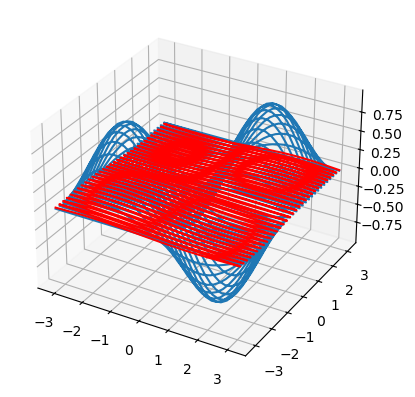

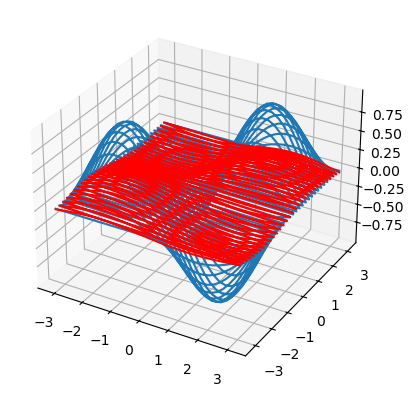

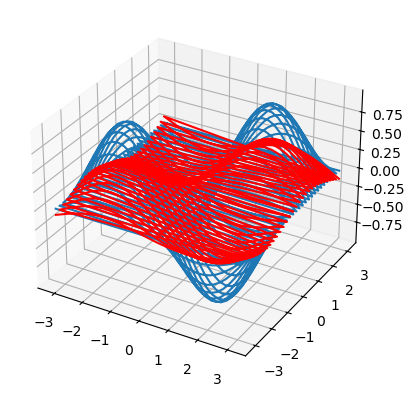

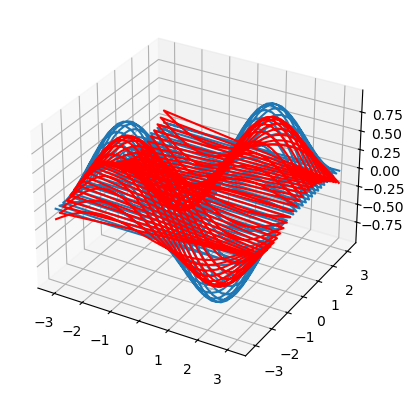

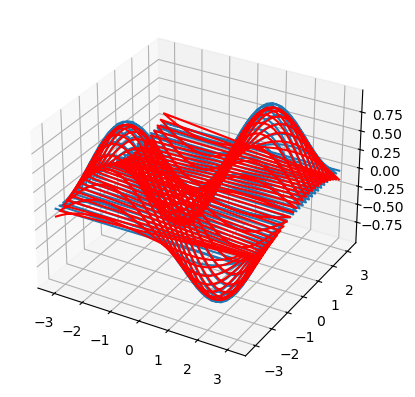

...

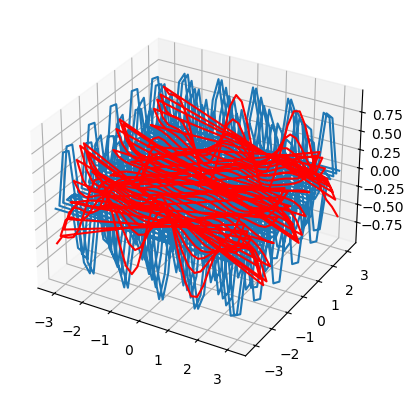

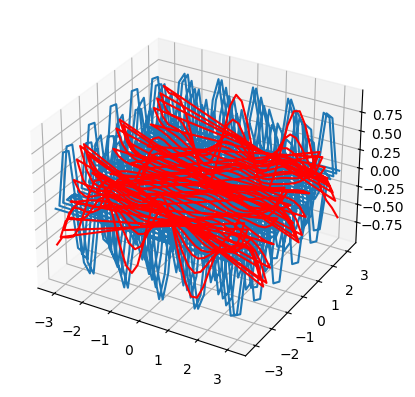

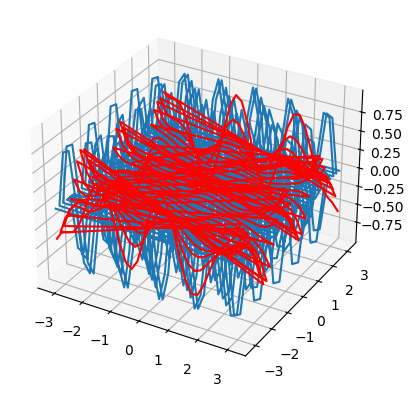

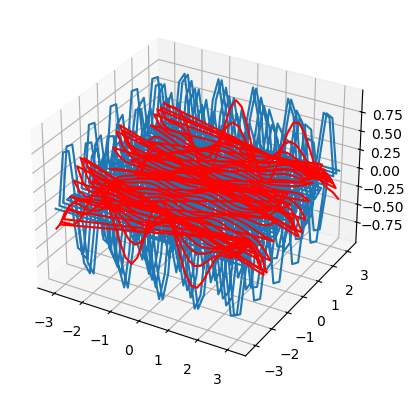

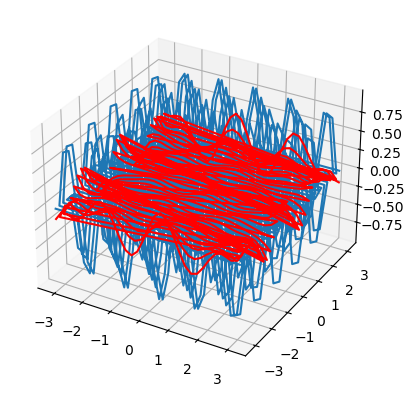

In [10]:
# 训练
Xs=[X1,X2,Xb1,Xb2]
Xs_t=[X1_t,X2_t,ux1_t,ux2_t]
# 创建超参数
N=100000
step=10
E=np.zeros([10,round(N/step)])
E1=np.zeros([10,round(N/step)])
E2=np.zeros([10,round(N/step)])
mu=4
for j in range(0,2):
    X=Xs[j]
    X_t=Xs_t[j]
    Xb=Xs[j+2]
    ux_t=Xs_t[j+2]
    theta = np.zeros([width, 1])
    lr=3e-5/(1+mu)
    for k in range(1,6):
        u=np.sin(k*points[:,0])*np.sin(k*points[:,1])
        u=u.reshape(-1,1)
        u_t=np.sin(k*points_t[:,0])*np.sin(k*points_t[:,1])
        u_t=u_t.reshape(-1,1)
        du= -2*k**2*np.sin(k*points[:,0])*np.sin(k*points[:,1]) 
        du=du.reshape(-1,1)
        du_t= -2*k**2*np.sin(k*points_t[:,0])*np.sin(k*points_t[:,1])
        du_t=du_t.reshape(-1,1)
        ub=np.sin(k*bpoints[:,0])*np.sin(k*bpoints[:,1])
        ub=ub.reshape(-1,1)

        for i in range(1,N+1):
            gradients = X.T.dot(X.dot(theta)-du)/n_samples+ mu* Xb.T.dot(Xb.dot(theta)-ub)/n_samples2
            theta = theta - lr * gradients
            if i%step==0:
                #du_pred = np.dot(X_t,theta)
                #du_real = du_t
                u_pred = np.dot(ux_t,theta)
                u_real = u_t
                E[2*k-2+j,(i//step)-1]=(np.linalg.norm(u_pred-u_real)/np.sqrt(tn))
                E1[2*k-2+j,(i//step)-1]=(np.linalg.norm(X.dot(theta)-du)/np.sqrt(n_samples))
                E2[2*k-2+j,(i//step)-1]=(np.linalg.norm(Xb.dot(theta)-ub)/np.sqrt(n_samples2))
                print("error is: ", E[j,(i//step)-1])
                print("error1 is: ", E1[j,(i//step)-1])
                print("error2 is: ", E2[j,(i//step)-1])
                print(i)
            if i==1000 or i==3000 or i==10000 or i==30000 or i==100000:
                fig = plt.figure()
                ax1 = fig.add_subplot(111, projection='3d')
                # get points for a mesh grid
                v=u_pred
                z=u_real
                # plotting the curve
                ax1.plot(x_t.reshape(-1), y_t.reshape(-1), z.reshape(-1))
                ax1.plot(x_t.reshape(-1), y_t.reshape(-1), v.reshape(-1),color='red')
                plt.show


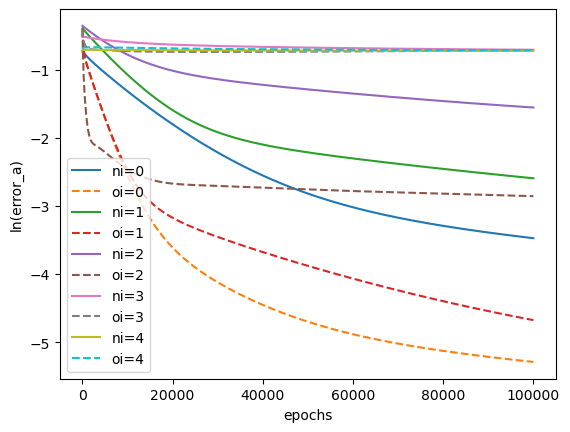

In [11]:
#mu=4
for i in range(5):
    plt.plot(np.arange(round(N/step))*step,np.log(np.abs(E[2*i,:])),label="ni="+str(i),linestyle='-')
    plt.plot(np.arange(round(N/step))*step,np.log(np.abs(E[2*i+1,:])),label="oi="+str(i),linestyle='--')
plt.ylabel('ln(error_a)')
plt.xlabel('epochs')
plt.legend()

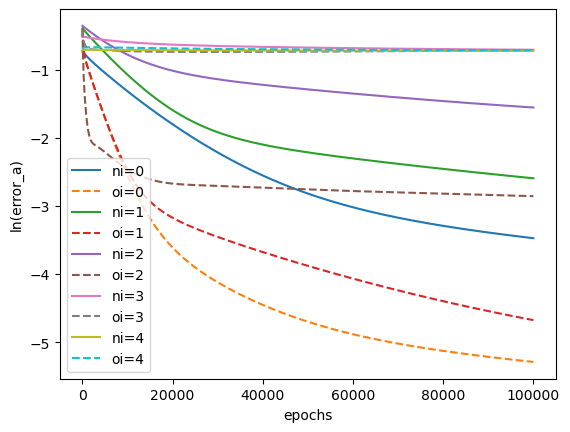

In [12]:
#mu=4
for i in range(5):
    plt.plot(np.arange(round(N/step))*step,np.log(np.abs(E[2*i,:])),label="ni="+str(i),linestyle='-')
    plt.plot(np.arange(round(N/step))*step,np.log(np.abs(E[2*i+1,:])),label="oi="+str(i),linestyle='--')
plt.ylabel('ln(error_a)')
plt.xlabel('epochs')
plt.legend()

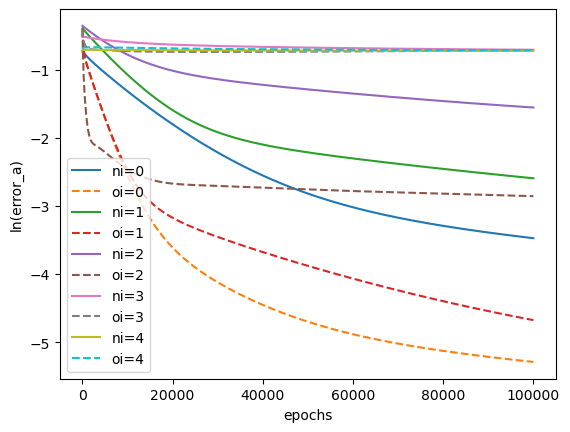

In [13]:
#mu=4
for i in range(5):
    plt.plot(np.arange(round(N/step))*step,np.log(np.abs(E[2*i,:])),label="ni="+str(i),linestyle='-')
    plt.plot(np.arange(round(N/step))*step,np.log(np.abs(E[2*i+1,:])),label="oi="+str(i),linestyle='--')
plt.ylabel('ln(error_a)')
plt.xlabel('epochs')
plt.legend()

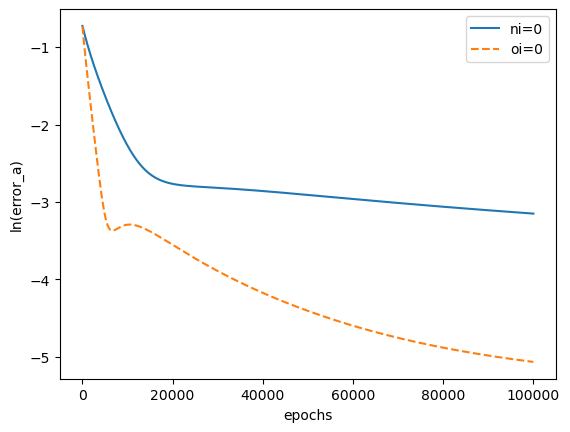

In [16]:
#mu=1
for i in range(1):
    plt.plot(np.arange(round(N/step))*step,np.log(np.abs(E[2*i,:])),label="ni="+str(i),linestyle='-')
    plt.plot(np.arange(round(N/step))*step,np.log(np.abs(E[2*i+1,:])),label="oi="+str(i),linestyle='--')
plt.ylabel('ln(error_a)')
plt.xlabel('epochs')
plt.legend()

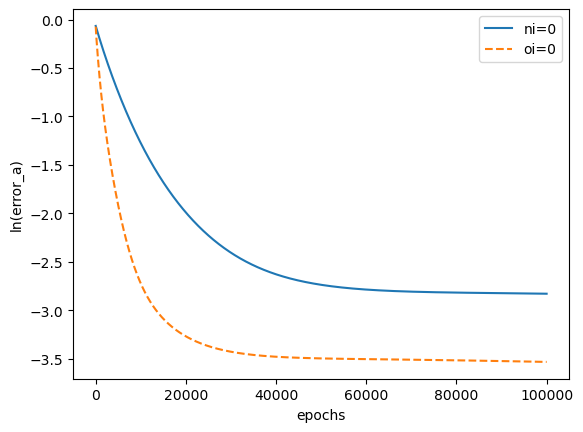

In [17]:
#mu=1
for i in range(1):
    plt.plot(np.arange(round(N/step))*step,np.log(np.abs(E1[2*i,:])),label="ni="+str(i),linestyle='-')
    plt.plot(np.arange(round(N/step))*step,np.log(np.abs(E1[2*i+1,:])),label="oi="+str(i),linestyle='--')
plt.ylabel('ln(error_a)')
plt.xlabel('epochs')
plt.legend()

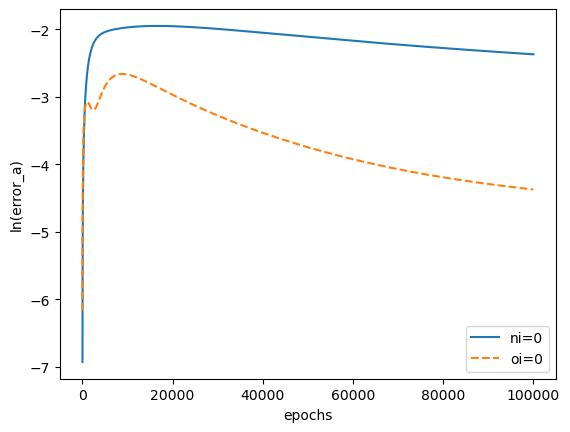

In [18]:
#mu=1
for i in range(1):
    plt.plot(np.arange(round(N/step))*step,np.log(np.abs(E2[2*i,:])),label="ni="+str(i),linestyle='-')
    plt.plot(np.arange(round(N/step))*step,np.log(np.abs(E2[2*i+1,:])),label="oi="+str(i),linestyle='--')
plt.ylabel('ln(error_a)')
plt.xlabel('epochs')
plt.legend()

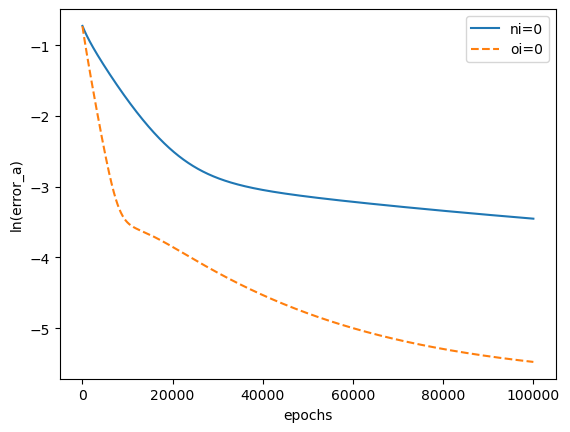

In [24]:
#mu=2
for i in range(1):
    plt.plot(np.arange(round(N/step))*step,np.log(np.abs(E[2*i,:])),label="ni="+str(i),linestyle='-')
    plt.plot(np.arange(round(N/step))*step,np.log(np.abs(E[2*i+1,:])),label="oi="+str(i),linestyle='--')
plt.ylabel('ln(error_a)')
plt.xlabel('epochs')
plt.legend()

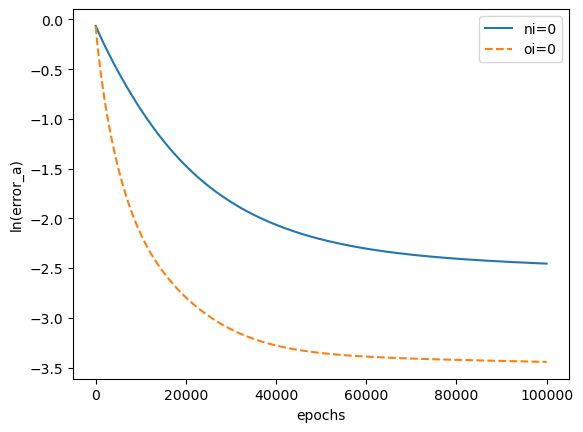

In [25]:
#mu=2
for i in range(1):
    plt.plot(np.arange(round(N/step))*step,np.log(np.abs(E1[2*i,:])),label="ni="+str(i),linestyle='-')
    plt.plot(np.arange(round(N/step))*step,np.log(np.abs(E1[2*i+1,:])),label="oi="+str(i),linestyle='--')
plt.ylabel('ln(error_a)')
plt.xlabel('epochs')
plt.legend()

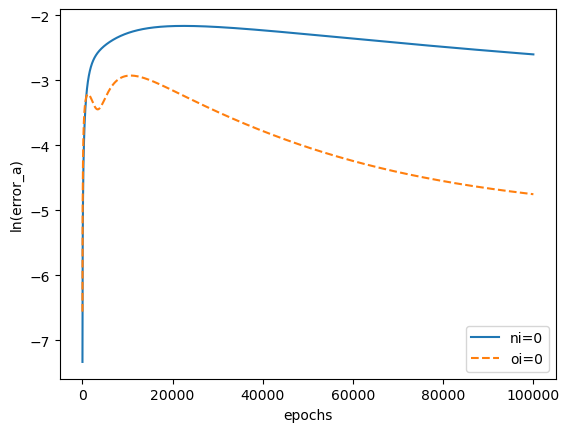

In [26]:
#mu=2
for i in range(1):
    plt.plot(np.arange(round(N/step))*step,np.log(np.abs(E2[2*i,:])),label="ni="+str(i),linestyle='-')
    plt.plot(np.arange(round(N/step))*step,np.log(np.abs(E2[2*i+1,:])),label="oi="+str(i),linestyle='--')
plt.ylabel('ln(error_a)')
plt.xlabel('epochs')
plt.legend()

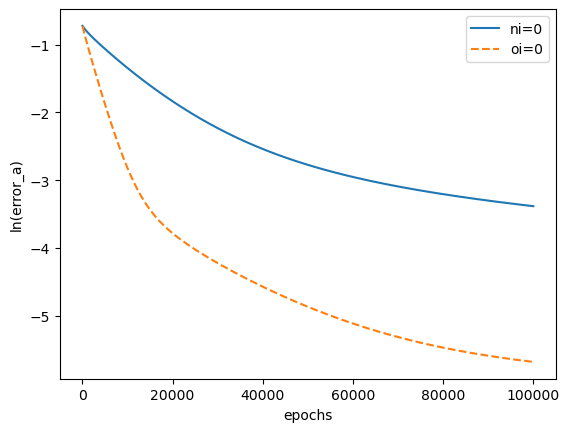

In [28]:
#mu=4
for i in range(1):
    plt.plot(np.arange(round(N/step))*step,np.log(np.abs(E[2*i,:])),label="ni="+str(i),linestyle='-')
    plt.plot(np.arange(round(N/step))*step,np.log(np.abs(E[2*i+1,:])),label="oi="+str(i),linestyle='--')
plt.ylabel('ln(error_a)')
plt.xlabel('epochs')
plt.legend()

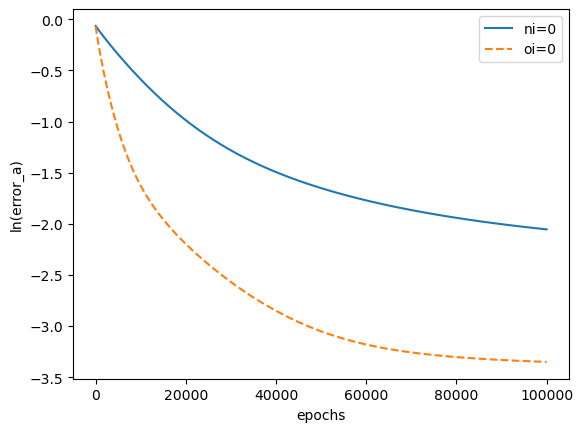

In [29]:
#mu=4
for i in range(1):
    plt.plot(np.arange(round(N/step))*step,np.log(np.abs(E1[2*i,:])),label="ni="+str(i),linestyle='-')
    plt.plot(np.arange(round(N/step))*step,np.log(np.abs(E1[2*i+1,:])),label="oi="+str(i),linestyle='--')
plt.ylabel('ln(error_a)')
plt.xlabel('epochs')
plt.legend()

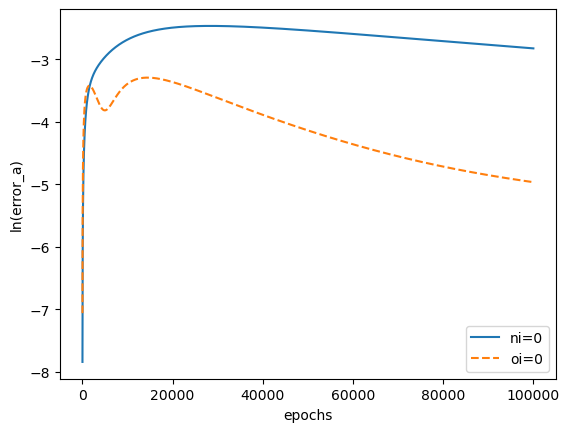

In [30]:
#mu=4
for i in range(1):
    plt.plot(np.arange(round(N/step))*step,np.log(np.abs(E2[2*i,:])),label="ni="+str(i),linestyle='-')
    plt.plot(np.arange(round(N/step))*step,np.log(np.abs(E2[2*i+1,:])),label="oi="+str(i),linestyle='--')
plt.ylabel('ln(error_a)')
plt.xlabel('epochs')
plt.legend()

error is:  0.48242695412670983
error1 is:  0.9350496144329501
error2 is:  0.0017153407942067695
10
error is:  0.48052163336335535
error1 is:  0.9326185229533775
error2 is:  0.0033439494367345154
20
error is:  0.4786567528166498
error1 is:  0.9302060263776631
error2 is:  0.00489092729135067
30
error is:  0.4768302251725006
error1 is:  0.9278114641769067
error2 is:  0.006360794300700297
40
error is:  0.475040109115059
error1 is:  0.9254342110550691
error2 is:  0.007757724553103331
50
error is:  0.4732845900626952
error1 is:  0.923073674492764
error2 is:  0.009085621199577022
60
error is:  0.47156196627228614
error1 is:  0.9207292926309967
error2 is:  0.010348159411553644
70
error is:  0.46987063810166013
error1 is:  0.9184005323975357
error2 is:  0.0115488125529379
80
error is:  0.4682090993791326
error1 is:  0.9160868878179979
error2 is:  0.01269086976191249
90
error is:  0.46657593022568417
error1 is:  0.9137878784729376
error2 is:  0.013777449015746015
100
error is:  0.464969790910274

error is:  0.37716461285089614
error1 is:  0.763003309560591
error2 is:  0.040587802977766034
870
error is:  0.37621896868737636
error1 is:  0.7612827943693368
error2 is:  0.040755128610289605
880
error is:  0.37527647582460494
error1 is:  0.759567206115182
error2 is:  0.04092214860679478
890
error is:  0.37433710652683994
error1 is:  0.7578565234927463
error2 is:  0.04108888270770499
900
error is:  0.37340083406931557
error1 is:  0.7561507256072487
error2 is:  0.04125534873882157
910
error is:  0.3724676326877698
error1 is:  0.7544497919560897
error2 is:  0.0414215627358945
920
error is:  0.3715374775305525
error1 is:  0.7527537024113491
error2 is:  0.04158753906214084
930
error is:  0.37061034461318293
error1 is:  0.7510624372031581
error2 is:  0.04175329051907707
940
error is:  0.36968621077523023
error1 is:  0.7493759769038971
error2 is:  0.04191882845101388
950
error is:  0.3687650536393967
error1 is:  0.7476943024131809
error2 is:  0.04208416284354564
960
error is:  0.36784685157

C:\Users\13011\AppData\Local\Temp\ipykernel_19252\2226405488.py:34: RuntimeWarning: overflow encountered in multiply
  gradients = X.T.dot(X.dot(theta)-du)/n_samples+ mu* Xb.T.dot(Xb.dot(theta)-ub)/n_samples2
C:\Users\13011\AppData\Local\Temp\ipykernel_19252\2226405488.py:35: RuntimeWarning: invalid value encountered in subtract
  theta = theta - lr * gradients


error is:  nan
error1 is:  nan
error2 is:  nan
980
error is:  nan
error1 is:  nan
error2 is:  nan
990
error is:  nan
error1 is:  nan
error2 is:  nan
1000
error is:  nan
error1 is:  nan
error2 is:  nan
10
error is:  nan
error1 is:  nan
error2 is:  nan
20
error is:  nan
error1 is:  nan
error2 is:  nan
30
error is:  nan
error1 is:  nan
error2 is:  nan
40
error is:  nan
error1 is:  nan
error2 is:  nan
50
error is:  nan
error1 is:  nan
error2 is:  nan
60
error is:  nan
error1 is:  nan
error2 is:  nan
70
error is:  nan
error1 is:  nan
error2 is:  nan
80
error is:  nan
error1 is:  nan
error2 is:  nan
90
error is:  nan
error1 is:  nan
error2 is:  nan
100
error is:  nan
error1 is:  nan
error2 is:  nan
110
error is:  nan
error1 is:  nan
error2 is:  nan
120
error is:  nan
error1 is:  nan
error2 is:  nan
130
error is:  nan
error1 is:  nan
error2 is:  nan
140
error is:  nan
error1 is:  nan
error2 is:  nan
150
error is:  nan
error1 is:  nan
error2 is:  nan
160
error is:  nan
error1 is:  nan
error2 i

error is:  nan
error1 is:  nan
error2 is:  nan
680
error is:  nan
error1 is:  nan
error2 is:  nan
690
error is:  nan
error1 is:  nan
error2 is:  nan
700
error is:  nan
error1 is:  nan
error2 is:  nan
710
error is:  nan
error1 is:  nan
error2 is:  nan
720
error is:  nan
error1 is:  nan
error2 is:  nan
730
error is:  nan
error1 is:  nan
error2 is:  nan
740
error is:  nan
error1 is:  nan
error2 is:  nan
750
error is:  nan
error1 is:  nan
error2 is:  nan
760
error is:  nan
error1 is:  nan
error2 is:  nan
770
error is:  nan
error1 is:  nan
error2 is:  nan
780
error is:  nan
error1 is:  nan
error2 is:  nan
790
error is:  nan
error1 is:  nan
error2 is:  nan
800
error is:  nan
error1 is:  nan
error2 is:  nan
810
error is:  nan
error1 is:  nan
error2 is:  nan
820
error is:  nan
error1 is:  nan
error2 is:  nan
830
error is:  nan
error1 is:  nan
error2 is:  nan
840
error is:  nan
error1 is:  nan
error2 is:  nan
850
error is:  nan
error1 is:  nan
error2 is:  nan
860
error is:  nan
error1 is:  nan


error is:  nan
error1 is:  nan
error2 is:  nan
700
error is:  nan
error1 is:  nan
error2 is:  nan
710
error is:  nan
error1 is:  nan
error2 is:  nan
720
error is:  nan
error1 is:  nan
error2 is:  nan
730
error is:  nan
error1 is:  nan
error2 is:  nan
740
error is:  nan
error1 is:  nan
error2 is:  nan
750
error is:  nan
error1 is:  nan
error2 is:  nan
760
error is:  nan
error1 is:  nan
error2 is:  nan
770
error is:  nan
error1 is:  nan
error2 is:  nan
780
error is:  nan
error1 is:  nan
error2 is:  nan
790
error is:  nan
error1 is:  nan
error2 is:  nan
800
error is:  nan
error1 is:  nan
error2 is:  nan
810
error is:  nan
error1 is:  nan
error2 is:  nan
820
error is:  nan
error1 is:  nan
error2 is:  nan
830
error is:  nan
error1 is:  nan
error2 is:  nan
840
error is:  nan
error1 is:  nan
error2 is:  nan
850
error is:  nan
error1 is:  nan
error2 is:  nan
860
error is:  nan
error1 is:  nan
error2 is:  nan
870
error is:  nan
error1 is:  nan
error2 is:  nan
880
error is:  nan
error1 is:  nan


error is:  nan
error1 is:  nan
error2 is:  nan
470
error is:  nan
error1 is:  nan
error2 is:  nan
480
error is:  nan
error1 is:  nan
error2 is:  nan
490
error is:  nan
error1 is:  nan
error2 is:  nan
500
error is:  nan
error1 is:  nan
error2 is:  nan
510
error is:  nan
error1 is:  nan
error2 is:  nan
520
error is:  nan
error1 is:  nan
error2 is:  nan
530
error is:  nan
error1 is:  nan
error2 is:  nan
540
error is:  nan
error1 is:  nan
error2 is:  nan
550
error is:  nan
error1 is:  nan
error2 is:  nan
560
error is:  nan
error1 is:  nan
error2 is:  nan
570
error is:  nan
error1 is:  nan
error2 is:  nan
580
error is:  nan
error1 is:  nan
error2 is:  nan
590
error is:  nan
error1 is:  nan
error2 is:  nan
600
error is:  nan
error1 is:  nan
error2 is:  nan
610
error is:  nan
error1 is:  nan
error2 is:  nan
620
error is:  nan
error1 is:  nan
error2 is:  nan
630
error is:  nan
error1 is:  nan
error2 is:  nan
640
error is:  nan
error1 is:  nan
error2 is:  nan
650
error is:  nan
error1 is:  nan


error is:  nan
error1 is:  nan
error2 is:  nan
110
error is:  nan
error1 is:  nan
error2 is:  nan
120
error is:  nan
error1 is:  nan
error2 is:  nan
130
error is:  nan
error1 is:  nan
error2 is:  nan
140
error is:  nan
error1 is:  nan
error2 is:  nan
150
error is:  nan
error1 is:  nan
error2 is:  nan
160
error is:  nan
error1 is:  nan
error2 is:  nan
170
error is:  nan
error1 is:  nan
error2 is:  nan
180
error is:  nan
error1 is:  nan
error2 is:  nan
190
error is:  nan
error1 is:  nan
error2 is:  nan
200
error is:  nan
error1 is:  nan
error2 is:  nan
210
error is:  nan
error1 is:  nan
error2 is:  nan
220
error is:  nan
error1 is:  nan
error2 is:  nan
230
error is:  nan
error1 is:  nan
error2 is:  nan
240
error is:  nan
error1 is:  nan
error2 is:  nan
250
error is:  nan
error1 is:  nan
error2 is:  nan
260
error is:  nan
error1 is:  nan
error2 is:  nan
270
error is:  nan
error1 is:  nan
error2 is:  nan
280
error is:  nan
error1 is:  nan
error2 is:  nan
290
error is:  nan
error1 is:  nan


error is:  0.3560466929927433
error1 is:  0.6713283313111874
error2 is:  0.040957070712506406
420
error is:  0.3536454877266766
error1 is:  0.6669117863186995
error2 is:  0.041075805872076716
430
error is:  0.35126507534727813
error1 is:  0.662545803716264
error2 is:  0.04118074154418893
440
error is:  0.3489051442713693
error1 is:  0.6582294082107583
error2 is:  0.04127248645034903
450
error is:  0.34656539464156144
error1 is:  0.6539616627393293
error2 is:  0.04135161586894921
460
error is:  0.34424553756677523
error1 is:  0.6497416657940545
error2 is:  0.041418674162108
470
error is:  0.3419452944240083
error1 is:  0.6455685489954116
error2 is:  0.04147417707296557
480
error is:  0.33966439621576855
error1 is:  0.6414414748872836
error2 is:  0.04151861381665548
490
error is:  0.3374025829781481
error1 is:  0.6373596349296944
error2 is:  0.04155244898566856
500
error is:  0.33515960323501576
error1 is:  0.633322247668431
error2 is:  0.04157612428810135
510
error is:  0.33293521349424

error is:  0.14617765652350048
error1 is:  0.3224787076897763
error2 is:  0.02426010202703095
440
error is:  0.14460898525231575
error1 is:  0.3200167379893681
error2 is:  0.02416675481855174
450
error is:  0.1430637405914696
error1 is:  0.3175893108584911
error2 is:  0.02408210097348265
460
error is:  0.14154159356275012
error1 is:  0.315195793030974
error2 is:  0.024006024755817586
470
error is:  0.14004222006114397
error1 is:  0.31283556561771836
error2 is:  0.023938397687042503
480
error is:  0.13856530075011203
error1 is:  0.3105080236965073
error2 is:  0.02387907922563562
490
error is:  0.13711052095978973
error1 is:  0.3082125759158596
error2 is:  0.023827917489927547
500
error is:  0.1356775705880105
error1 is:  0.30594864411239425
error2 is:  0.023784750018567245
510
error is:  0.1342661440040579
error1 is:  0.30371566294119595
error2 is:  0.0237494045623709
520
error is:  0.1328759399550561
error1 is:  0.3015130795186878
error2 is:  0.023721699900992627
530
error is:  0.13150

error is:  0.05694658031942866
error1 is:  0.15840454638417314
error2 is:  0.032791178014245526
390
error is:  0.056546279729707064
error1 is:  0.15724643058735938
error2 is:  0.03283786228762718
400
error is:  0.056156198555849655
error1 is:  0.15610616398390142
error2 is:  0.03288051442898699
410
error is:  0.0557759401413889
error1 is:  0.15498330482003345
error2 is:  0.032919217199649145
420
error is:  0.055405122308691095
error1 is:  0.15387742500078075
error2 is:  0.03295405341343868
430
error is:  0.055043376957412515
error1 is:  0.15278810963246628
error2 is:  0.032985105788989603
440
error is:  0.05469034966533775
error1 is:  0.15171495658111936
error2 is:  0.03301245681601639
450
error is:  0.05434569929218182
error1 is:  0.15065757604619917
error2 is:  0.03303618863443722
460
error is:  0.05400909758691268
error1 is:  0.14961559014907222
error2 is:  0.03305638292532513
470
error is:  0.05368022879912239
error1 is:  0.14858863253570717
error2 is:  0.03307312081274412
480
erro

error is:  0.0345737472227114
error1 is:  0.08422704852449656
error2 is:  0.025942571415486077
290
error is:  0.03433925971077915
error1 is:  0.08354556482930117
error2 is:  0.025773136996751687
300
error is:  0.034106709165176
error1 is:  0.08287426819351201
error2 is:  0.025604368295132247
310
error is:  0.03387607139026841
error1 is:  0.08221296258892456
error2 is:  0.0254363019213361
320
error is:  0.03364732338840707
error1 is:  0.08156145803876413
error2 is:  0.0252689720074647
330
error is:  0.033420443251655683
error1 is:  0.08091957034160883
error2 is:  0.025102410335826508
340
error is:  0.033195410063455145
error1 is:  0.08028712081040656
error2 is:  0.024936646461477953
350
error is:  0.03297220380932669
error1 is:  0.07966393602566806
error2 is:  0.024771707828776156
360
error is:  0.0327508052957978
error1 is:  0.07904984760198064
error2 is:  0.024607619882217276
370
error is:  0.03253119607680771
error1 is:  0.07844469196704193
error2 is:  0.0244444061718241
380
error is

error is:  0.017318560470725476
error1 is:  0.045796273108110956
error2 is:  0.012902447129009113
200
error is:  0.017127634628384823
error1 is:  0.04550596494185291
error2 is:  0.012761085845140897
210
error is:  0.01693971948900612
error1 is:  0.045223349629319363
error2 is:  0.012622158495548562
220
error is:  0.016754763575619305
error1 is:  0.0449482110907095
error2 is:  0.012485622904819374
230
error is:  0.01657271624368961
error1 is:  0.04468033901723461
error2 is:  0.012351437587493732
240
error is:  0.0163935276726696
error1 is:  0.044419528731858046
error2 is:  0.012219561743630883
250
error is:  0.01621714885731244
error1 is:  0.04416558105374179
error2 is:  0.012089955253473188
260
error is:  0.01604353159876957
error1 is:  0.04391830216615962
error2 is:  0.011962578671325047
270
error is:  0.01587262849549461
error1 is:  0.04367750348766478
error2 is:  0.011837393218751416
280
error is:  0.01570439293397473
error1 is:  0.04344300154632115
error2 is:  0.011714360777189904


error is:  0.007463294954342149
error1 is:  0.03493405375206466
error2 is:  0.006150264443647003
90
error is:  0.007369853188838663
error1 is:  0.034865341454746304
error2 is:  0.0060967694391730245
100
error is:  0.007278681563770876
error1 is:  0.03479857704977827
error2 is:  0.0060449227915253465
110
error is:  0.0071897089743058655
error1 is:  0.034733665359708905
error2 is:  0.005994663366914309
120
error is:  0.0071028667586115765
error1 is:  0.03467051645050226
error2 is:  0.005945932203339898
130
error is:  0.007018088610343549
error1 is:  0.03460904532410555
error2 is:  0.005898672444825731
140
error is:  0.006935310494394069
error1 is:  0.03454917162983114
error2 is:  0.005852829277217253
150
error is:  0.006854470565778965
error1 is:  0.03449081939338277
error2 is:  0.005808349865485243
160
error is:  0.006775509091541338
error1 is:  0.03443391676242707
error2 is:  0.005765183292484245
170
error is:  0.0066983683755561544
error1 is:  0.034378395767676206
error2 is:  0.005723

error is:  0.0037457769453569387
error1 is:  0.031972573852454264
error2 is:  0.004284307754215785
900
error is:  0.0037238601557659967
error1 is:  0.0319488272909533
error2 is:  0.004273952565598478
910
error is:  0.0037022166371387995
error1 is:  0.03192520503042882
error2 is:  0.004263705944676595
920
error is:  0.0036808413117883536
error1 is:  0.031901704859741004
error2 is:  0.0042535653266311995
930
error is:  0.003659729248278822
error1 is:  0.03187832463982116
error2 is:  0.004243528236284747
940
error is:  0.0036388756566109273
error1 is:  0.03185506230047912
error2 is:  0.004233592284417721
950
error is:  0.003618275883568822
error1 is:  0.031831915837366984
error2 is:  0.004223755164244145
960
error is:  0.003597925408222763
error1 is:  0.031808883309091616
error2 is:  0.004214014648039466
970
error is:  0.0035778198375821155
error1 is:  0.03178596283446807
error2 is:  0.004204368583913853
980
error is:  0.0035579549023937286
error1 is:  0.03176315258990704
error2 is:  0.00

error is:  9.869394793212312e+116
error1 is:  1.1662207107779941e+118
error2 is:  8.705511954837204e+116
860
error is:  3.6464586582116915e+118
error1 is:  4.308851451688733e+119
error2 is:  3.2164372899251817e+118
870
error is:  1.3472620180511784e+120
error1 is:  1.5919971803908767e+121
error2 is:  1.1883814408264418e+120
880
error is:  4.977747221117565e+121
error1 is:  5.881973539327266e+122
error2 is:  4.390729001073048e+121
890
error is:  1.8391350060610405e+123
error1 is:  2.1732207282459824e+124
error2 is:  1.6222485894307622e+123
900
error is:  6.795077010278057e+124
error1 is:  8.029428051827258e+125
error2 is:  5.9937438299356235e+124
910
error is:  2.510586304074561e+126
error1 is:  2.9666436548074826e+127
error2 is:  2.2145166488631185e+126
920
error is:  9.275897213045483e+127
error1 is:  1.0960898482185994e+129
error2 is:  8.18200464891175e+127
930
error is:  3.427178303623443e+129
error1 is:  4.0497380041616004e+130
error2 is:  3.02301633673342e+129
940
error is:  1.266

error is:  nan
error1 is:  nan
error2 is:  nan
290
error is:  nan
error1 is:  nan
error2 is:  nan
300
error is:  nan
error1 is:  nan
error2 is:  nan
310
error is:  nan
error1 is:  nan
error2 is:  nan
320
error is:  nan
error1 is:  nan
error2 is:  nan
330
error is:  nan
error1 is:  nan
error2 is:  nan
340
error is:  nan
error1 is:  nan
error2 is:  nan
350
error is:  nan
error1 is:  nan
error2 is:  nan
360
error is:  nan
error1 is:  nan
error2 is:  nan
370
error is:  nan
error1 is:  nan
error2 is:  nan
380
error is:  nan
error1 is:  nan
error2 is:  nan
390
error is:  nan
error1 is:  nan
error2 is:  nan
400
error is:  nan
error1 is:  nan
error2 is:  nan
410
error is:  nan
error1 is:  nan
error2 is:  nan
420
error is:  nan
error1 is:  nan
error2 is:  nan
430
error is:  nan
error1 is:  nan
error2 is:  nan
440
error is:  nan
error1 is:  nan
error2 is:  nan
450
error is:  nan
error1 is:  nan
error2 is:  nan
460
error is:  nan
error1 is:  nan
error2 is:  nan
470
error is:  nan
error1 is:  nan


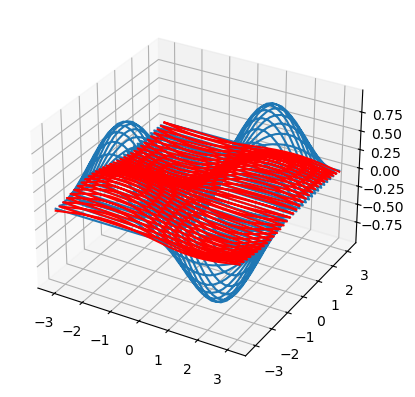

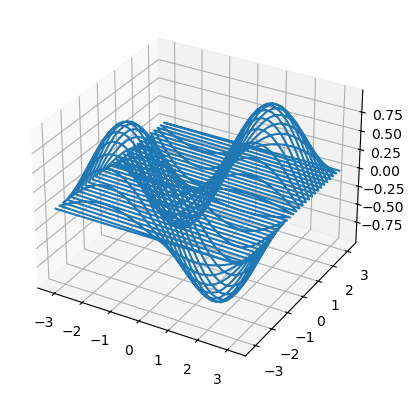

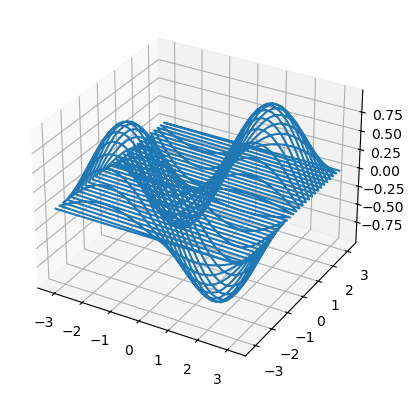

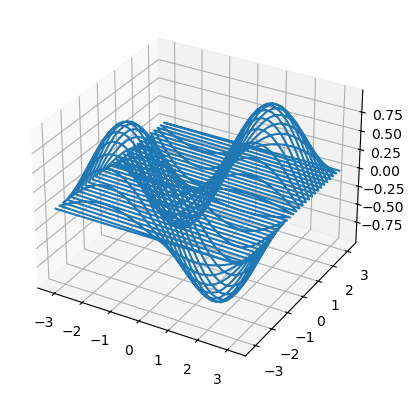

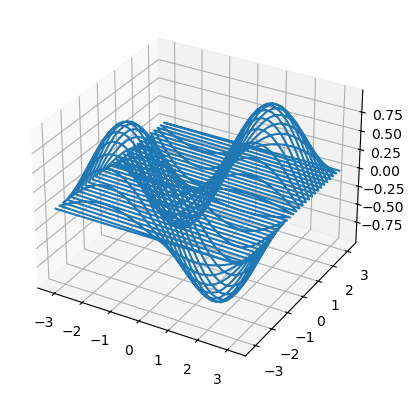

...

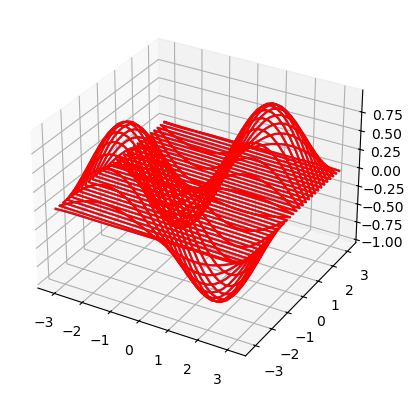

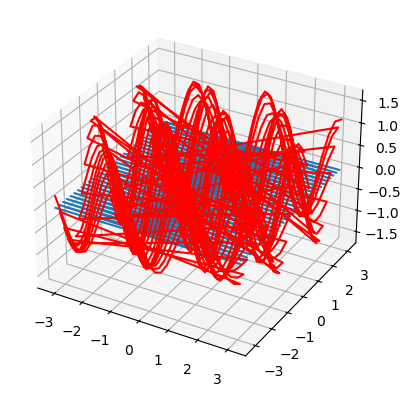

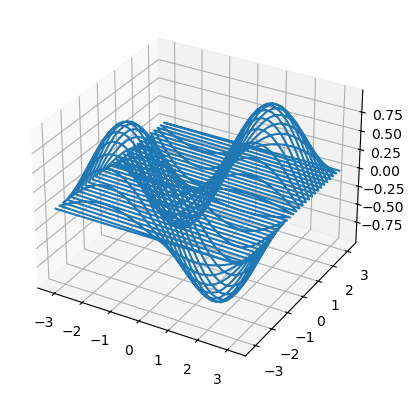

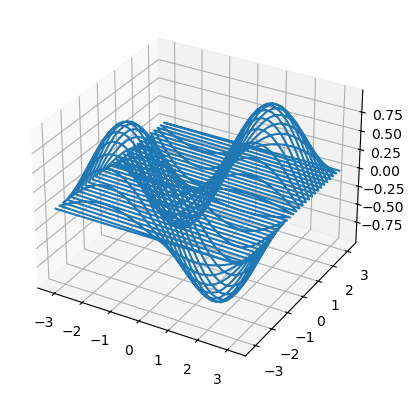

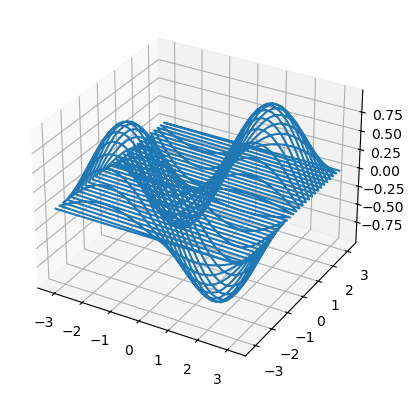

In [7]:
# 训练
Xs=[X1,X2,Xb1,Xb2]
Xs_t=[X1_t,X2_t,ux1_t,ux2_t]
# 创建超参数
N=1000
step=10
L=10
E=np.zeros([2*L,round(N/step)])
E1=np.zeros([2*L,round(N/step)])
E2=np.zeros([2*L,round(N/step)])
mu=4
for j in range(0,2):
    X=Xs[j]
    X_t=Xs_t[j]
    Xb=Xs[j+2]
    ux_t=Xs_t[j+2]
    theta = np.zeros([width, 1])
    
    for l in range(L):
        lr=1e-4/(1+mu)*2**l
        k=1
        u=np.sin(k*points[:,0])*np.sin(k*points[:,1])
        u=u.reshape(-1,1)
        u_t=np.sin(k*points_t[:,0])*np.sin(k*points_t[:,1])
        u_t=u_t.reshape(-1,1)
        du= -2*k**2*np.sin(k*points[:,0])*np.sin(k*points[:,1]) 
        du=du.reshape(-1,1)
        du_t= -2*k**2*np.sin(k*points_t[:,0])*np.sin(k*points_t[:,1])
        du_t=du_t.reshape(-1,1)
        ub=np.sin(k*bpoints[:,0])*np.sin(k*bpoints[:,1])
        ub=ub.reshape(-1,1)

        for i in range(1,N+1):
            gradients = X.T.dot(X.dot(theta)-du)/n_samples+ mu* Xb.T.dot(Xb.dot(theta)-ub)/n_samples2
            theta = theta - lr * gradients
            if i%step==0:
                #du_pred = np.dot(X_t,theta)
                #du_real = du_t
                u_pred = np.dot(ux_t,theta)
                u_real = u_t
                E[2*l+j,(i//step)-1]=(np.linalg.norm(u_pred-u_real)/np.sqrt(tn))
                E1[2*l+j,(i//step)-1]=(np.linalg.norm(X.dot(theta)-du)/np.sqrt(n_samples))
                E2[2*l+j,(i//step)-1]=(np.linalg.norm(Xb.dot(theta)-ub)/np.sqrt(n_samples2))
                print("error is: ", E[2*l+j,(i//step)-1])
                print("error1 is: ", E1[2*l+j,(i//step)-1])
                print("error2 is: ", E2[2*l+j,(i//step)-1])
                print(i)
            if i==1000 or i==3000 or i==10000 or i==30000 or i==100000:
                fig = plt.figure()
                ax1 = fig.add_subplot(111, projection='3d')
                # get points for a mesh grid
                v=u_pred
                z=u_real
                # plotting the curve
                ax1.plot(x_t.reshape(-1), y_t.reshape(-1), z.reshape(-1))
                ax1.plot(x_t.reshape(-1), y_t.reshape(-1), v.reshape(-1),color='red')
                plt.show


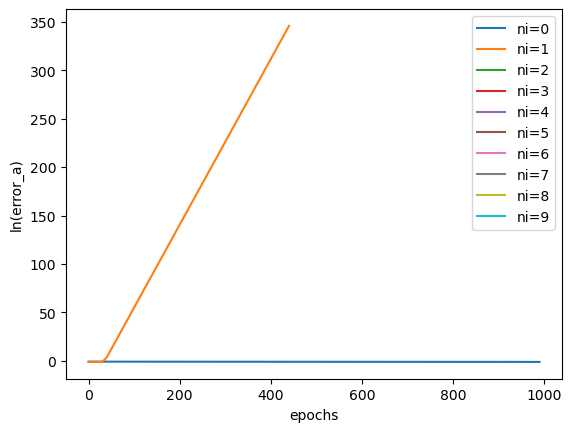

In [10]:
for i in range(L):
    plt.plot(np.arange(round(N/step))*step,np.log(np.abs(E[2*i,:])),label="ni="+str(i),linestyle='-')
    #plt.plot(np.arange(round(N/step))*step,np.log(np.abs(E[2*i+1,:])),label="oi="+str(i),linestyle='--')
plt.ylabel('ln(error_a)')
plt.xlabel('epochs')
plt.legend()

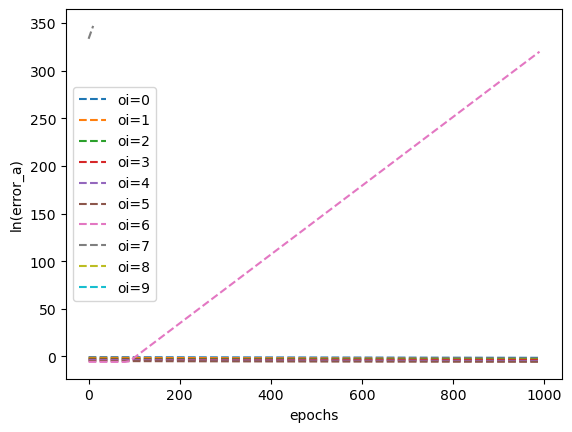

In [11]:
for i in range(L):
    #plt.plot(np.arange(round(N/step))*step,np.log(np.abs(E[2*i,:])),label="ni="+str(i),linestyle='-')
    plt.plot(np.arange(round(N/step))*step,np.log(np.abs(E[2*i+1,:])),label="oi="+str(i),linestyle='--')
plt.ylabel('ln(error_a)')
plt.xlabel('epochs')
plt.legend()

In [ ]:
# 训练
Xs=[X1,X2,Xb1,Xb2]
Xs_t=[X1_t,X2_t,ux1_t,ux2_t]
# 创建超参数
N=[100000,500000]
step=10
E=np.zeros([10,round(N/step)])
E1=np.zeros([10,round(N/step)])
E2=np.zeros([10,round(N/step)])
mu=4
lrs=[1e-5,1e-4]
for j in range(0,2):
    X=Xs[j]
    X_t=Xs_t[j]
    Xb=Xs[j+2]
    ux_t=Xs_t[j+2]
    theta = np.zeros([width, 1])
    lr=lrs[j]/(1+mu)
    for k in range(1,6):
        u=np.sin(k*points[:,0])*np.sin(k*points[:,1])
        u=u.reshape(-1,1)
        u_t=np.sin(k*points_t[:,0])*np.sin(k*points_t[:,1])
        u_t=u_t.reshape(-1,1)
        du= -2*k**2*np.sin(k*points[:,0])*np.sin(k*points[:,1]) 
        du=du.reshape(-1,1)
        du_t= -2*k**2*np.sin(k*points_t[:,0])*np.sin(k*points_t[:,1])
        du_t=du_t.reshape(-1,1)
        ub=np.sin(k*bpoints[:,0])*np.sin(k*bpoints[:,1])
        ub=ub.reshape(-1,1)

        for i in range(1,N[j]+1):
            gradients = X.T.dot(X.dot(theta)-du)/n_samples+ mu* Xb.T.dot(Xb.dot(theta)-ub)/n_samples2
            theta = theta - lr * gradients
            if i%step==0:
                #du_pred = np.dot(X_t,theta)
                #du_real = du_t
                u_pred = np.dot(ux_t,theta)
                u_real = u_t
                E[2*k-2+j,(i//step)-1]=(np.linalg.norm(u_pred-u_real)/np.sqrt(tn))
                E1[2*k-2+j,(i//step)-1]=(np.linalg.norm(X.dot(theta)-du)/np.sqrt(n_samples))
                E2[2*k-2+j,(i//step)-1]=(np.linalg.norm(Xb.dot(theta)-ub)/np.sqrt(n_samples2))
                print("error is: ", E[j,(i//step)-1])
                print("error1 is: ", E1[j,(i//step)-1])
                print("error2 is: ", E2[j,(i//step)-1])
                print(i)
            if i==1000 or i==3000 or i==10000 or i==30000 or i==100000:
                fig = plt.figure()
                ax1 = fig.add_subplot(111, projection='3d')
                # get points for a mesh grid
                v=u_pred
                z=u_real
                # plotting the curve
                ax1.plot(x_t.reshape(-1), y_t.reshape(-1), z.reshape(-1))
                ax1.plot(x_t.reshape(-1), y_t.reshape(-1), v.reshape(-1),color='red')
                plt.show

In [ ]:

for i in range(5):
    plt.plot(np.arange(round(N/step))*step,np.log(np.abs(E[2*i,:])),label="ni="+str(i),linestyle='-')
    plt.plot(np.arange(round(N/step))*step,np.log(np.abs(E[2*i+1,:])),label="oi="+str(i),linestyle='--')
plt.ylabel('ln(error_a)')
plt.xlabel('progress')
plt.legend()

In [ ]:
for i in range(5):
    plt.plot(np.arange(round(N/step))*step,np.log(np.abs(E1[2*i,:])),label="ni="+str(i),linestyle='-')
    plt.plot(np.arange(round(N/step))*step,np.log(np.abs(E1[2*i+1,:])),label="oi="+str(i),linestyle='--')
plt.ylabel('ln(error_a)')
plt.xlabel('epochs')
plt.legend()

In [ ]:
for i in range(5):
    plt.plot(np.arange(round(N/step))*step,np.log(np.abs(E1[2*i,:])),label="ni="+str(i),linestyle='-')
    plt.plot(np.arange(round(N/step))*step,np.log(np.abs(E1[2*i+1,:])),label="oi="+str(i),linestyle='--')
plt.ylabel('ln(error_a)')
plt.xlabel('epochs')
plt.legend()